<a href="https://colab.research.google.com/github/WforGodot/Q-learning_drawing/blob/main/Q_learning_drawing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Using DQN (Deep Q-Learning) to trace handwritten digits

Here we try to get a train a model using reinforcement learning to trace MINST examples by controlling a cursor with a preset list of moves (move x pixels without drawing, draw x pixels, change direction, etc.) Currently, reward is a simple estimate of "overlap".

In [1]:
!nvidia-smi

Mon Jan 10 17:24:59 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P0    25W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
import torch
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torchvision import datasets
from torchvision.transforms import ToTensor
import torch.nn as nn
import torch.nn.functional as F
from torchsummary import summary
!pip install cairocffi
import cairocffi as cairo
import numpy as np
import math
import matplotlib.pyplot as plt
from random import randint, random
from time import time

     |████████████████████████████████| 88 kB 5.3 MB/s 
  Created wheel for cairocffi: filename=cairocffi-1.3.0-py3-none-any.whl size=89667 sha256=463c868937571b65af959705591ecf8649946981dd6abaaeb66c166bfc4ae7d1
  Stored in directory: /root/.cache/pip/wheels/4e/ca/e1/5c8a9692a27f639a07c949044bec943f26c81cd53d3805319f
Successfully built cairocffi


In [3]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter()
%load_ext tensorboard

  0%|          | 0/9912422 [00:00<?, ?it/s]

Extracting data/MNIST/raw/train-images-idx3-ubyte.gz to data/MNIST/raw



  0%|          | 0/28881 [00:00<?, ?it/s]

Extracting data/MNIST/raw/train-labels-idx1-ubyte.gz to data/MNIST/raw



  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting data/MNIST/raw/t10k-images-idx3-ubyte.gz to data/MNIST/raw



  0%|          | 0/4542 [00:00<?, ?it/s]

Extracting data/MNIST/raw/t10k-labels-idx1-ubyte.gz to data/MNIST/raw

There are 60000 examples to pick from. 
Here are some of them:


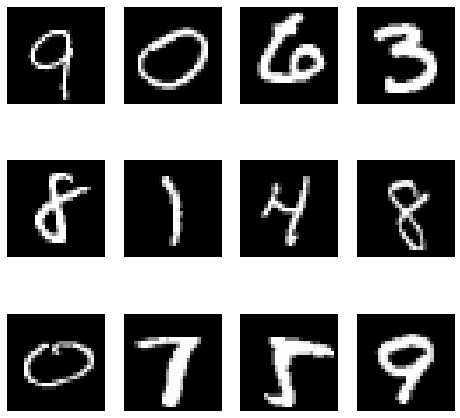

In [4]:
training_data = datasets.MNIST(
    root="data",
    download=True,
    transform=ToTensor()
)

def transform(x):
  return x[0][0]
training_data = [transform(x) for x in training_data]

print(f"There are {len(training_data)} examples to pick from. \nHere are some of them:")

figure = plt.figure(figsize=(8, 8))
cols = 4
rows = 3
for i in range(1, cols * rows + 1):
    sample_idx = torch.randint(len(training_data), size=(1,)).item()
    img = training_data[sample_idx]
    figure.add_subplot(rows, cols, i)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
plt.show()

We code some helper functions to help with the drawing process. We will input  the state to the neural network through 3 channels, one for the source we are supposed to copy, one for the current drawing, and one to indicate the current position and direction of the cursor.

In [5]:
side = 28
number_of_actions = 14

def load_source(id = 0):
  if id == 0: 
    id = randint(1, len(training_data)) - 1

  return training_data[id]

def reset():
    return cairo.ImageSurface(cairo.FORMAT_A8, side, side, data = None)

def bound(x, a, b):
    return min(max(x, a), b) 

def change_dir(angle, initial):
    x, y, direction = initial
    direction = (direction + angle)%360
    return x, y, direction

def move(length, initial):
    x, y, direction = initial
    x = x + bound(length*math.cos(direction*math.pi/180), 0, side)
    y = y + bound(length*math.sin(direction*math.pi/180), 0, side) 
    return x, y, direction

def draw(image, length, initial, width = 2):
    ctx = cairo.Context(image)
    ctx.set_line_width(width) 
    x, y, direction = initial
    ctx.move_to(x, y)
    x = bound(x + length*math.cos(direction*math.pi/180), 0, side)
    y = bound(y + length*math.sin(direction*math.pi/180), 0, side)
    ctx.line_to(x, y)
    ctx.stroke()
    return image, (x, y, direction)
   
def display(image):
    figure = plt.figure(figsize=(4, 4))
    img = np.asarray(image.get_data()).reshape(28,28)
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")
    plt.show()

def display_array(image):
    figure = plt.figure(figsize=(4, 4))
    plt.axis("off")
    plt.imshow(image.squeeze(), cmap="gray")
    plt.show()

def to_array(image):
    return np.asarray(image.get_data()).reshape(28,28)

def cursor_image(cursor):
    x,y,direction = cursor
    try: del cursor_img
    except: None
    cursor_img = reset()
    draw(cursor_img, 10, change_dir(135, move(2, cursor)), width = 1)
    draw(cursor_img, 10, change_dir(225, move(2, cursor)), width = 1)

    return np.asarray(cursor_img.get_data()).reshape(28,28)

def random_cursor(source_masked, source_length):
      x, y = source_masked[randint(0, source_length - 1)]
      return (x, y, randint(0, 360))


def source_mask(source):
    source_masked = (source > 0.5)
    length = np.sum(source_masked)
    source_list = []
    for i in range(side):
      for j in range(side):
        if source_masked[i,j] == True:
          source_list.append((i,j))
          
    return source_list, length

We code the reward function by calculating a score for how many of the coloured pixels in the source has been copied, and a penalty how many of the uncoloured pixels in the source has been drawn over. Feel free to experiment with different reward functions. I intend to add another reward function based on similarity of encoded vectors.

In [6]:
def calc_score(source, drawing, penalty_multiplier = 0.2):
    score = np.sum(source*(drawing>0))/max((np.sum(source)),100)
    source_2 = source + np.roll(source, -1, axis=0) + np.roll(source, 1, axis=0) + np.roll(source, -1, axis=1) + np.roll(source, 1, axis=1)
    source_2 = (source_2 == 0)
    penalty = np.sum(source_2*drawing)/(128*128)         #max(np.sum(drawing),100)
    #print(score)
    #print(penalty)

    return score/2 + max(score/2 - penalty_multiplier*penalty, 0)

The agent has 14 actions, the first of which is to jump to a random coloured pixel, the next 7 are to change it's direction, 2 to move forward without drawing, and 2 to move forward while drawing.

In [7]:
cursor_reset = (side/2, side/2, 90)
angle_list = [0,-90,-35,-20,20,35,90, 180]
distances = [4, 8]

def next_state(image, action, cursor, source_masked, source_length):
    
    if action == 0:
      cursor = random_cursor(source_masked, source_length)
      return image, cursor
    
    if action >= 1 and action <= 7:
      angle = angle_list[action]
      cursor = change_dir(angle, cursor)
      return image, cursor
    
    if action == 8:
      cursor = move(distances[0], cursor)
      return image, cursor
    
    if action == 9:
      cursor = move(distances[1], cursor)
      return image, cursor

    if action == 10:
      return draw(image, distances[0], cursor, width = 1)
    
    if action == 11:
      return draw(image, distances[0], cursor, width = 2) 
    
    if action == 12:
      return draw(image, distances[1], cursor, width = 1)
    
    if action == 13:
      return draw(image, distances[1], cursor, width = 2) 

Some hyperparameters. Experiment with them to try and get it to work better.

In [8]:
#game hyperparameters

number_of_steps = 50
reward_timestep = 1


#epsilon hyperparameters
final_epsilon = 0.01
initial_epsilon = 1
epsilon_timestep = 100
epsilon_decay = 0.98

gamma = 0.95
alpha = 0.5

#training_hyperparameters
number_of_iterations = 100000
replay_sampling = 0.4
max_replay_memory_size = 8000
#min_replay_memory_size = 5000
#replay_memory_multiplier = 0.2
minibatch_size = 32
learning_rate = 3e-6
learning_rate2 = 1e-7
steps_per_update = 40
epochs_per_train = 1

In [9]:
class NeuralNetwork(nn.Module):

    def __init__(self):
        super(NeuralNetwork, self).__init__()

        self.conv1 = nn.Conv2d(3, 12, 5, padding = 2)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(12, 32, 5)
        self.pool = nn.AvgPool2d(kernel_size = 2, stride = 2)
        self.conv3 = nn.Conv2d(32, 120, 5)
        self.fc4 = nn.Linear(7680, 800)
        self.fc5 = nn.Linear(800, 800)
        self.fc6 = nn.Linear(800, number_of_actions)

    def forward(self, x):
        out = self.conv1(x)
        out = self.relu(out)
        out = self.conv2(out)
        out = self.relu(out)
        out = self.pool(out)
        out = self.conv3(out)
        out = self.relu(out)
        out = out.view(out.size()[0], -1)
        out = self.fc4(out)
        out = self.relu(out)
        out = self.fc5(out)
        out = self.relu(out)
        out = self.fc6(out)

        return out


In [10]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = NeuralNetwork()
model = model.to(device)
#model.load_state_dict(torch.load("/content/drive/MyDrive/Aleph/model3"))
summary(model,(3, 28, 28))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 12, 28, 28]             912
              ReLU-2           [-1, 12, 28, 28]               0
            Conv2d-3           [-1, 32, 24, 24]           9,632
              ReLU-4           [-1, 32, 24, 24]               0
         AvgPool2d-5           [-1, 32, 12, 12]               0
            Conv2d-6            [-1, 120, 8, 8]          96,120
              ReLU-7            [-1, 120, 8, 8]               0
            Linear-8                  [-1, 800]       6,144,800
              ReLU-9                  [-1, 800]               0
           Linear-10                  [-1, 800]         640,800
             ReLU-11                  [-1, 800]               0
           Linear-12                   [-1, 14]          11,214
Total params: 6,903,478
Trainable params: 6,903,478
Non-trainable params: 0
---------------------------

In [11]:
def criterion(pred, y, z):
  return (pred[0, z] - y)**2

In [12]:
class MyDataset(Dataset):
    def __init__(self, state_memory, target_memory, action_memory):
        self.state_memory = state_memory
        self.target_memory = target_memory
        self.action_memory = action_memory
        
    def __getitem__(self, index):
        state = state_memory[index]
        target = target_memory[index]
        action = action_memory[index]
        
        return state, target, action
        
    def __len__(self):
        return len(self.state)

In [13]:
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>

In [14]:
def test_model(model, image = 0, epsilon = 0):

    source = np.asarray(load_source(0))
    source_masked, source_length = source_mask(source)
    cursor = random_cursor(source_masked, source_length)
    drawing = reset()
    cursor_img = cursor_image(cursor)
    cumulative_reward = 0
    state_array = np.zeros((3, side, side))

    step = 0

    state_array[0] = source
    state_array[1] = to_array(drawing)
    state_array[2] = cursor_img

    while step < number_of_steps:
      step += 1



      state = torch.from_numpy(state_array)
      state = state.to(device)
      state = state.unsqueeze(0).float()
      with torch.no_grad():
        action_vec = model(state)

      if random() < epsilon:
        action = randint(0,number_of_actions - 1)
      else: 
        action = torch.argmax(action_vec).item()

      drawing, cursor = next_state(drawing, action, cursor, source_masked, source_length)

      state_array[1] = to_array(drawing)
      state_array[2] = cursor_image(cursor)
      score = calc_score(source, to_array(drawing))

    
    score = calc_score(source, to_array(drawing))
    return score

In [15]:
def train_network(model, replay_memory, l_rate = 1e-6, epochs = 1):

  optimizer = torch.optim.Adam(model.parameters(), lr=l_rate)
  total_loss = 0
  loss_counter = 0
  
  state_memory, target_memory, action_memory = replay_memory
  
  for epoch in range(epochs):
    for i in range(len(action_memory)):


      if random() < replay_sampling:
        x = state_memory[i].unsqueeze(0)
        y = target_memory[i]
        z = action_memory[i]

        pred = model(x)
        

        loss = criterion(pred, y, z)
        
        if z != 0:
          total_loss += loss.detach().item()
          loss_counter += 1
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

  print(f"Loss: {total_loss/loss_counter}")
  writer.add_scalar("3. Loss", total_loss/loss_counter , iter)



Train your model here. Every update step it will print the average score and display an example of it's "drawing". I haven't quite managed to get it to draw efficiently but at least it's learning to optimize it's reward function and creating somewhat discernible shapes. Usually takes almost 1000 training steps (or 40k iterations) or so for scores to really start improving. It usually learns to just not draw anything to avoid penalties before that. Feel free to experiment with different initialization strategies.

Loss: 0.07798388255121845
Iteration: 0, Score: 0.07399694621562958
[3, 2, 6, 1, 3, 4, 5, 4, 4, 1, 2, 6, 5, 5, 0]


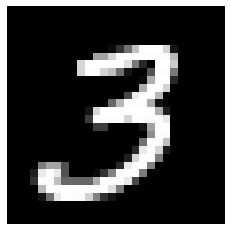

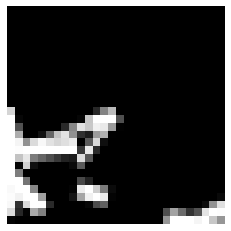

Test score: 0.09258187956176699
Loss: 0.029792801261130934
Iteration: 40, Score: 0.13484764722362158
[69, 67, 89, 67, 61, 65, 72, 67, 73, 75, 56, 87, 74, 78, 0]


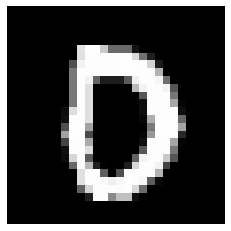

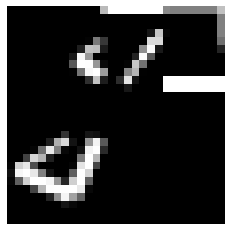

Loss: 0.02202003558072266
Iteration: 80, Score: 0.124048873041349
[69, 67, 89, 67, 61, 65, 72, 67, 73, 75, 56, 87, 74, 78, 0]


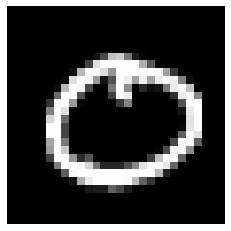

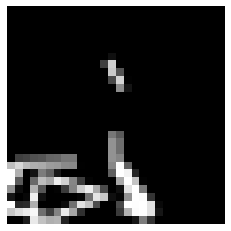

Loss: 0.019915397750477022
Iteration: 120, Score: 0.1394801738858223
[69, 67, 89, 67, 61, 65, 72, 67, 73, 75, 56, 87, 74, 78, 0]


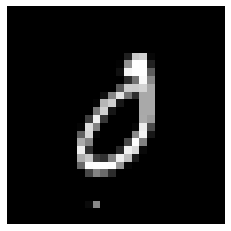

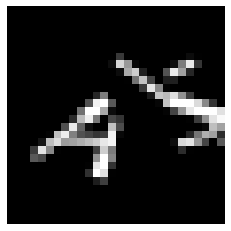

Loss: 0.01648376412618864
Iteration: 160, Score: 0.13898153259977697
[69, 67, 89, 67, 61, 65, 72, 67, 73, 75, 56, 87, 74, 78, 0]


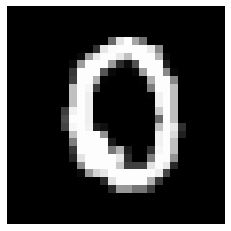

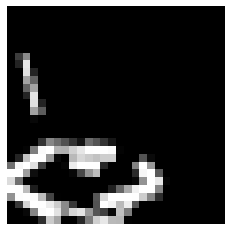

Loss: 0.012541487428707303
Iteration: 200, Score: 0.1444481479153037
[67, 82, 71, 75, 70, 63, 73, 62, 67, 77, 68, 74, 74, 77, 0]


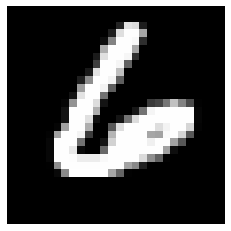

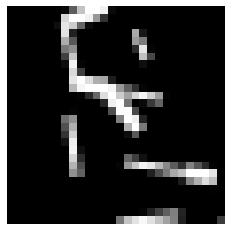

Loss: 0.011508297044444784
Iteration: 240, Score: 0.12102535611763596
[80, 64, 76, 55, 63, 72, 70, 72, 67, 65, 82, 70, 85, 79, 0]


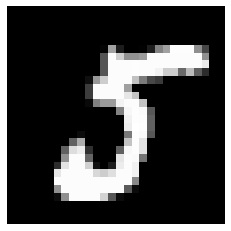

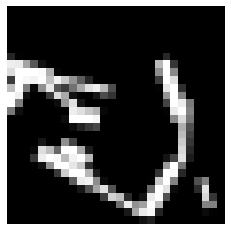

Loss: 0.010903894935645512
Iteration: 280, Score: 0.17216856141388412
[92, 63, 61, 73, 79, 69, 65, 72, 67, 72, 85, 58, 76, 68, 0]


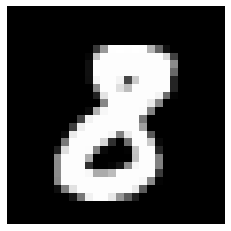

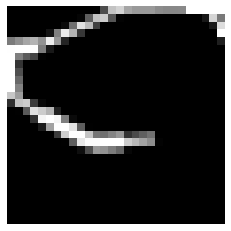

Loss: 0.010355038981368237
Iteration: 320, Score: 0.13822457964718343
[94, 64, 69, 62, 81, 79, 84, 54, 76, 67, 67, 67, 72, 64, 0]


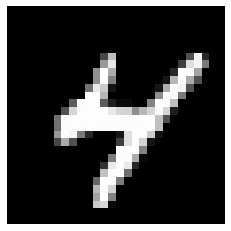

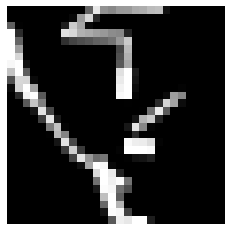

Loss: 0.00903302649288917
Iteration: 360, Score: 0.14158425629884003
[77, 60, 69, 62, 74, 77, 67, 63, 78, 82, 64, 59, 89, 79, 0]


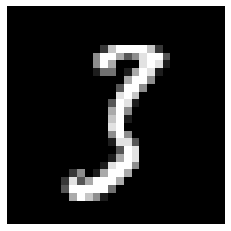

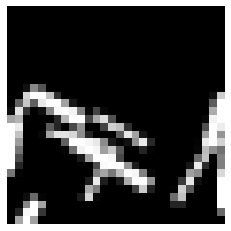

Loss: 0.008887966517770228
Iteration: 400, Score: 0.1393278102837503
[109, 73, 67, 77, 77, 68, 68, 54, 77, 62, 60, 71, 64, 73, 0]


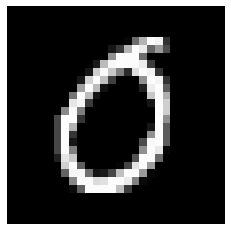

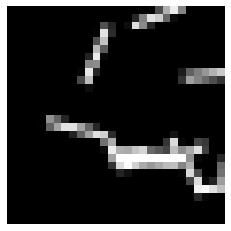

Test score: 0.15791178494412453
Loss: 0.00838265148629622
Iteration: 440, Score: 0.14854832094535234
[80, 80, 73, 78, 72, 86, 59, 63, 71, 67, 65, 55, 87, 64, 0]


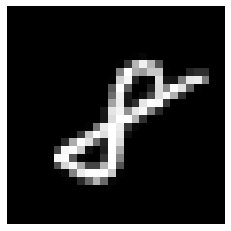

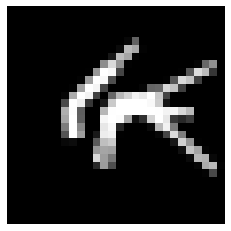

Loss: 0.007438589084508141
Iteration: 480, Score: 0.11953142822906375
[84, 67, 56, 68, 65, 68, 69, 73, 61, 65, 60, 76, 108, 80, 0]


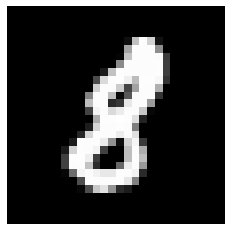

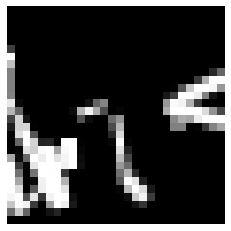

Loss: 0.008207907809804607
Iteration: 520, Score: 0.11633249916741621
[86, 63, 74, 68, 73, 86, 67, 62, 61, 77, 72, 55, 64, 92, 0]


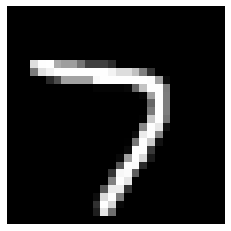

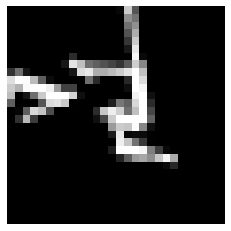

Loss: 0.006894560989588024
Iteration: 560, Score: 0.11119698975607754
[95, 58, 57, 51, 65, 72, 70, 76, 72, 65, 70, 65, 84, 100, 0]


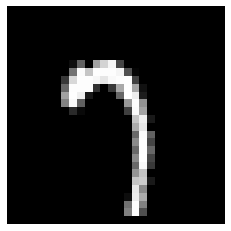

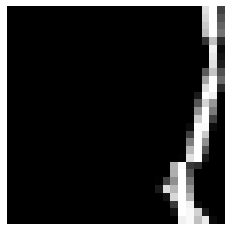

Loss: 0.006908669501176832
Iteration: 600, Score: 0.14520547601208095
[65, 82, 71, 61, 51, 70, 70, 72, 73, 63, 64, 66, 106, 86, 0]


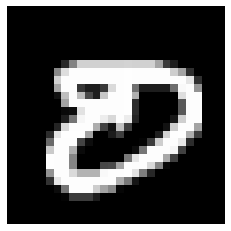

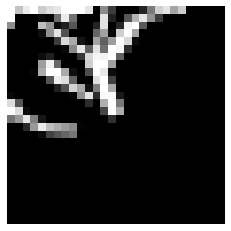

Loss: 0.00665917531606852
Iteration: 640, Score: 0.12022548732534051
[82, 75, 74, 71, 71, 59, 58, 76, 73, 56, 84, 50, 72, 99, 0]


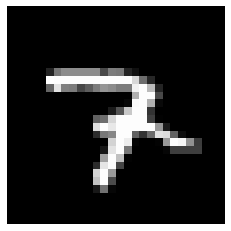

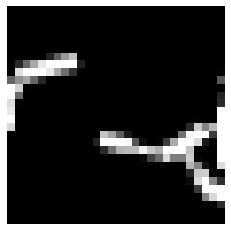

Loss: 0.006595854871916564
Iteration: 680, Score: 0.13761004114151
[85, 74, 65, 68, 69, 61, 53, 74, 77, 58, 72, 66, 92, 86, 0]


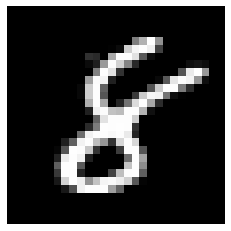

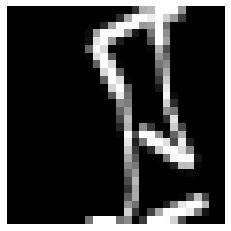

Loss: 0.005902753282013108
Iteration: 720, Score: 0.13353800562396645
[80, 60, 76, 71, 80, 73, 69, 59, 57, 66, 59, 89, 67, 94, 0]


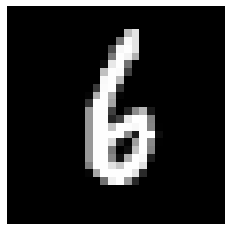

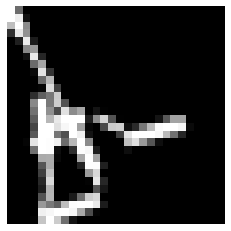

Loss: 0.006497092580010872
Iteration: 760, Score: 0.15502261606231332
[100, 51, 74, 64, 66, 68, 70, 64, 66, 64, 89, 72, 75, 77, 0]


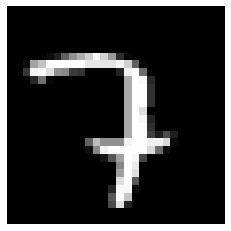

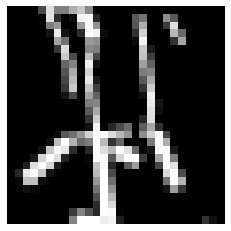

Loss: 0.007244435688613039
Iteration: 800, Score: 0.16354823415781722
[66, 61, 81, 57, 71, 68, 67, 51, 74, 75, 70, 75, 84, 100, 0]


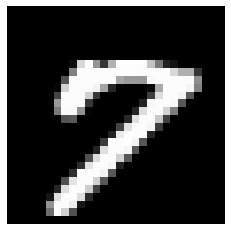

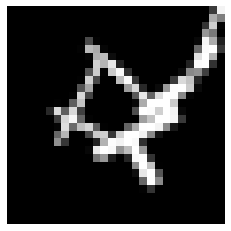

Test score: 0.11177357665449383
Loss: 0.0060692859404647345
Iteration: 840, Score: 0.14655860292911527
[68, 62, 50, 79, 70, 47, 65, 67, 68, 67, 66, 78, 85, 128, 0]


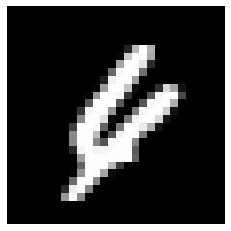

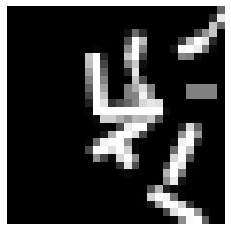

Loss: 0.006817546734535971
Iteration: 880, Score: 0.15311569965630772
[79, 93, 74, 60, 57, 66, 63, 54, 64, 70, 76, 79, 74, 91, 0]


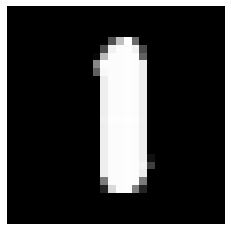

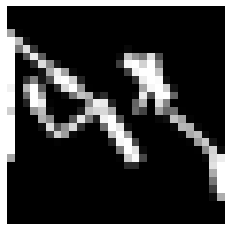

Loss: 0.006143650429917146
Iteration: 920, Score: 0.13265733789652587
[92, 59, 73, 63, 72, 63, 66, 72, 68, 69, 82, 76, 73, 72, 0]


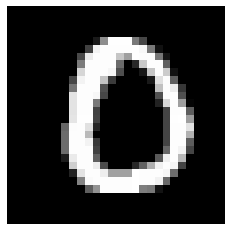

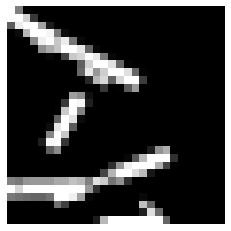

Loss: 0.0065179628355491025
Iteration: 960, Score: 0.1578857958577573
[92, 76, 67, 60, 69, 61, 68, 65, 70, 58, 75, 73, 70, 96, 0]


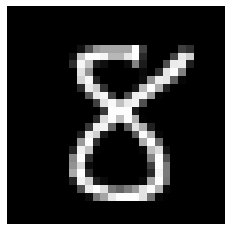

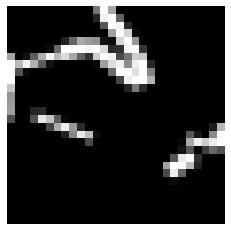

Loss: 0.00632748084317758
Iteration: 1000, Score: 0.2106616517677903
[72, 64, 61, 72, 55, 77, 70, 68, 71, 60, 75, 74, 83, 98, 0]


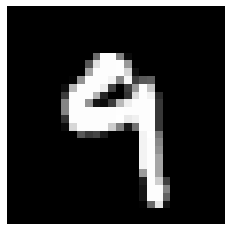

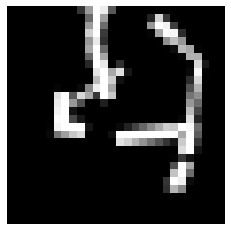

Loss: 0.006539193416207524
Iteration: 1040, Score: 0.15278447987139224
[85, 66, 56, 76, 63, 61, 69, 73, 69, 63, 64, 84, 68, 103, 0]


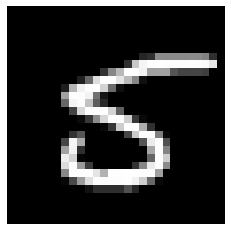

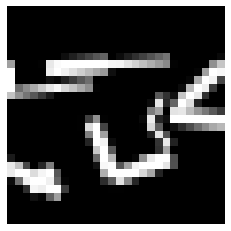

Loss: 0.005863218316697341
Iteration: 1080, Score: 0.15557056437060238
[90, 78, 64, 44, 68, 66, 71, 78, 67, 58, 63, 98, 71, 84, 0]


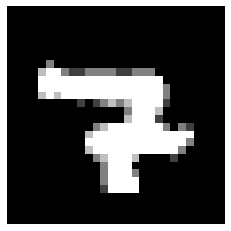

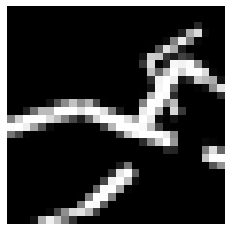

Loss: 0.006263559776669554
Iteration: 1120, Score: 0.16928625401481984
[103, 77, 80, 68, 71, 79, 61, 54, 53, 69, 60, 89, 65, 71, 0]


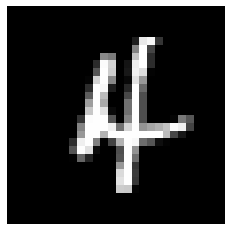

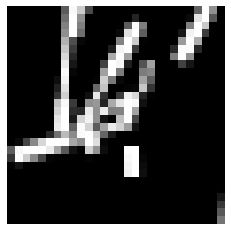

Loss: 0.005269720745377004
Iteration: 1160, Score: 0.16906190836802126
[119, 61, 52, 50, 64, 70, 54, 63, 70, 70, 89, 76, 69, 93, 0]


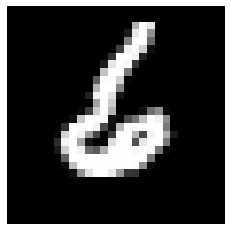

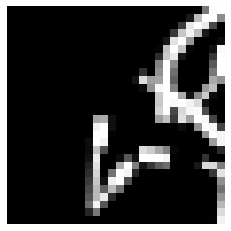

Loss: 0.005938684655629909
Iteration: 1200, Score: 0.1843866318464279
[86, 62, 54, 73, 65, 79, 56, 65, 73, 64, 75, 75, 63, 110, 0]


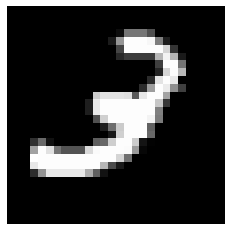

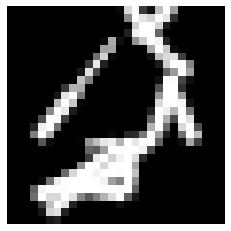

Test score: 0.09333491396368482
Loss: 0.006771178774030824
Iteration: 1240, Score: 0.15340117546543483
[91, 55, 75, 62, 59, 86, 72, 71, 57, 71, 66, 84, 64, 87, 0]


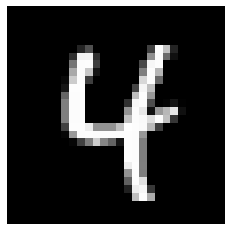

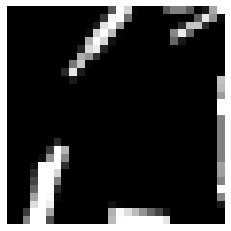

Loss: 0.00643483660811315
Iteration: 1280, Score: 0.1928742435351014
[102, 71, 64, 50, 62, 68, 69, 56, 68, 59, 48, 126, 78, 79, 0]


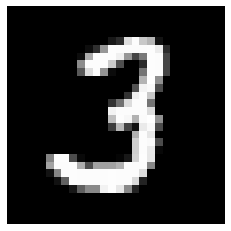

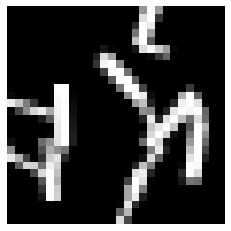

Loss: 0.005918192393400727
Iteration: 1320, Score: 0.17385794821009043
[96, 64, 53, 62, 78, 75, 74, 72, 70, 59, 54, 84, 69, 90, 0]


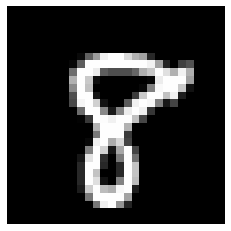

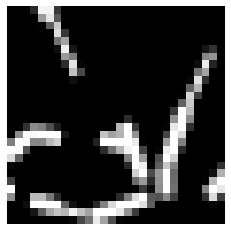

Loss: 0.005569099775073431
Iteration: 1360, Score: 0.17277207636833194
[102, 74, 54, 59, 57, 65, 85, 77, 82, 69, 50, 68, 60, 98, 0]


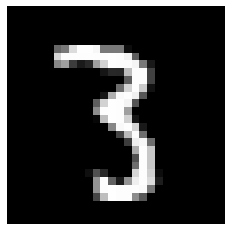

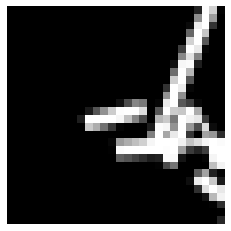

Loss: 0.006443024771705721
Iteration: 1400, Score: 0.15817976608127354
[102, 54, 78, 64, 67, 58, 56, 52, 69, 76, 83, 67, 63, 111, 0]


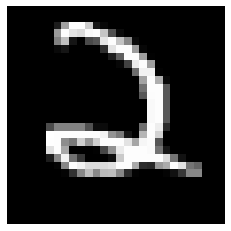

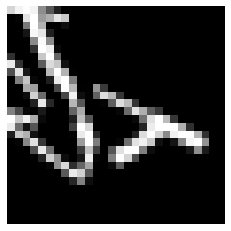

Loss: 0.0052784898208747535
Iteration: 1440, Score: 0.1731393435448408
[102, 55, 70, 58, 83, 49, 62, 64, 70, 60, 69, 94, 63, 101, 0]


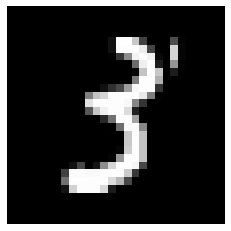

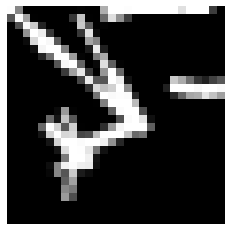

Loss: 0.005870477253454088
Iteration: 1480, Score: 0.16941186106950043
[104, 64, 67, 52, 67, 76, 55, 47, 81, 70, 70, 70, 62, 115, 0]


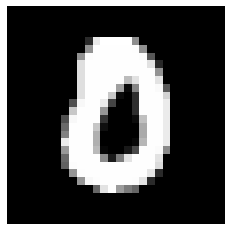

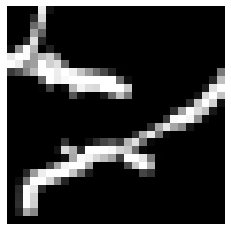

Loss: 0.005335054310541065
Iteration: 1520, Score: 0.14444016259163617
[101, 69, 54, 67, 75, 76, 61, 62, 67, 54, 75, 73, 57, 109, 0]


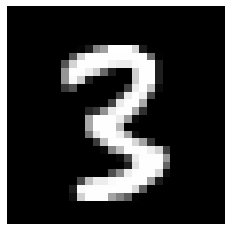

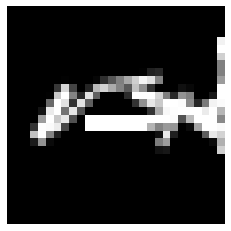

Loss: 0.004348422247393641
Iteration: 1560, Score: 0.1912858644872904
[97, 72, 62, 60, 60, 75, 66, 94, 65, 63, 67, 82, 49, 88, 0]


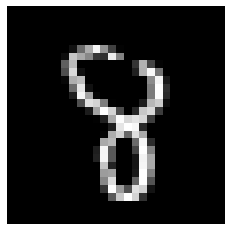

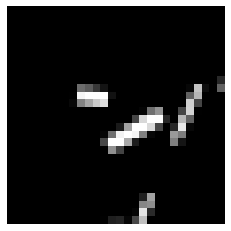

Loss: 0.005229798852549031
Iteration: 1600, Score: 0.15840464706718924
[85, 65, 70, 57, 62, 78, 69, 83, 60, 52, 67, 76, 58, 118, 0]


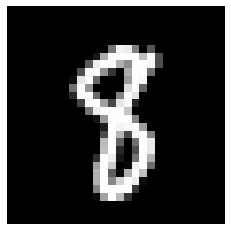

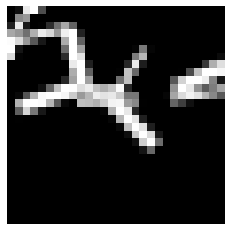

Test score: 0.13576232137158517
Loss: 0.006018563246867357
Iteration: 1640, Score: 0.18855673242360352
[88, 70, 65, 79, 64, 47, 56, 66, 59, 71, 73, 89, 65, 108, 0]


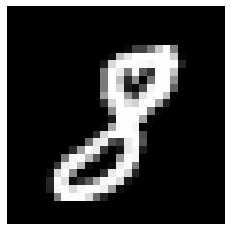

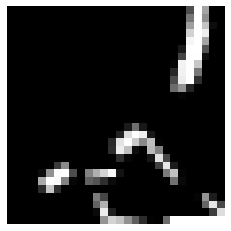

Loss: 0.005749586166506147
Iteration: 1680, Score: 0.1494757507033646
[112, 79, 48, 65, 61, 51, 70, 72, 64, 62, 68, 95, 54, 99, 0]


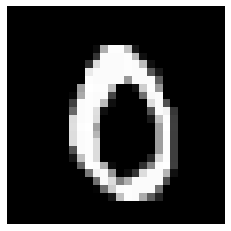

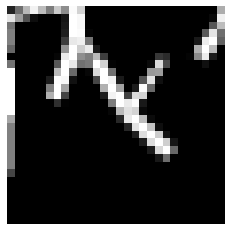

Loss: 0.005622818349905366
Iteration: 1720, Score: 0.16935323173180222
[113, 60, 68, 60, 59, 66, 56, 68, 72, 64, 51, 98, 69, 96, 0]


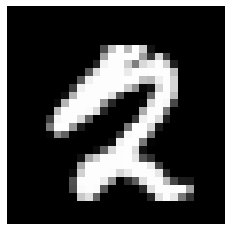

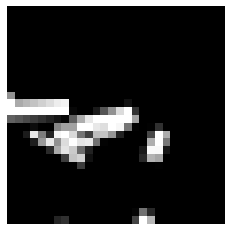

Loss: 0.005747635453275025
Iteration: 1760, Score: 0.18797700989618896
[89, 63, 54, 52, 56, 93, 65, 66, 54, 63, 67, 77, 73, 128, 0]


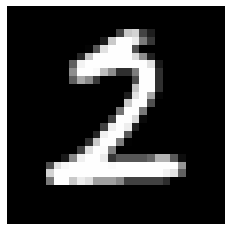

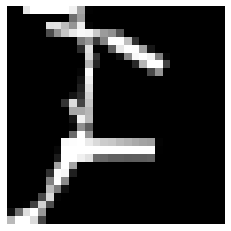

Loss: 0.005343628213479789
Iteration: 1800, Score: 0.14944051701575517
[93, 71, 70, 75, 69, 65, 69, 68, 78, 51, 67, 85, 53, 86, 0]


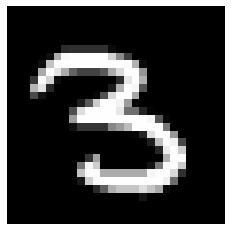

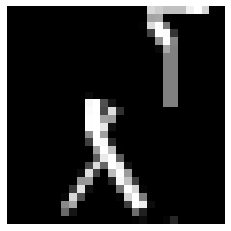

Loss: 0.005776248613766648
Iteration: 1840, Score: 0.17235115896351635
[96, 78, 68, 66, 68, 69, 67, 71, 55, 48, 74, 88, 68, 84, 0]


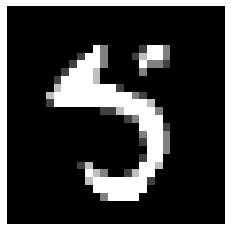

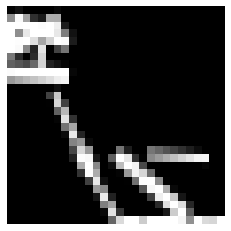

Loss: 0.005758908448539343
Iteration: 1880, Score: 0.15656585481762889
[86, 57, 68, 72, 82, 72, 69, 68, 60, 78, 56, 87, 48, 97, 0]


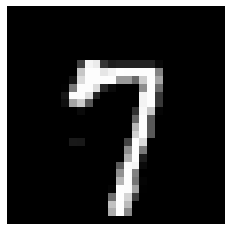

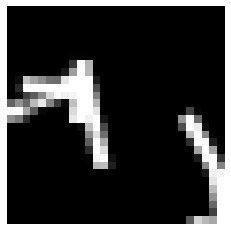

Loss: 0.005940349427756279
Iteration: 1920, Score: 0.18313645186647767
[87, 69, 56, 105, 44, 78, 79, 71, 44, 65, 56, 74, 60, 112, 0]


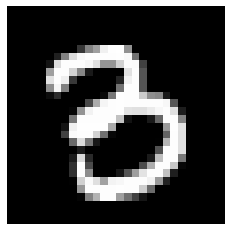

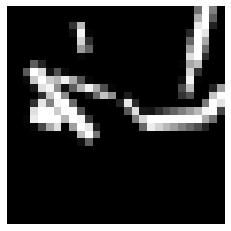

Loss: 0.00584137826147168
Iteration: 1960, Score: 0.1511009489148855
[77, 56, 67, 76, 39, 75, 72, 89, 68, 60, 50, 85, 62, 124, 0]


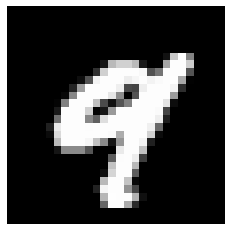

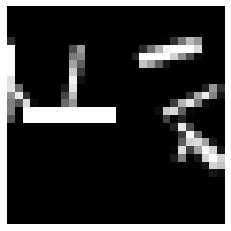

Loss: 0.0047618648489290176
Iteration: 2000, Score: 0.1658172034397722
[71, 51, 77, 56, 64, 87, 48, 63, 65, 67, 59, 77, 53, 162, 0]


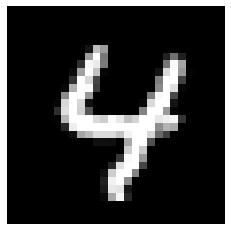

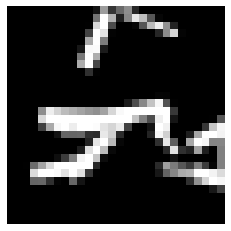

Test score: 0.1117511669434607
Loss: 0.0053192338721491225
Iteration: 2040, Score: 0.17780614341795445
[80, 76, 64, 76, 58, 77, 79, 52, 64, 71, 47, 62, 68, 126, 0]


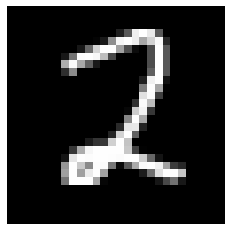

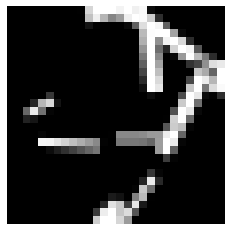

Loss: 0.006212768181245175
Iteration: 2080, Score: 0.1711609070301056
[75, 72, 64, 70, 73, 78, 91, 55, 81, 70, 56, 67, 52, 96, 0]


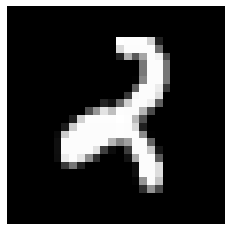

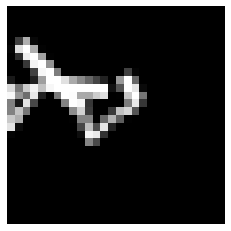

Loss: 0.005315033191079504
Iteration: 2120, Score: 0.1722573397522792
[101, 48, 64, 54, 55, 75, 96, 64, 71, 58, 51, 92, 67, 104, 0]


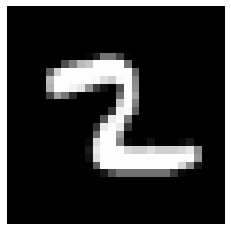

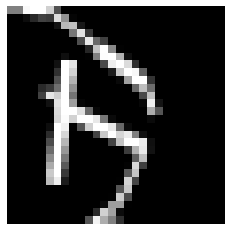

Loss: 0.005461520550755181
Iteration: 2160, Score: 0.19444017536193142
[80, 73, 64, 59, 61, 75, 70, 67, 49, 60, 64, 92, 73, 113, 0]


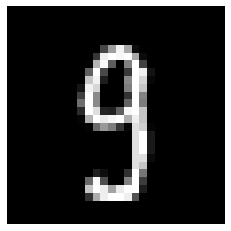

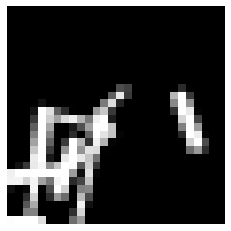

Loss: 0.0045451969530360195
Iteration: 2200, Score: 0.15601035479828715
[67, 99, 64, 86, 75, 60, 58, 57, 64, 70, 50, 78, 63, 109, 0]


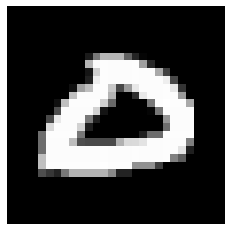

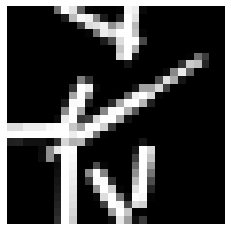

Loss: 0.004571320071234833
Iteration: 2240, Score: 0.1966853448413312
[100, 59, 65, 59, 85, 62, 63, 79, 69, 61, 61, 80, 55, 102, 0]


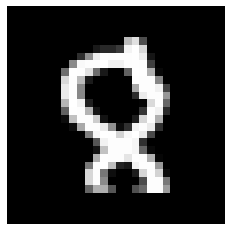

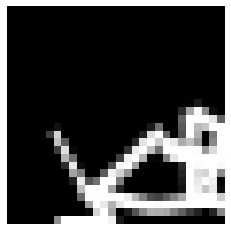

Loss: 0.005477152869748272
Iteration: 2280, Score: 0.1552079503983259
[76, 69, 64, 56, 61, 81, 65, 107, 65, 67, 50, 80, 59, 100, 0]


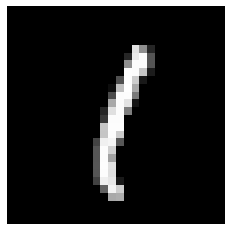

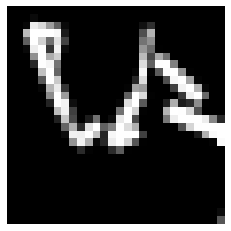

Loss: 0.004816575974651931
Iteration: 2320, Score: 0.179349146194756
[98, 78, 77, 78, 52, 81, 69, 77, 50, 42, 45, 83, 72, 98, 0]


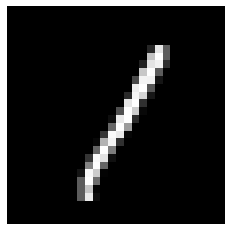

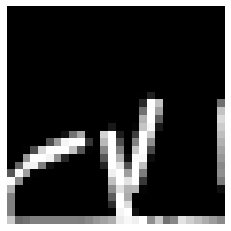

Loss: 0.0043185631766841665
Iteration: 2360, Score: 0.17982943715527655
[70, 69, 61, 53, 87, 71, 53, 69, 52, 85, 53, 88, 65, 124, 0]


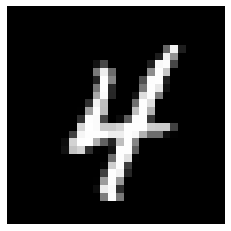

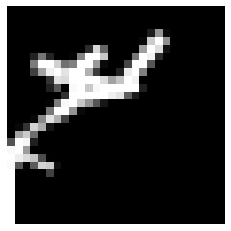

Loss: 0.0054465648564751895
Iteration: 2400, Score: 0.14887595660611988
[78, 96, 58, 79, 60, 66, 54, 70, 65, 58, 45, 106, 70, 95, 0]


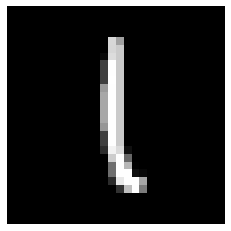

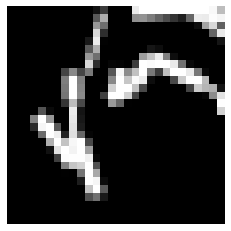

Test score: 0.13013597286492587
Loss: 0.005567364542772247
Iteration: 2440, Score: 0.16754247979447248
[79, 54, 57, 62, 61, 75, 72, 105, 58, 56, 60, 82, 59, 120, 0]


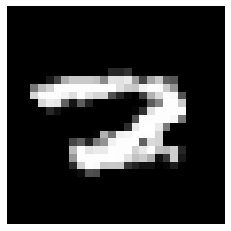

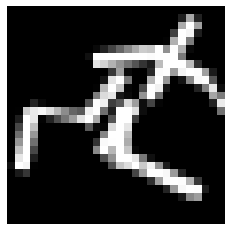

Loss: 0.0046232792397943
Iteration: 2480, Score: 0.1675974343647249
[79, 72, 47, 67, 65, 75, 50, 96, 79, 68, 57, 98, 66, 81, 0]


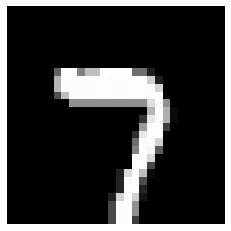

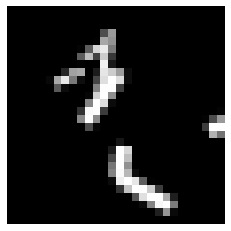

Loss: 0.005582445726012298
Iteration: 2520, Score: 0.1462887150086462
[77, 65, 74, 74, 62, 70, 69, 68, 63, 50, 51, 83, 50, 144, 0]


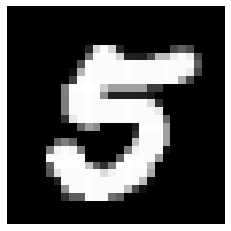

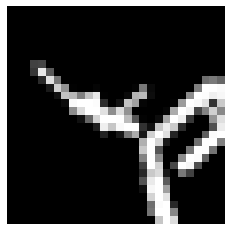

Loss: 0.004493254671116177
Iteration: 2560, Score: 0.1718608482554555
[76, 91, 60, 86, 67, 62, 65, 55, 54, 67, 50, 84, 49, 134, 0]


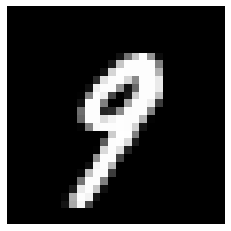

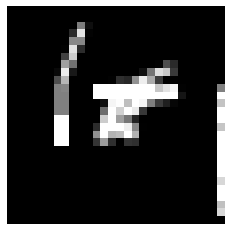

Loss: 0.004516883398382306
Iteration: 2600, Score: 0.20343560111522674
[109, 67, 61, 79, 53, 88, 56, 72, 68, 40, 49, 92, 67, 99, 0]


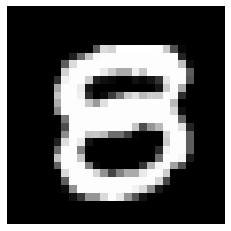

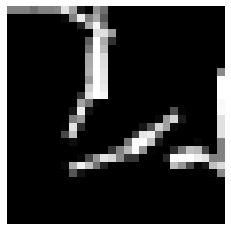

Loss: 0.004716218157385449
Iteration: 2640, Score: 0.14724185590445993
[95, 83, 61, 77, 78, 67, 108, 72, 46, 52, 44, 74, 54, 89, 0]


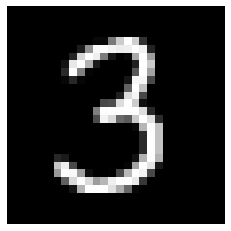

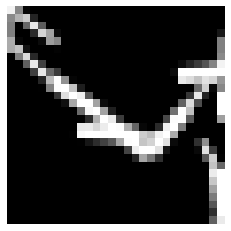

Loss: 0.004564518759870475
Iteration: 2680, Score: 0.19237494622543455
[88, 85, 57, 56, 72, 104, 81, 75, 46, 53, 53, 68, 67, 95, 0]


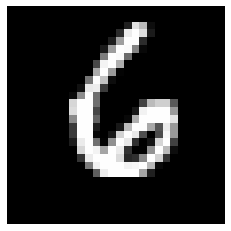

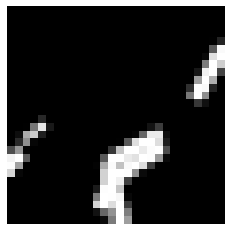

Loss: 0.00451441335629516
Iteration: 2720, Score: 0.15923591086640954
[102, 64, 74, 66, 63, 99, 72, 53, 76, 69, 34, 64, 60, 104, 0]


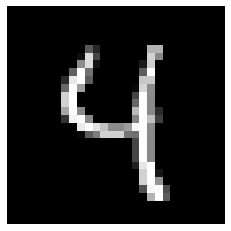

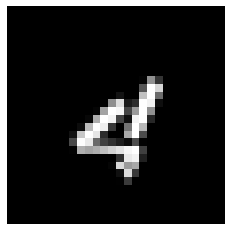

Loss: 0.004621369975006039
Iteration: 2760, Score: 0.15671407959610226
[79, 66, 77, 59, 55, 107, 46, 56, 68, 63, 54, 73, 79, 118, 0]


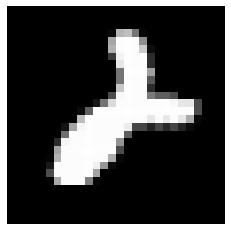

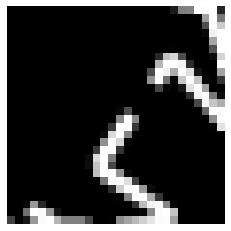

Loss: 0.003751261201138458
Iteration: 2800, Score: 0.16790950851887465
[61, 49, 92, 92, 51, 118, 43, 85, 50, 59, 54, 72, 63, 111, 0]


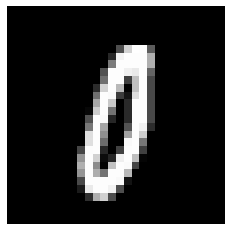

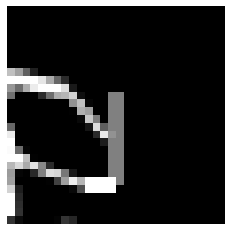

Test score: 0.12247642789920792
Loss: 0.004340822414233871
Iteration: 2840, Score: 0.14274845471978187
[82, 82, 129, 52, 56, 81, 71, 61, 47, 65, 41, 89, 57, 87, 0]


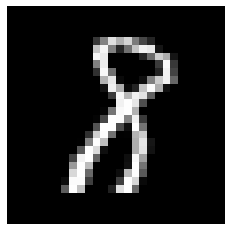

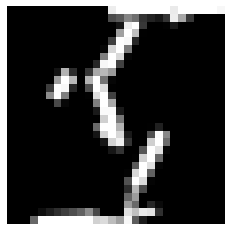

Loss: 0.004605934310002164
Iteration: 2880, Score: 0.1549993190690875
[87, 99, 68, 68, 57, 101, 92, 60, 65, 55, 49, 56, 55, 88, 0]


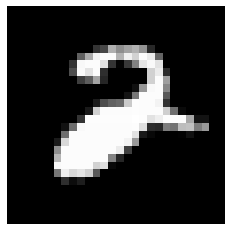

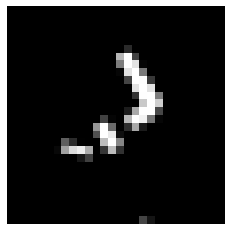

Loss: 0.003983654610199289
Iteration: 2920, Score: 0.18633439849317074
[69, 66, 57, 89, 41, 105, 73, 67, 54, 73, 75, 65, 56, 110, 0]


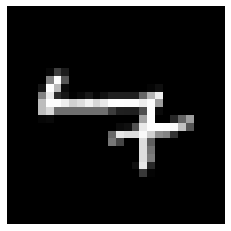

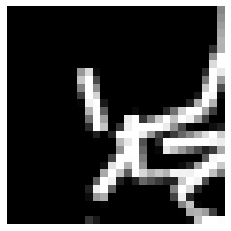

Loss: 0.0037735197570731597
Iteration: 2960, Score: 0.1609155986495316
[72, 44, 100, 66, 71, 71, 84, 71, 53, 73, 42, 71, 65, 117, 0]


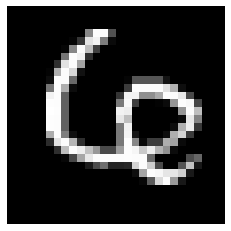

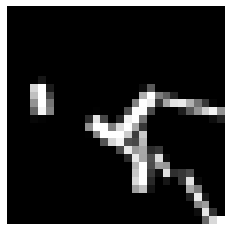

Loss: 0.004011124703505293
Iteration: 3000, Score: 0.20658898108522408
[70, 82, 78, 58, 52, 78, 98, 81, 55, 42, 61, 61, 92, 92, 0]


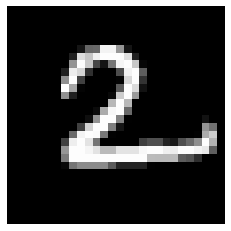

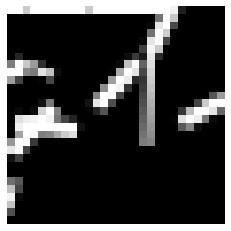

Loss: 0.004167662432791908
Iteration: 3040, Score: 0.1596401837468147
[78, 64, 54, 95, 56, 64, 134, 57, 99, 53, 55, 60, 46, 85, 0]


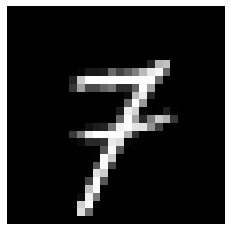

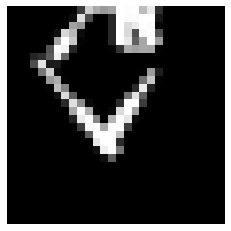

Loss: 0.003940194212341149
Iteration: 3080, Score: 0.17504270536825062
[118, 91, 59, 70, 55, 97, 74, 51, 82, 56, 51, 56, 54, 86, 0]


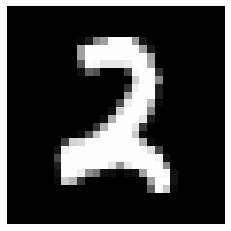

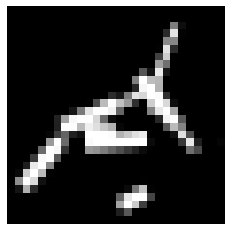

Loss: 0.004136654150289281
Iteration: 3120, Score: 0.15316301464661955
[118, 82, 64, 94, 56, 87, 54, 62, 82, 72, 54, 59, 47, 69, 0]


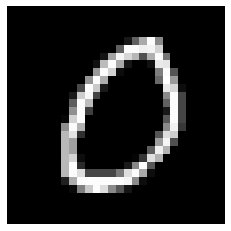

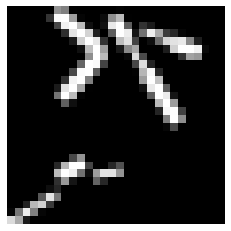

Loss: 0.0035250251749516072
Iteration: 3160, Score: 0.15344884459674354
[67, 131, 109, 79, 62, 63, 41, 70, 54, 53, 42, 58, 58, 113, 0]


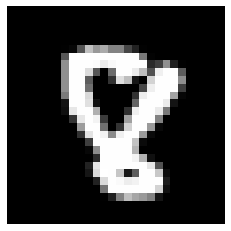

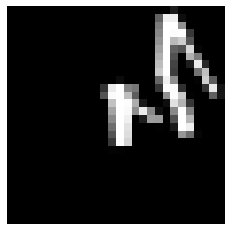

Loss: 0.004777743715314865
Iteration: 3200, Score: 0.15549569905549288
[103, 81, 60, 89, 61, 57, 105, 97, 68, 60, 46, 40, 50, 83, 0]


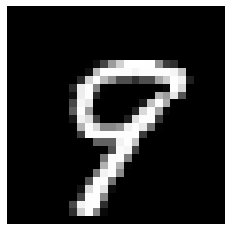

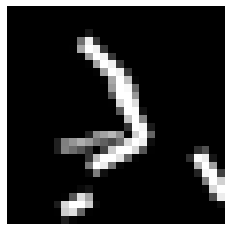

Test score: 0.12455161785706878
Loss: 0.0040101110533160185
Iteration: 3240, Score: 0.1872869158536196
[88, 70, 53, 77, 56, 114, 68, 68, 84, 50, 62, 61, 83, 66, 0]


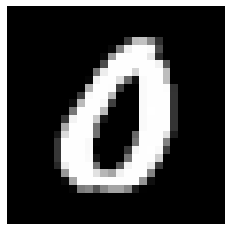

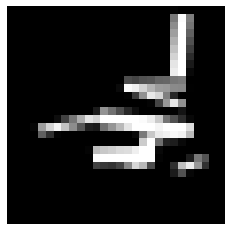

Loss: 0.0036607967635462458
Iteration: 3280, Score: 0.15623060404136774
[82, 69, 61, 59, 49, 97, 88, 65, 82, 57, 67, 61, 53, 110, 0]


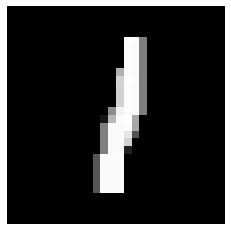

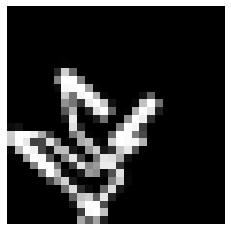

Loss: 0.003900083122732514
Iteration: 3320, Score: 0.17441574032604695
[80, 62, 58, 92, 84, 76, 94, 80, 72, 80, 37, 51, 39, 95, 0]


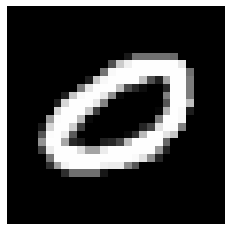

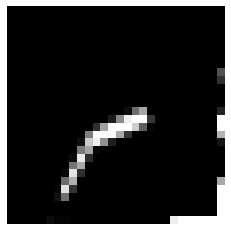

Loss: 0.004098503694346527
Iteration: 3360, Score: 0.14147355931997302
[61, 57, 56, 61, 98, 54, 119, 87, 71, 78, 55, 46, 50, 107, 0]


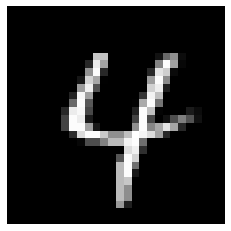

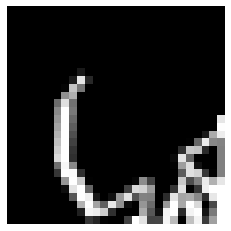

Loss: 0.0039244882901067315
Iteration: 3400, Score: 0.18283830902725456
[71, 53, 66, 76, 46, 94, 58, 85, 95, 48, 79, 78, 60, 91, 0]


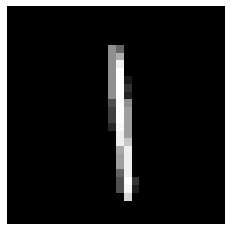

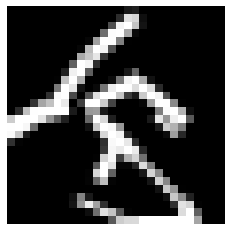

Loss: 0.0038380886519714607
Iteration: 3440, Score: 0.14138737577944996
[89, 87, 47, 46, 43, 96, 49, 92, 115, 54, 76, 58, 61, 87, 0]


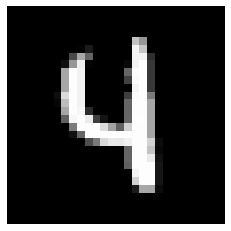

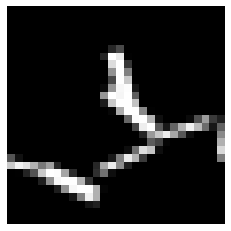

Loss: 0.004263668118725873
Iteration: 3480, Score: 0.14684939052537088
[56, 125, 68, 64, 57, 96, 67, 110, 64, 60, 36, 54, 52, 91, 0]


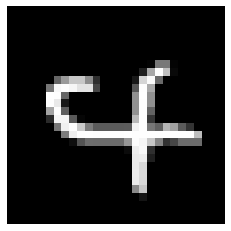

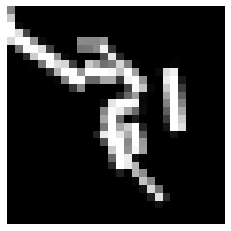

Loss: 0.0037262987687353834
Iteration: 3520, Score: 0.1656916538476944
[74, 62, 58, 58, 52, 82, 73, 79, 94, 50, 71, 75, 50, 122, 0]


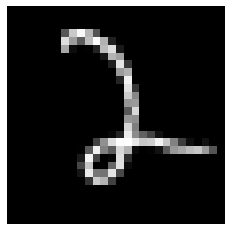

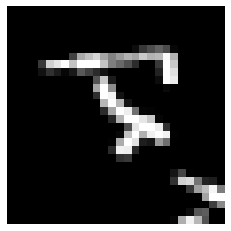

Loss: 0.0035872483672057674
Iteration: 3560, Score: 0.15179521011561156
[82, 42, 59, 129, 40, 128, 77, 62, 63, 57, 79, 60, 44, 78, 0]


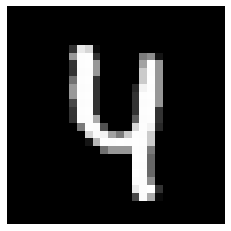

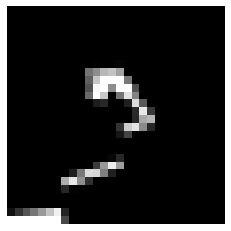

Loss: 0.003574225237354579
Iteration: 3600, Score: 0.15203616639412937
[69, 69, 41, 125, 79, 80, 73, 56, 64, 99, 45, 45, 75, 80, 0]


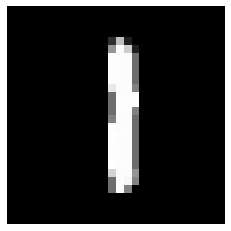

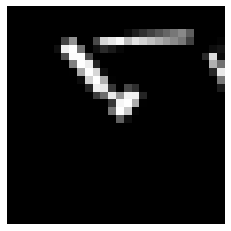

Test score: 0.0906036228593439
Loss: 0.003730598813976743
Iteration: 3640, Score: 0.1701373109519482
[78, 59, 44, 91, 80, 72, 93, 58, 97, 47, 55, 81, 65, 80, 0]


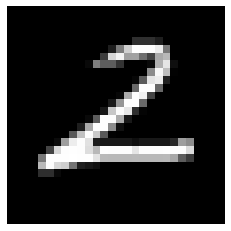

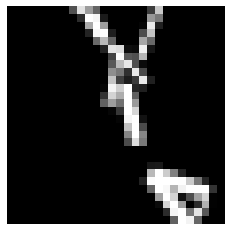

Loss: 0.0037250717902635104
Iteration: 3680, Score: 0.18881980262696746
[72, 83, 51, 83, 67, 87, 120, 43, 81, 53, 56, 56, 58, 90, 0]


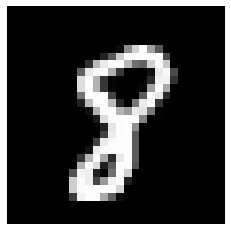

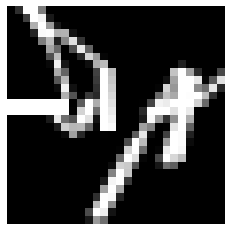

Loss: 0.003686725022722386
Iteration: 3720, Score: 0.12657292296364903
[85, 76, 75, 89, 69, 52, 73, 45, 75, 68, 85, 65, 34, 109, 0]


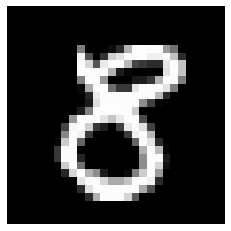

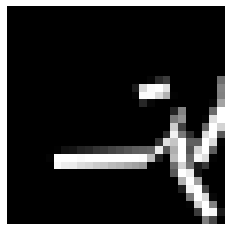

Loss: 0.0038686968588908066
Iteration: 3760, Score: 0.18675357706844806
[79, 73, 59, 100, 72, 145, 98, 43, 48, 69, 52, 61, 40, 61, 0]


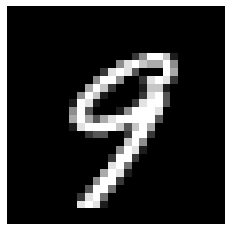

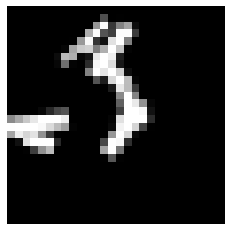

Loss: 0.0040897088715568354
Iteration: 3800, Score: 0.1485275802761316
[98, 96, 47, 106, 70, 80, 93, 61, 54, 53, 62, 52, 46, 82, 0]


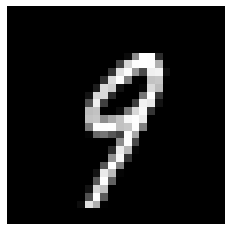

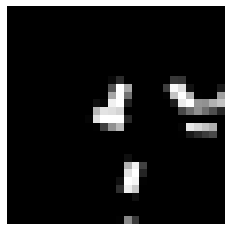

Loss: 0.004036651229837135
Iteration: 3840, Score: 0.1679339019544423
[58, 118, 130, 75, 65, 66, 74, 60, 45, 43, 59, 84, 48, 75, 0]


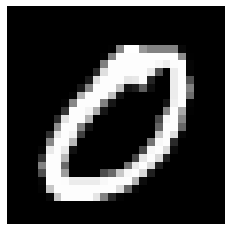

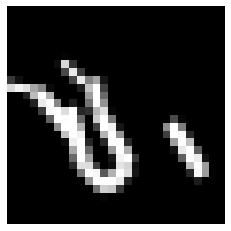

Loss: 0.00381566274789292
Iteration: 3880, Score: 0.1714970743325539
[125, 70, 67, 149, 55, 52, 84, 73, 54, 50, 49, 71, 35, 66, 0]


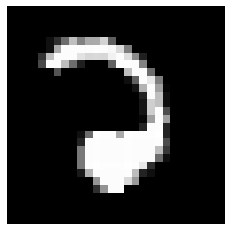

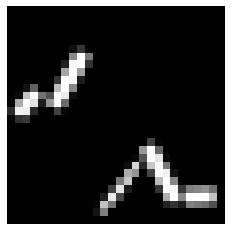

Loss: 0.0037284100625732132
Iteration: 3920, Score: 0.1719829817488789
[71, 72, 58, 125, 96, 70, 117, 51, 50, 71, 48, 61, 42, 68, 0]


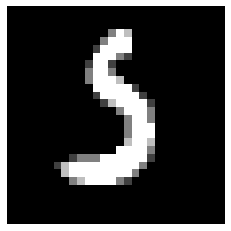

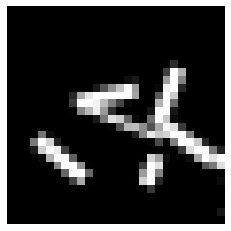

Loss: 0.003994003176505854
Iteration: 3960, Score: 0.14604303061217064
[75, 60, 48, 132, 104, 79, 52, 80, 84, 55, 64, 52, 47, 68, 0]


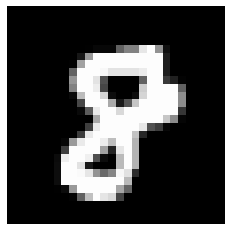

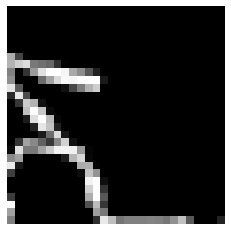

Loss: 0.003939435864801319
Iteration: 4000, Score: 0.18466922746598718
[63, 96, 134, 54, 83, 47, 155, 57, 43, 37, 53, 61, 52, 65, 0]


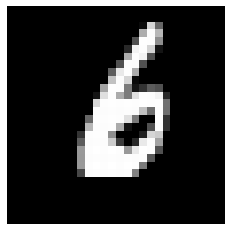

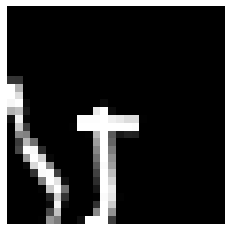

Test score: 0.1079448146019131
Loss: 0.003848749484715307
Iteration: 4040, Score: 0.1710370273292065
[62, 70, 66, 110, 74, 67, 152, 59, 103, 44, 35, 39, 47, 72, 0]


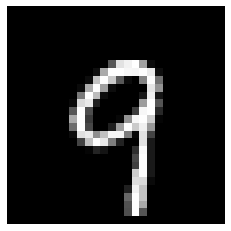

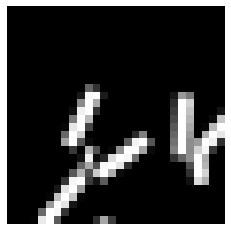

Loss: 0.004854162644410292
Iteration: 4080, Score: 0.1446165596097708
[105, 47, 85, 115, 70, 111, 74, 44, 67, 48, 62, 59, 52, 61, 0]


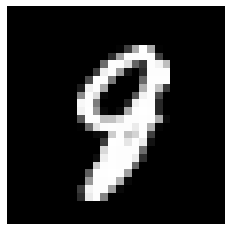

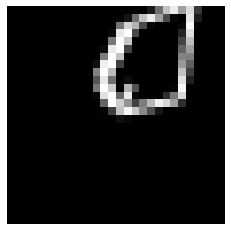

Loss: 0.004042140401918378
Iteration: 4120, Score: 0.18888814637064938
[111, 59, 65, 77, 140, 62, 144, 42, 55, 45, 40, 52, 51, 57, 0]


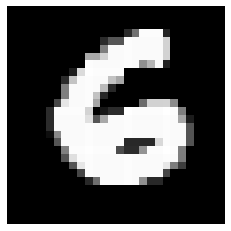

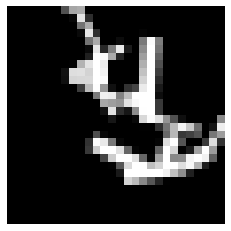

Loss: 0.003605510535807944
Iteration: 4160, Score: 0.17317369600012902
[70, 115, 102, 38, 133, 49, 101, 89, 45, 44, 47, 41, 39, 87, 0]


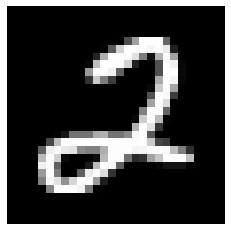

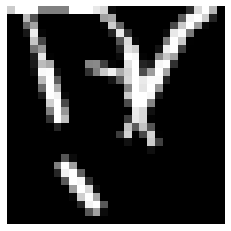

Loss: 0.004862745884919205
Iteration: 4200, Score: 0.1561550711169839
[70, 95, 64, 52, 72, 102, 95, 103, 70, 46, 45, 56, 43, 87, 0]


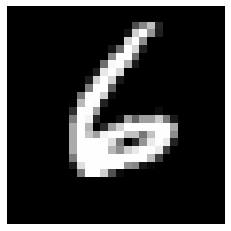

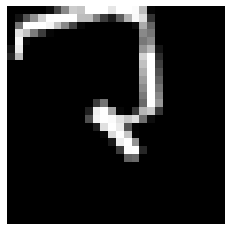

Loss: 0.0046823988424657455
Iteration: 4240, Score: 0.15859198763407764
[89, 53, 55, 111, 86, 92, 74, 71, 78, 46, 50, 57, 55, 83, 0]


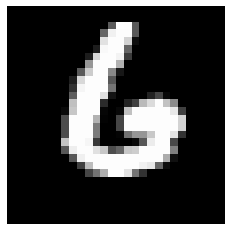

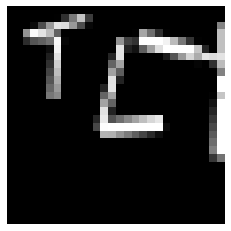

Loss: 0.0047960572338581085
Iteration: 4280, Score: 0.15095684152096506
[120, 92, 55, 53, 67, 100, 75, 67, 44, 77, 31, 67, 54, 98, 0]


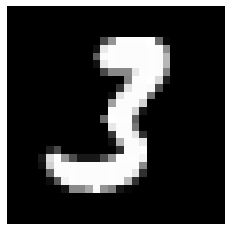

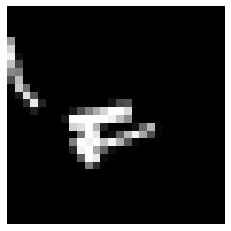

Loss: 0.004799318815785187
Iteration: 4320, Score: 0.13444069098867478
[68, 74, 47, 56, 117, 50, 76, 88, 167, 41, 49, 47, 50, 70, 0]


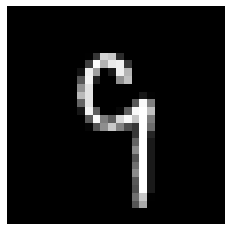

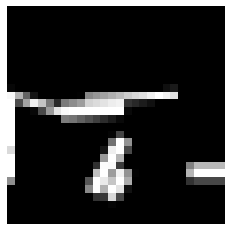

Loss: 0.0039026176897246504
Iteration: 4360, Score: 0.2016079139783979
[56, 75, 124, 63, 87, 66, 92, 72, 99, 46, 61, 39, 39, 81, 0]


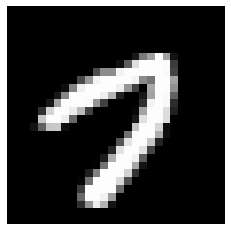

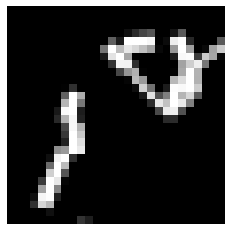

Loss: 0.00460156544939666
Iteration: 4400, Score: 0.15476694079674777
[52, 66, 106, 59, 79, 157, 106, 109, 33, 48, 49, 51, 37, 48, 0]


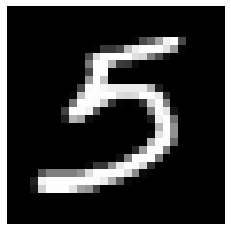

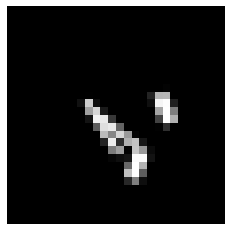

Test score: 0.08356684304587543
Loss: 0.004286038917029658
Iteration: 4440, Score: 0.13262267461791638
[60, 62, 97, 51, 97, 82, 70, 72, 53, 147, 38, 49, 37, 85, 0]


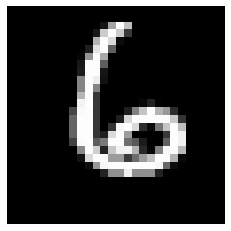

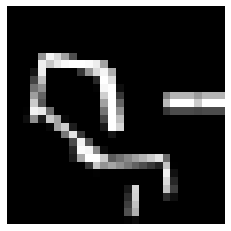

Loss: 0.004407243371079986
Iteration: 4480, Score: 0.15863279025629162
[70, 194, 68, 46, 62, 49, 98, 57, 52, 79, 38, 73, 39, 75, 0]


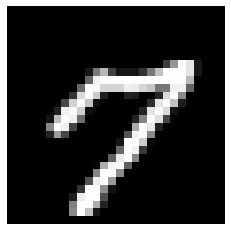

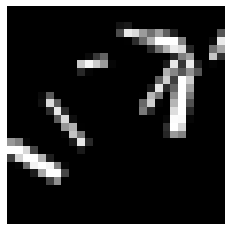

Loss: 0.004973388754902149
Iteration: 4520, Score: 0.18272078939527275
[100, 61, 105, 38, 54, 59, 169, 82, 82, 41, 39, 76, 29, 65, 0]


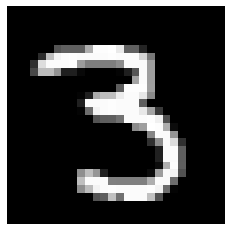

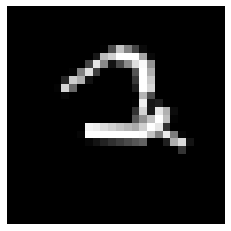

Loss: 0.004511964797194357
Iteration: 4560, Score: 0.1788616123348475
[68, 65, 175, 68, 61, 113, 100, 72, 32, 60, 33, 33, 38, 82, 0]


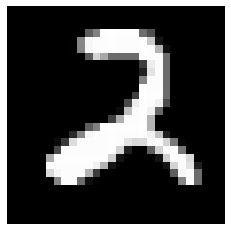

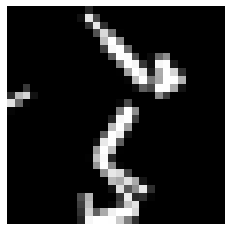

Loss: 0.004340664980040963
Iteration: 4600, Score: 0.17526550410687924
[78, 72, 72, 63, 104, 57, 57, 134, 56, 94, 42, 48, 44, 79, 0]


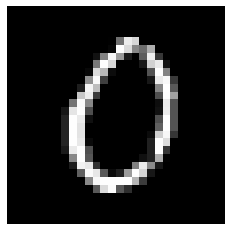

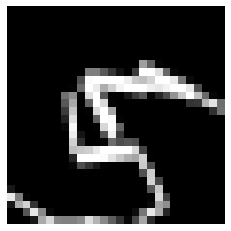

Loss: 0.004222586193366165
Iteration: 4640, Score: 0.14311052028089763
[66, 174, 135, 46, 44, 85, 48, 97, 49, 53, 47, 69, 35, 52, 0]


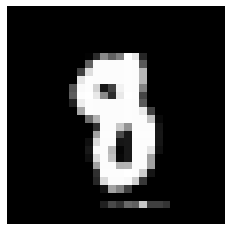

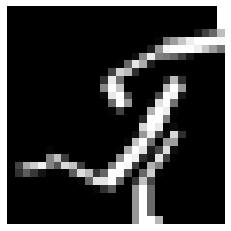

Loss: 0.0046174464572226025
Iteration: 4680, Score: 0.172138800047338
[82, 55, 73, 46, 83, 62, 231, 81, 54, 35, 48, 42, 47, 61, 0]


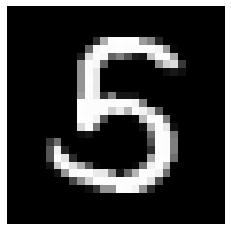

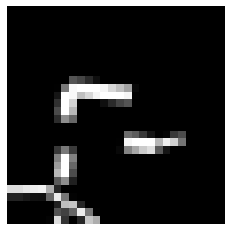

Loss: 0.003993816035775902
Iteration: 4720, Score: 0.1485841199271381
[77, 50, 82, 51, 59, 59, 271, 51, 35, 65, 25, 31, 49, 95, 0]


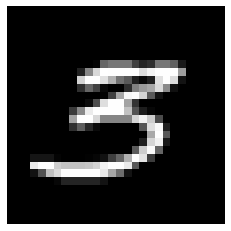

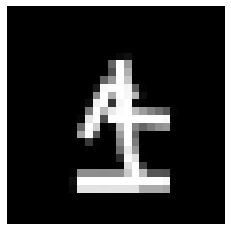

Loss: 0.004626051714870378
Iteration: 4760, Score: 0.14923106064274905
[67, 53, 204, 41, 47, 92, 72, 83, 69, 47, 53, 56, 40, 76, 0]


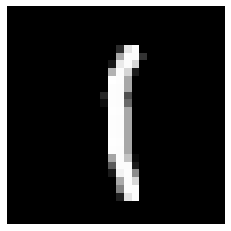

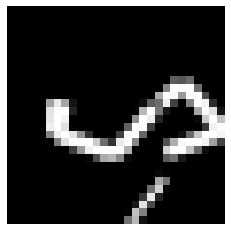

Loss: 0.0041717632201469556
Iteration: 4800, Score: 0.15374854151345785
[80, 104, 128, 36, 71, 89, 43, 82, 114, 47, 44, 61, 49, 52, 0]


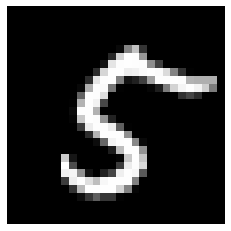

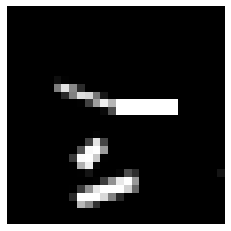

Test score: 0.08962908272305506
Loss: 0.005042882615289267
Iteration: 4840, Score: 0.14674552241712807
[65, 56, 81, 54, 44, 55, 241, 73, 59, 33, 42, 85, 47, 65, 0]


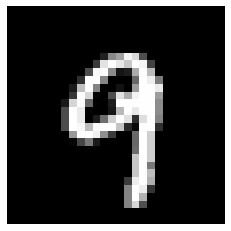

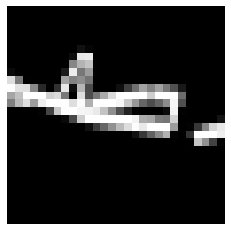

Loss: 0.00440850691116719
Iteration: 4880, Score: 0.17721080253645777
[106, 44, 92, 50, 66, 83, 199, 57, 58, 54, 28, 54, 48, 61, 0]


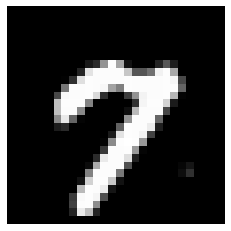

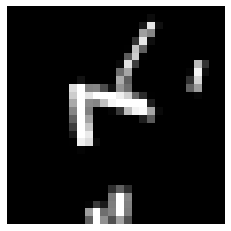

Loss: 0.003660865691815535
Iteration: 4920, Score: 0.19652962726727127
[115, 63, 216, 52, 60, 41, 44, 64, 86, 49, 37, 32, 47, 94, 0]


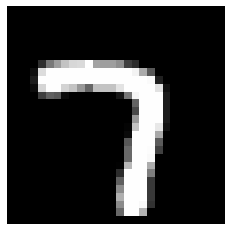

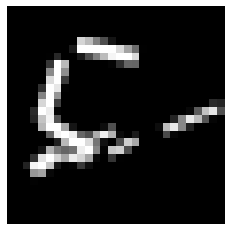

Loss: 0.0043702542931493525
Iteration: 4960, Score: 0.18419482386857275
[69, 91, 125, 108, 67, 84, 51, 48, 72, 51, 43, 82, 47, 62, 0]


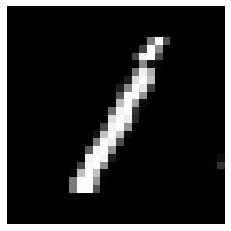

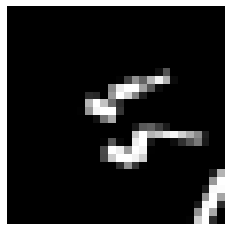

Loss: 0.0038780222628232914
Iteration: 5000, Score: 0.1924121503941715
[106, 114, 57, 108, 66, 79, 54, 110, 71, 60, 41, 43, 32, 59, 0]


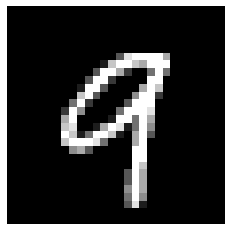

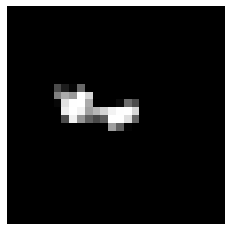

Loss: 0.0040042830175080315
Iteration: 5040, Score: 0.17491568657942116
[122, 44, 47, 55, 77, 138, 107, 118, 36, 65, 36, 50, 50, 55, 0]


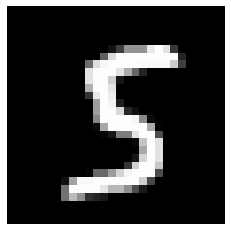

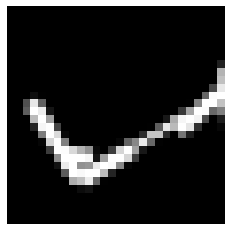

Loss: 0.0037154655564283104
Iteration: 5080, Score: 0.16222390500456096
[100, 53, 153, 52, 54, 55, 180, 39, 51, 45, 37, 47, 36, 98, 0]


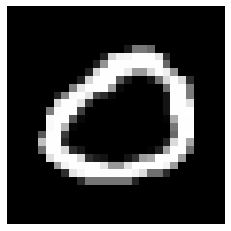

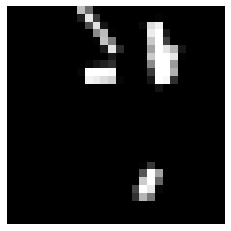

Loss: 0.0039346823747121165
Iteration: 5120, Score: 0.1824504415094852
[76, 88, 151, 95, 58, 27, 87, 57, 96, 72, 37, 52, 38, 66, 0]


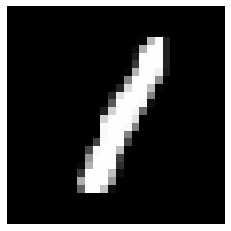

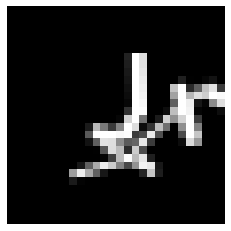

Loss: 0.004950304861291404
Iteration: 5160, Score: 0.17820137503370648
[111, 120, 94, 66, 59, 48, 172, 43, 51, 51, 37, 60, 34, 54, 0]


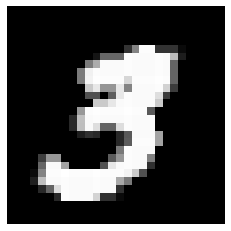

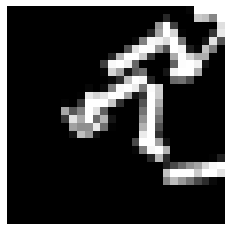

Loss: 0.0038298213417355953
Iteration: 5200, Score: 0.15420624900236723
[57, 54, 133, 71, 167, 34, 161, 55, 57, 49, 32, 35, 43, 52, 0]


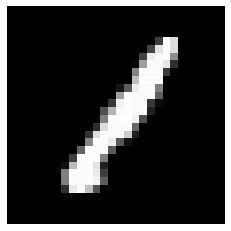

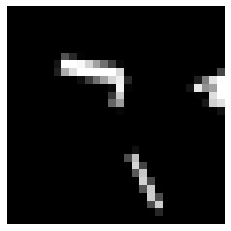

Test score: 0.07376049125302234
Loss: 0.00487683389754734
Iteration: 5240, Score: 0.11757749654073271
[111, 96, 104, 58, 64, 33, 188, 40, 37, 95, 40, 59, 23, 52, 0]


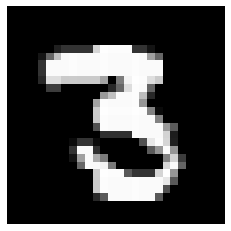

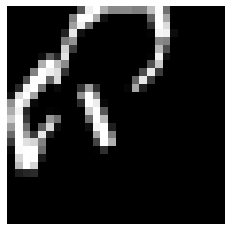

Loss: 0.004505132549047682
Iteration: 5280, Score: 0.13617807107046248
[51, 59, 132, 67, 56, 52, 71, 149, 107, 46, 45, 63, 40, 62, 0]


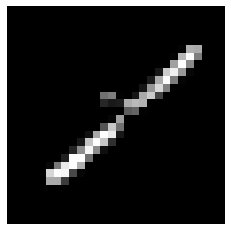

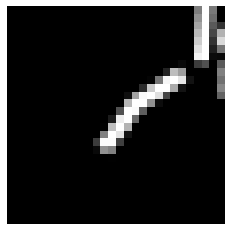

Loss: 0.0044411361141429885
Iteration: 5320, Score: 0.16399023667350413
[66, 104, 97, 81, 53, 87, 119, 81, 58, 51, 39, 71, 43, 50, 0]


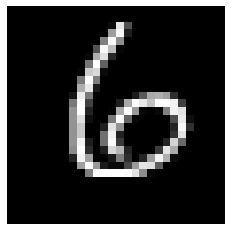

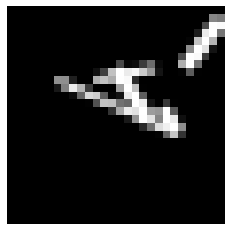

Loss: 0.003913498346401551
Iteration: 5360, Score: 0.16100092375278469
[74, 103, 114, 150, 45, 48, 126, 66, 32, 49, 41, 67, 52, 33, 0]


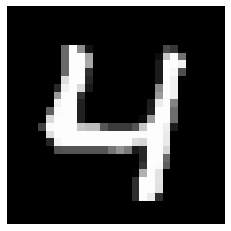

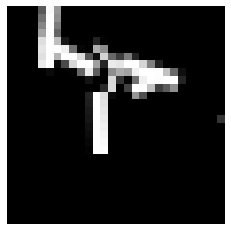

Loss: 0.0037244411600728783
Iteration: 5400, Score: 0.16341681332886218
[55, 36, 123, 82, 145, 39, 105, 54, 79, 69, 63, 57, 39, 54, 0]


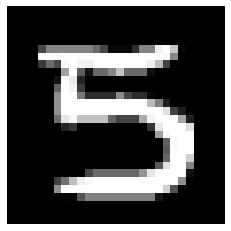

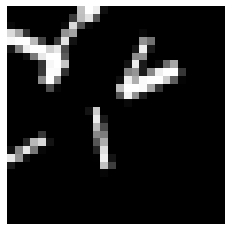

Loss: 0.003782951321537321
Iteration: 5440, Score: 0.14563904364593327
[46, 48, 64, 75, 107, 57, 51, 190, 114, 39, 40, 67, 43, 59, 0]


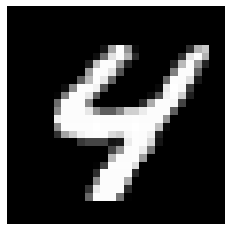

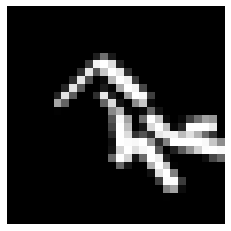

Loss: 0.0037382224299806585
Iteration: 5480, Score: 0.14545371703058482
[83, 57, 138, 79, 46, 133, 61, 72, 65, 71, 45, 44, 33, 73, 0]


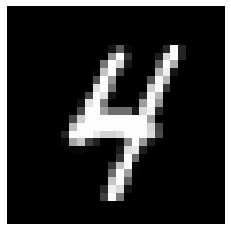

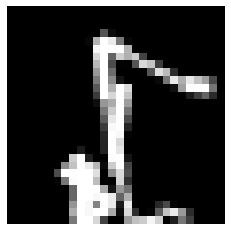

Loss: 0.0034904904724966206
Iteration: 5520, Score: 0.15954365790635344
[76, 109, 75, 72, 96, 183, 94, 49, 43, 38, 41, 35, 39, 50, 0]


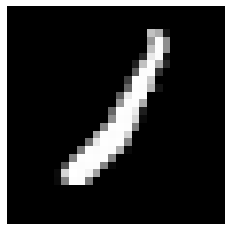

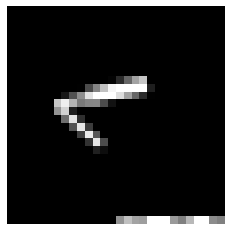

Loss: 0.0038580670624981835
Iteration: 5560, Score: 0.1429414312262088
[78, 48, 161, 90, 186, 49, 74, 36, 55, 49, 34, 61, 36, 43, 0]


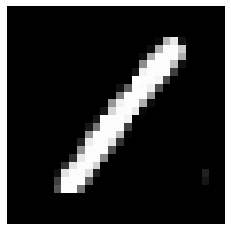

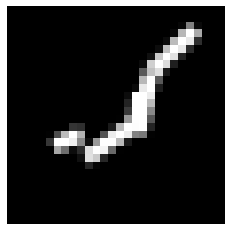

Loss: 0.003210451409212827
Iteration: 5600, Score: 0.17092422332242135
[83, 97, 84, 86, 91, 92, 78, 48, 118, 35, 33, 49, 40, 66, 0]


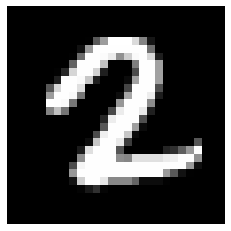

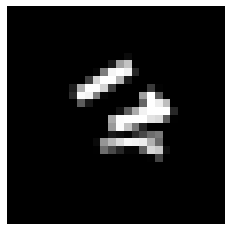

Test score: 0.06023273347131908
Loss: 0.0036818358759411153
Iteration: 5640, Score: 0.12351478260383006
[90, 66, 80, 106, 42, 53, 81, 175, 62, 49, 53, 47, 34, 62, 0]


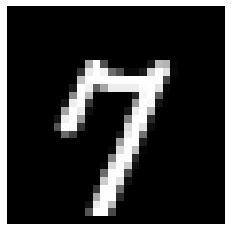

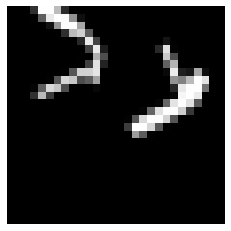

Loss: 0.004091576007952696
Iteration: 5680, Score: 0.13933150513842701
[72, 66, 91, 178, 103, 80, 69, 86, 55, 33, 41, 39, 38, 49, 0]


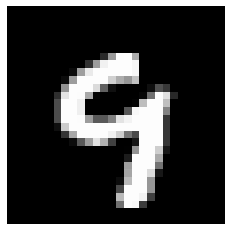

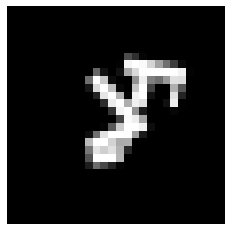

Loss: 0.003364992200414058
Iteration: 5720, Score: 0.1395839125886559
[125, 48, 87, 90, 135, 64, 133, 65, 61, 34, 33, 37, 46, 42, 0]


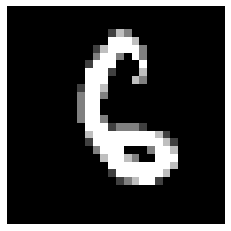

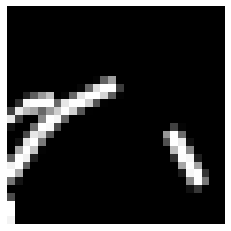

Loss: 0.003737780679144011
Iteration: 5760, Score: 0.14407587515376508
[84, 115, 102, 89, 96, 49, 128, 44, 78, 47, 46, 48, 36, 38, 0]


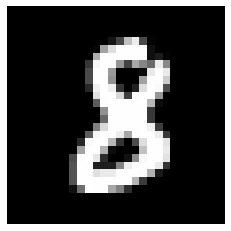

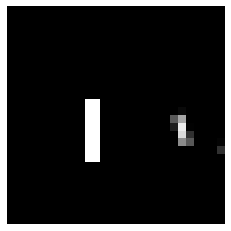

Loss: 0.0035270257722818128
Iteration: 5800, Score: 0.15017265688069165
[59, 136, 65, 75, 97, 58, 114, 108, 90, 34, 32, 51, 37, 44, 0]


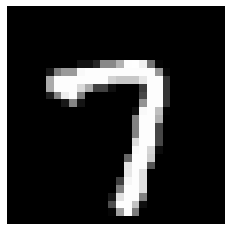

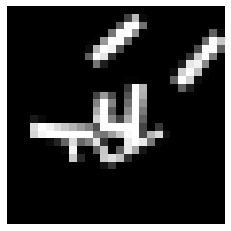

Loss: 0.004182419632038951
Iteration: 5840, Score: 0.14852158675342797
[43, 82, 62, 67, 80, 110, 61, 148, 126, 43, 52, 45, 34, 47, 0]


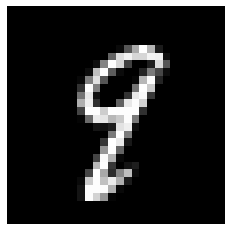

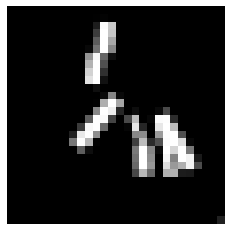

Loss: 0.003755460536712302
Iteration: 5880, Score: 0.11616043919511139
[50, 117, 107, 90, 49, 112, 72, 129, 52, 47, 49, 40, 37, 49, 0]


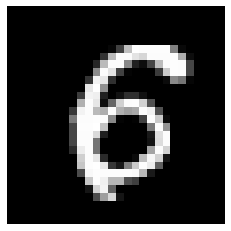

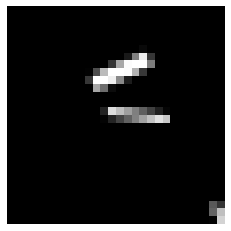

Loss: 0.003552601799316932
Iteration: 5920, Score: 0.16428547720238565
[90, 120, 65, 112, 51, 46, 143, 98, 62, 53, 44, 37, 36, 43, 0]


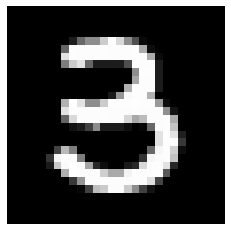

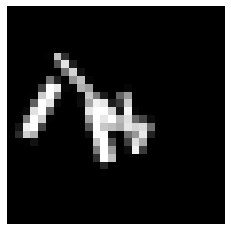

Loss: 0.003430285799724784
Iteration: 5960, Score: 0.13223077940754593
[100, 150, 55, 66, 50, 48, 113, 96, 80, 65, 38, 52, 31, 56, 0]


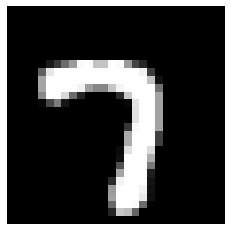

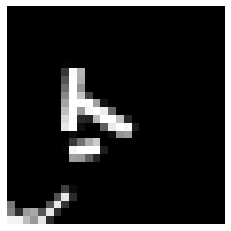

Loss: 0.003420194722959521
Iteration: 6000, Score: 0.18951589879393577
[68, 93, 60, 116, 52, 126, 47, 78, 114, 63, 41, 38, 37, 67, 0]


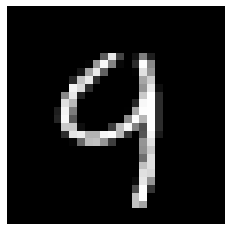

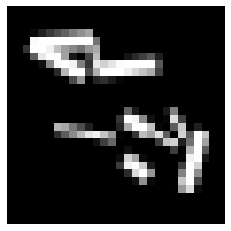

Test score: 0.05001773335784674
Loss: 0.0033475277893331217
Iteration: 6040, Score: 0.13208248414844273
[82, 39, 91, 85, 66, 219, 38, 77, 69, 56, 42, 46, 42, 48, 0]


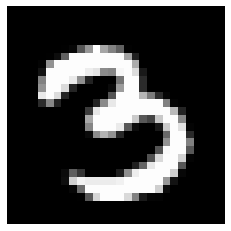

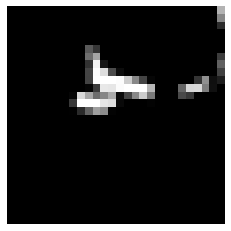

Loss: 0.0036706053590357594
Iteration: 6080, Score: 0.15071822217851877
[73, 67, 69, 160, 78, 89, 68, 126, 57, 38, 53, 44, 33, 45, 0]


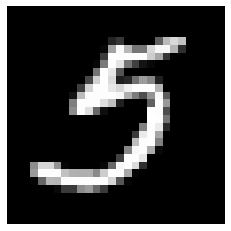

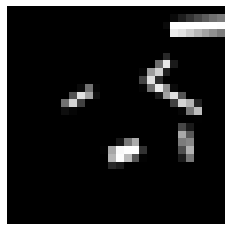

Loss: 0.003777581698085712
Iteration: 6120, Score: 0.14620772621594372
[151, 68, 64, 124, 46, 72, 99, 124, 50, 38, 41, 39, 34, 50, 0]


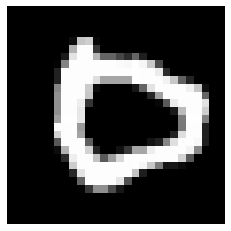

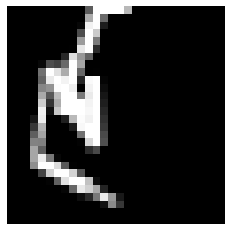

Loss: 0.004070187344416621
Iteration: 6160, Score: 0.15167656020075082
[95, 48, 96, 100, 37, 120, 70, 115, 107, 48, 37, 52, 29, 46, 0]


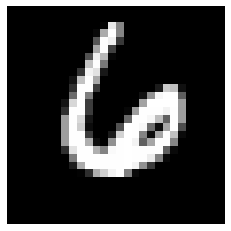

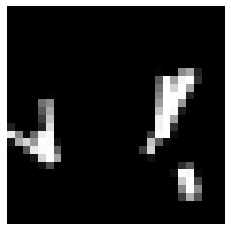

Loss: 0.003837934011690689
Iteration: 6200, Score: 0.1614435073025525
[70, 46, 67, 75, 48, 192, 95, 112, 110, 27, 32, 42, 40, 44, 0]


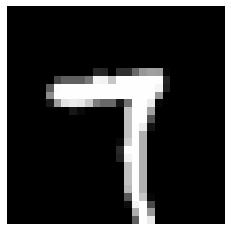

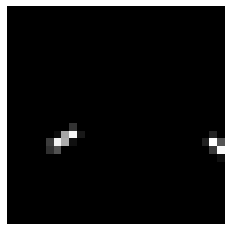

Loss: 0.004250755745164606
Iteration: 6240, Score: 0.14733428856171665
[78, 71, 38, 111, 64, 192, 63, 131, 62, 54, 34, 33, 28, 41, 0]


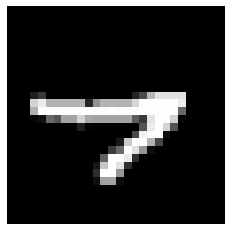

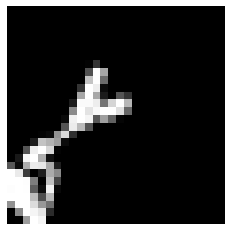

Loss: 0.00347513399278153
Iteration: 6280, Score: 0.15369712105393407
[87, 77, 37, 95, 56, 174, 43, 172, 36, 45, 33, 72, 29, 44, 0]


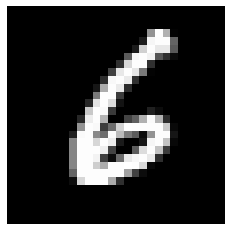

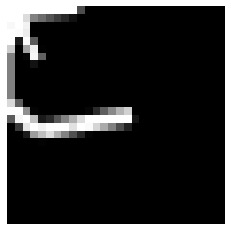

Loss: 0.0028566496992121766
Iteration: 6320, Score: 0.13837542577087886
[111, 73, 117, 75, 31, 119, 69, 173, 51, 44, 28, 31, 39, 39, 0]


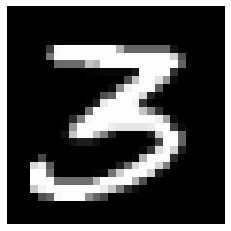

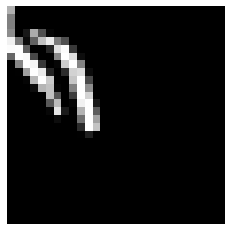

Loss: 0.003699345259459651
Iteration: 6360, Score: 0.16826617713645103
[77, 80, 58, 140, 59, 59, 88, 142, 82, 48, 34, 34, 54, 45, 0]


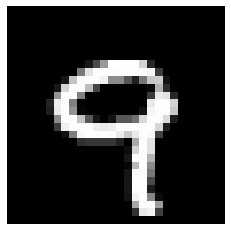

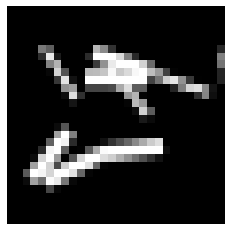

Loss: 0.0034784710405107657
Iteration: 6400, Score: 0.18212501229718334
[47, 84, 74, 130, 42, 161, 51, 166, 42, 41, 45, 40, 35, 42, 0]


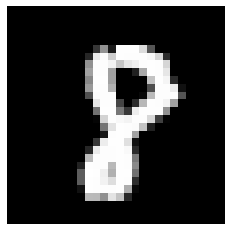

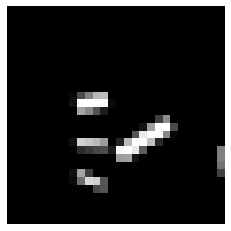

Test score: 0.06678596611879767
Loss: 0.003517816329126112
Iteration: 6440, Score: 0.12567469152808186
[57, 91, 98, 55, 61, 138, 78, 156, 42, 56, 32, 44, 41, 51, 0]


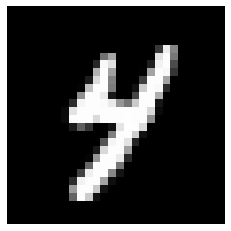

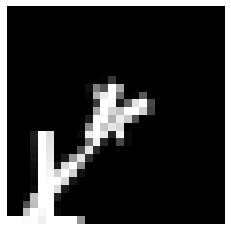

Loss: 0.003085765875955602
Iteration: 6480, Score: 0.14167170029506082
[58, 82, 115, 97, 41, 56, 71, 139, 73, 89, 27, 58, 38, 56, 0]


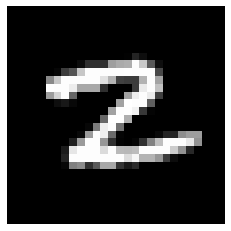

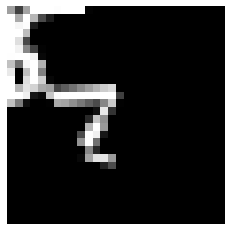

Loss: 0.003786368190608685
Iteration: 6520, Score: 0.18369301541894673
[68, 65, 104, 98, 36, 58, 69, 172, 89, 59, 46, 31, 38, 67, 0]


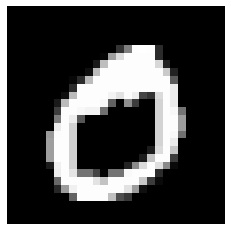

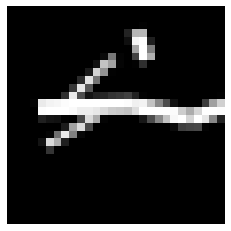

Loss: 0.003171796946003696
Iteration: 6560, Score: 0.17045435417443516
[63, 84, 106, 101, 48, 71, 41, 163, 87, 82, 40, 34, 29, 51, 0]


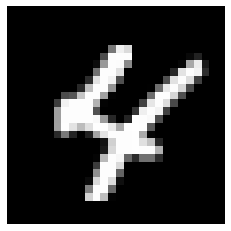

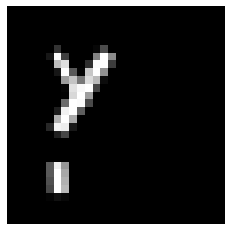

Loss: 0.0034904359809040104
Iteration: 6600, Score: 0.13762827667593958
[35, 54, 107, 104, 60, 93, 89, 129, 74, 59, 44, 70, 40, 42, 0]


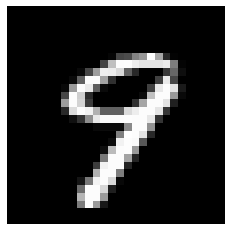

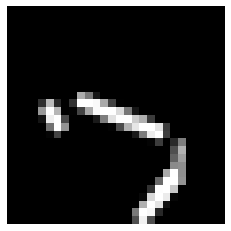

Loss: 0.003458235123786542
Iteration: 6640, Score: 0.16667619491461666
[56, 167, 62, 80, 44, 127, 59, 116, 38, 39, 33, 94, 45, 40, 0]


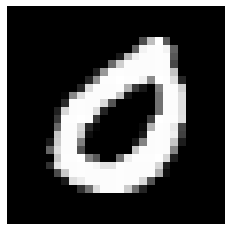

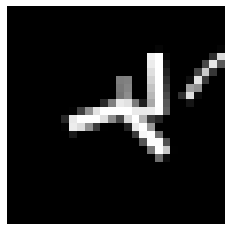

Loss: 0.00318758510022554
Iteration: 6680, Score: 0.109795659695752
[60, 206, 59, 107, 40, 67, 80, 110, 43, 57, 31, 53, 41, 46, 0]


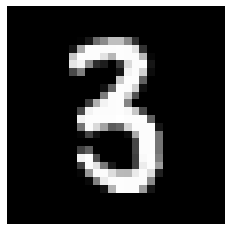

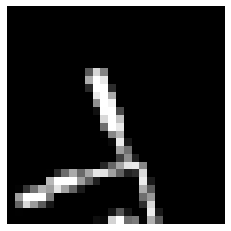

Loss: 0.0031428324300344468
Iteration: 6720, Score: 0.1369850036464632
[67, 123, 35, 82, 51, 82, 61, 127, 54, 165, 36, 39, 33, 45, 0]


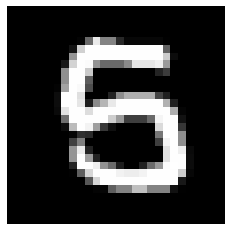

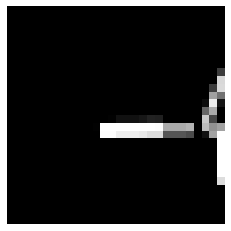

Loss: 0.0034289851877125186
Iteration: 6760, Score: 0.12382789529114964
[57, 57, 55, 79, 46, 100, 70, 141, 75, 126, 52, 51, 35, 56, 0]


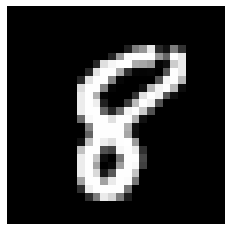

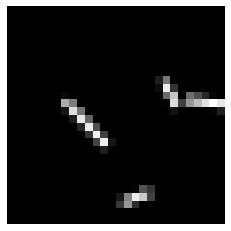

Loss: 0.003257003188764649
Iteration: 6800, Score: 0.12600357858114875
[57, 60, 118, 89, 50, 117, 55, 126, 42, 66, 39, 78, 47, 56, 0]


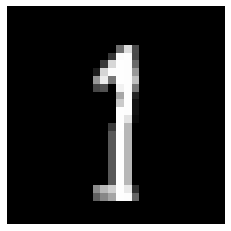

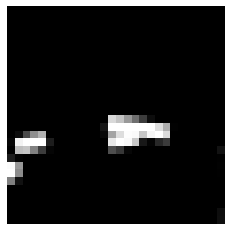

Test score: 0.048226167663931854
Loss: 0.004059919178979346
Iteration: 6840, Score: 0.12353113602846862
[94, 77, 85, 102, 43, 114, 70, 112, 52, 57, 51, 52, 31, 60, 0]


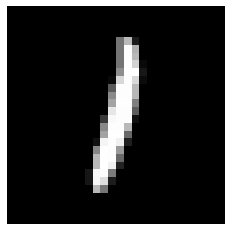

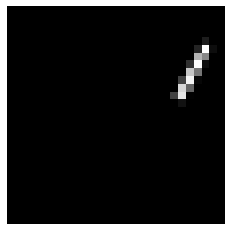

Loss: 0.0035631371406152873
Iteration: 6880, Score: 0.1583846623972058
[70, 130, 51, 66, 51, 91, 54, 138, 66, 117, 26, 51, 40, 49, 0]


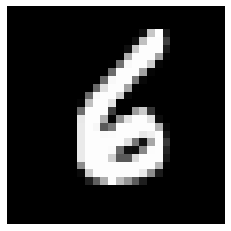

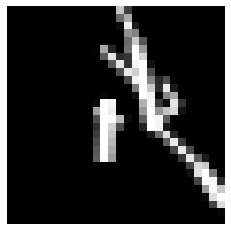

Loss: 0.0033371306365801434
Iteration: 6920, Score: 0.14888380386866631
[80, 54, 69, 88, 114, 86, 71, 68, 88, 142, 28, 42, 29, 41, 0]


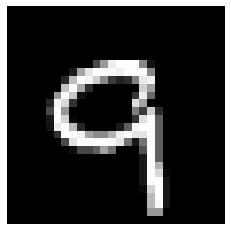

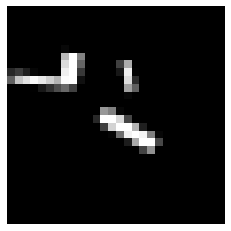

Loss: 0.0032151996346719077
Iteration: 6960, Score: 0.1459026556303725
[82, 64, 123, 95, 57, 95, 57, 68, 60, 110, 31, 57, 53, 48, 0]


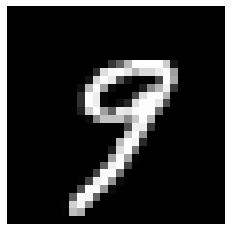

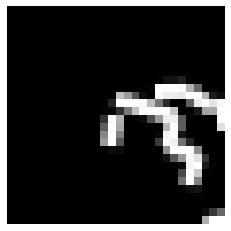

Loss: 0.0038104748511906504
Iteration: 7000, Score: 0.16378097580000758
[71, 64, 103, 86, 119, 82, 48, 167, 46, 41, 37, 67, 27, 42, 0]


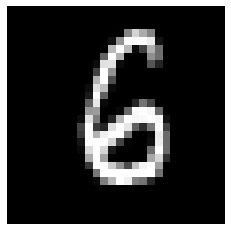

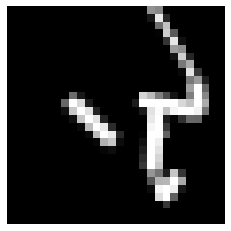

Loss: 0.003397787417740838
Iteration: 7040, Score: 0.12481619347818199
[68, 83, 89, 50, 79, 90, 95, 200, 50, 32, 47, 46, 35, 36, 0]


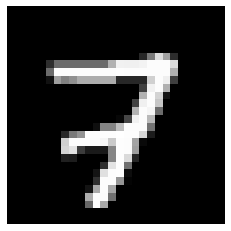

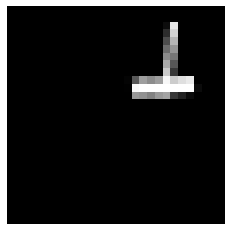

Loss: 0.003723442268081572
Iteration: 7080, Score: 0.1224793284572661
[81, 141, 100, 43, 67, 89, 92, 137, 52, 59, 36, 40, 30, 33, 0]


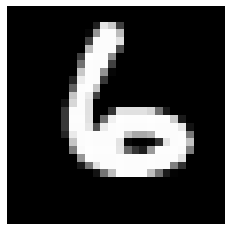

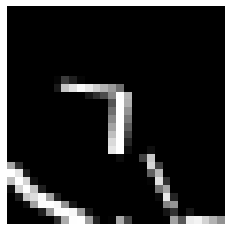

Loss: 0.0031063259393501724
Iteration: 7120, Score: 0.1317568518938497
[91, 109, 54, 65, 146, 55, 70, 84, 79, 87, 35, 45, 35, 45, 0]


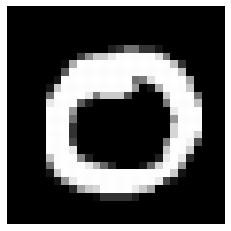

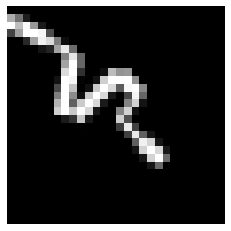

Loss: 0.003854499442410317
Iteration: 7160, Score: 0.13751390105672182
[72, 54, 167, 117, 144, 61, 47, 87, 68, 47, 32, 39, 29, 36, 0]


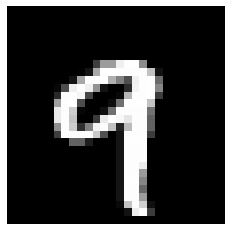

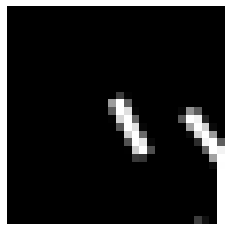

Loss: 0.0035139796431841903
Iteration: 7200, Score: 0.13398292434029282
[54, 103, 127, 84, 200, 35, 79, 63, 52, 43, 38, 53, 33, 36, 0]


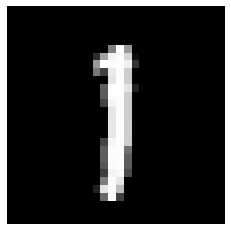

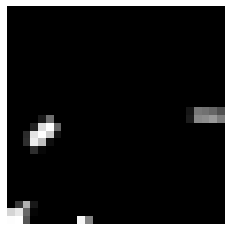

Test score: 0.018721749562770125
Loss: 0.0036085767817059904
Iteration: 7240, Score: 0.1346724184071645
[64, 107, 55, 89, 109, 71, 58, 160, 65, 61, 34, 53, 31, 43, 0]


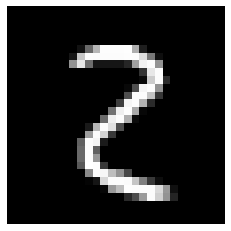

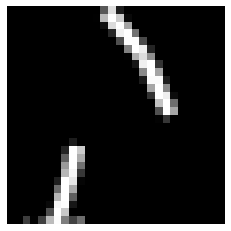

Loss: 0.003351175633522099
Iteration: 7280, Score: 0.13138185009360312
[55, 79, 55, 101, 152, 52, 78, 139, 55, 76, 30, 43, 24, 61, 0]


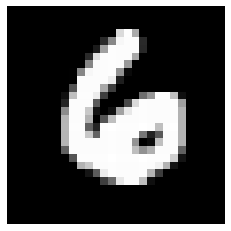

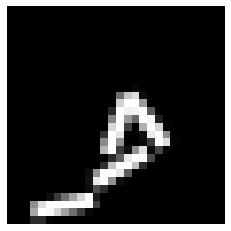

Loss: 0.0033303313884215425
Iteration: 7320, Score: 0.13523895283415915
[64, 54, 74, 148, 252, 35, 42, 63, 71, 70, 34, 31, 24, 38, 0]


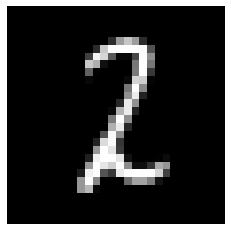

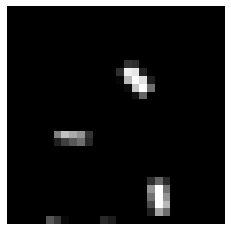

Loss: 0.00330302176296225
Iteration: 7360, Score: 0.14456690691225232
[45, 37, 147, 130, 192, 78, 81, 73, 41, 40, 29, 35, 37, 35, 0]


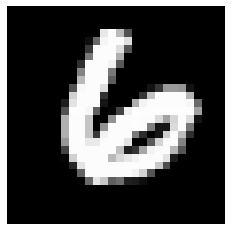

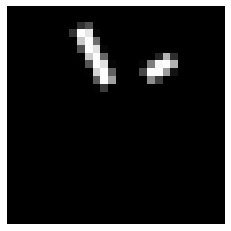

Loss: 0.0036423490267767935
Iteration: 7400, Score: 0.11275012841820715
[84, 56, 101, 94, 110, 74, 94, 111, 64, 68, 31, 38, 28, 47, 0]


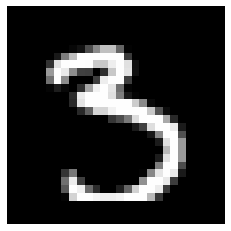

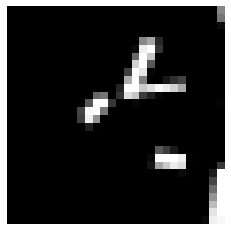

Loss: 0.0029983196999883908
Iteration: 7440, Score: 0.13239096880331633
[111, 67, 89, 118, 70, 70, 48, 123, 128, 44, 33, 29, 22, 48, 0]


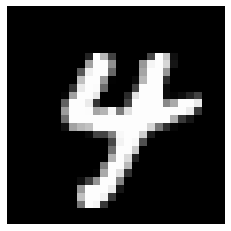

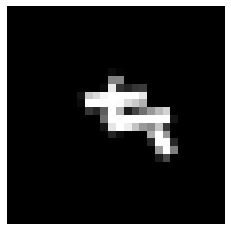

Loss: 0.003286083914208262
Iteration: 7480, Score: 0.12414439443498852
[56, 76, 58, 83, 169, 73, 39, 159, 62, 50, 63, 41, 33, 38, 0]


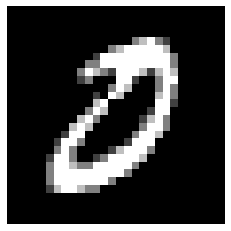

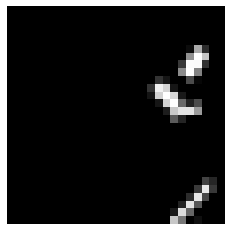

Loss: 0.002929852731770589
Iteration: 7520, Score: 0.12202824058942496
[67, 85, 109, 105, 166, 24, 38, 97, 129, 51, 24, 38, 31, 36, 0]


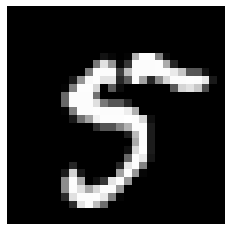

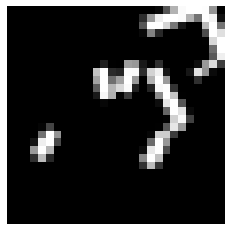

Loss: 0.0024960885669689866
Iteration: 7560, Score: 0.14132133597368374
[87, 75, 79, 153, 90, 38, 143, 66, 87, 60, 20, 30, 31, 41, 0]


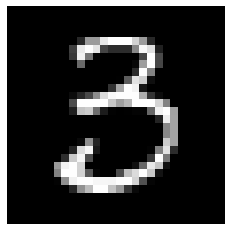

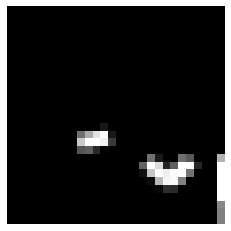

Loss: 0.0029301287577774503
Iteration: 7600, Score: 0.15721319061424585
[118, 64, 51, 96, 50, 46, 88, 64, 201, 41, 47, 46, 46, 42, 0]


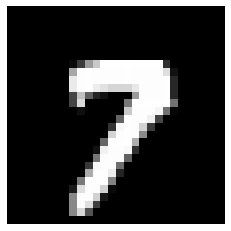

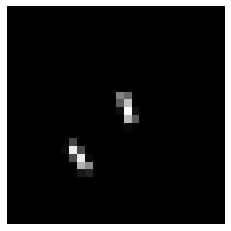

Test score: 0.03110028582252562
Loss: 0.0031682783014187373
Iteration: 7640, Score: 0.14426473785442068
[81, 121, 60, 102, 90, 66, 43, 58, 143, 97, 31, 31, 45, 32, 0]


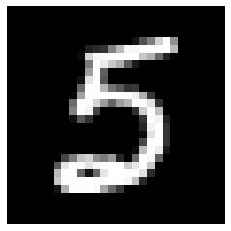

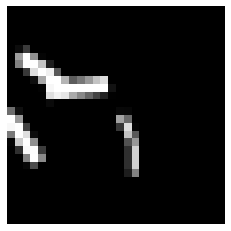

Loss: 0.0028798793878536465
Iteration: 7680, Score: 0.1463075184347108
[82, 64, 36, 88, 132, 78, 84, 142, 92, 50, 32, 56, 31, 33, 0]


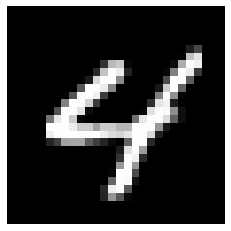

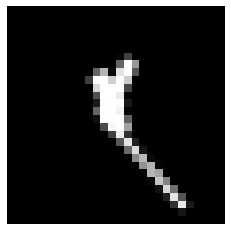

Loss: 0.003412841953816629
Iteration: 7720, Score: 0.12376001803041432
[109, 42, 65, 64, 189, 42, 155, 53, 82, 42, 50, 49, 27, 31, 0]


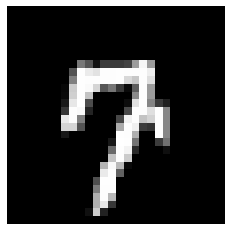

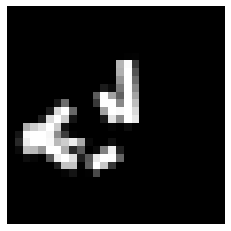

Loss: 0.002879228154931162
Iteration: 7760, Score: 0.1367018993776292
[68, 64, 100, 94, 119, 41, 203, 62, 89, 41, 20, 43, 23, 33, 0]


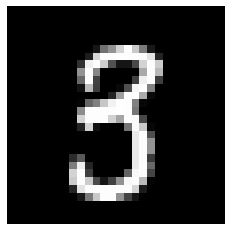

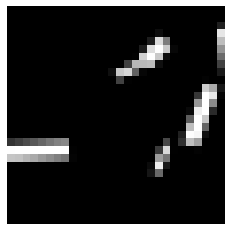

Loss: 0.002909213590347889
Iteration: 7800, Score: 0.12870192231237887
[73, 78, 137, 145, 71, 93, 80, 96, 75, 28, 33, 30, 22, 39, 0]


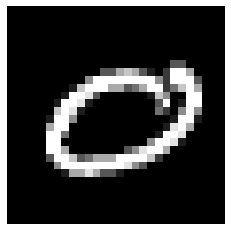

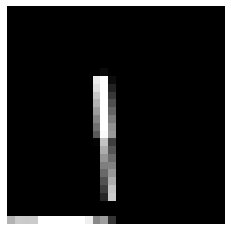

Loss: 0.0031530921850862407
Iteration: 7840, Score: 0.15284263394773007
[71, 104, 101, 138, 138, 71, 59, 77, 50, 57, 27, 37, 31, 39, 0]


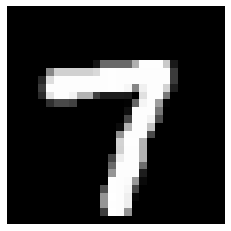

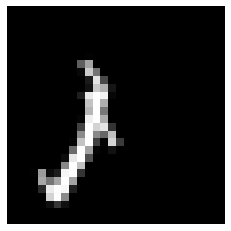

Loss: 0.00322220604917998
Iteration: 7880, Score: 0.1071347753073933
[80, 32, 51, 172, 198, 34, 65, 68, 84, 53, 34, 42, 40, 47, 0]


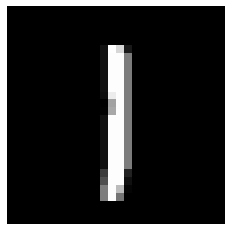

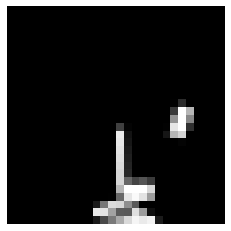

Loss: 0.003366209869506828
Iteration: 7920, Score: 0.126898584973067
[123, 59, 69, 76, 214, 44, 85, 53, 77, 62, 43, 39, 24, 32, 0]


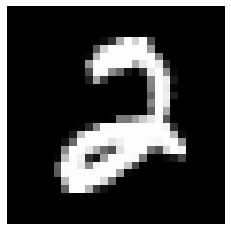

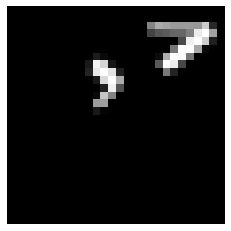

Loss: 0.0029344552967519896
Iteration: 7960, Score: 0.12843984474684111
[149, 64, 73, 87, 132, 144, 74, 37, 41, 64, 24, 35, 42, 34, 0]


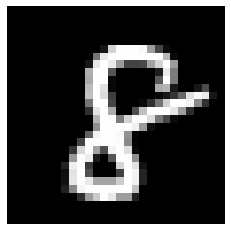

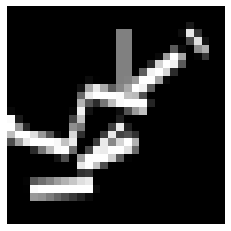

Loss: 0.0028083223953273635
Iteration: 8000, Score: 0.10972162348829442
[72, 144, 105, 87, 74, 145, 59, 84, 47, 57, 39, 33, 26, 28, 0]


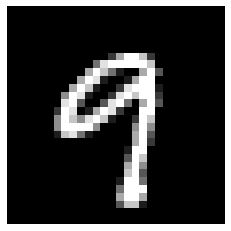

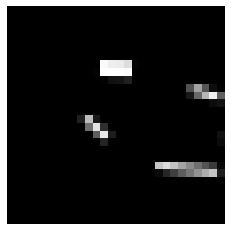

Test score: 0.03799063220247626
Loss: 0.002617624681003169
Iteration: 8040, Score: 0.14714662896469233
[62, 82, 69, 188, 84, 68, 102, 76, 57, 69, 36, 34, 35, 38, 0]


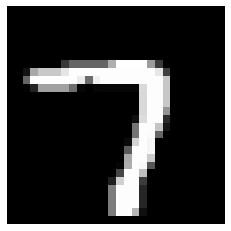

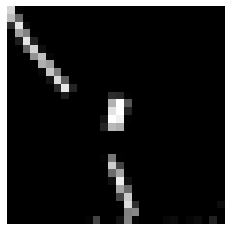

Loss: 0.0031105486820890175
Iteration: 8080, Score: 0.12266540589556099
[109, 147, 54, 91, 88, 49, 193, 60, 43, 40, 23, 37, 35, 31, 0]


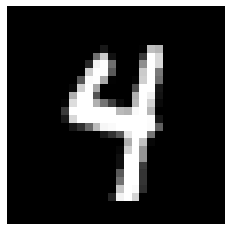

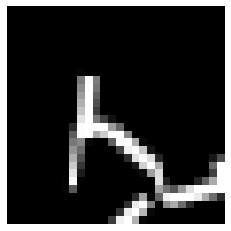

Loss: 0.003218258955550838
Iteration: 8120, Score: 0.12816169015131892
[65, 141, 43, 73, 143, 51, 100, 138, 46, 84, 34, 20, 28, 34, 0]


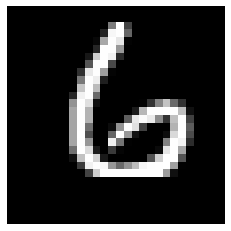

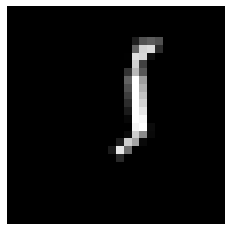

Loss: 0.0025534289171025306
Iteration: 8160, Score: 0.16537771088955922
[76, 54, 92, 100, 82, 156, 48, 118, 88, 62, 33, 28, 30, 33, 0]


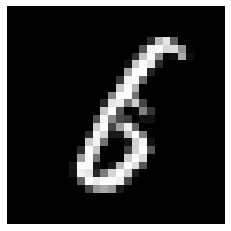

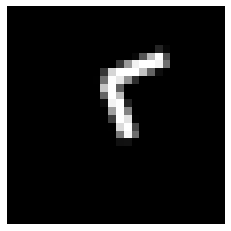

Loss: 0.0034515924764487046
Iteration: 8200, Score: 0.13626114103011785
[71, 76, 126, 38, 53, 148, 77, 139, 48, 99, 25, 29, 28, 43, 0]


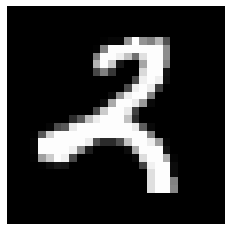

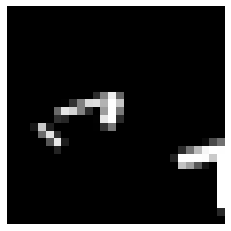

Loss: 0.002965827779855139
Iteration: 8240, Score: 0.17079178261011838
[79, 99, 120, 107, 86, 61, 167, 77, 33, 39, 34, 31, 18, 49, 0]


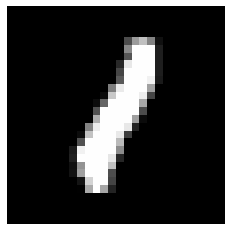

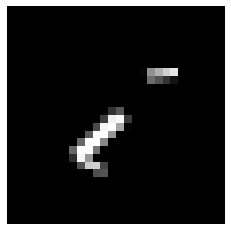

Loss: 0.0030090668057416252
Iteration: 8280, Score: 0.10431478224880994
[120, 90, 53, 55, 69, 53, 161, 95, 61, 83, 30, 79, 27, 24, 0]


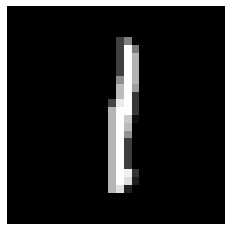

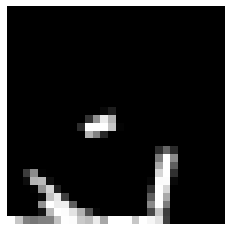

Loss: 0.0027789672394089187
Iteration: 8320, Score: 0.13336368730291726
[51, 113, 88, 146, 108, 44, 124, 103, 76, 35, 22, 33, 26, 31, 0]


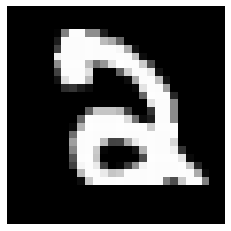

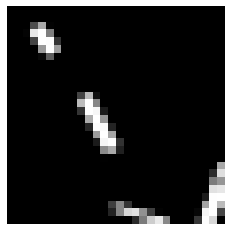

Loss: 0.0032587993832395414
Iteration: 8360, Score: 0.12453562460956165
[72, 93, 225, 60, 56, 57, 97, 83, 71, 58, 33, 30, 25, 40, 0]


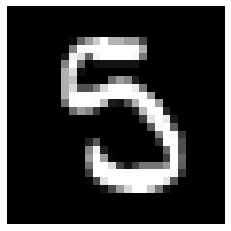

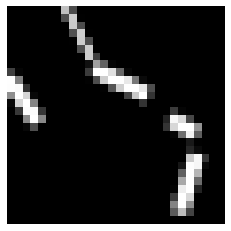

Loss: 0.0029408425381068203
Iteration: 8400, Score: 0.13609816100448371
[48, 44, 109, 105, 146, 92, 138, 112, 39, 31, 40, 33, 30, 33, 0]


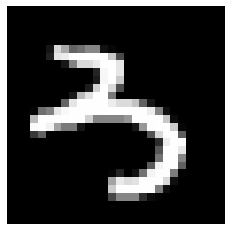

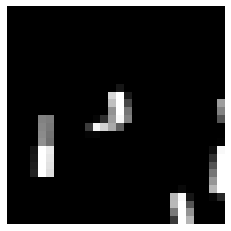

Test score: 0.02487451574904844
Loss: 0.0029722419909369176
Iteration: 8440, Score: 0.1108444461580366
[60, 42, 25, 70, 114, 46, 123, 242, 48, 82, 29, 38, 40, 41, 0]


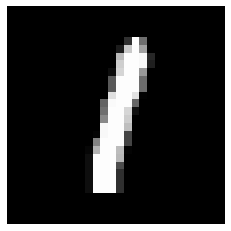

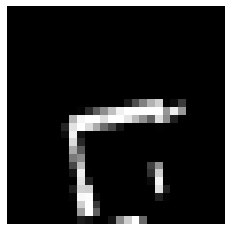

Loss: 0.0029577426503145585
Iteration: 8480, Score: 0.12144014937616887
[75, 74, 47, 59, 103, 21, 199, 150, 82, 57, 26, 47, 32, 28, 0]


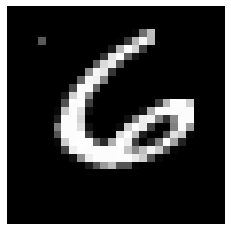

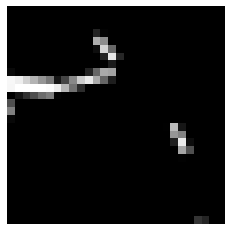

Loss: 0.0030115147810366558
Iteration: 8520, Score: 0.13509670692682263
[78, 114, 194, 34, 53, 37, 131, 125, 53, 44, 23, 45, 36, 33, 0]


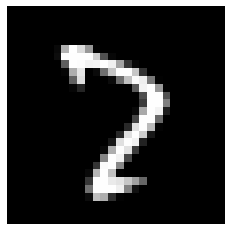

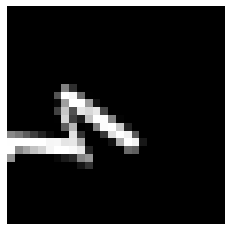

Loss: 0.0031260414934580877
Iteration: 8560, Score: 0.1405127404630184
[44, 58, 180, 180, 113, 65, 69, 51, 59, 59, 25, 35, 35, 27, 0]


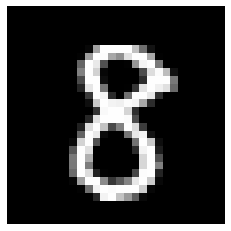

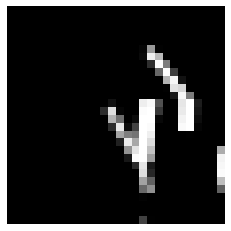

Loss: 0.002876296284638911
Iteration: 8600, Score: 0.1200325207551941
[65, 21, 75, 64, 218, 48, 103, 78, 76, 96, 41, 47, 27, 41, 0]


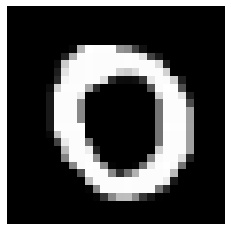

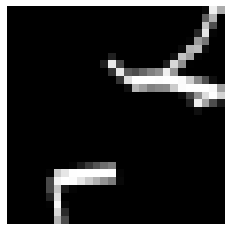

Loss: 0.002745216129801594
Iteration: 8640, Score: 0.14082998549565673
[72, 30, 99, 31, 128, 47, 68, 196, 126, 45, 43, 59, 24, 32, 0]


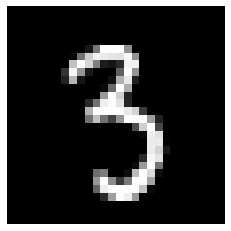

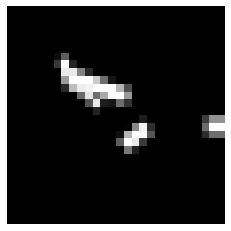

Loss: 0.0027988734714837786
Iteration: 8680, Score: 0.12180958348885178
[70, 26, 35, 90, 120, 67, 116, 137, 82, 105, 34, 44, 21, 53, 0]


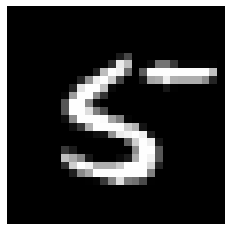

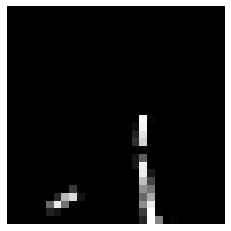

Loss: 0.002856558240205178
Iteration: 8720, Score: 0.12402172256947959
[59, 32, 194, 51, 42, 107, 103, 101, 42, 117, 31, 53, 30, 38, 0]


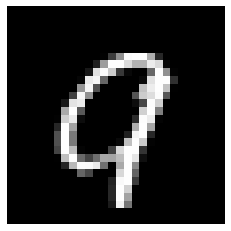

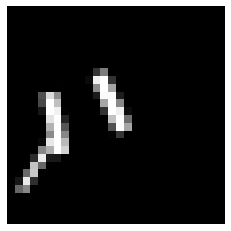

Loss: 0.0029065745028304378
Iteration: 8760, Score: 0.12748732992261644
[50, 38, 124, 69, 246, 71, 39, 105, 32, 77, 23, 43, 31, 52, 0]


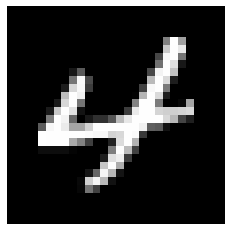

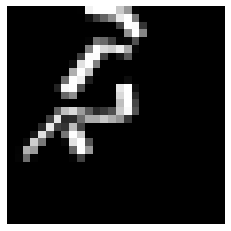

Loss: 0.002624241938322538
Iteration: 8800, Score: 0.12866955103841612
[66, 43, 70, 105, 236, 74, 31, 71, 145, 39, 27, 30, 27, 36, 0]


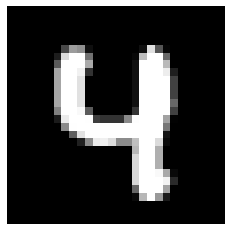

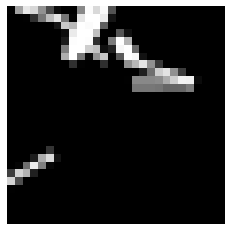

Test score: 0.03409960231464356
Loss: 0.0026851992185107066
Iteration: 8840, Score: 0.1162670626230538
[40, 96, 95, 89, 98, 61, 155, 110, 78, 42, 36, 40, 29, 31, 0]


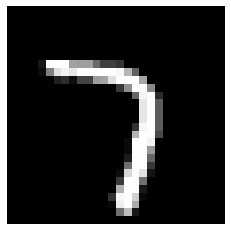

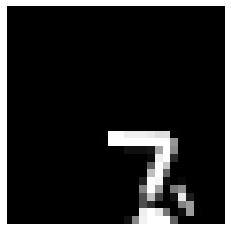

Loss: 0.003693317372818588
Iteration: 8880, Score: 0.11286790226958691
[48, 58, 222, 47, 63, 82, 99, 115, 38, 87, 25, 44, 34, 38, 0]


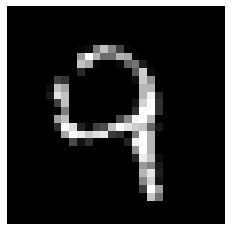

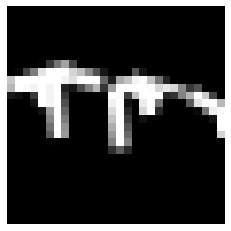

Loss: 0.0033743706273169317
Iteration: 8920, Score: 0.12210705275647345
[57, 49, 112, 38, 92, 80, 184, 151, 31, 59, 32, 43, 32, 40, 0]


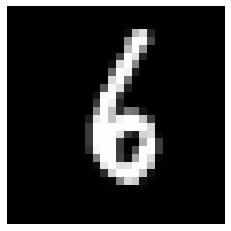

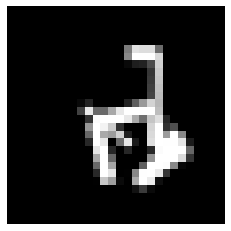

Loss: 0.002830075233381505
Iteration: 8960, Score: 0.12482752820104363
[69, 55, 161, 52, 97, 122, 114, 121, 41, 59, 27, 25, 25, 32, 0]


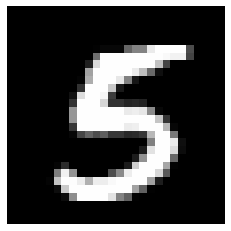

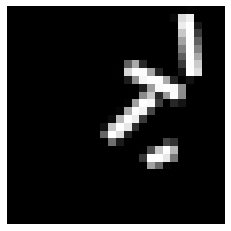

Loss: 0.00318878123253735
Iteration: 9000, Score: 0.13626345641816437
[64, 116, 112, 50, 116, 79, 144, 71, 36, 81, 34, 39, 23, 35, 0]


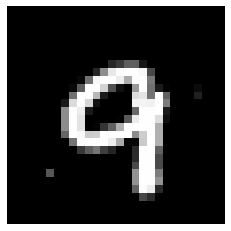

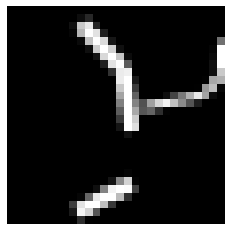

Loss: 0.002911770465729503
Iteration: 9040, Score: 0.12969468497857448
[54, 147, 113, 73, 58, 93, 175, 98, 24, 34, 21, 30, 48, 32, 0]


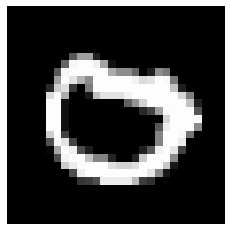

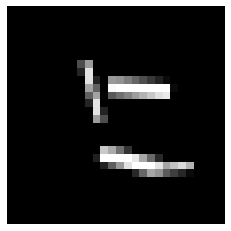

Loss: 0.0025996132670519814
Iteration: 9080, Score: 0.14272671434096995
[42, 57, 109, 70, 105, 105, 64, 209, 50, 66, 27, 34, 24, 38, 0]


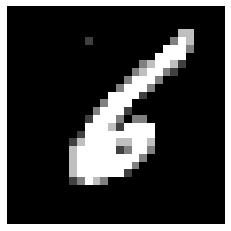

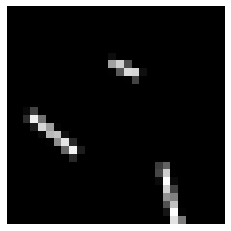

Loss: 0.002643581170354124
Iteration: 9120, Score: 0.1372998088374734
[71, 69, 193, 46, 156, 88, 36, 149, 28, 32, 31, 32, 26, 43, 0]


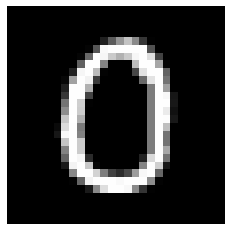

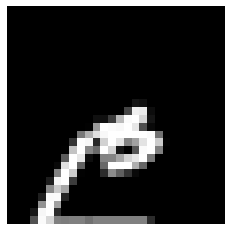

Loss: 0.0029319657643490115
Iteration: 9160, Score: 0.0956463038831862
[57, 112, 144, 60, 117, 98, 62, 103, 30, 101, 22, 29, 29, 36, 0]


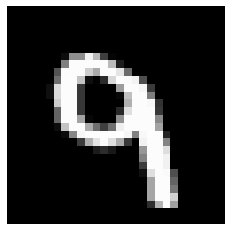

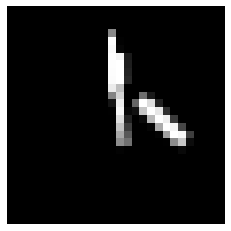

Loss: 0.0027993812241070126
Iteration: 9200, Score: 0.1469860353656113
[70, 44, 229, 66, 47, 73, 60, 157, 35, 58, 58, 31, 28, 44, 0]


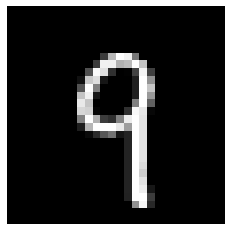

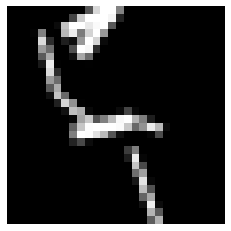

Test score: 0.005394669532775879
Loss: 0.0027949482244695443
Iteration: 9240, Score: 0.1244138332651928
[61, 105, 163, 54, 99, 119, 154, 87, 26, 23, 31, 23, 25, 30, 0]


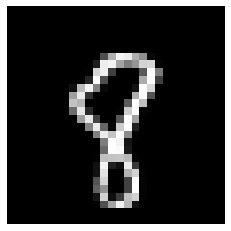

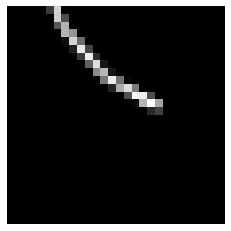

Loss: 0.0033159015298039572
Iteration: 9280, Score: 0.11105914765992202
[51, 54, 155, 87, 134, 74, 87, 125, 51, 78, 17, 32, 20, 35, 0]


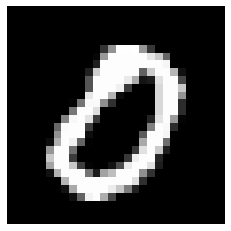

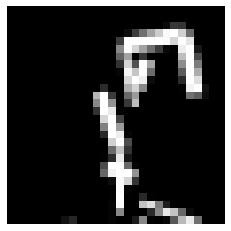

Loss: 0.0027663441629688676
Iteration: 9320, Score: 0.11572150671854617
[38, 40, 214, 44, 55, 178, 65, 111, 69, 39, 29, 42, 32, 44, 0]


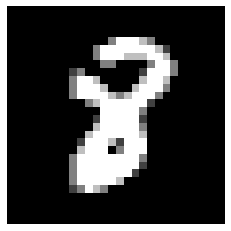

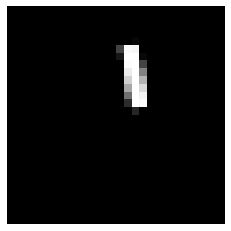

Loss: 0.0025718078899996423
Iteration: 9360, Score: 0.1485045087747276
[34, 58, 134, 45, 34, 155, 40, 263, 44, 71, 36, 24, 34, 28, 0]


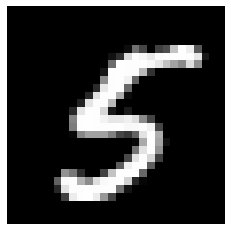

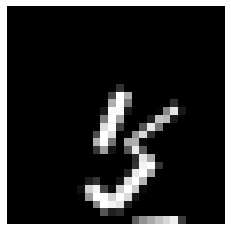

Loss: 0.0025385130691499597
Iteration: 9400, Score: 0.1224754563088063
[96, 131, 87, 39, 64, 42, 132, 81, 148, 58, 23, 29, 32, 38, 0]


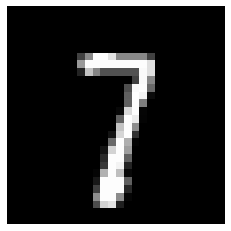

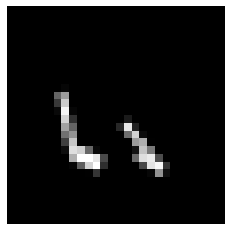

Loss: 0.0027384361110188125
Iteration: 9440, Score: 0.12333892470039429
[45, 45, 155, 59, 91, 57, 124, 56, 98, 120, 36, 54, 29, 31, 0]


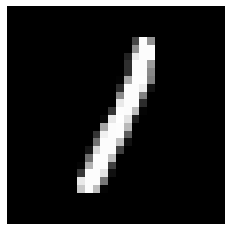

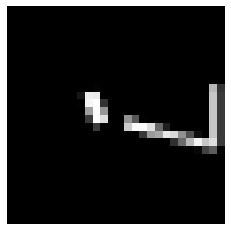

Loss: 0.0027703207587412193
Iteration: 9480, Score: 0.10886762872897086
[87, 74, 144, 78, 43, 64, 101, 168, 72, 37, 27, 30, 29, 46, 0]


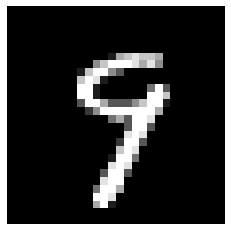

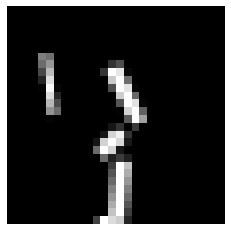

Loss: 0.0028360385867661816
Iteration: 9520, Score: 0.1152073563411832
[51, 58, 110, 140, 77, 111, 80, 154, 57, 35, 33, 27, 35, 32, 0]


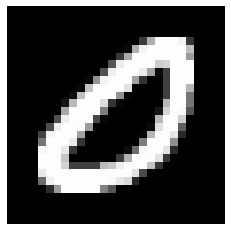

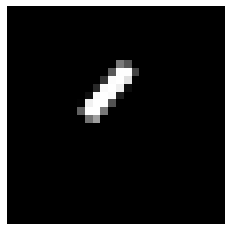

Loss: 0.002677772270250332
Iteration: 9560, Score: 0.13370637637004257
[50, 184, 126, 51, 55, 66, 57, 175, 56, 60, 33, 34, 26, 27, 0]


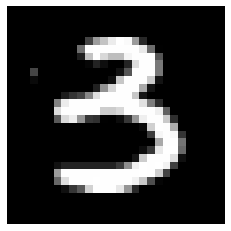

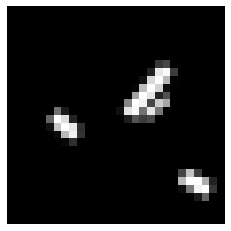

Loss: 0.0025900269345550974
Iteration: 9600, Score: 0.11669904285646042
[42, 106, 43, 103, 116, 65, 56, 128, 129, 67, 36, 42, 28, 39, 0]


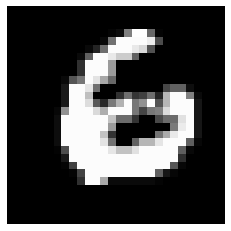

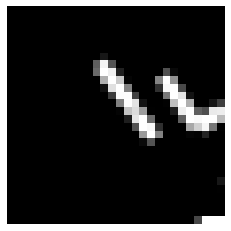

Test score: 0.015791764408349993
Loss: 0.002537406741397827
Iteration: 9640, Score: 0.10151129394024609
[40, 75, 208, 73, 77, 171, 65, 105, 39, 35, 20, 28, 35, 29, 0]


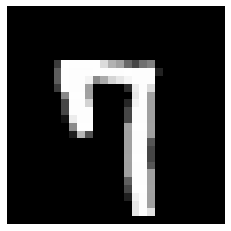

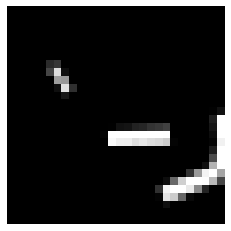

Loss: 0.003053798652063107
Iteration: 9680, Score: 0.14258628062903883
[51, 39, 119, 139, 76, 113, 36, 144, 50, 59, 48, 54, 24, 48, 0]


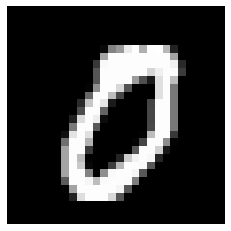

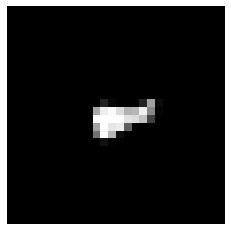

Loss: 0.0026407932128316223
Iteration: 9720, Score: 0.11179349807696418
[63, 163, 72, 52, 33, 99, 130, 99, 45, 117, 17, 62, 17, 31, 0]


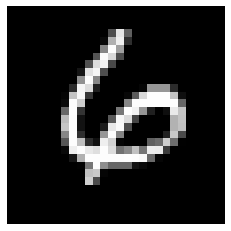

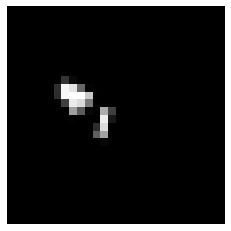

Loss: 0.0025787025074741066
Iteration: 9760, Score: 0.12734380165114995
[53, 187, 101, 32, 56, 43, 77, 231, 69, 35, 20, 28, 30, 38, 0]


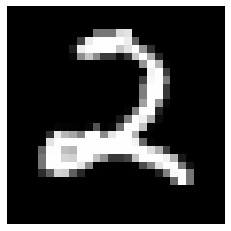

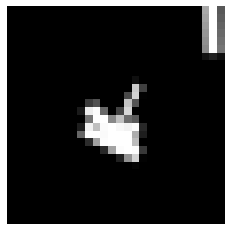

Loss: 0.0023556013417270925
Iteration: 9800, Score: 0.12465873738005755
[61, 94, 128, 30, 113, 174, 41, 162, 30, 34, 46, 29, 22, 36, 0]


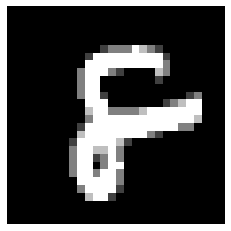

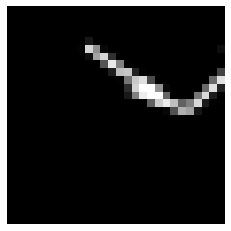

Loss: 0.0025729107897443015
Iteration: 9840, Score: 0.1335500450177933
[92, 47, 238, 37, 78, 135, 32, 128, 41, 63, 25, 26, 30, 28, 0]


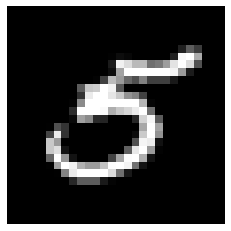

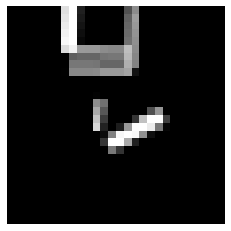

Loss: 0.0023587498022112122
Iteration: 9880, Score: 0.12087942091934382
[88, 106, 40, 50, 54, 80, 261, 53, 96, 48, 29, 37, 19, 39, 0]


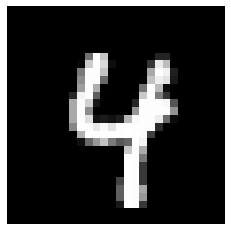

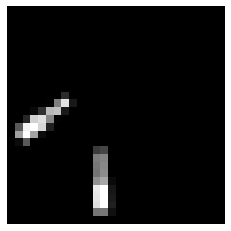

Loss: 0.002749828437294816
Iteration: 9920, Score: 0.10874977500364183
[72, 60, 56, 29, 136, 42, 56, 186, 176, 52, 38, 37, 30, 30, 0]


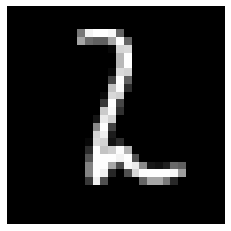

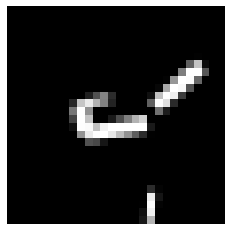

Loss: 0.0028130993522795886
Iteration: 9960, Score: 0.11921416984498501
[65, 69, 143, 35, 40, 37, 142, 276, 48, 40, 23, 24, 23, 35, 0]


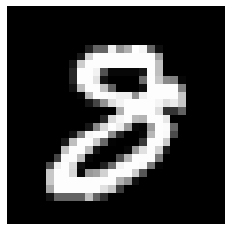

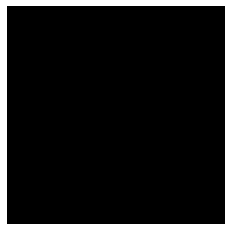

Loss: 0.002828897287957699
Iteration: 10000, Score: 0.11117896133486649
[113, 44, 191, 51, 71, 59, 52, 140, 106, 27, 39, 44, 30, 33, 0]


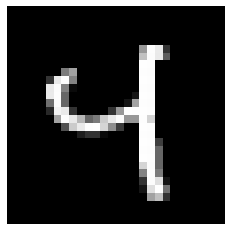

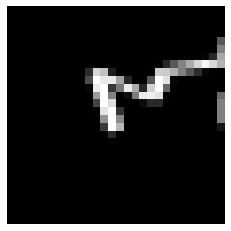

Test score: 0.021175455823540686
Loss: 0.0027264745522518445
Iteration: 10040, Score: 0.10216824646852911
[58, 30, 83, 41, 67, 98, 154, 188, 140, 46, 22, 26, 23, 24, 0]


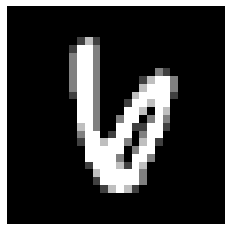

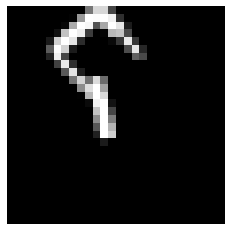

Loss: 0.002882759077194037
Iteration: 10080, Score: 0.1442249613068998
[70, 121, 44, 57, 72, 61, 37, 222, 111, 71, 37, 28, 31, 38, 0]


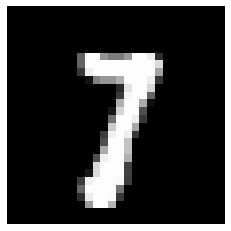

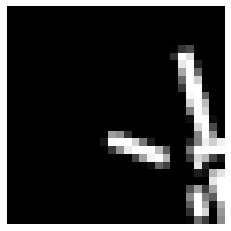

Loss: 0.0030176876185773562
Iteration: 10120, Score: 0.1347773926332593
[43, 63, 66, 125, 111, 184, 157, 64, 47, 33, 29, 21, 19, 38, 0]


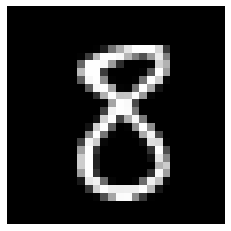

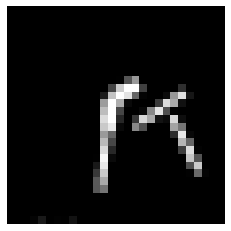

Loss: 0.0026934333803803954
Iteration: 10160, Score: 0.11542691169679167
[55, 146, 135, 72, 55, 87, 199, 68, 44, 33, 30, 26, 25, 25, 0]


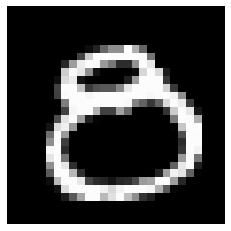

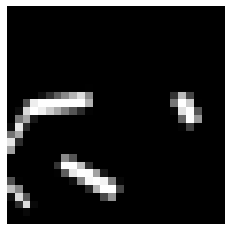

Loss: 0.0031807019755665973
Iteration: 10200, Score: 0.12434977896697821
[87, 56, 37, 34, 70, 81, 126, 246, 99, 45, 31, 30, 34, 24, 0]


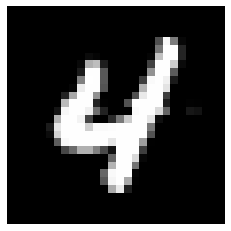

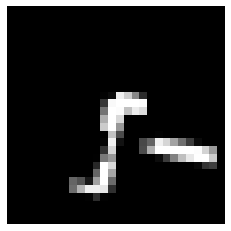

Loss: 0.0027264585534698548
Iteration: 10240, Score: 0.0980167188728228
[46, 148, 52, 69, 113, 24, 74, 218, 104, 40, 25, 26, 34, 27, 0]


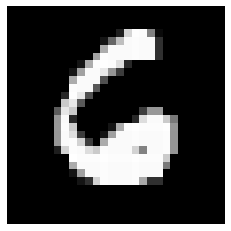

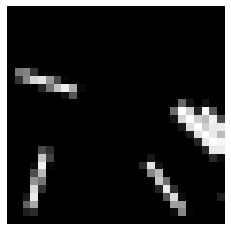

Loss: 0.003012024485561737
Iteration: 10280, Score: 0.13289746202901004
[66, 44, 167, 68, 60, 239, 93, 92, 49, 31, 20, 25, 19, 27, 0]


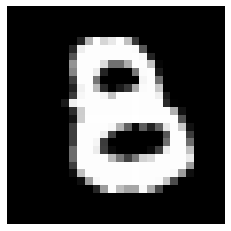

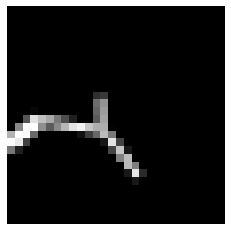

Loss: 0.0027525607083783515
Iteration: 10320, Score: 0.10990341940708459
[97, 125, 50, 30, 33, 49, 387, 24, 49, 23, 21, 35, 34, 43, 0]


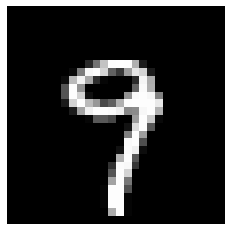

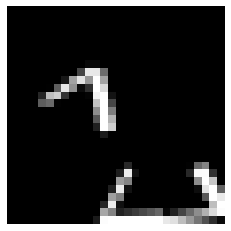

Loss: 0.002531577766676887
Iteration: 10360, Score: 0.15092883672192695
[42, 181, 63, 69, 53, 117, 199, 105, 28, 42, 28, 27, 26, 20, 0]


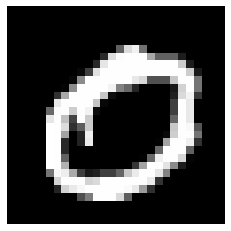

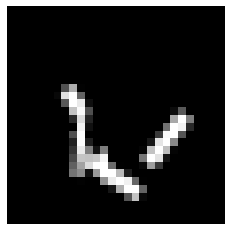

Loss: 0.0024862936694214875
Iteration: 10400, Score: 0.14193035812675953
[106, 79, 41, 69, 91, 100, 193, 105, 45, 54, 33, 25, 26, 33, 0]


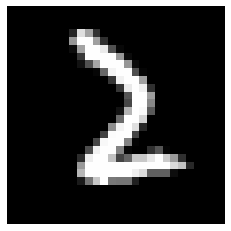

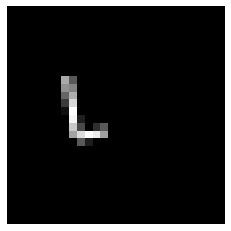

Test score: 0.037648679818958045
Loss: 0.0027129013581104937
Iteration: 10440, Score: 0.140925786845386
[63, 115, 63, 46, 39, 231, 163, 76, 49, 40, 31, 23, 32, 29, 0]


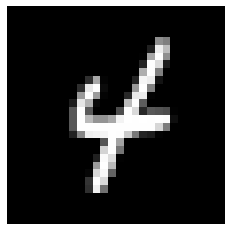

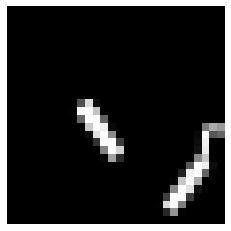

Loss: 0.0026060661323232225
Iteration: 10480, Score: 0.11563803781964817
[179, 47, 122, 68, 44, 122, 137, 67, 101, 25, 19, 21, 22, 26, 0]


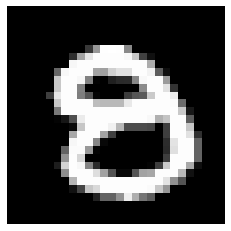

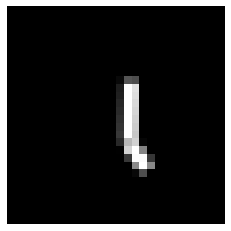

Loss: 0.0023584970471495713
Iteration: 10520, Score: 0.11122346876445224
[107, 17, 200, 91, 59, 94, 76, 149, 27, 38, 34, 45, 28, 35, 0]


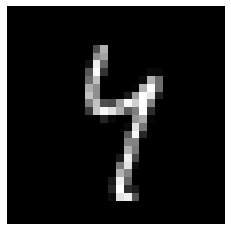

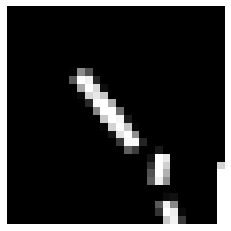

Loss: 0.002580303851319933
Iteration: 10560, Score: 0.11520127490651795
[106, 39, 81, 95, 120, 117, 62, 218, 28, 31, 24, 23, 23, 33, 0]


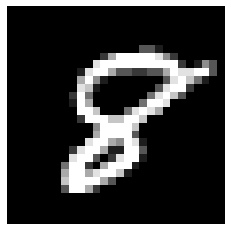

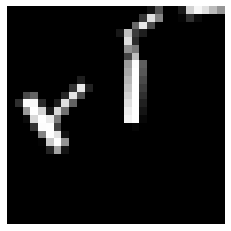

Loss: 0.0026124707506529014
Iteration: 10600, Score: 0.1135514492802322
[106, 127, 95, 35, 41, 100, 207, 71, 59, 27, 25, 36, 37, 34, 0]


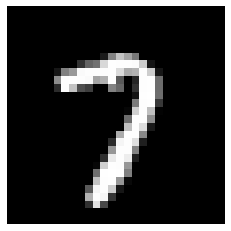

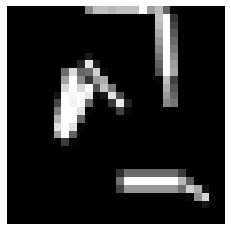

Loss: 0.002570816360821511
Iteration: 10640, Score: 0.1086762847196078
[122, 32, 162, 37, 70, 66, 131, 49, 129, 61, 35, 30, 44, 32, 0]


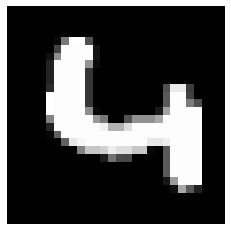

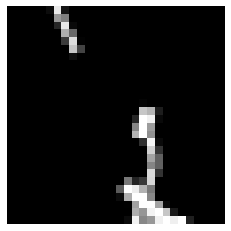

Loss: 0.0025404399874494055
Iteration: 10680, Score: 0.1026991485906765
[85, 103, 216, 58, 31, 62, 116, 65, 139, 22, 28, 23, 21, 31, 0]


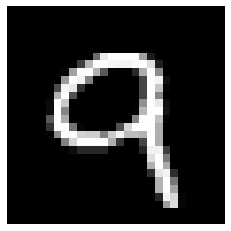

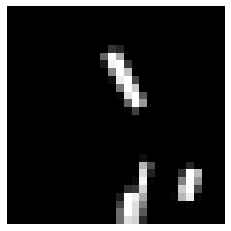

Loss: 0.0023361176479780163
Iteration: 10720, Score: 0.11873853162024169
[85, 72, 197, 36, 38, 101, 100, 131, 91, 29, 26, 30, 32, 32, 0]


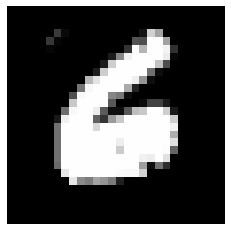

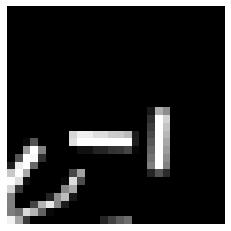

Loss: 0.002627296787651657
Iteration: 10760, Score: 0.1092819743538275
[88, 105, 116, 46, 75, 202, 74, 102, 45, 33, 31, 16, 30, 37, 0]


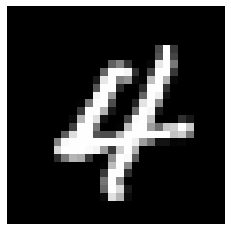

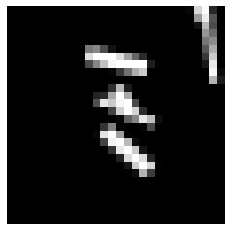

Loss: 0.0024068475669034263
Iteration: 10800, Score: 0.10046507906541227
[122, 125, 120, 66, 105, 109, 54, 87, 50, 44, 28, 40, 30, 20, 0]


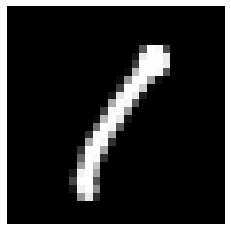

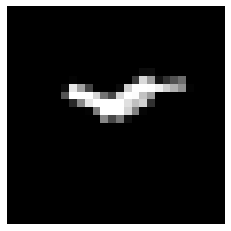

Test score: 0.0032226788997650148
Loss: 0.0020668134330332133
Iteration: 10840, Score: 0.1450588748343289
[102, 84, 202, 75, 97, 100, 53, 49, 91, 31, 34, 31, 26, 25, 0]


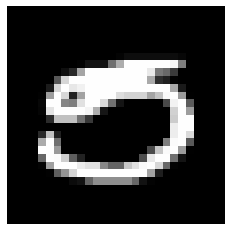

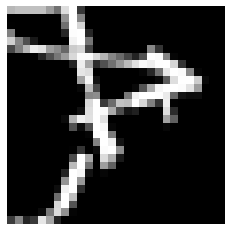

Loss: 0.002401788912107694
Iteration: 10880, Score: 0.11970919432863592
[106, 147, 174, 28, 35, 56, 102, 37, 178, 25, 29, 28, 27, 28, 0]


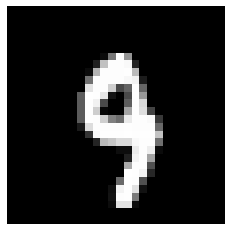

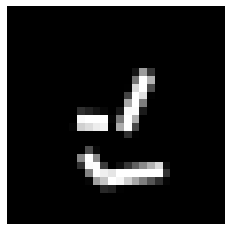

Loss: 0.002636204111755001
Iteration: 10920, Score: 0.11029046118818224
[97, 65, 122, 67, 140, 97, 66, 38, 156, 35, 29, 27, 28, 33, 0]


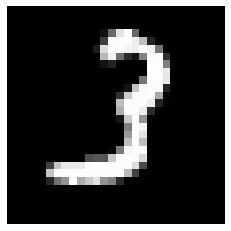

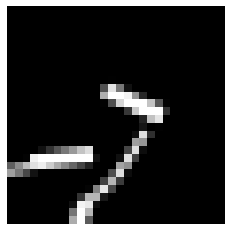

Loss: 0.002578225533424253
Iteration: 10960, Score: 0.10524941623583435
[127, 107, 80, 81, 88, 133, 41, 159, 47, 36, 35, 22, 25, 19, 0]


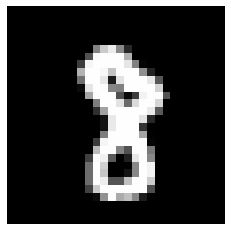

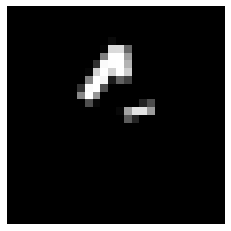

Loss: 0.002599944352446329
Iteration: 11000, Score: 0.11626476980000737
[120, 96, 121, 51, 44, 104, 72, 153, 42, 45, 50, 35, 43, 24, 0]


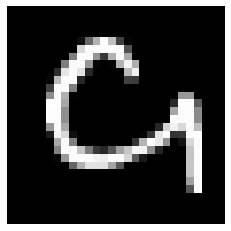

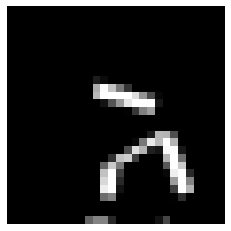

Loss: 0.0020477036190827006
Iteration: 11040, Score: 0.1261264768280089
[106, 100, 191, 53, 58, 104, 64, 73, 87, 52, 31, 27, 21, 33, 0]


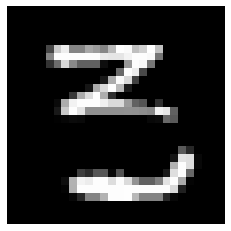

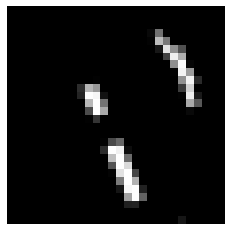

Loss: 0.0025170183576973
Iteration: 11080, Score: 0.10502348029776479
[116, 110, 124, 108, 47, 90, 126, 65, 73, 40, 23, 31, 25, 22, 0]


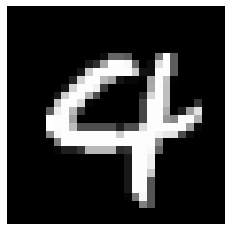

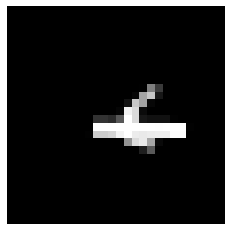

Loss: 0.0025286603915144756
Iteration: 11120, Score: 0.10135817429804592
[67, 147, 52, 173, 110, 55, 108, 89, 53, 25, 40, 33, 15, 33, 0]


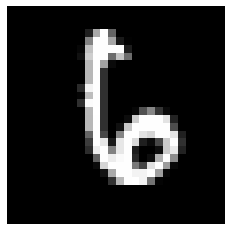

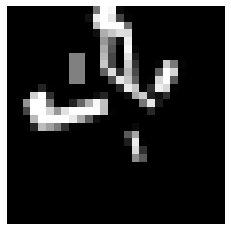

Loss: 0.0023578169936867674
Iteration: 11160, Score: 0.10019031347142296
[42, 74, 63, 199, 100, 126, 87, 78, 31, 68, 42, 31, 27, 32, 0]


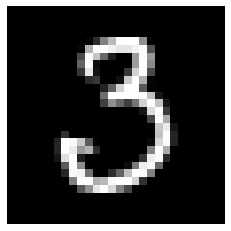

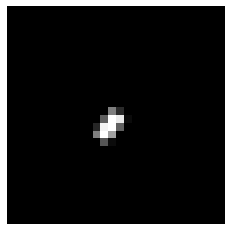

Loss: 0.0024348621433439863
Iteration: 11200, Score: 0.09199954781122506
[58, 46, 80, 96, 98, 82, 116, 61, 71, 159, 39, 34, 34, 26, 0]


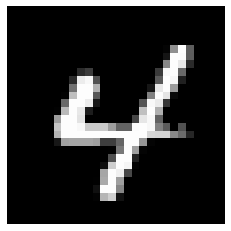

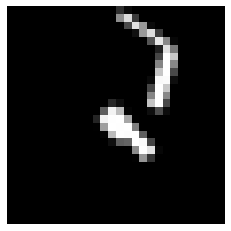

Test score: 0.0
Loss: 0.0025949622065420375
Iteration: 11240, Score: 0.0997524906164035
[81, 46, 185, 49, 53, 113, 154, 48, 46, 99, 35, 34, 31, 26, 0]


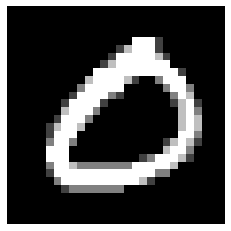

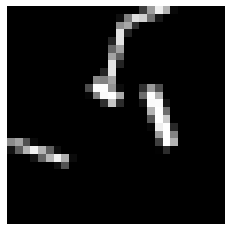

Loss: 0.0027599500490758048
Iteration: 11280, Score: 0.12257829916849731
[143, 64, 142, 127, 63, 64, 142, 46, 62, 39, 20, 32, 33, 23, 0]


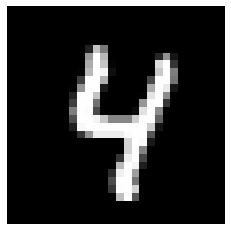

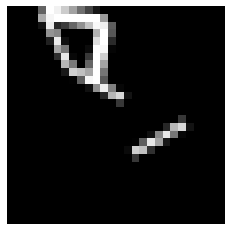

Loss: 0.0025288205124386694
Iteration: 11320, Score: 0.09895654275035487
[78, 43, 135, 150, 176, 74, 93, 59, 42, 47, 23, 31, 23, 26, 0]


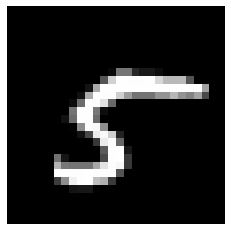

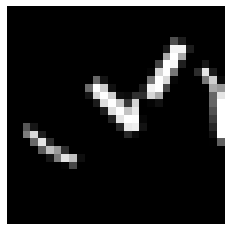

Loss: 0.0028967175715477623
Iteration: 11360, Score: 0.08672789152525365
[43, 50, 116, 133, 156, 121, 47, 104, 59, 83, 27, 23, 17, 21, 0]


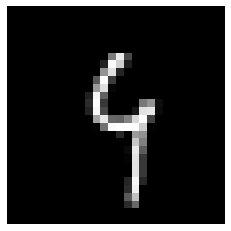

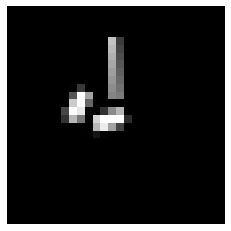

Loss: 0.002136124762399847
Iteration: 11400, Score: 0.0829818255410064
[93, 78, 94, 39, 126, 137, 132, 43, 59, 84, 27, 29, 36, 23, 0]


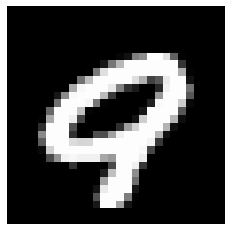

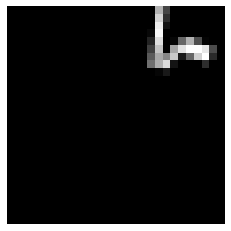

Loss: 0.00213809039491575
Iteration: 11440, Score: 0.10961937186494466
[115, 52, 168, 67, 81, 87, 154, 35, 44, 68, 37, 34, 31, 27, 0]


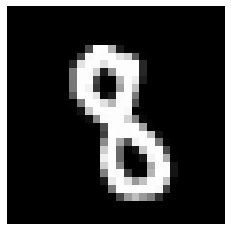

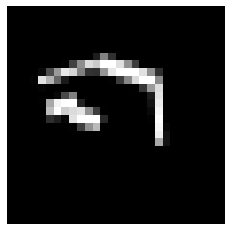

Loss: 0.0027291220784592396
Iteration: 11480, Score: 0.09687065466679631
[97, 62, 143, 94, 88, 109, 95, 44, 58, 97, 25, 29, 26, 33, 0]


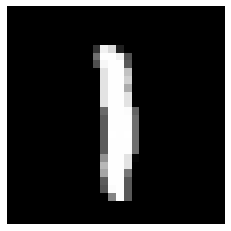

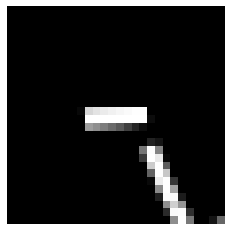

Loss: 0.0026038861381154996
Iteration: 11520, Score: 0.09336572431586683
[54, 76, 113, 106, 142, 113, 99, 114, 63, 28, 25, 18, 28, 21, 0]


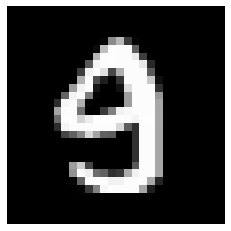

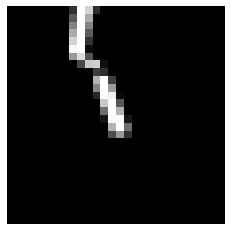

Loss: 0.002085405253613
Iteration: 11560, Score: 0.0850689174812287
[30, 128, 107, 63, 70, 115, 70, 228, 46, 43, 32, 23, 18, 27, 0]


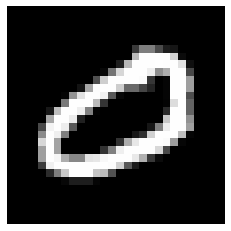

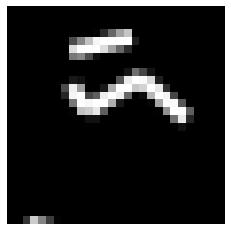

Loss: 0.002322882429799605
Iteration: 11600, Score: 0.1272077837035322
[44, 69, 54, 93, 123, 85, 65, 219, 98, 51, 23, 31, 22, 23, 0]


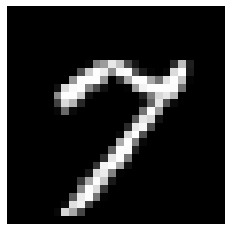

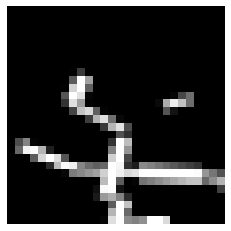

Test score: 0.004762149937450885
Loss: 0.0026783453225803474
Iteration: 11640, Score: 0.12864480119140348
[62, 101, 99, 88, 82, 87, 129, 76, 150, 17, 28, 33, 20, 28, 0]


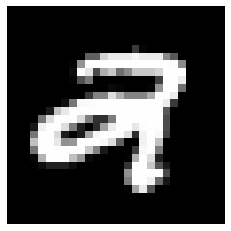

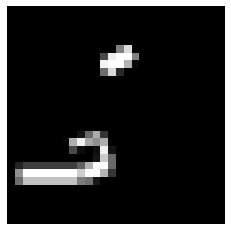

Loss: 0.0023384537720931853
Iteration: 11680, Score: 0.1010080900741741
[52, 69, 75, 157, 191, 62, 102, 54, 82, 50, 22, 28, 25, 31, 0]


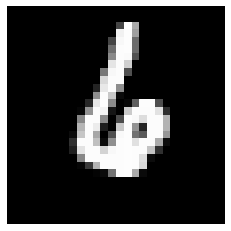

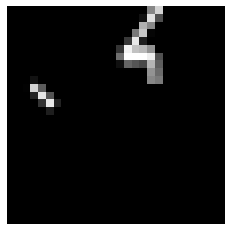

Loss: 0.002127713001780414
Iteration: 11720, Score: 0.09977697163727135
[49, 60, 80, 161, 114, 73, 85, 179, 33, 54, 35, 27, 26, 24, 0]


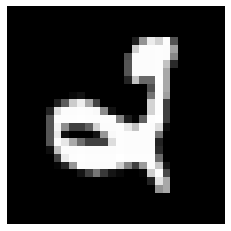

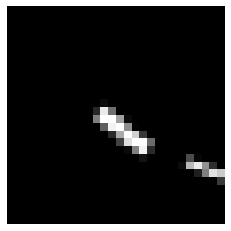

Loss: 0.002846096065697533
Iteration: 11760, Score: 0.09860883701452985
[86, 68, 58, 106, 49, 60, 38, 230, 110, 48, 31, 39, 43, 34, 0]


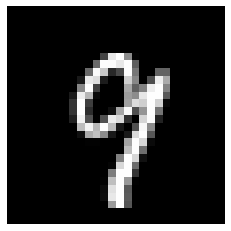

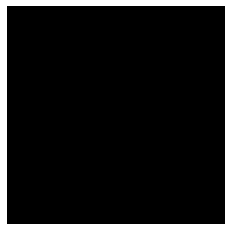

Loss: 0.0023089689192518823
Iteration: 11800, Score: 0.13291218723054046
[75, 68, 44, 113, 85, 50, 78, 184, 116, 42, 39, 39, 33, 34, 0]


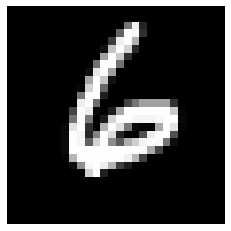

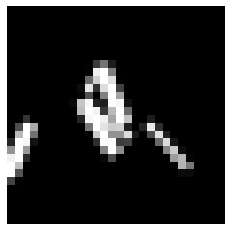

Loss: 0.0025554989198222763
Iteration: 11840, Score: 0.08812401894666252
[36, 51, 126, 73, 114, 111, 100, 126, 100, 54, 27, 35, 16, 31, 0]


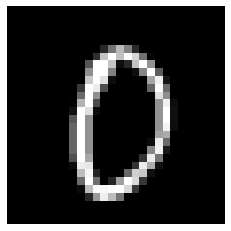

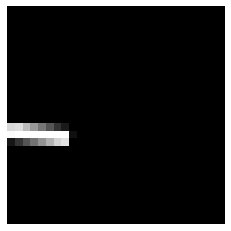

Loss: 0.002496172948113564
Iteration: 11880, Score: 0.14444694658927618
[34, 121, 92, 86, 137, 95, 191, 64, 42, 57, 17, 26, 22, 16, 0]


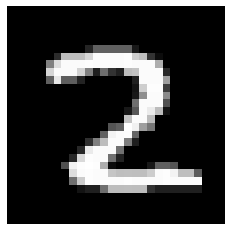

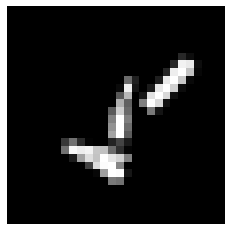

Loss: 0.0022357349668258196
Iteration: 11920, Score: 0.1083282091282308
[117, 140, 97, 71, 72, 71, 174, 85, 45, 31, 26, 25, 20, 26, 0]


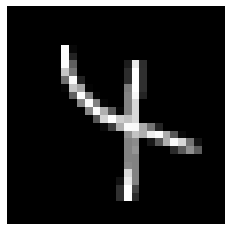

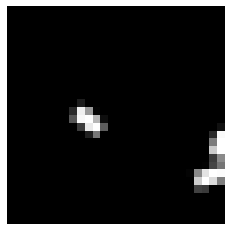

Loss: 0.002110417162222163
Iteration: 11960, Score: 0.08452147906785831
[96, 62, 81, 66, 95, 97, 116, 148, 66, 63, 28, 29, 30, 23, 0]


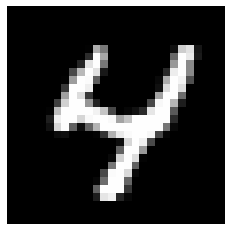

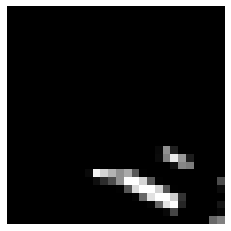

Loss: 0.002340732253947534
Iteration: 12000, Score: 0.07844476253539323
[58, 49, 55, 108, 60, 72, 95, 270, 53, 38, 43, 25, 37, 37, 0]


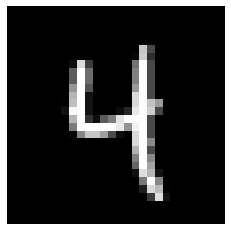

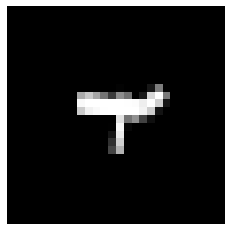

Test score: 4.2651643161661924e-05
Loss: 0.002036152968382696
Iteration: 12040, Score: 0.08377133854181738
[44, 151, 51, 65, 38, 76, 115, 237, 82, 41, 23, 26, 26, 25, 0]


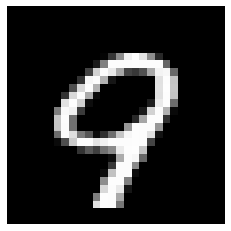

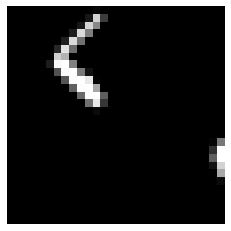

Loss: 0.002295269711836715
Iteration: 12080, Score: 0.1243881455240771
[59, 159, 112, 70, 56, 60, 78, 111, 118, 45, 40, 42, 21, 29, 0]


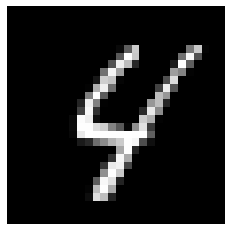

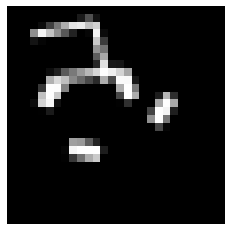

Loss: 0.0020341657769726135
Iteration: 12120, Score: 0.07533910520374776
[44, 66, 113, 144, 153, 46, 55, 103, 128, 39, 33, 34, 22, 20, 0]


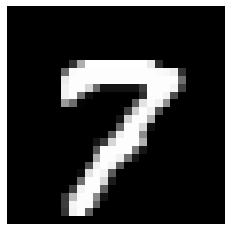

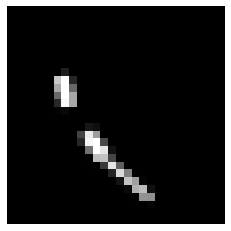

Loss: 0.002289173815637183
Iteration: 12160, Score: 0.08699551403615623
[44, 102, 65, 149, 158, 25, 168, 79, 38, 78, 20, 22, 32, 20, 0]


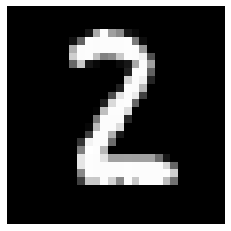

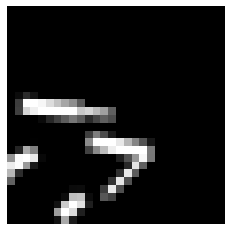

Loss: 0.0021252267409603877
Iteration: 12200, Score: 0.09604030148498713
[84, 188, 70, 130, 97, 31, 125, 96, 40, 29, 22, 19, 49, 20, 0]


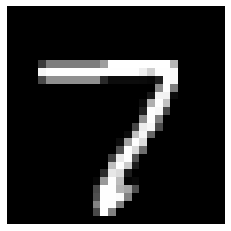

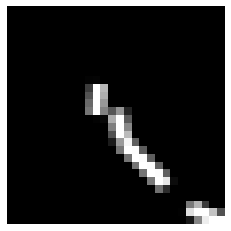

Loss: 0.0022292630626621845
Iteration: 12240, Score: 0.09042939147207651
[58, 203, 66, 103, 62, 27, 156, 118, 84, 27, 23, 31, 21, 21, 0]


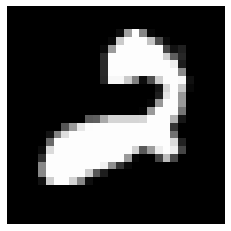

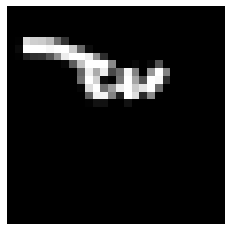

Loss: 0.002070437569410854
Iteration: 12280, Score: 0.07441598426563724
[55, 132, 83, 91, 147, 44, 172, 60, 83, 25, 24, 27, 26, 31, 0]


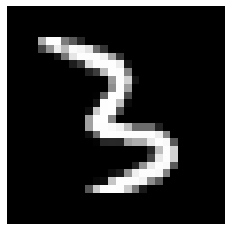

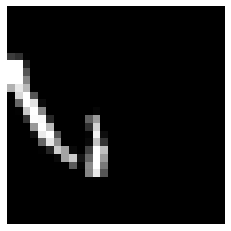

Loss: 0.002141300968199746
Iteration: 12320, Score: 0.09135240056551994
[99, 88, 113, 169, 159, 46, 92, 45, 81, 23, 19, 29, 21, 16, 0]


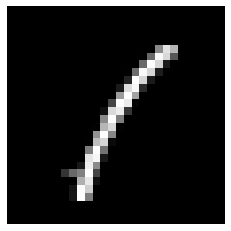

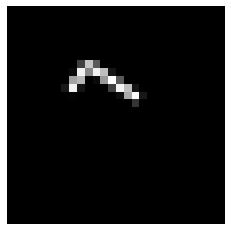

Loss: 0.0018561433827782466
Iteration: 12360, Score: 0.07739214937947689
[85, 41, 53, 209, 196, 28, 78, 70, 77, 44, 16, 35, 44, 24, 0]


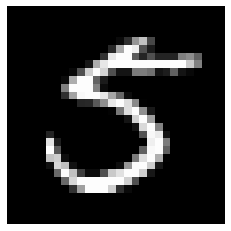

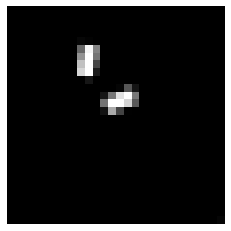

Loss: 0.0020308721717846394
Iteration: 12400, Score: 0.08445788842439651
[44, 28, 121, 151, 196, 28, 132, 57, 93, 46, 25, 29, 20, 30, 0]


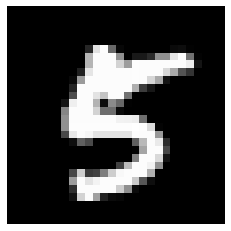

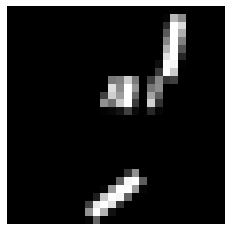

Test score: 0.0012410404160618782
Loss: 0.0022210434202245516
Iteration: 12440, Score: 0.0843618732020259
[57, 187, 62, 70, 78, 51, 185, 38, 141, 31, 35, 26, 18, 21, 0]


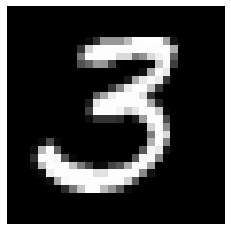

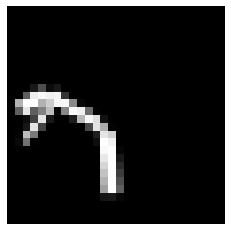

Loss: 0.0019480022947311836
Iteration: 12480, Score: 0.08472781443223357
[52, 186, 45, 110, 197, 35, 146, 43, 70, 28, 20, 24, 20, 24, 0]


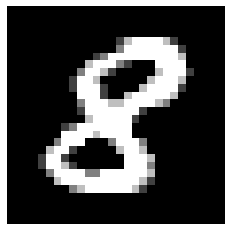

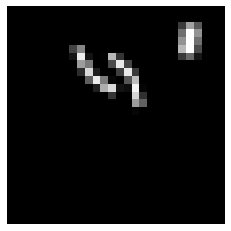

Loss: 0.002109123192233528
Iteration: 12520, Score: 0.09854028675702282
[31, 72, 94, 207, 122, 49, 107, 48, 71, 88, 30, 30, 23, 28, 0]


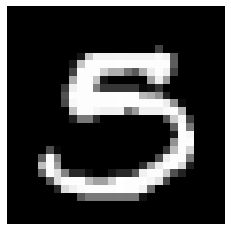

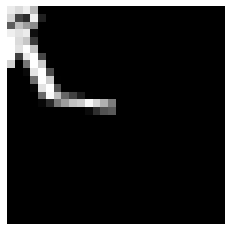

Loss: 0.002197823726813141
Iteration: 12560, Score: 0.08148557911626994
[40, 136, 84, 155, 141, 31, 203, 41, 38, 58, 20, 21, 23, 9, 0]


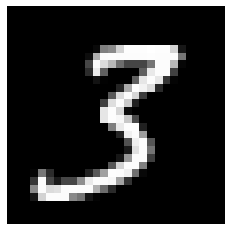

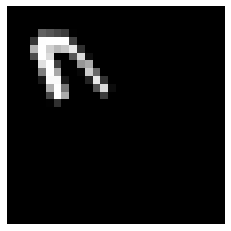

Loss: 0.002141065532204994
Iteration: 12600, Score: 0.09755176657997074
[65, 120, 67, 130, 64, 55, 177, 30, 184, 23, 20, 18, 21, 26, 0]


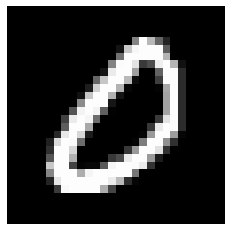

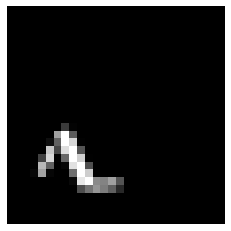

Loss: 0.001893452299190379
Iteration: 12640, Score: 0.09466779724415392
[35, 70, 119, 46, 110, 91, 219, 38, 103, 51, 32, 33, 28, 25, 0]


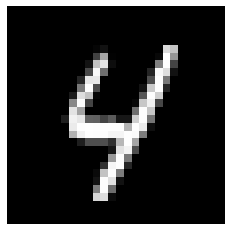

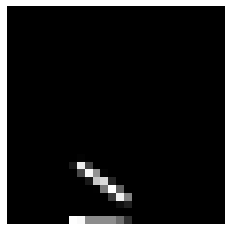

Loss: 0.001800317977837005
Iteration: 12680, Score: 0.08550509033910933
[39, 42, 142, 77, 63, 110, 128, 110, 73, 106, 34, 21, 26, 29, 0]


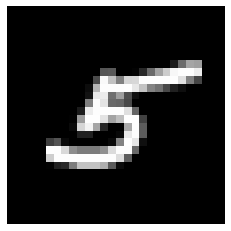

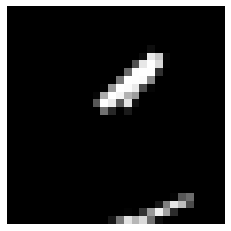

Loss: 0.0020405928721924085
Iteration: 12720, Score: 0.08127424630310269
[45, 248, 70, 54, 71, 31, 300, 52, 22, 45, 18, 15, 18, 11, 0]


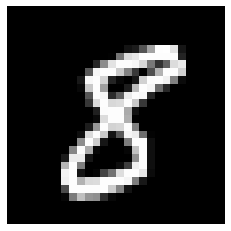

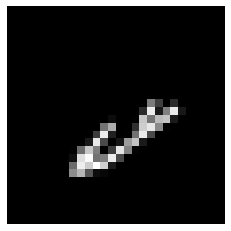

Loss: 0.001787371661285169
Iteration: 12760, Score: 0.10214252236369066
[53, 192, 84, 30, 102, 85, 141, 107, 54, 37, 25, 30, 26, 34, 0]


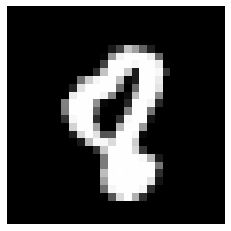

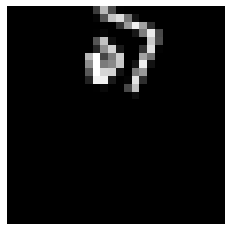

Loss: 0.0017976510189670735
Iteration: 12800, Score: 0.09162501735636032
[33, 156, 52, 98, 123, 88, 62, 147, 74, 30, 43, 28, 29, 37, 0]


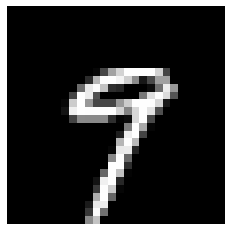

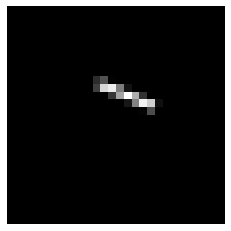

Test score: 0.0
Loss: 0.002193345377732539
Iteration: 12840, Score: 0.10888938108604633
[39, 123, 94, 141, 120, 30, 123, 123, 66, 61, 25, 23, 11, 21, 0]


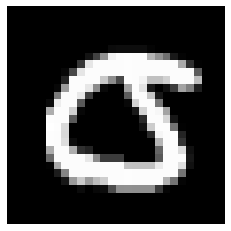

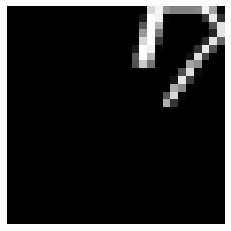

Loss: 0.0020046066189681956
Iteration: 12880, Score: 0.11417825211549644
[45, 152, 86, 97, 104, 85, 107, 108, 64, 64, 16, 26, 21, 25, 0]


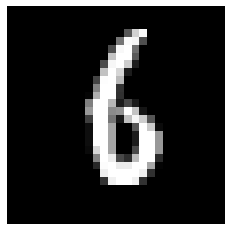

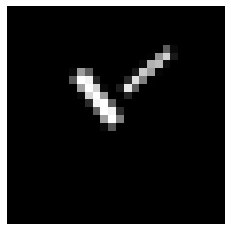

Loss: 0.0021781807998027328
Iteration: 12920, Score: 0.07739509359456133
[69, 128, 59, 53, 63, 161, 126, 132, 87, 36, 21, 19, 26, 20, 0]


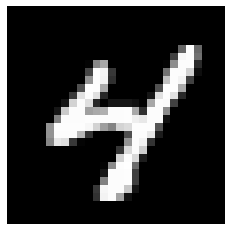

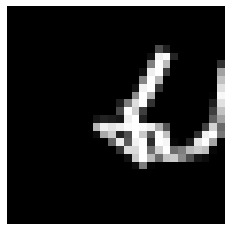

Loss: 0.0018941852127001189
Iteration: 12960, Score: 0.09348003179673108
[51, 193, 103, 29, 49, 91, 154, 106, 76, 54, 15, 30, 22, 27, 0]


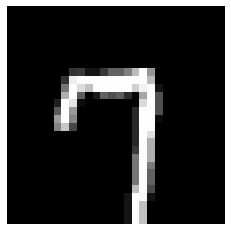

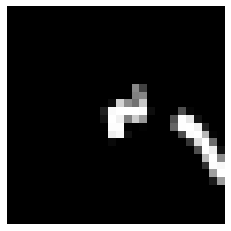

Loss: 0.0016868050271085615
Iteration: 13000, Score: 0.08211037827469408
[57, 210, 46, 90, 121, 42, 163, 94, 69, 23, 22, 17, 23, 23, 0]


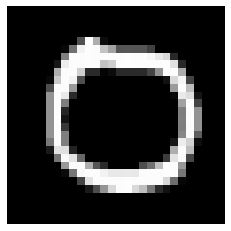

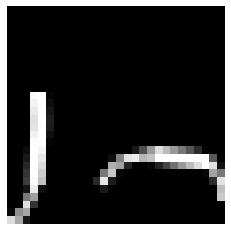

Loss: 0.002296679839517129
Iteration: 13040, Score: 0.07720652189501562
[29, 148, 86, 69, 126, 70, 161, 61, 76, 73, 28, 18, 24, 31, 0]


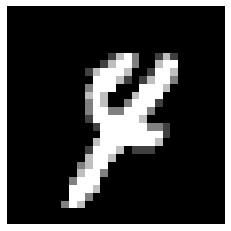

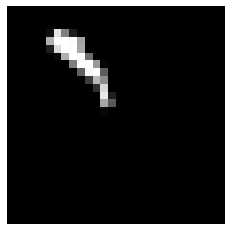

Loss: 0.002213531696047253
Iteration: 13080, Score: 0.08505530412495138
[33, 111, 67, 150, 142, 53, 167, 99, 34, 30, 25, 23, 31, 35, 0]


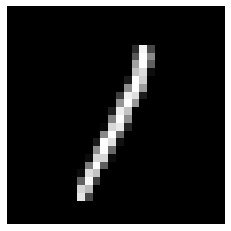

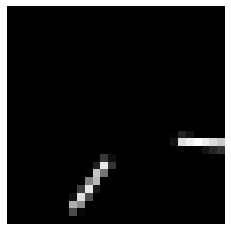

Loss: 0.0024855782106778753
Iteration: 13120, Score: 0.06814145075498526
[51, 78, 87, 106, 174, 28, 164, 139, 38, 45, 17, 32, 18, 23, 0]


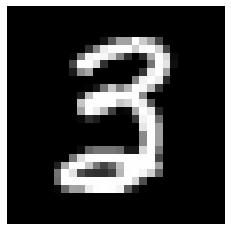

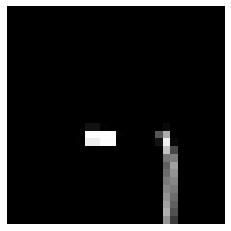

Loss: 0.0021892543918282424
Iteration: 13160, Score: 0.09092386055272074
[37, 78, 145, 78, 168, 140, 56, 127, 23, 52, 27, 32, 17, 20, 0]


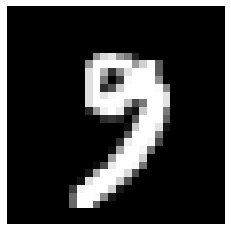

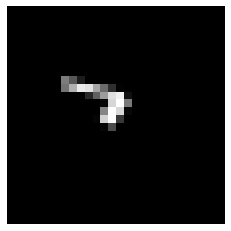

Loss: 0.0019181075148643097
Iteration: 13200, Score: 0.07230722510349005
[44, 181, 101, 39, 86, 59, 268, 47, 46, 51, 13, 24, 26, 15, 0]


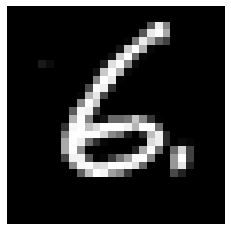

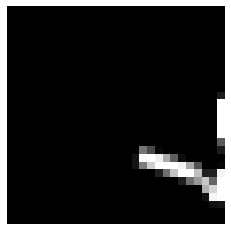

Test score: 0.0
Loss: 0.002291223010173843
Iteration: 13240, Score: 0.04609495106991381
[34, 204, 160, 18, 67, 114, 181, 85, 43, 26, 22, 13, 19, 14, 0]


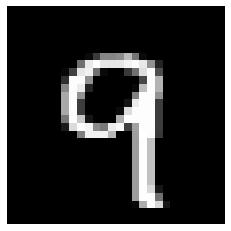

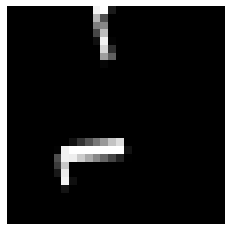

Loss: 0.002918902578680159
Iteration: 13280, Score: 0.07456112543540075
[25, 236, 105, 52, 61, 112, 211, 67, 50, 24, 11, 21, 16, 9, 0]


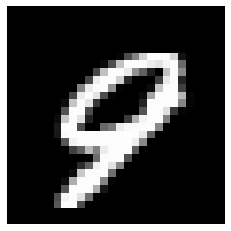

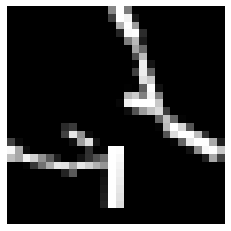

Loss: 0.001955580303640424
Iteration: 13320, Score: 0.05869615784240887
[36, 81, 167, 86, 177, 192, 95, 48, 22, 27, 18, 19, 15, 17, 0]


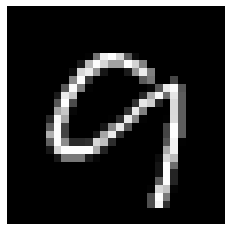

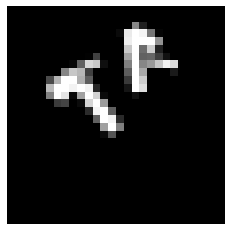

Loss: 0.001971819925392886
Iteration: 13360, Score: 0.07786584693891926
[47, 290, 28, 50, 72, 90, 260, 45, 20, 21, 17, 21, 18, 21, 0]


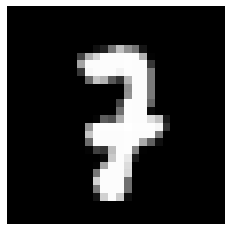

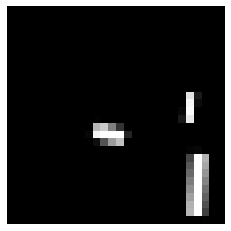

Loss: 0.002041799625311496
Iteration: 13400, Score: 0.07979184726439414
[36, 220, 55, 41, 72, 34, 295, 49, 50, 76, 22, 14, 17, 19, 0]


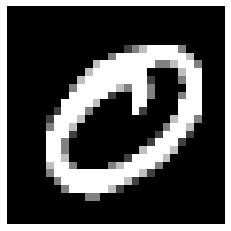

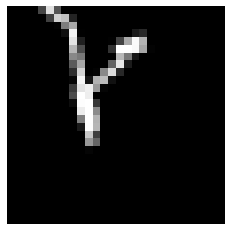

Loss: 0.0020146545774948504
Iteration: 13440, Score: 0.06782345024729146
[65, 188, 95, 80, 64, 34, 193, 29, 85, 84, 24, 16, 20, 23, 0]


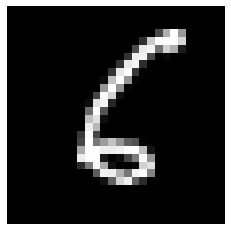

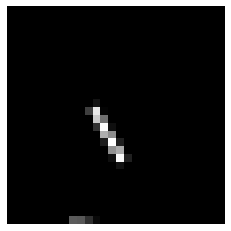

Loss: 0.001957408082309914
Iteration: 13480, Score: 0.0582402199539356
[48, 105, 176, 39, 127, 161, 101, 40, 39, 70, 24, 26, 20, 24, 0]


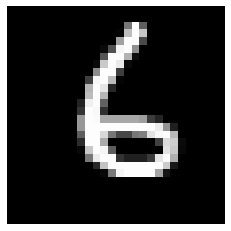

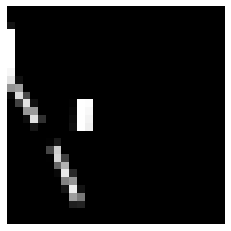

Loss: 0.0020517883486046245
Iteration: 13520, Score: 0.05553079904941841
[68, 130, 65, 231, 154, 60, 78, 34, 26, 86, 18, 16, 16, 18, 0]


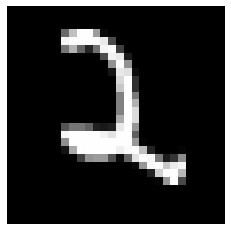

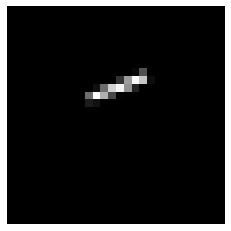

Loss: 0.0022976244945134387
Iteration: 13560, Score: 0.06747149395756423
[41, 146, 61, 121, 211, 54, 113, 37, 76, 49, 27, 21, 19, 24, 0]


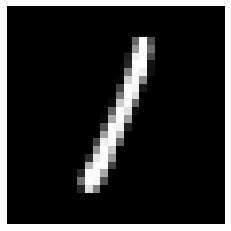

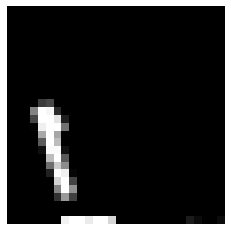

Loss: 0.0020612036292657985
Iteration: 13600, Score: 0.05652264752297196
[79, 98, 120, 99, 127, 78, 141, 56, 63, 50, 18, 25, 23, 23, 0]


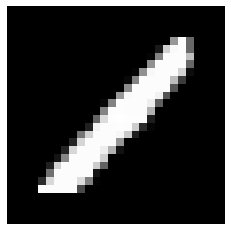

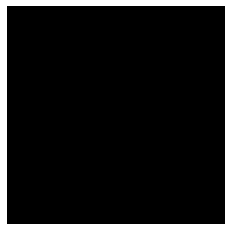

Test score: 0.0
Loss: 0.0017445121252975958
Iteration: 13640, Score: 0.11290810126112774
[54, 61, 153, 48, 116, 127, 141, 77, 26, 79, 12, 30, 43, 33, 0]


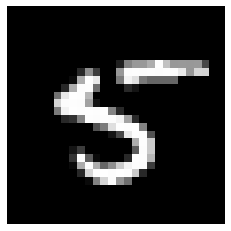

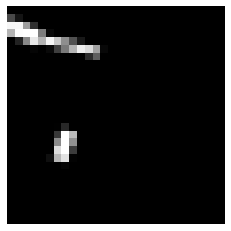

Loss: 0.002163389912919267
Iteration: 13680, Score: 0.05536179864965379
[53, 70, 76, 244, 253, 70, 81, 28, 44, 23, 12, 14, 16, 16, 0]


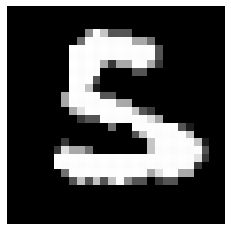

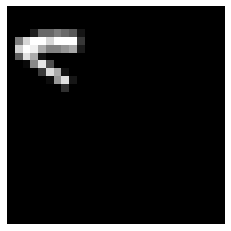

Loss: 0.0018851765106951968
Iteration: 13720, Score: 0.07878897777944804
[22, 158, 46, 107, 255, 30, 113, 33, 59, 66, 29, 32, 28, 22, 0]


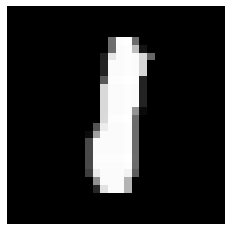

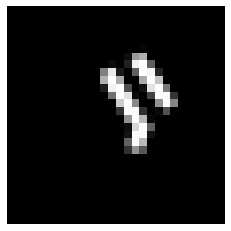

Loss: 0.002190178919684451
Iteration: 13760, Score: 0.06266778978705406
[117, 57, 45, 150, 162, 45, 127, 35, 33, 128, 21, 27, 22, 31, 0]


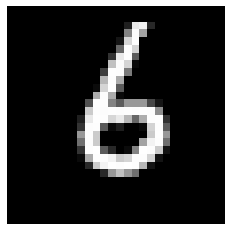

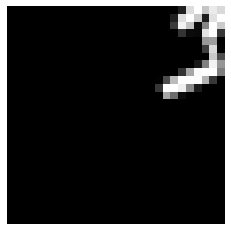

Loss: 0.00221462002432802
Iteration: 13800, Score: 0.07600907561508938
[60, 31, 204, 94, 83, 226, 55, 57, 72, 38, 12, 27, 18, 23, 0]


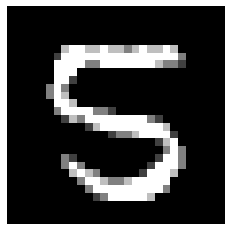

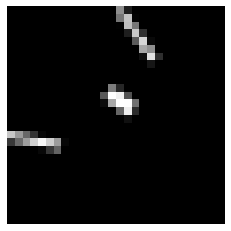

Loss: 0.002242474963990573
Iteration: 13840, Score: 0.0684259960036725
[75, 203, 145, 68, 44, 106, 158, 46, 29, 50, 25, 21, 12, 18, 0]


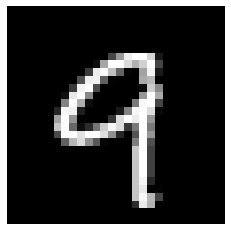

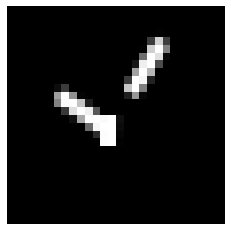

Loss: 0.0019164396926750792
Iteration: 13880, Score: 0.1025054697468877
[52, 193, 46, 47, 97, 107, 128, 85, 73, 87, 19, 21, 20, 25, 0]


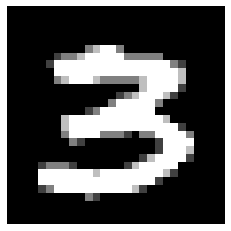

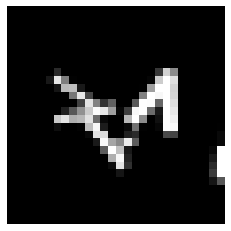

Loss: 0.0016184253909252656
Iteration: 13920, Score: 0.08910640454851093
[93, 66, 174, 97, 106, 168, 98, 29, 45, 39, 16, 37, 19, 13, 0]


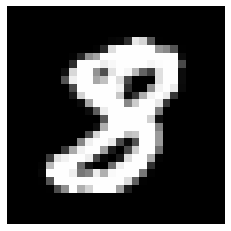

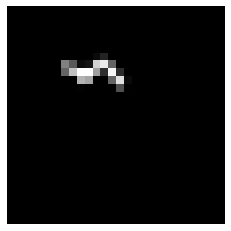

Loss: 0.0016997980247501876
Iteration: 13960, Score: 0.10814630550146105
[68, 33, 104, 171, 88, 220, 48, 53, 57, 70, 26, 23, 20, 19, 0]


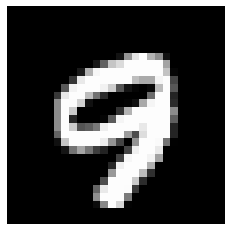

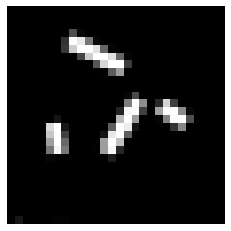

Loss: 0.0014744711035389675
Iteration: 14000, Score: 0.05829588682902975
[72, 239, 83, 67, 77, 94, 126, 50, 46, 81, 12, 17, 23, 13, 0]


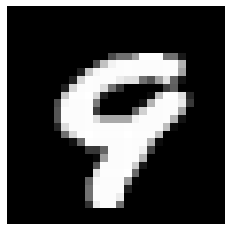

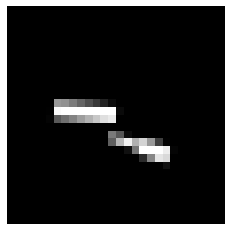

Test score: 0.0
Loss: 0.0017890795144157434
Iteration: 14040, Score: 0.06831548891752026
[97, 71, 137, 32, 67, 165, 57, 172, 40, 62, 20, 29, 25, 26, 0]


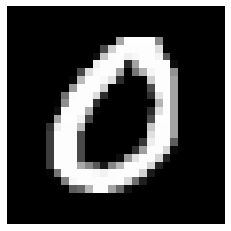

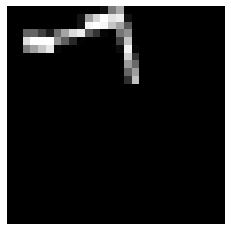

Loss: 0.0015497697465605598
Iteration: 14080, Score: 0.09147210820438338
[98, 38, 43, 70, 219, 68, 151, 65, 73, 60, 31, 27, 25, 32, 0]


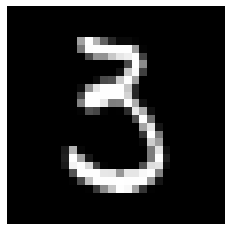

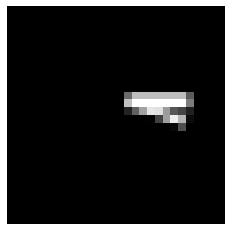

Loss: 0.002110063316825465
Iteration: 14120, Score: 0.10338479671999812
[68, 29, 123, 135, 121, 190, 50, 79, 26, 85, 20, 24, 29, 21, 0]


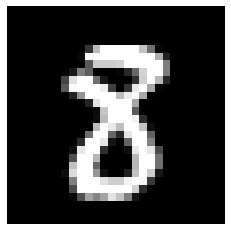

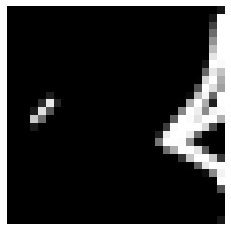

Loss: 0.0014124579455010182
Iteration: 14160, Score: 0.10923225535918028
[37, 44, 97, 62, 181, 70, 61, 57, 183, 96, 29, 29, 22, 32, 0]


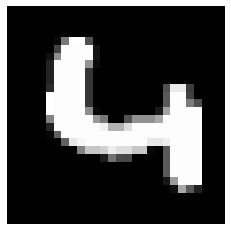

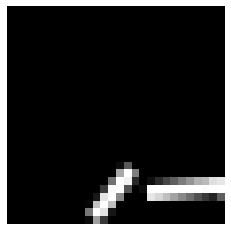

Loss: 0.0017092282460406407
Iteration: 14200, Score: 0.047488106831908225
[45, 117, 56, 66, 101, 62, 162, 184, 65, 38, 23, 26, 28, 27, 0]


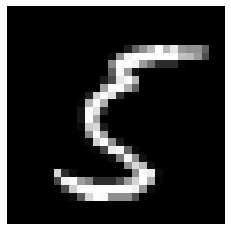

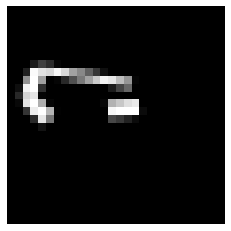

Loss: 0.0017381323676789048
Iteration: 14240, Score: 0.09133304146677255
[121, 62, 48, 147, 244, 25, 126, 91, 34, 30, 16, 22, 21, 13, 0]


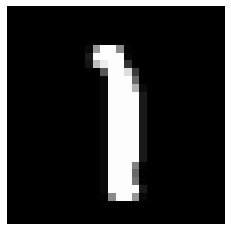

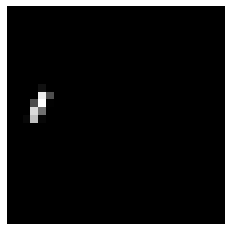

Loss: 0.0014895791771819484
Iteration: 14280, Score: 0.08019050855282694
[81, 28, 56, 94, 242, 27, 75, 223, 44, 27, 34, 18, 24, 27, 0]


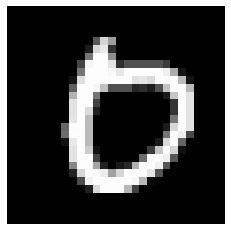

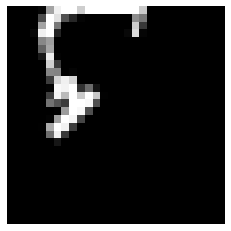

Loss: 0.0020495915936104303
Iteration: 14320, Score: 0.07129546350985763
[42, 165, 35, 129, 157, 25, 185, 55, 91, 35, 21, 22, 20, 18, 0]


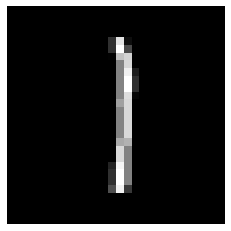

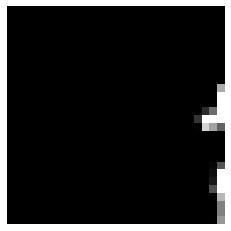

Loss: 0.0016313286646587374
Iteration: 14360, Score: 0.09201041606813667
[50, 234, 41, 58, 114, 57, 151, 36, 104, 46, 45, 26, 19, 19, 0]


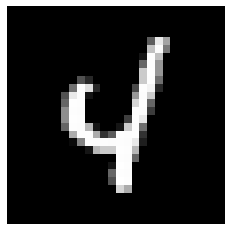

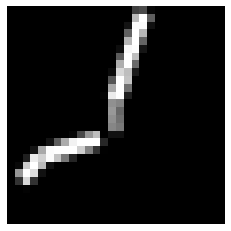

Loss: 0.0011506643034024807
Iteration: 14400, Score: 0.07535881864652036
[76, 68, 62, 138, 102, 98, 127, 150, 66, 22, 26, 24, 21, 20, 0]


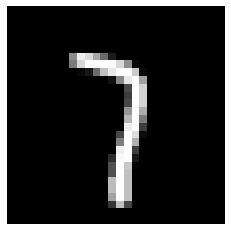

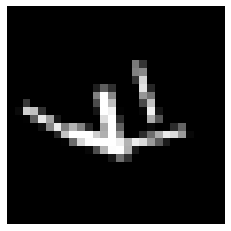

Test score: 0.0
Loss: 0.0014395030328541536
Iteration: 14440, Score: 0.09647776617115597
[37, 78, 198, 56, 41, 157, 82, 129, 127, 23, 19, 22, 18, 13, 0]


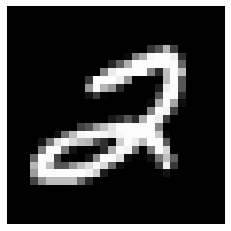

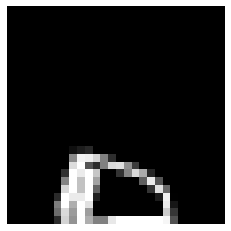

Loss: 0.0011289480637614055
Iteration: 14480, Score: 0.07513230331079103
[46, 77, 79, 50, 75, 63, 207, 153, 84, 44, 22, 32, 33, 35, 0]


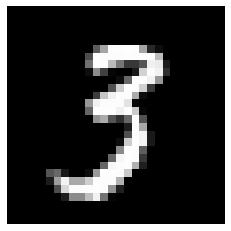

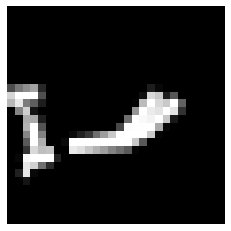

Loss: 0.0015047467366147407
Iteration: 14520, Score: 0.07058660192205571
[68, 47, 137, 42, 29, 269, 142, 36, 80, 57, 33, 20, 21, 19, 0]


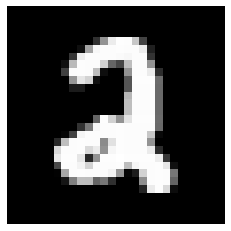

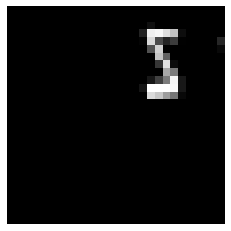

Loss: 0.00175769883731529
Iteration: 14560, Score: 0.06757661489024758
[44, 301, 40, 120, 22, 40, 217, 55, 54, 25, 19, 21, 24, 18, 0]


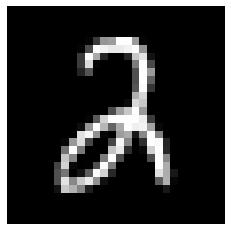

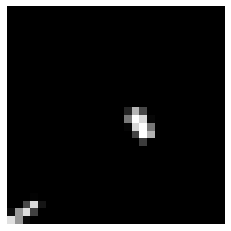

Loss: 0.0013759240306765892
Iteration: 14600, Score: 0.09405296837538482
[59, 76, 303, 56, 28, 164, 48, 106, 41, 20, 27, 26, 21, 25, 0]


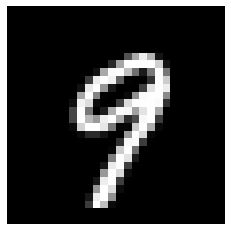

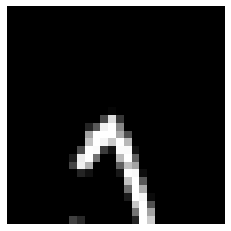

Loss: 0.0015098084170253605
Iteration: 14640, Score: 0.08533061735332012
[41, 163, 137, 103, 101, 21, 223, 56, 23, 18, 21, 53, 24, 16, 0]


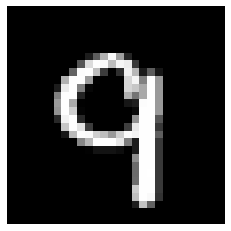

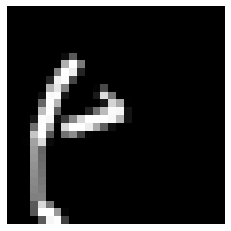

Loss: 0.0014754937516284015
Iteration: 14680, Score: 0.06364448628574611
[69, 52, 94, 34, 169, 26, 141, 58, 100, 139, 31, 33, 28, 26, 0]


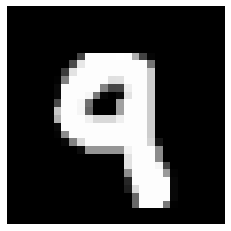

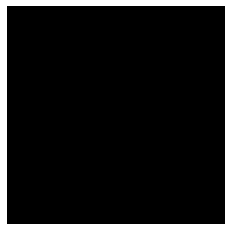

Loss: 0.001515263926047754
Iteration: 14720, Score: 0.07819185564294455
[41, 281, 82, 162, 73, 39, 71, 34, 45, 56, 30, 29, 36, 21, 0]


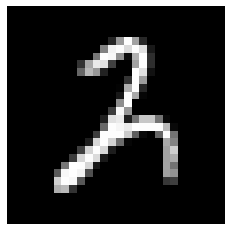

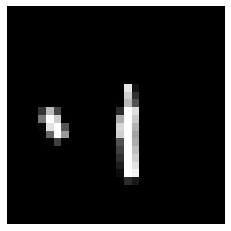

Loss: 0.001691016108413715
Iteration: 14760, Score: 0.07897708607395179
[29, 139, 68, 326, 105, 85, 28, 25, 40, 43, 24, 28, 33, 27, 0]


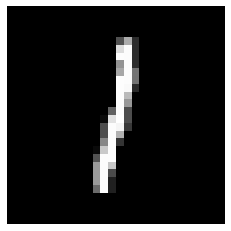

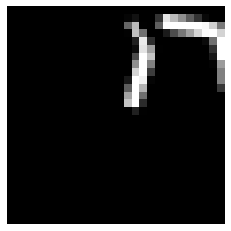

Loss: 0.0016299749049844539
Iteration: 14800, Score: 0.08770775460358708
[70, 89, 93, 258, 177, 106, 67, 20, 18, 42, 15, 12, 14, 19, 0]


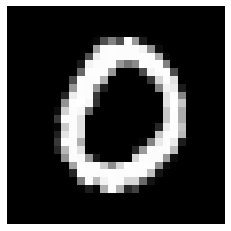

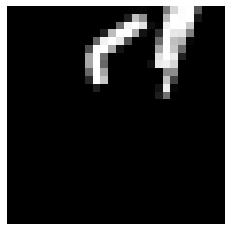

Test score: 0.0
Loss: 0.0015674899513359608
Iteration: 14840, Score: 0.047786092139896943
[105, 44, 223, 33, 230, 112, 66, 45, 19, 30, 14, 39, 21, 19, 0]


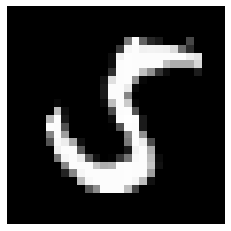

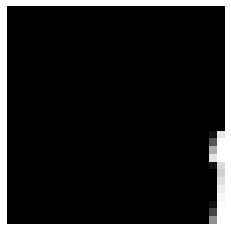

Loss: 0.0020213854025483637
Iteration: 14880, Score: 0.09285554569214582
[40, 74, 86, 246, 159, 25, 78, 20, 60, 85, 20, 58, 21, 28, 0]


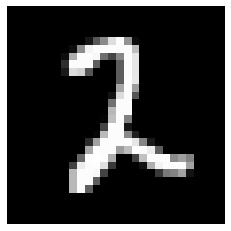

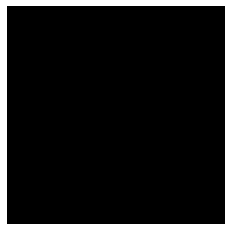

Loss: 0.0017871033530752728
Iteration: 14920, Score: 0.04080569891259074
[49, 14, 67, 287, 214, 55, 119, 22, 40, 31, 20, 33, 20, 29, 0]


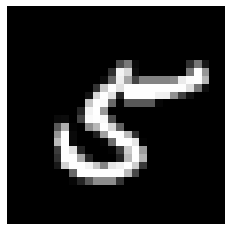

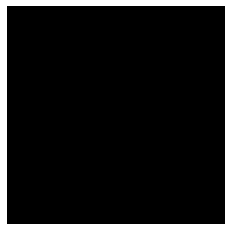

Loss: 0.0020310126234845535
Iteration: 14960, Score: 0.052478087551193306
[26, 56, 85, 286, 159, 76, 43, 97, 37, 40, 27, 24, 19, 25, 0]


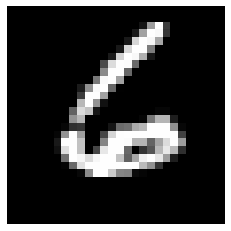

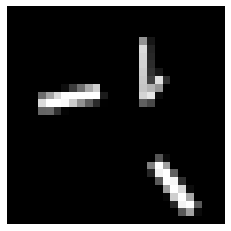

Loss: 0.0015752948808330763
Iteration: 15000, Score: 0.06551491151470691
[96, 33, 52, 140, 223, 36, 119, 75, 30, 75, 24, 35, 28, 34, 0]


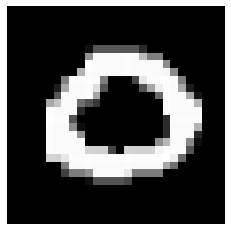

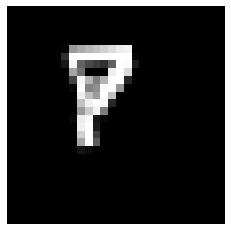

Loss: 0.0013288784278495433
Iteration: 15040, Score: 0.09426656102967172
[29, 19, 23, 277, 311, 17, 82, 70, 59, 40, 22, 21, 18, 12, 0]


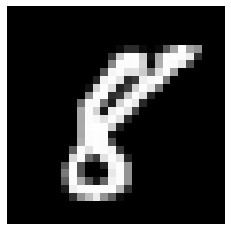

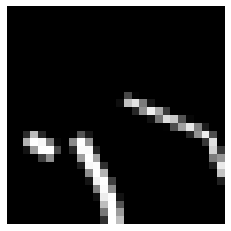

Loss: 0.0017925107539710275
Iteration: 15080, Score: 0.04957741105207242
[79, 89, 82, 177, 132, 152, 94, 38, 25, 46, 16, 36, 15, 19, 0]


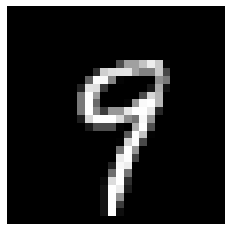

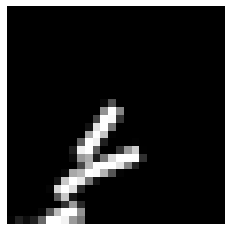

Loss: 0.0016966561705317375
Iteration: 15120, Score: 0.03138433300005273
[46, 232, 50, 115, 190, 119, 51, 39, 27, 36, 27, 19, 22, 27, 0]


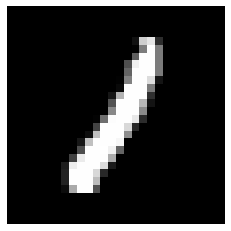

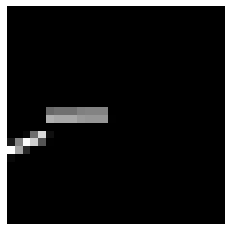

Loss: 0.0016171240825952975
Iteration: 15160, Score: 0.06832274836301802
[41, 67, 34, 96, 385, 37, 70, 58, 49, 50, 34, 32, 33, 14, 0]


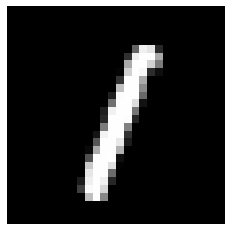

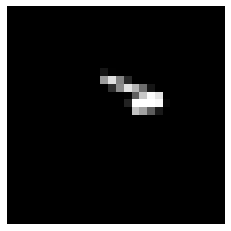

Loss: 0.0014113581271731057
Iteration: 15200, Score: 0.10799200486810875
[61, 128, 55, 147, 105, 83, 88, 71, 70, 114, 21, 26, 15, 16, 0]


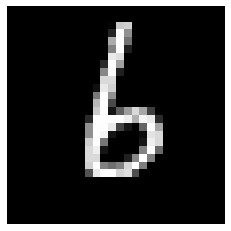

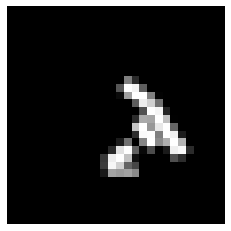

Test score: 0.0
Loss: 0.0013891872807829332
Iteration: 15240, Score: 0.06909496539738028
[32, 101, 40, 266, 307, 26, 46, 23, 24, 61, 16, 19, 11, 28, 0]


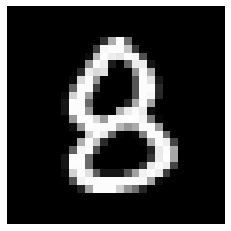

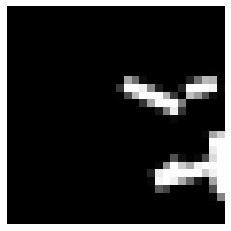

Loss: 0.001400743674692203
Iteration: 15280, Score: 0.0632903947661107
[56, 126, 104, 123, 151, 61, 81, 101, 31, 73, 19, 31, 22, 21, 0]


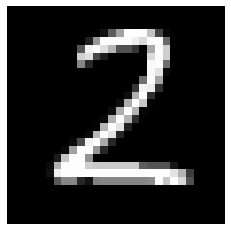

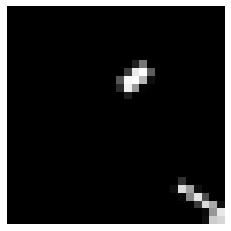

Loss: 0.001441268219976823
Iteration: 15320, Score: 0.058743938731960946
[98, 27, 57, 40, 290, 70, 28, 104, 43, 67, 48, 50, 43, 35, 0]


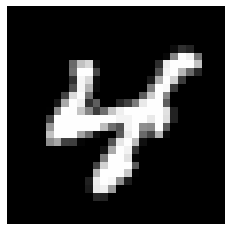

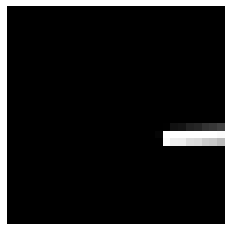

Loss: 0.0014527637388263679
Iteration: 15360, Score: 0.07393920745118521
[64, 29, 60, 121, 325, 88, 39, 41, 45, 76, 35, 32, 23, 22, 0]


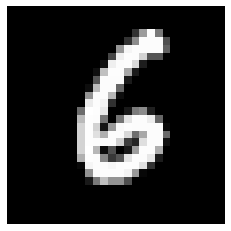

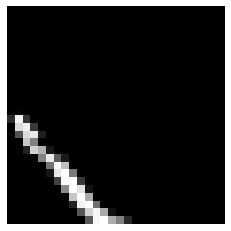

Loss: 0.0013991060046546747
Iteration: 15400, Score: 0.0469689335860312
[86, 51, 115, 193, 114, 30, 144, 55, 31, 58, 49, 27, 20, 27, 0]


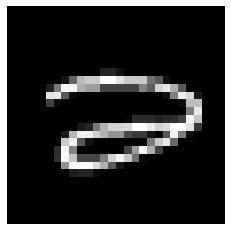

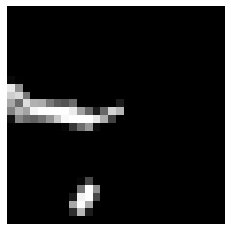

Loss: 0.0017018630794271017
Iteration: 15440, Score: 0.059590143044246355
[48, 62, 125, 70, 189, 21, 96, 77, 70, 86, 18, 71, 27, 40, 0]


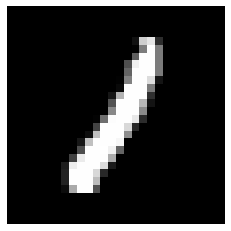

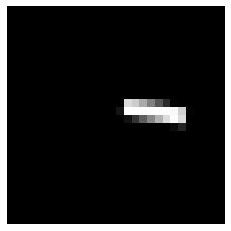

Loss: 0.0014268636611366634
Iteration: 15480, Score: 0.0826231783889234
[52, 29, 43, 171, 322, 45, 47, 77, 42, 64, 28, 29, 18, 33, 0]


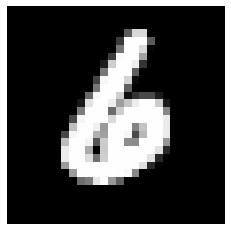

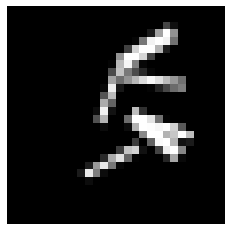

Loss: 0.001828539168915556
Iteration: 15520, Score: 0.10974095966108141
[54, 27, 242, 120, 120, 168, 60, 76, 16, 16, 30, 27, 24, 20, 0]


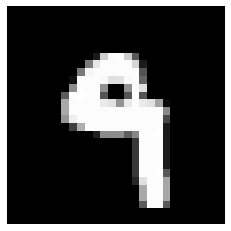

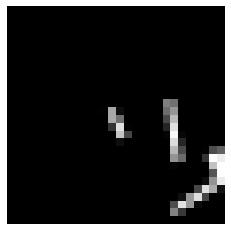

Loss: 0.0015494600382723303
Iteration: 15560, Score: 0.06989067403619993
[28, 54, 78, 246, 227, 70, 84, 83, 14, 32, 29, 31, 13, 11, 0]


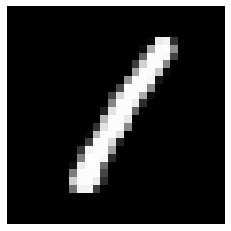

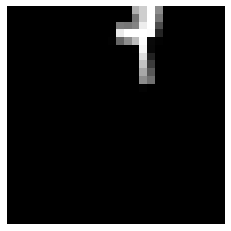

Loss: 0.0015219439690898093
Iteration: 15600, Score: 0.0822684219381772
[39, 68, 127, 124, 138, 157, 24, 134, 54, 48, 22, 15, 26, 24, 0]


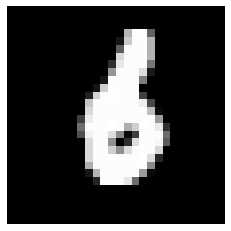

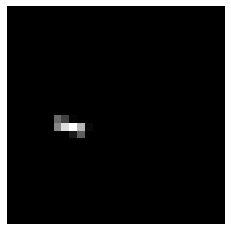

Test score: 0.0
Loss: 0.001472753518501495
Iteration: 15640, Score: 0.048385409177339175
[75, 30, 26, 74, 385, 57, 69, 94, 43, 32, 30, 30, 32, 23, 0]


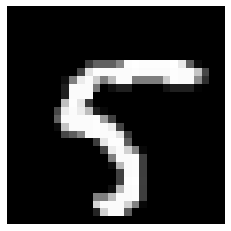

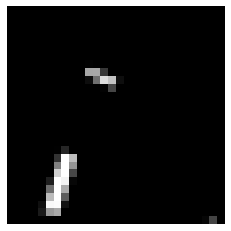

Loss: 0.0015501122980852591
Iteration: 15680, Score: 0.08269276928453473
[44, 66, 197, 140, 123, 72, 92, 87, 40, 62, 13, 24, 18, 22, 0]


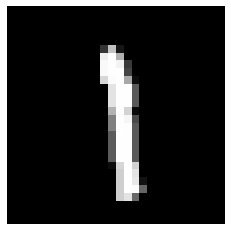

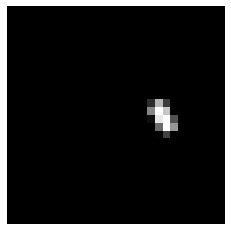

Loss: 0.0012200345180756386
Iteration: 15720, Score: 0.09341323938593267
[69, 61, 116, 114, 203, 40, 58, 108, 42, 55, 25, 37, 28, 44, 0]


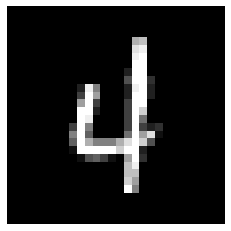

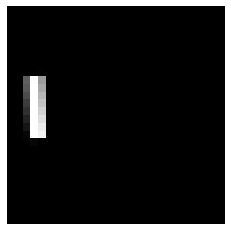

Loss: 0.0015666937212195922
Iteration: 15760, Score: 0.06892645696853286
[60, 69, 130, 49, 152, 158, 26, 122, 70, 45, 33, 31, 28, 27, 0]


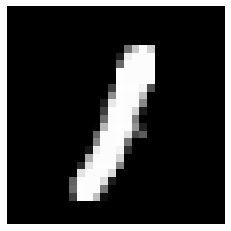

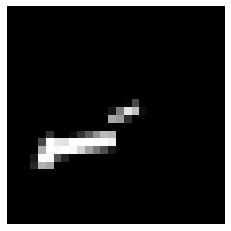

Loss: 0.0013514126969372121
Iteration: 15800, Score: 0.0664343356732279
[69, 34, 136, 135, 206, 159, 17, 90, 55, 28, 18, 19, 22, 12, 0]


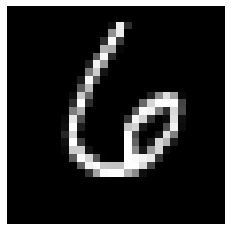

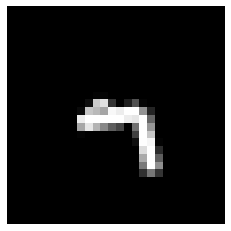

Loss: 0.0017015668067604007
Iteration: 15840, Score: 0.05264854369126261
[55, 103, 92, 143, 227, 71, 70, 78, 49, 24, 15, 35, 19, 19, 0]


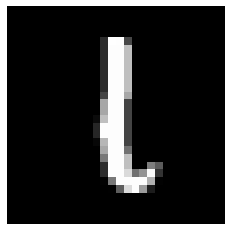

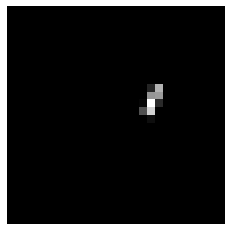

Loss: 0.0017351687090833628
Iteration: 15880, Score: 0.08575357684493065
[58, 217, 125, 68, 61, 43, 128, 111, 44, 48, 25, 39, 22, 11, 0]


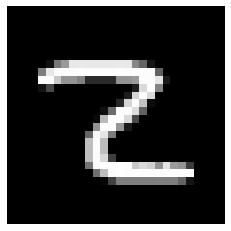

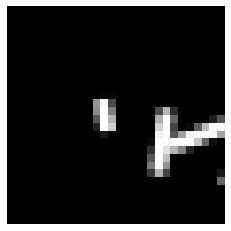

Loss: 0.0017026442702940887
Iteration: 15920, Score: 0.050968595203943555
[67, 176, 95, 99, 69, 109, 142, 64, 38, 77, 16, 22, 13, 13, 0]


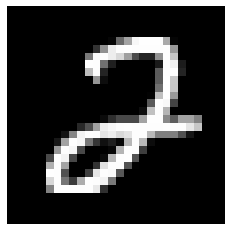

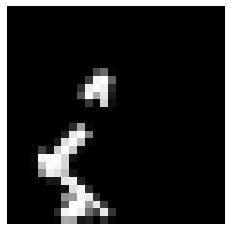

Loss: 0.001429138372577451
Iteration: 15960, Score: 0.05391156510863221
[41, 145, 100, 115, 151, 141, 120, 52, 27, 23, 23, 26, 14, 22, 0]


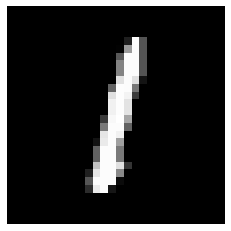

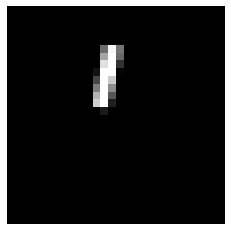

Loss: 0.001764136887162118
Iteration: 16000, Score: 0.059411320057581186
[106, 127, 98, 69, 117, 104, 121, 62, 64, 26, 27, 41, 19, 19, 0]


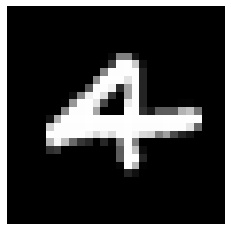

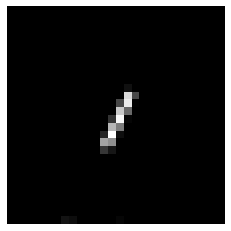

Test score: 0.0
Loss: 0.00153334079979364
Iteration: 16040, Score: 0.07542076584883034
[75, 100, 177, 70, 86, 155, 109, 79, 45, 26, 13, 24, 20, 21, 0]


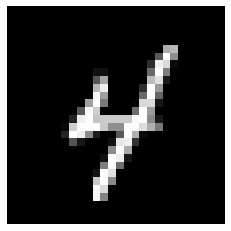

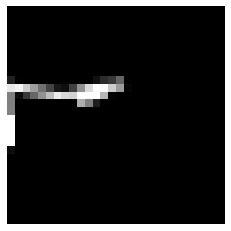

Loss: 0.0016417913766224618
Iteration: 16080, Score: 0.10104079731961246
[30, 47, 197, 116, 129, 263, 46, 22, 42, 40, 21, 11, 16, 20, 0]


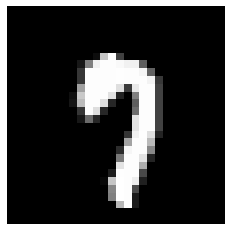

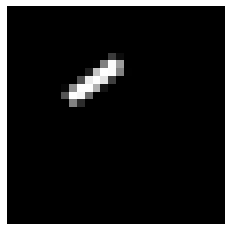

Loss: 0.001256709544070745
Iteration: 16120, Score: 0.05310878357477485
[59, 107, 125, 115, 90, 187, 119, 69, 38, 23, 14, 26, 11, 17, 0]


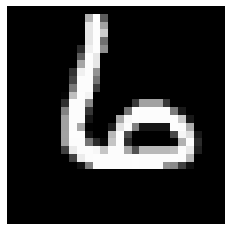

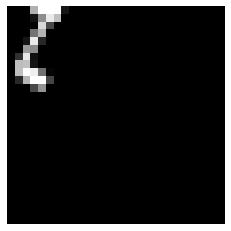

Loss: 0.0012697233223510564
Iteration: 16160, Score: 0.06174192431109258
[59, 82, 78, 146, 153, 61, 85, 108, 109, 39, 21, 18, 26, 15, 0]


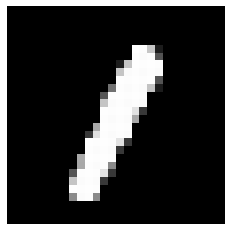

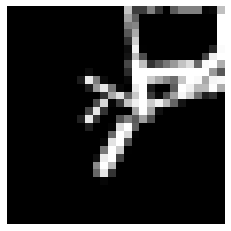

Loss: 0.0011546406437427101
Iteration: 16200, Score: 0.04919111090195657
[102, 52, 95, 69, 118, 32, 64, 220, 97, 26, 38, 38, 23, 26, 0]


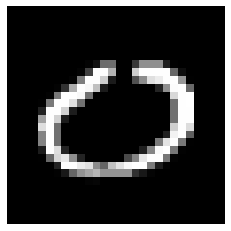

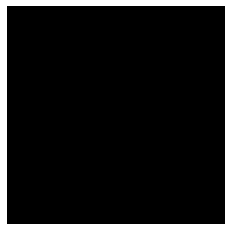

Loss: 0.0014126198037199653
Iteration: 16240, Score: 0.06888729693088681
[79, 82, 107, 91, 156, 45, 98, 107, 74, 85, 23, 10, 19, 24, 0]


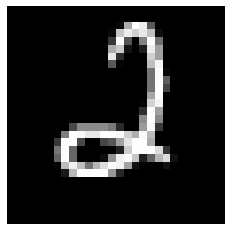

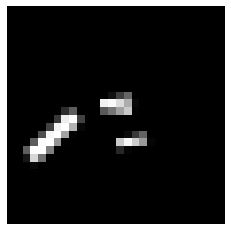

Loss: 0.0010467273315805526
Iteration: 16280, Score: 0.07963957932591438
[50, 189, 72, 52, 87, 110, 85, 114, 70, 76, 24, 22, 22, 27, 0]


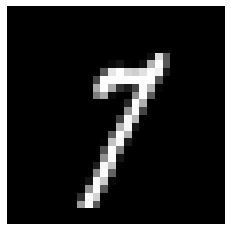

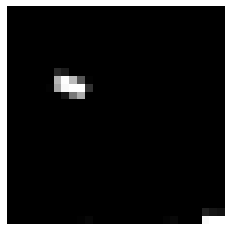

Loss: 0.001486118622041819
Iteration: 16320, Score: 0.07745098005188629
[48, 170, 45, 92, 78, 73, 125, 121, 91, 52, 21, 32, 27, 25, 0]


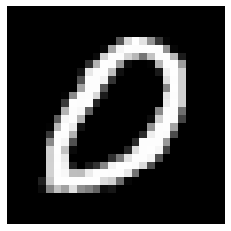

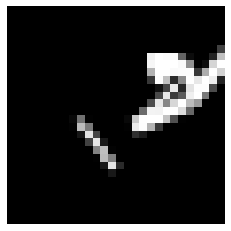

Loss: 0.0012315422150437653
Iteration: 16360, Score: 0.04596703929733484
[70, 170, 89, 68, 46, 80, 161, 138, 21, 65, 25, 32, 12, 23, 0]


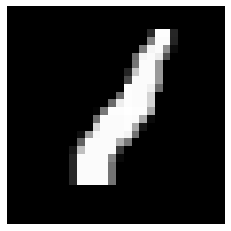

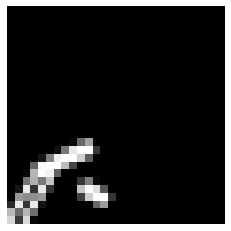

Loss: 0.001364721936720853
Iteration: 16400, Score: 0.06153523490624503
[118, 75, 71, 54, 37, 51, 142, 86, 185, 88, 22, 23, 23, 25, 0]


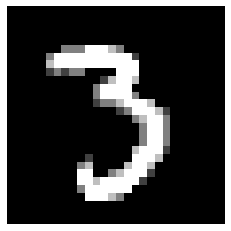

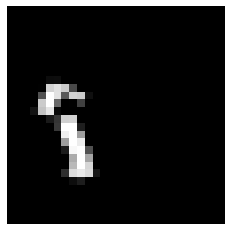

Test score: 0.0
Loss: 0.001206444728540521
Iteration: 16440, Score: 0.059406889491714535
[75, 86, 54, 106, 139, 34, 86, 122, 144, 71, 18, 23, 17, 25, 0]


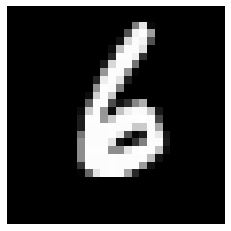

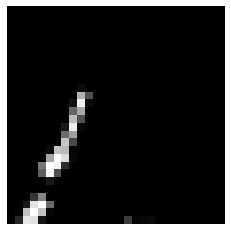

Loss: 0.0014899696585761514
Iteration: 16480, Score: 0.05145337434066459
[45, 172, 40, 110, 121, 39, 111, 137, 89, 40, 14, 28, 23, 31, 0]


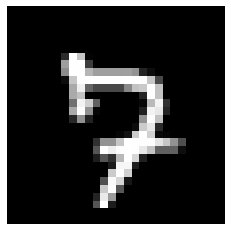

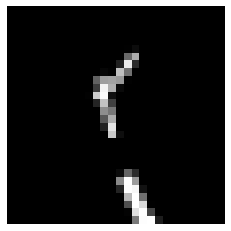

Loss: 0.00150519444283947
Iteration: 16520, Score: 0.053958735445776264
[53, 135, 77, 92, 90, 65, 101, 172, 70, 75, 14, 21, 15, 20, 0]


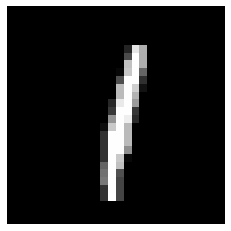

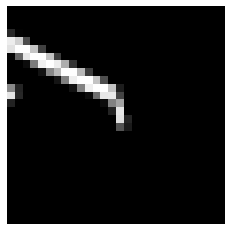

Loss: 0.0013752321896090876
Iteration: 16560, Score: 0.056697746606077994
[80, 33, 67, 96, 134, 47, 46, 87, 168, 99, 31, 44, 35, 33, 0]


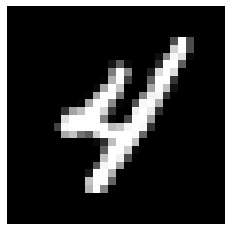

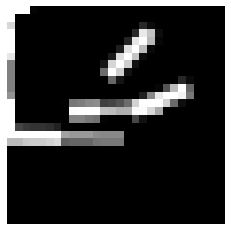

Loss: 0.001724120866450382
Iteration: 16600, Score: 0.07568353678568382
[68, 29, 198, 104, 80, 131, 25, 40, 181, 36, 16, 41, 24, 27, 0]


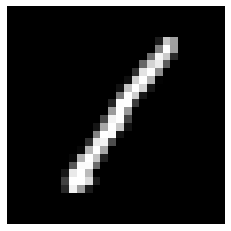

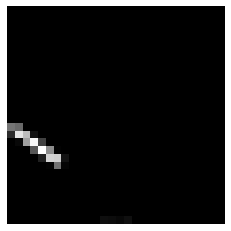

Loss: 0.0014070996446216924
Iteration: 16640, Score: 0.05499627672880888
[33, 125, 173, 96, 94, 131, 122, 78, 57, 44, 16, 11, 9, 11, 0]


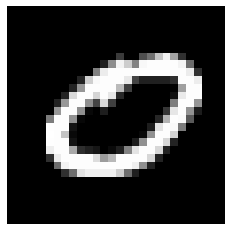

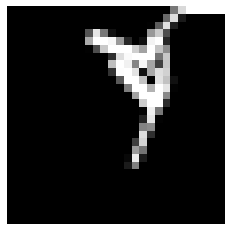

Loss: 0.001495219037646167
Iteration: 16680, Score: 0.04579665178252617
[50, 202, 30, 112, 98, 37, 150, 102, 57, 56, 27, 24, 16, 39, 0]


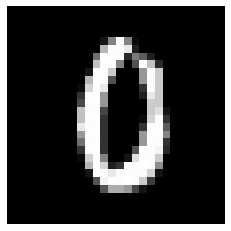

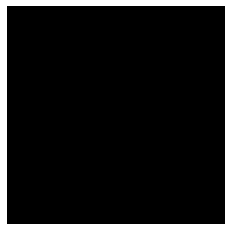

Loss: 0.0013961793397411295
Iteration: 16720, Score: 0.07828843175293876
[54, 176, 27, 55, 45, 62, 107, 105, 186, 53, 33, 22, 27, 48, 0]


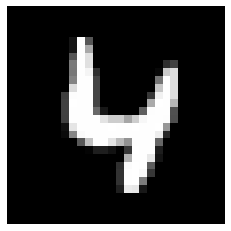

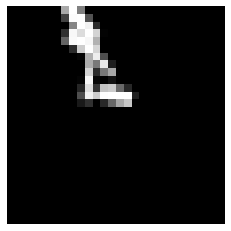

Loss: 0.0019068200152090337
Iteration: 16760, Score: 0.06836436178222353
[51, 110, 112, 34, 37, 76, 144, 75, 160, 42, 32, 27, 26, 74, 0]


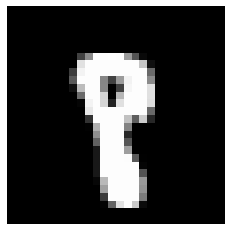

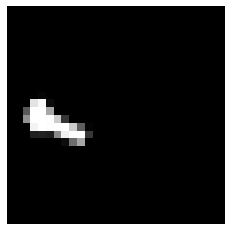

Loss: 0.0014786541903719403
Iteration: 16800, Score: 0.06156842201109976
[56, 69, 197, 85, 79, 183, 63, 74, 72, 29, 23, 18, 25, 27, 0]


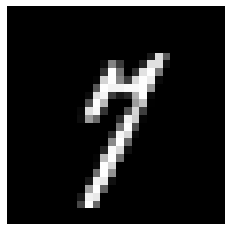

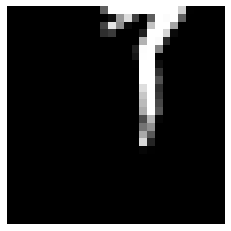

Test score: 0.0
Loss: 0.0015500103794375817
Iteration: 16840, Score: 0.06379846158856524
[21, 32, 134, 213, 236, 105, 12, 63, 60, 41, 16, 24, 21, 22, 0]


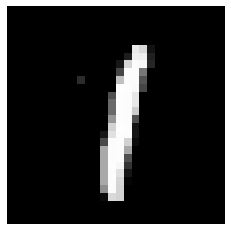

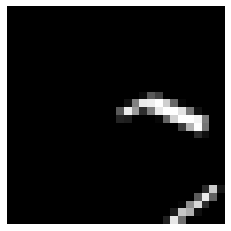

Loss: 0.0012687244377964425
Iteration: 16880, Score: 0.07036963059648407
[66, 104, 59, 137, 110, 129, 36, 119, 117, 43, 16, 22, 22, 20, 0]


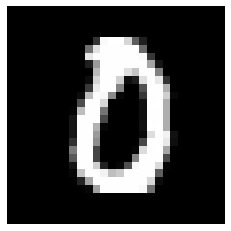

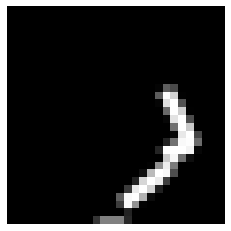

Loss: 0.0015519099195746085
Iteration: 16920, Score: 0.06212430763896555
[55, 42, 56, 129, 104, 33, 73, 133, 229, 37, 30, 28, 30, 21, 0]


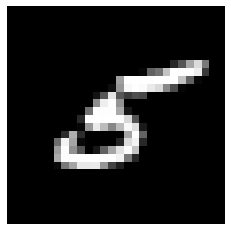

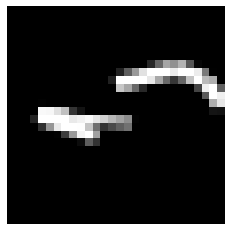

Loss: 0.0013818188868348644
Iteration: 16960, Score: 0.06196159737603738
[60, 33, 21, 211, 229, 46, 35, 112, 125, 28, 32, 27, 22, 19, 0]


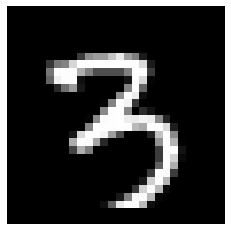

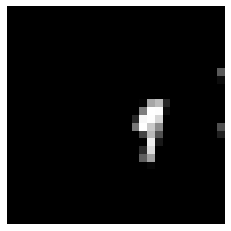

Loss: 0.0013251788519478675
Iteration: 17000, Score: 0.086431369493017
[33, 56, 105, 194, 339, 27, 57, 71, 28, 16, 14, 13, 19, 28, 0]


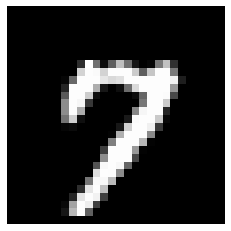

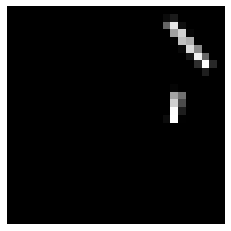

Loss: 0.0012305417785139492
Iteration: 17040, Score: 0.04054513316787779
[38, 106, 94, 116, 163, 78, 95, 98, 51, 48, 20, 38, 30, 25, 0]


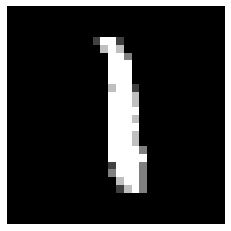

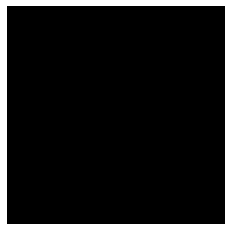

Loss: 0.0013398323284212073
Iteration: 17080, Score: 0.04455819926550612
[70, 86, 105, 89, 81, 173, 82, 57, 142, 19, 23, 31, 17, 25, 0]


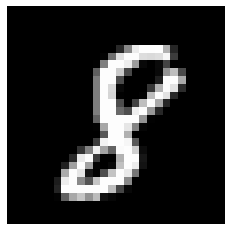

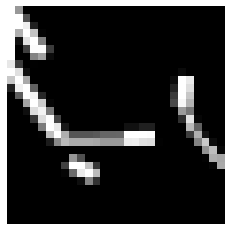

Loss: 0.001291725829657931
Iteration: 17120, Score: 0.055534619967453194
[89, 48, 97, 82, 90, 136, 45, 41, 201, 27, 29, 29, 29, 57, 0]


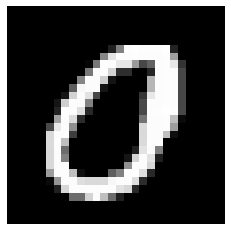

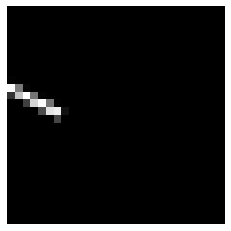

Loss: 0.0012451587991734036
Iteration: 17160, Score: 0.06893060562573372
[69, 55, 187, 57, 127, 109, 144, 37, 78, 56, 10, 28, 23, 20, 0]


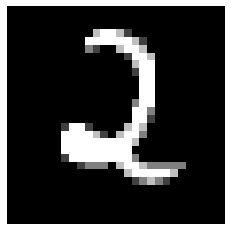

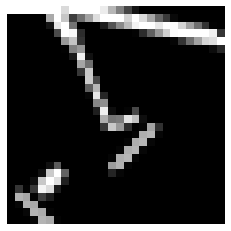

Loss: 0.0011662213833558003
Iteration: 17200, Score: 0.05916091912891717
[14, 35, 225, 57, 177, 96, 115, 46, 58, 81, 29, 24, 26, 17, 0]


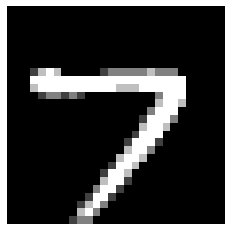

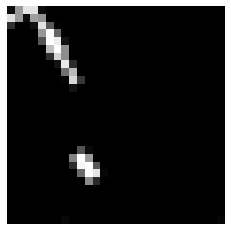

Test score: 0.0
Loss: 0.0010975026372954367
Iteration: 17240, Score: 0.051178023487329485
[39, 148, 126, 49, 106, 95, 170, 76, 71, 40, 25, 19, 15, 21, 0]


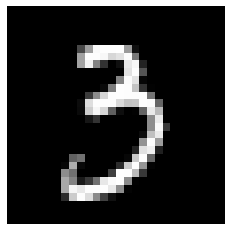

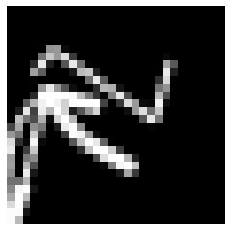

Loss: 0.0014546462488775394
Iteration: 17280, Score: 0.06883938183635473
[65, 118, 57, 105, 67, 51, 123, 57, 225, 44, 32, 19, 22, 15, 0]


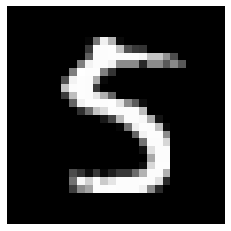

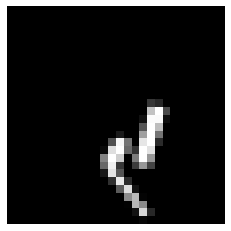

Loss: 0.0012098241459525306
Iteration: 17320, Score: 0.09002144665364174
[96, 92, 92, 150, 51, 76, 132, 39, 88, 61, 18, 51, 28, 26, 0]


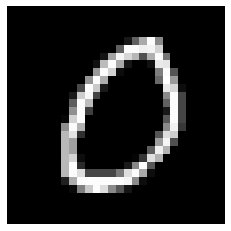

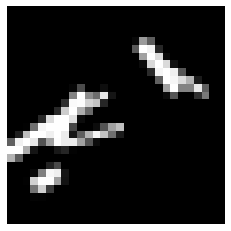

Loss: 0.0013355398535257188
Iteration: 17360, Score: 0.034052098037616815
[66, 52, 98, 81, 110, 141, 72, 96, 88, 71, 30, 46, 22, 27, 0]


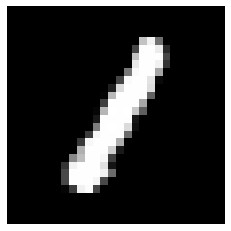

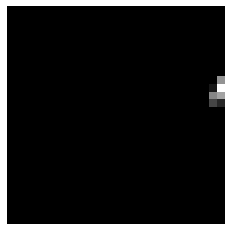

Loss: 0.0012624511749380954
Iteration: 17400, Score: 0.05744405351579189
[34, 85, 82, 113, 192, 69, 117, 81, 64, 49, 38, 27, 25, 24, 0]


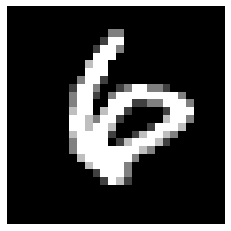

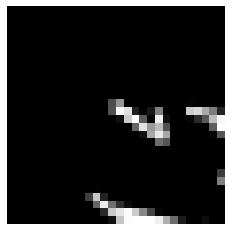

Loss: 0.001199727249563038
Iteration: 17440, Score: 0.0705365264446009
[116, 159, 45, 79, 161, 26, 53, 114, 57, 76, 25, 29, 33, 27, 0]


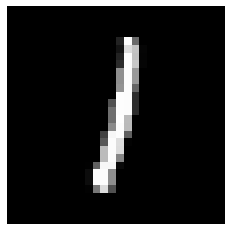

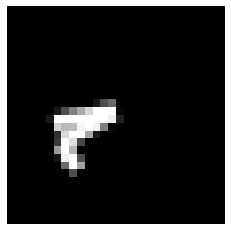

Loss: 0.001561528201210721
Iteration: 17480, Score: 0.0516959214550443
[91, 97, 78, 205, 161, 32, 70, 83, 49, 55, 17, 19, 27, 16, 0]


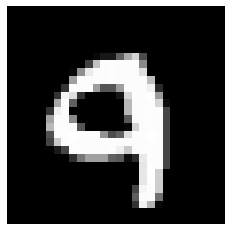

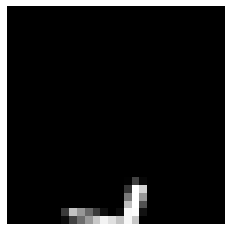

Loss: 0.0012629553857933767
Iteration: 17520, Score: 0.059244168145
[75, 85, 71, 199, 172, 108, 52, 57, 45, 58, 20, 15, 25, 18, 0]


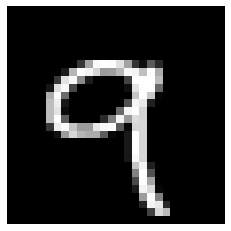

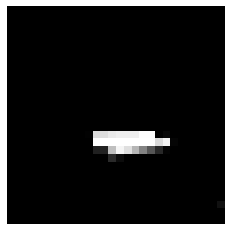

Loss: 0.0012368576259119768
Iteration: 17560, Score: 0.04266640519269276
[87, 206, 92, 106, 113, 79, 26, 87, 39, 38, 37, 41, 25, 24, 0]


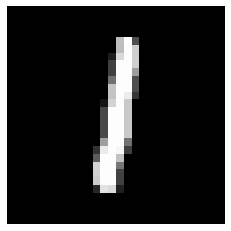

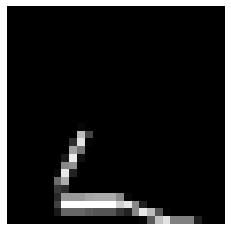

Loss: 0.0013918646786732513
Iteration: 17600, Score: 0.05206125247484307
[57, 126, 119, 149, 198, 99, 34, 34, 29, 70, 17, 23, 18, 27, 0]


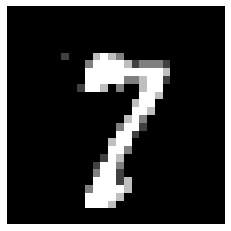

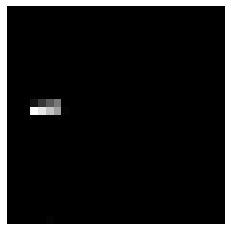

Test score: 0.0
Loss: 0.0010317994403341408
Iteration: 17640, Score: 0.03949719731480582
[139, 127, 117, 83, 119, 77, 93, 67, 51, 37, 29, 19, 21, 21, 0]


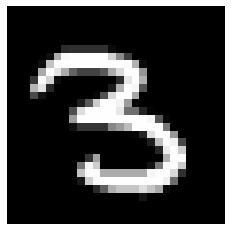

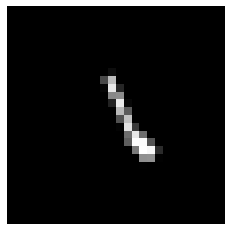

Loss: 0.0014018757918537132
Iteration: 17680, Score: 0.05059859813775529
[52, 107, 175, 118, 114, 184, 77, 61, 31, 35, 9, 12, 16, 9, 0]


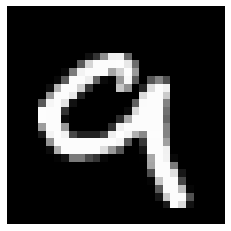

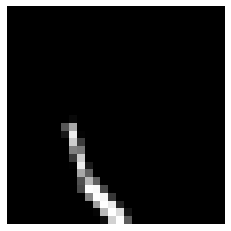

Loss: 0.0014071433787538347
Iteration: 17720, Score: 0.047340405310736966
[35, 147, 94, 177, 116, 89, 86, 49, 31, 81, 27, 21, 24, 23, 0]


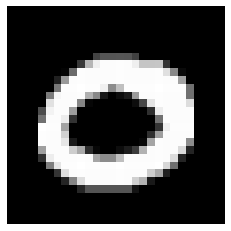

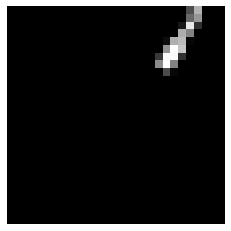

Loss: 0.001584329175841189
Iteration: 17760, Score: 0.05210866499785334
[82, 58, 109, 127, 136, 155, 69, 46, 28, 68, 54, 25, 23, 20, 0]


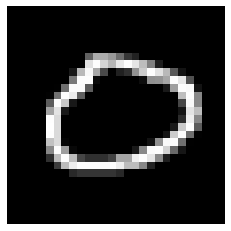

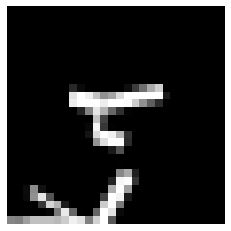

Loss: 0.001366055719930154
Iteration: 17800, Score: 0.06010433135507628
[94, 21, 142, 179, 186, 213, 25, 25, 20, 46, 13, 10, 13, 13, 0]


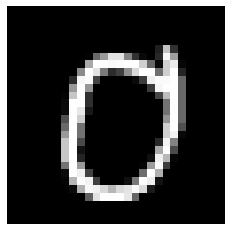

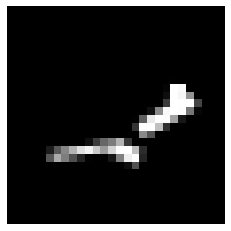

Loss: 0.0013839760595746944
Iteration: 17840, Score: 0.06848927535954864
[48, 188, 143, 61, 62, 219, 142, 17, 20, 30, 13, 17, 19, 21, 0]


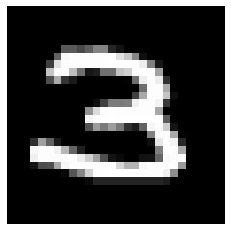

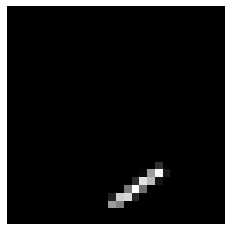

Loss: 0.0011094719834585452
Iteration: 17880, Score: 0.07961860206141137
[28, 203, 67, 112, 84, 109, 163, 36, 37, 86, 16, 24, 22, 13, 0]


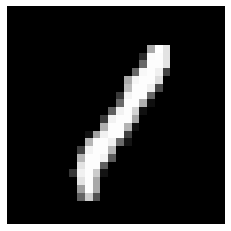

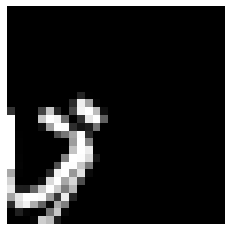

Loss: 0.001191129854950576
Iteration: 17920, Score: 0.06619702053104994
[56, 139, 116, 123, 56, 120, 153, 48, 25, 64, 22, 32, 28, 18, 0]


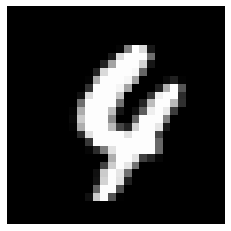

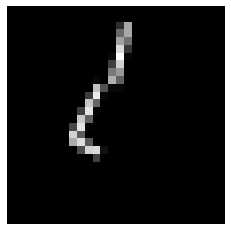

Loss: 0.0010110443115020444
Iteration: 17960, Score: 0.05401140585541725
[46, 43, 215, 71, 40, 305, 55, 44, 34, 60, 17, 20, 33, 17, 0]


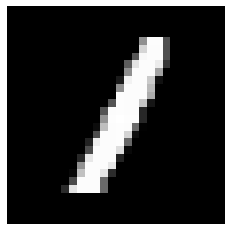

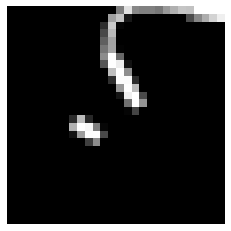

Loss: 0.0012559256079212142
Iteration: 18000, Score: 0.038178145888261496
[62, 36, 87, 105, 59, 310, 55, 30, 67, 88, 22, 26, 24, 29, 0]


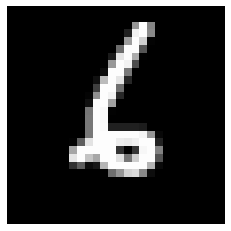

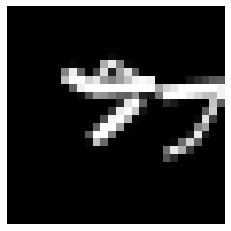

Test score: 0.0
Loss: 0.0010520244348158037
Iteration: 18040, Score: 0.05386405452853068
[36, 54, 190, 165, 51, 198, 76, 41, 38, 40, 21, 23, 43, 24, 0]


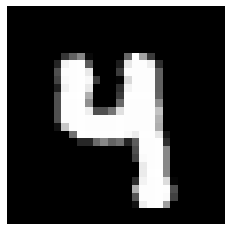

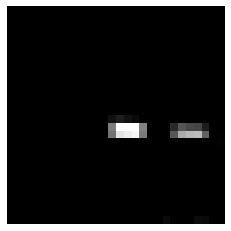

Loss: 0.0013839640319869416
Iteration: 18080, Score: 0.060001319597853583
[32, 45, 205, 142, 70, 239, 59, 39, 37, 62, 17, 25, 18, 10, 0]


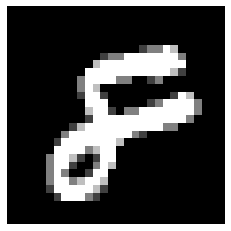

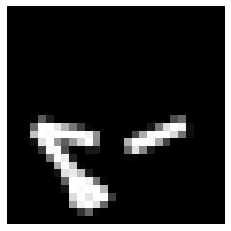

Loss: 0.0013070947161556998
Iteration: 18120, Score: 0.05317940030479804
[22, 75, 220, 86, 72, 282, 77, 24, 57, 24, 29, 8, 9, 15, 0]


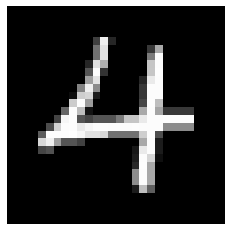

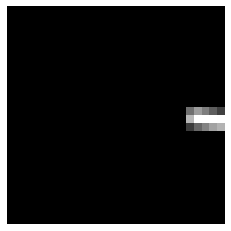

Loss: 0.0012150988661076582
Iteration: 18160, Score: 0.035272309533320355
[30, 148, 271, 68, 23, 234, 80, 25, 26, 22, 16, 13, 24, 20, 0]


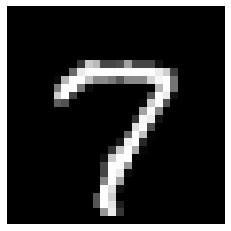

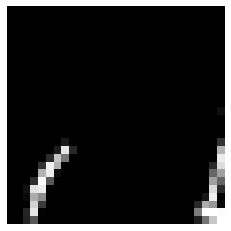

Loss: 0.0012164716595415308
Iteration: 18200, Score: 0.0484983781017363
[31, 95, 145, 91, 15, 233, 67, 147, 33, 45, 26, 16, 29, 27, 0]


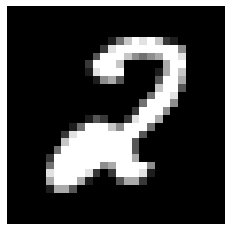

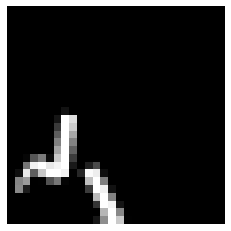

Loss: 0.0008798688847076696
Iteration: 18240, Score: 0.058790078424208324
[25, 32, 174, 207, 85, 234, 25, 61, 39, 37, 17, 25, 22, 17, 0]


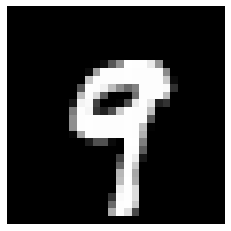

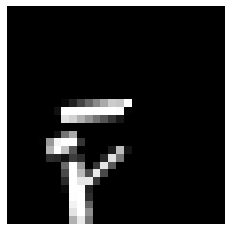

Loss: 0.0013348837540877643
Iteration: 18280, Score: 0.05871497918851674
[22, 15, 159, 147, 103, 133, 37, 45, 135, 64, 41, 32, 45, 22, 0]


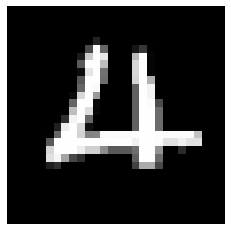

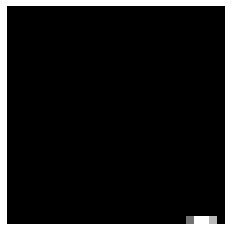

Loss: 0.0012422505703617713
Iteration: 18320, Score: 0.06371192936412991
[23, 128, 154, 55, 53, 141, 143, 69, 65, 75, 22, 13, 41, 18, 0]


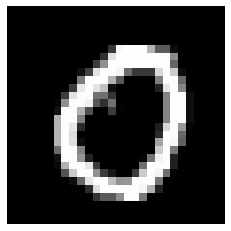

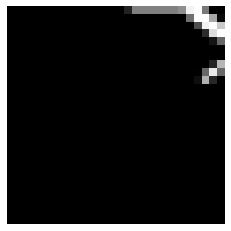

Loss: 0.000990413494693977
Iteration: 18360, Score: 0.03917773136356846
[38, 98, 121, 94, 83, 134, 100, 184, 26, 48, 19, 17, 23, 15, 0]


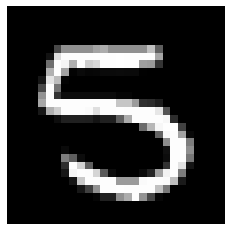

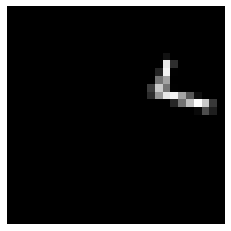

Loss: 0.0009981496922840112
Iteration: 18400, Score: 0.053218707815045486
[16, 45, 285, 32, 19, 267, 67, 133, 14, 56, 18, 17, 15, 16, 0]


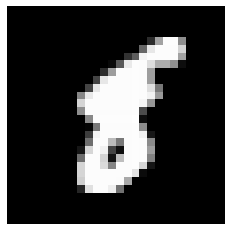

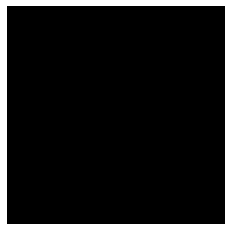

Test score: 0.0
Loss: 0.0014158358662452132
Iteration: 18440, Score: 0.07105524148512629
[32, 78, 98, 118, 123, 130, 94, 70, 118, 27, 31, 11, 33, 37, 0]


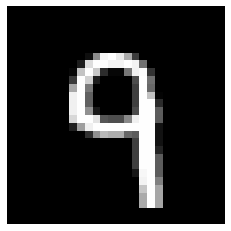

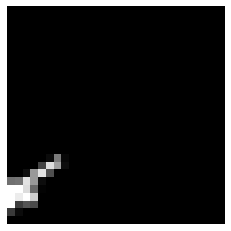

Loss: 0.001227703994704485
Iteration: 18480, Score: 0.06005292401032057
[29, 77, 121, 77, 96, 87, 35, 91, 165, 98, 25, 28, 37, 34, 0]


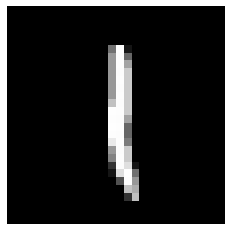

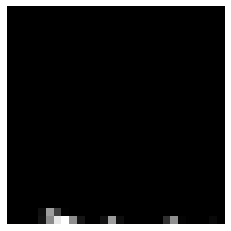

Loss: 0.0011268179701237199
Iteration: 18520, Score: 0.04482227567862719
[44, 88, 223, 77, 81, 183, 65, 73, 38, 34, 16, 50, 13, 15, 0]


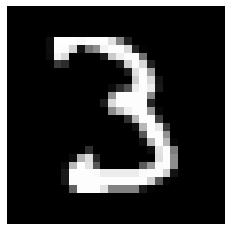

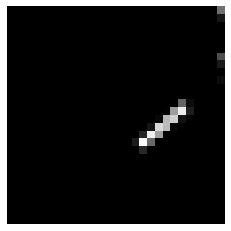

Loss: 0.0012204272515435885
Iteration: 18560, Score: 0.04051582403667271
[42, 95, 163, 116, 117, 132, 41, 110, 50, 60, 21, 24, 15, 14, 0]


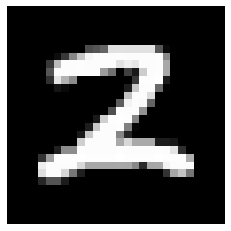

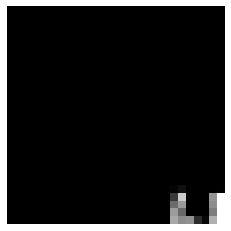

Loss: 0.0009235824433158711
Iteration: 18600, Score: 0.05081600354984402
[79, 159, 60, 48, 85, 185, 93, 88, 80, 38, 17, 22, 27, 19, 0]


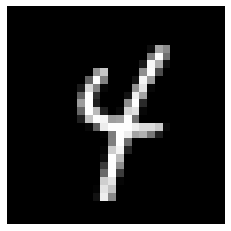

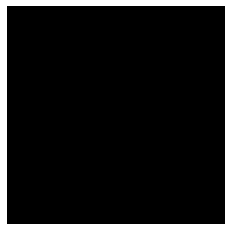

Loss: 0.0010919143132049323
Iteration: 18640, Score: 0.04588692355388776
[25, 138, 108, 75, 112, 99, 51, 81, 135, 61, 28, 17, 47, 23, 0]


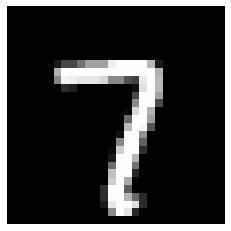

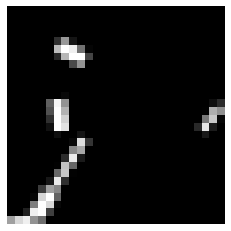

Loss: 0.0010502958041014284
Iteration: 18680, Score: 0.05889264571379316
[15, 45, 251, 66, 92, 187, 19, 76, 55, 90, 18, 54, 15, 17, 0]


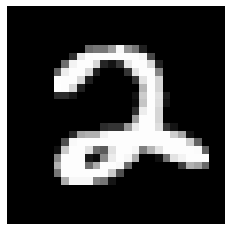

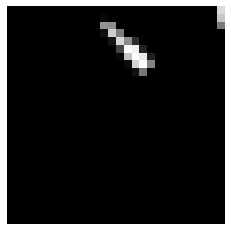

Loss: 0.000907327209958733
Iteration: 18720, Score: 0.04594728502013458
[47, 24, 259, 61, 82, 105, 25, 157, 45, 69, 24, 47, 41, 14, 0]


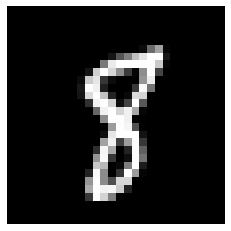

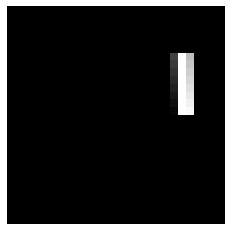

Loss: 0.0010648373171086196
Iteration: 18760, Score: 0.053035604452714324
[72, 125, 110, 43, 64, 90, 98, 157, 55, 72, 34, 16, 25, 39, 0]


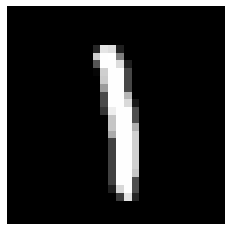

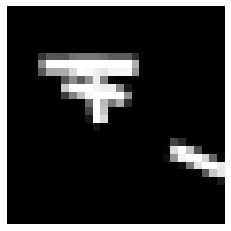

Loss: 0.0009650812046250722
Iteration: 18800, Score: 0.04683553446177393
[72, 31, 63, 56, 58, 195, 58, 64, 252, 33, 25, 32, 28, 33, 0]


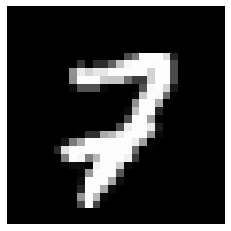

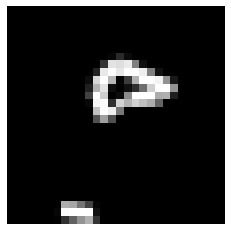

Test score: 0.0
Loss: 0.0010228152855331425
Iteration: 18840, Score: 0.06512317160749809
[25, 204, 71, 42, 59, 212, 108, 48, 94, 39, 23, 26, 21, 28, 0]


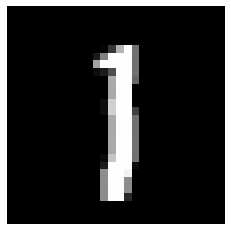

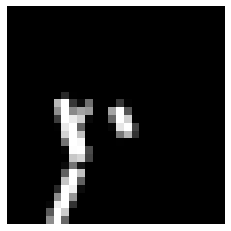

Loss: 0.001087187345594661
Iteration: 18880, Score: 0.05814490099390969
[36, 29, 243, 121, 130, 182, 35, 46, 34, 49, 23, 30, 21, 21, 0]


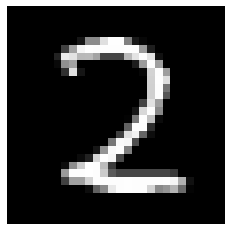

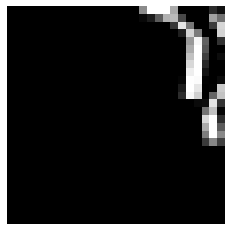

Loss: 0.0008437001496747882
Iteration: 18920, Score: 0.053665161227079795
[34, 30, 137, 38, 80, 194, 145, 90, 53, 80, 30, 23, 23, 43, 0]


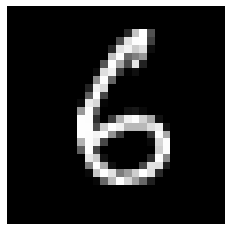

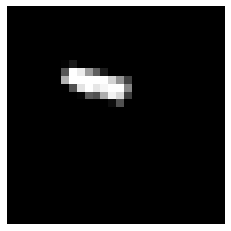

Loss: 0.0010099090707918143
Iteration: 18960, Score: 0.0651274158898741
[55, 110, 74, 53, 73, 74, 45, 140, 157, 46, 37, 37, 32, 67, 0]


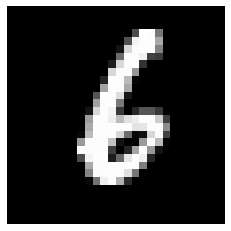

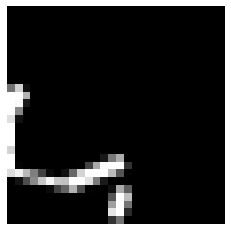

Loss: 0.0010190949834676442
Iteration: 19000, Score: 0.07314849444816354
[31, 37, 88, 235, 121, 96, 23, 62, 178, 27, 26, 31, 19, 26, 0]


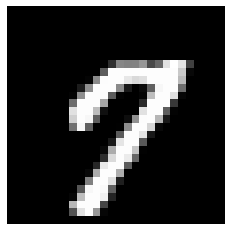

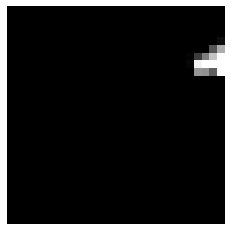

Loss: 0.0010583534517158587
Iteration: 19040, Score: 0.07236761395633219
[16, 83, 185, 85, 124, 231, 79, 53, 40, 24, 17, 17, 18, 28, 0]


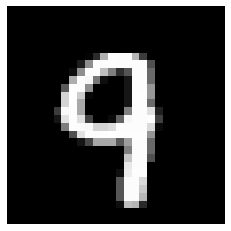

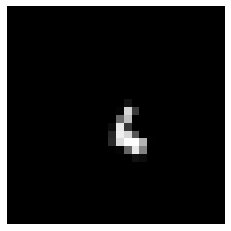

Loss: 0.0009536933839231274
Iteration: 19080, Score: 0.05630912781425286
[21, 44, 53, 136, 95, 160, 100, 150, 63, 84, 21, 32, 22, 19, 0]


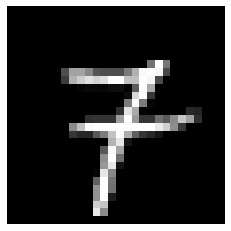

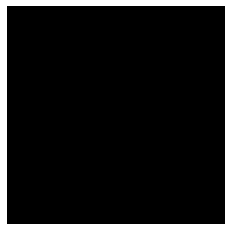

Loss: 0.0008885439365639913
Iteration: 19120, Score: 0.045416803439147765
[47, 150, 75, 66, 56, 53, 74, 162, 146, 35, 30, 46, 40, 20, 0]


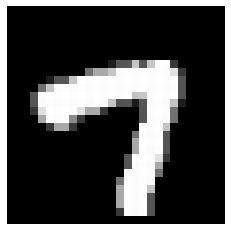

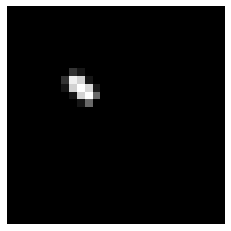

Loss: 0.0010967396436789632
Iteration: 19160, Score: 0.04835530945245409
[68, 133, 120, 98, 49, 98, 124, 115, 66, 18, 19, 46, 26, 20, 0]


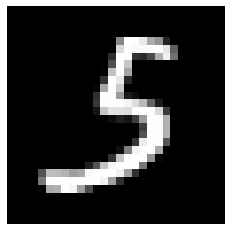

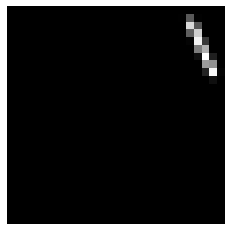

Loss: 0.0009250016205808869
Iteration: 19200, Score: 0.05824986114632339
[38, 55, 88, 314, 131, 55, 70, 56, 32, 17, 25, 71, 17, 31, 0]


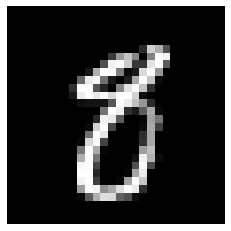

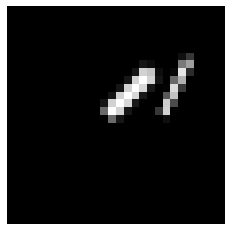

Test score: 0.0
Loss: 0.0011473011541347567
Iteration: 19240, Score: 0.04110288414386741
[25, 55, 28, 227, 202, 18, 109, 100, 42, 70, 31, 29, 39, 25, 0]


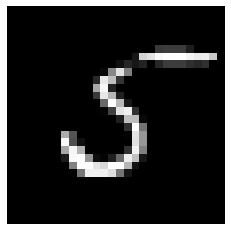

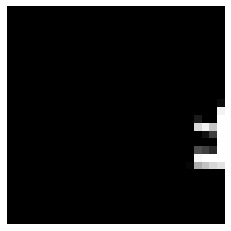

Loss: 0.0008765661427864242
Iteration: 19280, Score: 0.03775505167059601
[25, 33, 119, 101, 104, 158, 73, 146, 76, 51, 31, 30, 29, 24, 0]


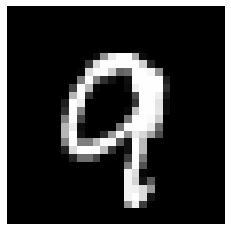

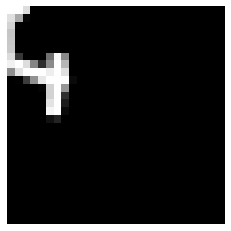

Loss: 0.0012850383501435535
Iteration: 19320, Score: 0.0294983805725351
[15, 114, 77, 114, 158, 96, 67, 162, 59, 19, 25, 41, 39, 14, 0]


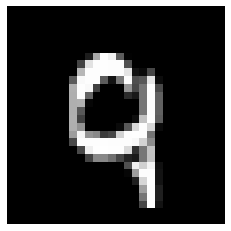

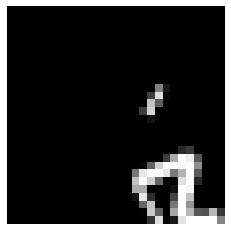

Loss: 0.0010836460520271835
Iteration: 19360, Score: 0.07073645467459574
[30, 68, 121, 138, 212, 87, 67, 90, 19, 79, 15, 34, 16, 24, 0]


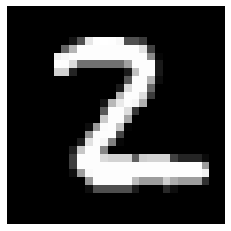

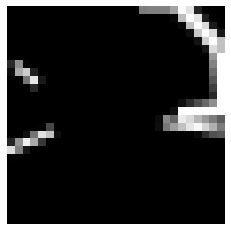

Loss: 0.000945120564437761
Iteration: 19400, Score: 0.05379193872303586
[39, 34, 57, 111, 193, 127, 120, 66, 50, 63, 47, 36, 20, 37, 0]


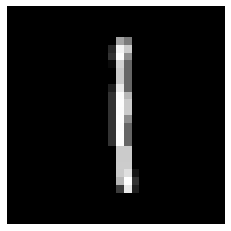

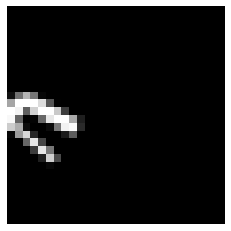

Loss: 0.0011149648223351114
Iteration: 19440, Score: 0.03874406442558393
[14, 141, 98, 88, 84, 115, 185, 138, 52, 39, 12, 6, 14, 14, 0]


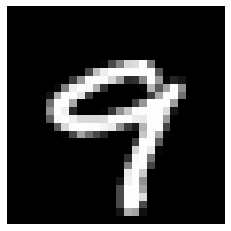

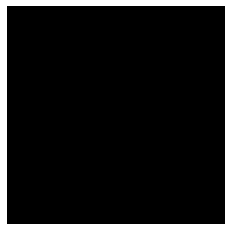

Loss: 0.000979935985759697
Iteration: 19480, Score: 0.04467379582091235
[37, 123, 111, 52, 107, 70, 93, 236, 44, 33, 27, 27, 19, 21, 0]


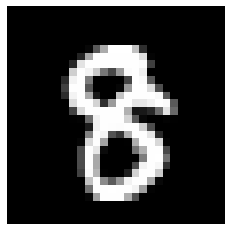

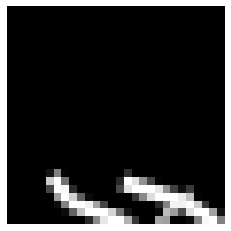

Loss: 0.0008385705634230242
Iteration: 19520, Score: 0.05056711381790228
[27, 64, 102, 94, 218, 95, 122, 103, 34, 32, 31, 23, 27, 28, 0]


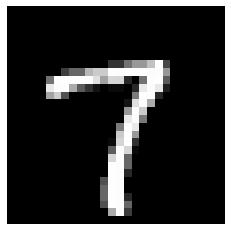

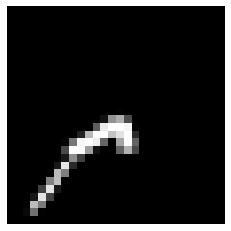

Loss: 0.0009214390824530713
Iteration: 19560, Score: 0.05294819291937165
[30, 36, 210, 119, 175, 224, 22, 58, 26, 13, 20, 29, 16, 22, 0]


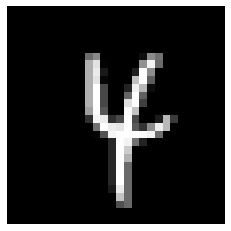

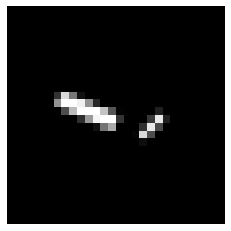

Loss: 0.0009827912048828611
Iteration: 19600, Score: 0.08884046101151036
[36, 25, 179, 105, 81, 123, 90, 46, 51, 144, 31, 34, 28, 27, 0]


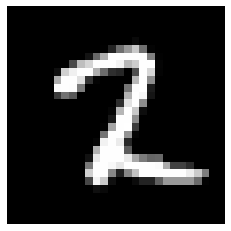

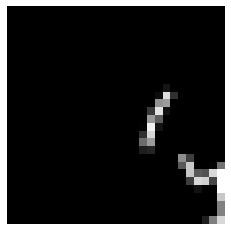

Test score: 0.0
Loss: 0.0007719803364378931
Iteration: 19640, Score: 0.06641395610198378
[28, 66, 115, 200, 194, 47, 59, 94, 65, 62, 10, 21, 18, 21, 0]


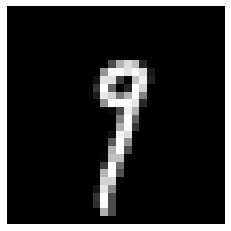

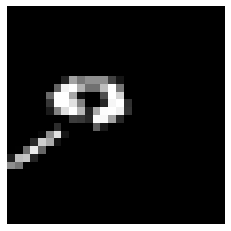

Loss: 0.0009731778921505815
Iteration: 19680, Score: 0.062004115567251585
[23, 121, 158, 114, 143, 71, 126, 101, 26, 30, 25, 21, 16, 25, 0]


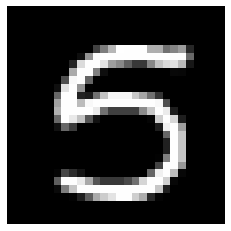

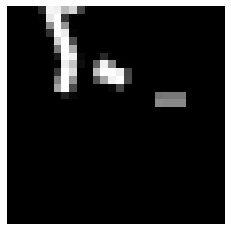

Loss: 0.000884711971591739
Iteration: 19720, Score: 0.08065091398730873
[42, 41, 141, 173, 186, 73, 86, 52, 16, 51, 23, 42, 22, 52, 0]


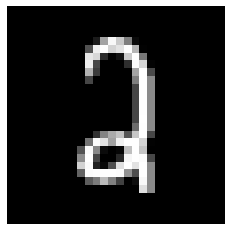

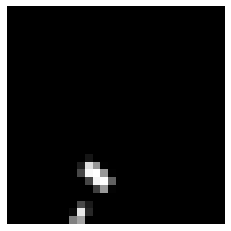

Loss: 0.000886124187058569
Iteration: 19760, Score: 0.043787395209204986
[57, 32, 125, 138, 165, 103, 66, 71, 46, 92, 28, 35, 22, 20, 0]


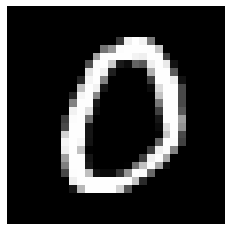

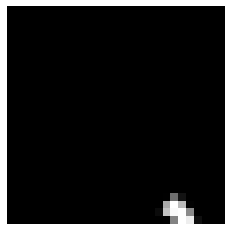

Loss: 0.0008963977056013298
Iteration: 19800, Score: 0.05616848878376185
[39, 33, 150, 113, 83, 102, 132, 62, 143, 40, 25, 31, 17, 30, 0]


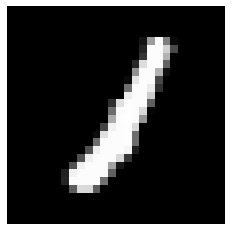

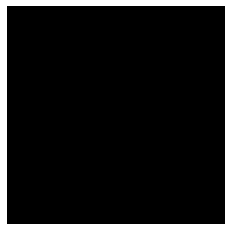

Loss: 0.0009120644971389246
Iteration: 19840, Score: 0.050016993892088066
[62, 26, 99, 97, 207, 54, 142, 116, 40, 26, 37, 44, 22, 28, 0]


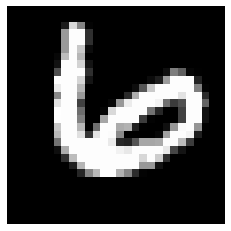

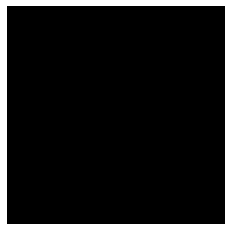

Loss: 0.0010796743296626555
Iteration: 19880, Score: 0.048018010124797
[18, 49, 122, 192, 171, 108, 48, 114, 40, 65, 29, 14, 12, 18, 0]


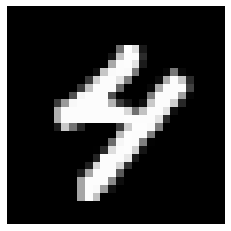

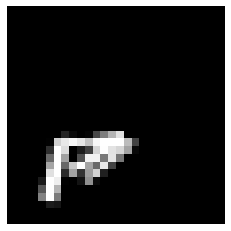

Loss: 0.0008743030144181021
Iteration: 19920, Score: 0.04290579315740615
[88, 74, 175, 149, 99, 152, 87, 46, 22, 52, 14, 21, 6, 15, 0]


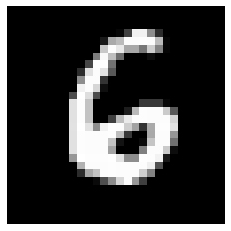

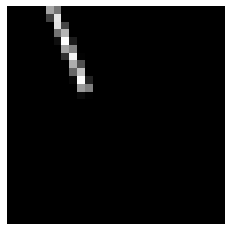

Loss: 0.0010669261085475947
Iteration: 19960, Score: 0.0630630777347833
[81, 21, 241, 91, 109, 164, 31, 45, 84, 68, 17, 19, 14, 15, 0]


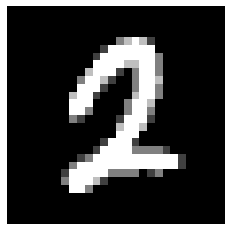

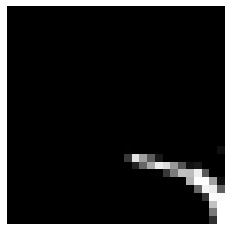

Loss: 0.0008772645735213133
Iteration: 20000, Score: 0.09291774830501529
[27, 81, 74, 208, 214, 40, 131, 35, 88, 38, 15, 16, 15, 18, 0]


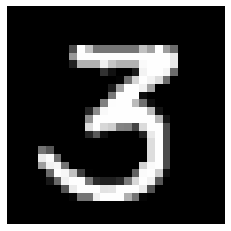

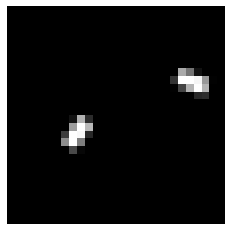

Test score: 0.0
Loss: 0.0008293178991434176
Iteration: 20040, Score: 0.06990259368997068
[20, 32, 223, 144, 90, 191, 34, 96, 70, 40, 22, 13, 16, 9, 0]


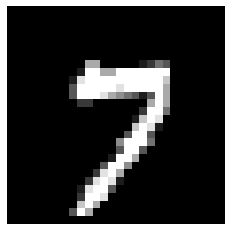

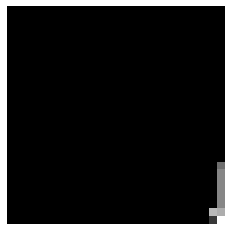

Loss: 0.0008085369243256956
Iteration: 20080, Score: 0.05401664954610168
[39, 79, 116, 163, 234, 169, 29, 22, 46, 12, 25, 34, 13, 19, 0]


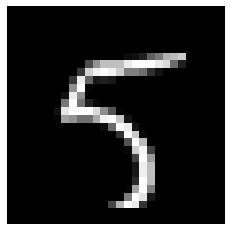

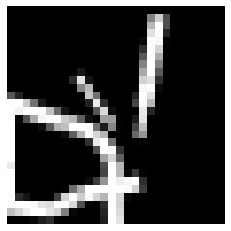

Loss: 0.0006064784112438277
Iteration: 20120, Score: 0.058147256797645264
[208, 40, 40, 94, 88, 82, 57, 79, 144, 42, 29, 43, 27, 27, 0]


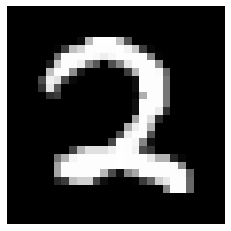

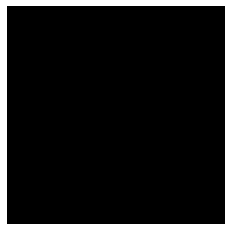

Loss: 0.0006088478040816683
Iteration: 20160, Score: 0.12208900683373217
[58, 26, 110, 160, 207, 76, 58, 50, 150, 23, 12, 35, 12, 23, 0]


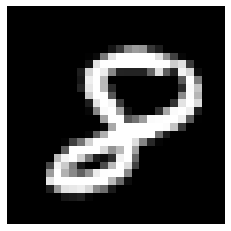

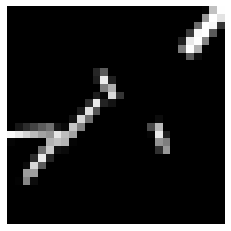

Loss: 0.0006198004604143718
Iteration: 20200, Score: 0.049679512422924746
[45, 28, 167, 176, 70, 268, 47, 27, 35, 25, 19, 46, 28, 19, 0]


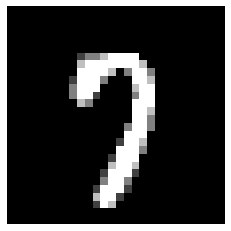

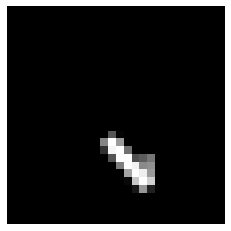

Loss: 0.0007499742385925392
Iteration: 20240, Score: 0.047880881815217435
[25, 92, 99, 141, 220, 143, 29, 42, 27, 45, 25, 36, 20, 56, 0]


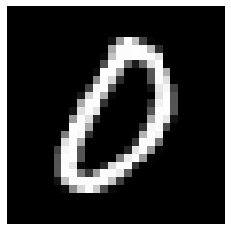

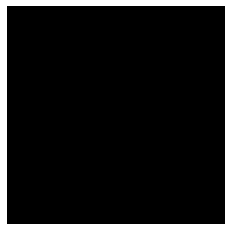

Loss: 0.0009180866219296929
Iteration: 20280, Score: 0.04542879513697699
[167, 27, 82, 136, 92, 104, 34, 92, 30, 113, 29, 42, 23, 29, 0]


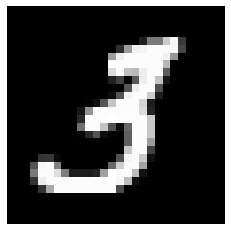

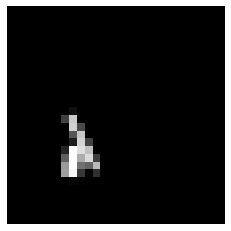

Loss: 0.000999911699588645
Iteration: 20320, Score: 0.08765013910376002
[58, 35, 73, 148, 173, 39, 116, 94, 135, 36, 27, 12, 21, 33, 0]


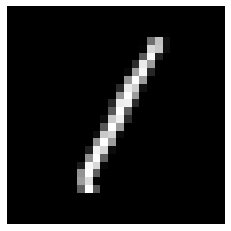

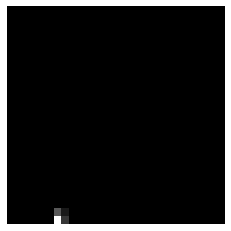

Loss: 0.000785220978100734
Iteration: 20360, Score: 0.05072974466637244
[61, 29, 170, 114, 115, 161, 64, 60, 55, 79, 11, 30, 26, 25, 0]


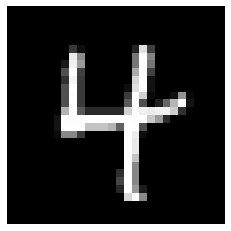

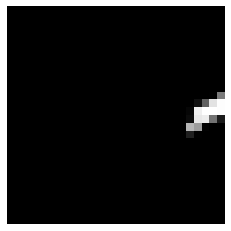

Loss: 0.0005879290000681185
Iteration: 20400, Score: 0.07824654792249201
[39, 88, 87, 131, 230, 147, 79, 24, 61, 38, 21, 14, 19, 22, 0]


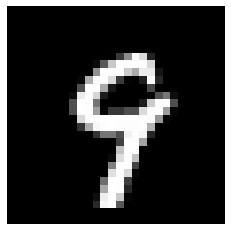

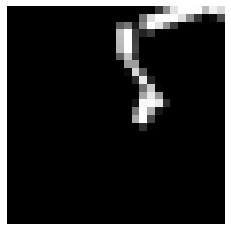

Test score: 0.0
Loss: 0.0005022403891482227
Iteration: 20440, Score: 0.09770334853488023
[171, 61, 46, 106, 113, 62, 51, 116, 107, 20, 46, 30, 40, 31, 0]


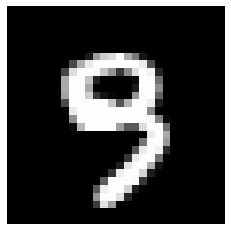

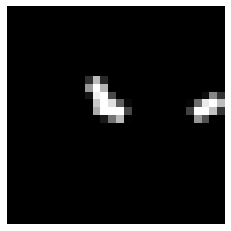

Loss: 0.0006358976204858053
Iteration: 20480, Score: 0.07737795835919678
[43, 55, 31, 161, 186, 18, 30, 228, 119, 42, 21, 22, 29, 15, 0]


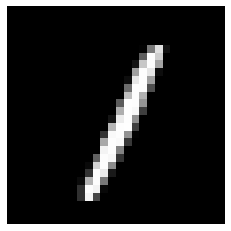

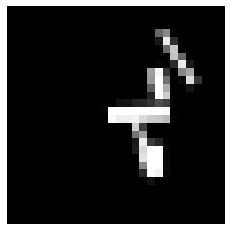

Loss: 0.0007087646188051861
Iteration: 20520, Score: 0.06888164937146941
[39, 21, 192, 40, 121, 197, 19, 106, 53, 105, 23, 26, 23, 35, 0]


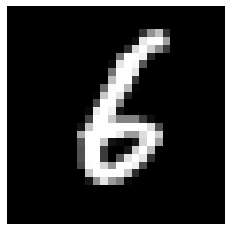

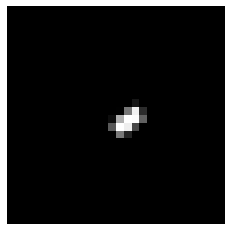

Loss: 0.0006049589364680406
Iteration: 20560, Score: 0.06432030255161227
[108, 79, 41, 88, 215, 152, 44, 44, 45, 28, 24, 36, 55, 41, 0]


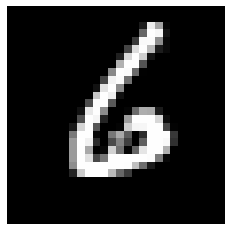

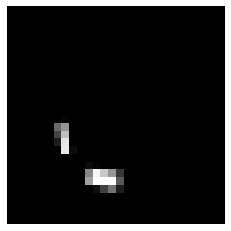

Loss: 0.000631539116008046
Iteration: 20600, Score: 0.06700574382394552
[173, 109, 59, 24, 73, 97, 119, 56, 114, 37, 22, 31, 68, 18, 0]


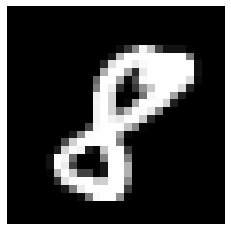

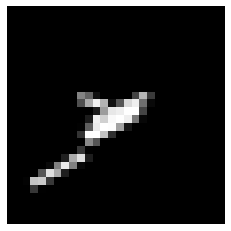

Loss: 0.0007095847761136989
Iteration: 20640, Score: 0.11828105675824914
[32, 60, 75, 53, 63, 80, 108, 196, 131, 32, 47, 43, 38, 42, 0]


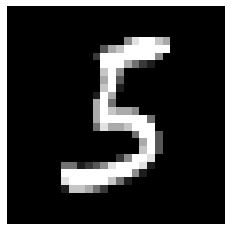

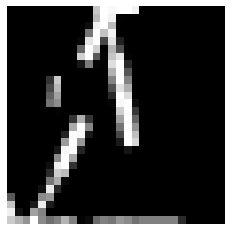

Loss: 0.0005566603908155804
Iteration: 20680, Score: 0.07295189286675303
[36, 74, 238, 30, 52, 210, 50, 74, 46, 81, 30, 30, 22, 27, 0]


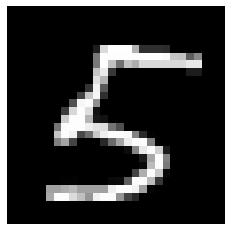

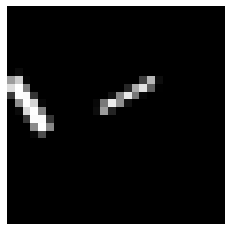

Loss: 0.0005774880452054861
Iteration: 20720, Score: 0.05761172956274822
[75, 58, 133, 101, 142, 108, 68, 69, 69, 58, 26, 33, 26, 34, 0]


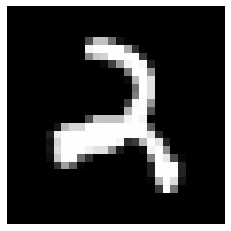

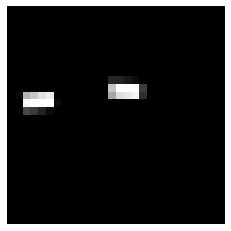

Loss: 0.0006282494389837651
Iteration: 20760, Score: 0.07305099391378464
[147, 106, 83, 104, 94, 98, 94, 31, 82, 31, 25, 22, 46, 37, 0]


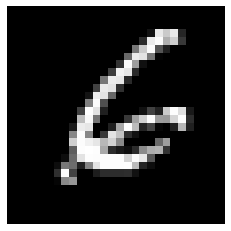

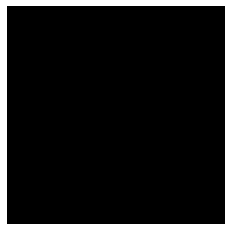

Loss: 0.0007566839050831194
Iteration: 20800, Score: 0.07168990907259286
[165, 32, 91, 76, 48, 70, 44, 169, 83, 41, 38, 35, 47, 61, 0]


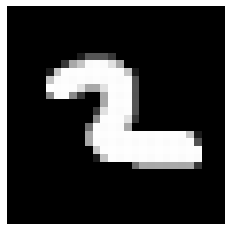

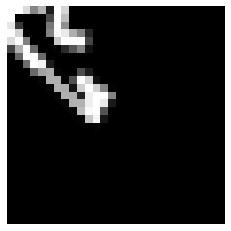

Test score: 0.0
Loss: 0.0007330513550433165
Iteration: 20840, Score: 0.058124457921832816
[79, 47, 260, 57, 55, 168, 30, 133, 57, 22, 26, 15, 25, 26, 0]


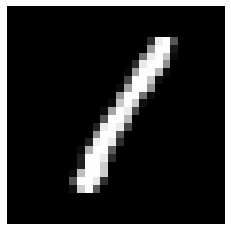

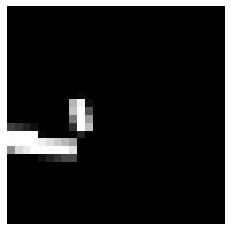

Loss: 0.0006340377624086844
Iteration: 20880, Score: 0.06588076244108379
[94, 72, 216, 67, 69, 179, 83, 28, 42, 46, 17, 22, 38, 27, 0]


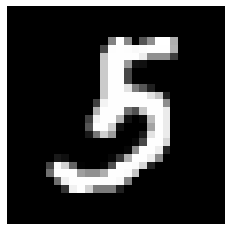

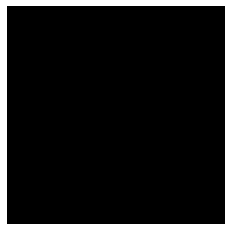

Loss: 0.0007078540840046266
Iteration: 20920, Score: 0.05358934361493448
[136, 62, 115, 64, 89, 102, 44, 123, 63, 80, 23, 27, 38, 34, 0]


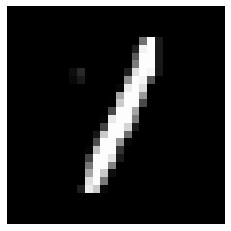

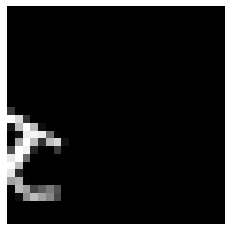

Loss: 0.0006346028000856588
Iteration: 20960, Score: 0.06046916766092181
[98, 104, 139, 48, 98, 81, 90, 112, 79, 60, 15, 32, 17, 27, 0]


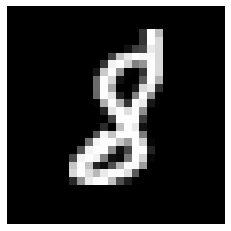

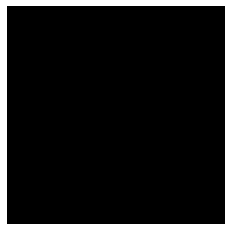

Loss: 0.000541619520520577
Iteration: 21000, Score: 0.0869058882142417
[84, 115, 166, 58, 84, 111, 117, 77, 49, 53, 26, 23, 16, 21, 0]


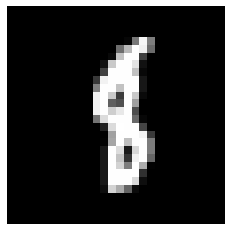

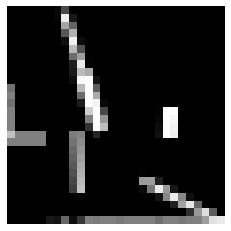

Loss: 0.0008893547595337627
Iteration: 21040, Score: 0.05476611854508519
[89, 122, 178, 49, 57, 174, 89, 102, 44, 32, 12, 14, 21, 17, 0]


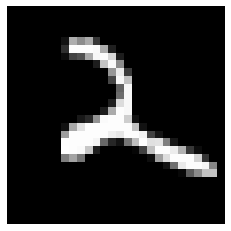

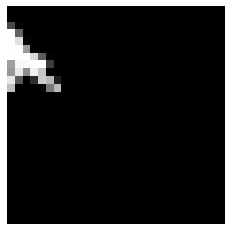

Loss: 0.0005496982640273832
Iteration: 21080, Score: 0.07193883842416107
[55, 132, 126, 49, 83, 74, 189, 93, 74, 33, 23, 22, 16, 31, 0]


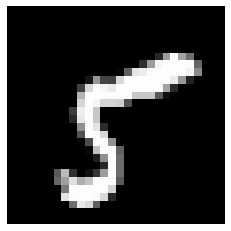

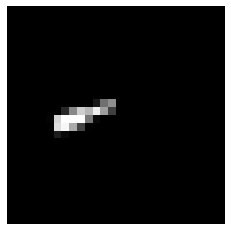

Loss: 0.0006271351565331969
Iteration: 21120, Score: 0.06929384668217972
[105, 50, 93, 141, 67, 46, 173, 70, 74, 46, 29, 36, 17, 53, 0]


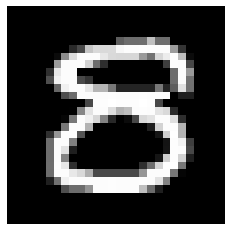

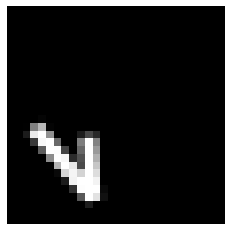

Loss: 0.0006435661729559269
Iteration: 21160, Score: 0.08565444741584358
[107, 61, 43, 168, 115, 98, 66, 116, 37, 42, 40, 27, 24, 56, 0]


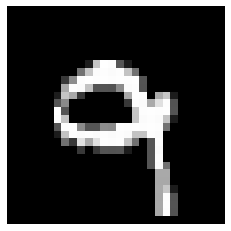

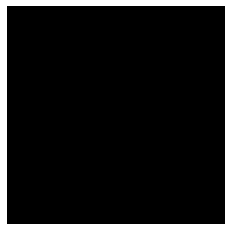

Loss: 0.0007318212818939446
Iteration: 21200, Score: 0.06335221815411933
[58, 140, 157, 94, 67, 136, 60, 93, 44, 44, 33, 33, 20, 21, 0]


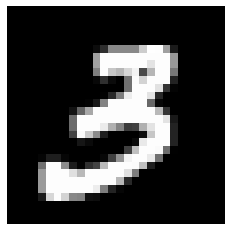

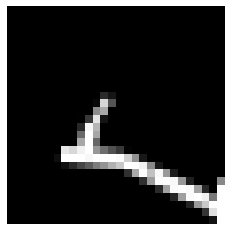

Test score: 0.0
Loss: 0.0005025395920867664
Iteration: 21240, Score: 0.0571229657009244
[52, 134, 162, 112, 114, 139, 33, 84, 47, 28, 13, 38, 15, 29, 0]


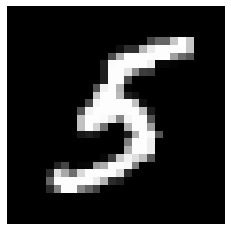

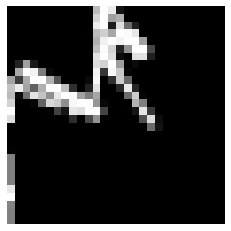

Loss: 0.00040333482258924307
Iteration: 21280, Score: 0.07512514629098588
[67, 134, 97, 51, 82, 68, 126, 111, 76, 28, 40, 76, 15, 29, 0]


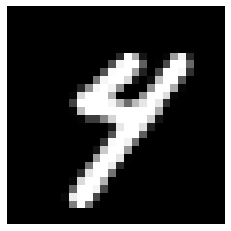

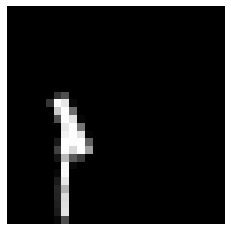

Loss: 0.0005781188048369512
Iteration: 21320, Score: 0.05206144628906623
[44, 106, 61, 72, 67, 49, 156, 162, 69, 55, 24, 72, 30, 33, 0]


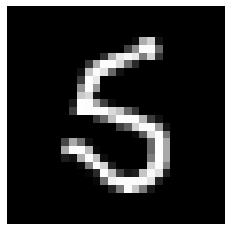

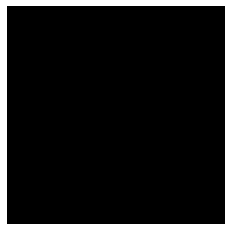

Loss: 0.0005328280476660679
Iteration: 21360, Score: 0.06950287283299258
[44, 75, 103, 101, 77, 52, 30, 188, 53, 66, 53, 77, 51, 30, 0]


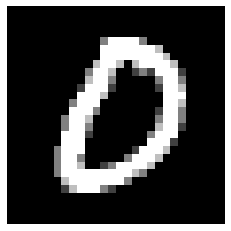

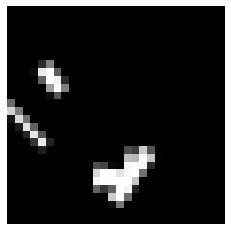

Loss: 0.0006783106355527184
Iteration: 21400, Score: 0.08945138818473061
[53, 70, 131, 130, 68, 148, 31, 117, 71, 36, 29, 51, 52, 13, 0]


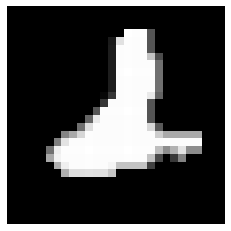

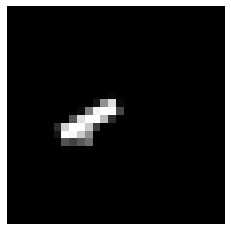

Loss: 0.0006571260189405371
Iteration: 21440, Score: 0.06904625609889627
[60, 169, 88, 67, 24, 110, 191, 58, 64, 21, 25, 75, 20, 28, 0]


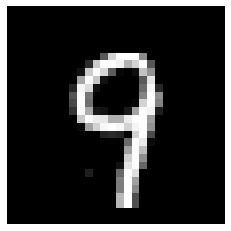

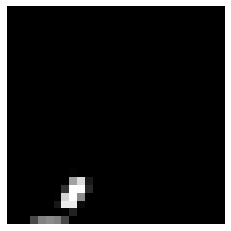

Loss: 0.0007416096797422471
Iteration: 21480, Score: 0.04596131649729795
[60, 152, 47, 41, 41, 108, 157, 134, 96, 29, 26, 45, 42, 22, 0]


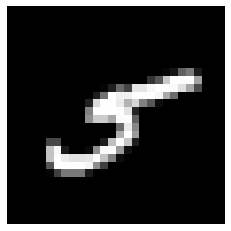

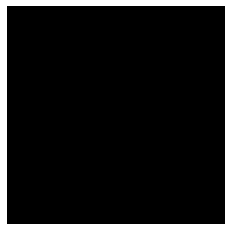

Loss: 0.0006315423422715964
Iteration: 21520, Score: 0.053328210482141
[74, 100, 65, 47, 92, 30, 139, 198, 60, 77, 21, 45, 35, 17, 0]


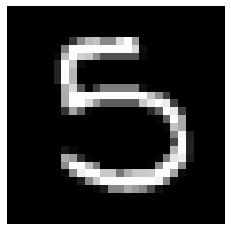

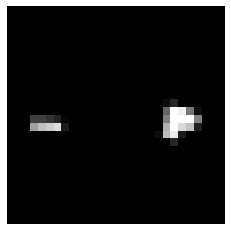

Loss: 0.0007551458191505593
Iteration: 21560, Score: 0.0724118763785809
[49, 119, 107, 51, 77, 114, 157, 154, 42, 37, 17, 34, 13, 29, 0]


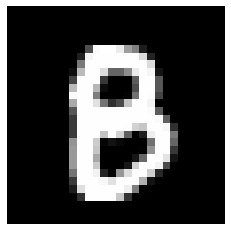

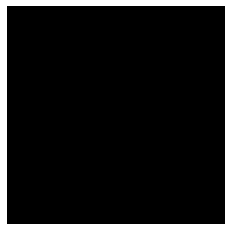

Loss: 0.0005991002416660422
Iteration: 21600, Score: 0.04875637192954309
[46, 128, 74, 46, 53, 158, 152, 97, 58, 41, 22, 78, 25, 22, 0]


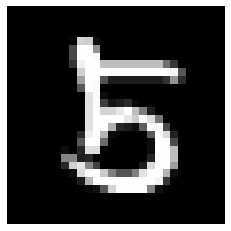

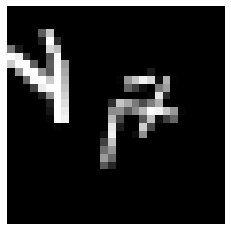

Test score: 0.0
Loss: 0.0007565856818060677
Iteration: 21640, Score: 0.031909907663241026
[30, 233, 62, 41, 32, 102, 241, 104, 38, 32, 16, 28, 15, 26, 0]


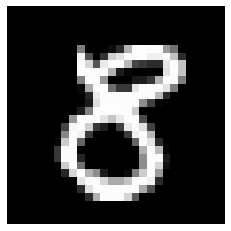

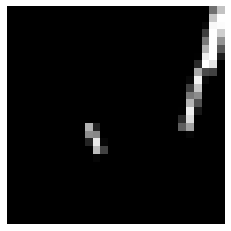

Loss: 0.0006392433964896227
Iteration: 21680, Score: 0.05856565147941002
[43, 148, 64, 53, 41, 63, 192, 200, 42, 34, 20, 41, 29, 30, 0]


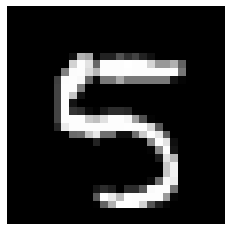

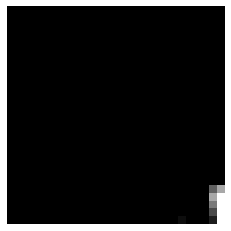

Loss: 0.0005775252070043892
Iteration: 21720, Score: 0.042761489244643604
[36, 95, 179, 29, 56, 147, 90, 149, 38, 35, 16, 46, 47, 37, 0]


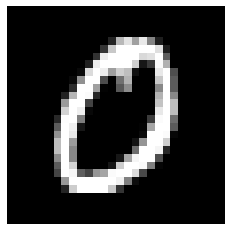

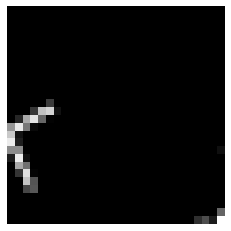

Loss: 0.0004906996896245938
Iteration: 21760, Score: 0.07848604289582
[50, 140, 191, 61, 52, 132, 82, 166, 28, 52, 16, 9, 15, 6, 0]


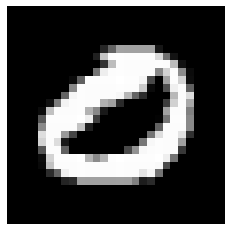

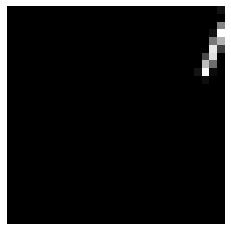

Loss: 0.0007385304844681599
Iteration: 21800, Score: 0.037017593916505574
[37, 190, 137, 59, 63, 108, 130, 104, 57, 19, 25, 25, 31, 15, 0]


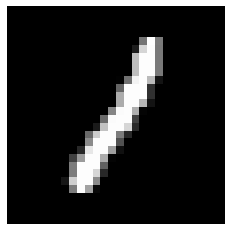

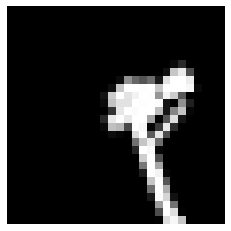

Loss: 0.0005164620984263569
Iteration: 21840, Score: 0.050533019948750736
[41, 96, 95, 74, 131, 90, 61, 166, 98, 40, 26, 25, 25, 32, 0]


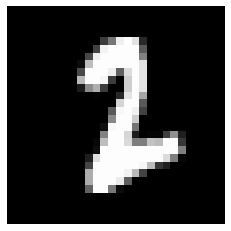

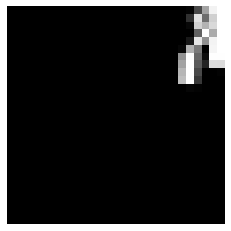

Loss: 0.0005683078490188125
Iteration: 21880, Score: 0.0706279277219437
[48, 112, 82, 20, 62, 53, 91, 239, 31, 77, 20, 50, 60, 55, 0]


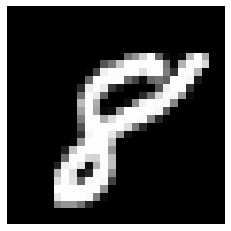

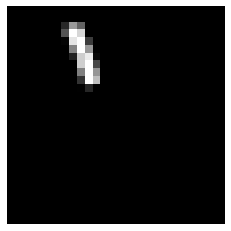

Loss: 0.0006283966147673627
Iteration: 21920, Score: 0.06404431057628243
[38, 127, 87, 89, 78, 47, 125, 170, 49, 106, 18, 24, 25, 17, 0]


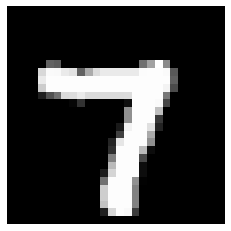

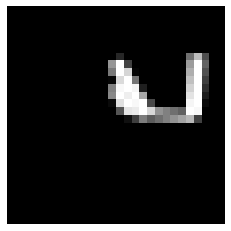

Loss: 0.000608573393777188
Iteration: 21960, Score: 0.03558647498209029
[40, 144, 65, 54, 138, 109, 112, 114, 74, 33, 13, 45, 43, 16, 0]


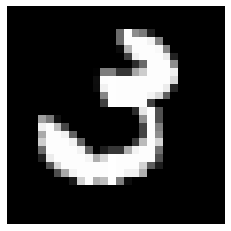

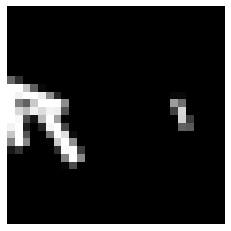

Loss: 0.00047107681370791996
Iteration: 22000, Score: 0.058746789349243045
[98, 119, 40, 42, 98, 68, 137, 161, 74, 46, 15, 36, 44, 22, 0]


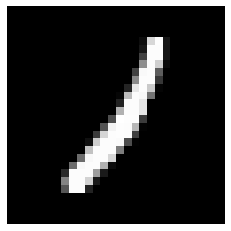

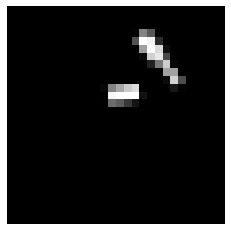

Test score: 0.0
Loss: 0.0005934596611211015
Iteration: 22040, Score: 0.04641937117397902
[78, 75, 159, 77, 57, 114, 45, 164, 45, 73, 20, 30, 36, 27, 0]


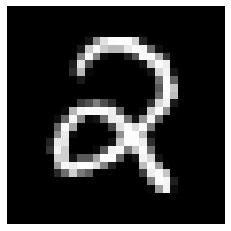

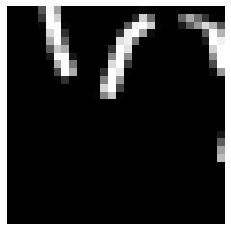

Loss: 0.0005906197721697446
Iteration: 22080, Score: 0.0809937835438177
[33, 76, 125, 183, 188, 100, 45, 89, 37, 35, 22, 23, 29, 15, 0]


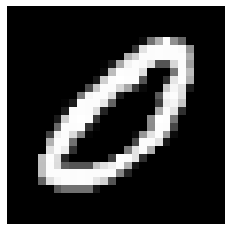

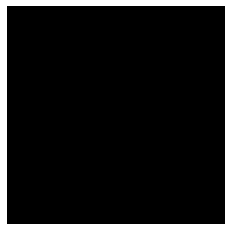

Loss: 0.0004608293576479434
Iteration: 22120, Score: 0.04087869074445916
[75, 183, 92, 58, 125, 62, 64, 129, 79, 34, 21, 23, 20, 35, 0]


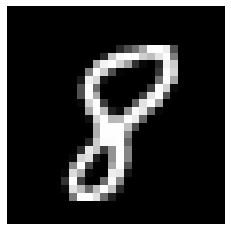

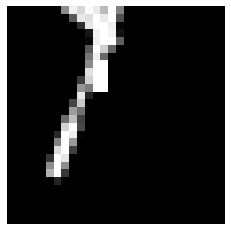

Loss: 0.0007138424379102306
Iteration: 22160, Score: 0.052784728513564916
[54, 205, 71, 79, 80, 105, 54, 144, 108, 25, 15, 15, 26, 19, 0]


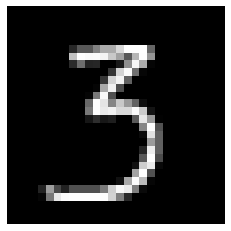

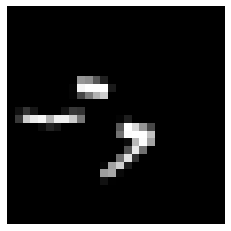

Loss: 0.0007319985155747133
Iteration: 22200, Score: 0.05180944439396262
[45, 128, 59, 114, 63, 92, 122, 171, 72, 24, 22, 33, 26, 29, 0]


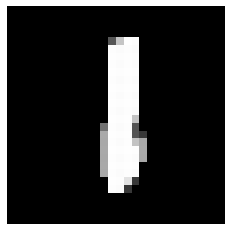

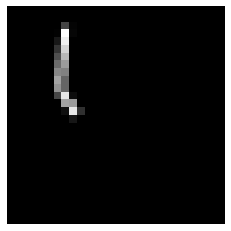

Loss: 0.0007764716214411948
Iteration: 22240, Score: 0.033403643455589195
[38, 157, 109, 114, 142, 115, 112, 95, 27, 15, 17, 35, 12, 12, 0]


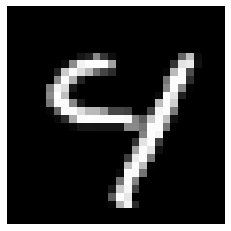

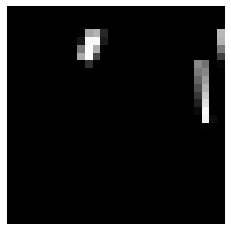

Loss: 0.0006105755460058521
Iteration: 22280, Score: 0.037310482805129136
[17, 112, 64, 164, 183, 117, 105, 71, 52, 19, 25, 37, 17, 17, 0]


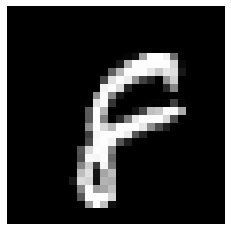

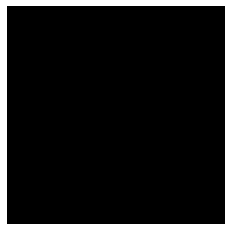

Loss: 0.0005082810117501196
Iteration: 22320, Score: 0.04836311709147413
[31, 58, 198, 141, 139, 128, 67, 58, 87, 15, 25, 17, 24, 12, 0]


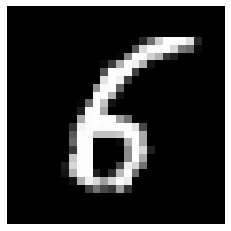

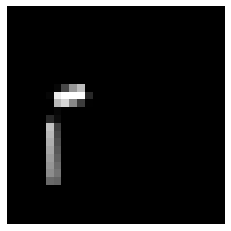

Loss: 0.0005110135005711182
Iteration: 22360, Score: 0.06609606957901268
[51, 112, 72, 167, 181, 57, 53, 120, 77, 33, 26, 10, 31, 10, 0]


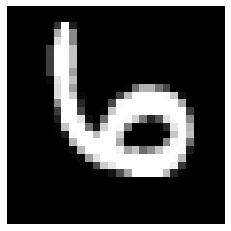

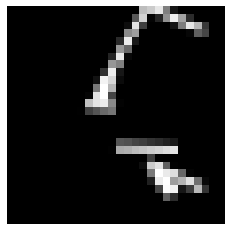

Loss: 0.0005150120921955964
Iteration: 22400, Score: 0.028134980094851925
[44, 133, 98, 188, 154, 62, 67, 70, 51, 41, 18, 26, 35, 13, 0]


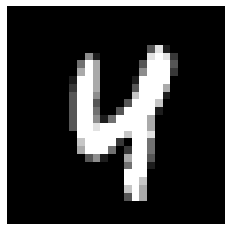

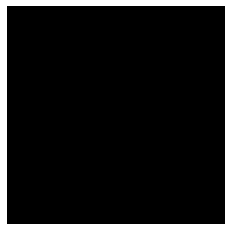

Test score: 0.0
Loss: 0.000596016908507986
Iteration: 22440, Score: 0.04830163217242807
[43, 123, 109, 147, 98, 101, 58, 73, 68, 43, 35, 52, 36, 14, 0]


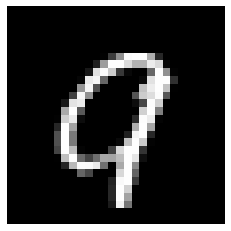

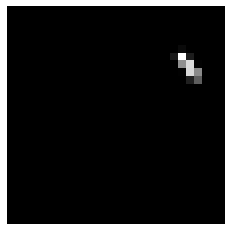

Loss: 0.0006028324310170659
Iteration: 22480, Score: 0.04272928281128407
[65, 64, 118, 86, 59, 96, 73, 55, 157, 88, 25, 61, 38, 15, 0]


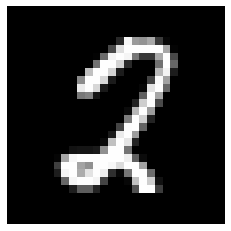

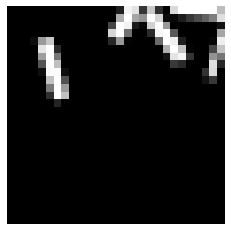

Loss: 0.0005693409793186979
Iteration: 22520, Score: 0.05502393786329777
[40, 53, 102, 223, 198, 90, 30, 32, 126, 37, 22, 15, 19, 13, 0]


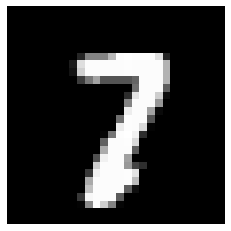

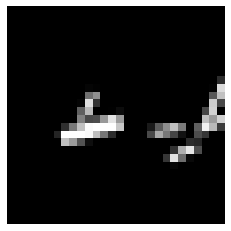

Loss: 0.0006619559620727005
Iteration: 22560, Score: 0.034772453501820566
[30, 69, 90, 168, 139, 149, 33, 64, 106, 42, 23, 43, 31, 13, 0]


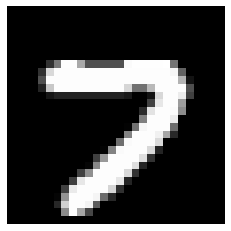

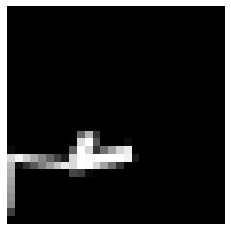

Loss: 0.0004964948465489074
Iteration: 22600, Score: 0.06300261592678727
[26, 127, 100, 140, 148, 104, 109, 47, 61, 66, 11, 20, 20, 21, 0]


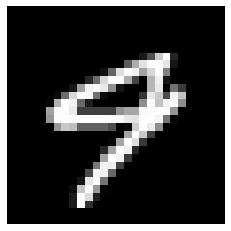

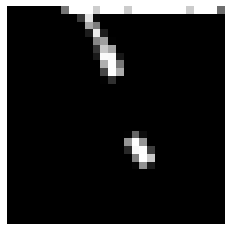

Loss: 0.0004315976116176053
Iteration: 22640, Score: 0.039216348768852195
[39, 40, 162, 69, 146, 130, 54, 106, 100, 44, 15, 14, 55, 26, 0]


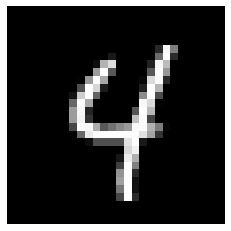

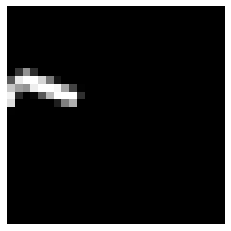

Loss: 0.0005468079343259267
Iteration: 22680, Score: 0.04377756189553474
[55, 22, 172, 63, 68, 199, 23, 103, 146, 44, 33, 17, 32, 23, 0]


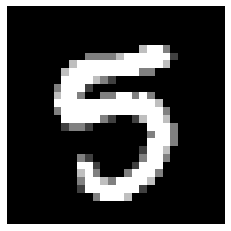

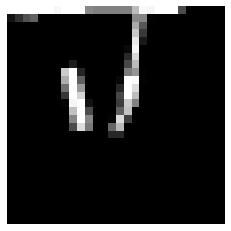

Loss: 0.0003757363367846057
Iteration: 22720, Score: 0.057754483942990195
[57, 149, 58, 144, 137, 57, 30, 110, 116, 23, 36, 20, 39, 24, 0]


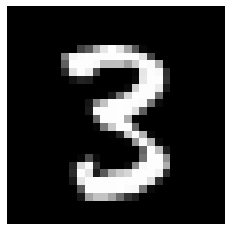

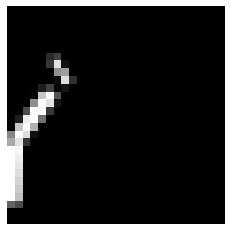

Loss: 0.0005750942473698853
Iteration: 22760, Score: 0.062195546293631186
[48, 88, 194, 85, 41, 182, 39, 81, 74, 21, 26, 32, 66, 23, 0]


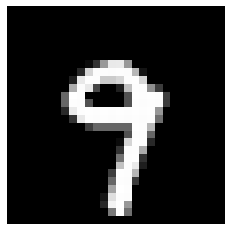

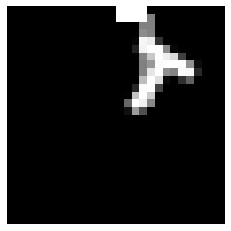

Loss: 0.0005579993483430207
Iteration: 22800, Score: 0.059722591767669655
[41, 60, 264, 54, 64, 294, 13, 54, 34, 18, 32, 32, 26, 14, 0]


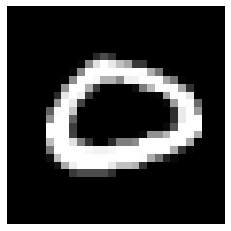

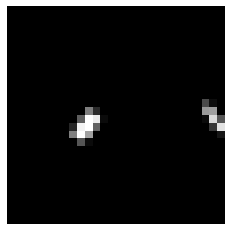

Test score: 0.0
Loss: 0.00044903129681574675
Iteration: 22840, Score: 0.044266672824975095
[34, 123, 98, 75, 89, 163, 40, 117, 63, 57, 24, 49, 41, 27, 0]


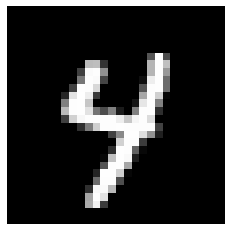

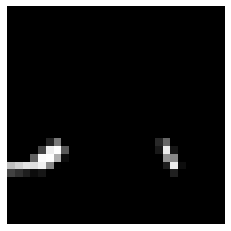

Loss: 0.0005393348192223645
Iteration: 22880, Score: 0.04983617412857711
[32, 206, 79, 28, 66, 167, 68, 107, 114, 38, 22, 19, 31, 23, 0]


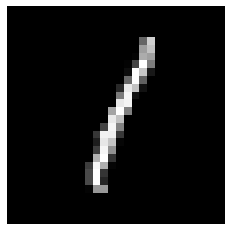

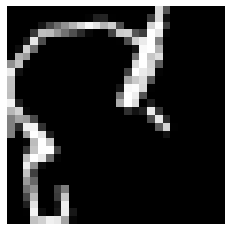

Loss: 0.00047460992699457867
Iteration: 22920, Score: 0.052707706985529526
[27, 158, 102, 156, 33, 166, 74, 33, 87, 38, 48, 30, 27, 21, 0]


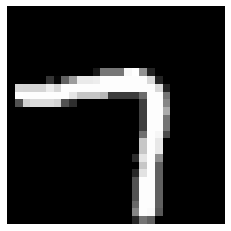

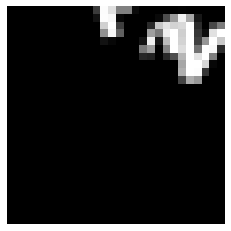

Loss: 0.0003440590180597623
Iteration: 22960, Score: 0.0685730644869618
[23, 78, 55, 275, 225, 123, 11, 56, 47, 22, 23, 15, 22, 25, 0]


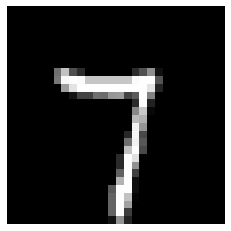

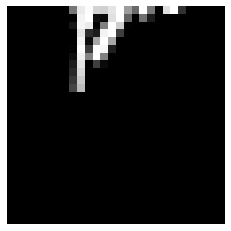

Loss: 0.0004630241368735655
Iteration: 23000, Score: 0.053565400312945724
[51, 109, 72, 124, 275, 34, 63, 65, 64, 34, 36, 27, 15, 31, 0]


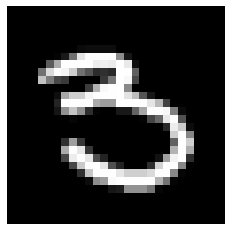

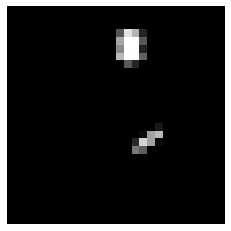

Loss: 0.0004012610121294532
Iteration: 23040, Score: 0.04623710785992443
[68, 100, 85, 96, 129, 88, 28, 88, 139, 30, 32, 27, 33, 57, 0]


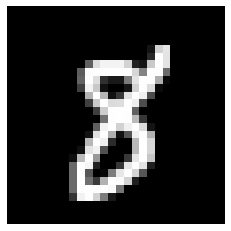

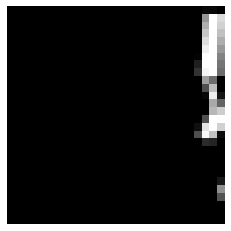

Loss: 0.00035802459465377286
Iteration: 23080, Score: 0.07395358907856281
[89, 88, 145, 89, 42, 93, 42, 41, 136, 25, 36, 34, 96, 44, 0]


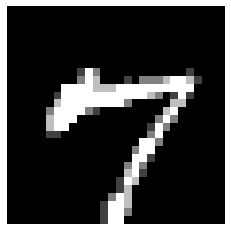

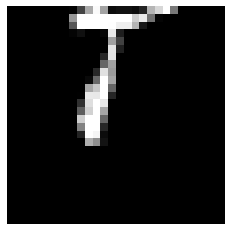

Loss: 0.0004748710678693354
Iteration: 23120, Score: 0.05567104154080151
[82, 42, 146, 151, 74, 89, 70, 50, 150, 47, 20, 18, 43, 18, 0]


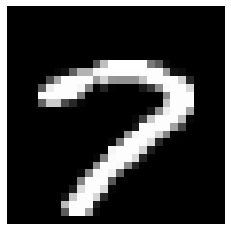

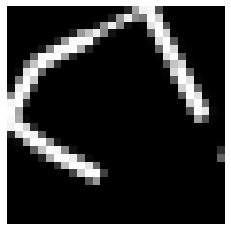

Loss: 0.0003690486870038955
Iteration: 23160, Score: 0.04938407652638853
[49, 80, 106, 130, 156, 106, 54, 47, 139, 46, 18, 29, 22, 18, 0]


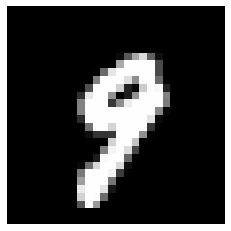

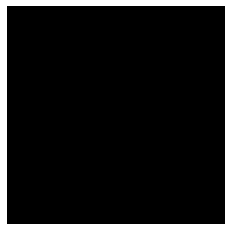

Loss: 0.0004800499019092505
Iteration: 23200, Score: 0.05254341879114509
[38, 153, 80, 74, 119, 153, 75, 52, 32, 32, 69, 31, 35, 57, 0]


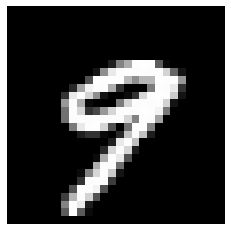

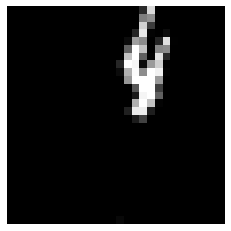

Test score: 0.0
Loss: 0.0005920159050634745
Iteration: 23240, Score: 0.05805109689044184
[53, 97, 174, 79, 38, 218, 50, 59, 74, 24, 32, 24, 23, 55, 0]


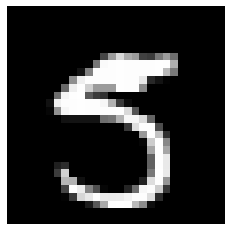

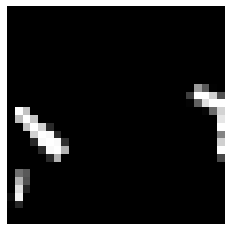

Loss: 0.00047857272618366883
Iteration: 23280, Score: 0.0666835093665868
[70, 42, 199, 76, 52, 127, 87, 32, 102, 57, 30, 30, 42, 54, 0]


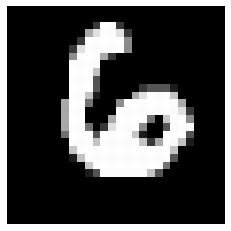

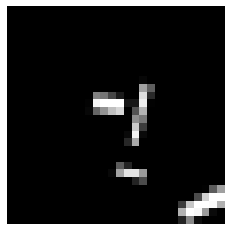

Loss: 0.00048596693888650755
Iteration: 23320, Score: 0.033754821928916504
[35, 81, 126, 76, 105, 127, 76, 67, 88, 84, 14, 34, 64, 23, 0]


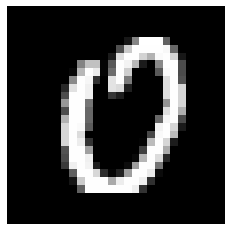

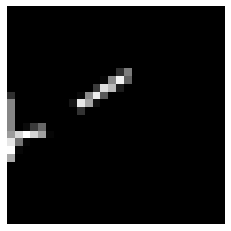

Loss: 0.0005280601842298942
Iteration: 23360, Score: 0.049438505284604625
[40, 80, 101, 80, 100, 150, 17, 143, 50, 115, 34, 32, 24, 34, 0]


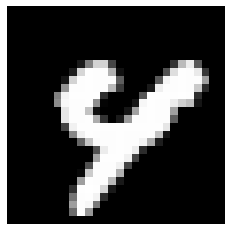

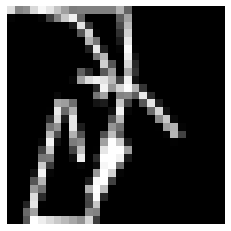

Loss: 0.000426254789819352
Iteration: 23400, Score: 0.04250768277666066
[49, 118, 139, 56, 39, 142, 57, 118, 68, 49, 23, 26, 56, 60, 0]


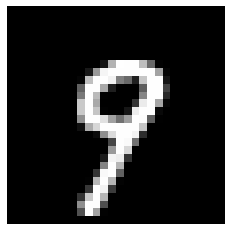

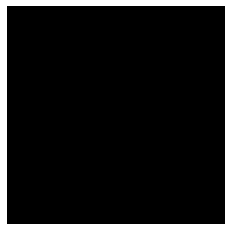

Loss: 0.00043031076332253386
Iteration: 23440, Score: 0.04849594998219982
[45, 48, 266, 60, 27, 187, 92, 102, 26, 41, 31, 24, 26, 25, 0]


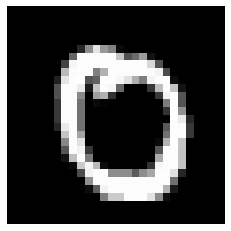

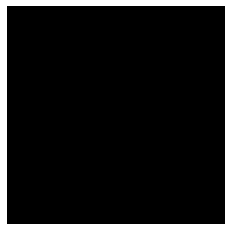

Loss: 0.0005447364340518332
Iteration: 23480, Score: 0.042945614766329535
[36, 86, 280, 40, 17, 181, 56, 38, 91, 76, 19, 16, 37, 27, 0]


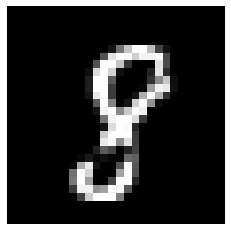

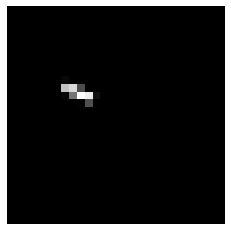

Loss: 0.0004565033774561321
Iteration: 23520, Score: 0.05040699565579415
[53, 57, 145, 57, 21, 113, 46, 76, 123, 132, 34, 34, 69, 40, 0]


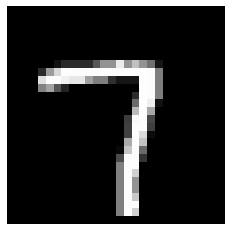

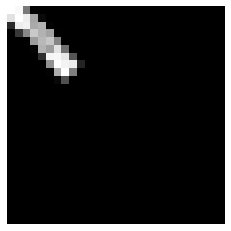

Loss: 0.0005893168239475924
Iteration: 23560, Score: 0.03827902023870411
[42, 159, 86, 86, 90, 91, 131, 71, 47, 55, 30, 15, 52, 45, 0]


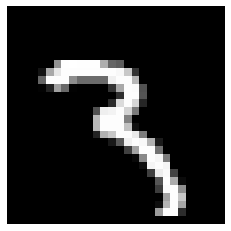

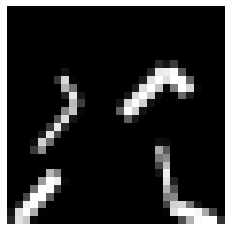

Loss: 0.0004825686336226153
Iteration: 23600, Score: 0.06969932588934899
[61, 146, 167, 31, 26, 157, 206, 49, 24, 30, 16, 26, 40, 21, 0]


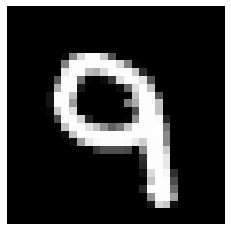

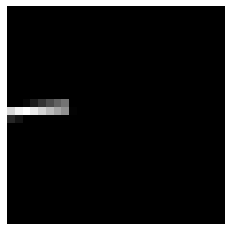

Test score: 0.0
Loss: 0.0003965251340384657
Iteration: 23640, Score: 0.03507211812050081
[34, 135, 176, 83, 24, 165, 90, 119, 27, 33, 39, 26, 19, 30, 0]


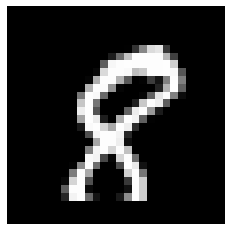

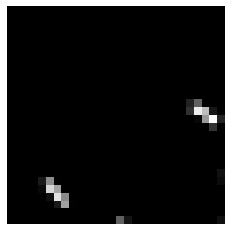

Loss: 0.00038257607097845925
Iteration: 23680, Score: 0.05119121587090195
[43, 129, 112, 98, 64, 80, 108, 110, 60, 85, 27, 21, 22, 41, 0]


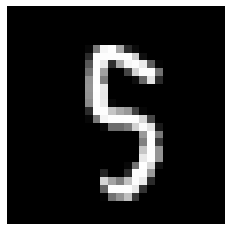

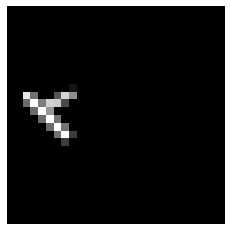

Loss: 0.0003374664954887401
Iteration: 23720, Score: 0.053345597061212155
[49, 162, 37, 64, 59, 89, 66, 162, 49, 73, 58, 44, 32, 56, 0]


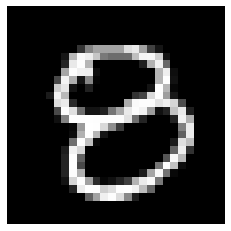

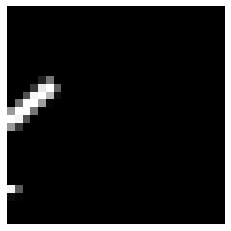

Loss: 0.0005095561604326543
Iteration: 23760, Score: 0.044068274341057985
[23, 116, 208, 29, 45, 194, 102, 61, 72, 62, 12, 19, 19, 38, 0]


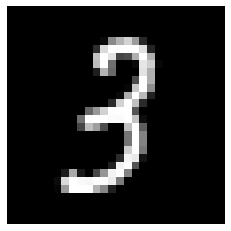

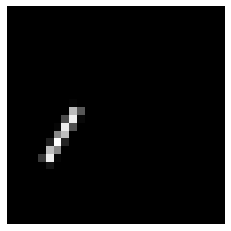

Loss: 0.00037841346333618764
Iteration: 23800, Score: 0.03458248211699538
[44, 101, 65, 108, 129, 54, 122, 135, 58, 34, 45, 26, 34, 45, 0]


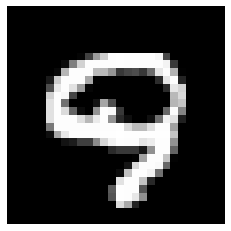

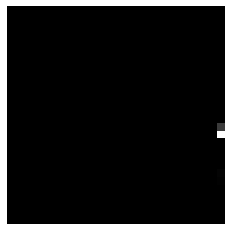

Loss: 0.0004932880406915166
Iteration: 23840, Score: 0.04962901175196749
[77, 89, 76, 100, 101, 45, 72, 67, 141, 29, 42, 50, 88, 23, 0]


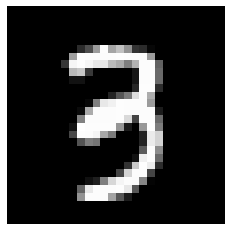

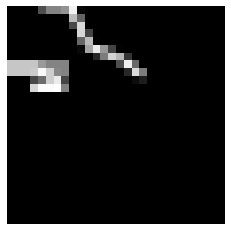

Loss: 0.0004959554627398343
Iteration: 23880, Score: 0.05647807716019452
[27, 69, 110, 149, 116, 145, 28, 60, 113, 61, 28, 24, 39, 31, 0]


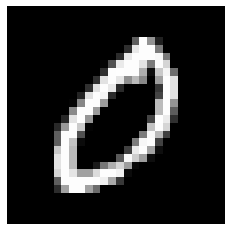

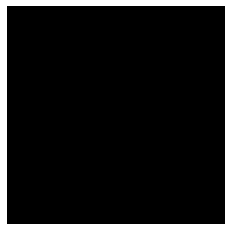

Loss: 0.00036027226835503646
Iteration: 23920, Score: 0.07002672878059092
[35, 56, 212, 80, 90, 94, 57, 76, 73, 108, 21, 28, 30, 40, 0]


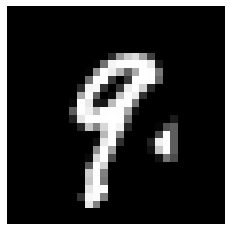

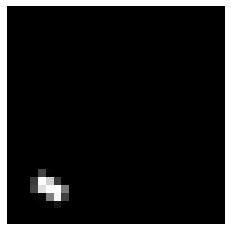

Loss: 0.0003850526729452782
Iteration: 23960, Score: 0.06295077827409842
[40, 74, 154, 79, 139, 133, 29, 94, 39, 61, 49, 39, 41, 29, 0]


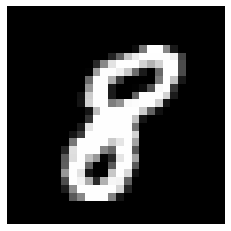

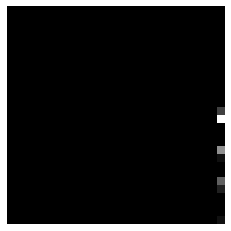

Loss: 0.00037813214840629413
Iteration: 24000, Score: 0.060811270742793556
[41, 22, 180, 115, 73, 198, 25, 63, 48, 82, 67, 21, 35, 30, 0]


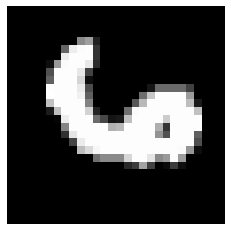

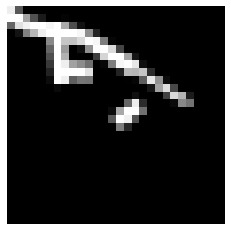

Test score: 0.0
Loss: 0.00036644613561728035
Iteration: 24040, Score: 0.04400655650591943
[56, 67, 55, 52, 35, 80, 44, 101, 223, 54, 84, 83, 34, 32, 0]


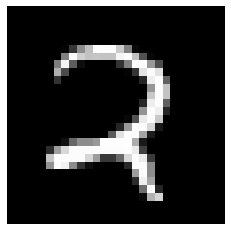

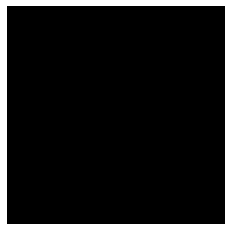

Loss: 0.0003614281332642396
Iteration: 24080, Score: 0.049373882750980556
[57, 56, 167, 59, 158, 161, 50, 47, 64, 53, 33, 38, 25, 32, 0]


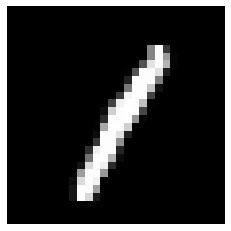

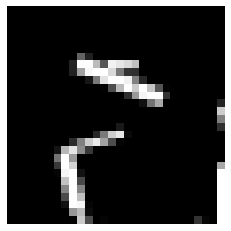

Loss: 0.0004080793880846092
Iteration: 24120, Score: 0.04548039558983874
[26, 135, 148, 95, 150, 54, 43, 68, 36, 125, 19, 30, 30, 41, 0]


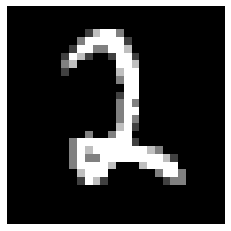

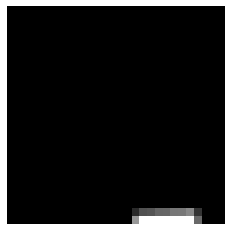

Loss: 0.00038536905498647467
Iteration: 24160, Score: 0.04611131239909445
[33, 49, 159, 70, 83, 235, 45, 62, 36, 80, 22, 23, 24, 79, 0]


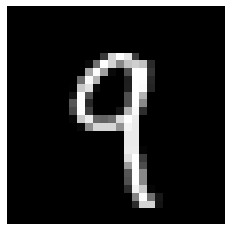

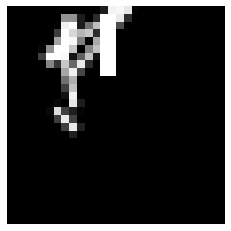

Loss: 0.00044614070243354615
Iteration: 24200, Score: 0.03724951979808974
[61, 95, 190, 46, 55, 169, 83, 81, 52, 79, 18, 20, 30, 21, 0]


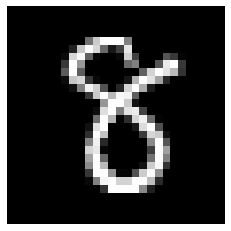

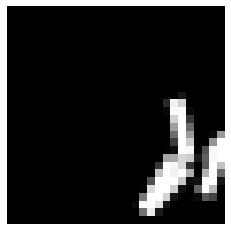

Loss: 0.00042464713571928905
Iteration: 24240, Score: 0.03927654923900264
[25, 29, 150, 223, 180, 140, 18, 76, 22, 46, 23, 14, 18, 36, 0]


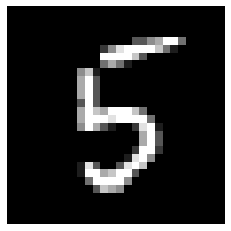

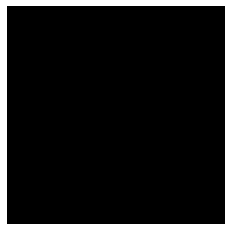

Loss: 0.00036139550507278154
Iteration: 24280, Score: 0.0665089184390381
[59, 61, 121, 100, 117, 67, 60, 113, 48, 101, 33, 25, 72, 23, 0]


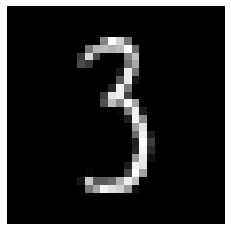

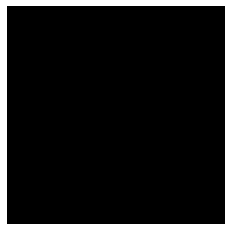

Loss: 0.00040503269858804326
Iteration: 24320, Score: 0.0601131543344818
[30, 180, 91, 83, 104, 25, 157, 70, 44, 107, 31, 26, 29, 23, 0]


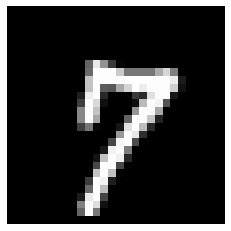

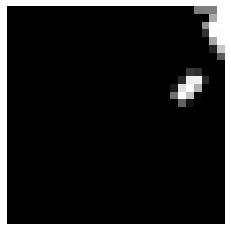

Loss: 0.000347588143613076
Iteration: 24360, Score: 0.03702677839249373
[81, 76, 87, 92, 87, 49, 132, 101, 90, 98, 22, 25, 33, 27, 0]


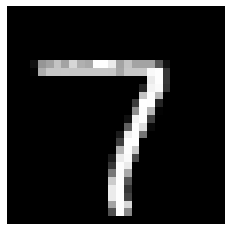

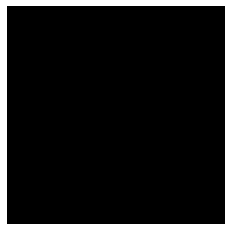

Loss: 0.0005023070845986745
Iteration: 24400, Score: 0.04064508824655787
[32, 80, 60, 71, 158, 37, 152, 67, 111, 76, 21, 68, 26, 41, 0]


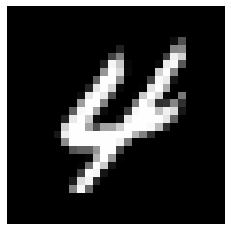

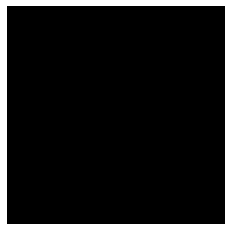

Test score: 0.0
Loss: 0.000430801806959479
Iteration: 24440, Score: 0.058931447930634026
[51, 26, 80, 107, 266, 135, 30, 42, 45, 90, 15, 33, 40, 40, 0]


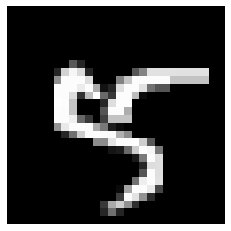

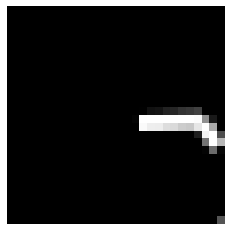

Loss: 0.00045235051974489314
Iteration: 24480, Score: 0.06667762621678411
[13, 166, 56, 94, 159, 82, 204, 32, 23, 67, 22, 25, 13, 44, 0]


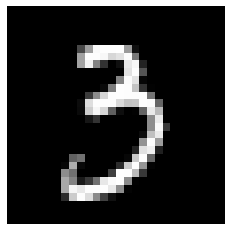

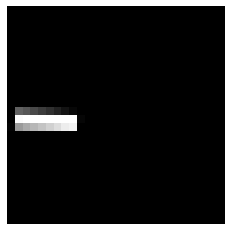

Loss: 0.0003616221096438799
Iteration: 24520, Score: 0.04529755814839155
[55, 96, 64, 131, 120, 59, 92, 98, 47, 144, 15, 27, 30, 22, 0]


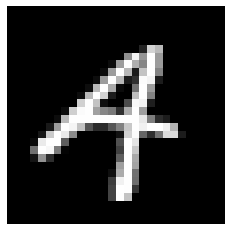

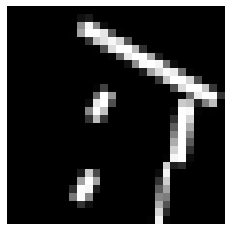

Loss: 0.0004346001901766042
Iteration: 24560, Score: 0.05999991204496473
[62, 77, 45, 142, 169, 73, 147, 43, 67, 76, 14, 33, 21, 31, 0]


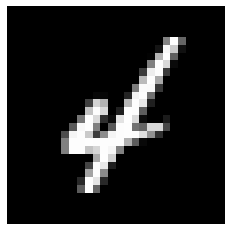

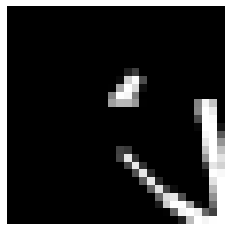

Loss: 0.00038717435318742506
Iteration: 24600, Score: 0.03725394597509876
[52, 86, 24, 41, 152, 64, 153, 82, 90, 101, 18, 44, 26, 67, 0]


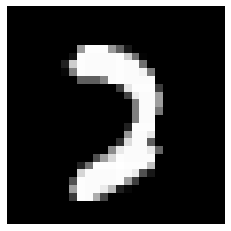

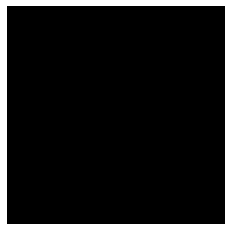

Loss: 0.0003960120417987546
Iteration: 24640, Score: 0.053110465509817
[57, 103, 114, 54, 57, 164, 159, 48, 41, 103, 10, 36, 21, 33, 0]


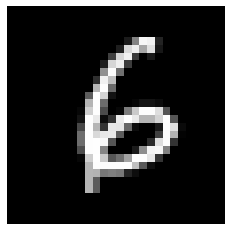

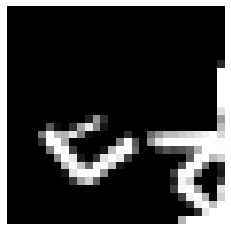

Loss: 0.0003522699845786447
Iteration: 24680, Score: 0.07728905496094375
[74, 67, 98, 115, 116, 61, 44, 76, 114, 120, 17, 31, 33, 34, 0]


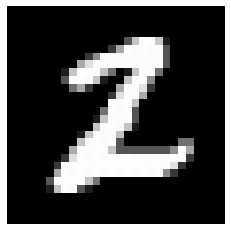

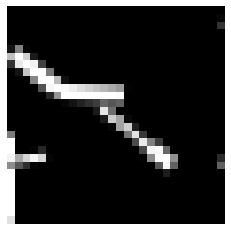

Loss: 0.00035080590802852036
Iteration: 24720, Score: 0.03494060880155302
[76, 53, 116, 80, 99, 155, 27, 80, 151, 79, 20, 25, 17, 22, 0]


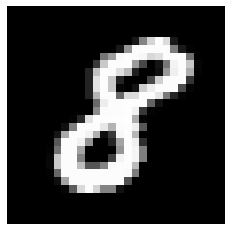

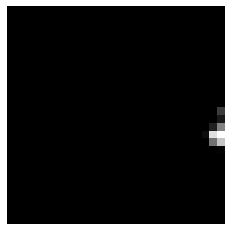

Loss: 0.00031775844068338205
Iteration: 24760, Score: 0.07119897369109095
[78, 85, 82, 36, 90, 117, 120, 101, 54, 85, 21, 67, 23, 41, 0]


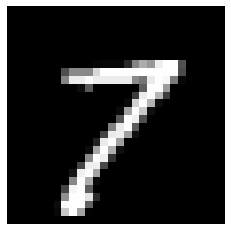

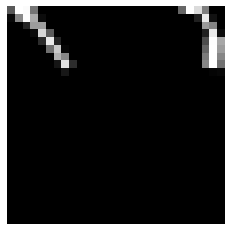

Loss: 0.00037118428211622176
Iteration: 24800, Score: 0.04468905784352682
[87, 50, 97, 72, 121, 88, 49, 94, 58, 87, 27, 71, 20, 79, 0]


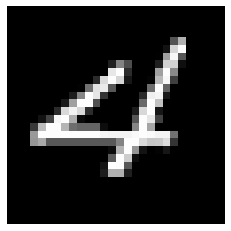

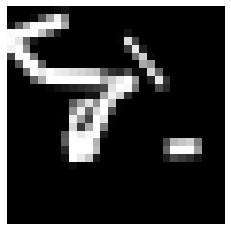

Test score: 0.0
Loss: 0.000426186866240677
Iteration: 24840, Score: 0.04977824971734663
[64, 123, 39, 184, 198, 31, 81, 51, 49, 72, 17, 24, 22, 45, 0]


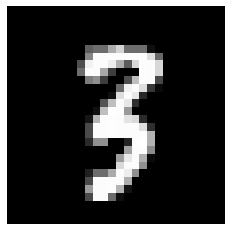

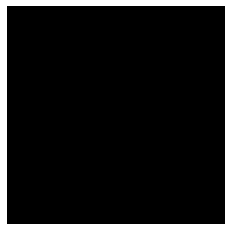

Loss: 0.0003380543583869033
Iteration: 24880, Score: 0.06648272572492712
[95, 55, 63, 53, 52, 85, 92, 64, 129, 114, 40, 51, 40, 67, 0]


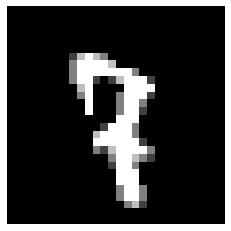

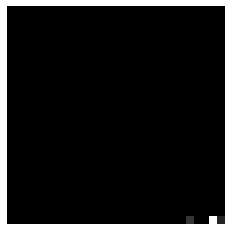

Loss: 0.0002927056596796455
Iteration: 24920, Score: 0.04410101175284943
[33, 266, 30, 24, 55, 119, 186, 49, 51, 62, 22, 32, 48, 23, 0]


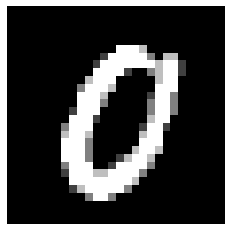

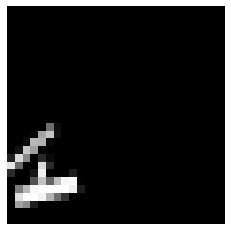

Loss: 0.00034416184469610636
Iteration: 24960, Score: 0.05896655933093279
[29, 91, 135, 81, 101, 186, 48, 124, 48, 53, 26, 14, 29, 35, 0]


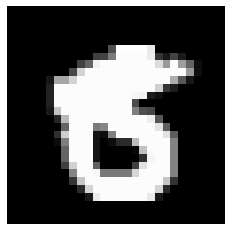

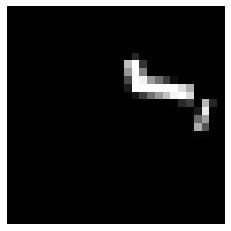

Loss: 0.0003217561639649803
Iteration: 25000, Score: 0.06964984762791573
[62, 110, 68, 142, 41, 134, 92, 80, 75, 55, 20, 56, 33, 32, 0]


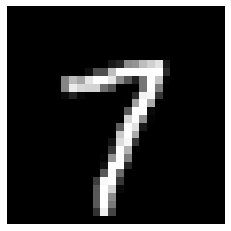

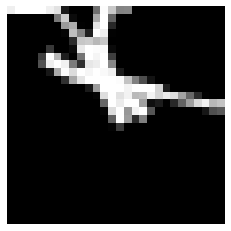

Loss: 0.00027551108062767856
Iteration: 25040, Score: 0.07283541468624025
[73, 83, 34, 49, 87, 149, 104, 74, 154, 45, 16, 65, 30, 37, 0]


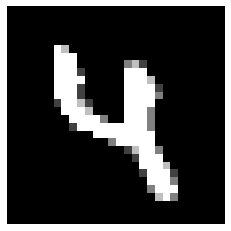

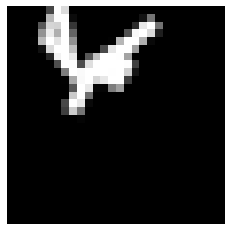

Loss: 0.00031933929064846534
Iteration: 25080, Score: 0.05668537137389649
[56, 68, 104, 174, 221, 148, 33, 45, 43, 31, 14, 16, 23, 24, 0]


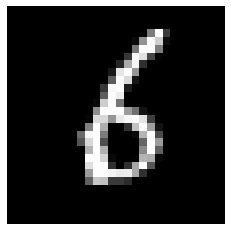

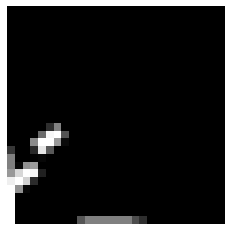

Loss: 0.0003133007839089415
Iteration: 25120, Score: 0.05834814404835925
[64, 81, 24, 168, 108, 109, 26, 118, 43, 131, 33, 44, 22, 29, 0]


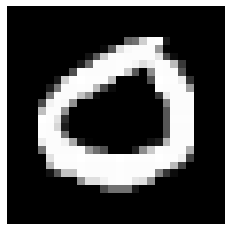

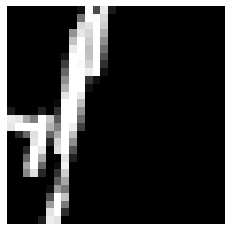

Loss: 0.00031048535425987897
Iteration: 25160, Score: 0.06817312827345448
[58, 155, 53, 174, 185, 54, 64, 35, 38, 32, 25, 45, 12, 70, 0]


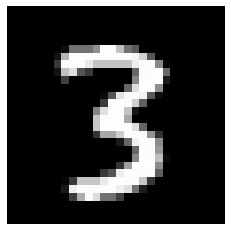

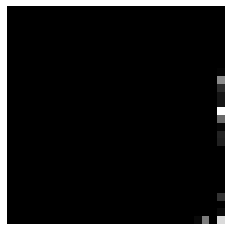

Loss: 0.00029712295173788764
Iteration: 25200, Score: 0.04572924808620883
[59, 107, 75, 31, 97, 71, 113, 67, 75, 148, 11, 24, 44, 78, 0]


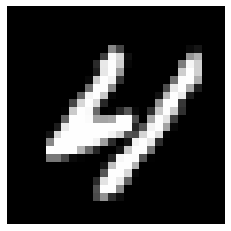

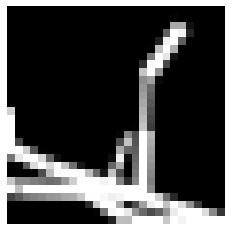

Test score: 0.0
Loss: 0.00030675819106410667
Iteration: 25240, Score: 0.058076261408627025
[47, 56, 73, 139, 133, 108, 24, 61, 130, 69, 17, 22, 24, 97, 0]


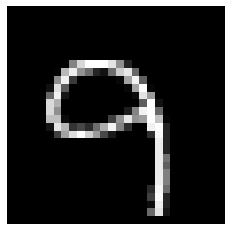

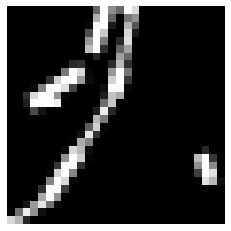

Loss: 0.0004396039891313637
Iteration: 25280, Score: 0.03715603445377201
[58, 53, 57, 95, 67, 71, 26, 140, 71, 101, 31, 43, 41, 146, 0]


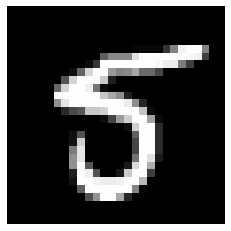

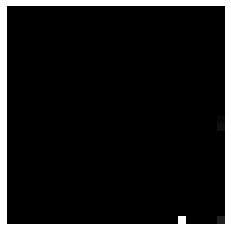

Loss: 0.0003284052972953627
Iteration: 25320, Score: 0.0590389446230838
[39, 171, 36, 171, 156, 108, 73, 40, 16, 53, 36, 17, 21, 63, 0]


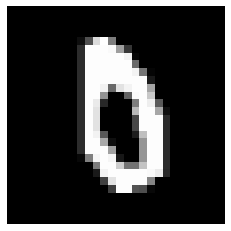

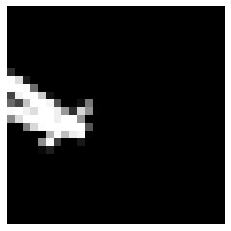

Loss: 0.00038522584649606514
Iteration: 25360, Score: 0.06146607149019837
[49, 34, 55, 193, 234, 42, 55, 65, 23, 83, 35, 27, 19, 86, 0]


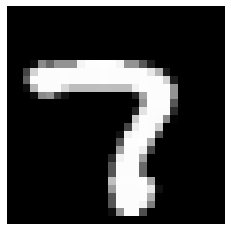

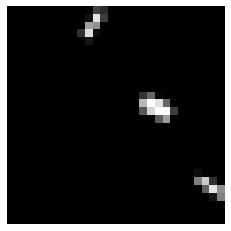

Loss: 0.0003717491654885872
Iteration: 25400, Score: 0.03723946599848568
[47, 67, 125, 139, 182, 121, 51, 58, 38, 64, 15, 18, 12, 63, 0]


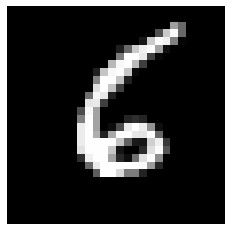

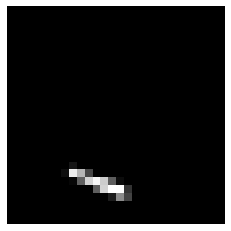

Loss: 0.00039889920865803955
Iteration: 25440, Score: 0.03197446908950223
[68, 35, 99, 122, 84, 163, 42, 130, 74, 49, 21, 28, 25, 60, 0]


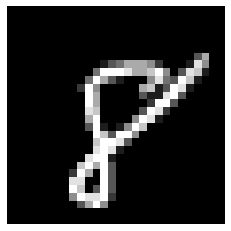

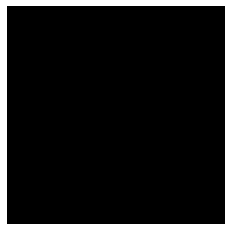

Loss: 0.00035610265888945386
Iteration: 25480, Score: 0.043268285360187286
[98, 89, 210, 105, 52, 146, 32, 61, 41, 51, 34, 16, 16, 49, 0]


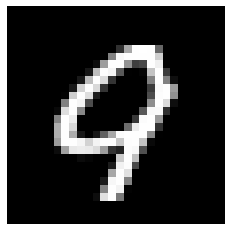

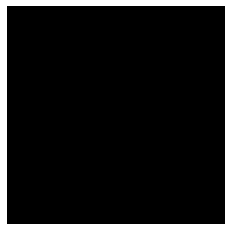

Loss: 0.0003587925967645877
Iteration: 25520, Score: 0.07969558066967877
[31, 13, 140, 237, 200, 129, 48, 77, 36, 34, 13, 7, 15, 20, 0]


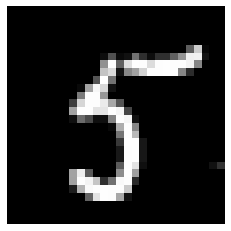

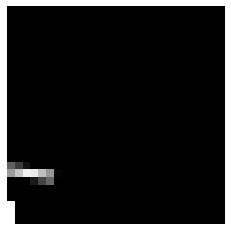

Loss: 0.00038791010817523547
Iteration: 25560, Score: 0.03975920861435589
[43, 54, 174, 136, 136, 180, 27, 55, 61, 68, 15, 26, 7, 18, 0]


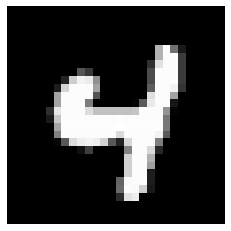

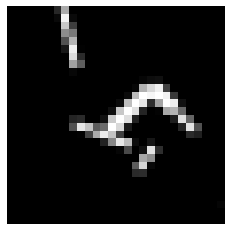

Loss: 0.000298683137105526
Iteration: 25600, Score: 0.05639780655130744
[23, 167, 151, 19, 76, 135, 142, 55, 69, 36, 20, 63, 16, 28, 0]


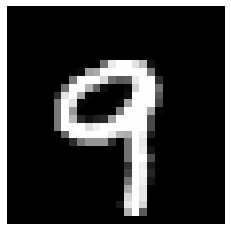

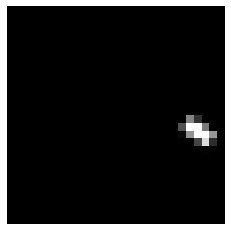

Test score: 0.0
Loss: 0.00034237441431867523
Iteration: 25640, Score: 0.035366020632907745
[82, 29, 123, 173, 175, 115, 23, 85, 37, 24, 20, 86, 12, 16, 0]


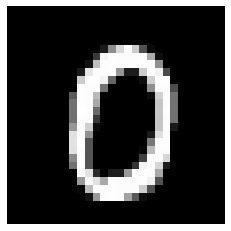

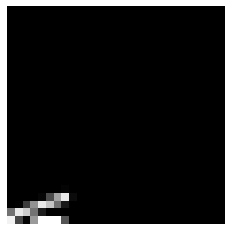

Loss: 0.0003463620460020886
Iteration: 25680, Score: 0.0515477873343043
[64, 38, 172, 180, 201, 160, 46, 20, 42, 16, 13, 25, 10, 13, 0]


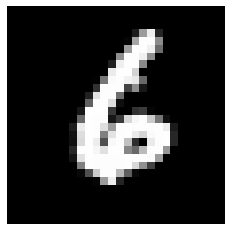

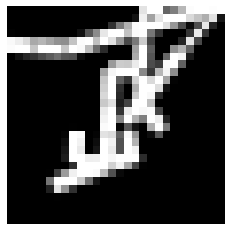

Loss: 0.00032742278567422323
Iteration: 25720, Score: 0.05446405070088804
[71, 175, 88, 30, 72, 117, 168, 78, 47, 45, 14, 60, 22, 13, 0]


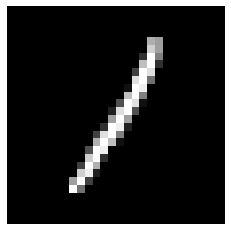

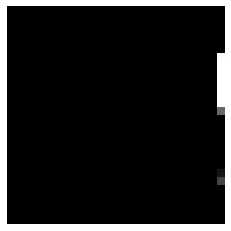

Loss: 0.0003644424898639676
Iteration: 25760, Score: 0.05277624680439476
[56, 70, 243, 63, 88, 246, 59, 21, 32, 44, 8, 42, 15, 13, 0]


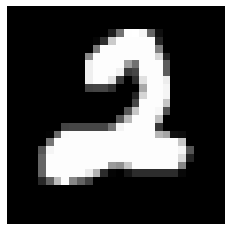

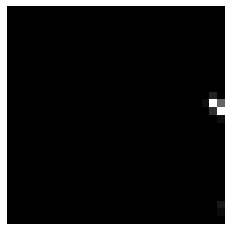

Loss: 0.00026510915194853896
Iteration: 25800, Score: 0.03524351236288203
[71, 94, 182, 31, 28, 124, 66, 59, 55, 117, 21, 66, 34, 52, 0]


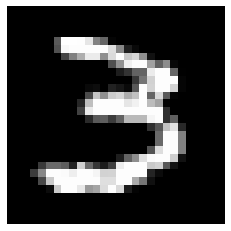

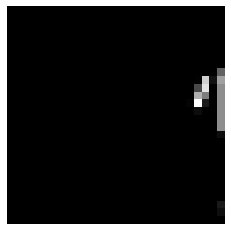

Loss: 0.00032391639384609386
Iteration: 25840, Score: 0.054516013178974386
[58, 42, 204, 80, 65, 126, 23, 97, 51, 65, 32, 87, 31, 39, 0]


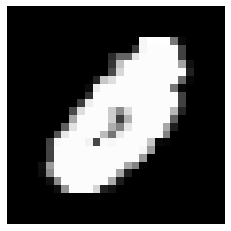

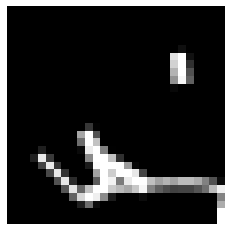

Loss: 0.0002749720742564899
Iteration: 25880, Score: 0.04696399468369782
[88, 64, 209, 28, 59, 140, 62, 134, 75, 37, 18, 35, 20, 31, 0]


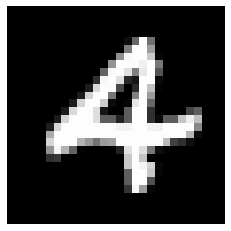

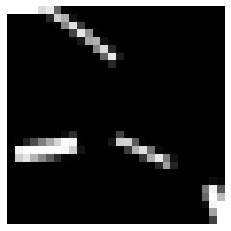

Loss: 0.00029176176571699375
Iteration: 25920, Score: 0.08494384633749726
[44, 82, 209, 14, 34, 156, 136, 101, 71, 53, 24, 34, 19, 23, 0]


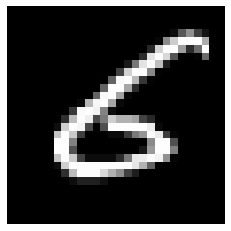

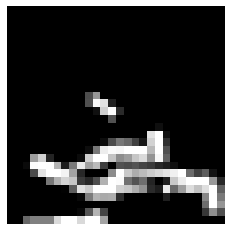

Loss: 0.0002771791333717686
Iteration: 25960, Score: 0.08019141008611769
[41, 68, 179, 37, 41, 183, 126, 44, 69, 46, 61, 41, 19, 45, 0]


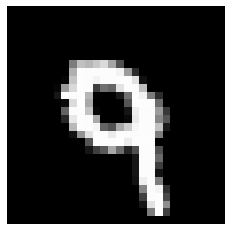

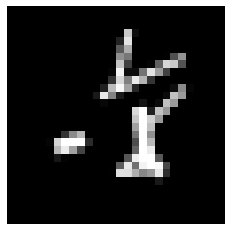

Loss: 0.00034026231674179406
Iteration: 26000, Score: 0.08930971019435674
[37, 111, 150, 61, 92, 191, 72, 54, 79, 51, 45, 25, 9, 23, 0]


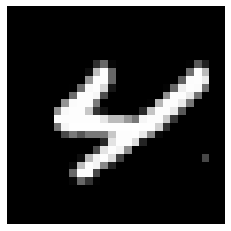

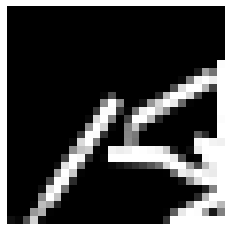

Test score: 0.0
Loss: 0.00029847535758236143
Iteration: 26040, Score: 0.04951107477524784
[81, 78, 180, 36, 31, 190, 65, 87, 68, 62, 21, 59, 18, 24, 0]


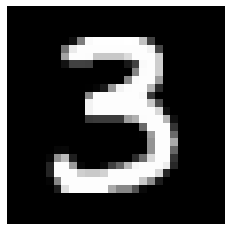

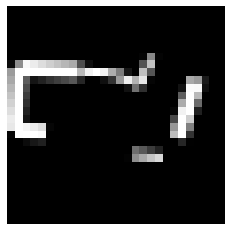

Loss: 0.00022054202738432758
Iteration: 26080, Score: 0.05932911958941258
[94, 64, 152, 19, 34, 177, 65, 90, 66, 81, 53, 42, 26, 37, 0]


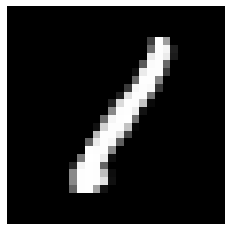

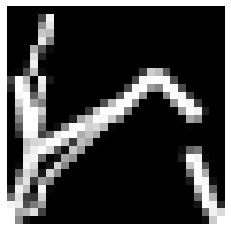

Loss: 0.0002570910971663608
Iteration: 26120, Score: 0.02976985983501072
[63, 89, 137, 72, 70, 150, 128, 47, 41, 32, 38, 35, 34, 64, 0]


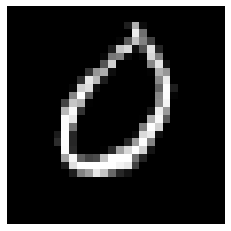

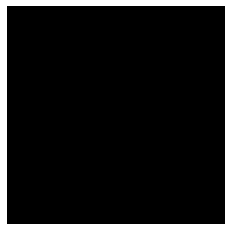

Loss: 0.0002649107206636234
Iteration: 26160, Score: 0.06333277531713247
[56, 68, 161, 68, 42, 192, 54, 53, 56, 34, 77, 43, 19, 77, 0]


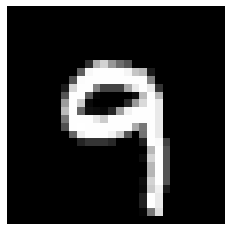

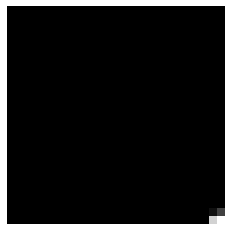

Loss: 0.00030779696540287076
Iteration: 26200, Score: 0.04300584022514522
[50, 51, 118, 56, 39, 199, 91, 66, 52, 36, 105, 26, 19, 92, 0]


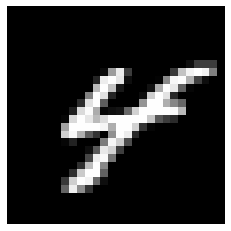

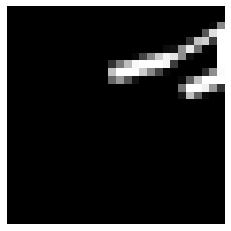

Loss: 0.0003168870912240583
Iteration: 26240, Score: 0.06079745997698046
[42, 153, 96, 25, 41, 182, 161, 25, 38, 23, 45, 51, 25, 93, 0]


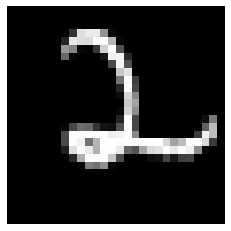

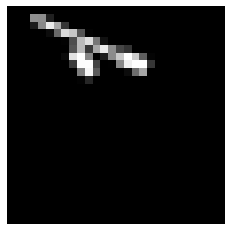

Loss: 0.00033444181020980484
Iteration: 26280, Score: 0.06819394890498369
[57, 187, 52, 61, 64, 90, 225, 47, 43, 27, 42, 17, 14, 74, 0]


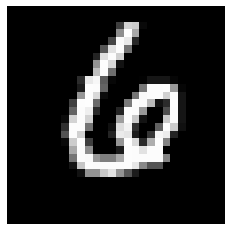

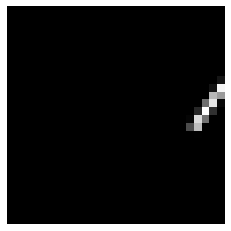

Loss: 0.00029275959229813607
Iteration: 26320, Score: 0.10562224829779006
[53, 58, 135, 58, 84, 146, 65, 40, 81, 105, 66, 28, 15, 66, 0]


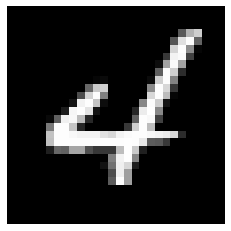

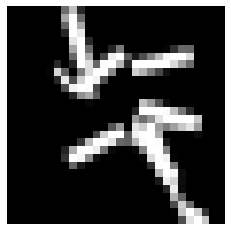

Loss: 0.0002517287948039936
Iteration: 26360, Score: 0.06279472675640135
[38, 118, 111, 69, 79, 140, 123, 46, 59, 108, 25, 32, 17, 35, 0]


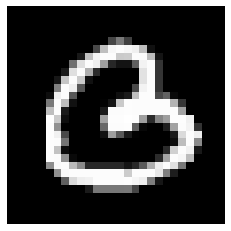

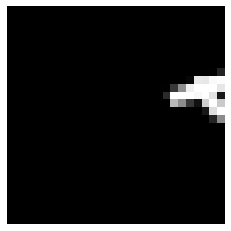

Loss: 0.0002494384902571218
Iteration: 26400, Score: 0.07326347190747037
[80, 129, 70, 60, 71, 113, 112, 31, 86, 46, 43, 33, 29, 97, 0]


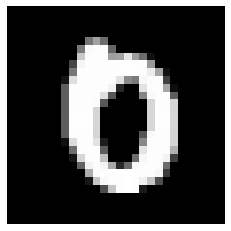

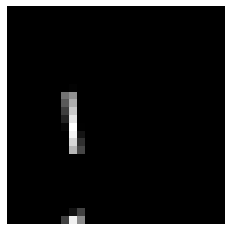

Test score: 0.0
Loss: 0.00023160969119322443
Iteration: 26440, Score: 0.05832842101575807
[154, 137, 38, 51, 49, 148, 108, 36, 46, 56, 42, 35, 19, 81, 0]


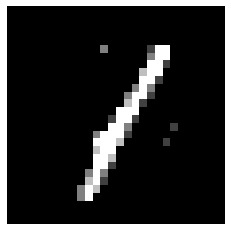

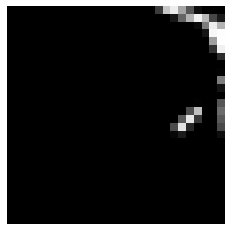

Loss: 0.00018899699324839735
Iteration: 26480, Score: 0.10669390857731924
[128, 51, 83, 61, 55, 137, 78, 100, 63, 35, 59, 23, 27, 100, 0]


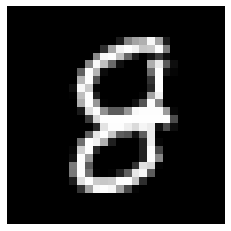

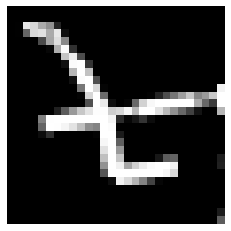

Loss: 0.00018619602217124758
Iteration: 26520, Score: 0.05242065577278844
[49, 124, 64, 47, 101, 78, 150, 122, 64, 64, 37, 30, 19, 51, 0]


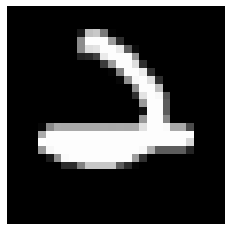

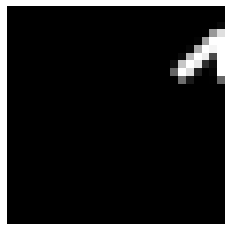

Loss: 0.00025594414495990516
Iteration: 26560, Score: 0.0600097215482965
[50, 230, 72, 30, 57, 66, 166, 50, 94, 62, 35, 25, 21, 42, 0]


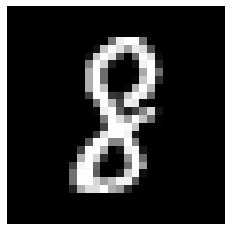

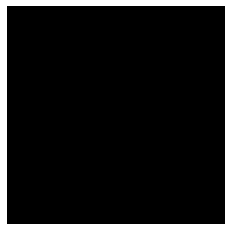

Loss: 0.00017692064331821652
Iteration: 26600, Score: 0.05388995762169361
[55, 93, 51, 82, 89, 102, 76, 56, 79, 58, 26, 32, 23, 178, 0]


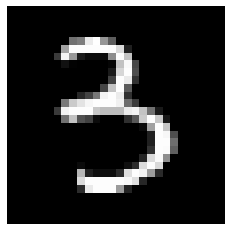

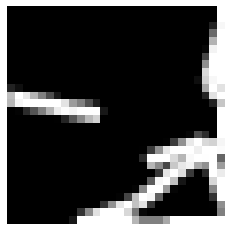

Loss: 0.0002900391822561951
Iteration: 26640, Score: 0.05671275795111432
[61, 79, 32, 63, 78, 121, 108, 112, 47, 48, 69, 21, 37, 124, 0]


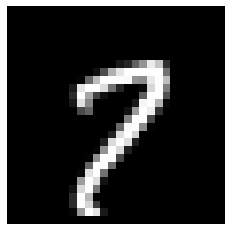

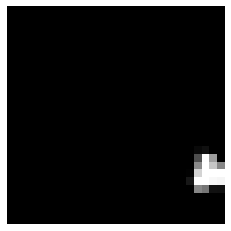

Loss: 0.00030855954009783904
Iteration: 26680, Score: 0.03971236211880751
[27, 65, 133, 111, 138, 130, 49, 101, 50, 67, 31, 15, 27, 56, 0]


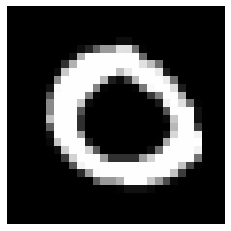

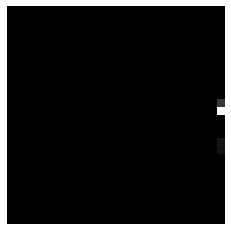

Loss: 0.0002883208075719273
Iteration: 26720, Score: 0.04469567101076245
[36, 90, 165, 39, 75, 204, 65, 39, 64, 43, 29, 18, 39, 94, 0]


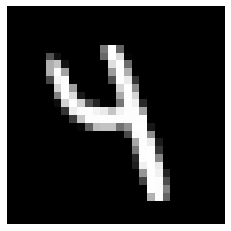

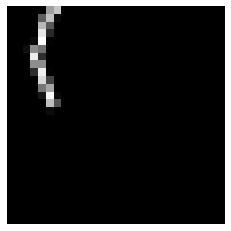

Loss: 0.0002603354193093041
Iteration: 26760, Score: 0.04656675061117857
[60, 70, 62, 49, 128, 106, 101, 29, 114, 52, 45, 38, 25, 121, 0]


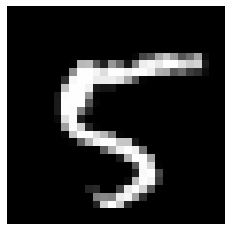

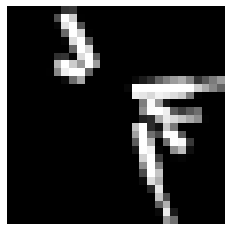

Loss: 0.00023832769380409998
Iteration: 26800, Score: 0.04574656475288792
[90, 34, 46, 106, 116, 134, 106, 77, 92, 66, 26, 16, 18, 73, 0]


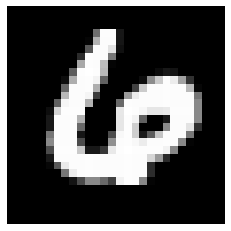

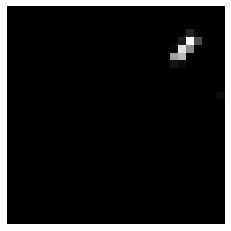

Test score: 0.0
Loss: 0.0003243768615908862
Iteration: 26840, Score: 0.04191415736684576
[49, 52, 149, 117, 105, 186, 81, 48, 43, 39, 14, 51, 16, 50, 0]


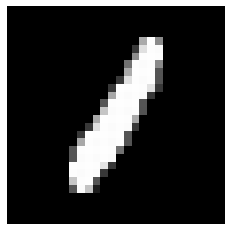

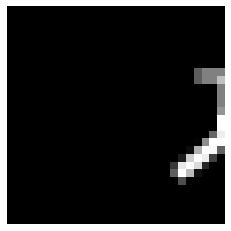

Loss: 0.00029841368161220356
Iteration: 26880, Score: 0.05745257905079054
[26, 125, 133, 98, 118, 222, 73, 63, 34, 27, 19, 15, 16, 31, 0]


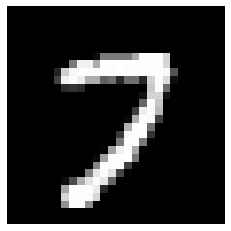

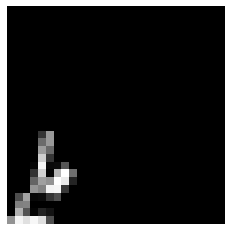

Loss: 0.00034898826532264217
Iteration: 26920, Score: 0.03793016396276653
[30, 209, 35, 80, 86, 159, 106, 58, 78, 32, 19, 20, 27, 61, 0]


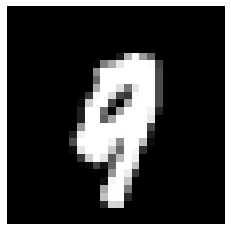

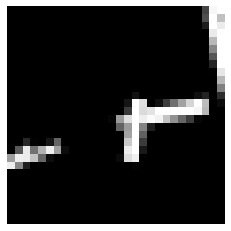

Loss: 0.00027326153003173303
Iteration: 26960, Score: 0.06619598301127552
[56, 105, 122, 61, 60, 202, 98, 66, 54, 41, 26, 18, 22, 69, 0]


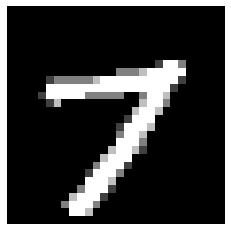

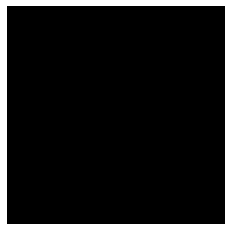

Loss: 0.00026020809698995236
Iteration: 27000, Score: 0.061183613732457155
[71, 138, 86, 51, 62, 122, 151, 76, 38, 87, 21, 19, 22, 56, 0]


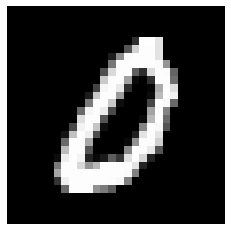

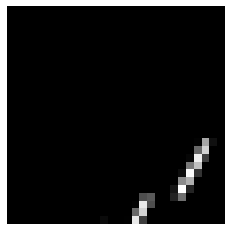

Loss: 0.0002327637589469672
Iteration: 27040, Score: 0.07590873306524008
[51, 184, 96, 40, 55, 118, 169, 58, 30, 68, 23, 14, 18, 76, 0]


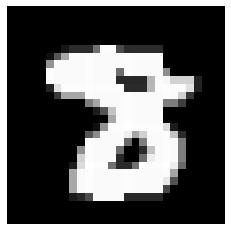

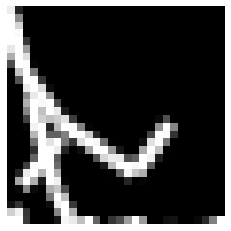

Loss: 0.0002363902331788842
Iteration: 27080, Score: 0.07020728310197592
[59, 138, 51, 80, 111, 93, 106, 65, 45, 38, 20, 15, 19, 160, 0]


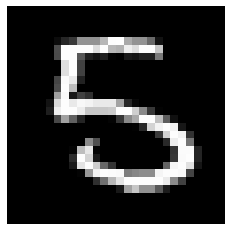

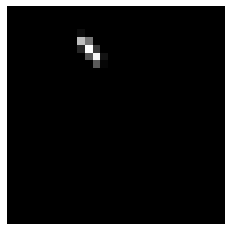

Loss: 0.00020574414241239332
Iteration: 27120, Score: 0.06636745711416006
[66, 223, 66, 35, 25, 99, 211, 36, 54, 89, 15, 17, 12, 52, 0]


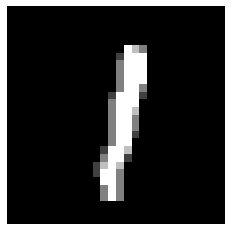

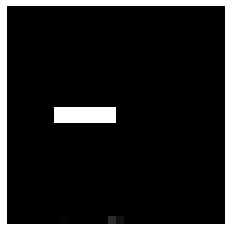

Loss: 0.00024479362002931536
Iteration: 27160, Score: 0.0696891266226303
[83, 62, 89, 89, 70, 89, 92, 73, 65, 62, 26, 39, 32, 129, 0]


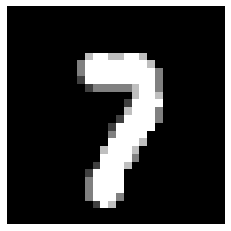

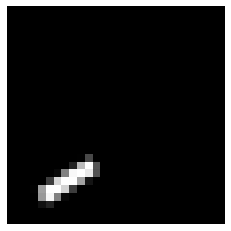

Loss: 0.0002522697710979488
Iteration: 27200, Score: 0.0960209061615169
[54, 114, 157, 53, 38, 160, 114, 52, 35, 50, 26, 33, 20, 94, 0]


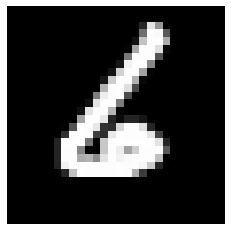

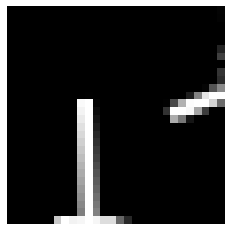

Test score: 0.0
Loss: 0.0002306772075982451
Iteration: 27240, Score: 0.09414097133651375
[69, 171, 118, 36, 26, 102, 170, 27, 86, 68, 21, 23, 26, 57, 0]


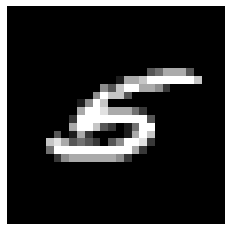

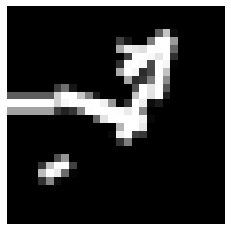

Loss: 0.0001939857521457083
Iteration: 27280, Score: 0.09760272113746034
[61, 61, 79, 134, 123, 76, 57, 51, 63, 75, 12, 54, 25, 129, 0]


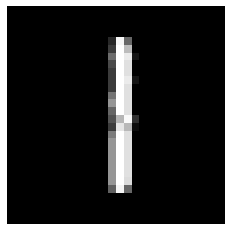

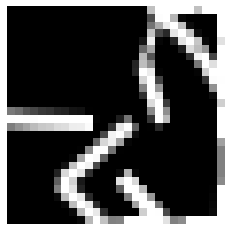

Loss: 0.00024798074570825683
Iteration: 27320, Score: 0.0943310801149346
[65, 55, 129, 80, 85, 131, 109, 54, 47, 39, 14, 24, 19, 149, 0]


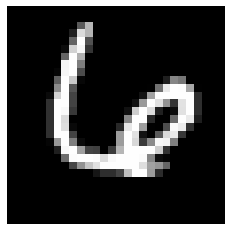

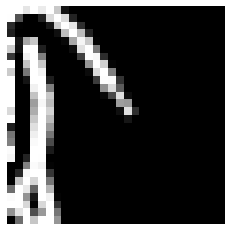

Loss: 0.00020098760639688325
Iteration: 27360, Score: 0.07684977732971313
[104, 137, 155, 41, 42, 172, 107, 56, 49, 24, 22, 20, 17, 54, 0]


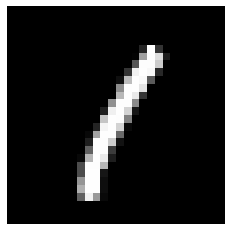

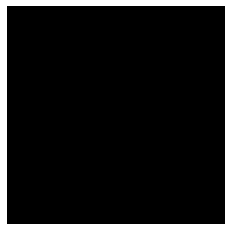

Loss: 0.00018062547765755282
Iteration: 27400, Score: 0.10967538615688681
[158, 54, 77, 107, 69, 135, 45, 77, 51, 47, 25, 46, 20, 89, 0]


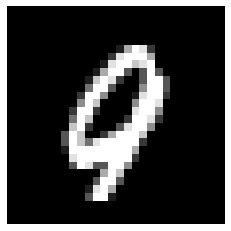

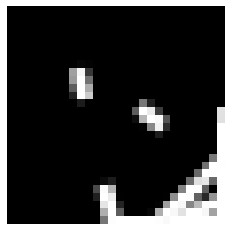

Loss: 0.00019398688471644024
Iteration: 27440, Score: 0.123926526973024
[95, 49, 98, 106, 84, 74, 28, 46, 85, 40, 38, 49, 22, 186, 0]


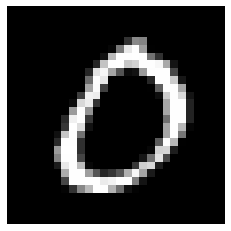

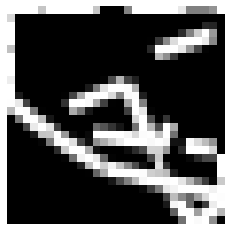

Loss: 0.00021094927148558322
Iteration: 27480, Score: 0.03413522242032922
[100, 142, 39, 77, 89, 53, 106, 51, 62, 24, 24, 38, 30, 165, 0]


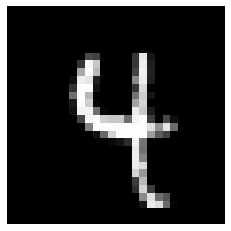

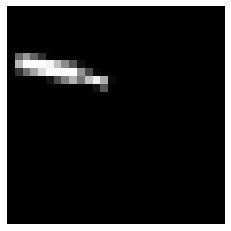

Loss: 0.0002036077052174361
Iteration: 27520, Score: 0.06941811830992808
[78, 160, 68, 57, 40, 53, 136, 48, 38, 27, 23, 57, 37, 178, 0]


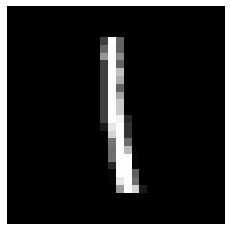

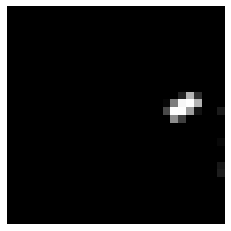

Loss: 0.0002298695548724563
Iteration: 27560, Score: 0.07957002895371988
[158, 65, 29, 50, 60, 59, 82, 46, 41, 72, 37, 42, 33, 226, 0]


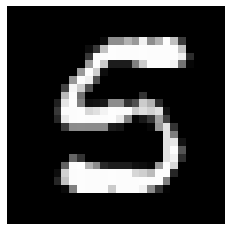

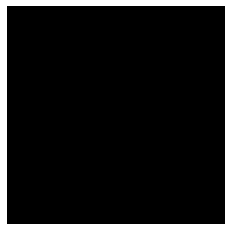

Loss: 0.0002195422371615413
Iteration: 27600, Score: 0.09663784736022353
[75, 64, 176, 89, 62, 130, 68, 17, 34, 84, 21, 51, 20, 109, 0]


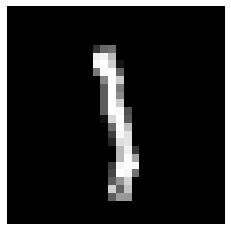

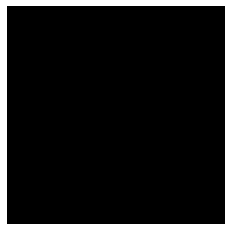

Test score: 0.0
Loss: 0.00016634474266934358
Iteration: 27640, Score: 0.09312957634055055
[83, 63, 134, 121, 104, 67, 82, 54, 48, 54, 19, 33, 29, 109, 0]


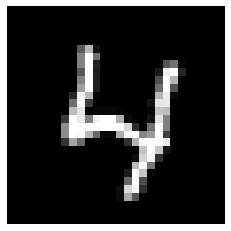

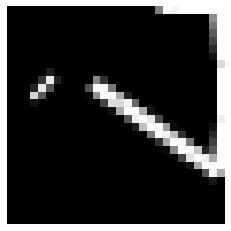

Loss: 0.00019361619541884828
Iteration: 27680, Score: 0.1134474577382207
[67, 152, 95, 118, 49, 80, 145, 67, 38, 32, 18, 40, 18, 81, 0]


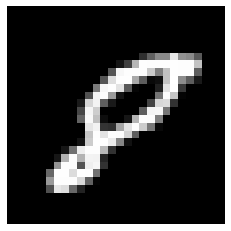

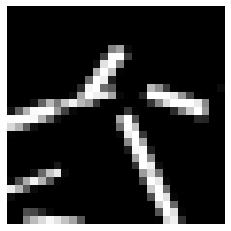

Loss: 0.0001859862866225799
Iteration: 27720, Score: 0.09647199568431826
[119, 72, 128, 70, 49, 173, 47, 33, 21, 35, 35, 29, 28, 161, 0]


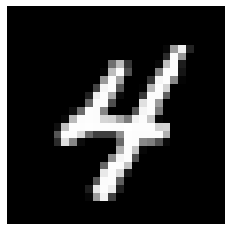

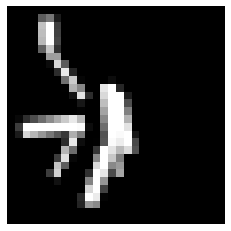

Loss: 0.0002000931528159057
Iteration: 27760, Score: 0.07854962370754218
[84, 33, 127, 56, 23, 175, 88, 34, 23, 155, 22, 56, 26, 98, 0]


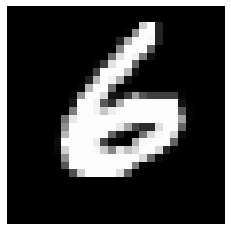

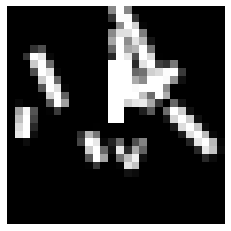

Loss: 0.00026981181888535407
Iteration: 27800, Score: 0.09336339285806752
[99, 31, 64, 39, 32, 108, 49, 44, 101, 97, 29, 58, 26, 223, 0]


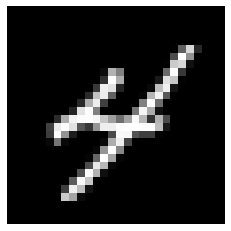

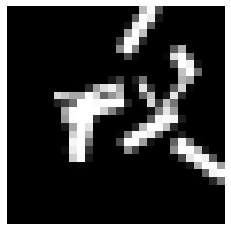

Loss: 0.00020959137036980188
Iteration: 27840, Score: 0.07106437682342946
[81, 99, 69, 73, 60, 92, 134, 44, 83, 44, 70, 15, 24, 112, 0]


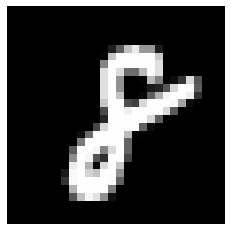

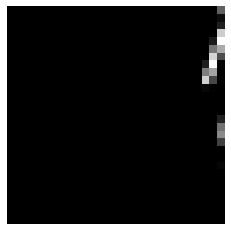

Loss: 0.00016599982257569311
Iteration: 27880, Score: 0.0697950828940011
[136, 75, 67, 154, 78, 119, 79, 35, 25, 69, 62, 25, 21, 55, 0]


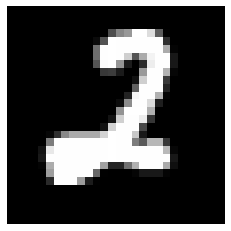

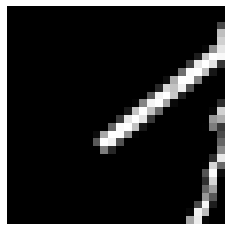

Loss: 0.0002345783564515648
Iteration: 27920, Score: 0.07524451710865834
[137, 87, 76, 94, 38, 155, 118, 66, 49, 53, 24, 32, 20, 51, 0]


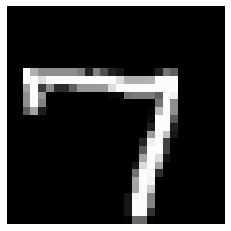

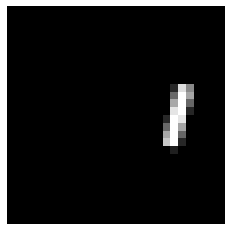

Loss: 0.0002040001048204965
Iteration: 27960, Score: 0.05982512579951436
[89, 61, 67, 114, 126, 95, 80, 57, 56, 77, 31, 23, 19, 105, 0]


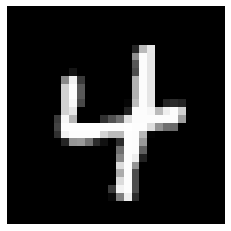

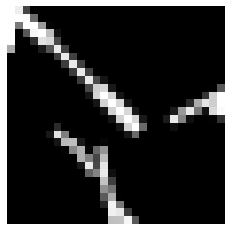

Loss: 0.0002035830725293728
Iteration: 28000, Score: 0.09270360711961988
[69, 104, 74, 62, 91, 100, 45, 82, 66, 68, 43, 25, 27, 144, 0]


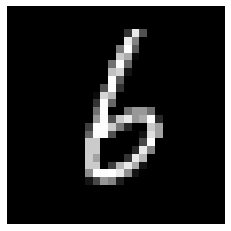

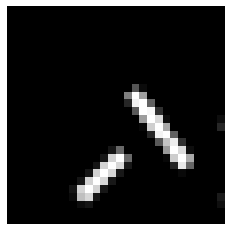

Test score: 0.0
Loss: 0.0001680065867427452
Iteration: 28040, Score: 0.08237118223216384
[70, 67, 31, 113, 121, 80, 32, 68, 29, 46, 76, 41, 35, 191, 0]


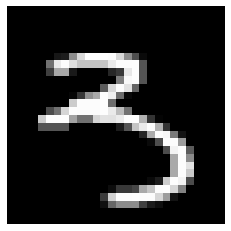

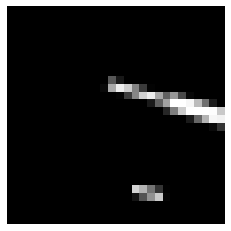

Loss: 0.00018641392208640654
Iteration: 28080, Score: 0.07570488316903357
[61, 80, 27, 177, 162, 62, 60, 64, 35, 41, 91, 33, 38, 69, 0]


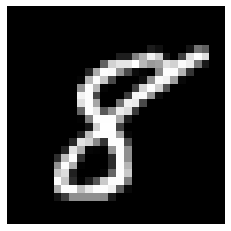

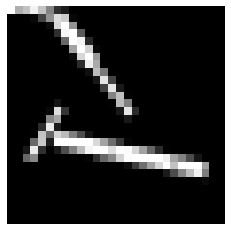

Loss: 0.00024134371457559575
Iteration: 28120, Score: 0.08050938936352033
[96, 46, 54, 129, 71, 77, 43, 78, 116, 49, 113, 32, 25, 71, 0]


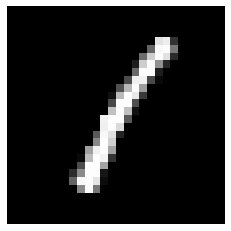

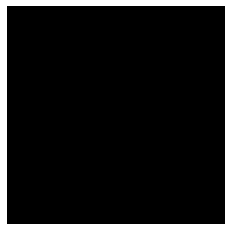

Loss: 0.00015558454230294672
Iteration: 28160, Score: 0.07758484050375408
[80, 69, 120, 91, 102, 87, 49, 49, 72, 27, 38, 126, 25, 65, 0]


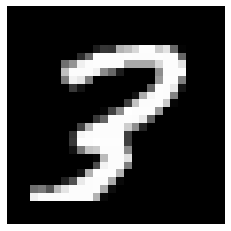

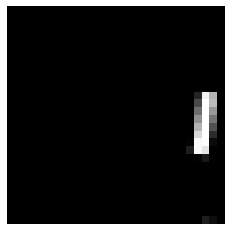

Loss: 0.00020391540951104187
Iteration: 28200, Score: 0.06183121190909878
[53, 153, 92, 92, 132, 93, 63, 95, 38, 63, 24, 56, 16, 30, 0]


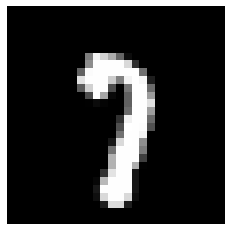

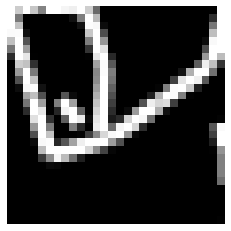

Loss: 0.0001521855896022327
Iteration: 28240, Score: 0.07361914937731491
[90, 151, 55, 96, 90, 73, 219, 76, 27, 33, 26, 20, 15, 29, 0]


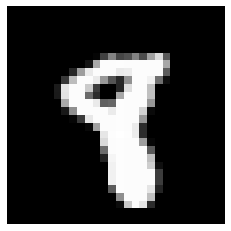

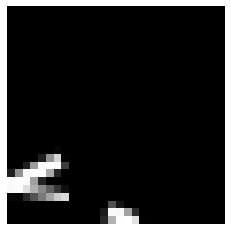

Loss: 0.00016553731137187682
Iteration: 28280, Score: 0.06643715071456974
[64, 83, 44, 43, 36, 81, 95, 56, 248, 25, 23, 58, 26, 118, 0]


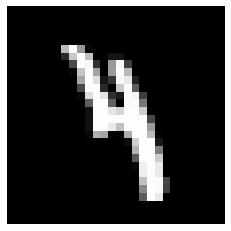

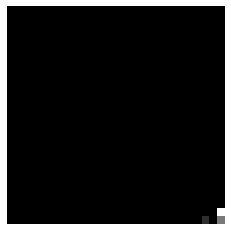

Loss: 0.0001608252959930581
Iteration: 28320, Score: 0.06074125509196891
[52, 47, 171, 57, 16, 195, 24, 48, 74, 49, 29, 26, 28, 184, 0]


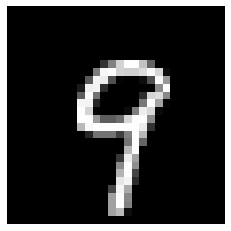

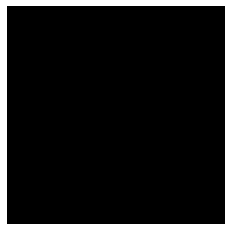

Loss: 0.00022447215246263329
Iteration: 28360, Score: 0.08154365138337015
[46, 55, 106, 109, 111, 175, 45, 47, 30, 41, 26, 29, 18, 162, 0]


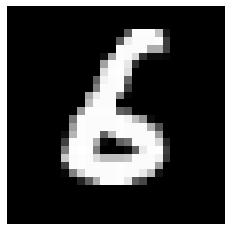

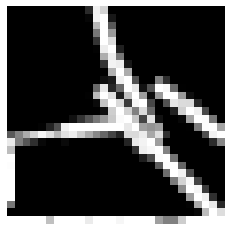

Loss: 0.00018404161602152865
Iteration: 28400, Score: 0.06737363673397341
[44, 122, 27, 87, 129, 73, 90, 90, 63, 45, 49, 24, 46, 111, 0]


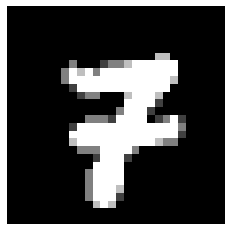

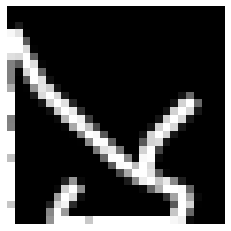

Test score: 0.0
Loss: 0.00016969214597729843
Iteration: 28440, Score: 0.0907101962424349
[36, 54, 67, 140, 146, 105, 90, 71, 42, 36, 20, 30, 27, 136, 0]


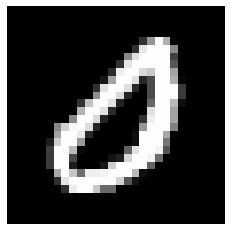

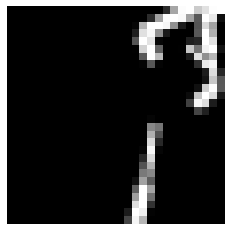

Loss: 0.00022449239258607483
Iteration: 28480, Score: 0.10114508382277565
[58, 34, 35, 161, 168, 130, 69, 69, 40, 38, 15, 25, 15, 143, 0]


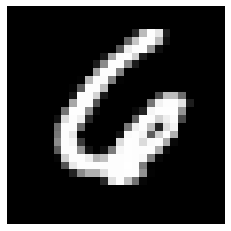

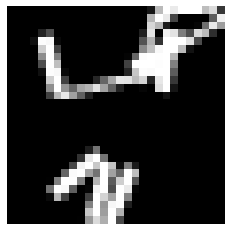

Loss: 0.00018743091224022697
Iteration: 28520, Score: 0.055187316809489864
[35, 24, 68, 118, 126, 174, 36, 106, 22, 59, 41, 25, 38, 128, 0]


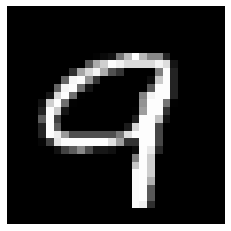

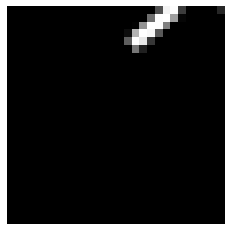

Loss: 0.0001584446487662591
Iteration: 28560, Score: 0.09344347163010389
[68, 77, 55, 60, 43, 173, 72, 158, 34, 55, 41, 41, 18, 105, 0]


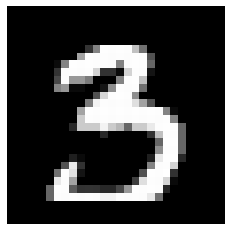

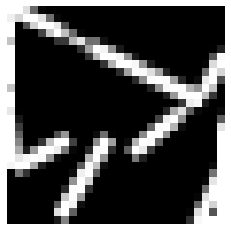

Loss: 0.000210880224024115
Iteration: 28600, Score: 0.05937669769302012
[108, 156, 53, 30, 36, 121, 230, 66, 31, 65, 11, 23, 12, 58, 0]


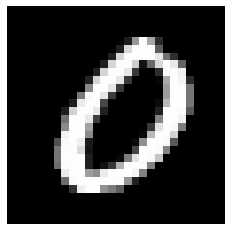

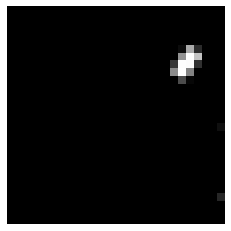

Loss: 0.00017754506332272825
Iteration: 28640, Score: 0.08606339741754346
[91, 81, 46, 65, 77, 62, 162, 89, 39, 96, 16, 80, 19, 77, 0]


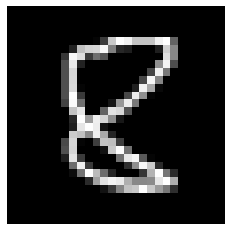

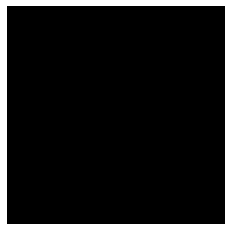

Loss: 0.00014608806883278938
Iteration: 28680, Score: 0.10153100890619682
[52, 40, 92, 85, 60, 101, 89, 71, 51, 56, 38, 38, 69, 158, 0]


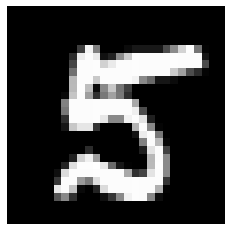

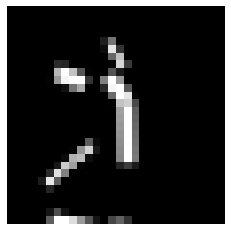

Loss: 0.0001665533199671891
Iteration: 28720, Score: 0.09381312221603
[58, 34, 135, 57, 92, 224, 89, 94, 24, 59, 15, 18, 24, 77, 0]


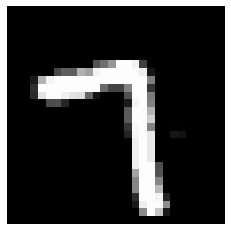

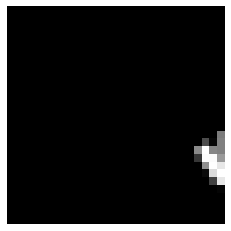

Loss: 0.0001588192238276502
Iteration: 28760, Score: 0.10284903458878396
[58, 128, 26, 41, 48, 41, 192, 66, 58, 39, 24, 31, 27, 221, 0]


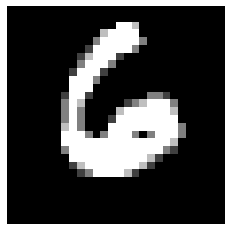

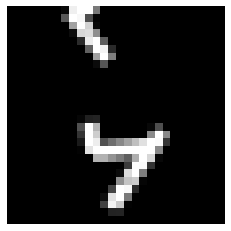

Loss: 0.0001752469911639532
Iteration: 28800, Score: 0.08888493669498712
[92, 63, 89, 20, 29, 198, 147, 82, 60, 64, 22, 20, 16, 98, 0]


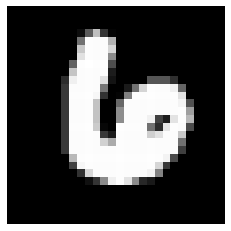

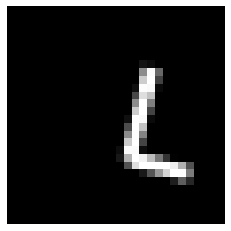

Test score: 0.0
Loss: 0.00015508633220713306
Iteration: 28840, Score: 0.11623777445405721
[78, 47, 121, 64, 76, 128, 107, 42, 35, 49, 23, 34, 18, 178, 0]


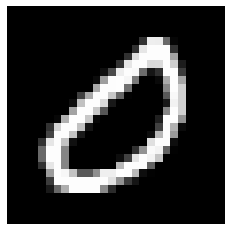

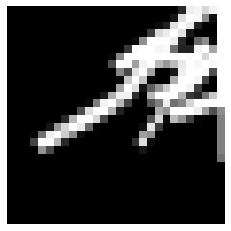

Loss: 0.00018405666470871322
Iteration: 28880, Score: 0.08886689005047083
[64, 70, 144, 58, 41, 121, 111, 90, 40, 59, 14, 110, 18, 60, 0]


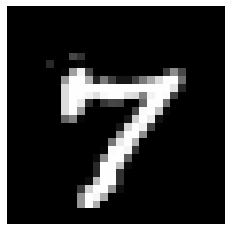

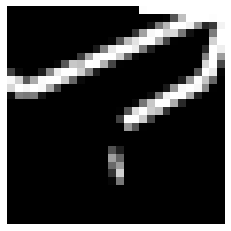

Loss: 0.00015448677843630436
Iteration: 28920, Score: 0.08377136342320592
[75, 89, 65, 35, 64, 108, 88, 94, 32, 83, 31, 154, 18, 64, 0]


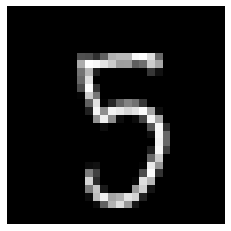

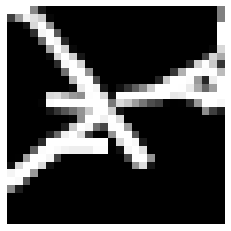

Loss: 0.00015942127057440091
Iteration: 28960, Score: 0.09205142900347707
[94, 45, 90, 45, 37, 113, 37, 108, 35, 86, 23, 60, 24, 203, 0]


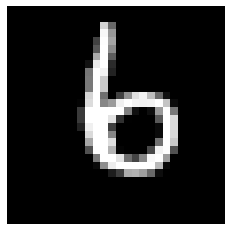

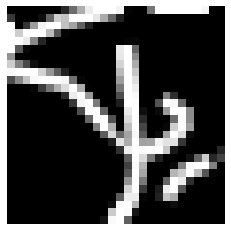

Loss: 0.0002035077638708533
Iteration: 29000, Score: 0.08140193504001944
[53, 47, 99, 106, 76, 83, 106, 32, 55, 68, 24, 28, 25, 198, 0]


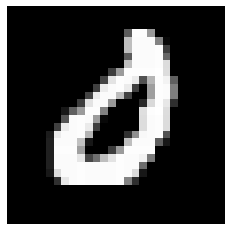

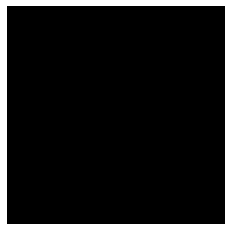

Loss: 0.00020045901547583806
Iteration: 29040, Score: 0.06792661667242647
[43, 100, 117, 28, 51, 170, 56, 135, 38, 24, 15, 29, 31, 163, 0]


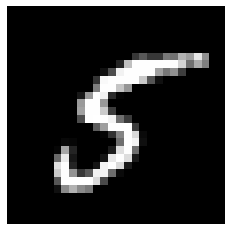

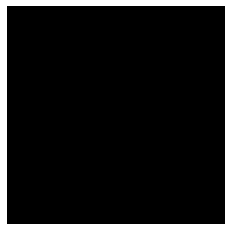

Loss: 0.00016007500066844496
Iteration: 29080, Score: 0.11937001762166621
[62, 51, 139, 22, 80, 192, 60, 93, 38, 19, 26, 65, 20, 133, 0]


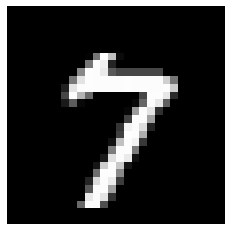

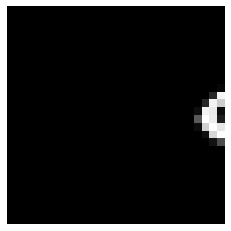

Loss: 0.00018306996105650083
Iteration: 29120, Score: 0.037865231553936604
[99, 34, 94, 20, 35, 171, 48, 81, 38, 58, 33, 169, 20, 100, 0]


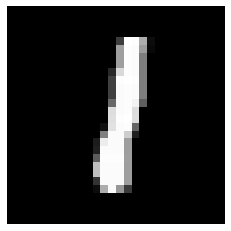

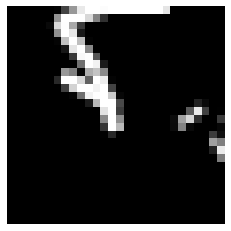

Loss: 0.00016685043722439467
Iteration: 29160, Score: 0.07448857730762391
[62, 58, 153, 18, 31, 194, 88, 55, 77, 26, 15, 32, 15, 176, 0]


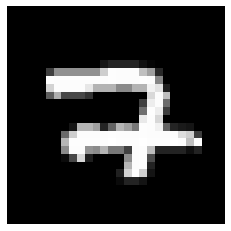

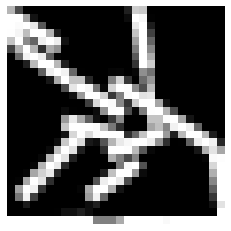

Loss: 0.000200427289283545
Iteration: 29200, Score: 0.0771842447621748
[118, 179, 127, 33, 27, 92, 29, 75, 88, 49, 22, 49, 22, 90, 0]


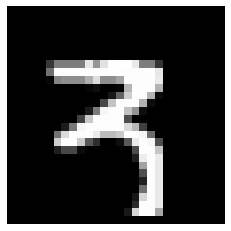

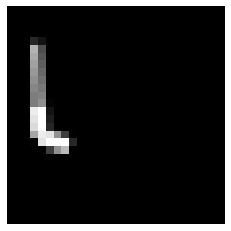

Test score: 0.0
Loss: 0.00020257229753187326
Iteration: 29240, Score: 0.08384553209575826
[67, 155, 51, 109, 84, 66, 148, 84, 42, 52, 15, 19, 15, 93, 0]


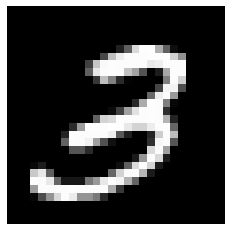

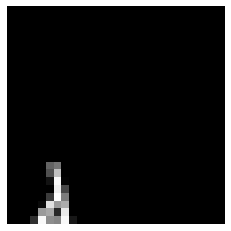

Loss: 0.00018443771370992397
Iteration: 29280, Score: 0.08404175274912266
[42, 124, 80, 106, 103, 78, 115, 52, 30, 66, 33, 27, 16, 128, 0]


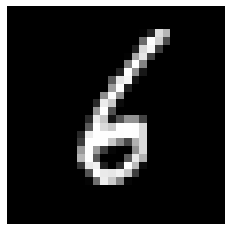

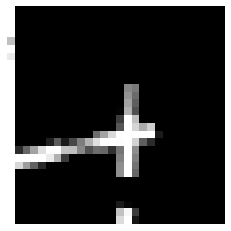

Loss: 0.00016610676214977543
Iteration: 29320, Score: 0.09007258370984345
[53, 115, 63, 65, 72, 95, 136, 44, 62, 35, 17, 111, 18, 114, 0]


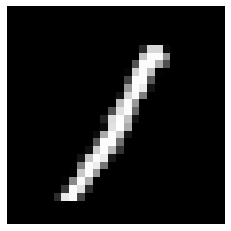

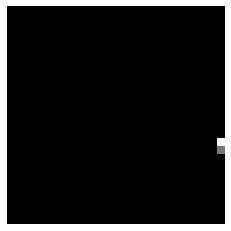

Loss: 0.00014404013356589007
Iteration: 29360, Score: 0.07631706869881599
[56, 98, 64, 74, 37, 71, 70, 41, 82, 90, 29, 55, 18, 215, 0]


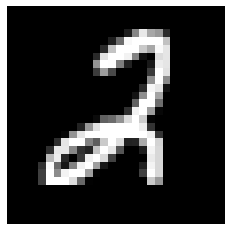

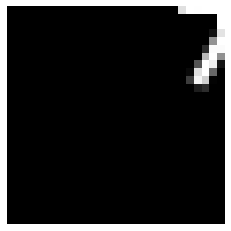

Loss: 0.00015344427760319732
Iteration: 29400, Score: 0.09060948483459651
[60, 158, 102, 37, 31, 115, 67, 106, 35, 70, 17, 100, 18, 84, 0]


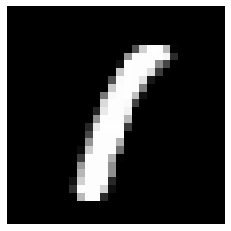

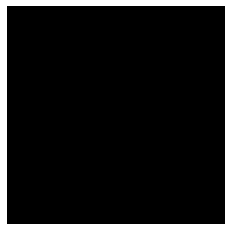

Loss: 0.00014712719560641699
Iteration: 29440, Score: 0.07900827339291573
[60, 25, 50, 152, 109, 66, 51, 82, 36, 41, 27, 64, 31, 206, 0]


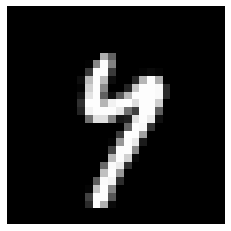

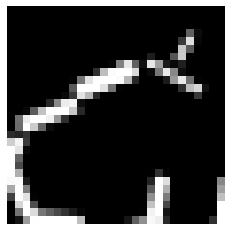

Loss: 0.00017800128602386595
Iteration: 29480, Score: 0.06202431427815462
[44, 24, 42, 102, 54, 48, 121, 77, 101, 54, 33, 33, 27, 240, 0]


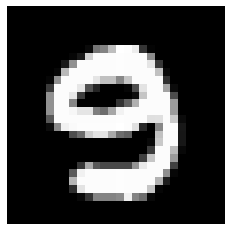

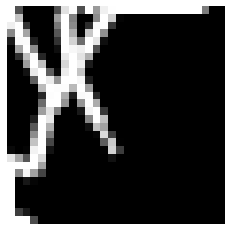

Loss: 0.0001955850312577422
Iteration: 29520, Score: 0.15191050252318378
[57, 41, 145, 107, 75, 119, 26, 75, 47, 33, 25, 20, 21, 209, 0]


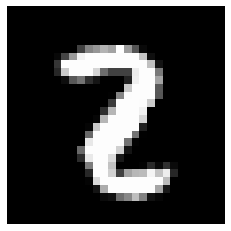

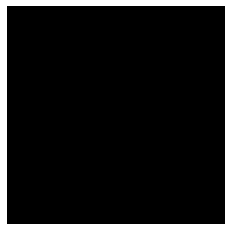

Loss: 0.00018063488968833387
Iteration: 29560, Score: 0.12931442403048274
[41, 105, 102, 47, 39, 92, 104, 55, 63, 134, 106, 17, 18, 77, 0]


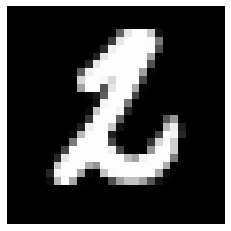

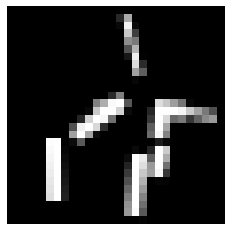

Loss: 0.0001857671460655338
Iteration: 29600, Score: 0.11360962313041092
[31, 41, 96, 190, 130, 104, 32, 29, 67, 47, 39, 14, 21, 159, 0]


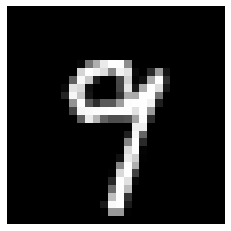

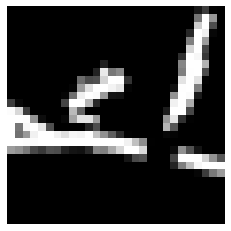

Test score: 0.0
Loss: 0.00020854989354017323
Iteration: 29640, Score: 0.09436039267852903
[73, 60, 85, 77, 84, 25, 50, 41, 34, 38, 24, 228, 30, 151, 0]


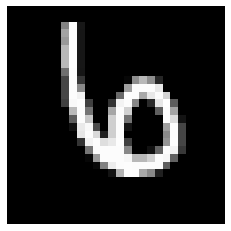

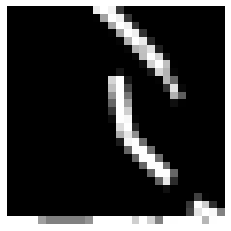

Loss: 0.00017121124766986153
Iteration: 29680, Score: 0.08397685200534762
[137, 74, 243, 20, 38, 248, 74, 40, 17, 21, 14, 16, 15, 43, 0]


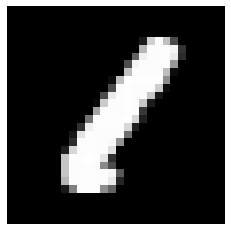

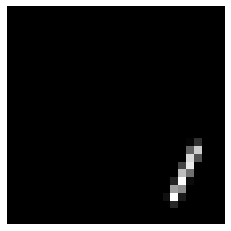

Loss: 0.00015853624410937925
Iteration: 29720, Score: 0.10656604506075382
[158, 46, 112, 51, 53, 101, 54, 52, 35, 182, 25, 27, 27, 77, 0]


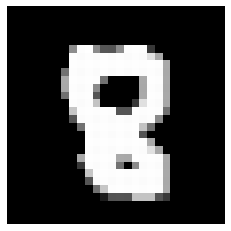

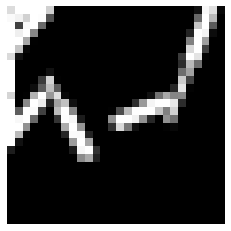

Loss: 0.00015486511520963398
Iteration: 29760, Score: 0.09045714859885631
[88, 27, 70, 172, 216, 46, 29, 35, 31, 33, 24, 28, 20, 181, 0]


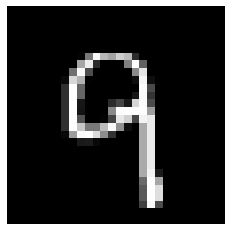

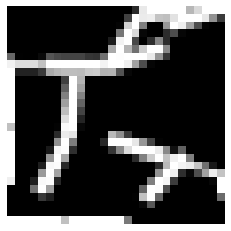

Loss: 0.00015764457556085264
Iteration: 29800, Score: 0.12926450017094615
[40, 70, 113, 89, 125, 111, 45, 56, 19, 27, 22, 29, 22, 232, 0]


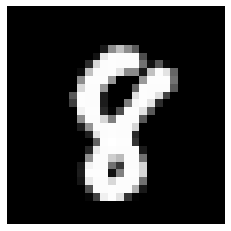

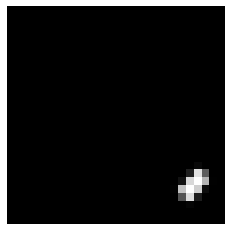

Loss: 0.0001463192083393599
Iteration: 29840, Score: 0.08776999670756049
[46, 28, 79, 94, 137, 77, 33, 42, 50, 64, 34, 25, 38, 253, 0]


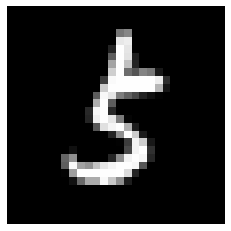

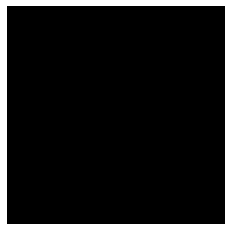

Loss: 0.00014462018472929716
Iteration: 29880, Score: 0.09107353220134974
[75, 74, 39, 100, 185, 36, 68, 42, 32, 86, 32, 26, 27, 178, 0]


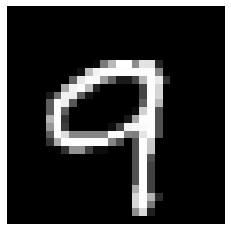

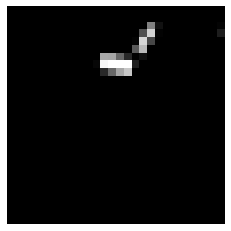

Loss: 0.00012818396026592505
Iteration: 29920, Score: 0.13073458827286957
[76, 100, 63, 59, 95, 53, 62, 39, 36, 22, 104, 58, 52, 181, 0]


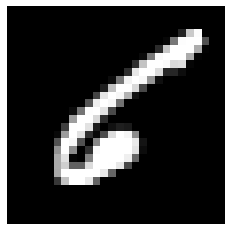

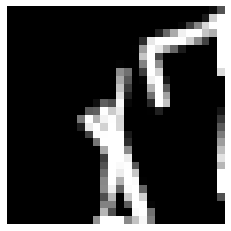

Loss: 0.00012551734672632195
Iteration: 29960, Score: 0.06839785428252071
[54, 59, 82, 63, 92, 64, 44, 46, 38, 93, 171, 34, 41, 119, 0]


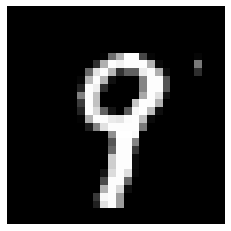

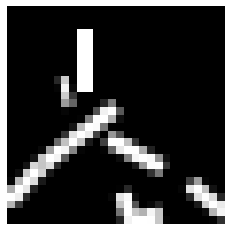

Loss: 0.0001588126057318167
Iteration: 30000, Score: 0.06938081659004092
[45, 68, 92, 63, 126, 88, 85, 127, 52, 45, 13, 26, 22, 148, 0]


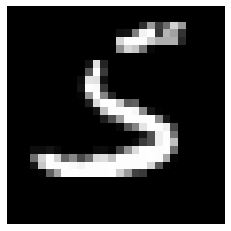

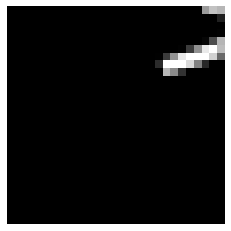

Test score: 0.0
Loss: 0.00014234470103958598
Iteration: 30040, Score: 0.08850543858029415
[57, 75, 80, 105, 145, 72, 43, 39, 64, 27, 18, 26, 24, 225, 0]


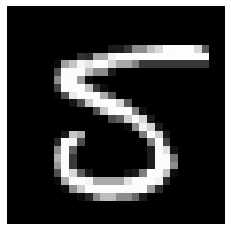

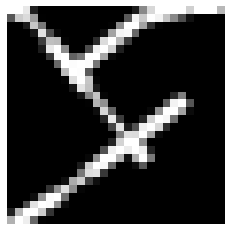

Loss: 0.00014128301802160412
Iteration: 30080, Score: 0.07002720925863833
[62, 83, 62, 81, 67, 125, 40, 59, 43, 48, 28, 27, 29, 246, 0]


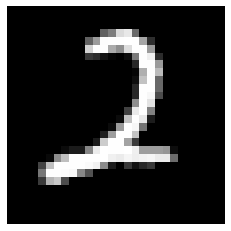

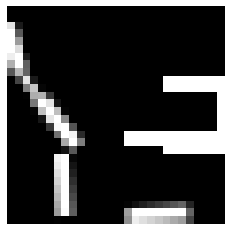

Loss: 0.00012151789144001757
Iteration: 30120, Score: 0.06424151384085416
[65, 90, 118, 75, 97, 86, 45, 53, 21, 119, 23, 26, 28, 154, 0]


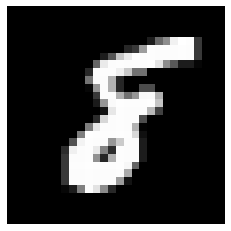

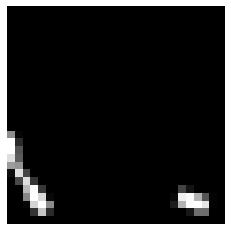

Loss: 0.00013714782613554344
Iteration: 30160, Score: 0.12151818678760902
[46, 53, 42, 32, 135, 46, 88, 53, 46, 186, 36, 49, 28, 160, 0]


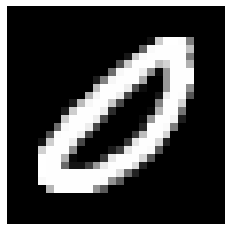

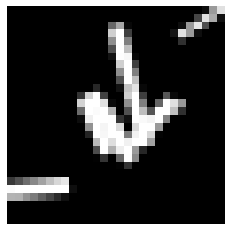

Loss: 0.00015399561064713483
Iteration: 30200, Score: 0.09517692274891305
[58, 62, 76, 98, 36, 82, 54, 97, 38, 130, 26, 52, 26, 165, 0]


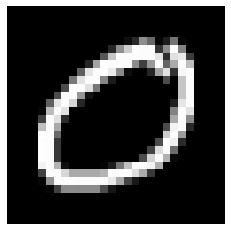

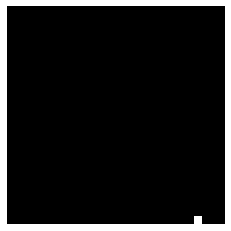

Loss: 0.00013919879294918571
Iteration: 30240, Score: 0.07261273825936951
[52, 51, 88, 25, 29, 145, 44, 61, 50, 199, 33, 43, 22, 158, 0]


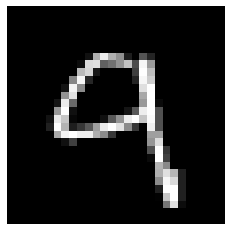

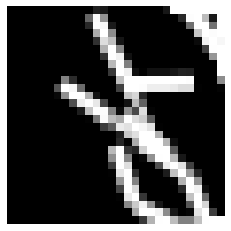

Loss: 0.00015413270846578403
Iteration: 30280, Score: 0.10779514209133052
[178, 71, 44, 80, 137, 44, 94, 42, 32, 133, 20, 39, 21, 65, 0]


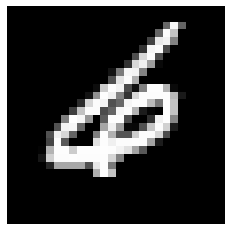

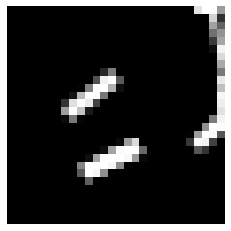

Loss: 0.00012301767531925967
Iteration: 30320, Score: 0.10881825411505999
[69, 123, 48, 28, 69, 62, 89, 62, 61, 116, 59, 27, 26, 161, 0]


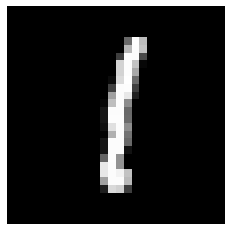

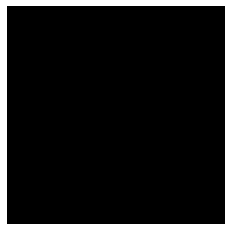

Loss: 0.00013655244983655507
Iteration: 30360, Score: 0.09548832489922641
[48, 78, 59, 73, 68, 67, 27, 93, 84, 138, 34, 27, 29, 175, 0]


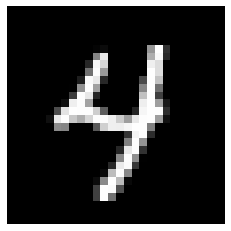

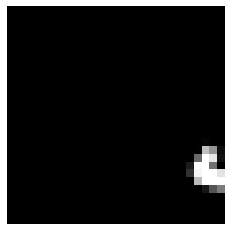

Loss: 0.00011703956934477109
Iteration: 30400, Score: 0.072965938853682
[54, 46, 111, 31, 77, 154, 35, 50, 58, 111, 39, 19, 26, 189, 0]


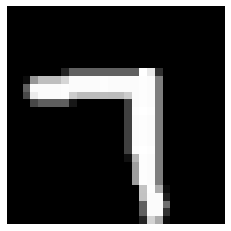

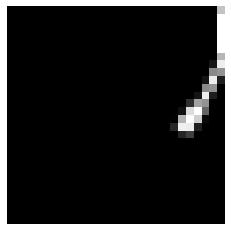

Test score: 0.0
Loss: 0.0001516183588785171
Iteration: 30440, Score: 0.06937264299206436
[94, 35, 144, 48, 33, 120, 51, 55, 44, 70, 42, 33, 37, 194, 0]


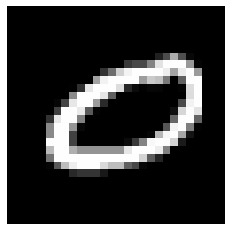

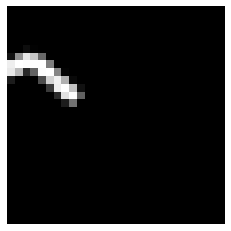

Loss: 0.00011199472787803132
Iteration: 30480, Score: 0.1026514595017943
[60, 68, 92, 26, 27, 89, 43, 105, 80, 109, 49, 20, 26, 206, 0]


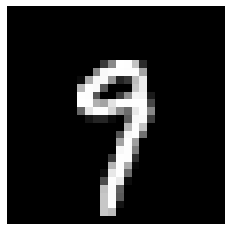

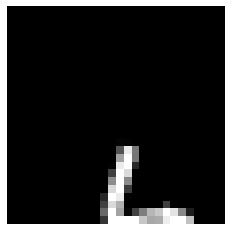

Loss: 0.00011561159067095413
Iteration: 30520, Score: 0.08383547777682543
[26, 52, 64, 114, 200, 110, 48, 46, 89, 33, 24, 51, 93, 50, 0]


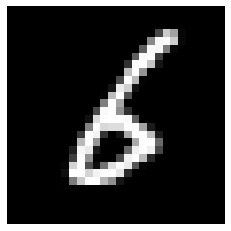

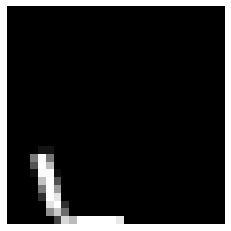

Loss: 0.0001382426626522467
Iteration: 30560, Score: 0.09371706762100804
[29, 41, 129, 58, 69, 88, 46, 51, 159, 67, 37, 42, 46, 138, 0]


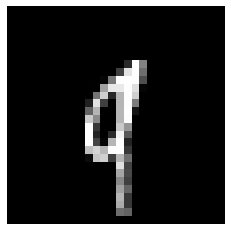

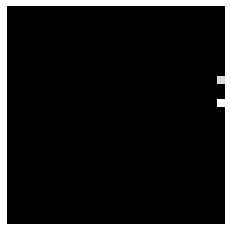

Loss: 0.00014094287068919085
Iteration: 30600, Score: 0.09786544150114058
[113, 28, 63, 43, 63, 61, 79, 43, 68, 156, 28, 37, 32, 186, 0]


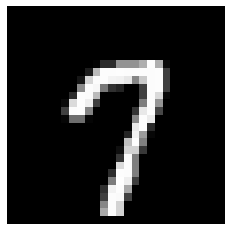

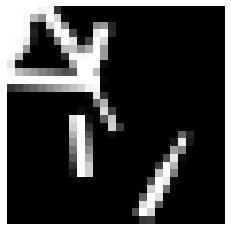

Loss: 0.00014053806471246832
Iteration: 30640, Score: 0.09224409765121526
[62, 180, 53, 37, 51, 31, 215, 32, 44, 68, 27, 29, 19, 152, 0]


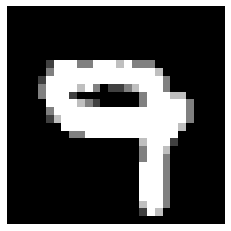

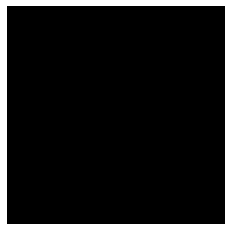

Loss: 0.00011209414836717845
Iteration: 30680, Score: 0.09671547194197774
[64, 123, 165, 19, 28, 140, 63, 79, 36, 65, 16, 137, 23, 42, 0]


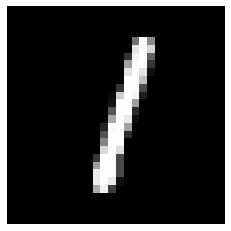

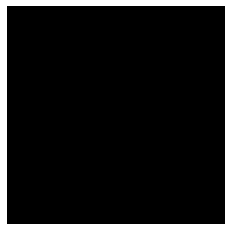

Loss: 0.00010772451977085491
Iteration: 30720, Score: 0.13354151498973077
[79, 44, 80, 53, 123, 47, 90, 31, 68, 67, 38, 144, 32, 104, 0]


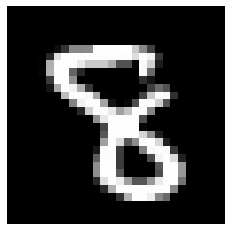

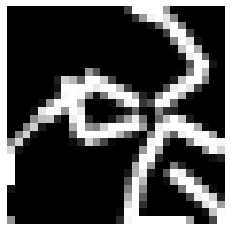

Loss: 0.0001226102932562815
Iteration: 30760, Score: 0.06706525843343115
[105, 84, 74, 50, 54, 71, 76, 33, 63, 108, 17, 166, 29, 70, 0]


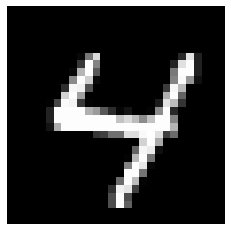

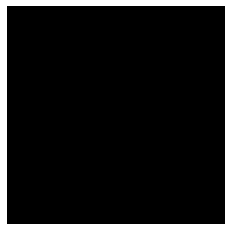

Loss: 0.00010806493356309127
Iteration: 30800, Score: 0.07312110546535405
[92, 54, 102, 62, 29, 130, 34, 33, 58, 107, 34, 95, 23, 147, 0]


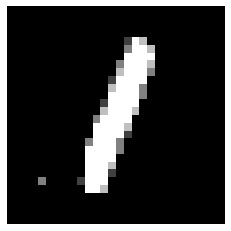

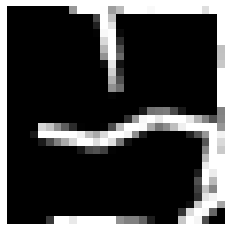

Test score: 0.0
Loss: 0.00011533102524860049
Iteration: 30840, Score: 0.07459641866676975
[80, 36, 133, 42, 39, 186, 40, 106, 36, 37, 17, 22, 26, 200, 0]


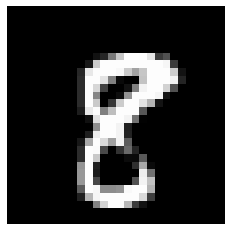

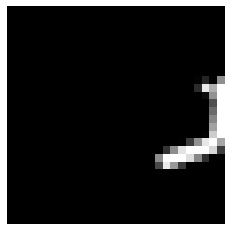

Loss: 0.00011414477435252412
Iteration: 30880, Score: 0.1440355257932097
[80, 65, 44, 27, 40, 66, 51, 105, 42, 116, 20, 46, 36, 262, 0]


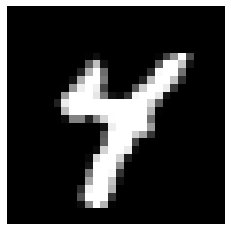

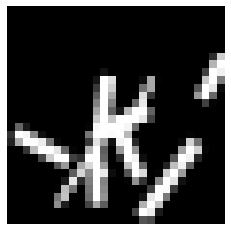

Loss: 0.00011692785858211183
Iteration: 30920, Score: 0.09429135682666676
[74, 123, 59, 20, 39, 84, 124, 61, 103, 100, 21, 26, 35, 131, 0]


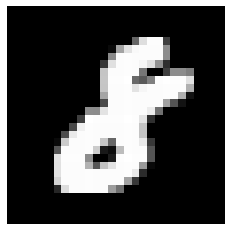

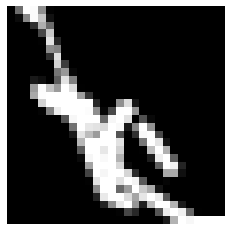

Loss: 0.00013732353755186604
Iteration: 30960, Score: 0.064344225008972
[68, 33, 113, 95, 69, 152, 65, 65, 84, 35, 32, 32, 15, 142, 0]


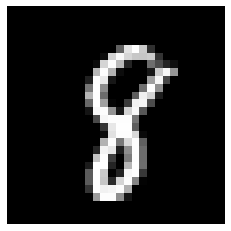

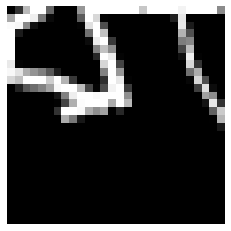

Loss: 0.00014809909688294815
Iteration: 31000, Score: 0.07547317628865129
[136, 26, 55, 220, 94, 102, 33, 91, 68, 40, 26, 23, 21, 65, 0]


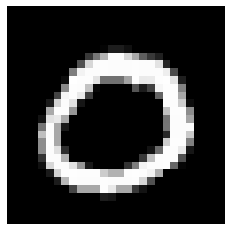

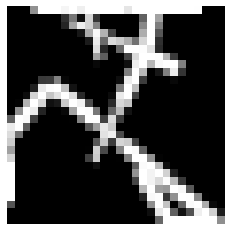

Loss: 0.00010286111800046078
Iteration: 31040, Score: 0.11344201733358206
[114, 53, 38, 117, 119, 86, 40, 123, 33, 53, 27, 13, 29, 155, 0]


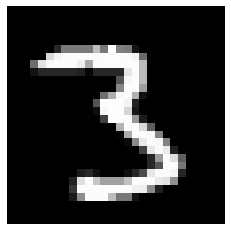

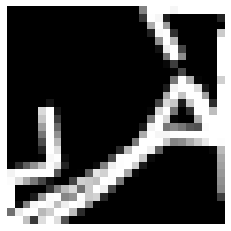

Loss: 0.00011829822210916661
Iteration: 31080, Score: 0.0694726630328223
[47, 56, 59, 112, 107, 112, 49, 59, 54, 52, 24, 21, 68, 180, 0]


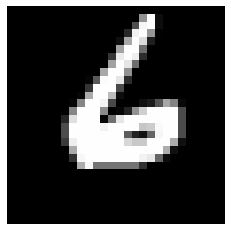

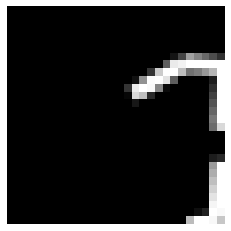

Loss: 0.00012480673692978633
Iteration: 31120, Score: 0.06836076793749818
[58, 22, 73, 125, 137, 89, 36, 96, 61, 25, 22, 38, 34, 184, 0]


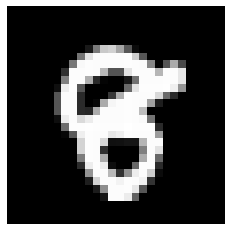

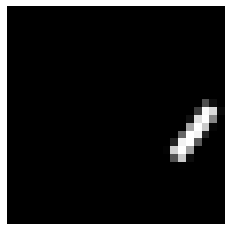

Loss: 0.00011633172830923544
Iteration: 31160, Score: 0.07896766945533454
[85, 71, 40, 73, 74, 83, 77, 67, 59, 27, 40, 29, 50, 225, 0]


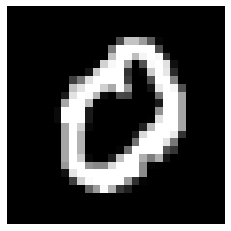

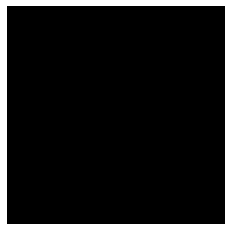

Loss: 0.00012825001681298219
Iteration: 31200, Score: 0.10534171429811975
[84, 98, 128, 54, 19, 142, 74, 102, 36, 32, 30, 43, 31, 127, 0]


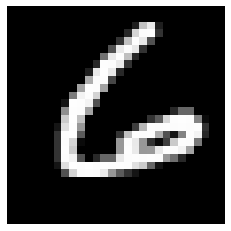

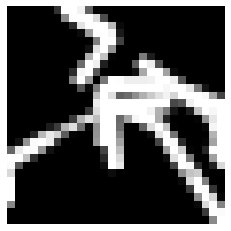

Test score: 0.0
Loss: 0.000126214710259344
Iteration: 31240, Score: 0.10395927729830146
[34, 87, 178, 41, 25, 122, 125, 122, 61, 50, 21, 26, 17, 91, 0]


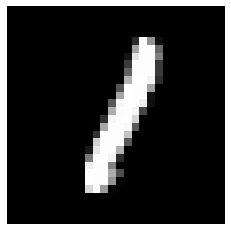

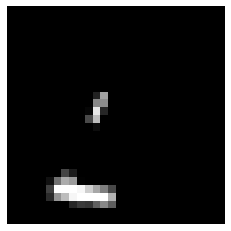

Loss: 0.00011115003324589793
Iteration: 31280, Score: 0.13752777366712687
[56, 27, 26, 174, 172, 46, 59, 73, 44, 35, 19, 28, 43, 198, 0]


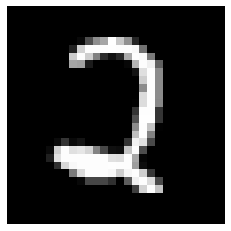

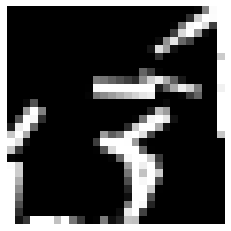

Loss: 0.00011498328289663582
Iteration: 31320, Score: 0.10528652964020146
[48, 41, 32, 229, 233, 59, 54, 76, 30, 18, 22, 16, 14, 128, 0]


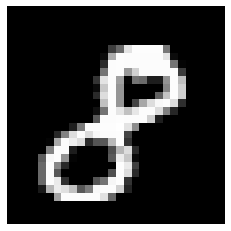

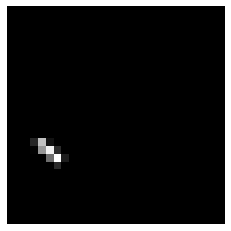

Loss: 0.00010232339193813803
Iteration: 31360, Score: 0.102574191307649
[62, 107, 31, 101, 98, 34, 126, 148, 52, 33, 26, 21, 19, 142, 0]


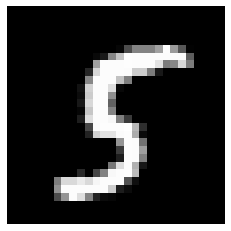

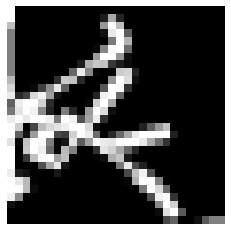

Loss: 0.00011297137458521339
Iteration: 31400, Score: 0.07151022627763451
[102, 47, 49, 40, 27, 51, 66, 181, 65, 39, 35, 53, 28, 217, 0]


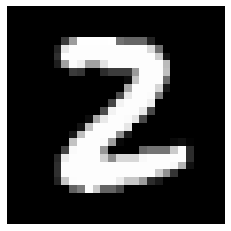

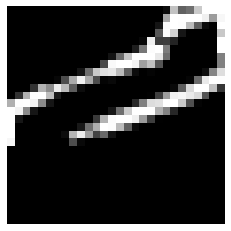

Loss: 9.587685190228771e-05
Iteration: 31440, Score: 0.12414480030536648
[94, 34, 24, 81, 71, 65, 81, 83, 84, 84, 48, 38, 20, 193, 0]


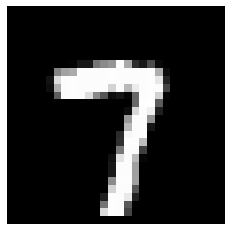

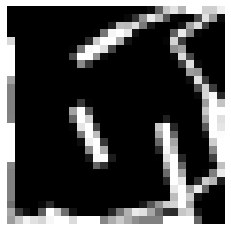

Loss: 0.00011835390279878802
Iteration: 31480, Score: 0.11838371919095517
[69, 50, 77, 83, 103, 104, 75, 65, 69, 54, 21, 88, 34, 108, 0]


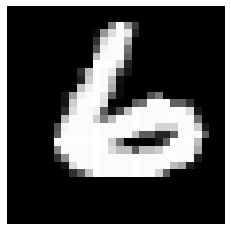

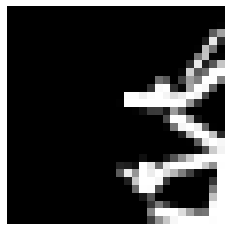

Loss: 8.646987022255168e-05
Iteration: 31520, Score: 0.10564506847597659
[71, 96, 126, 19, 44, 168, 109, 41, 41, 25, 17, 111, 49, 83, 0]


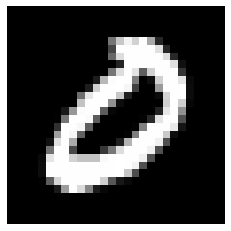

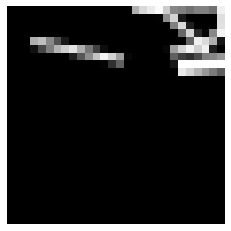

Loss: 0.00011391882145940267
Iteration: 31560, Score: 0.12043013980984688
[101, 65, 103, 55, 40, 87, 86, 75, 58, 40, 26, 36, 96, 132, 0]


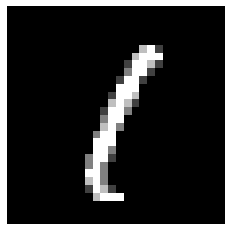

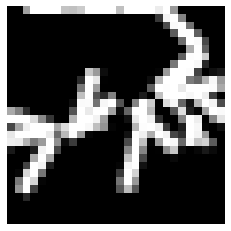

Loss: 0.00012342693483255712
Iteration: 31600, Score: 0.12073652436607515
[91, 58, 38, 42, 81, 83, 66, 56, 69, 56, 24, 57, 95, 184, 0]


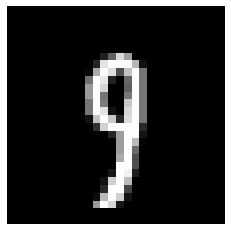

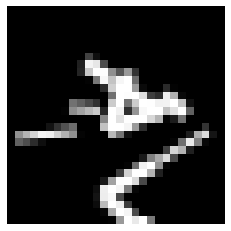

Test score: 0.0
Loss: 0.0001153072388167825
Iteration: 31640, Score: 0.08816178895533086
[56, 60, 52, 70, 228, 82, 50, 37, 55, 61, 32, 56, 43, 118, 0]


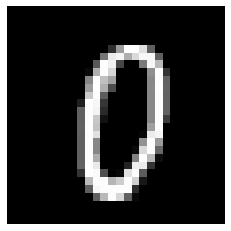

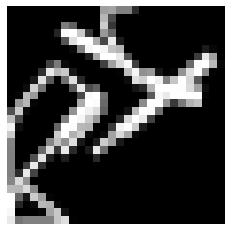

Loss: 0.00014945146681543436
Iteration: 31680, Score: 0.08473100057244301
[175, 54, 46, 129, 132, 59, 31, 32, 50, 65, 45, 34, 17, 131, 0]


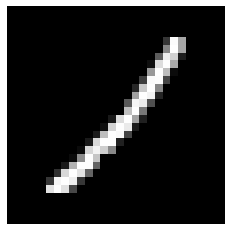

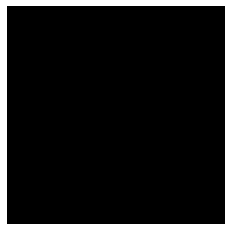

Loss: 0.00010885291177533321
Iteration: 31720, Score: 0.10353032290004194
[172, 56, 109, 124, 129, 108, 72, 19, 21, 23, 16, 39, 12, 100, 0]


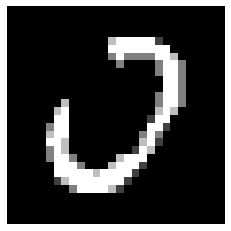

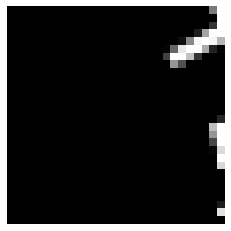

Loss: 0.00011573994597292243
Iteration: 31760, Score: 0.09657890831679106
[84, 94, 104, 91, 91, 104, 83, 28, 49, 17, 28, 74, 69, 84, 0]


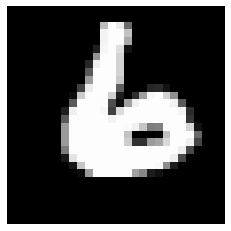

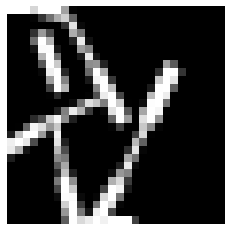

Loss: 9.534300175222294e-05
Iteration: 31800, Score: 0.15018364938837475
[85, 74, 111, 65, 65, 98, 40, 46, 75, 43, 37, 46, 85, 130, 0]


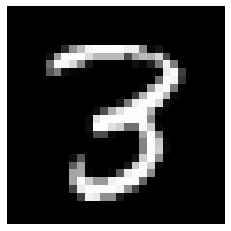

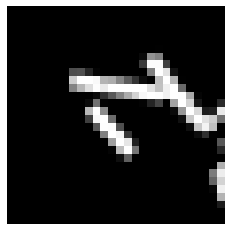

Loss: 0.00010878838274452465
Iteration: 31840, Score: 0.1299274043303449
[74, 25, 85, 43, 30, 84, 43, 59, 92, 157, 44, 33, 24, 207, 0]


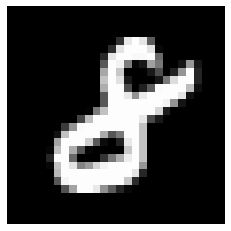

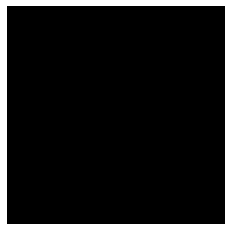

Loss: 0.00011291121848833738
Iteration: 31880, Score: 0.08057325736433268
[59, 53, 104, 49, 30, 103, 38, 44, 63, 96, 36, 35, 37, 253, 0]


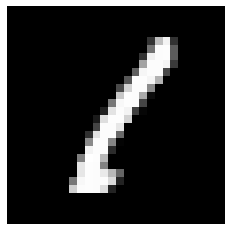

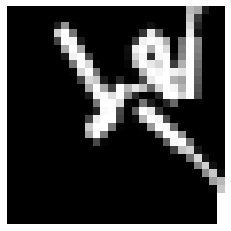

Loss: 0.00012610564605472892
Iteration: 31920, Score: 0.07156776254624128
[89, 154, 100, 78, 92, 107, 24, 27, 41, 25, 27, 38, 34, 164, 0]


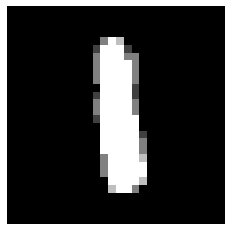

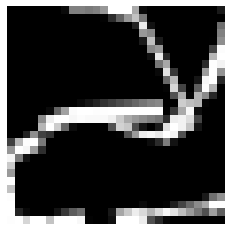

Loss: 0.00012086657358710985
Iteration: 31960, Score: 0.08714818001538514
[71, 53, 153, 58, 66, 168, 16, 31, 32, 48, 90, 45, 40, 129, 0]


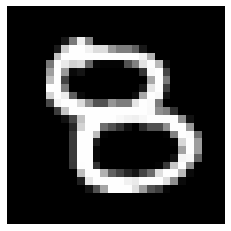

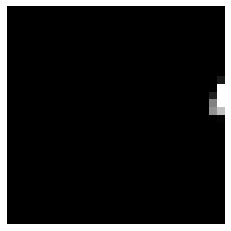

Loss: 0.00012209797168783525
Iteration: 32000, Score: 0.12453604654793163
[89, 75, 116, 26, 44, 112, 73, 44, 87, 81, 65, 28, 92, 68, 0]


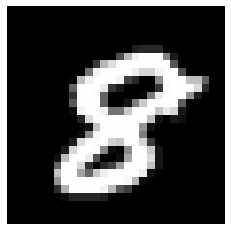

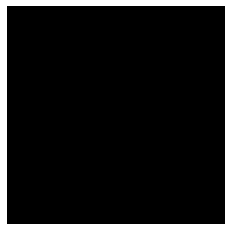

Test score: 0.0
Loss: 0.00013132478587269097
Iteration: 32040, Score: 0.19075160676613456
[70, 149, 87, 17, 32, 24, 157, 25, 81, 48, 118, 45, 51, 96, 0]


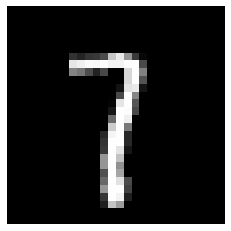

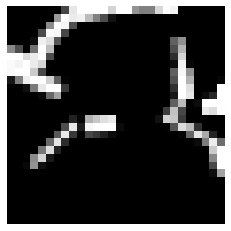

Loss: 0.00011620494439700926
Iteration: 32080, Score: 0.15517977575596886
[42, 79, 89, 55, 69, 67, 118, 63, 93, 36, 84, 71, 43, 91, 0]


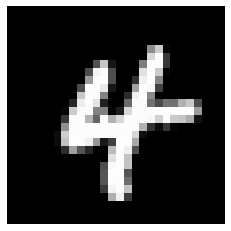

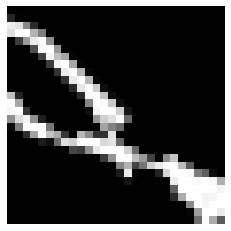

Loss: 0.00012131987393627061
Iteration: 32120, Score: 0.13765028211474417
[65, 93, 38, 45, 74, 63, 113, 84, 46, 29, 49, 92, 49, 160, 0]


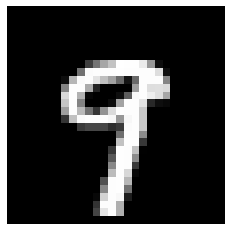

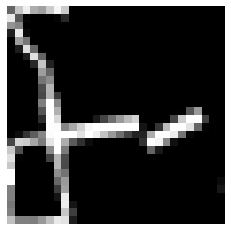

Loss: 0.00011847902133202995
Iteration: 32160, Score: 0.13951048942795025
[106, 81, 46, 43, 45, 63, 75, 64, 89, 63, 40, 170, 19, 96, 0]


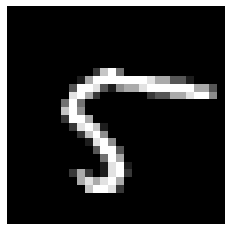

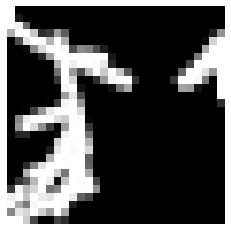

Loss: 0.0001036874698995736
Iteration: 32200, Score: 0.12726704147458076
[109, 41, 91, 48, 28, 49, 128, 35, 61, 48, 36, 242, 24, 60, 0]


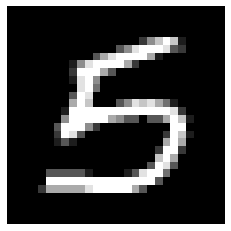

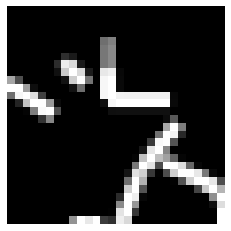

Loss: 0.00010410645135995704
Iteration: 32240, Score: 0.1330060535557568
[80, 87, 106, 65, 53, 18, 78, 28, 55, 44, 117, 153, 21, 95, 0]


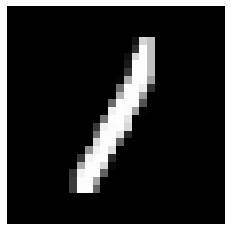

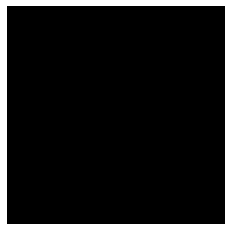

Loss: 9.893832555751543e-05
Iteration: 32280, Score: 0.11956741684908052
[75, 79, 55, 32, 31, 28, 63, 73, 86, 41, 89, 54, 28, 266, 0]


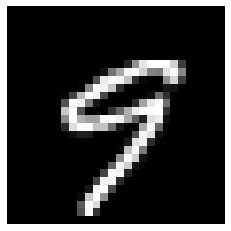

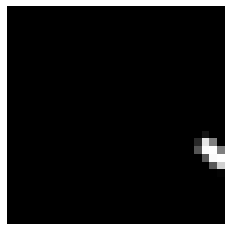

Loss: 9.153317940963883e-05
Iteration: 32320, Score: 0.121981817599386
[66, 47, 94, 56, 92, 103, 58, 39, 69, 26, 30, 52, 21, 247, 0]


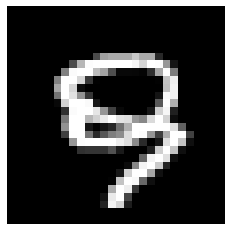

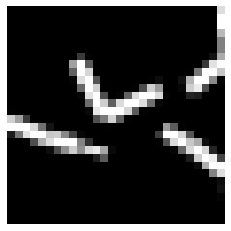

Loss: 0.00011868831337696099
Iteration: 32360, Score: 0.11756513107009232
[61, 41, 115, 71, 50, 78, 99, 27, 44, 25, 30, 57, 29, 273, 0]


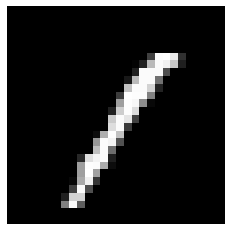

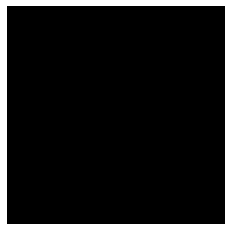

Loss: 9.51260996867758e-05
Iteration: 32400, Score: 0.10859897982515396
[52, 75, 90, 41, 52, 85, 111, 56, 42, 38, 24, 30, 31, 273, 0]


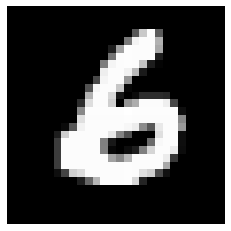

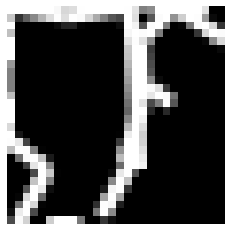

Test score: 0.008935864999890328
Loss: 0.00010500457921930517
Iteration: 32440, Score: 0.10120624628663064
[47, 96, 108, 50, 29, 103, 91, 36, 66, 66, 22, 65, 21, 200, 0]


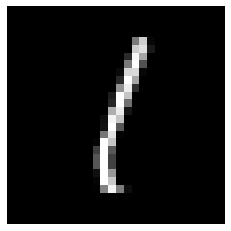

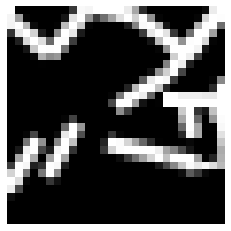

Loss: 8.69958537449638e-05
Iteration: 32480, Score: 0.1092490632981062
[66, 61, 34, 80, 93, 58, 68, 28, 71, 32, 28, 73, 25, 283, 0]


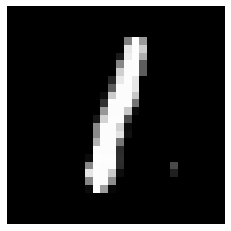

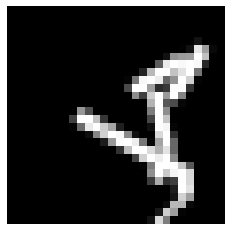

Loss: 0.00010006401630761918
Iteration: 32520, Score: 0.14684366016255812
[68, 145, 26, 49, 77, 41, 133, 63, 33, 45, 22, 51, 29, 218, 0]


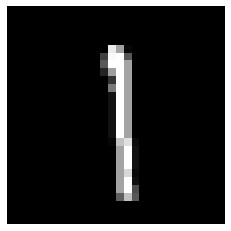

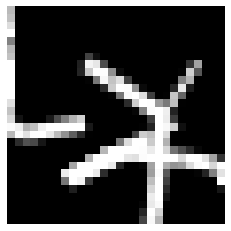

Loss: 9.12702179022502e-05
Iteration: 32560, Score: 0.13845279789716006
[59, 93, 76, 31, 56, 77, 80, 41, 44, 59, 19, 59, 31, 275, 0]


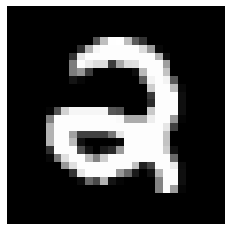

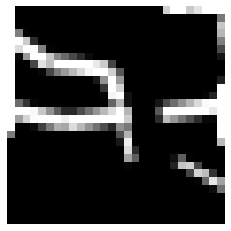

Loss: 0.0001069454621285018
Iteration: 32600, Score: 0.14483831700682642
[76, 96, 76, 42, 47, 73, 83, 51, 34, 40, 28, 43, 31, 280, 0]


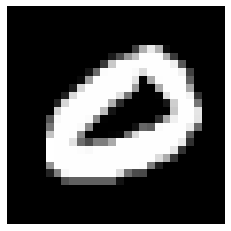

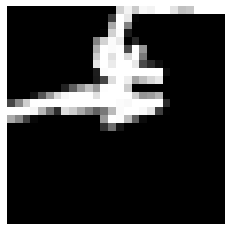

Loss: 0.00011831957894984366
Iteration: 32640, Score: 0.19415854873508215
[71, 61, 48, 61, 34, 71, 64, 47, 47, 108, 21, 62, 58, 247, 0]


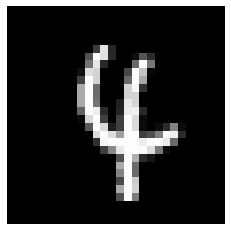

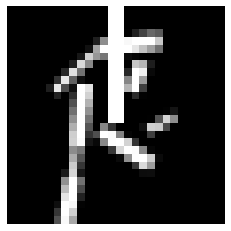

Loss: 0.00010299765306986025
Iteration: 32680, Score: 0.1409154138118028
[107, 104, 33, 49, 33, 58, 89, 95, 54, 40, 24, 48, 49, 217, 0]


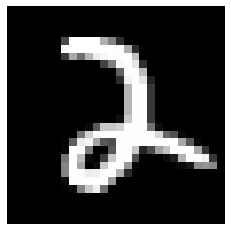

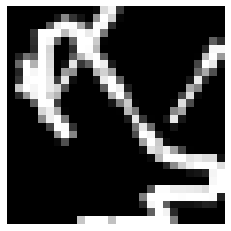

Loss: 0.00012587607812421822
Iteration: 32720, Score: 0.16712349259108303
[76, 157, 28, 100, 71, 27, 154, 20, 36, 16, 12, 59, 30, 214, 0]


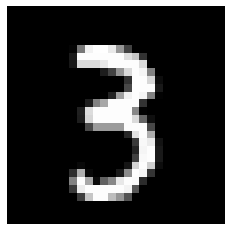

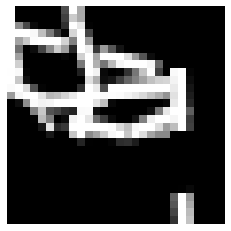

Loss: 0.00011088636686923232
Iteration: 32760, Score: 0.14765169889479873
[271, 61, 49, 78, 64, 101, 39, 51, 36, 21, 18, 51, 20, 140, 0]


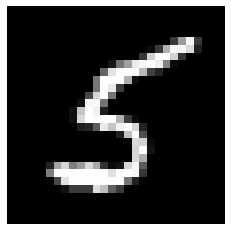

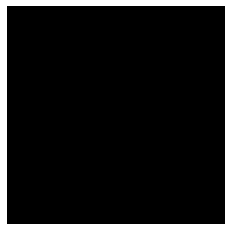

Loss: 0.00010165579986167273
Iteration: 32800, Score: 0.1734402803108096
[143, 74, 47, 81, 18, 84, 51, 41, 40, 38, 51, 162, 53, 117, 0]


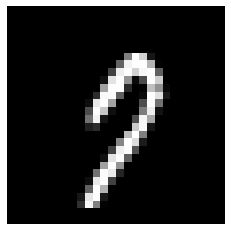

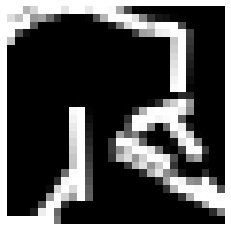

Test score: 0.02241043533617631
Loss: 0.00010845868286523529
Iteration: 32840, Score: 0.15962804277986292
[79, 30, 95, 77, 46, 98, 28, 41, 46, 25, 43, 79, 36, 277, 0]


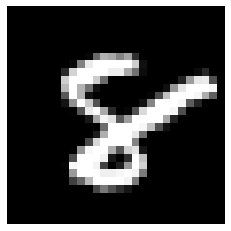

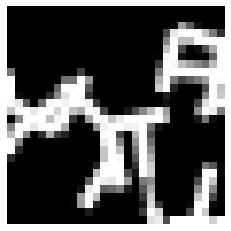

Loss: 9.891510724938525e-05
Iteration: 32880, Score: 0.15252360427752137
[81, 24, 55, 100, 94, 32, 22, 43, 44, 42, 31, 34, 36, 362, 0]


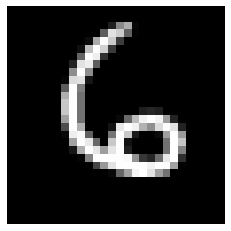

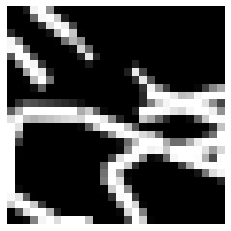

Loss: 0.00010258767352785792
Iteration: 32920, Score: 0.1456571102142334
[71, 77, 31, 53, 62, 76, 85, 44, 26, 40, 30, 59, 26, 320, 0]


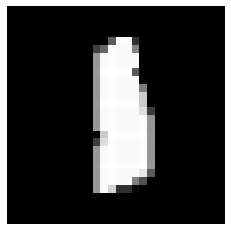

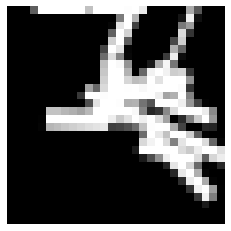

Loss: 8.762033427348006e-05
Iteration: 32960, Score: 0.15804558055102821
[86, 77, 36, 71, 43, 43, 26, 61, 38, 55, 27, 80, 34, 323, 0]


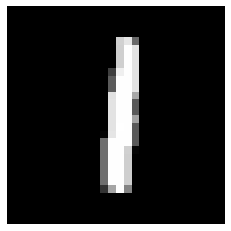

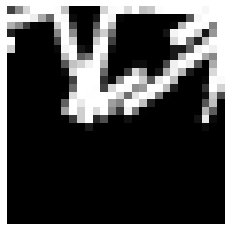

Loss: 9.140403944505968e-05
Iteration: 33000, Score: 0.12916647986695168
[79, 33, 45, 53, 26, 53, 40, 43, 41, 76, 34, 55, 35, 387, 0]


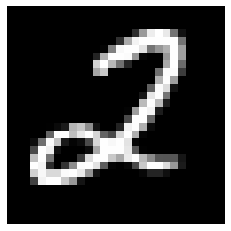

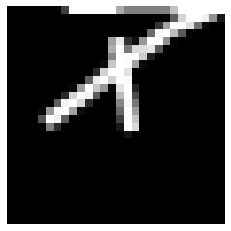

Loss: 9.102195498795126e-05
Iteration: 33040, Score: 0.15050573751702906
[85, 40, 30, 40, 44, 24, 44, 63, 39, 36, 38, 100, 39, 378, 0]


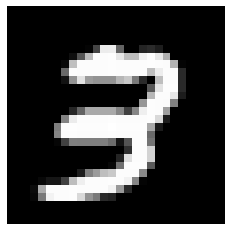

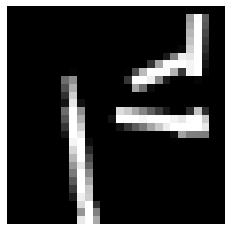

Loss: 8.42779569096408e-05
Iteration: 33080, Score: 0.13796679362282155
[82, 29, 38, 43, 42, 34, 43, 39, 33, 49, 34, 63, 40, 431, 0]


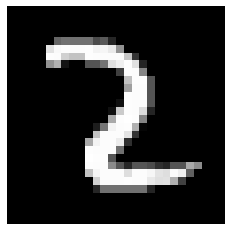

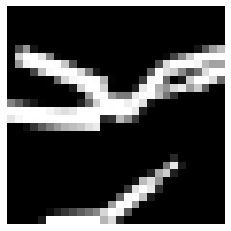

Loss: 9.270457346904959e-05
Iteration: 33120, Score: 0.14133970430120824
[77, 26, 28, 72, 71, 35, 34, 70, 49, 46, 30, 184, 35, 243, 0]


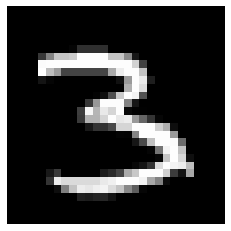

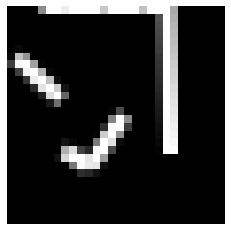

Loss: 8.811014233841994e-05
Iteration: 33160, Score: 0.11549736312031744
[78, 38, 31, 73, 76, 38, 40, 91, 51, 63, 29, 55, 32, 305, 0]


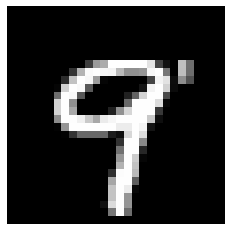

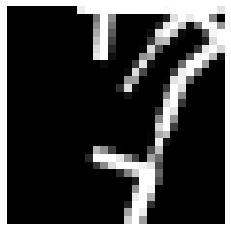

Loss: 9.394734756734273e-05
Iteration: 33200, Score: 0.18427828274294733
[68, 78, 68, 82, 81, 56, 64, 58, 27, 28, 28, 35, 22, 305, 0]


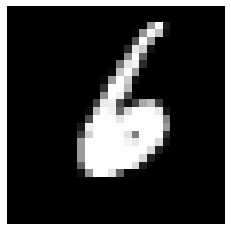

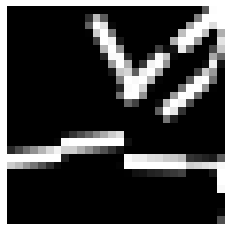

Test score: 0.024186743795871733
Loss: 9.256208820737241e-05
Iteration: 33240, Score: 0.1711017457433045
[72, 64, 73, 59, 41, 62, 57, 76, 36, 46, 30, 44, 23, 317, 0]


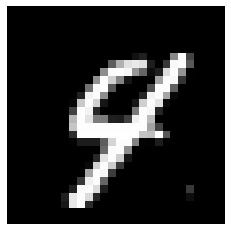

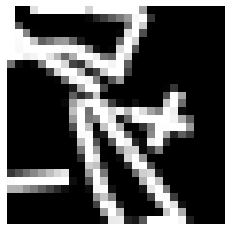

Loss: 9.524330772253679e-05
Iteration: 33280, Score: 0.1511433134675026
[67, 60, 43, 76, 81, 58, 82, 57, 23, 44, 31, 34, 36, 308, 0]


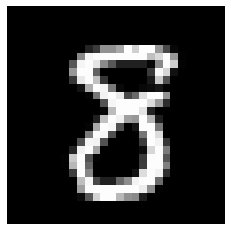

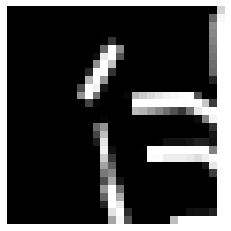

Loss: 0.00010616522599125907
Iteration: 33320, Score: 0.1740120746865868
[73, 69, 29, 83, 97, 41, 33, 61, 68, 34, 23, 36, 27, 326, 0]


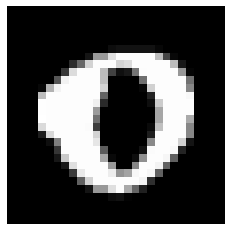

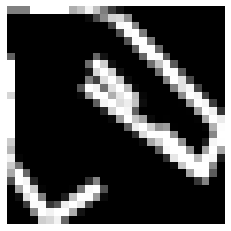

Loss: 0.00011179968401990084
Iteration: 33360, Score: 0.15195765807665884
[73, 77, 35, 54, 50, 36, 45, 41, 51, 38, 46, 42, 40, 372, 0]


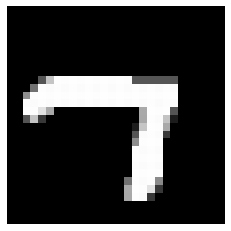

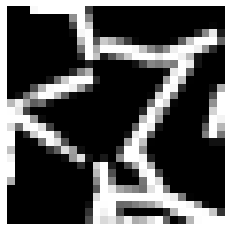

Loss: 9.960257839276425e-05
Iteration: 33400, Score: 0.18599155138432977
[99, 128, 117, 50, 23, 58, 75, 50, 20, 22, 27, 32, 22, 277, 0]


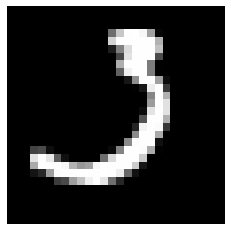

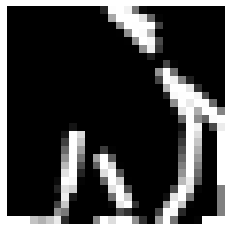

Loss: 9.341101607593144e-05
Iteration: 33440, Score: 0.15642339085927234
[97, 54, 62, 27, 30, 67, 32, 60, 35, 41, 28, 47, 36, 384, 0]


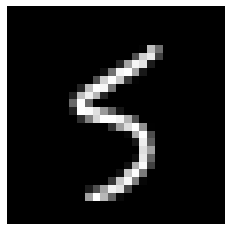

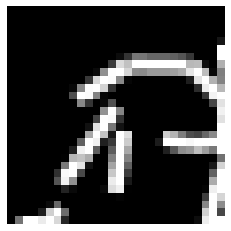

Loss: 8.36539987320794e-05
Iteration: 33480, Score: 0.17906156831979753
[82, 53, 50, 30, 27, 53, 61, 39, 61, 31, 44, 31, 33, 405, 0]


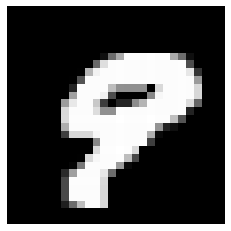

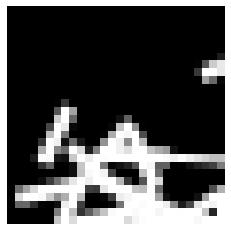

Loss: 9.503171069121938e-05
Iteration: 33520, Score: 0.18094035071879622
[79, 72, 48, 31, 43, 47, 36, 67, 38, 22, 40, 29, 34, 414, 0]


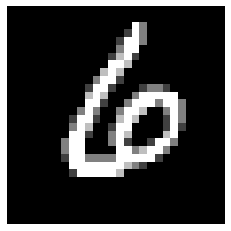

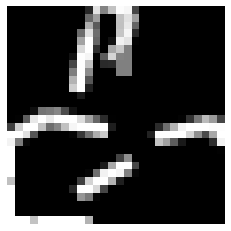

Loss: 8.663552527116436e-05
Iteration: 33560, Score: 0.15999469310604036
[60, 44, 148, 28, 30, 136, 29, 41, 29, 26, 30, 143, 23, 233, 0]


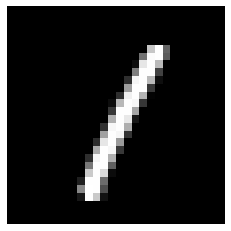

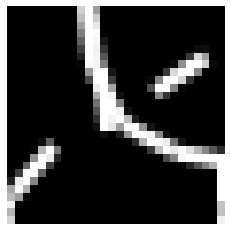

Loss: 8.927635813850428e-05
Iteration: 33600, Score: 0.15000078438967468
[88, 81, 53, 34, 40, 33, 53, 37, 33, 29, 39, 71, 37, 372, 0]


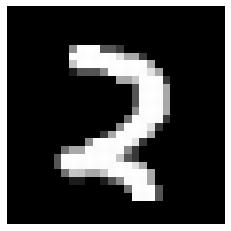

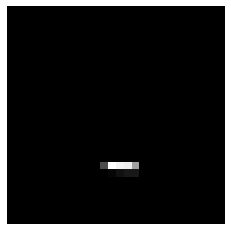

Test score: 0.10866891562566161
Loss: 9.623922125167887e-05
Iteration: 33640, Score: 0.19569373963773248
[97, 64, 41, 38, 49, 31, 40, 42, 36, 33, 264, 40, 28, 197, 0]


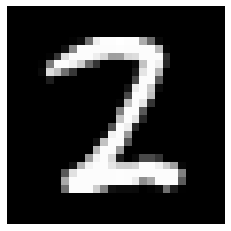

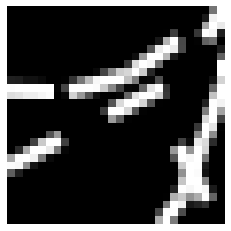

Loss: 8.659175067302161e-05
Iteration: 33680, Score: 0.1429730544537306
[78, 49, 25, 30, 42, 40, 31, 39, 35, 32, 113, 52, 40, 394, 0]


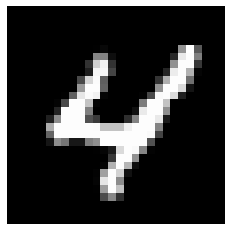

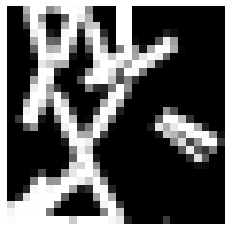

Loss: 8.379236557708027e-05
Iteration: 33720, Score: 0.21771645288914437
[63, 35, 209, 43, 18, 201, 32, 19, 24, 16, 37, 32, 21, 250, 0]


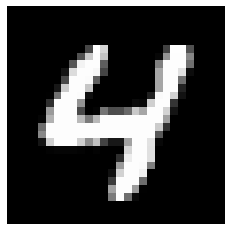

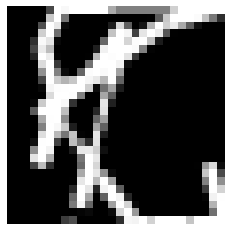

Loss: 9.619367659811124e-05
Iteration: 33760, Score: 0.16319374166056513
[90, 39, 101, 49, 51, 47, 31, 34, 45, 35, 60, 50, 28, 340, 0]


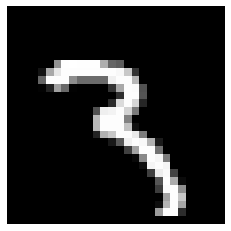

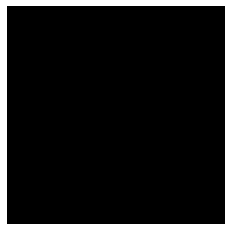

Loss: 9.184169124403528e-05
Iteration: 33800, Score: 0.17887898583710196
[88, 58, 46, 52, 36, 36, 37, 23, 37, 38, 30, 58, 33, 428, 0]


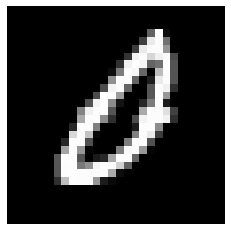

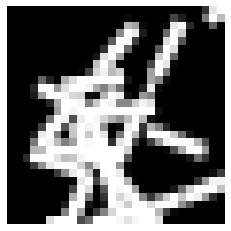

Loss: 9.221858712527299e-05
Iteration: 33840, Score: 0.1626850728429854
[70, 32, 35, 32, 39, 32, 36, 48, 33, 35, 40, 61, 40, 467, 0]


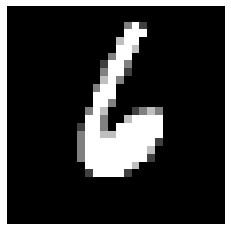

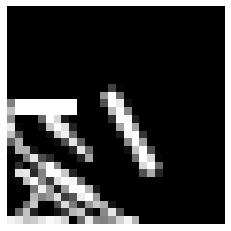

Loss: 9.684011570594664e-05
Iteration: 33880, Score: 0.18065806797891856
[80, 27, 58, 46, 42, 31, 27, 47, 41, 39, 82, 54, 54, 372, 0]


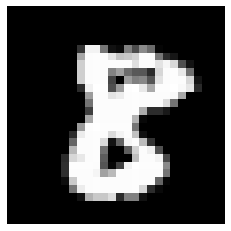

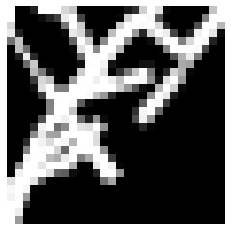

Loss: 8.205788427327094e-05
Iteration: 33920, Score: 0.15153928376361733
[88, 36, 75, 29, 40, 60, 41, 61, 39, 18, 35, 69, 25, 384, 0]


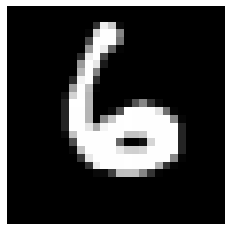

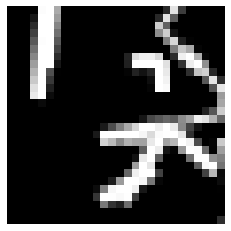

Loss: 8.102605859832123e-05
Iteration: 33960, Score: 0.1646452456340194
[137, 47, 66, 34, 26, 47, 30, 38, 53, 31, 224, 93, 32, 142, 0]


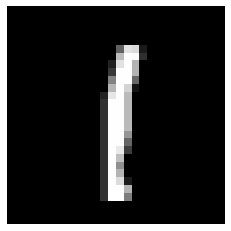

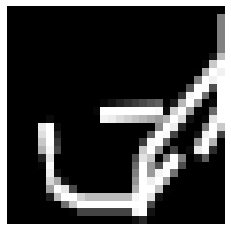

Loss: 7.832021621077325e-05
Iteration: 34000, Score: 0.2525746060088277
[67, 54, 38, 31, 40, 31, 48, 33, 49, 28, 130, 66, 87, 298, 0]


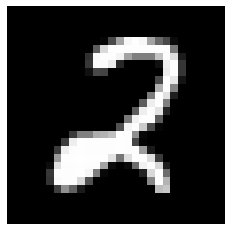

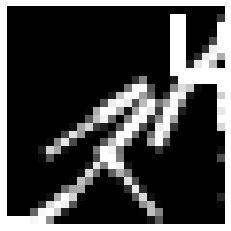

Test score: 0.10260612254589793
Loss: 8.963281551078058e-05
Iteration: 34040, Score: 0.15667027362808586
[56, 33, 89, 32, 44, 85, 33, 50, 25, 32, 198, 74, 46, 203, 0]


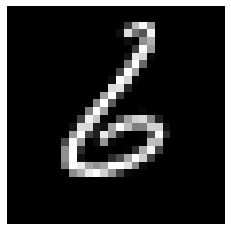

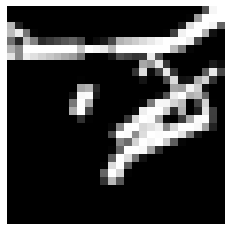

Loss: 9.175038473568195e-05
Iteration: 34080, Score: 0.11777843617647885
[84, 32, 49, 34, 43, 36, 36, 47, 41, 35, 152, 57, 44, 310, 0]


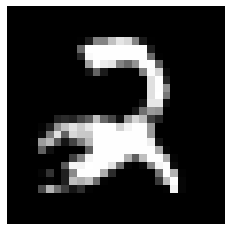

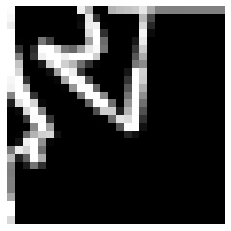

Loss: 8.681149129544816e-05
Iteration: 34120, Score: 0.14892858837917447
[347, 28, 61, 33, 37, 49, 32, 45, 37, 21, 44, 58, 32, 176, 0]


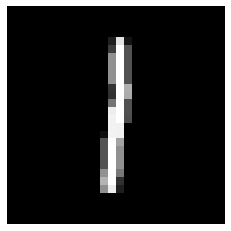

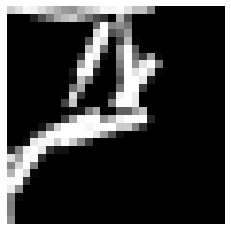

Loss: 9.314734254605941e-05
Iteration: 34160, Score: 0.1694303065948188
[127, 30, 35, 42, 32, 34, 32, 31, 50, 41, 224, 59, 96, 167, 0]


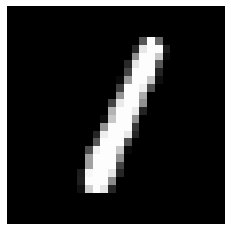

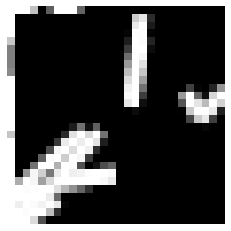

Loss: 8.983361940258871e-05
Iteration: 34200, Score: 0.18502842977643014
[49, 66, 154, 28, 24, 160, 34, 25, 28, 22, 217, 34, 20, 139, 0]


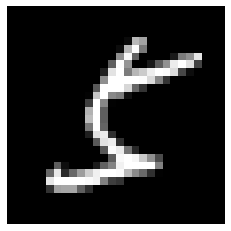

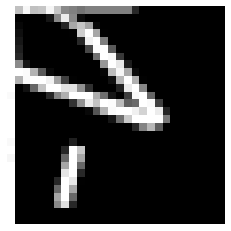

Loss: 8.516251115940236e-05
Iteration: 34240, Score: 0.16242962247366088
[74, 64, 123, 33, 22, 118, 30, 49, 22, 31, 41, 75, 201, 117, 0]


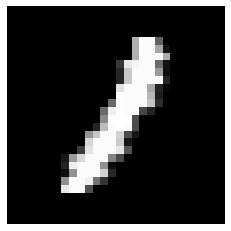

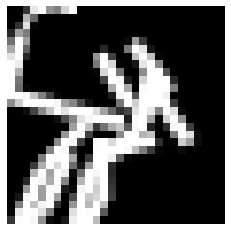

Loss: 8.607119718935215e-05
Iteration: 34280, Score: 0.1784062585160136
[70, 69, 56, 26, 30, 64, 46, 56, 40, 31, 41, 122, 68, 281, 0]


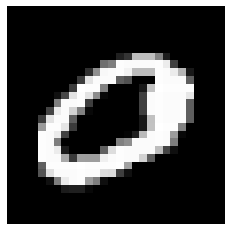

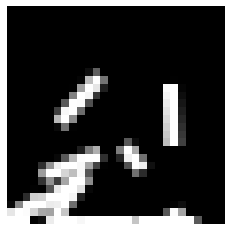

Loss: 9.571616595064333e-05
Iteration: 34320, Score: 0.18415585499629378
[81, 47, 60, 39, 33, 37, 36, 41, 40, 32, 33, 61, 34, 426, 0]


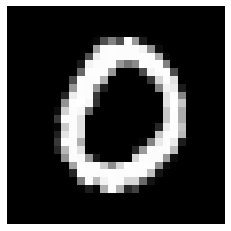

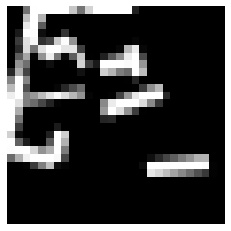

Loss: 9.03872943360677e-05
Iteration: 34360, Score: 0.20622700845450162
[56, 43, 42, 37, 49, 57, 58, 45, 32, 39, 37, 44, 43, 418, 0]


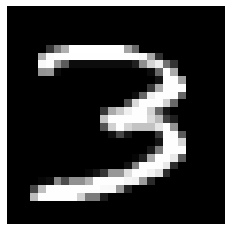

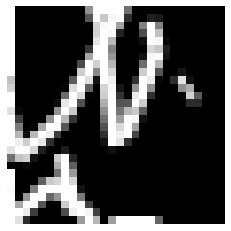

Loss: 0.00010322412046168642
Iteration: 34400, Score: 0.1636287325322628
[71, 59, 44, 32, 32, 40, 93, 61, 27, 39, 22, 48, 49, 383, 0]


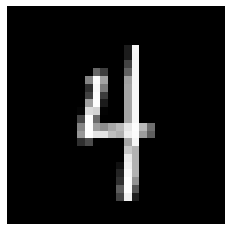

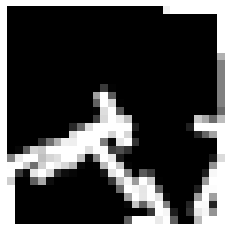

Test score: 0.1375981053407304
Loss: 9.36439341250617e-05
Iteration: 34440, Score: 0.18117464943975212
[127, 35, 31, 40, 53, 26, 41, 40, 58, 29, 24, 113, 33, 350, 0]


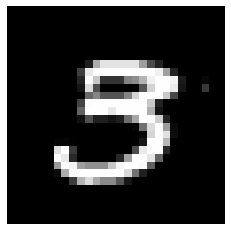

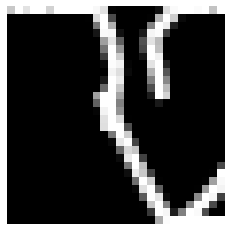

Loss: 0.00010036020773242189
Iteration: 34480, Score: 0.19343090102076532
[105, 29, 32, 33, 38, 39, 46, 35, 36, 24, 52, 85, 43, 403, 0]


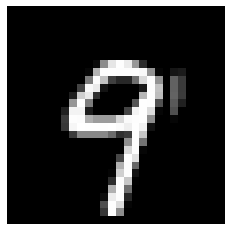

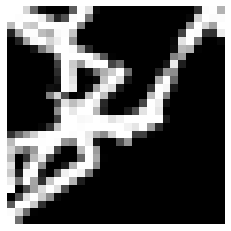

Loss: 8.04226335393572e-05
Iteration: 34520, Score: 0.18378152416879306
[92, 31, 49, 33, 34, 68, 40, 34, 48, 28, 39, 96, 35, 373, 0]


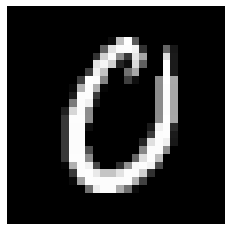

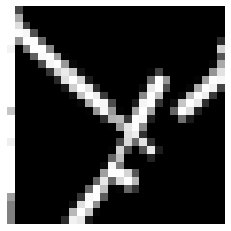

Loss: 9.12456271727496e-05
Iteration: 34560, Score: 0.22225756092742088
[87, 56, 23, 29, 54, 39, 35, 56, 38, 30, 42, 70, 37, 404, 0]


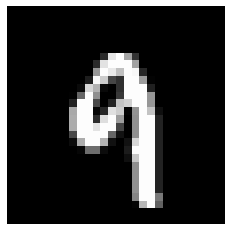

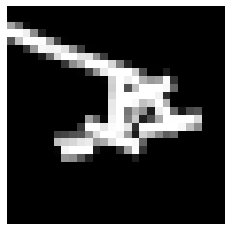

Loss: 9.226375888233009e-05
Iteration: 34600, Score: 0.20994054956734182
[93, 31, 67, 36, 36, 40, 37, 28, 26, 23, 39, 120, 49, 375, 0]


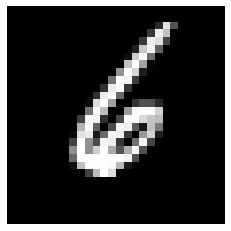

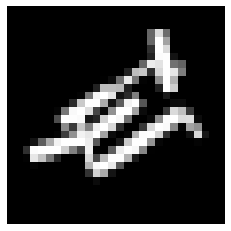

Loss: 9.524114558296388e-05
Iteration: 34640, Score: 0.19402699648775162
[100, 34, 64, 39, 32, 62, 36, 51, 37, 16, 32, 86, 43, 368, 0]


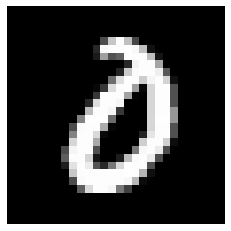

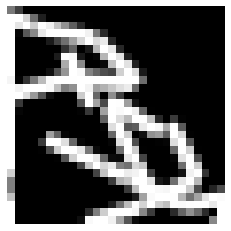

Loss: 9.303426328928605e-05
Iteration: 34680, Score: 0.18546163614094258
[303, 58, 29, 35, 33, 60, 78, 73, 22, 32, 29, 37, 32, 179, 0]


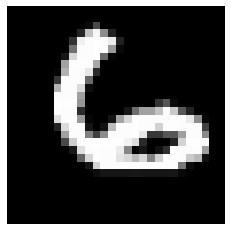

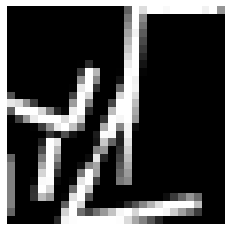

Loss: 8.26828429388374e-05
Iteration: 34720, Score: 0.14657703901454808
[129, 127, 23, 65, 59, 42, 238, 29, 26, 20, 34, 38, 46, 124, 0]


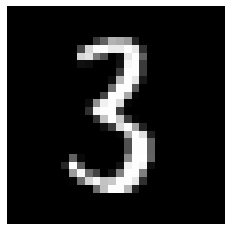

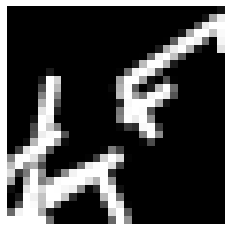

Loss: 8.682600902998742e-05
Iteration: 34760, Score: 0.18473761345807
[88, 53, 28, 31, 32, 26, 78, 43, 40, 27, 45, 54, 37, 418, 0]


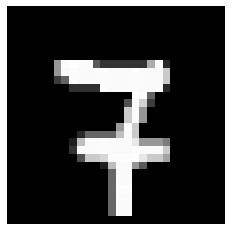

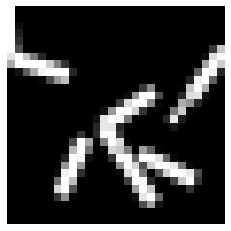

Loss: 9.02646607565564e-05
Iteration: 34800, Score: 0.1894936940446496
[90, 41, 55, 49, 29, 27, 39, 54, 31, 28, 51, 96, 245, 165, 0]


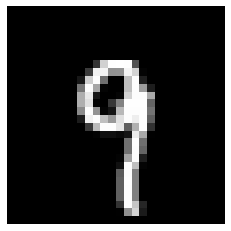

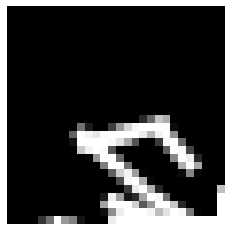

Test score: 0.15826958665833807
Loss: 0.00011078526527478629
Iteration: 34840, Score: 0.2303105574324727
[67, 38, 57, 35, 44, 61, 56, 58, 23, 35, 36, 86, 56, 348, 0]


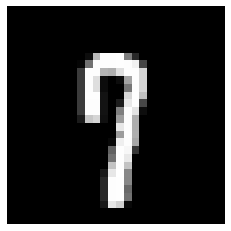

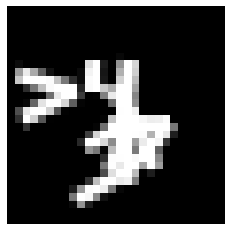

Loss: 0.00010709713005032464
Iteration: 34880, Score: 0.19372486291080715
[85, 33, 37, 56, 43, 21, 39, 40, 34, 43, 79, 67, 41, 382, 0]


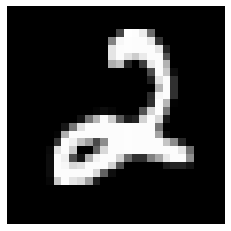

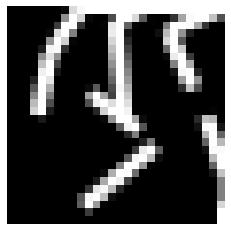

Loss: 0.00011499257990558076
Iteration: 34920, Score: 0.17156778332591055
[96, 29, 65, 33, 42, 50, 41, 35, 43, 41, 25, 68, 33, 399, 0]


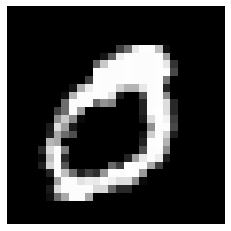

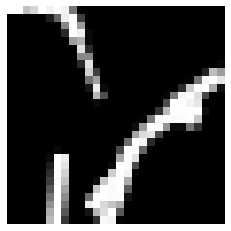

Loss: 0.0001240635673792707
Iteration: 34960, Score: 0.18893767189979555
[278, 29, 30, 48, 28, 50, 48, 33, 26, 28, 22, 108, 40, 232, 0]


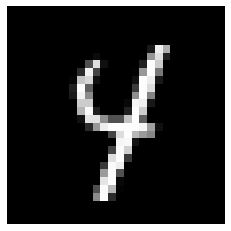

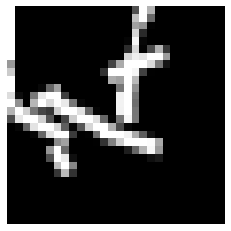

Loss: 0.00010576165169044655
Iteration: 35000, Score: 0.17569197094812988
[116, 19, 71, 32, 34, 52, 35, 42, 31, 30, 36, 116, 25, 361, 0]


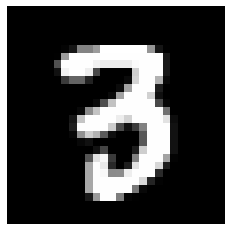

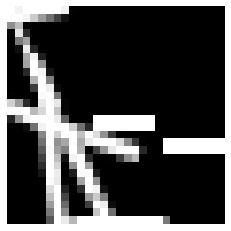

Loss: 8.729302000938603e-05
Iteration: 35040, Score: 0.1601443146727979
[80, 33, 94, 34, 40, 102, 44, 33, 31, 19, 44, 269, 28, 149, 0]


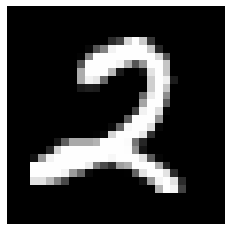

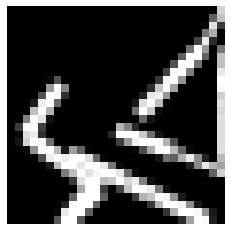

Loss: 9.252719787555445e-05
Iteration: 35080, Score: 0.15904861228913067
[105, 65, 42, 36, 31, 31, 86, 65, 35, 25, 29, 123, 32, 295, 0]


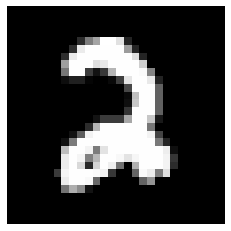

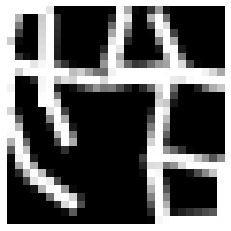

Loss: 0.00010271736713371705
Iteration: 35120, Score: 0.2414051164370031
[96, 33, 52, 37, 39, 30, 58, 69, 52, 52, 49, 56, 27, 350, 0]


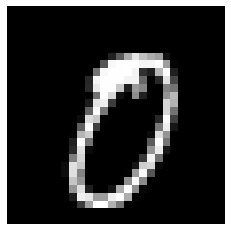

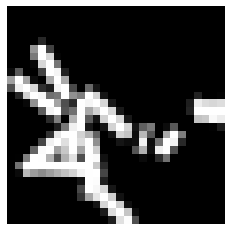

Loss: 9.506997548341928e-05
Iteration: 35160, Score: 0.19083985350281002
[111, 25, 45, 32, 38, 32, 33, 26, 46, 29, 31, 125, 196, 231, 0]


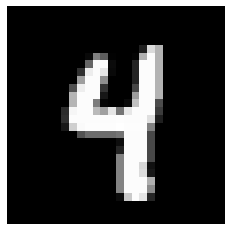

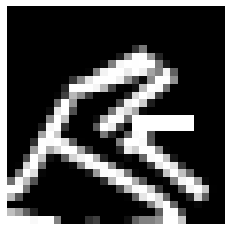

Loss: 0.000117777520489525
Iteration: 35200, Score: 0.19785520399361853
[62, 107, 35, 35, 52, 36, 68, 43, 27, 29, 42, 70, 54, 340, 0]


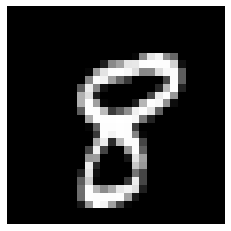

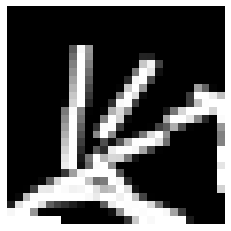

Test score: 0.10983347558230161
Loss: 0.00011389307212852433
Iteration: 35240, Score: 0.20288081330060956
[296, 89, 29, 32, 29, 23, 110, 35, 52, 20, 25, 109, 26, 125, 0]


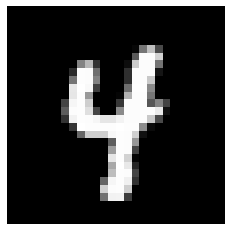

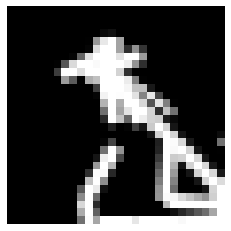

Loss: 0.00010763777361652032
Iteration: 35280, Score: 0.21159817514568563
[161, 41, 29, 29, 29, 62, 29, 62, 36, 32, 50, 255, 31, 154, 0]


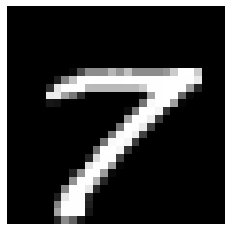

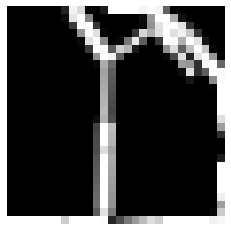

Loss: 0.0001056559753109676
Iteration: 35320, Score: 0.1908004337623715
[100, 40, 32, 33, 52, 46, 35, 29, 45, 32, 40, 148, 32, 336, 0]


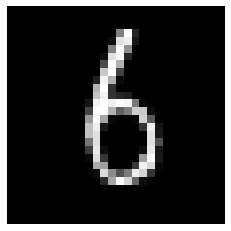

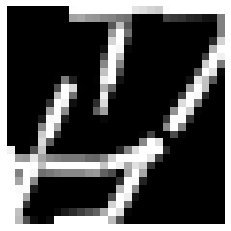

Loss: 8.927307363073322e-05
Iteration: 35360, Score: 0.16868513762578366
[88, 32, 36, 35, 41, 45, 39, 31, 43, 22, 51, 99, 44, 394, 0]


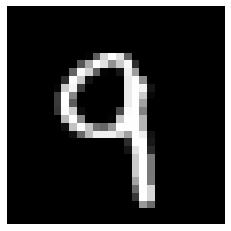

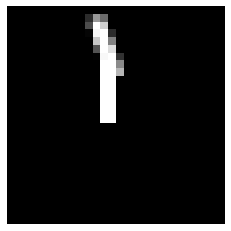

Loss: 9.075372998686375e-05
Iteration: 35400, Score: 0.16027310326695443
[122, 31, 52, 37, 31, 60, 34, 25, 35, 36, 41, 75, 34, 387, 0]


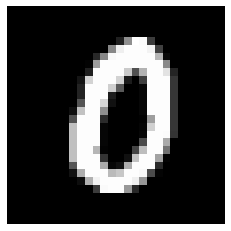

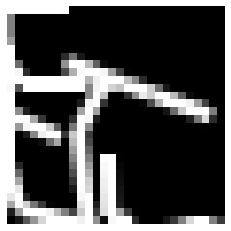

Loss: 9.76181014551473e-05
Iteration: 35440, Score: 0.2120460764355958
[90, 97, 64, 45, 29, 25, 93, 20, 39, 41, 34, 70, 33, 320, 0]


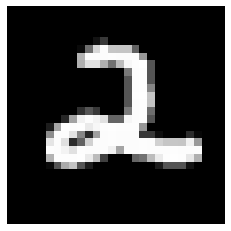

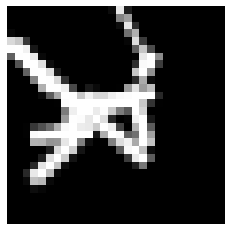

Loss: 9.314492810877451e-05
Iteration: 35480, Score: 0.17539497480168936
[110, 26, 56, 42, 52, 46, 201, 48, 35, 40, 34, 71, 29, 210, 0]


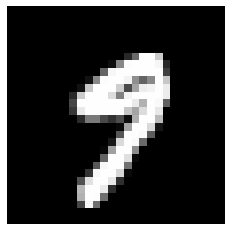

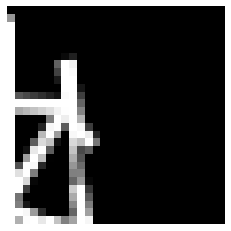

Loss: 0.00010112631659422728
Iteration: 35520, Score: 0.1863438496291637
[113, 31, 73, 37, 29, 72, 57, 71, 32, 39, 28, 40, 34, 344, 0]


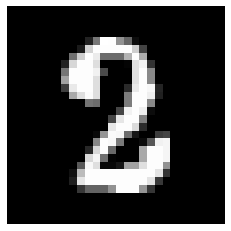

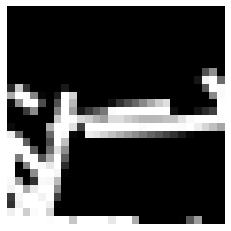

Loss: 0.00010181615624544288
Iteration: 35560, Score: 0.1881586727127433
[290, 24, 35, 76, 54, 36, 46, 30, 37, 44, 37, 82, 37, 172, 0]


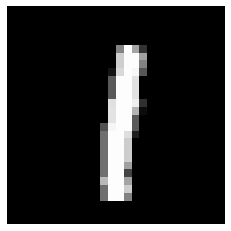

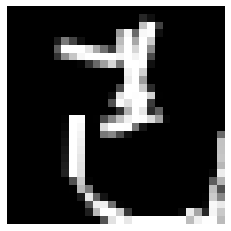

Loss: 8.915977504625958e-05
Iteration: 35600, Score: 0.1337625709720887
[230, 30, 49, 43, 50, 27, 36, 24, 34, 21, 33, 183, 53, 187, 0]


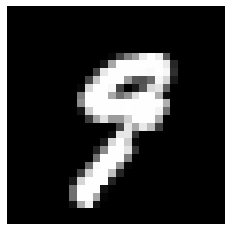

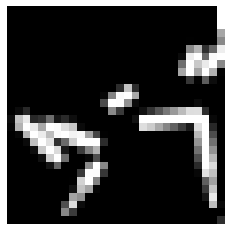

Test score: 0.14148239015042782
Loss: 9.168821427561687e-05
Iteration: 35640, Score: 0.19112092582136392
[85, 34, 56, 25, 26, 60, 35, 34, 49, 37, 36, 280, 34, 209, 0]


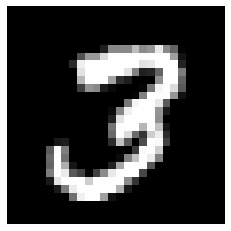

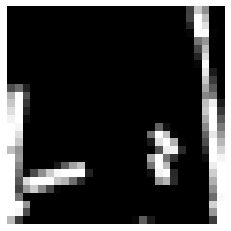

Loss: 9.876754030358822e-05
Iteration: 35680, Score: 0.17718377291411164
[131, 58, 32, 37, 42, 37, 36, 29, 58, 29, 214, 121, 74, 102, 0]


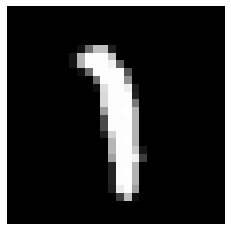

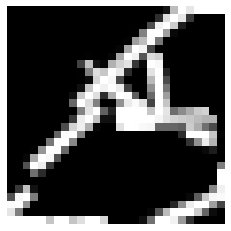

Loss: 0.0001054608432656705
Iteration: 35720, Score: 0.18448993184790013
[74, 153, 27, 29, 44, 27, 161, 39, 31, 22, 91, 79, 37, 186, 0]


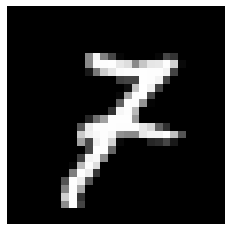

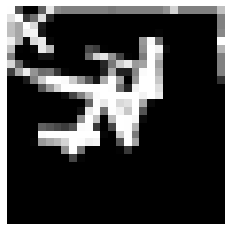

Loss: 9.251596586544419e-05
Iteration: 35760, Score: 0.18267469292879107
[91, 94, 51, 29, 28, 57, 95, 33, 37, 19, 99, 215, 26, 126, 0]


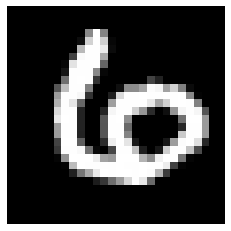

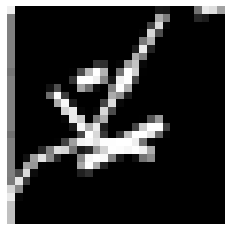

Loss: 9.430928601241152e-05
Iteration: 35800, Score: 0.1905542286261916
[93, 89, 24, 32, 40, 21, 83, 37, 27, 41, 35, 255, 60, 163, 0]


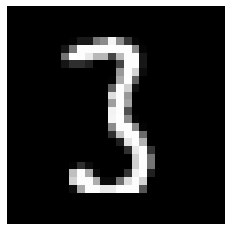

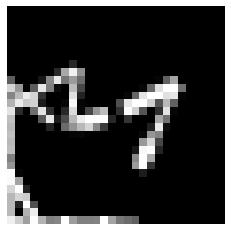

Loss: 8.70118072572884e-05
Iteration: 35840, Score: 0.2150584653615951
[99, 67, 27, 20, 47, 31, 82, 26, 33, 60, 28, 96, 193, 191, 0]


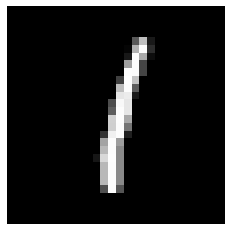

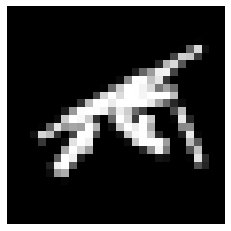

Loss: 9.846258247301117e-05
Iteration: 35880, Score: 0.21879828799609088
[121, 42, 27, 42, 35, 42, 41, 40, 34, 36, 38, 98, 320, 84, 0]


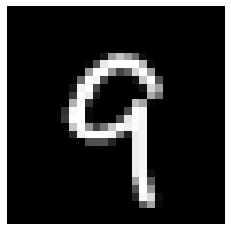

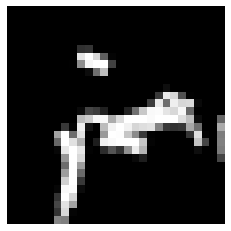

Loss: 9.371912199155493e-05
Iteration: 35920, Score: 0.17310526536824183
[95, 77, 30, 32, 42, 27, 83, 43, 22, 31, 42, 111, 312, 53, 0]


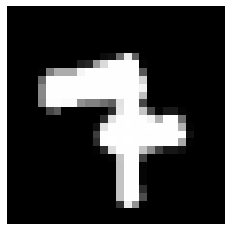

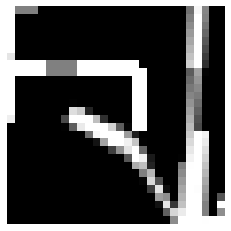

Loss: 8.700245617432641e-05
Iteration: 35960, Score: 0.16601484719663862
[208, 32, 31, 29, 42, 31, 42, 35, 43, 30, 41, 120, 234, 82, 0]


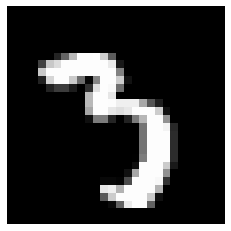

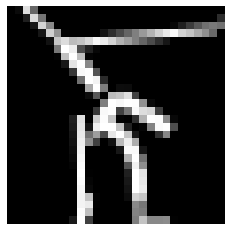

Loss: 9.605080783943618e-05
Iteration: 36000, Score: 0.19937880868464708
[234, 63, 32, 29, 37, 35, 65, 29, 19, 29, 167, 103, 76, 82, 0]


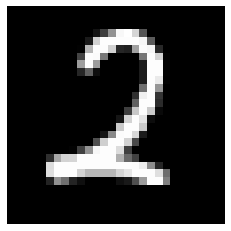

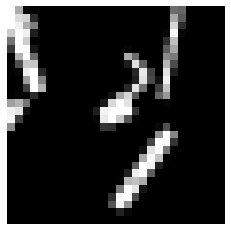

Test score: 0.15581236983137206
Loss: 7.324403307116632e-05
Iteration: 36040, Score: 0.19441671530902382
[89, 70, 37, 36, 56, 54, 20, 72, 27, 28, 255, 95, 50, 111, 0]


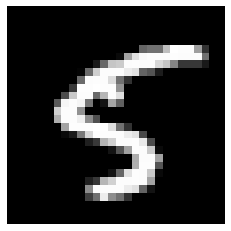

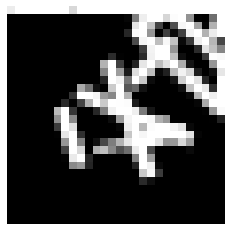

Loss: 8.433591303309826e-05
Iteration: 36080, Score: 0.27025675064697857
[85, 66, 28, 36, 50, 36, 53, 31, 23, 28, 228, 154, 49, 133, 0]


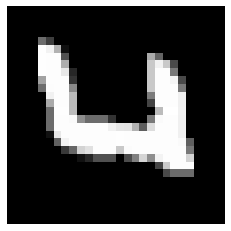

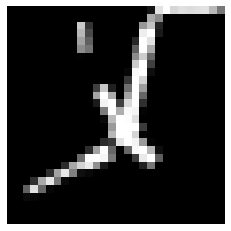

Loss: 9.885471597396746e-05
Iteration: 36120, Score: 0.19927316624671218
[78, 37, 38, 23, 39, 34, 37, 32, 53, 25, 333, 127, 61, 83, 0]


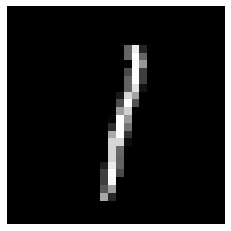

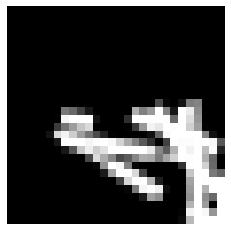

Loss: 0.0001191083907293324
Iteration: 36160, Score: 0.20652756574749942
[127, 56, 52, 32, 32, 51, 60, 30, 19, 28, 193, 99, 30, 191, 0]


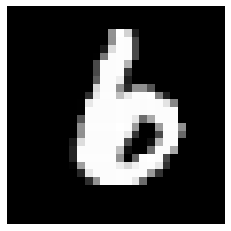

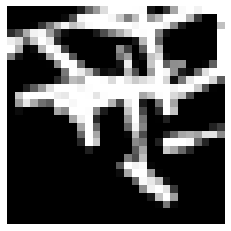

Loss: 0.00013284172951992315
Iteration: 36200, Score: 0.20316338852047924
[207, 85, 35, 27, 34, 34, 103, 24, 38, 23, 133, 94, 54, 109, 0]


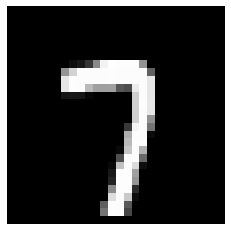

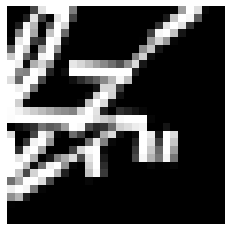

Loss: 0.00011354790687938076
Iteration: 36240, Score: 0.18999787831306456
[229, 19, 41, 42, 36, 37, 42, 22, 34, 32, 44, 131, 50, 241, 0]


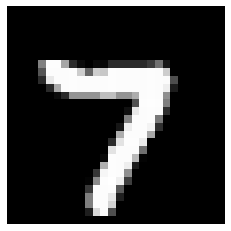

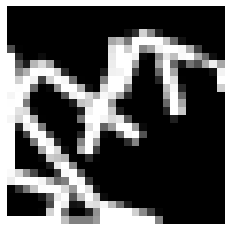

Loss: 0.00010616201393722104
Iteration: 36280, Score: 0.16757156775891785
[147, 48, 47, 27, 56, 34, 35, 34, 20, 31, 40, 147, 85, 249, 0]


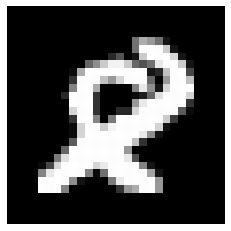

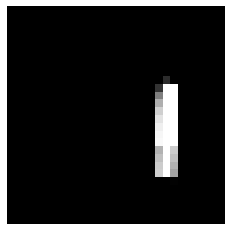

Loss: 0.00010312911831326651
Iteration: 36320, Score: 0.19246089237742128
[169, 30, 32, 31, 43, 26, 37, 48, 23, 21, 53, 129, 67, 291, 0]


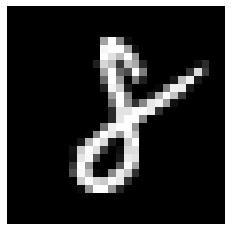

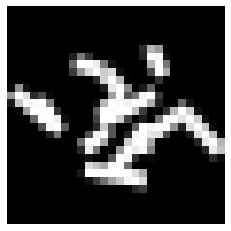

Loss: 0.00010854236038638323
Iteration: 36360, Score: 0.23626884919404983
[130, 31, 26, 25, 37, 39, 31, 40, 35, 31, 66, 135, 38, 336, 0]


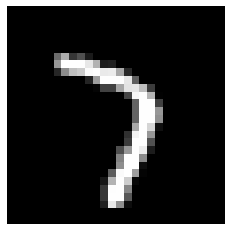

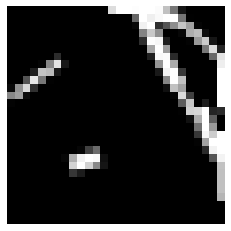

Loss: 0.00011650440569289636
Iteration: 36400, Score: 0.21564877133909613
[107, 39, 36, 33, 24, 26, 27, 43, 36, 29, 106, 134, 34, 326, 0]


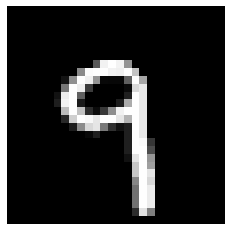

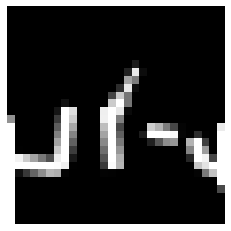

Test score: 0.13296822957694532
Loss: 0.00011879706280597466
Iteration: 36440, Score: 0.18737533189356326
[134, 38, 48, 57, 55, 48, 31, 67, 43, 29, 109, 111, 51, 179, 0]


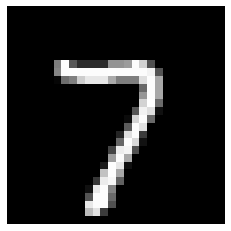

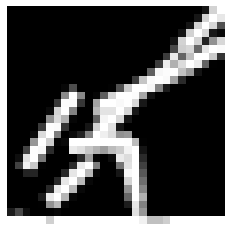

Loss: 0.00010891039766919777
Iteration: 36480, Score: 0.19070284477621316
[253, 75, 65, 27, 83, 45, 57, 32, 25, 32, 25, 146, 28, 107, 0]


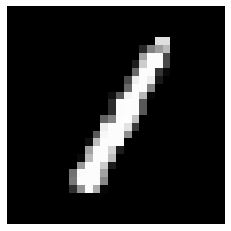

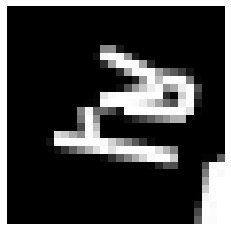

Loss: 0.00011136584081501134
Iteration: 36520, Score: 0.17070551938563586
[303, 27, 79, 26, 49, 71, 38, 23, 32, 25, 30, 145, 43, 109, 0]


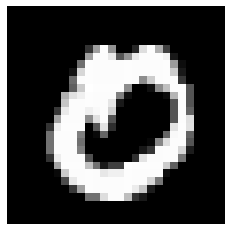

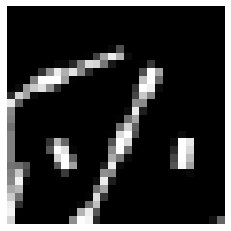

Loss: 8.69361102657589e-05
Iteration: 36560, Score: 0.18189735996723175
[163, 26, 48, 41, 37, 56, 73, 40, 45, 27, 48, 146, 24, 226, 0]


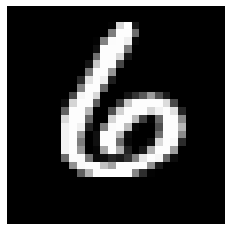

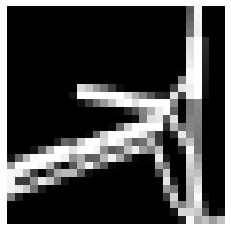

Loss: 8.955892016482217e-05
Iteration: 36600, Score: 0.2658932806402444
[106, 56, 33, 32, 52, 66, 83, 25, 39, 33, 36, 116, 34, 289, 0]


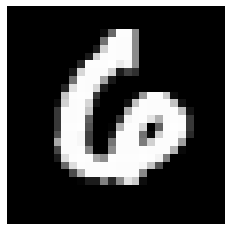

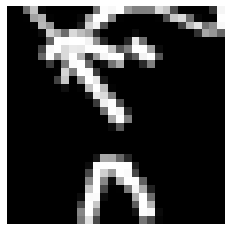

Loss: 9.472318465360142e-05
Iteration: 36640, Score: 0.177248567096889
[91, 61, 81, 31, 46, 84, 42, 33, 39, 25, 32, 138, 177, 120, 0]


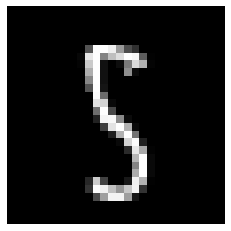

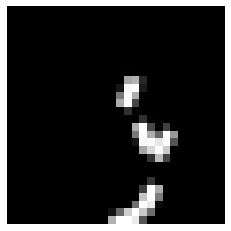

Loss: 0.00010974325135153198
Iteration: 36680, Score: 0.2782175447717309
[79, 133, 30, 46, 27, 20, 161, 26, 25, 18, 31, 99, 180, 125, 0]


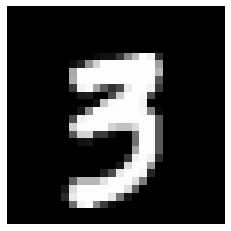

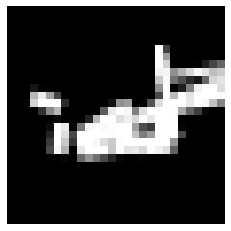

Loss: 0.00010662909385935613
Iteration: 36720, Score: 0.20626134386658665
[110, 53, 51, 34, 45, 55, 72, 36, 34, 30, 34, 104, 238, 104, 0]


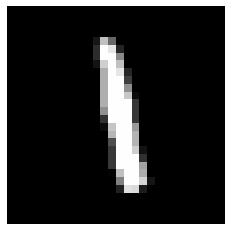

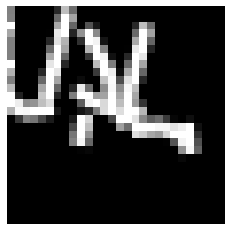

Loss: 0.00010966377383424776
Iteration: 36760, Score: 0.2201335387825966
[121, 47, 32, 22, 41, 29, 70, 46, 42, 20, 23, 151, 255, 101, 0]


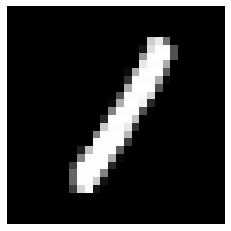

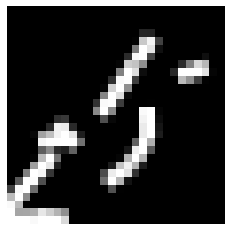

Loss: 0.00011024457498182391
Iteration: 36800, Score: 0.2069017967581749
[278, 53, 43, 20, 29, 30, 55, 35, 33, 26, 35, 144, 163, 56, 0]


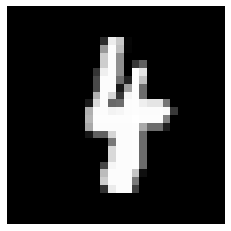

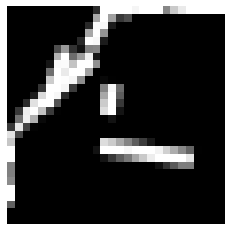

Test score: 0.12217850584228292
Loss: 9.728462932958333e-05
Iteration: 36840, Score: 0.1816928801238537
[188, 31, 56, 19, 36, 75, 40, 36, 31, 32, 40, 293, 41, 82, 0]


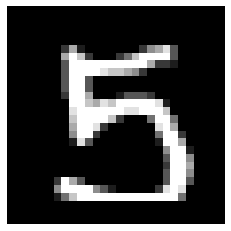

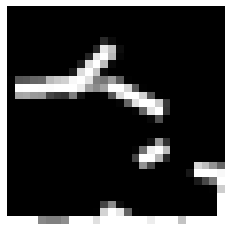

Loss: 9.696453771901538e-05
Iteration: 36880, Score: 0.22846420491486788
[182, 32, 71, 32, 24, 126, 31, 29, 30, 27, 30, 262, 46, 78, 0]


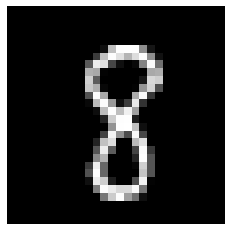

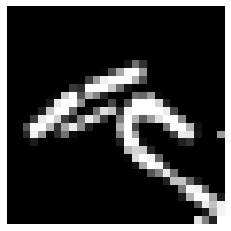

Loss: 0.00010648162841567147
Iteration: 36920, Score: 0.31105835282802585
[154, 25, 38, 21, 34, 52, 30, 63, 31, 37, 52, 325, 55, 83, 0]


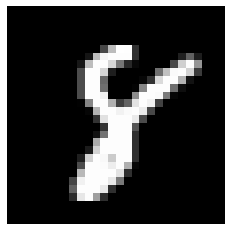

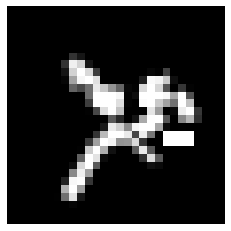

Loss: 0.0001018758495952934
Iteration: 36960, Score: 0.18531046424806122
[102, 38, 39, 22, 37, 36, 43, 43, 47, 37, 48, 379, 51, 78, 0]


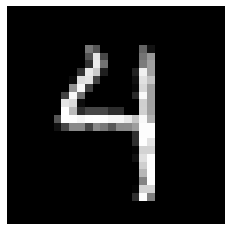

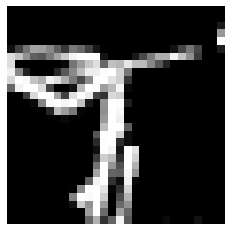

Loss: 0.00010221771826368563
Iteration: 37000, Score: 0.1976156568974257
[104, 36, 33, 19, 54, 51, 44, 36, 31, 32, 68, 341, 54, 97, 0]


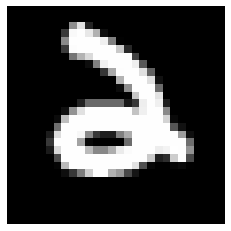

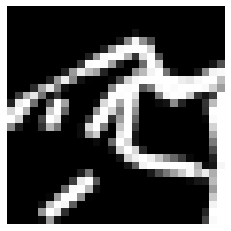

Loss: 0.00010751288189284403
Iteration: 37040, Score: 0.22886947070062164
[194, 41, 29, 30, 51, 46, 31, 58, 24, 26, 72, 274, 35, 89, 0]


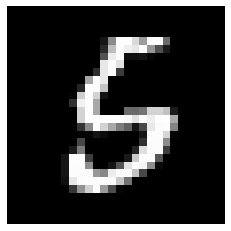

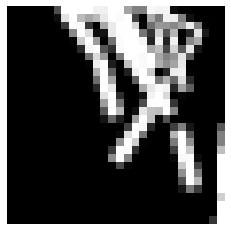

Loss: 9.92211074682533e-05
Iteration: 37080, Score: 0.22021383663872257
[194, 41, 27, 30, 32, 28, 32, 45, 33, 46, 197, 145, 36, 114, 0]


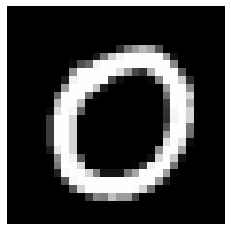

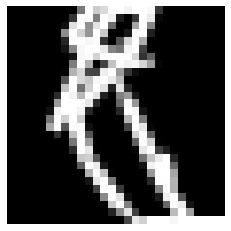

Loss: 0.00010638976108721854
Iteration: 37120, Score: 0.21896508634835482
[94, 40, 35, 31, 38, 46, 37, 43, 31, 35, 111, 119, 46, 294, 0]


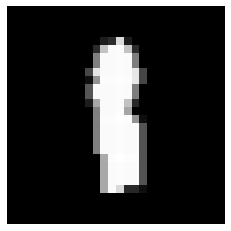

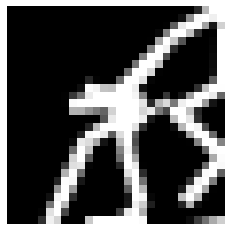

Loss: 0.00011638965051346689
Iteration: 37160, Score: 0.2350054176803679
[126, 25, 34, 25, 40, 43, 51, 30, 27, 33, 40, 95, 45, 386, 0]


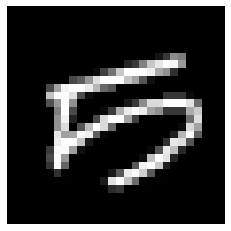

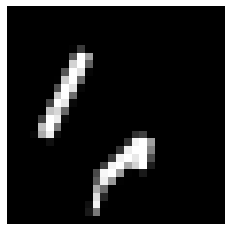

Loss: 0.0001292115702097193
Iteration: 37200, Score: 0.24831755112856624
[119, 28, 34, 25, 45, 41, 65, 34, 32, 27, 84, 110, 53, 303, 0]


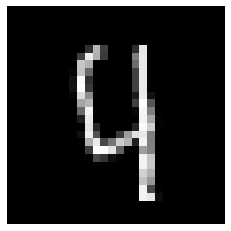

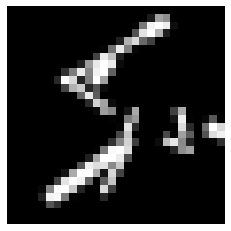

Test score: 0.15775981302931907
Loss: 0.0001331270089623801
Iteration: 37240, Score: 0.19967082297801972
[159, 34, 33, 29, 32, 64, 38, 39, 25, 42, 76, 101, 32, 296, 0]


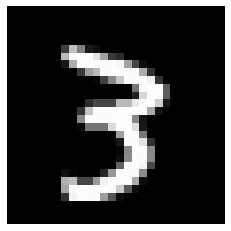

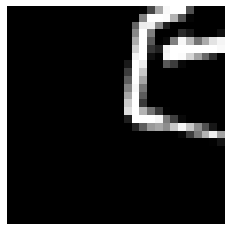

Loss: 0.00011200273902540282
Iteration: 37280, Score: 0.19390809832513328
[244, 22, 40, 45, 50, 72, 31, 35, 33, 17, 47, 125, 28, 211, 0]


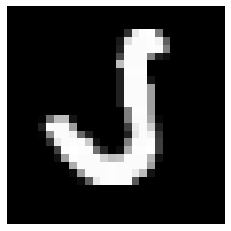

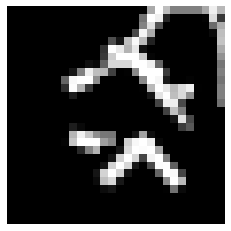

Loss: 0.0001211952772593236
Iteration: 37320, Score: 0.19685299561335706
[286, 27, 62, 21, 37, 88, 44, 48, 31, 28, 53, 138, 28, 109, 0]


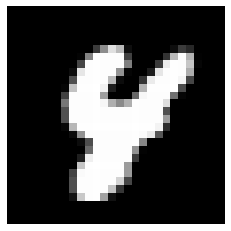

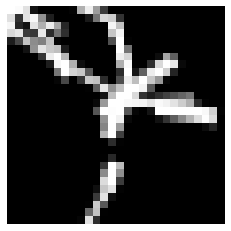

Loss: 0.00010148538321299394
Iteration: 37360, Score: 0.17391707789897923
[211, 26, 24, 32, 40, 53, 33, 61, 35, 28, 83, 245, 37, 92, 0]


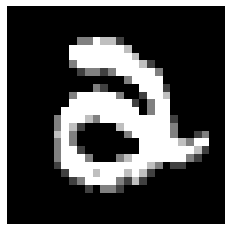

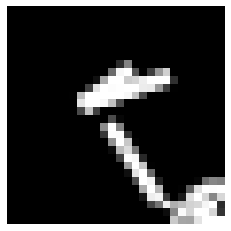

Loss: 9.794775936416534e-05
Iteration: 37400, Score: 0.20710950863361352
[120, 34, 62, 26, 31, 86, 66, 30, 36, 27, 158, 173, 41, 110, 0]


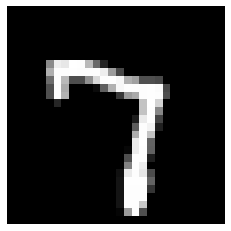

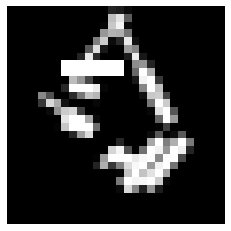

Loss: 0.00010294505991707888
Iteration: 37440, Score: 0.22983734295579783
[116, 21, 68, 32, 34, 64, 46, 45, 31, 28, 96, 77, 138, 204, 0]


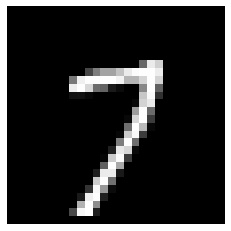

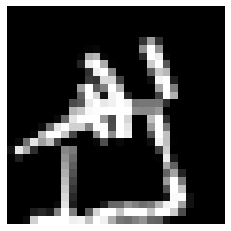

Loss: 0.00010944466149259248
Iteration: 37480, Score: 0.24995782750099904
[106, 45, 54, 40, 24, 76, 40, 60, 22, 32, 39, 90, 118, 254, 0]


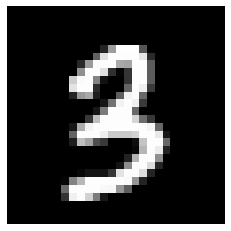

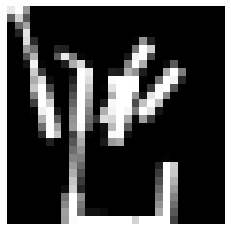

Loss: 0.00012147546196699525
Iteration: 37520, Score: 0.25005577291920783
[137, 37, 53, 35, 40, 52, 51, 43, 27, 19, 38, 221, 139, 108, 0]


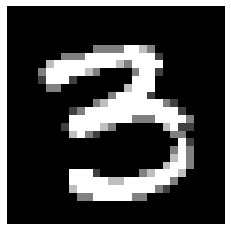

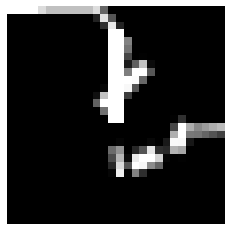

Loss: 0.0001241181137791676
Iteration: 37560, Score: 0.20039523138105872
[158, 27, 80, 31, 33, 85, 28, 44, 28, 32, 20, 305, 66, 63, 0]


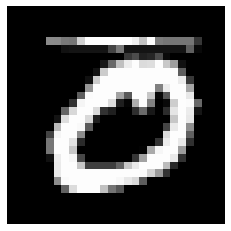

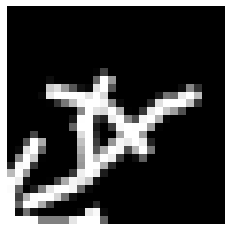

Loss: 0.00012144681997374712
Iteration: 37600, Score: 0.206041949339211
[273, 26, 32, 42, 33, 42, 45, 22, 33, 38, 44, 201, 45, 124, 0]


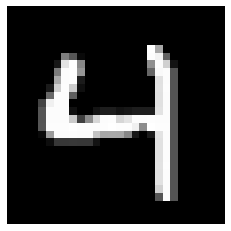

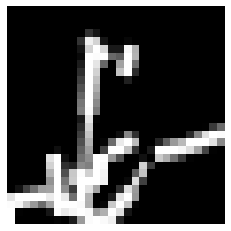

Test score: 0.14046987945074213
Loss: 0.00011765055519676764
Iteration: 37640, Score: 0.2217060035616159
[294, 34, 22, 33, 29, 43, 38, 71, 33, 22, 47, 144, 66, 124, 0]


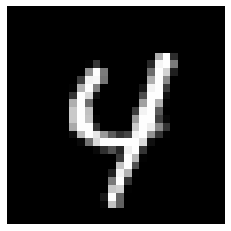

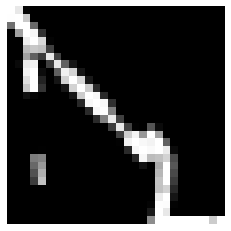

Loss: 0.0001127344734991808
Iteration: 37680, Score: 0.19906814428418879
[175, 39, 52, 71, 74, 62, 40, 39, 31, 30, 42, 62, 35, 248, 0]


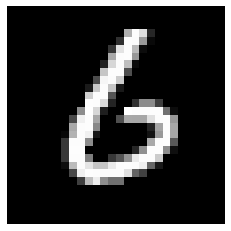

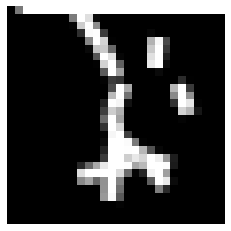

Loss: 0.00011358615619141694
Iteration: 37720, Score: 0.22021827730536464
[113, 20, 80, 52, 33, 76, 29, 44, 22, 36, 38, 109, 54, 294, 0]


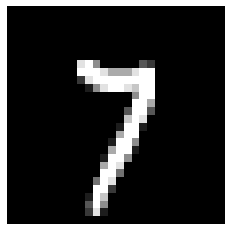

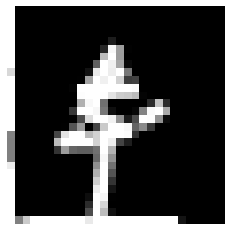

Loss: 0.0001252501112510541
Iteration: 37760, Score: 0.25531084652245045
[124, 23, 52, 36, 37, 37, 36, 40, 36, 33, 96, 149, 49, 252, 0]


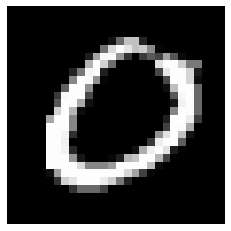

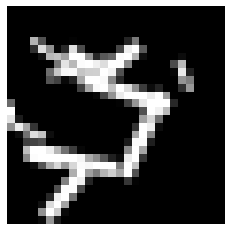

Loss: 0.00011492620379006047
Iteration: 37800, Score: 0.18861631907406265
[99, 22, 73, 33, 34, 99, 28, 45, 28, 26, 141, 127, 46, 199, 0]


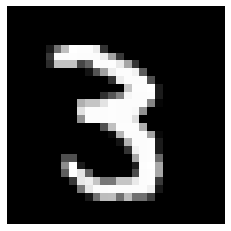

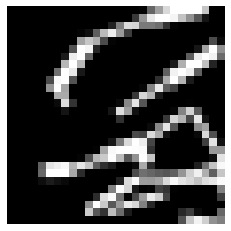

Loss: 0.00011383246459108818
Iteration: 37840, Score: 0.14224487507715822
[134, 25, 41, 28, 38, 37, 41, 34, 36, 28, 79, 125, 42, 312, 0]


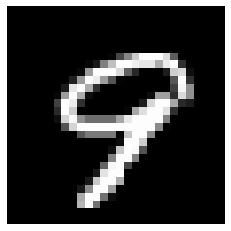

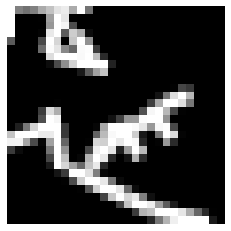

Loss: 0.00012326888490980998
Iteration: 37880, Score: 0.2583020188324153
[265, 36, 72, 31, 33, 74, 50, 30, 40, 30, 29, 154, 36, 120, 0]


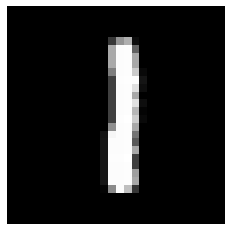

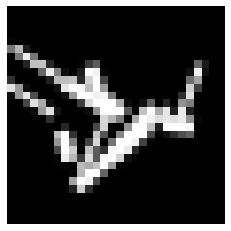

Loss: 0.00010637542877193752
Iteration: 37920, Score: 0.22913869987428187
[211, 28, 58, 44, 41, 64, 40, 63, 26, 19, 28, 125, 149, 104, 0]


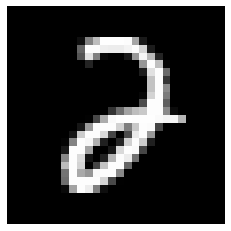

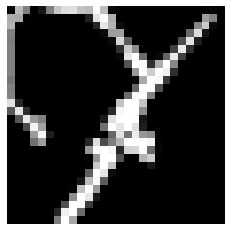

Loss: 0.0001041044123355268
Iteration: 37960, Score: 0.2088444220498204
[69, 32, 48, 66, 70, 61, 36, 26, 30, 32, 75, 123, 165, 167, 0]


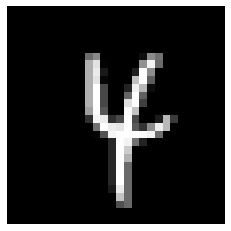

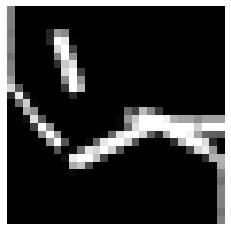

Loss: 0.0001011547196050101
Iteration: 38000, Score: 0.20092563989199697
[265, 24, 74, 31, 49, 74, 34, 31, 29, 21, 42, 121, 99, 106, 0]


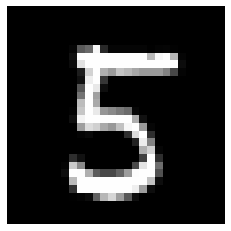

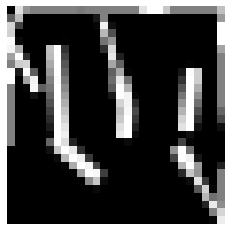

Test score: 0.17190755151212217
Loss: 0.00010499681552659844
Iteration: 38040, Score: 0.23035806949436663
[202, 37, 40, 30, 27, 30, 40, 36, 34, 30, 209, 137, 67, 81, 0]


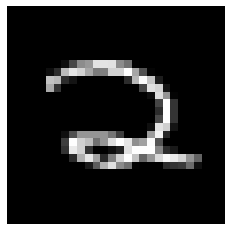

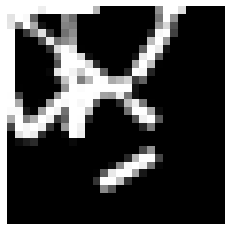

Loss: 0.00010766818034471881
Iteration: 38080, Score: 0.2685668349862098
[128, 47, 51, 75, 54, 30, 61, 34, 29, 26, 198, 133, 39, 95, 0]


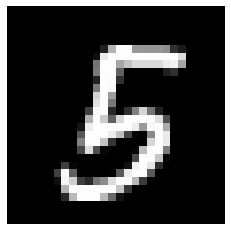

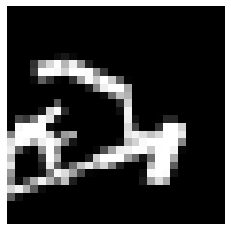

Loss: 0.00010953085171959338
Iteration: 38120, Score: 0.2086923170238733
[140, 54, 60, 33, 50, 33, 51, 30, 33, 38, 102, 122, 170, 84, 0]


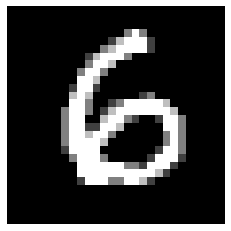

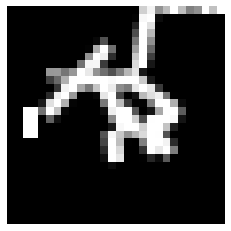

Loss: 0.00012048364808945767
Iteration: 38160, Score: 0.2148853726834059
[146, 55, 28, 56, 52, 32, 30, 28, 29, 27, 45, 82, 145, 245, 0]


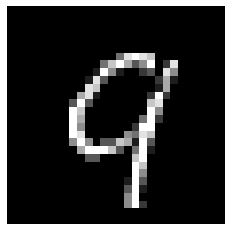

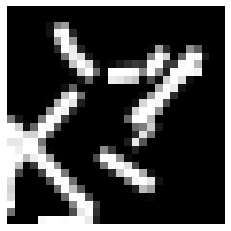

Loss: 0.00012304972920405661
Iteration: 38200, Score: 0.2503181362375616
[277, 34, 25, 33, 42, 31, 38, 46, 33, 36, 32, 178, 59, 136, 0]


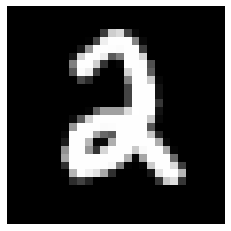

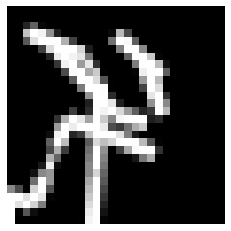

Loss: 0.00010775119088668893
Iteration: 38240, Score: 0.1969366741031408
[173, 39, 64, 94, 101, 55, 24, 37, 36, 37, 27, 226, 38, 49, 0]


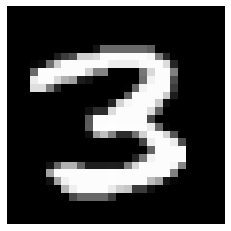

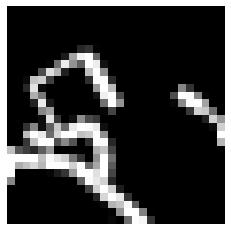

Loss: 0.0001051510335506679
Iteration: 38280, Score: 0.21870478371530763
[104, 54, 66, 29, 45, 45, 91, 29, 21, 38, 84, 281, 23, 90, 0]


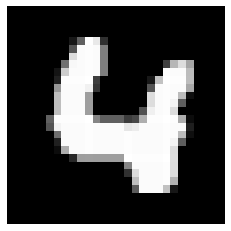

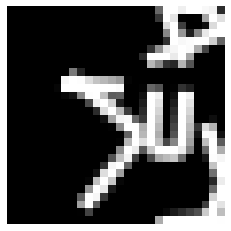

Loss: 0.00011897309439641934
Iteration: 38320, Score: 0.2883355757594109
[113, 90, 27, 22, 34, 36, 67, 27, 23, 48, 58, 324, 41, 90, 0]


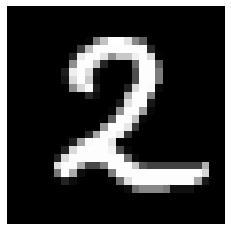

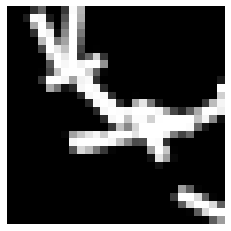

Loss: 0.00012597323157112917
Iteration: 38360, Score: 0.22576031492650506
[96, 53, 39, 25, 45, 64, 38, 42, 28, 59, 113, 289, 34, 75, 0]


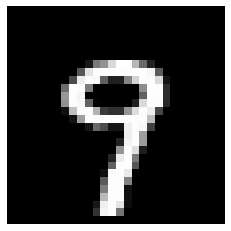

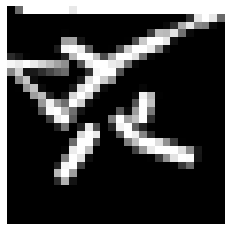

Loss: 0.00011675804208274223
Iteration: 38400, Score: 0.1902554547414184
[124, 52, 50, 30, 30, 36, 174, 57, 25, 30, 89, 135, 54, 114, 0]


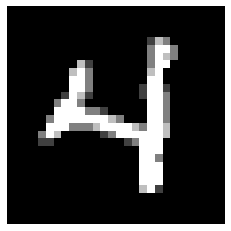

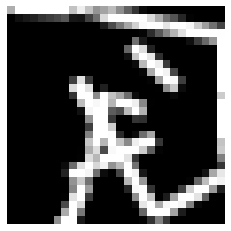

Test score: 0.21682774811983113
Loss: 0.00012480250769224588
Iteration: 38440, Score: 0.2108774209022522
[279, 38, 25, 20, 19, 24, 94, 67, 23, 36, 93, 91, 34, 157, 0]


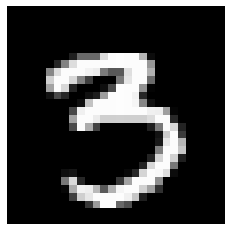

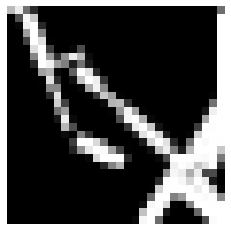

Loss: 0.00010464635689129847
Iteration: 38480, Score: 0.20783113391697405
[172, 45, 30, 18, 38, 34, 34, 52, 32, 47, 52, 106, 54, 286, 0]


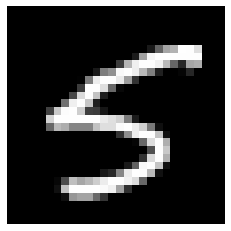

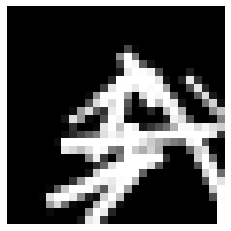

Loss: 0.00011553457508233273
Iteration: 38520, Score: 0.26557874841988083
[117, 31, 66, 35, 23, 65, 32, 34, 22, 33, 74, 92, 86, 290, 0]


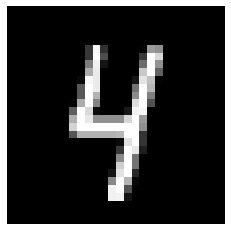

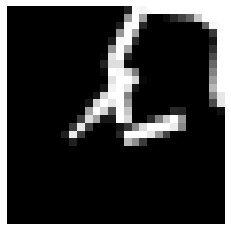

Loss: 0.00012500292982334715
Iteration: 38560, Score: 0.2659880417734385
[144, 30, 38, 37, 33, 32, 39, 38, 26, 48, 114, 128, 62, 231, 0]


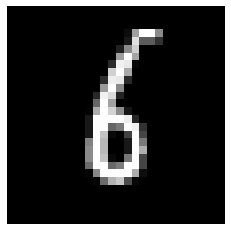

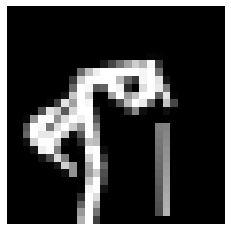

Loss: 0.0001409716665494831
Iteration: 38600, Score: 0.2255553549677134
[127, 36, 55, 35, 47, 40, 49, 34, 28, 27, 38, 75, 76, 333, 0]


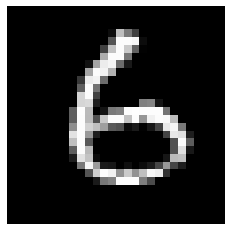

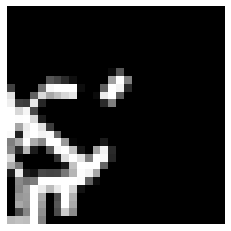

Loss: 0.00014835557629832137
Iteration: 38640, Score: 0.23027768651396036
[319, 44, 44, 29, 41, 31, 38, 52, 31, 31, 63, 62, 31, 184, 0]


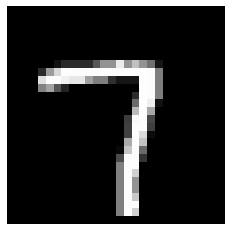

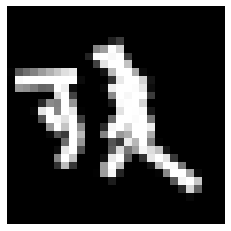

Loss: 0.000142229493566337
Iteration: 38680, Score: 0.22414897077530624
[325, 49, 40, 29, 20, 39, 31, 26, 33, 30, 49, 72, 61, 196, 0]


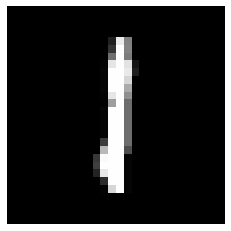

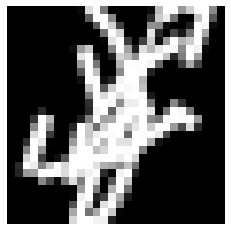

Loss: 0.00013411897316036319
Iteration: 38720, Score: 0.2213874170407653
[276, 68, 26, 22, 37, 34, 36, 33, 30, 29, 82, 122, 43, 162, 0]


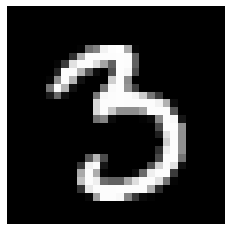

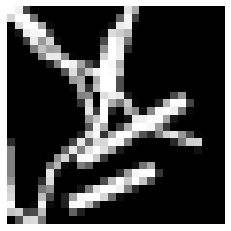

Loss: 0.00012617008062628225
Iteration: 38760, Score: 0.20891241663694382
[263, 99, 37, 37, 25, 40, 80, 28, 32, 24, 45, 63, 27, 200, 0]


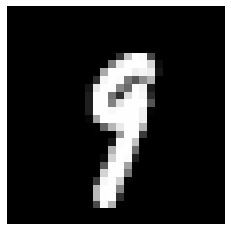

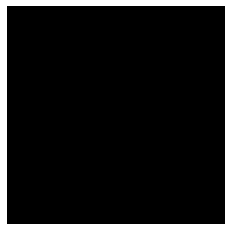

Loss: 0.00012950143915009147
Iteration: 38800, Score: 0.23727233953773977
[133, 38, 43, 42, 43, 52, 38, 41, 31, 29, 66, 93, 60, 291, 0]


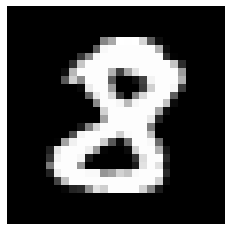

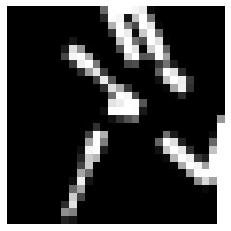

Test score: 0.154643589714542
Loss: 0.00012595845787832829
Iteration: 38840, Score: 0.260010918945074
[153, 46, 37, 33, 37, 69, 29, 35, 21, 28, 69, 137, 137, 169, 0]


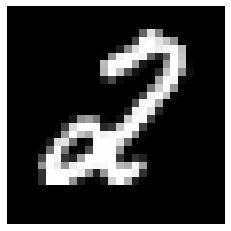

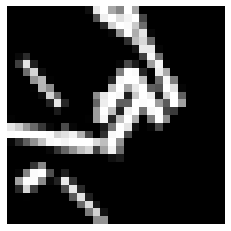

Loss: 0.00010619622875479245
Iteration: 38880, Score: 0.25553134124726057
[113, 56, 52, 21, 34, 67, 67, 31, 12, 39, 39, 273, 76, 120, 0]


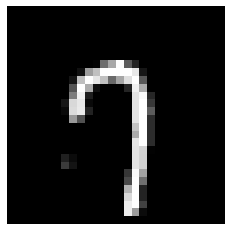

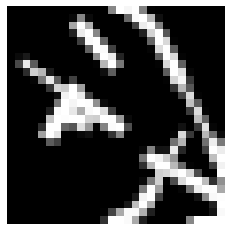

Loss: 0.00011461624177099465
Iteration: 38920, Score: 0.2567914814278484
[152, 55, 18, 47, 78, 49, 54, 43, 24, 24, 45, 116, 33, 262, 0]


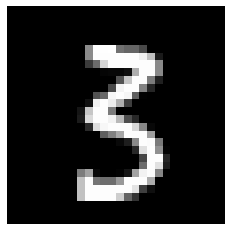

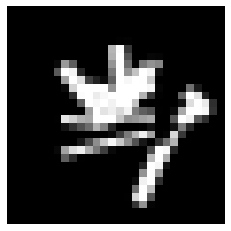

Loss: 0.00011851698752843488
Iteration: 38960, Score: 0.17173202957957984
[327, 26, 35, 30, 47, 42, 37, 42, 26, 27, 27, 100, 29, 205, 0]


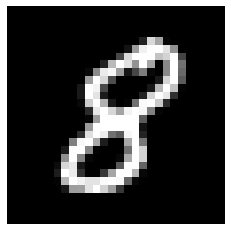

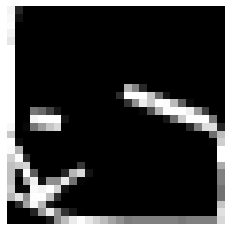

Loss: 0.00012209283815457723
Iteration: 39000, Score: 0.1938934300020337
[343, 30, 20, 31, 33, 22, 38, 45, 31, 33, 51, 119, 90, 114, 0]


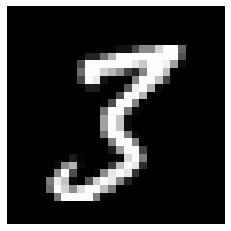

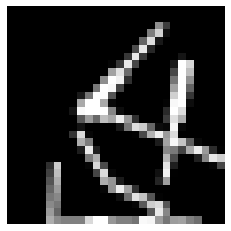

Loss: 9.507750641885951e-05
Iteration: 39040, Score: 0.19288374739326536
[260, 46, 37, 42, 50, 26, 28, 34, 27, 52, 71, 116, 71, 140, 0]


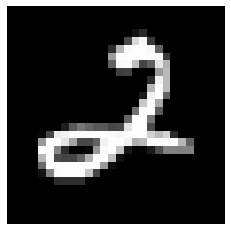

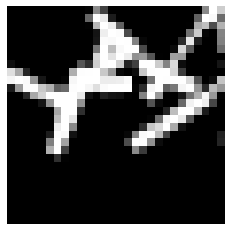

Loss: 9.020354854332299e-05
Iteration: 39080, Score: 0.23595316492766144
[179, 71, 50, 44, 46, 35, 92, 42, 19, 35, 37, 102, 192, 56, 0]


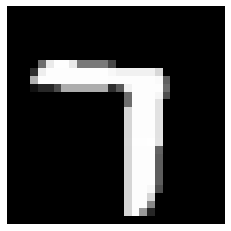

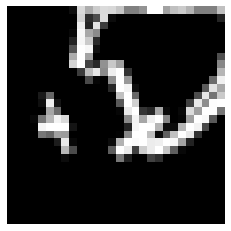

Loss: 0.00010742943393774382
Iteration: 39120, Score: 0.23219960997998715
[81, 33, 35, 29, 33, 36, 32, 47, 33, 41, 50, 134, 274, 142, 0]


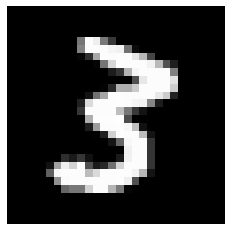

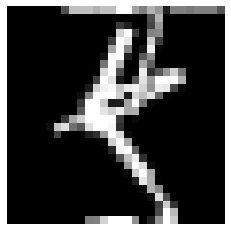

Loss: 8.203872077997988e-05
Iteration: 39160, Score: 0.19850338638573886
[79, 27, 25, 26, 58, 30, 52, 64, 29, 35, 263, 84, 107, 121, 0]


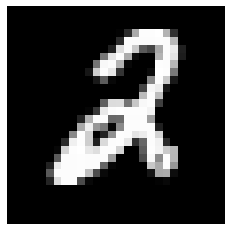

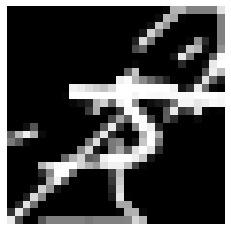

Loss: 0.0001001038793253875
Iteration: 39200, Score: 0.28425456166267393
[129, 44, 25, 31, 32, 43, 72, 57, 24, 35, 87, 111, 236, 74, 0]


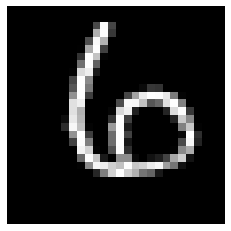

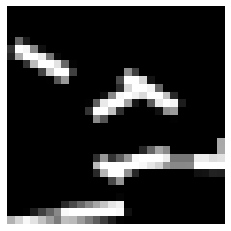

Test score: 0.1865406668037176
Loss: 0.00011049837732921139
Iteration: 39240, Score: 0.24665415421500803
[147, 31, 37, 37, 44, 35, 96, 35, 23, 37, 180, 127, 70, 101, 0]


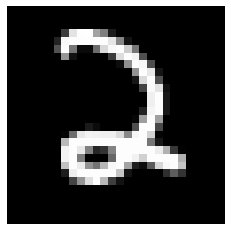

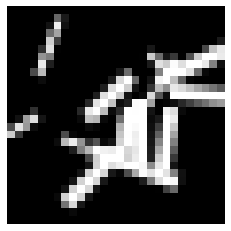

Loss: 0.00012209012203526283
Iteration: 39280, Score: 0.2533794244080782
[115, 36, 33, 37, 36, 78, 48, 53, 34, 28, 114, 116, 200, 72, 0]


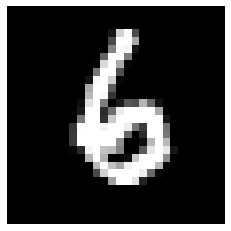

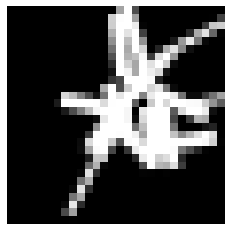

Loss: 0.0001437762804993855
Iteration: 39320, Score: 0.3137825356945396
[257, 47, 13, 64, 55, 35, 37, 40, 38, 57, 64, 105, 86, 102, 0]


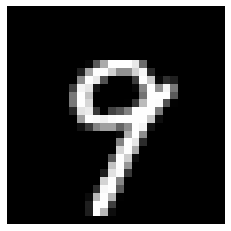

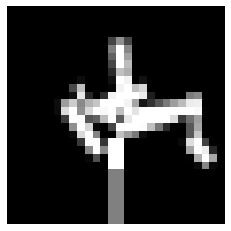

Loss: 0.00011410758283492191
Iteration: 39360, Score: 0.1970213355645537
[297, 37, 38, 34, 38, 27, 56, 64, 29, 43, 43, 79, 51, 164, 0]


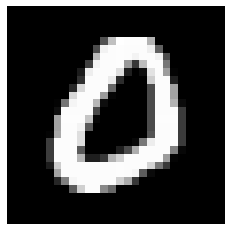

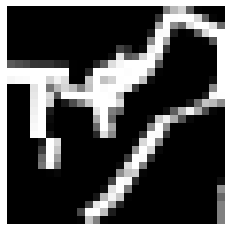

Loss: 0.00010411751691803979
Iteration: 39400, Score: 0.2143671520650387
[301, 60, 32, 22, 38, 53, 74, 57, 28, 28, 29, 86, 46, 146, 0]


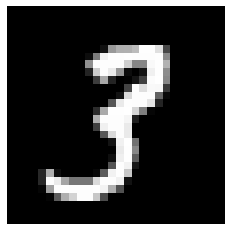

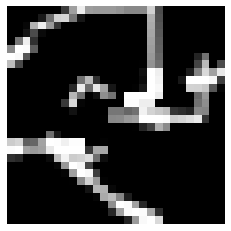

Loss: 0.00010461462065564267
Iteration: 39440, Score: 0.18514763036370277
[294, 30, 46, 38, 27, 56, 53, 54, 32, 17, 34, 154, 50, 115, 0]


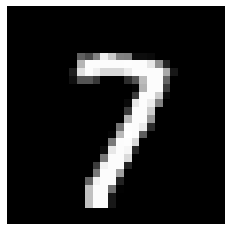

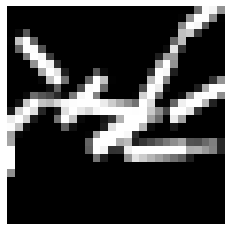

Loss: 9.818980370111592e-05
Iteration: 39480, Score: 0.22758773515652866
[121, 28, 47, 33, 41, 60, 49, 48, 29, 28, 42, 91, 52, 331, 0]


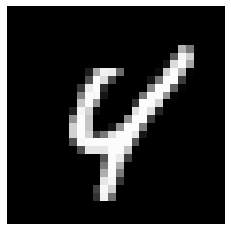

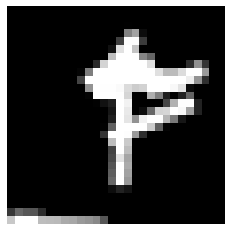

Loss: 0.00010767117328716559
Iteration: 39520, Score: 0.1387533160299063
[118, 64, 21, 24, 41, 55, 50, 65, 38, 33, 208, 96, 86, 101, 0]


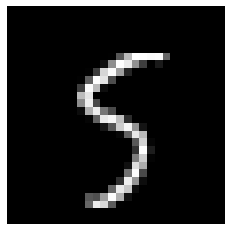

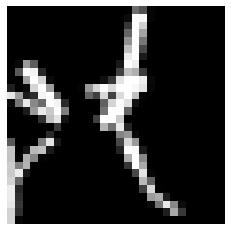

Loss: 0.00011448848118137992
Iteration: 39560, Score: 0.23139969120919704
[118, 41, 74, 20, 28, 95, 56, 79, 32, 23, 206, 93, 34, 101, 0]


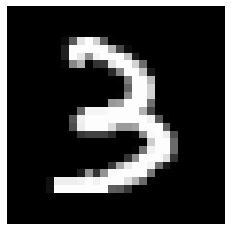

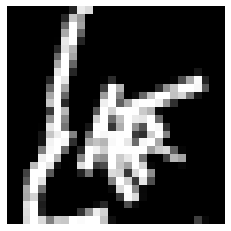

Loss: 0.00014405433383157614
Iteration: 39600, Score: 0.26103441940993066
[136, 49, 27, 43, 44, 28, 36, 44, 27, 39, 72, 241, 21, 193, 0]


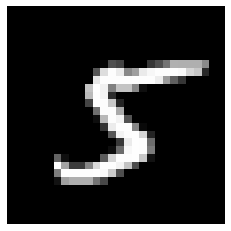

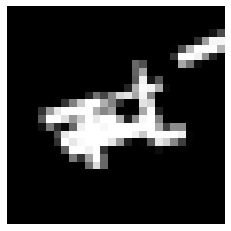

Test score: 0.14617604967951772
Loss: 0.0001258603584039534
Iteration: 39640, Score: 0.23812437428534033
[79, 117, 137, 14, 21, 148, 115, 35, 23, 20, 75, 87, 44, 85, 0]


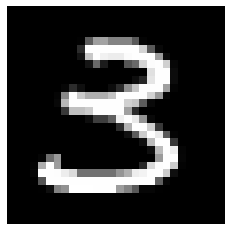

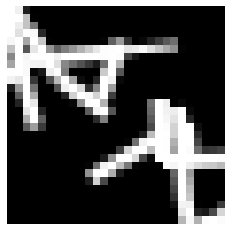

Loss: 0.0001430622638738743
Iteration: 39680, Score: 0.3087476154267788
[109, 122, 30, 18, 16, 35, 130, 67, 29, 22, 66, 224, 50, 82, 0]


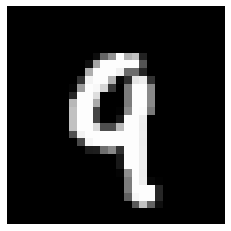

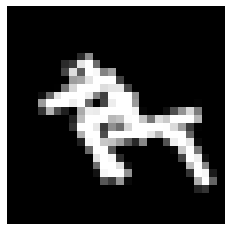

Loss: 0.00013347264459471857
Iteration: 39720, Score: 0.23256460119783878
[207, 90, 24, 25, 16, 22, 83, 71, 33, 32, 35, 149, 24, 189, 0]


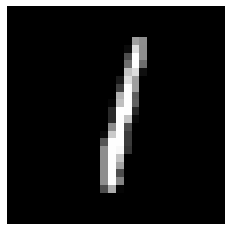

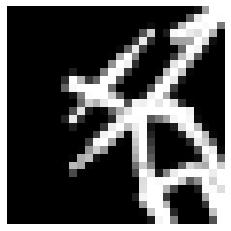

Loss: 0.00012894183347658282
Iteration: 39760, Score: 0.23656038929522033
[148, 85, 45, 23, 15, 58, 110, 64, 27, 18, 38, 92, 37, 240, 0]


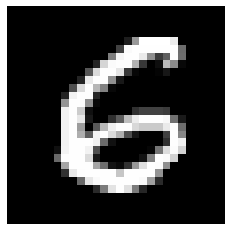

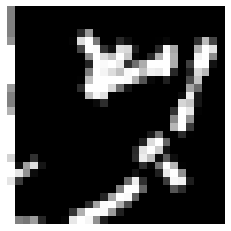

Loss: 0.00013155708404586621
Iteration: 39800, Score: 0.25699916176125404
[318, 37, 28, 29, 29, 57, 54, 56, 30, 17, 37, 103, 63, 142, 0]


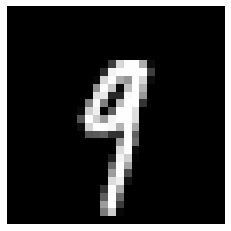

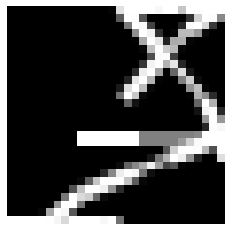

Loss: 0.00012644834441802078
Iteration: 39840, Score: 0.20359235791489488
[147, 40, 56, 38, 29, 59, 42, 61, 24, 34, 45, 126, 43, 256, 0]


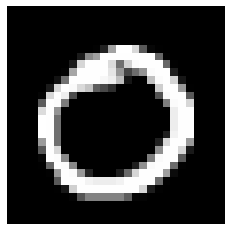

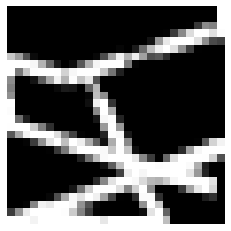

Loss: 0.0001226528077267733
Iteration: 39880, Score: 0.2308940614508465
[114, 64, 23, 19, 27, 27, 81, 82, 29, 26, 84, 120, 43, 261, 0]


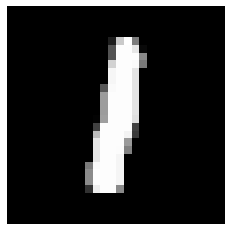

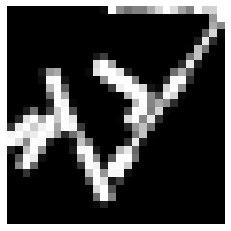

Loss: 0.00012508653811927118
Iteration: 39920, Score: 0.3027951180487871
[187, 37, 21, 35, 27, 40, 44, 50, 44, 36, 198, 90, 29, 162, 0]


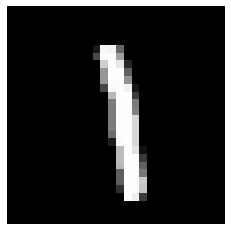

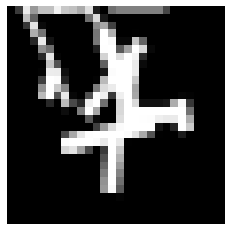

Loss: 0.00012903728449692038
Iteration: 39960, Score: 0.22988652382045985
[83, 146, 67, 21, 27, 58, 134, 31, 23, 36, 57, 69, 51, 197, 0]


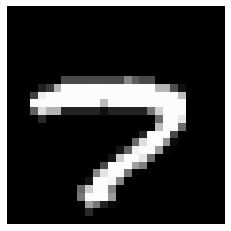

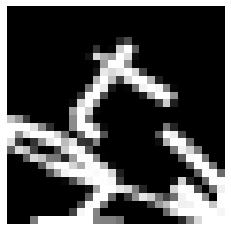

Loss: 0.00012541294174802097
Iteration: 40000, Score: 0.28808922242373225
[190, 24, 81, 33, 41, 51, 32, 59, 38, 32, 47, 134, 66, 172, 0]


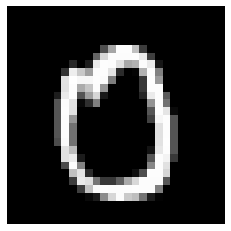

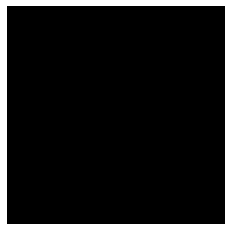

Test score: 0.22456894818414003
Loss: 0.00012878685191936156
Iteration: 40040, Score: 0.24818100795149797
[272, 22, 32, 23, 29, 41, 34, 61, 46, 40, 33, 127, 44, 196, 0]


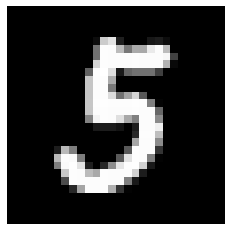

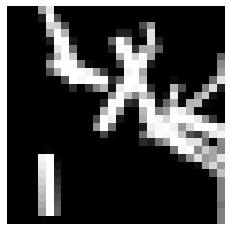

Loss: 0.00012006468897124528
Iteration: 40080, Score: 0.23410331411659718
[163, 18, 44, 32, 24, 26, 60, 80, 33, 31, 68, 160, 59, 202, 0]


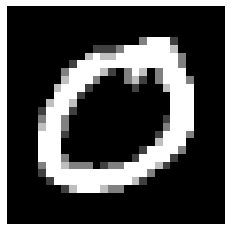

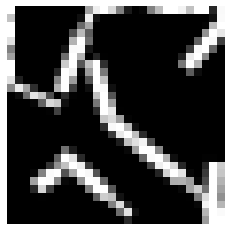

Loss: 0.00011331505383599862
Iteration: 40120, Score: 0.2836055504381657
[156, 37, 42, 32, 24, 41, 56, 178, 53, 26, 42, 70, 32, 211, 0]


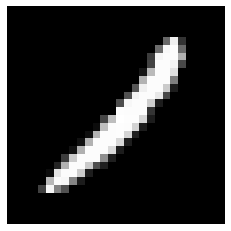

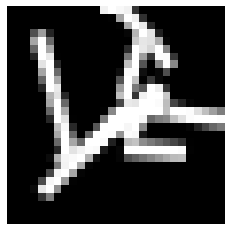

Loss: 0.00012417772703861304
Iteration: 40160, Score: 0.2678177049607038
[142, 22, 29, 61, 57, 33, 51, 46, 32, 23, 231, 115, 51, 107, 0]


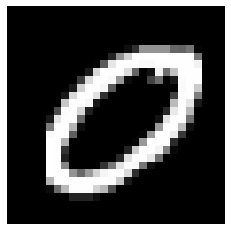

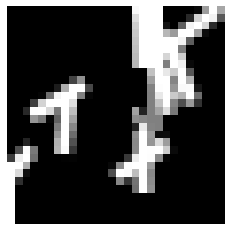

Loss: 0.00010903615509604018
Iteration: 40200, Score: 0.2165671546906233
[108, 73, 40, 25, 30, 27, 57, 34, 69, 31, 216, 107, 40, 143, 0]


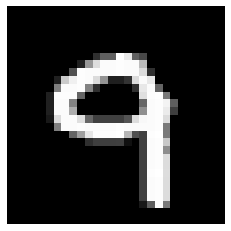

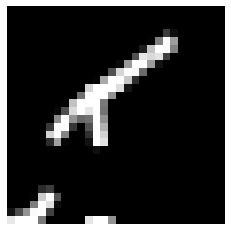

Loss: 0.0001387913123860789
Iteration: 40240, Score: 0.27541504617035384
[305, 37, 33, 15, 32, 26, 36, 44, 25, 22, 96, 148, 27, 154, 0]


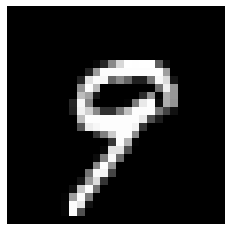

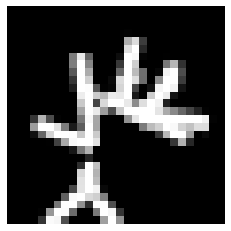

Loss: 0.00014227633020642385
Iteration: 40280, Score: 0.3232009223848581
[196, 46, 26, 31, 33, 38, 32, 42, 36, 23, 30, 67, 35, 365, 0]


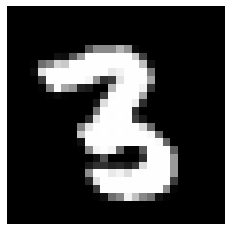

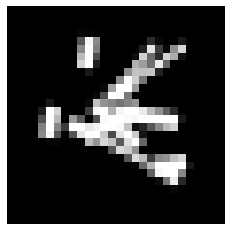

Loss: 0.00015649757961949402
Iteration: 40320, Score: 0.28164536827802655
[124, 20, 34, 23, 38, 40, 45, 62, 34, 31, 55, 126, 39, 329, 0]


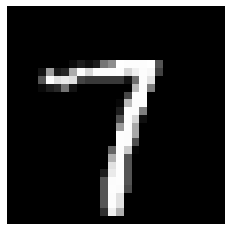

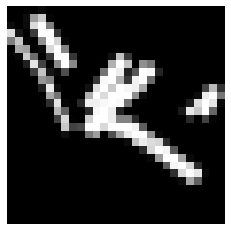

Loss: 0.00016348265253122874
Iteration: 40360, Score: 0.2989194285608828
[236, 29, 45, 31, 47, 70, 47, 44, 33, 35, 38, 166, 44, 135, 0]


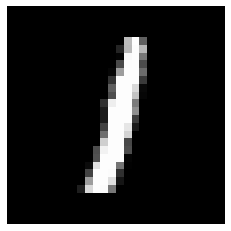

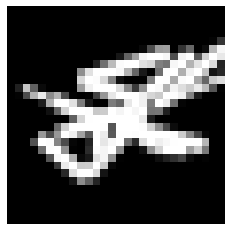

Loss: 0.00015227064807369047
Iteration: 40400, Score: 0.257323937177658
[344, 23, 23, 32, 37, 33, 37, 49, 27, 29, 58, 137, 43, 128, 0]


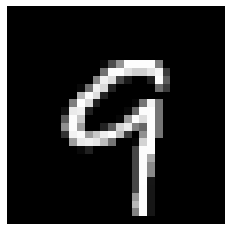

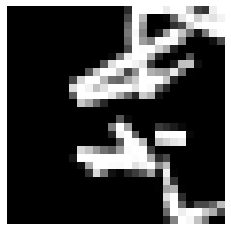

Test score: 0.19309265340119602
Loss: 0.00013916736281584425
Iteration: 40440, Score: 0.23339194788038736
[292, 27, 24, 32, 40, 36, 38, 67, 31, 25, 52, 118, 19, 199, 0]


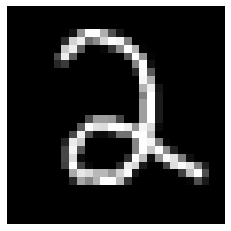

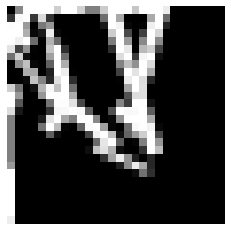

Loss: 0.00012047522563242945
Iteration: 40480, Score: 0.19230608159303664
[188, 22, 57, 53, 40, 54, 37, 51, 27, 49, 55, 131, 35, 201, 0]


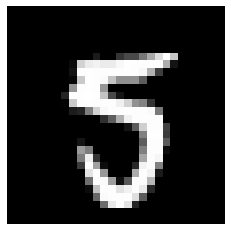

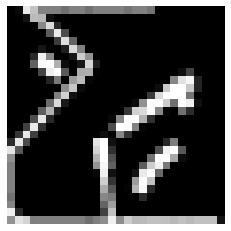

Loss: 0.00012345919410378532
Iteration: 40520, Score: 0.2729688267931343
[175, 48, 36, 22, 26, 27, 58, 53, 25, 48, 190, 132, 50, 110, 0]


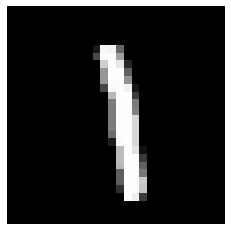

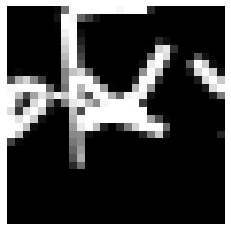

Loss: 0.00011799298905616351
Iteration: 40560, Score: 0.3080141052901745
[176, 35, 36, 36, 32, 44, 45, 48, 36, 36, 24, 272, 37, 143, 0]


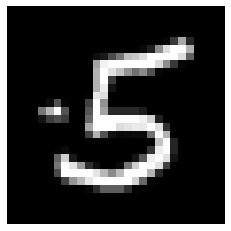

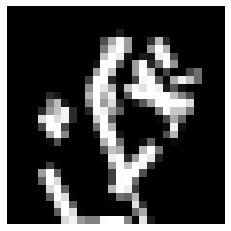

Loss: 0.00011553395988612082
Iteration: 40600, Score: 0.20535254709422585
[104, 40, 118, 16, 27, 135, 23, 51, 16, 27, 33, 123, 203, 84, 0]


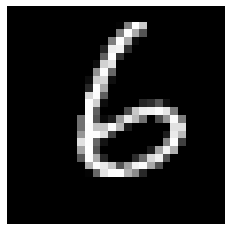

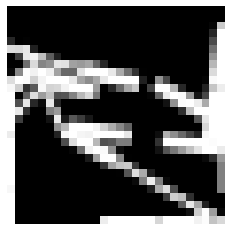

Loss: 0.00012656592997489682
Iteration: 40640, Score: 0.3215736555159092
[185, 25, 45, 31, 37, 39, 55, 75, 52, 19, 45, 105, 33, 254, 0]


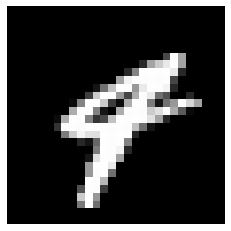

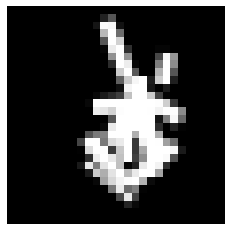

Loss: 0.00013737204502491866
Iteration: 40680, Score: 0.25633826648816466
[304, 32, 37, 21, 47, 34, 33, 62, 27, 23, 42, 159, 33, 146, 0]


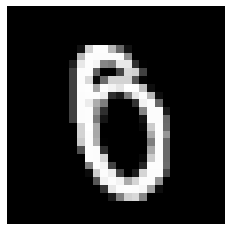

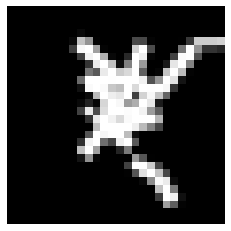

Loss: 0.00012437888990901914
Iteration: 40720, Score: 0.24285064854472874
[92, 25, 69, 34, 29, 46, 56, 57, 46, 28, 78, 162, 105, 173, 0]


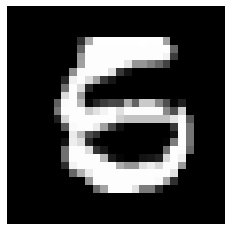

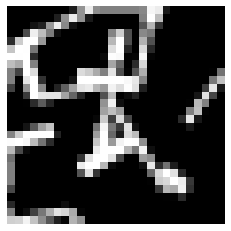

Loss: 0.00012833002451052077
Iteration: 40760, Score: 0.22328581200540065
[203, 44, 41, 26, 47, 42, 31, 56, 26, 24, 50, 125, 108, 177, 0]


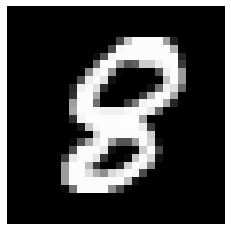

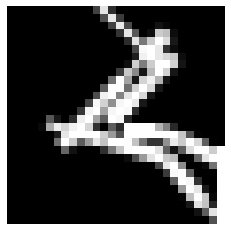

Loss: 0.00011503974356871281
Iteration: 40800, Score: 0.21195989290997383
[203, 30, 28, 24, 45, 48, 37, 95, 40, 29, 94, 140, 37, 150, 0]


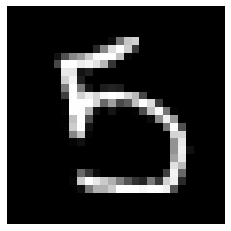

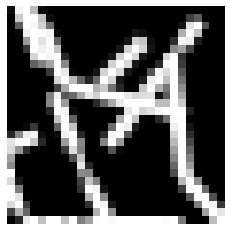

Test score: 0.19846240825206038
Loss: 0.0001264046767249456
Iteration: 40840, Score: 0.2522029463425278
[143, 31, 63, 30, 39, 84, 48, 79, 27, 20, 78, 98, 110, 150, 0]


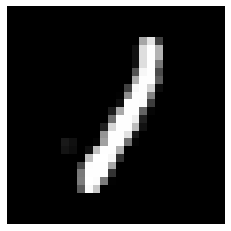

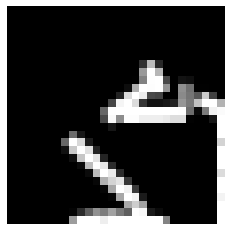

Loss: 0.00011293225922597746
Iteration: 40880, Score: 0.21582329425215724
[111, 38, 59, 22, 31, 56, 33, 88, 27, 36, 84, 157, 117, 141, 0]


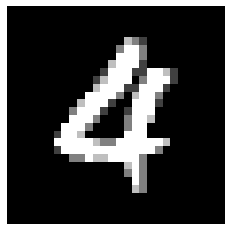

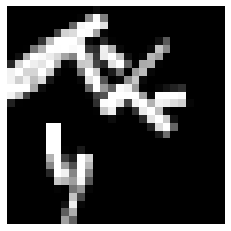

Loss: 0.00013417811517782197
Iteration: 40920, Score: 0.2625709354579449
[121, 28, 62, 52, 35, 76, 65, 64, 38, 19, 50, 143, 30, 217, 0]


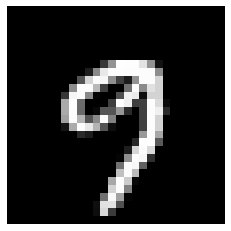

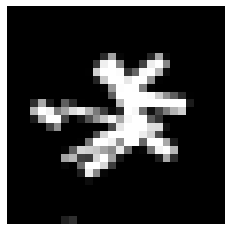

Loss: 0.00013618994721387883
Iteration: 40960, Score: 0.28331096415323553
[134, 47, 35, 24, 65, 34, 35, 80, 47, 24, 65, 172, 39, 199, 0]


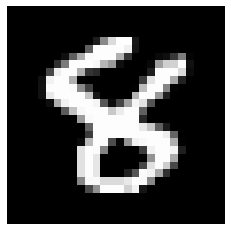

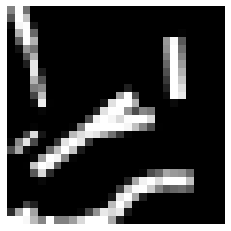

Loss: 0.00015517003699217548
Iteration: 41000, Score: 0.29340422918647524
[137, 64, 55, 24, 53, 40, 61, 108, 27, 16, 56, 209, 26, 124, 0]


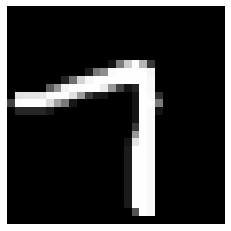

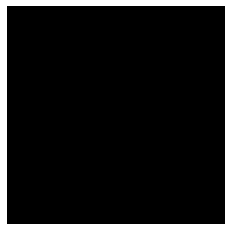

Loss: 0.0001317205186349286
Iteration: 41040, Score: 0.23866371209919457
[171, 55, 37, 33, 36, 30, 44, 98, 29, 29, 28, 212, 45, 153, 0]


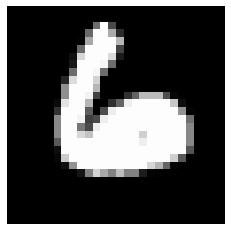

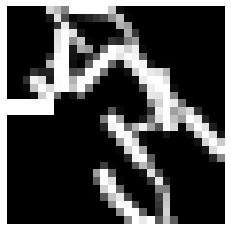

Loss: 0.00012693888643347374
Iteration: 41080, Score: 0.22529086419194927
[232, 45, 52, 39, 38, 63, 41, 60, 29, 39, 50, 174, 36, 102, 0]


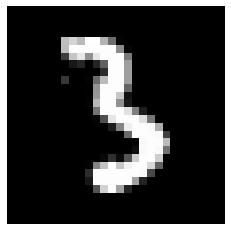

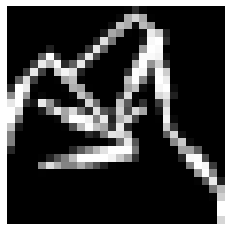

Loss: 0.0001312201166169961
Iteration: 41120, Score: 0.2542765881940723
[261, 73, 67, 20, 41, 68, 53, 56, 23, 29, 30, 141, 44, 94, 0]


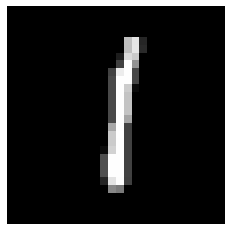

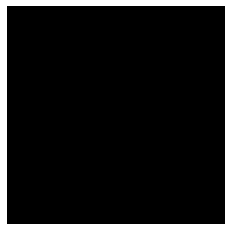

Loss: 0.00011335842741031338
Iteration: 41160, Score: 0.23527054998278615
[252, 32, 58, 23, 65, 58, 48, 37, 20, 24, 115, 108, 32, 128, 0]


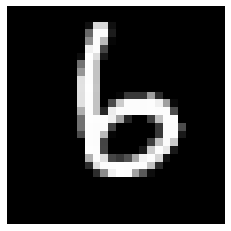

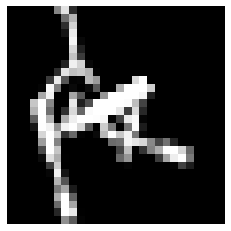

Loss: 0.00010108462269149339
Iteration: 41200, Score: 0.306822016261518
[108, 66, 26, 40, 43, 45, 40, 113, 21, 23, 193, 103, 44, 135, 0]


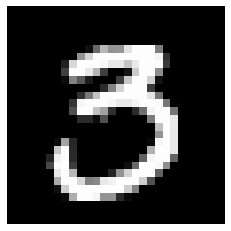

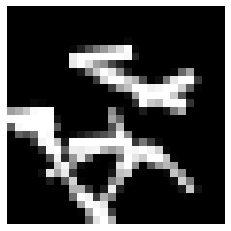

Test score: 0.2201963332444429
Loss: 0.00012840442517755892
Iteration: 41240, Score: 0.28679521231353294
[149, 28, 44, 35, 46, 37, 39, 80, 32, 27, 224, 106, 39, 114, 0]


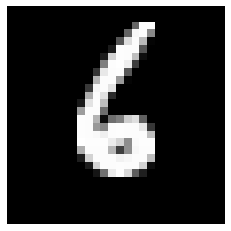

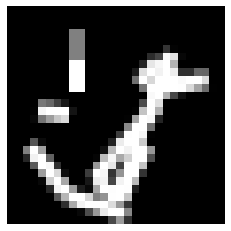

Loss: 0.0001413722959929153
Iteration: 41280, Score: 0.26504784301668405
[112, 60, 47, 20, 33, 57, 52, 62, 26, 29, 213, 102, 78, 109, 0]


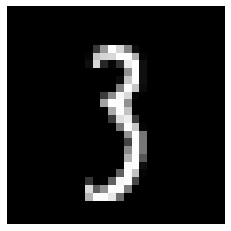

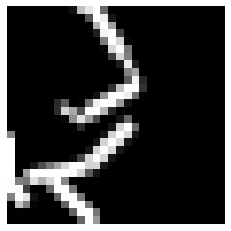

Loss: 0.00015363092845435258
Iteration: 41320, Score: 0.3357430901825427
[238, 37, 54, 14, 27, 49, 31, 71, 39, 16, 118, 95, 88, 123, 0]


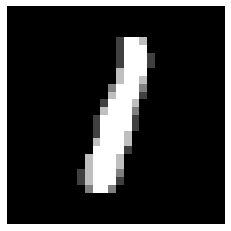

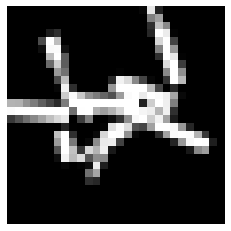

Loss: 0.00015790817605509916
Iteration: 41360, Score: 0.24585124244354667
[296, 51, 74, 19, 41, 79, 25, 41, 15, 21, 41, 88, 76, 133, 0]


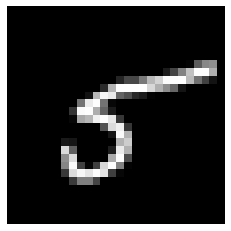

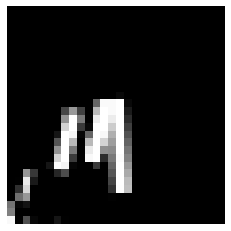

Loss: 0.0001550429463504862
Iteration: 41400, Score: 0.23370867492951222
[245, 32, 65, 24, 45, 77, 24, 59, 42, 44, 63, 124, 46, 110, 0]


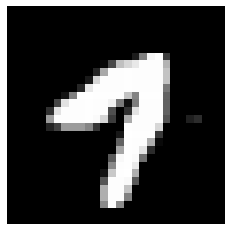

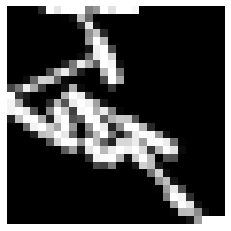

Loss: 0.00013891965696262345
Iteration: 41440, Score: 0.21867717955633995
[285, 30, 72, 26, 42, 85, 43, 29, 27, 40, 58, 146, 35, 82, 0]


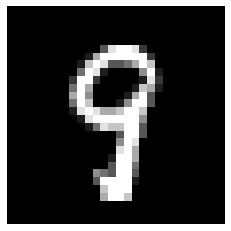

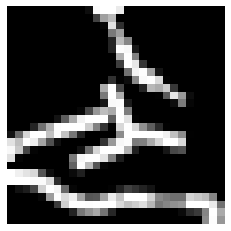

Loss: 0.00013617475522007365
Iteration: 41480, Score: 0.26495536883920423
[217, 48, 51, 27, 34, 31, 36, 46, 25, 31, 84, 237, 35, 98, 0]


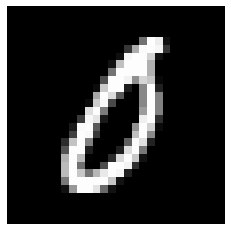

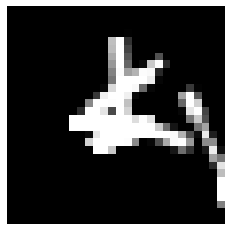

Loss: 0.00015352411554353968
Iteration: 41520, Score: 0.2985449860468507
[110, 23, 66, 31, 26, 75, 36, 52, 37, 86, 93, 243, 25, 97, 0]


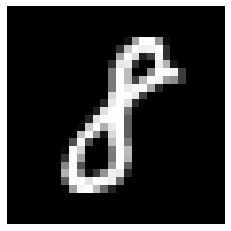

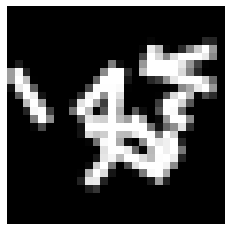

Loss: 0.00014203437669671866
Iteration: 41560, Score: 0.269070883847773
[135, 32, 86, 25, 29, 113, 26, 40, 39, 11, 84, 238, 30, 112, 0]


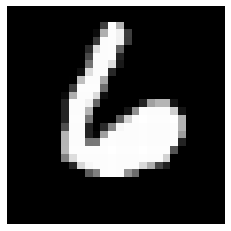

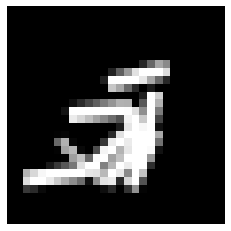

Loss: 0.00015098911990784128
Iteration: 41600, Score: 0.2819210598319769
[181, 35, 29, 26, 30, 53, 40, 37, 33, 25, 52, 281, 37, 141, 0]


Test score: 0.1973081197278807
Loss: 0.0001375599336531214
Iteration: 41640, Score: 0.197932390820235
[190, 29, 73, 35, 50, 72, 23, 45, 22, 70, 34, 181, 18, 158, 0]


Loss: 0.00013665650018064734
Iteration: 41680, Score: 0.35429387979209426
[237, 30, 30, 24, 27, 71, 25, 82, 22, 27, 50, 113, 16, 246, 0]


Loss: 0.00013760536903887268
Iteration: 41720, Score: 0.24062844566255803
[220, 31, 56, 42, 71, 71, 20, 67, 33, 25, 36, 113, 20, 195, 0]


Loss: 0.00013683475248065256
Iteration: 41760, Score: 0.19566398516297337
[204, 39, 55, 24, 39, 91, 24, 52, 26, 23, 38, 109, 28, 248, 0]


Loss: 0.00013668578427919757
Iteration: 41800, Score: 0.2944219745174049
[234, 29, 35, 74, 57, 39, 24, 61, 32, 25, 28, 153, 23, 186, 0]


Loss: 0.00013062036373787293
Iteration: 41840, Score: 0.28041165818274016
[220, 54, 26, 76, 73, 35, 31, 43, 32, 22, 23, 195, 30, 140, 0]


Loss: 0.00013038842460891633
Iteration: 41880, Score: 0.24313312703371043
[122, 22, 56, 27, 55, 79, 34, 50, 33, 32, 34, 151, 81, 224, 0]


Loss: 0.0001190371822336775
Iteration: 41920, Score: 0.24968481008708468
[229, 28, 63, 21, 32, 89, 28, 37, 23, 18, 37, 157, 93, 145, 0]


Loss: 0.00011754687832536643
Iteration: 41960, Score: 0.26295454885065556
[312, 19, 61, 29, 39, 53, 21, 38, 23, 36, 56, 123, 43, 147, 0]


Loss: 0.00013073985689748802
Iteration: 42000, Score: 0.31825176186859616
[176, 29, 81, 51, 51, 43, 26, 36, 42, 51, 65, 169, 46, 134, 0]


Test score: 0.23880862237885597
Loss: 0.0001406102772490231
Iteration: 42040, Score: 0.28760094989836216
[167, 36, 50, 21, 34, 53, 27, 50, 61, 42, 45, 199, 117, 98, 0]


Loss: 0.000139764435600825
Iteration: 42080, Score: 0.29259480019100004
[191, 70, 29, 54, 58, 32, 77, 42, 35, 45, 34, 132, 105, 96, 0]


Loss: 0.00015828902772496364
Iteration: 42120, Score: 0.277043771751225
[229, 59, 21, 46, 44, 25, 50, 55, 32, 47, 46, 149, 65, 132, 0]


Loss: 0.00017358635528104678
Iteration: 42160, Score: 0.34832190001010893
[248, 35, 54, 31, 51, 58, 31, 36, 40, 33, 35, 170, 44, 134, 0]


Loss: 0.00014664347769610014
Iteration: 42200, Score: 0.27113331604003915
[250, 40, 54, 28, 66, 62, 29, 40, 30, 20, 30, 172, 56, 123, 0]


Loss: 0.00015390295824638294
Iteration: 42240, Score: 0.24150766840577126
[253, 64, 20, 51, 59, 50, 35, 80, 19, 17, 60, 162, 37, 93, 0]


Loss: 0.00013588130863435128
Iteration: 42280, Score: 0.2627581462711096
[302, 16, 68, 38, 42, 84, 28, 36, 23, 15, 27, 156, 30, 135, 0]


Loss: 0.00013756628858105507
Iteration: 42320, Score: 0.2970094872862102
[252, 28, 29, 38, 41, 42, 25, 34, 21, 26, 130, 199, 33, 102, 0]


Loss: 0.00012183360923032488
Iteration: 42360, Score: 0.30757855097483844
[138, 45, 25, 32, 44, 36, 34, 33, 32, 25, 218, 194, 30, 114, 0]


Loss: 0.00014385783208726687
Iteration: 42400, Score: 0.29282208660244946
[160, 31, 87, 28, 44, 82, 24, 24, 23, 29, 138, 196, 24, 110, 0]


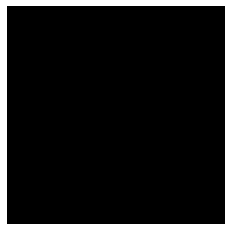

Test score: 0.2248263573199511
Loss: 0.00015400906319984738
Iteration: 42440, Score: 0.2664375724866986
[229, 44, 29, 35, 34, 35, 26, 31, 23, 23, 82, 199, 21, 189, 0]


Loss: 0.0001419673409050766
Iteration: 42480, Score: 0.24804899626970292
[316, 31, 29, 24, 26, 42, 28, 43, 29, 48, 38, 164, 46, 136, 0]


Loss: 0.0001359897667548638
Iteration: 42520, Score: 0.23545910055190325
[298, 74, 34, 31, 29, 28, 66, 31, 22, 28, 35, 191, 46, 87, 0]


Loss: 0.00014325520146118032
Iteration: 42560, Score: 0.30051643451303234
[127, 56, 71, 31, 51, 88, 56, 47, 19, 30, 36, 264, 33, 91, 0]


Loss: 0.00013051553158286387
Iteration: 42600, Score: 0.3008212274312973
[158, 29, 99, 27, 22, 115, 27, 45, 19, 23, 54, 242, 49, 91, 0]


Loss: 0.00015516906270130373
Iteration: 42640, Score: 0.34810960070788866
[179, 28, 89, 32, 26, 80, 35, 33, 21, 21, 75, 240, 34, 107, 0]


Loss: 0.00015188834274433655
Iteration: 42680, Score: 0.28006594852381383
[229, 31, 68, 28, 54, 80, 25, 50, 18, 22, 63, 208, 26, 98, 0]


Loss: 0.0001622762574682936
Iteration: 42720, Score: 0.2855844938009978
[287, 18, 43, 21, 51, 54, 32, 36, 30, 29, 42, 191, 46, 120, 0]


Loss: 0.00017093786181143284
Iteration: 42760, Score: 0.3233106392771006
[272, 55, 25, 29, 39, 51, 75, 27, 21, 33, 24, 202, 36, 111, 0]


Loss: 0.00016238025268998593
Iteration: 42800, Score: 0.288993575265631
[188, 97, 46, 44, 63, 69, 63, 68, 17, 25, 25, 134, 19, 142, 0]


Test score: 0.23202812936808911
Loss: 0.0001715684571750022
Iteration: 42840, Score: 0.2884246705472469
[187, 93, 27, 13, 25, 37, 97, 59, 16, 24, 146, 144, 16, 116, 0]


Loss: 0.0001548189507989987
Iteration: 42880, Score: 0.26930655457824465
[267, 40, 39, 16, 38, 24, 46, 41, 25, 21, 71, 168, 26, 178, 0]


Loss: 0.00016877902553543074
Iteration: 42920, Score: 0.29773896741867056
[286, 69, 21, 18, 28, 18, 57, 27, 32, 21, 49, 162, 34, 178, 0]


Loss: 0.00013722129818080883
Iteration: 42960, Score: 0.29851230739802126
[255, 43, 34, 21, 25, 44, 28, 54, 18, 32, 52, 234, 25, 135, 0]


Loss: 0.00015182324117014198
Iteration: 43000, Score: 0.2404435913190246
[237, 44, 43, 26, 74, 30, 34, 87, 17, 25, 39, 223, 30, 91, 0]


Loss: 0.0001231373486462152
Iteration: 43040, Score: 0.22943781175836922
[229, 38, 37, 45, 73, 44, 20, 66, 21, 19, 57, 216, 22, 113, 0]


Loss: 0.0001335410100578588
Iteration: 43080, Score: 0.2756307029575109
[250, 23, 36, 41, 40, 29, 33, 56, 43, 22, 45, 258, 28, 96, 0]


Loss: 0.00014661526888209712
Iteration: 43120, Score: 0.32770558416843415
[153, 72, 49, 28, 34, 82, 73, 30, 29, 21, 25, 325, 35, 44, 0]


Loss: 0.0001348222569960168
Iteration: 43160, Score: 0.2644977501481771
[207, 27, 60, 29, 30, 79, 43, 100, 38, 24, 69, 213, 23, 58, 0]


Loss: 0.00014624854003081816
Iteration: 43200, Score: 0.2987140664812178
[124, 37, 98, 28, 48, 131, 28, 66, 21, 20, 41, 217, 79, 62, 0]


Test score: 0.26005913683772086
Loss: 0.000156555787858561
Iteration: 43240, Score: 0.23241953474434554
[285, 31, 41, 18, 43, 36, 30, 36, 24, 29, 40, 222, 89, 76, 0]


Loss: 0.00013078604411562023
Iteration: 43280, Score: 0.2801915649082511
[325, 32, 36, 20, 35, 37, 37, 56, 25, 22, 47, 194, 43, 91, 0]


Loss: 0.00012338768804488214
Iteration: 43320, Score: 0.23250723850727079
[268, 30, 64, 32, 43, 52, 52, 69, 40, 17, 42, 185, 39, 67, 0]


Loss: 0.00012686347981324023
Iteration: 43360, Score: 0.27424395945668223
[247, 26, 85, 30, 34, 92, 43, 58, 25, 28, 24, 230, 31, 47, 0]


Loss: 0.00013333674667902277
Iteration: 43400, Score: 0.3149414111971856
[176, 36, 71, 35, 25, 89, 40, 58, 21, 11, 37, 268, 19, 114, 0]


Loss: 0.00012946948066695717
Iteration: 43440, Score: 0.3203580607920885
[132, 32, 52, 41, 39, 52, 39, 69, 27, 34, 69, 166, 120, 128, 0]


Loss: 0.0001673546624374905
Iteration: 43480, Score: 0.26283057652413844
[166, 59, 23, 26, 29, 38, 39, 62, 26, 25, 58, 150, 151, 148, 0]


Loss: 0.0001430562365354604
Iteration: 43520, Score: 0.3026653575599193
[256, 30, 71, 17, 34, 88, 51, 51, 24, 17, 33, 186, 52, 90, 0]


Loss: 0.00014048790784115938
Iteration: 43560, Score: 0.28911299612000574
[250, 30, 49, 22, 38, 50, 35, 53, 18, 24, 33, 239, 62, 97, 0]


Loss: 0.0001334385424600463
Iteration: 43600, Score: 0.30658416501432656
[217, 123, 16, 48, 28, 49, 121, 70, 15, 18, 33, 165, 21, 76, 0]


Test score: 0.19235176986269653
Loss: 0.00013470081719905912
Iteration: 43640, Score: 0.2965422432720661
[215, 52, 31, 31, 41, 42, 78, 56, 27, 14, 37, 305, 23, 48, 0]


Loss: 0.0001270709107285541
Iteration: 43680, Score: 0.2719253078321926
[210, 28, 32, 52, 23, 22, 49, 105, 31, 38, 37, 290, 31, 52, 0]


Loss: 0.00013124006485429332
Iteration: 43720, Score: 0.2996787478923798
[186, 32, 36, 61, 38, 30, 48, 89, 21, 48, 38, 250, 38, 85, 0]


Loss: 0.0001184586942339596
Iteration: 43760, Score: 0.3127249757442624
[231, 29, 38, 35, 23, 38, 40, 51, 37, 23, 32, 293, 43, 87, 0]


Loss: 0.00013285864481822832
Iteration: 43800, Score: 0.3294019816815853
[240, 35, 32, 30, 32, 41, 32, 82, 39, 41, 27, 258, 33, 78, 0]


Loss: 0.0001410648519738678
Iteration: 43840, Score: 0.292321246240288
[203, 81, 23, 27, 31, 26, 89, 88, 26, 19, 46, 267, 29, 45, 0]


Loss: 0.000129768402323212
Iteration: 43880, Score: 0.31575986510515214
[204, 33, 36, 69, 36, 39, 59, 74, 23, 18, 66, 236, 40, 67, 0]


Loss: 0.0001377990496930576
Iteration: 43920, Score: 0.31318611301481725
[260, 32, 27, 40, 30, 37, 45, 60, 35, 35, 44, 241, 36, 78, 0]


Loss: 0.00014648310667575082
Iteration: 43960, Score: 0.30584902006387704
[236, 46, 51, 33, 43, 54, 31, 68, 11, 17, 27, 278, 40, 65, 0]


Loss: 0.00015231672893366343
Iteration: 44000, Score: 0.3470732706785202
[241, 30, 47, 25, 39, 30, 33, 66, 21, 33, 48, 268, 34, 85, 0]


Test score: 0.23617857956141233
Loss: 0.00013687384412460052
Iteration: 44040, Score: 0.28367038944363593
[201, 37, 62, 19, 26, 45, 27, 64, 38, 29, 39, 285, 48, 80, 0]


Loss: 0.00013000332151573627
Iteration: 44080, Score: 0.34202790684998036
[248, 55, 30, 23, 30, 43, 53, 56, 63, 20, 33, 266, 24, 56, 0]


Loss: 0.00015264955114813015
Iteration: 44120, Score: 0.24921454004611593
[265, 21, 26, 20, 32, 36, 50, 97, 17, 24, 47, 260, 19, 86, 0]


Loss: 0.00015208668176116066
Iteration: 44160, Score: 0.3280720513910055
[173, 62, 31, 27, 37, 33, 54, 57, 30, 27, 74, 299, 30, 66, 0]


Loss: 0.00014433263249469488
Iteration: 44200, Score: 0.3251311355158687
[228, 38, 50, 25, 27, 58, 29, 63, 29, 20, 40, 314, 30, 49, 0]


Loss: 0.0001622715716580304
Iteration: 44240, Score: 0.3589417349547148
[218, 65, 72, 32, 24, 73, 95, 35, 14, 35, 28, 212, 26, 71, 0]


Loss: 0.00014940459563539686
Iteration: 44280, Score: 0.35222131332755086
[224, 52, 47, 27, 45, 70, 50, 72, 13, 26, 44, 240, 23, 67, 0]


Loss: 0.00016023640061310683
Iteration: 44320, Score: 0.33897180564701557
[228, 36, 38, 27, 32, 34, 61, 60, 15, 30, 47, 212, 24, 156, 0]


Loss: 0.00014719140868471746
Iteration: 44360, Score: 0.3092220760434865
[249, 38, 31, 36, 34, 34, 34, 46, 16, 32, 43, 269, 29, 109, 0]


Loss: 0.00014906283403418418
Iteration: 44400, Score: 0.29623780726641413
[269, 26, 49, 29, 25, 54, 35, 56, 15, 23, 41, 235, 41, 102, 0]


Test score: 0.26576381755247713
Loss: 0.0001397092344215386
Iteration: 44440, Score: 0.3030469825640321
[266, 24, 25, 34, 35, 15, 28, 66, 36, 32, 47, 226, 80, 86, 0]


Loss: 0.00015429294725529565
Iteration: 44480, Score: 0.3326011660248041
[185, 34, 48, 21, 37, 55, 26, 112, 35, 17, 44, 274, 24, 88, 0]


Loss: 0.0001441851182691766
Iteration: 44520, Score: 0.2926137796491385
[187, 42, 32, 51, 26, 35, 48, 53, 18, 23, 39, 309, 52, 85, 0]


Loss: 0.00014244394094035058
Iteration: 44560, Score: 0.29725883816927673
[237, 31, 71, 32, 23, 66, 34, 58, 27, 21, 42, 254, 42, 62, 0]


Loss: 0.00013890287477071343
Iteration: 44600, Score: 0.35086398217082027
[252, 26, 46, 45, 36, 55, 46, 59, 33, 20, 25, 217, 44, 96, 0]


Loss: 0.00013770576658568735
Iteration: 44640, Score: 0.3257835127711296
[213, 26, 36, 46, 33, 51, 34, 54, 17, 36, 28, 293, 54, 79, 0]


Loss: 0.00015615958758411657
Iteration: 44680, Score: 0.37316638848185546
[235, 27, 34, 65, 32, 36, 30, 34, 19, 52, 29, 275, 59, 73, 0]


Loss: 0.00014777976633612459
Iteration: 44720, Score: 0.3153268416523933
[285, 32, 41, 47, 44, 26, 35, 67, 30, 28, 40, 231, 33, 61, 0]


Loss: 0.00015627256863089944
Iteration: 44760, Score: 0.3482587380707264
[265, 45, 22, 20, 30, 36, 54, 68, 31, 30, 40, 239, 27, 93, 0]


Loss: 0.00016533099380105929
Iteration: 44800, Score: 0.3155170847042463
[273, 40, 20, 26, 23, 40, 43, 98, 25, 25, 38, 225, 18, 106, 0]


Test score: 0.29701971858367326
Loss: 0.00015649140541667387
Iteration: 44840, Score: 0.29787055152654657
[229, 33, 31, 17, 37, 45, 47, 40, 32, 27, 32, 295, 39, 96, 0]


Loss: 0.00015300880113111118
Iteration: 44880, Score: 0.27780227581411604
[321, 34, 22, 23, 14, 44, 28, 36, 26, 32, 27, 183, 107, 103, 0]


Loss: 0.0001563699648509431
Iteration: 44920, Score: 0.3323595872372388
[233, 20, 23, 94, 74, 27, 45, 75, 29, 25, 44, 178, 45, 88, 0]


Loss: 0.00015342213012859283
Iteration: 44960, Score: 0.30422107444703583
[293, 32, 26, 58, 49, 29, 33, 29, 22, 23, 35, 259, 40, 72, 0]


Loss: 0.00014047090028276483
Iteration: 45000, Score: 0.3576449187099933
[193, 64, 29, 21, 27, 31, 54, 73, 25, 33, 57, 238, 50, 105, 0]


Loss: 0.00015673206179731686
Iteration: 45040, Score: 0.2767115904167295
[230, 39, 41, 31, 28, 55, 21, 51, 25, 33, 53, 281, 22, 90, 0]


Loss: 0.00013533389008522993
Iteration: 45080, Score: 0.3103185111656784
[181, 66, 59, 27, 41, 62, 56, 36, 22, 35, 84, 197, 33, 101, 0]


Loss: 0.00012005140560715392
Iteration: 45120, Score: 0.30156222303956737
[222, 30, 35, 39, 23, 22, 47, 70, 71, 25, 62, 228, 42, 84, 0]


Loss: 0.0001267597722766614
Iteration: 45160, Score: 0.32809615290164945
[186, 30, 62, 50, 30, 37, 26, 56, 25, 28, 104, 255, 44, 67, 0]


Loss: 0.0001406561407105269
Iteration: 45200, Score: 0.3188380663990974
[267, 35, 28, 27, 33, 41, 34, 33, 20, 30, 57, 249, 44, 102, 0]


Test score: 0.28910607697069635
Loss: 0.00013790406155933055
Iteration: 45240, Score: 0.3432726294398308
[191, 20, 93, 27, 24, 53, 21, 77, 20, 42, 94, 214, 30, 94, 0]


Loss: 0.00013456416606408828
Iteration: 45280, Score: 0.2998931503035129
[198, 22, 77, 24, 33, 73, 29, 98, 26, 47, 70, 192, 47, 64, 0]


Loss: 0.00014109584490792326
Iteration: 45320, Score: 0.30126053687185056
[200, 61, 106, 39, 31, 88, 38, 56, 18, 46, 67, 149, 24, 77, 0]


Loss: 0.00014680386413644595
Iteration: 45360, Score: 0.33367825369909404
[248, 35, 78, 20, 30, 38, 25, 58, 35, 45, 46, 235, 36, 71, 0]


Loss: 0.0001447015261760598
Iteration: 45400, Score: 0.3760252647697925
[182, 39, 47, 36, 31, 48, 22, 68, 18, 29, 45, 342, 44, 49, 0]


Loss: 0.00014502191150991142
Iteration: 45440, Score: 0.371026162557304
[217, 21, 31, 40, 26, 47, 23, 56, 22, 19, 93, 285, 47, 73, 0]


Loss: 0.00016223641160282358
Iteration: 45480, Score: 0.33934384723007677
[221, 30, 61, 32, 21, 42, 28, 55, 20, 31, 72, 240, 49, 98, 0]


Loss: 0.00015843164004840176
Iteration: 45520, Score: 0.3492794387489558
[359, 36, 18, 30, 20, 35, 36, 54, 34, 24, 42, 208, 35, 69, 0]


Loss: 0.00015036969898519475
Iteration: 45560, Score: 0.2896640597432852
[305, 21, 26, 23, 33, 25, 36, 80, 27, 28, 59, 213, 37, 87, 0]


Loss: 0.00015589077696502278
Iteration: 45600, Score: 0.35373236888647086
[272, 23, 33, 22, 25, 40, 62, 55, 35, 25, 63, 229, 30, 86, 0]


Test score: 0.26671469571441414
Loss: 0.0001633500929792919
Iteration: 45640, Score: 0.29421652849018576
[246, 30, 43, 24, 29, 51, 31, 64, 27, 20, 85, 162, 72, 116, 0]


Loss: 0.0001376421722187275
Iteration: 45680, Score: 0.32629947689175604
[216, 18, 54, 28, 23, 37, 25, 66, 37, 23, 145, 182, 27, 119, 0]


Loss: 0.000151655008611719
Iteration: 45720, Score: 0.34056736052036285
[217, 44, 16, 21, 22, 47, 30, 56, 29, 22, 119, 256, 22, 99, 0]


Loss: 0.00016710453013839177
Iteration: 45760, Score: 0.301489887394011
[263, 63, 44, 18, 27, 35, 82, 73, 23, 34, 50, 135, 77, 76, 0]


Loss: 0.0001597483880091287
Iteration: 45800, Score: 0.2559896817654371
[227, 31, 46, 15, 32, 64, 34, 52, 25, 77, 52, 164, 77, 104, 0]


Loss: 0.00014674523740440876
Iteration: 45840, Score: 0.2887190991267562
[246, 42, 49, 27, 29, 46, 26, 56, 27, 40, 57, 174, 56, 125, 0]


Loss: 0.00014625939462041955
Iteration: 45880, Score: 0.3120792347490788
[230, 44, 42, 25, 27, 46, 31, 69, 29, 26, 65, 197, 63, 106, 0]


Loss: 0.000144677322498785
Iteration: 45920, Score: 0.3299834887422622
[215, 30, 44, 44, 25, 34, 34, 62, 30, 41, 45, 202, 92, 102, 0]


Loss: 0.0001370444416844686
Iteration: 45960, Score: 0.355813113451004
[224, 39, 53, 16, 28, 54, 34, 95, 27, 35, 36, 198, 44, 117, 0]


Loss: 0.0001702823523648761
Iteration: 46000, Score: 0.36106197819253427
[236, 28, 53, 30, 43, 25, 63, 52, 36, 22, 41, 210, 22, 139, 0]


Test score: 0.2532194320559501
Loss: 0.0001492912769135585
Iteration: 46040, Score: 0.3311849606633187
[260, 24, 32, 15, 42, 26, 44, 104, 23, 19, 51, 248, 19, 93, 0]


Loss: 0.0001483905760262377
Iteration: 46080, Score: 0.3152060273438692
[258, 22, 26, 53, 82, 28, 50, 73, 14, 23, 74, 196, 25, 76, 0]


Loss: 0.0001279634412101748
Iteration: 46120, Score: 0.33980270325904705
[244, 57, 24, 40, 50, 37, 79, 72, 26, 40, 44, 172, 36, 79, 0]


Loss: 0.0001428478862049225
Iteration: 46160, Score: 0.28964965430647144
[270, 35, 33, 15, 38, 25, 46, 104, 34, 19, 36, 194, 37, 114, 0]


Loss: 0.00013594416936802938
Iteration: 46200, Score: 0.3545726667679846
[257, 53, 30, 33, 19, 25, 75, 56, 27, 25, 34, 229, 38, 99, 0]


Loss: 0.00012463638893718074
Iteration: 46240, Score: 0.2991951568946242
[243, 51, 32, 36, 30, 30, 29, 74, 33, 29, 90, 204, 28, 91, 0]


Loss: 0.00013469465033164578
Iteration: 46280, Score: 0.36401471124216916
[216, 40, 34, 27, 25, 38, 41, 107, 21, 41, 67, 194, 35, 114, 0]


Loss: 0.00012920974329505612
Iteration: 46320, Score: 0.2698773403763771
[221, 63, 30, 23, 36, 38, 75, 84, 21, 28, 37, 179, 42, 123, 0]


Loss: 0.0001423322256503101
Iteration: 46360, Score: 0.33845277441293
[269, 20, 26, 29, 48, 23, 34, 57, 35, 45, 43, 237, 31, 103, 0]


Loss: 0.00013407057563830408
Iteration: 46400, Score: 0.34385968302190306
[185, 24, 47, 72, 61, 21, 50, 115, 18, 45, 54, 181, 19, 108, 0]


Test score: 0.24112894187122583
Loss: 0.00013602110848208194
Iteration: 46440, Score: 0.3260928040295839
[242, 34, 25, 56, 22, 23, 43, 79, 13, 27, 60, 249, 26, 101, 0]


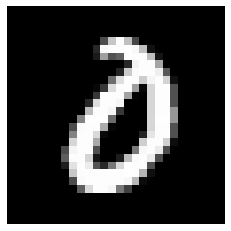

Loss: 0.00014265020840306133
Iteration: 46480, Score: 0.34680927266180517
[183, 40, 33, 41, 34, 14, 48, 131, 18, 21, 52, 213, 41, 131, 0]


Loss: 0.00014210952874058725
Iteration: 46520, Score: 0.32017312186211344
[273, 32, 18, 24, 26, 36, 40, 47, 25, 32, 34, 284, 31, 98, 0]


Loss: 0.00015251195161436376
Iteration: 46560, Score: 0.293469838552177
[250, 50, 39, 12, 27, 42, 29, 78, 24, 25, 38, 260, 42, 84, 0]


Loss: 0.00014772331384421396
Iteration: 46600, Score: 0.3235195916537196
[194, 90, 37, 28, 22, 21, 43, 142, 34, 21, 57, 186, 28, 97, 0]


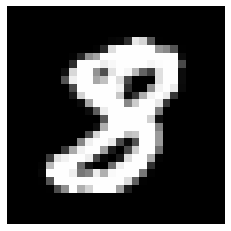

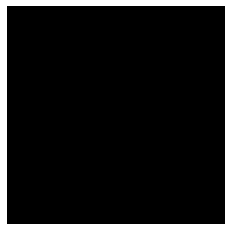

Loss: 0.00013658133985061403
Iteration: 46640, Score: 0.31105001977086066
[225, 71, 27, 63, 56, 30, 54, 67, 24, 19, 53, 199, 21, 91, 0]


Loss: 0.00013030537908411487
Iteration: 46680, Score: 0.3620605068206787
[207, 32, 42, 23, 33, 47, 26, 102, 19, 13, 64, 241, 37, 114, 0]


Loss: 0.00015268035874926937
Iteration: 46720, Score: 0.3096856177002192
[220, 31, 43, 25, 21, 54, 36, 79, 41, 23, 39, 208, 50, 130, 0]


Loss: 0.0001378791341107975
Iteration: 46760, Score: 0.2973067815676331
[221, 63, 57, 20, 20, 54, 41, 90, 40, 17, 29, 231, 33, 84, 0]


Loss: 0.00014924420997990262
Iteration: 46800, Score: 0.268829147066921
[256, 46, 43, 32, 17, 38, 37, 108, 11, 13, 46, 209, 31, 113, 0]


Test score: 0.2766923620700837
Loss: 0.00015076753716009654
Iteration: 46840, Score: 0.35261432054638864
[190, 40, 57, 48, 34, 72, 44, 76, 25, 27, 49, 200, 30, 108, 0]


Loss: 0.0001422940360203567
Iteration: 46880, Score: 0.33125677742064
[199, 31, 32, 32, 25, 50, 44, 70, 30, 34, 34, 278, 42, 99, 0]


Loss: 0.00015052648809224224
Iteration: 46920, Score: 0.3423846391253173
[173, 77, 52, 32, 18, 49, 96, 49, 22, 44, 34, 238, 52, 64, 0]


Loss: 0.00013402880637324572
Iteration: 46960, Score: 0.28037443097680803
[184, 107, 27, 30, 21, 32, 121, 51, 35, 39, 27, 220, 24, 82, 0]


Loss: 0.00013398971498181352
Iteration: 47000, Score: 0.347482399046421
[203, 39, 32, 33, 32, 40, 37, 81, 38, 22, 82, 232, 39, 90, 0]


Loss: 0.00013852800827513192
Iteration: 47040, Score: 0.32394020041823385
[232, 37, 35, 29, 23, 48, 43, 77, 20, 21, 78, 246, 31, 80, 0]


Loss: 0.00014080892797414273
Iteration: 47080, Score: 0.3022872446626425
[200, 37, 26, 44, 23, 51, 44, 60, 47, 22, 75, 205, 26, 140, 0]


Loss: 0.0001573270946815839
Iteration: 47120, Score: 0.3523262041211129
[249, 23, 19, 27, 17, 51, 33, 78, 34, 18, 63, 247, 41, 100, 0]


Loss: 0.00016530273055015776
Iteration: 47160, Score: 0.3224131085425615
[242, 44, 30, 16, 21, 64, 62, 64, 37, 23, 48, 220, 52, 77, 0]


Loss: 0.00016448831249637618
Iteration: 47200, Score: 0.30615248320251703
[187, 74, 74, 22, 21, 106, 82, 45, 20, 13, 32, 226, 37, 61, 0]


Test score: 0.32390151292830704
Loss: 0.0001767950389873949
Iteration: 47240, Score: 0.3214126421660185
[217, 47, 42, 36, 28, 71, 52, 44, 24, 33, 40, 229, 47, 90, 0]


Loss: 0.00013985912884152346
Iteration: 47280, Score: 0.29865364795178173
[194, 52, 59, 42, 37, 52, 26, 75, 34, 44, 66, 187, 20, 112, 0]


Loss: 0.00015448683326673874
Iteration: 47320, Score: 0.35065419985353946
[203, 43, 68, 24, 29, 65, 44, 59, 23, 46, 50, 203, 52, 91, 0]


Loss: 0.00015794537785646025
Iteration: 47360, Score: 0.30278877495229245
[209, 49, 50, 24, 27, 65, 75, 59, 24, 29, 58, 229, 34, 68, 0]


Loss: 0.0001506063558880045
Iteration: 47400, Score: 0.3393441996872424
[197, 35, 33, 45, 80, 28, 47, 49, 18, 31, 104, 184, 45, 104, 0]


Loss: 0.00015776073050585425
Iteration: 47440, Score: 0.37925702734291555
[207, 45, 50, 27, 42, 63, 48, 46, 17, 29, 69, 244, 20, 93, 0]


Loss: 0.00015865541365904116
Iteration: 47480, Score: 0.3142275966107845
[268, 15, 26, 20, 25, 39, 19, 79, 28, 28, 68, 269, 51, 65, 0]


Loss: 0.00015118490222338157
Iteration: 47520, Score: 0.3433095215260983
[255, 52, 32, 19, 20, 32, 30, 100, 31, 25, 49, 234, 41, 80, 0]


Loss: 0.0001589486465548515
Iteration: 47560, Score: 0.35864183068275446
[222, 37, 83, 23, 22, 65, 31, 73, 36, 21, 56, 207, 25, 99, 0]


Loss: 0.00015030731903951242
Iteration: 47600, Score: 0.289479578986764
[212, 49, 42, 34, 24, 27, 66, 75, 40, 21, 53, 252, 30, 75, 0]


Test score: 0.32285833751410253
Loss: 0.000139623856038351
Iteration: 47640, Score: 0.3496578114777804
[244, 58, 27, 19, 22, 46, 50, 92, 20, 36, 73, 212, 30, 71, 0]


Loss: 0.00015592371146869072
Iteration: 47680, Score: 0.35998349286615844
[254, 58, 42, 29, 20, 24, 60, 53, 34, 23, 37, 232, 29, 105, 0]


Loss: 0.00014293431405360113
Iteration: 47720, Score: 0.36342816115915777
[192, 24, 43, 48, 36, 37, 46, 68, 40, 23, 30, 254, 63, 96, 0]


Loss: 0.00015516343074087997
Iteration: 47760, Score: 0.3430581124722957
[223, 24, 53, 34, 26, 46, 50, 91, 35, 20, 68, 207, 45, 78, 0]


Loss: 0.00016230121296948453
Iteration: 47800, Score: 0.37091706247627737
[257, 25, 46, 25, 35, 41, 38, 74, 47, 22, 68, 204, 36, 82, 0]


Loss: 0.00015062689878388285
Iteration: 47840, Score: 0.3746318941116332
[273, 36, 35, 16, 28, 38, 34, 81, 34, 16, 52, 206, 35, 116, 0]


Loss: 0.00014845827180554505
Iteration: 47880, Score: 0.3404124348014593
[239, 56, 16, 23, 61, 46, 44, 50, 21, 20, 94, 196, 42, 92, 0]


Loss: 0.00014657986411082264
Iteration: 47920, Score: 0.3691962652280928
[208, 26, 54, 41, 28, 71, 59, 88, 17, 22, 64, 172, 57, 93, 0]


Loss: 0.0001637470393572066
Iteration: 47960, Score: 0.3725021885633469
[225, 36, 22, 28, 46, 66, 65, 72, 19, 18, 54, 191, 57, 101, 0]


Loss: 0.00015290736862620566
Iteration: 48000, Score: 0.31085610819607973
[274, 35, 29, 20, 21, 36, 56, 64, 23, 27, 46, 212, 57, 100, 0]


Test score: 0.2702350542615167
Loss: 0.00014882169384521418
Iteration: 48040, Score: 0.3594046216830611
[215, 42, 78, 27, 20, 85, 35, 70, 37, 24, 46, 180, 57, 84, 0]


Loss: 0.00015523536230342336
Iteration: 48080, Score: 0.32350091442465784
[272, 18, 61, 28, 30, 44, 26, 76, 32, 20, 59, 223, 40, 71, 0]


Loss: 0.00014500289796821715
Iteration: 48120, Score: 0.3482603578940034
[218, 33, 76, 22, 35, 57, 42, 52, 33, 37, 72, 224, 24, 75, 0]


Loss: 0.00015288602821501965
Iteration: 48160, Score: 0.36570934134721755
[191, 29, 60, 26, 32, 45, 55, 93, 20, 45, 68, 209, 39, 88, 0]


Loss: 0.00015333061828173082
Iteration: 48200, Score: 0.29904627937637274
[218, 23, 81, 18, 24, 65, 67, 69, 24, 31, 46, 211, 37, 86, 0]


Loss: 0.00014251140915937314
Iteration: 48240, Score: 0.2890213243328035
[231, 59, 50, 28, 22, 32, 96, 50, 25, 21, 46, 210, 47, 83, 0]


Loss: 0.00015065439182396982
Iteration: 48280, Score: 0.34267648549377916
[252, 38, 55, 22, 14, 58, 86, 52, 23, 16, 37, 204, 44, 99, 0]


Loss: 0.0001509602135235828
Iteration: 48320, Score: 0.3374429851621389
[218, 59, 28, 26, 30, 33, 140, 70, 28, 12, 23, 206, 37, 90, 0]


Loss: 0.00015326659177292712
Iteration: 48360, Score: 0.3705354816243053
[204, 46, 35, 28, 21, 37, 79, 67, 34, 27, 59, 235, 36, 92, 0]


Loss: 0.0001372024165843162
Iteration: 48400, Score: 0.32248539446294305
[218, 27, 38, 23, 19, 40, 54, 65, 39, 38, 43, 250, 34, 112, 0]


Test score: 0.31024562107026565
Loss: 0.00013375087160040562
Iteration: 48440, Score: 0.36525923186540604
[211, 27, 36, 47, 41, 37, 29, 54, 20, 78, 42, 245, 31, 102, 0]


Loss: 0.00014715140976451658
Iteration: 48480, Score: 0.42089902952313424
[203, 29, 50, 32, 32, 68, 34, 64, 22, 49, 85, 203, 29, 100, 0]


Loss: 0.00015120915720227246
Iteration: 48520, Score: 0.3315933007746935
[207, 68, 57, 20, 14, 89, 83, 77, 23, 30, 44, 171, 29, 88, 0]


Loss: 0.00014160360028932621
Iteration: 48560, Score: 0.3856233528852462
[246, 33, 55, 47, 48, 80, 39, 69, 24, 15, 46, 196, 24, 78, 0]


Loss: 0.00015848126305546917
Iteration: 48600, Score: 0.31795842547187203
[297, 18, 34, 24, 18, 57, 29, 79, 32, 13, 33, 219, 41, 106, 0]


Loss: 0.00015487271898572823
Iteration: 48640, Score: 0.3442588599212467
[222, 49, 44, 21, 33, 45, 81, 62, 29, 18, 31, 262, 34, 69, 0]


Loss: 0.00019603314022548368
Iteration: 48680, Score: 0.3316210005581379
[179, 71, 84, 23, 23, 63, 112, 55, 16, 17, 21, 221, 23, 92, 0]


Loss: 0.00014046087377333525
Iteration: 48720, Score: 0.3353435376510024
[185, 68, 113, 28, 21, 123, 32, 60, 23, 37, 31, 151, 22, 106, 0]


Loss: 0.0001505126330669821
Iteration: 48760, Score: 0.31589366896450527
[230, 55, 30, 23, 32, 34, 21, 93, 42, 12, 98, 201, 36, 93, 0]


Loss: 0.00014822601347677742
Iteration: 48800, Score: 0.29471458440274
[246, 55, 55, 39, 22, 59, 58, 62, 17, 20, 53, 191, 20, 103, 0]


Test score: 0.3232526099234819
Loss: 0.0001451361963499784
Iteration: 48840, Score: 0.3634759562015534
[209, 65, 41, 44, 46, 31, 30, 73, 21, 23, 51, 181, 47, 138, 0]


Loss: 0.0001529907263096939
Iteration: 48880, Score: 0.3397669252008199
[193, 52, 47, 18, 28, 34, 55, 88, 21, 34, 57, 208, 43, 122, 0]


Loss: 0.00015192722546610764
Iteration: 48920, Score: 0.29716367429494855
[243, 25, 96, 14, 36, 63, 27, 73, 13, 20, 89, 150, 49, 102, 0]


Loss: 0.00015683654626608346
Iteration: 48960, Score: 0.3440662624537944
[219, 57, 46, 23, 40, 32, 56, 45, 41, 15, 79, 187, 30, 130, 0]


Loss: 0.00014496971983515443
Iteration: 49000, Score: 0.315652519211173
[220, 70, 83, 21, 25, 64, 44, 72, 14, 14, 82, 174, 22, 95, 0]


Loss: 0.0001469711173053122
Iteration: 49040, Score: 0.37409742522239686
[207, 53, 74, 35, 19, 52, 26, 84, 27, 20, 41, 215, 29, 118, 0]


Loss: 0.00015471655648779595
Iteration: 49080, Score: 0.31704782739467907
[246, 29, 46, 28, 26, 24, 25, 96, 32, 34, 63, 190, 78, 83, 0]


Loss: 0.0001568788843276293
Iteration: 49120, Score: 0.35574061432573933
[234, 29, 39, 23, 30, 26, 38, 65, 52, 22, 85, 210, 51, 96, 0]


Loss: 0.00015039025902178083
Iteration: 49160, Score: 0.3299526068419218
[213, 25, 55, 33, 30, 19, 50, 109, 13, 24, 101, 198, 31, 99, 0]


Loss: 0.00014323083736596942
Iteration: 49200, Score: 0.34137101271748543
[193, 44, 34, 25, 47, 34, 54, 103, 21, 32, 49, 204, 61, 99, 0]


Test score: 0.3197033816203475
Loss: 0.00015456104154449972
Iteration: 49240, Score: 0.33377540593594307
[206, 60, 74, 31, 40, 91, 73, 58, 8, 20, 50, 156, 67, 66, 0]


Loss: 0.0001628910483818337
Iteration: 49280, Score: 0.3494082608222961
[227, 45, 30, 30, 30, 66, 56, 73, 22, 23, 51, 204, 42, 101, 0]


Loss: 0.0001557496542059572
Iteration: 49320, Score: 0.3254733435912057
[195, 57, 51, 38, 43, 63, 71, 67, 13, 22, 38, 185, 70, 87, 0]


Loss: 0.00016899150107219676
Iteration: 49360, Score: 0.3202869862020016
[220, 55, 81, 16, 20, 48, 83, 63, 21, 30, 54, 172, 47, 90, 0]


Loss: 0.00017187242419624359
Iteration: 49400, Score: 0.3619820107221604
[216, 76, 67, 28, 24, 62, 39, 64, 23, 21, 52, 156, 63, 109, 0]


Loss: 0.00015846076804909727
Iteration: 49440, Score: 0.3719985931217671
[219, 93, 56, 13, 21, 54, 137, 44, 28, 22, 28, 171, 41, 73, 0]


Loss: 0.0001613276489849007
Iteration: 49480, Score: 0.3609292811453342
[204, 70, 44, 13, 40, 52, 105, 78, 20, 15, 28, 196, 31, 104, 0]


Loss: 0.00016109368849946597
Iteration: 49520, Score: 0.32067662608623504
[249, 52, 59, 17, 41, 43, 90, 57, 25, 35, 36, 156, 27, 113, 0]


Loss: 0.00016130200225163702
Iteration: 49560, Score: 0.36919215193390836
[273, 43, 45, 16, 24, 54, 66, 64, 23, 22, 35, 210, 28, 97, 0]


Loss: 0.00014003063045955219
Iteration: 49600, Score: 0.34184451195597637
[211, 81, 58, 15, 24, 47, 122, 49, 47, 24, 28, 166, 24, 104, 0]


Test score: 0.3181546598356217
Loss: 0.00016256105314798575
Iteration: 49640, Score: 0.30614044705033305
[186, 54, 71, 21, 37, 75, 70, 56, 28, 33, 49, 184, 21, 115, 0]


Loss: 0.00015468985158206505
Iteration: 49680, Score: 0.3154736899882556
[228, 20, 25, 32, 28, 28, 48, 59, 55, 41, 96, 208, 34, 98, 0]


Loss: 0.00014569940578043194
Iteration: 49720, Score: 0.4178709544241429
[198, 51, 17, 20, 26, 29, 70, 95, 41, 25, 91, 190, 27, 120, 0]


Loss: 0.00014576030250832944
Iteration: 49760, Score: 0.3751928647160529
[210, 26, 61, 35, 26, 62, 41, 91, 19, 18, 44, 169, 60, 138, 0]


Loss: 0.00016881802612117453
Iteration: 49800, Score: 0.38918738803267483
[188, 33, 32, 24, 36, 36, 43, 76, 39, 20, 49, 188, 110, 126, 0]


Loss: 0.00017134030192362255
Iteration: 49840, Score: 0.3485300405845047
[218, 29, 58, 29, 34, 37, 52, 72, 21, 17, 54, 226, 37, 116, 0]


Loss: 0.00017574813753956623
Iteration: 49880, Score: 0.3392747336179018
[291, 19, 50, 30, 29, 32, 52, 68, 34, 15, 42, 192, 54, 92, 0]


Loss: 0.00016750913770740961
Iteration: 49920, Score: 0.34069419975578785
[268, 38, 22, 24, 17, 19, 52, 57, 21, 20, 45, 213, 54, 150, 0]


Loss: 0.0001703119221204277
Iteration: 49960, Score: 0.4214480993896723
[224, 30, 33, 18, 22, 22, 51, 106, 32, 18, 54, 232, 39, 119, 0]


Loss: 0.00015453727017381033
Iteration: 50000, Score: 0.3330896726846695
[221, 31, 53, 32, 17, 50, 39, 78, 53, 32, 29, 204, 35, 126, 0]


Test score: 0.3084297107309103
Loss: 0.0001481517523390422
Iteration: 50040, Score: 0.3347736044079065
[238, 24, 72, 22, 30, 77, 56, 78, 23, 15, 39, 201, 30, 95, 0]


Loss: 0.00014609679408276958
Iteration: 50080, Score: 0.3287286100797356
[236, 72, 26, 13, 35, 14, 71, 63, 28, 22, 30, 228, 40, 122, 0]


Loss: 0.00016612478536451374
Iteration: 50120, Score: 0.3494968537315727
[234, 75, 28, 17, 38, 23, 110, 61, 22, 25, 55, 204, 30, 78, 0]


Loss: 0.00017127563358251106
Iteration: 50160, Score: 0.3309420074764639
[245, 33, 35, 19, 46, 47, 33, 69, 23, 20, 36, 256, 36, 102, 0]


Loss: 0.0001738797321732038
Iteration: 50200, Score: 0.3808104304373265
[230, 40, 73, 12, 31, 71, 35, 82, 24, 20, 67, 139, 32, 144, 0]


Loss: 0.00016922788653069625
Iteration: 50240, Score: 0.36395323623716835
[242, 31, 81, 42, 49, 62, 33, 50, 13, 23, 45, 189, 18, 122, 0]


Loss: 0.00014377025622331474
Iteration: 50280, Score: 0.3718172640502453
[212, 43, 74, 16, 28, 68, 73, 107, 31, 24, 53, 174, 20, 77, 0]


Loss: 0.00017221088004466248
Iteration: 50320, Score: 0.33854936818033454
[271, 10, 39, 63, 37, 24, 30, 86, 18, 23, 56, 222, 40, 81, 0]


Loss: 0.00016626382901151193
Iteration: 50360, Score: 0.3015581820439547
[251, 20, 33, 23, 37, 25, 41, 78, 15, 20, 39, 253, 50, 115, 0]


Loss: 0.00015249100422257808
Iteration: 50400, Score: 0.4195630120635033
[254, 26, 25, 34, 22, 29, 32, 43, 22, 24, 74, 249, 25, 141, 0]


Test score: 0.3524481539875269
Loss: 0.0001684428051209357
Iteration: 50440, Score: 0.35158324077725406
[246, 48, 37, 38, 38, 42, 68, 31, 34, 23, 71, 206, 25, 93, 0]


Loss: 0.00015366370439446082
Iteration: 50480, Score: 0.39539628884941347
[202, 29, 144, 25, 22, 136, 16, 99, 13, 13, 73, 136, 23, 69, 0]


Loss: 0.0001461157510391683
Iteration: 50520, Score: 0.314809785619378
[255, 24, 37, 48, 22, 21, 51, 65, 27, 20, 113, 182, 26, 109, 0]


Loss: 0.00016358506058849651
Iteration: 50560, Score: 0.320556682318449
[251, 28, 44, 28, 18, 31, 29, 37, 30, 24, 113, 206, 37, 124, 0]


Loss: 0.00016397696034106115
Iteration: 50600, Score: 0.3285419003516436
[250, 43, 57, 24, 17, 87, 41, 69, 14, 15, 79, 173, 34, 97, 0]


Loss: 0.00014578343518838457
Iteration: 50640, Score: 0.31620911605656143
[252, 73, 50, 34, 39, 67, 76, 55, 13, 14, 46, 160, 32, 89, 0]


Loss: 0.00016012294378551064
Iteration: 50680, Score: 0.36007162623852496
[239, 46, 51, 32, 13, 29, 38, 43, 47, 25, 58, 84, 54, 241, 0]


Loss: 0.00015754725386492313
Iteration: 50720, Score: 0.3699419475495815
[246, 29, 29, 38, 16, 47, 75, 50, 30, 20, 50, 184, 48, 138, 0]


Loss: 0.00015349609939065278
Iteration: 50760, Score: 0.35641864259541034
[217, 33, 33, 23, 32, 25, 38, 59, 28, 16, 74, 272, 30, 120, 0]


Loss: 0.00015456637982498816
Iteration: 50800, Score: 0.3889790224283934
[208, 52, 37, 20, 33, 36, 58, 86, 20, 19, 93, 215, 25, 98, 0]


Test score: 0.31415390816330924
Loss: 0.00015857634898693297
Iteration: 50840, Score: 0.3277131013870239
[238, 64, 59, 31, 22, 84, 88, 61, 20, 23, 45, 127, 28, 110, 0]


Loss: 0.00017508606035696625
Iteration: 50880, Score: 0.35933394137024877
[226, 55, 63, 30, 18, 70, 94, 70, 23, 28, 41, 132, 30, 120, 0]


Loss: 0.00018321436317441495
Iteration: 50920, Score: 0.337468874141574
[225, 51, 43, 26, 21, 61, 50, 98, 17, 25, 48, 174, 23, 138, 0]


Loss: 0.000191670564728113
Iteration: 50960, Score: 0.35923764309287065
[218, 73, 65, 31, 32, 73, 87, 62, 26, 14, 36, 159, 16, 108, 0]


Loss: 0.00017940471205330104
Iteration: 51000, Score: 0.3603134887367486
[232, 19, 85, 23, 34, 72, 62, 79, 27, 28, 48, 156, 28, 107, 0]


Loss: 0.0001686766985497302
Iteration: 51040, Score: 0.32244461442530153
[220, 25, 78, 26, 25, 51, 48, 74, 48, 29, 29, 157, 25, 165, 0]


Loss: 0.00015544803935618347
Iteration: 51080, Score: 0.3434909241199494
[243, 48, 60, 20, 23, 50, 57, 66, 28, 33, 29, 157, 34, 152, 0]


Loss: 0.00015338266840716705
Iteration: 51120, Score: 0.3720915944427252
[228, 42, 71, 30, 30, 79, 65, 72, 38, 34, 28, 152, 18, 113, 0]


Loss: 0.0001570488141414291
Iteration: 51160, Score: 0.39558130733668817
[260, 26, 45, 35, 39, 34, 48, 80, 26, 24, 31, 211, 24, 117, 0]


Loss: 0.00014902378498581374
Iteration: 51200, Score: 0.3868104958385229
[274, 23, 46, 27, 27, 25, 41, 62, 23, 50, 30, 194, 30, 148, 0]


Test score: 0.25572911859815933
Loss: 0.0001771151024974488
Iteration: 51240, Score: 0.38192457553744313
[236, 32, 44, 33, 33, 45, 51, 57, 28, 25, 33, 199, 33, 151, 0]


Loss: 0.00014714413261125242
Iteration: 51280, Score: 0.34746454347670086
[235, 34, 37, 43, 48, 35, 47, 60, 23, 22, 52, 198, 32, 134, 0]


Loss: 0.00016250639531877983
Iteration: 51320, Score: 0.3712869309186935
[231, 25, 47, 36, 59, 52, 43, 93, 26, 19, 35, 207, 38, 89, 0]


Loss: 0.00015746053274519014
Iteration: 51360, Score: 0.3819725008904934
[212, 30, 64, 24, 31, 65, 49, 135, 15, 14, 44, 195, 23, 99, 0]


Loss: 0.0001731184164888262
Iteration: 51400, Score: 0.30047004494071
[213, 61, 29, 28, 23, 28, 92, 109, 30, 15, 33, 189, 40, 110, 0]


Loss: 0.00016335260280006192
Iteration: 51440, Score: 0.3974752895832062
[208, 49, 84, 17, 21, 75, 62, 85, 25, 22, 26, 190, 31, 105, 0]


Loss: 0.00016245250698180994
Iteration: 51480, Score: 0.30688368185237047
[250, 27, 55, 24, 30, 22, 43, 91, 35, 24, 39, 196, 37, 127, 0]


Loss: 0.00013204361194623588
Iteration: 51520, Score: 0.37804972377419466
[213, 62, 28, 36, 28, 30, 45, 65, 25, 39, 37, 196, 101, 95, 0]


Loss: 0.00016704732703162962
Iteration: 51560, Score: 0.3481160257682204
[209, 47, 57, 25, 25, 34, 29, 89, 20, 28, 42, 212, 67, 116, 0]


Loss: 0.0001672391126568375
Iteration: 51600, Score: 0.35837058089673524
[181, 25, 100, 41, 31, 111, 41, 79, 25, 16, 66, 156, 40, 88, 0]


Test score: 0.3229865897409618
Loss: 0.00015108851944002614
Iteration: 51640, Score: 0.3919597604721784
[213, 34, 46, 33, 46, 48, 67, 83, 24, 16, 88, 164, 25, 113, 0]


Loss: 0.00015669118612423347
Iteration: 51680, Score: 0.37720970898866657
[203, 60, 44, 21, 20, 48, 61, 86, 18, 22, 95, 154, 42, 126, 0]


Loss: 0.0001438026596665507
Iteration: 51720, Score: 0.3510809975415468
[202, 32, 27, 28, 32, 25, 33, 106, 29, 17, 96, 147, 53, 173, 0]


Loss: 0.00017016862054987708
Iteration: 51760, Score: 0.35898065212368946
[236, 72, 41, 18, 24, 49, 47, 86, 27, 19, 43, 190, 46, 102, 0]


Loss: 0.00015582610708557171
Iteration: 51800, Score: 0.34546871672570706
[263, 68, 57, 20, 19, 76, 65, 66, 17, 12, 36, 169, 24, 108, 0]


Loss: 0.0001534610489979256
Iteration: 51840, Score: 0.3270563281029464
[210, 55, 20, 32, 34, 35, 31, 109, 40, 23, 26, 226, 37, 122, 0]


Loss: 0.0001637296821762883
Iteration: 51880, Score: 0.34212905898690227
[256, 39, 37, 28, 23, 45, 35, 97, 13, 15, 33, 229, 50, 100, 0]


Loss: 0.00016383410293487613
Iteration: 51920, Score: 0.3793146679103375
[257, 32, 31, 29, 31, 35, 46, 119, 29, 20, 39, 189, 41, 102, 0]


Loss: 0.00014555888403391623
Iteration: 51960, Score: 0.36455956128239625
[244, 40, 31, 34, 39, 38, 43, 73, 31, 25, 59, 198, 44, 101, 0]


Loss: 0.00017328367555475823
Iteration: 52000, Score: 0.33041025340557095
[225, 87, 26, 33, 22, 36, 83, 65, 29, 29, 29, 231, 45, 60, 0]


Test score: 0.30586632037162775
Loss: 0.00016962244904089978
Iteration: 52040, Score: 0.4078567820582538
[243, 52, 19, 26, 28, 50, 54, 78, 29, 28, 48, 210, 50, 85, 0]


Loss: 0.00017734273176144073
Iteration: 52080, Score: 0.401439933673013
[238, 52, 29, 26, 38, 59, 50, 67, 42, 19, 43, 162, 64, 111, 0]


Loss: 0.00017430013826359622
Iteration: 52120, Score: 0.37388800944387907
[210, 56, 28, 46, 39, 29, 51, 72, 79, 27, 46, 159, 45, 113, 0]


Loss: 0.00015858320186062797
Iteration: 52160, Score: 0.33111484861373897
[219, 95, 28, 26, 25, 24, 98, 95, 44, 17, 42, 191, 33, 63, 0]


Loss: 0.00016696954551414635
Iteration: 52200, Score: 0.3474836984276772
[220, 44, 73, 45, 40, 75, 47, 92, 20, 16, 33, 180, 34, 81, 0]


Loss: 0.0001680043602892391
Iteration: 52240, Score: 0.30341099747270345
[272, 44, 48, 30, 31, 39, 46, 55, 22, 21, 43, 164, 77, 108, 0]


Loss: 0.00016304587378245243
Iteration: 52280, Score: 0.3603382032215595
[236, 69, 53, 24, 20, 40, 50, 63, 18, 14, 36, 150, 94, 133, 0]


Loss: 0.00017265123042681815
Iteration: 52320, Score: 0.3877317166775464
[204, 37, 68, 41, 31, 92, 30, 72, 24, 24, 23, 156, 83, 115, 0]


Loss: 0.0001568978714824526
Iteration: 52360, Score: 0.3295700387172401
[187, 42, 85, 10, 26, 91, 51, 74, 17, 21, 28, 192, 68, 108, 0]


Loss: 0.00017757856685973026
Iteration: 52400, Score: 0.33465177941322327
[229, 36, 51, 22, 16, 66, 55, 76, 28, 18, 48, 157, 84, 114, 0]


Test score: 0.366771812722087
Loss: 0.00015005262146983267
Iteration: 52440, Score: 0.32786036188527945
[272, 21, 40, 21, 27, 41, 52, 87, 25, 25, 54, 171, 49, 115, 0]


Loss: 0.00015595400359114152
Iteration: 52480, Score: 0.31759557559341195
[238, 44, 63, 17, 25, 99, 53, 62, 15, 18, 58, 144, 37, 127, 0]


Loss: 0.00015829567301631282
Iteration: 52520, Score: 0.41426016774028546
[202, 33, 50, 19, 22, 95, 58, 94, 17, 22, 33, 173, 64, 118, 0]


Loss: 0.0001546866917992493
Iteration: 52560, Score: 0.3942777485847473
[217, 30, 101, 17, 20, 124, 50, 61, 12, 24, 36, 164, 48, 96, 0]


Loss: 0.0001548423381088009
Iteration: 52600, Score: 0.36782359886169436
[180, 40, 57, 31, 41, 105, 40, 96, 28, 16, 39, 124, 42, 161, 0]


Loss: 0.00016097754622912522
Iteration: 52640, Score: 0.349326260626316
[231, 58, 42, 19, 19, 77, 73, 67, 35, 18, 47, 126, 27, 161, 0]


Loss: 0.00016093081784026138
Iteration: 52680, Score: 0.42816995247453454
[249, 44, 19, 23, 18, 56, 63, 67, 21, 21, 50, 188, 50, 131, 0]


Loss: 0.0001535863628532659
Iteration: 52720, Score: 0.3473570591211318
[221, 38, 43, 23, 25, 83, 46, 80, 26, 10, 54, 194, 45, 112, 0]


Loss: 0.0001787727852832684
Iteration: 52760, Score: 0.31106759801507006
[191, 40, 67, 25, 18, 78, 61, 74, 28, 25, 37, 157, 54, 145, 0]


Loss: 0.0001586946565717833
Iteration: 52800, Score: 0.3560343004018069
[208, 52, 19, 33, 18, 76, 81, 86, 17, 17, 54, 161, 83, 95, 0]


Test score: 0.2618237853497266
Loss: 0.00016550986449365333
Iteration: 52840, Score: 0.3683496222496033
[261, 59, 19, 20, 26, 62, 37, 57, 21, 19, 67, 206, 42, 104, 0]


Loss: 0.000163008741969897
Iteration: 52880, Score: 0.3906328093409538
[214, 115, 18, 19, 32, 49, 72, 47, 23, 30, 62, 176, 25, 118, 0]


Loss: 0.0001543316892594164
Iteration: 52920, Score: 0.34140997081995017
[190, 36, 65, 31, 18, 61, 46, 79, 20, 25, 60, 225, 47, 97, 0]


Loss: 0.00014677488902963606
Iteration: 52960, Score: 0.31475346644222735
[188, 53, 41, 33, 33, 74, 78, 90, 18, 44, 55, 131, 84, 78, 0]


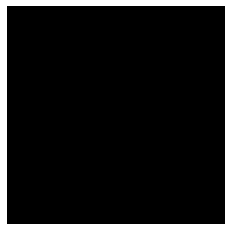

Loss: 0.0001544911255416078
Iteration: 53000, Score: 0.33366249094158407
[183, 100, 73, 20, 31, 81, 115, 69, 16, 11, 46, 115, 29, 111, 0]


Loss: 0.0001371134209474654
Iteration: 53040, Score: 0.3489919139593839
[251, 69, 63, 19, 33, 53, 54, 52, 22, 15, 62, 117, 38, 152, 0]


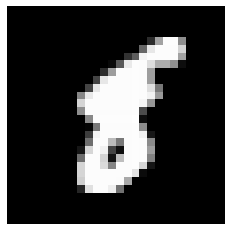

Loss: 0.00014813239077742825
Iteration: 53080, Score: 0.39364155572652826
[193, 27, 44, 41, 27, 77, 41, 75, 40, 20, 52, 142, 75, 146, 0]


Loss: 0.00015915573183071594
Iteration: 53120, Score: 0.3734773439764976
[221, 37, 48, 26, 20, 74, 45, 55, 22, 16, 73, 159, 87, 117, 0]


Loss: 0.00014445447819760242
Iteration: 53160, Score: 0.3826383921728702
[236, 57, 43, 30, 25, 57, 62, 70, 23, 29, 106, 141, 47, 74, 0]


Loss: 0.0001620132403508839
Iteration: 53200, Score: 0.35401289542019365
[226, 56, 50, 24, 34, 43, 74, 57, 23, 22, 76, 142, 48, 125, 0]


Test score: 0.2750903798751533
Loss: 0.00015543538172559516
Iteration: 53240, Score: 0.334836973387748
[245, 51, 40, 22, 12, 34, 91, 86, 24, 17, 92, 119, 34, 133, 0]


Loss: 0.00013948666455518543
Iteration: 53280, Score: 0.3559846151927194
[234, 28, 29, 35, 31, 41, 83, 86, 12, 23, 130, 107, 39, 122, 0]


Loss: 0.00015288635929150762
Iteration: 53320, Score: 0.34397742581367496
[224, 30, 15, 26, 53, 37, 73, 92, 20, 16, 123, 133, 49, 109, 0]


Loss: 0.0002089072127359982
Iteration: 53360, Score: 0.3096700231134892
[186, 24, 22, 23, 68, 37, 62, 86, 47, 17, 85, 131, 46, 166, 0]


Loss: 0.00015945549069411235
Iteration: 53400, Score: 0.3676443378254772
[208, 13, 45, 52, 58, 63, 80, 53, 32, 12, 84, 114, 46, 140, 0]


Loss: 0.00016132454690172466
Iteration: 53440, Score: 0.3463049203008413
[212, 65, 37, 23, 21, 27, 105, 77, 30, 22, 96, 73, 37, 175, 0]


Loss: 0.00016241796762236297
Iteration: 53480, Score: 0.37201827552914624
[126, 76, 92, 21, 30, 137, 97, 64, 25, 9, 57, 137, 14, 115, 0]


Loss: 0.000157117514423164
Iteration: 53520, Score: 0.3921859183609485
[176, 77, 44, 23, 14, 35, 93, 104, 18, 10, 142, 110, 41, 113, 0]


Loss: 0.00016227146354639261
Iteration: 53560, Score: 0.40731400540471074
[229, 48, 53, 34, 22, 48, 69, 72, 39, 28, 88, 120, 43, 107, 0]


Loss: 0.00017766073813460238
Iteration: 53600, Score: 0.36312183433771134
[241, 51, 44, 39, 20, 37, 42, 111, 25, 17, 82, 125, 47, 119, 0]


Test score: 0.3155599274523556
Loss: 0.00016035404183506368
Iteration: 53640, Score: 0.3468488794565201
[236, 30, 22, 36, 21, 36, 50, 80, 17, 14, 137, 179, 31, 111, 0]


Loss: 0.00015308651609533772
Iteration: 53680, Score: 0.3601803469657897
[193, 83, 29, 31, 14, 56, 102, 65, 21, 18, 102, 159, 41, 86, 0]


Loss: 0.00017253727892940318
Iteration: 53720, Score: 0.36329161974042645
[173, 46, 111, 20, 10, 137, 67, 73, 32, 20, 82, 108, 45, 76, 0]


Loss: 0.0001500828302072066
Iteration: 53760, Score: 0.36883583940193065
[224, 92, 50, 17, 13, 56, 144, 52, 25, 28, 54, 121, 43, 81, 0]


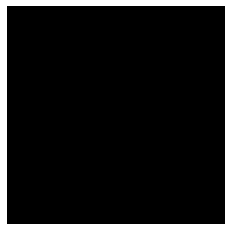

Loss: 0.0001559861635377997
Iteration: 53800, Score: 0.3340103366672992
[243, 29, 58, 17, 16, 59, 44, 100, 23, 30, 101, 158, 30, 92, 0]


Loss: 0.0001585419048524272
Iteration: 53840, Score: 0.3179823800921441
[224, 17, 41, 25, 11, 41, 80, 83, 21, 25, 139, 136, 44, 113, 0]


Loss: 0.00016124244094654607
Iteration: 53880, Score: 0.3689793612211943
[206, 16, 67, 22, 33, 61, 52, 95, 18, 16, 86, 157, 59, 112, 0]


Loss: 0.00015150760099003362
Iteration: 53920, Score: 0.3157029462009668
[176, 68, 62, 27, 63, 58, 107, 57, 19, 21, 88, 132, 35, 87, 0]


Loss: 0.00014568883312675513
Iteration: 53960, Score: 0.3819541452080011
[188, 34, 70, 66, 84, 51, 73, 45, 16, 31, 65, 172, 37, 68, 0]


Loss: 0.00015777889804732798
Iteration: 54000, Score: 0.4118354148715734
[198, 23, 67, 38, 45, 121, 51, 52, 16, 18, 67, 137, 58, 109, 0]


Test score: 0.353032768268138
Loss: 0.00014710396788970696
Iteration: 54040, Score: 0.42600892314314837
[166, 43, 51, 20, 19, 100, 57, 95, 33, 16, 52, 99, 83, 166, 0]


Loss: 0.00016618100783558515
Iteration: 54080, Score: 0.38022593140602107
[161, 52, 37, 35, 25, 93, 96, 79, 23, 62, 80, 107, 58, 92, 0]


Loss: 0.00014901643819321205
Iteration: 54120, Score: 0.37916967180371286
[198, 46, 43, 46, 30, 71, 55, 85, 38, 35, 36, 179, 40, 98, 0]


Loss: 0.00016490181517576113
Iteration: 54160, Score: 0.3353538820967079
[224, 46, 26, 30, 30, 39, 94, 62, 23, 26, 55, 200, 36, 109, 0]


Loss: 0.00015306470227495825
Iteration: 54200, Score: 0.3713478284478188
[239, 30, 16, 29, 26, 55, 58, 104, 17, 32, 51, 189, 25, 129, 0]


Loss: 0.00016547799361433916
Iteration: 54240, Score: 0.4301721473038197
[168, 32, 71, 26, 42, 103, 54, 74, 23, 36, 34, 183, 25, 129, 0]


Loss: 0.0001485725385417934
Iteration: 54280, Score: 0.3566275324225425
[171, 33, 60, 26, 15, 75, 85, 93, 8, 62, 41, 200, 25, 106, 0]


Loss: 0.00016369057410199871
Iteration: 54320, Score: 0.3077369506601244
[202, 48, 25, 17, 29, 38, 43, 128, 25, 26, 56, 226, 34, 103, 0]


Loss: 0.00015408084141037588
Iteration: 54360, Score: 0.34353355625271803
[194, 29, 20, 75, 24, 34, 61, 128, 13, 26, 70, 181, 27, 118, 0]


Loss: 0.00016806682333251943
Iteration: 54400, Score: 0.4330607166104018
[211, 17, 35, 83, 46, 61, 67, 78, 24, 19, 50, 166, 36, 107, 0]


Test score: 0.26568194701522596
Loss: 0.00017152832758127716
Iteration: 54440, Score: 0.33640858731791373
[149, 34, 93, 47, 25, 122, 65, 88, 25, 24, 68, 148, 30, 82, 0]


Loss: 0.00015545259846967203
Iteration: 54480, Score: 0.33750250980630514
[164, 41, 50, 52, 36, 31, 96, 121, 20, 25, 41, 163, 48, 112, 0]


Loss: 0.00015240599616497054
Iteration: 54520, Score: 0.3135644045099616
[179, 32, 59, 46, 46, 67, 75, 84, 11, 20, 38, 211, 42, 90, 0]


Loss: 0.00015992271267000803
Iteration: 54560, Score: 0.3100045744106175
[131, 33, 91, 51, 41, 107, 48, 123, 18, 22, 56, 145, 24, 110, 0]


Loss: 0.00018145539223364153
Iteration: 54600, Score: 0.37720980047434566
[149, 44, 37, 29, 49, 63, 86, 102, 29, 39, 72, 156, 20, 125, 0]


Loss: 0.00018068731785440844
Iteration: 54640, Score: 0.3585225418806076
[172, 43, 83, 35, 30, 71, 77, 100, 27, 34, 44, 166, 19, 99, 0]


Loss: 0.00018930457196384025
Iteration: 54680, Score: 0.39588022642582665
[199, 23, 61, 19, 38, 33, 63, 66, 22, 39, 60, 224, 27, 126, 0]


Loss: 0.00016772012074282392
Iteration: 54720, Score: 0.35601370453462
[235, 40, 41, 26, 30, 52, 67, 71, 19, 21, 66, 192, 36, 104, 0]


Loss: 0.00016529099365496594
Iteration: 54760, Score: 0.3516654262542724
[248, 72, 44, 10, 21, 51, 75, 70, 35, 25, 69, 127, 22, 131, 0]


Loss: 0.00015838066000638517
Iteration: 54800, Score: 0.35674589695036407
[217, 95, 21, 13, 9, 28, 101, 106, 16, 19, 79, 169, 24, 103, 0]


Test score: 0.2694799496233463
Loss: 0.00016867658938352686
Iteration: 54840, Score: 0.36354076718166467
[224, 124, 20, 20, 19, 19, 124, 74, 22, 26, 93, 130, 18, 87, 0]


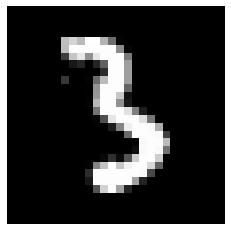

Loss: 0.00016180087706942563
Iteration: 54880, Score: 0.32018782061710954
[123, 81, 68, 35, 24, 48, 135, 96, 31, 27, 66, 157, 21, 88, 0]


Loss: 0.00017370329189322664
Iteration: 54920, Score: 0.34911962863802914
[149, 131, 32, 42, 11, 52, 182, 62, 23, 24, 74, 123, 21, 74, 0]


Loss: 0.00014700198152227482
Iteration: 54960, Score: 0.41765498770028364
[234, 45, 32, 30, 32, 37, 96, 86, 21, 34, 70, 113, 32, 138, 0]


Loss: 0.0001797638793059884
Iteration: 55000, Score: 0.32199283295869835
[212, 45, 66, 16, 24, 93, 61, 61, 28, 26, 51, 172, 31, 114, 0]


Loss: 0.00015232065767947935
Iteration: 55040, Score: 0.37662260869145403
[180, 75, 20, 19, 31, 30, 142, 83, 23, 26, 65, 156, 56, 94, 0]


Loss: 0.000160522302869937
Iteration: 55080, Score: 0.3479525387957692
[242, 70, 27, 30, 39, 29, 48, 90, 18, 23, 90, 174, 30, 90, 0]


Loss: 0.00014672647371236026
Iteration: 55120, Score: 0.3843818524479865
[142, 187, 11, 26, 21, 55, 193, 129, 14, 15, 25, 83, 30, 69, 0]


Loss: 0.00015796346762824567
Iteration: 55160, Score: 0.3878236080557107
[250, 29, 14, 17, 14, 64, 44, 122, 16, 16, 56, 171, 64, 123, 0]


Loss: 0.00015343409656434984
Iteration: 55200, Score: 0.35953579530119895
[201, 38, 29, 9, 26, 62, 48, 110, 16, 13, 109, 143, 75, 121, 0]


Test score: 0.30203672402352094
Loss: 0.00014281377228195243
Iteration: 55240, Score: 0.3540265021622181
[223, 35, 47, 19, 14, 82, 46, 73, 36, 22, 108, 159, 29, 107, 0]


Loss: 0.00014751757252890125
Iteration: 55280, Score: 0.3361297548413276
[216, 35, 22, 46, 68, 61, 28, 80, 16, 38, 67, 190, 23, 110, 0]


Loss: 0.0001433558887625091
Iteration: 55320, Score: 0.37217094939947126
[272, 28, 22, 26, 24, 34, 30, 98, 30, 25, 42, 218, 33, 118, 0]


Loss: 0.0001492220388712075
Iteration: 55360, Score: 0.4217603725790977
[184, 24, 74, 50, 67, 90, 39, 100, 23, 20, 57, 140, 24, 108, 0]


Loss: 0.0001498665778375964
Iteration: 55400, Score: 0.38140122094750406
[236, 37, 19, 52, 26, 65, 29, 70, 50, 22, 67, 196, 21, 110, 0]


Loss: 0.0001515541951221269
Iteration: 55440, Score: 0.39197714526951316
[249, 36, 23, 25, 35, 45, 51, 70, 34, 28, 51, 236, 37, 80, 0]


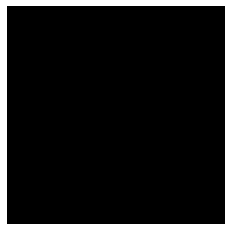

Loss: 0.00015930791871727722
Iteration: 55480, Score: 0.4705580386519432
[247, 15, 26, 36, 35, 54, 57, 101, 27, 34, 45, 183, 32, 108, 0]


Loss: 0.00016364216324595064
Iteration: 55520, Score: 0.36139134699106223
[197, 63, 54, 23, 24, 77, 48, 64, 32, 63, 55, 195, 19, 86, 0]


Loss: 0.00015977349108062773
Iteration: 55560, Score: 0.3550429456233978
[210, 70, 29, 25, 19, 123, 69, 69, 21, 21, 55, 184, 26, 79, 0]


Loss: 0.00015425691935383972
Iteration: 55600, Score: 0.3586003301646561
[229, 42, 42, 30, 26, 116, 71, 56, 30, 25, 66, 140, 21, 106, 0]


Test score: 0.377627939388156
Loss: 0.00013079367063967845
Iteration: 55640, Score: 0.38178583930805327
[176, 37, 34, 55, 19, 50, 92, 120, 25, 15, 52, 136, 22, 167, 0]


Loss: 0.000151851953976579
Iteration: 55680, Score: 0.3798269972652198
[168, 53, 67, 44, 32, 117, 46, 65, 37, 22, 59, 164, 41, 85, 0]


Loss: 0.00014563832864163007
Iteration: 55720, Score: 0.41783602241799234
[229, 43, 69, 30, 18, 94, 56, 54, 38, 21, 30, 176, 48, 94, 0]


Loss: 0.00014787352233696697
Iteration: 55760, Score: 0.38895138324052086
[202, 31, 65, 21, 21, 81, 114, 72, 31, 34, 77, 131, 40, 80, 0]


Loss: 0.00016137859222482945
Iteration: 55800, Score: 0.3731835422515869
[225, 64, 21, 36, 28, 54, 119, 76, 31, 14, 71, 148, 29, 84, 0]


Loss: 0.00014562594514055385
Iteration: 55840, Score: 0.34800038936734196
[210, 81, 29, 44, 22, 40, 117, 83, 28, 16, 48, 159, 25, 98, 0]


Loss: 0.00014203789415560014
Iteration: 55880, Score: 0.3555656169056892
[202, 48, 59, 19, 27, 89, 68, 97, 27, 23, 50, 199, 26, 66, 0]


Loss: 0.00016489551899907242
Iteration: 55920, Score: 0.3319611752927304
[172, 49, 116, 20, 18, 134, 55, 58, 28, 21, 82, 144, 31, 72, 0]


Loss: 0.0001391739569511482
Iteration: 55960, Score: 0.4388295908495784
[209, 35, 37, 31, 46, 36, 48, 84, 25, 26, 153, 144, 35, 91, 0]


Loss: 0.0001576238931413668
Iteration: 56000, Score: 0.3487569026201963
[194, 39, 38, 18, 30, 44, 77, 71, 38, 25, 146, 156, 29, 95, 0]


Test score: 0.27438137998804446
Loss: 0.0001467198543844944
Iteration: 56040, Score: 0.4117188214957713
[204, 49, 64, 27, 16, 71, 73, 70, 38, 24, 55, 189, 33, 87, 0]


Loss: 0.0001330330428862247
Iteration: 56080, Score: 0.41279823213815686
[234, 41, 19, 32, 37, 45, 54, 90, 32, 20, 83, 166, 25, 122, 0]


Loss: 0.00014386674760614288
Iteration: 56120, Score: 0.36907729095395186
[203, 30, 64, 15, 24, 85, 95, 71, 28, 16, 88, 161, 31, 89, 0]


Loss: 0.0001422088268499137
Iteration: 56160, Score: 0.3551058062538506
[205, 38, 67, 18, 16, 73, 63, 104, 18, 16, 88, 165, 28, 101, 0]


Loss: 0.00015309825487269083
Iteration: 56200, Score: 0.3779733616262675
[204, 50, 61, 38, 21, 45, 68, 102, 41, 27, 63, 135, 45, 100, 0]


Loss: 0.00015744096206141806
Iteration: 56240, Score: 0.38562677118182176
[202, 66, 48, 25, 19, 71, 72, 90, 38, 22, 47, 163, 34, 103, 0]


Loss: 0.00016345525654882126
Iteration: 56280, Score: 0.35708298763632784
[219, 44, 20, 69, 57, 34, 42, 89, 36, 30, 70, 152, 40, 98, 0]


Loss: 0.00014926609541599656
Iteration: 56320, Score: 0.39256269332766536
[200, 59, 33, 27, 26, 54, 53, 85, 35, 57, 88, 153, 22, 108, 0]


Loss: 0.00014777612899651024
Iteration: 56360, Score: 0.38619671693444263
[197, 34, 93, 59, 34, 97, 60, 61, 28, 44, 50, 107, 23, 113, 0]


Loss: 0.0001481789036921352
Iteration: 56400, Score: 0.3785518311336636
[197, 32, 28, 31, 31, 29, 60, 132, 32, 20, 69, 127, 94, 118, 0]


Test score: 0.28166902044415465
Loss: 0.00014686686160754925
Iteration: 56440, Score: 0.3297486293632536
[193, 36, 32, 43, 41, 58, 83, 77, 28, 17, 54, 140, 92, 106, 0]


Loss: 0.00014452277664877566
Iteration: 56480, Score: 0.3999129903763532
[232, 42, 34, 37, 32, 50, 79, 55, 40, 38, 48, 132, 62, 119, 0]


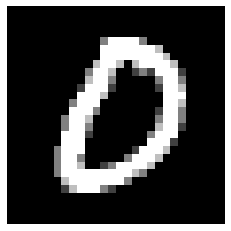

Loss: 0.00014350574957084267
Iteration: 56520, Score: 0.37332711970806126
[216, 50, 48, 27, 23, 69, 82, 55, 48, 32, 52, 160, 38, 100, 0]


Loss: 0.00014525752047672165
Iteration: 56560, Score: 0.346096452194266
[202, 63, 17, 24, 24, 59, 128, 67, 26, 16, 54, 124, 72, 124, 0]


Loss: 0.00014778721875104023
Iteration: 56600, Score: 0.33396850718557836
[183, 27, 52, 36, 29, 55, 119, 90, 27, 14, 62, 132, 75, 99, 0]


Loss: 0.00014578200688563302
Iteration: 56640, Score: 0.31765402303542933
[253, 65, 33, 66, 23, 25, 95, 57, 18, 12, 60, 149, 55, 89, 0]


Loss: 0.00015317543823298695
Iteration: 56680, Score: 0.3535268926918508
[194, 51, 74, 73, 16, 59, 63, 65, 28, 29, 58, 129, 54, 107, 0]


Loss: 0.00015170484373279133
Iteration: 56720, Score: 0.3812025011479855
[206, 44, 55, 24, 33, 40, 79, 59, 40, 29, 53, 140, 57, 141, 0]


Loss: 0.0001469516249034126
Iteration: 56760, Score: 0.32982410661876194
[180, 41, 32, 41, 34, 37, 100, 118, 18, 22, 57, 118, 75, 127, 0]


Loss: 0.0001430924889175108
Iteration: 56800, Score: 0.40323268920183175
[189, 43, 24, 34, 26, 29, 95, 117, 18, 42, 90, 134, 56, 103, 0]


Test score: 0.3028752915486692
Loss: 0.00015584660669377103
Iteration: 56840, Score: 0.3630750567987561
[197, 40, 57, 26, 29, 68, 66, 104, 35, 27, 50, 125, 42, 134, 0]


Loss: 0.00014680701247466065
Iteration: 56880, Score: 0.4116093118786811
[216, 28, 20, 39, 12, 35, 57, 110, 30, 35, 62, 179, 66, 111, 0]


Loss: 0.00015516727976200152
Iteration: 56920, Score: 0.39295141698420044
[192, 101, 37, 31, 14, 21, 141, 86, 24, 28, 47, 109, 66, 103, 0]


Loss: 0.00016199865203844082
Iteration: 56960, Score: 0.334276942975819
[196, 54, 76, 32, 20, 68, 106, 101, 17, 36, 34, 109, 54, 97, 0]


Loss: 0.00015945643855785188
Iteration: 57000, Score: 0.3533718424588441
[199, 43, 64, 54, 51, 63, 62, 95, 26, 18, 28, 127, 53, 117, 0]


Loss: 0.00016148700169615836
Iteration: 57040, Score: 0.40404056297242635
[193, 35, 36, 63, 64, 51, 49, 108, 26, 23, 46, 122, 46, 138, 0]


Loss: 0.00015645774193898246
Iteration: 57080, Score: 0.3668094141706824
[181, 24, 110, 25, 23, 120, 76, 56, 33, 14, 92, 95, 41, 110, 0]


Loss: 0.0001527805003080284
Iteration: 57120, Score: 0.38340410539507863
[207, 63, 39, 29, 22, 32, 96, 82, 32, 13, 60, 122, 54, 149, 0]


Loss: 0.0001563802581336653
Iteration: 57160, Score: 0.4202353596389294
[219, 36, 49, 35, 23, 26, 83, 90, 20, 22, 50, 189, 45, 113, 0]


Loss: 0.00014646984477881785
Iteration: 57200, Score: 0.3657499437630175
[201, 37, 32, 41, 49, 49, 69, 67, 26, 20, 53, 211, 41, 104, 0]


Test score: 0.3561362018287183
Loss: 0.00015166405615833057
Iteration: 57240, Score: 0.4001717403251678
[203, 31, 28, 20, 31, 61, 58, 75, 20, 25, 88, 204, 49, 107, 0]


Loss: 0.00016261563007238453
Iteration: 57280, Score: 0.3738000362217425
[215, 44, 31, 23, 29, 57, 53, 108, 36, 18, 61, 180, 40, 105, 0]


Loss: 0.00014773748754926368
Iteration: 57320, Score: 0.3708364688754081
[189, 78, 74, 20, 21, 91, 96, 44, 18, 40, 51, 158, 23, 97, 0]


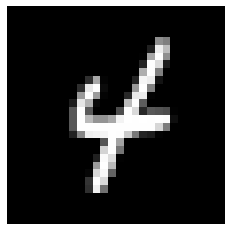

Loss: 0.00014962715430674625
Iteration: 57360, Score: 0.37560552321374413
[176, 55, 29, 59, 73, 38, 70, 80, 21, 38, 61, 164, 26, 110, 0]


Loss: 0.00016992300964271885
Iteration: 57400, Score: 0.40328074626624577
[211, 28, 31, 44, 62, 44, 45, 75, 26, 42, 60, 157, 38, 137, 0]


Loss: 0.00014997241640389458
Iteration: 57440, Score: 0.37385643804073326
[195, 29, 21, 22, 29, 45, 66, 93, 40, 27, 77, 130, 78, 148, 0]


Loss: 0.00015895697269539588
Iteration: 57480, Score: 0.3925807833410798
[196, 31, 41, 64, 56, 64, 97, 40, 35, 20, 39, 157, 47, 113, 0]


Loss: 0.00016054544964891508
Iteration: 57520, Score: 0.3367880050688982
[215, 65, 31, 24, 30, 62, 73, 64, 27, 12, 52, 195, 29, 121, 0]


Loss: 0.0001607491958609522
Iteration: 57560, Score: 0.44188437026739125
[205, 39, 52, 26, 25, 55, 78, 81, 26, 15, 63, 186, 35, 114, 0]


Loss: 0.00016724068661317382
Iteration: 57600, Score: 0.3891432100087405
[217, 35, 67, 18, 37, 66, 68, 79, 31, 22, 40, 193, 34, 93, 0]


Test score: 0.4047228675642982
Loss: 0.00017808831382904727
Iteration: 57640, Score: 0.33955669791623955
[202, 56, 77, 15, 33, 86, 78, 52, 21, 25, 29, 197, 37, 92, 0]


Loss: 0.0001884881923595198
Iteration: 57680, Score: 0.35113751772046087
[230, 51, 27, 20, 32, 45, 85, 64, 27, 29, 60, 191, 34, 105, 0]


Loss: 0.00017979086381916232
Iteration: 57720, Score: 0.3373355318885297
[266, 29, 23, 25, 33, 58, 59, 74, 40, 23, 48, 146, 56, 120, 0]


Loss: 0.00016900654784978404
Iteration: 57760, Score: 0.3596409530490636
[235, 29, 76, 23, 16, 82, 51, 68, 15, 24, 67, 160, 40, 114, 0]


Loss: 0.0001652861428917862
Iteration: 57800, Score: 0.38727855879068374
[185, 55, 72, 34, 34, 92, 68, 68, 29, 15, 47, 157, 33, 111, 0]


Loss: 0.00014666653811083887
Iteration: 57840, Score: 0.35650984665378915
[182, 94, 30, 20, 17, 36, 98, 76, 51, 37, 57, 159, 40, 103, 0]


Loss: 0.00015218439995392732
Iteration: 57880, Score: 0.3755046123415232
[221, 44, 53, 22, 27, 50, 54, 81, 20, 27, 82, 145, 79, 95, 0]


Loss: 0.00014661673349591656
Iteration: 57920, Score: 0.3818577836751938
[230, 23, 51, 21, 35, 77, 54, 76, 16, 15, 64, 186, 50, 102, 0]


Loss: 0.0001451238069315268
Iteration: 57960, Score: 0.36822601485252393
[192, 46, 89, 27, 16, 96, 90, 85, 20, 17, 50, 157, 35, 80, 0]


Loss: 0.000146943510714961
Iteration: 58000, Score: 0.35639838740974666
[176, 53, 36, 56, 32, 55, 111, 69, 26, 23, 39, 172, 63, 89, 0]


Test score: 0.35430527446419
Loss: 0.00015306065973746152
Iteration: 58040, Score: 0.37070496225357064
[227, 39, 58, 45, 17, 69, 59, 81, 15, 17, 80, 131, 69, 93, 0]


Loss: 0.00015899778479323219
Iteration: 58080, Score: 0.3430463026948273
[260, 21, 69, 35, 24, 59, 60, 56, 20, 25, 76, 158, 52, 85, 0]


Loss: 0.00017753475690006625
Iteration: 58120, Score: 0.38139820219948883
[206, 40, 42, 24, 31, 65, 47, 104, 14, 17, 95, 158, 38, 119, 0]


Loss: 0.00014108000682927767
Iteration: 58160, Score: 0.38067913046479224
[197, 34, 36, 21, 34, 54, 58, 88, 19, 17, 99, 209, 29, 105, 0]


Loss: 0.00015939394428919756
Iteration: 58200, Score: 0.3882132294327022
[202, 71, 27, 28, 54, 82, 103, 87, 16, 11, 62, 161, 28, 68, 0]


Loss: 0.00015251910384723002
Iteration: 58240, Score: 0.39940059404075134
[209, 42, 45, 39, 26, 59, 60, 87, 41, 24, 75, 180, 20, 93, 0]


Loss: 0.00015586432397000832
Iteration: 58280, Score: 0.3466122290194035
[186, 48, 72, 41, 38, 71, 72, 66, 29, 39, 57, 159, 24, 98, 0]


Loss: 0.00015263979219895158
Iteration: 58320, Score: 0.374590515206648
[199, 37, 54, 30, 30, 64, 68, 93, 42, 20, 66, 182, 35, 80, 0]


Loss: 0.00014845979008565812
Iteration: 58360, Score: 0.42487690761685365
[235, 58, 24, 38, 32, 32, 79, 73, 21, 19, 49, 189, 63, 88, 0]


Loss: 0.00014765531732901998
Iteration: 58400, Score: 0.38853544044494637
[198, 63, 48, 51, 12, 53, 73, 76, 31, 24, 64, 159, 36, 112, 0]


Test score: 0.32748705762624736
Loss: 0.0001434833087017593
Iteration: 58440, Score: 0.3598926606178283
[184, 33, 60, 35, 18, 79, 58, 110, 13, 22, 58, 169, 44, 117, 0]


Loss: 0.00015130831919238016
Iteration: 58480, Score: 0.3868221038579941
[212, 50, 21, 45, 24, 35, 61, 107, 19, 17, 98, 166, 28, 117, 0]


Loss: 0.00014957796531312595
Iteration: 58520, Score: 0.42501343935728075
[217, 48, 28, 16, 27, 15, 72, 75, 32, 42, 120, 154, 34, 120, 0]


Loss: 0.0001582620281667773
Iteration: 58560, Score: 0.37842543533444406
[196, 37, 34, 15, 25, 31, 51, 93, 26, 47, 74, 205, 35, 131, 0]


Loss: 0.000146353314048056
Iteration: 58600, Score: 0.29721474806219333
[238, 37, 33, 21, 26, 45, 43, 82, 21, 39, 87, 170, 39, 119, 0]


Loss: 0.00016000923927804358
Iteration: 58640, Score: 0.420275340974331
[244, 47, 43, 38, 54, 45, 43, 76, 19, 33, 66, 157, 37, 98, 0]


Loss: 0.0001482163888450253
Iteration: 58680, Score: 0.3559772948436439
[215, 68, 30, 27, 38, 48, 46, 61, 28, 25, 102, 184, 31, 97, 0]


Loss: 0.00016208000239101186
Iteration: 58720, Score: 0.40033100374042985
[145, 49, 112, 26, 22, 132, 64, 85, 25, 11, 86, 136, 17, 90, 0]


Loss: 0.000158669426993632
Iteration: 58760, Score: 0.38876433045417086
[189, 69, 41, 34, 35, 49, 64, 106, 14, 10, 71, 143, 44, 131, 0]


Loss: 0.0001577010109148994
Iteration: 58800, Score: 0.38797195920348176
[185, 69, 40, 44, 45, 30, 89, 66, 25, 16, 96, 160, 42, 93, 0]


Test score: 0.30530448491126305
Loss: 0.00017008094519360201
Iteration: 58840, Score: 0.3616628837101161
[257, 45, 16, 42, 53, 65, 53, 42, 30, 15, 58, 168, 58, 98, 0]


Loss: 0.0001800596855119857
Iteration: 58880, Score: 0.37272482931613926
[240, 59, 26, 28, 40, 60, 59, 83, 29, 18, 47, 140, 49, 122, 0]


Loss: 0.00018473758165450817
Iteration: 58920, Score: 0.35374996343255044
[227, 94, 25, 14, 19, 38, 106, 67, 18, 21, 50, 159, 40, 122, 0]


Loss: 0.0001551958309473601
Iteration: 58960, Score: 0.4102920158505439
[195, 79, 14, 15, 24, 41, 113, 84, 33, 28, 45, 151, 67, 111, 0]


Loss: 0.00015563309410495142
Iteration: 59000, Score: 0.38408127069473263
[201, 40, 20, 33, 13, 81, 62, 89, 23, 26, 27, 199, 57, 129, 0]


Loss: 0.0001551202769503689
Iteration: 59040, Score: 0.40769734600186347
[179, 60, 27, 21, 16, 47, 81, 135, 20, 20, 53, 123, 78, 140, 0]


Loss: 0.00015987415259639402
Iteration: 59080, Score: 0.41434278035163874
[200, 54, 70, 25, 23, 87, 74, 84, 27, 15, 75, 95, 47, 124, 0]


Loss: 0.0001628804531912826
Iteration: 59120, Score: 0.4219809062182903
[188, 20, 21, 17, 13, 36, 69, 104, 20, 18, 58, 189, 111, 136, 0]


Loss: 0.00014646442550538804
Iteration: 59160, Score: 0.3881690451204777
[190, 40, 48, 43, 28, 67, 43, 124, 23, 21, 47, 137, 79, 110, 0]


Loss: 0.00014830671192095493
Iteration: 59200, Score: 0.43283789828419683
[260, 62, 27, 14, 21, 29, 56, 101, 21, 42, 70, 126, 52, 119, 0]


Test score: 0.3217531236112118
Loss: 0.00017700218645541594
Iteration: 59240, Score: 0.4220269089043141
[277, 24, 33, 45, 15, 31, 53, 85, 24, 16, 88, 150, 37, 122, 0]


Loss: 0.00014978253296499643
Iteration: 59280, Score: 0.4104815678596497
[244, 31, 42, 31, 34, 60, 66, 54, 14, 24, 57, 161, 42, 140, 0]


Loss: 0.00017821228973216374
Iteration: 59320, Score: 0.370305378615856
[234, 71, 30, 18, 15, 30, 52, 102, 16, 19, 79, 177, 25, 132, 0]


Loss: 0.00016059181483676013
Iteration: 59360, Score: 0.4283545739576219
[223, 62, 36, 19, 13, 53, 46, 123, 13, 11, 90, 119, 27, 165, 0]


Loss: 0.0001590822695283055
Iteration: 59400, Score: 0.35189367513358594
[249, 69, 25, 23, 19, 23, 53, 91, 27, 15, 85, 153, 28, 140, 0]


Loss: 0.00015130575114366402
Iteration: 59440, Score: 0.37596021782606837
[232, 42, 44, 25, 17, 65, 59, 55, 32, 22, 89, 143, 34, 141, 0]


Loss: 0.00014250762564332677
Iteration: 59480, Score: 0.3913840413093566
[212, 38, 35, 17, 22, 60, 84, 93, 34, 21, 68, 173, 35, 108, 0]


Loss: 0.0001542991605789097
Iteration: 59520, Score: 0.3933074075132609
[189, 38, 80, 58, 54, 95, 60, 87, 23, 17, 33, 136, 28, 102, 0]


Loss: 0.00016191936845505505
Iteration: 59560, Score: 0.40181743042171
[225, 25, 37, 46, 68, 48, 78, 102, 18, 26, 55, 76, 18, 178, 0]


Loss: 0.0001386047887669107
Iteration: 59600, Score: 0.4097854053527117
[211, 95, 27, 59, 49, 53, 130, 66, 7, 16, 51, 94, 19, 123, 0]


Test score: 0.33292302718758576
Loss: 0.00015242268290007935
Iteration: 59640, Score: 0.43825873591005804
[251, 36, 24, 37, 36, 70, 46, 86, 20, 14, 59, 161, 34, 126, 0]


Loss: 0.0001607384152574414
Iteration: 59680, Score: 0.32112303772568696
[195, 68, 37, 18, 21, 59, 114, 71, 18, 18, 86, 137, 62, 96, 0]


Loss: 0.00015773821210861785
Iteration: 59720, Score: 0.4248398950397968
[193, 56, 25, 65, 39, 46, 82, 115, 12, 17, 51, 153, 27, 119, 0]


Loss: 0.00017786033655023037
Iteration: 59760, Score: 0.4148429345488549
[277, 24, 23, 28, 31, 39, 61, 101, 14, 26, 91, 111, 51, 123, 0]


Loss: 0.00015516435665937524
Iteration: 59800, Score: 0.4330864616334438
[216, 41, 41, 18, 55, 73, 88, 88, 19, 18, 82, 110, 58, 93, 0]


Loss: 0.00016509767085666973
Iteration: 59840, Score: 0.3830804811865091
[228, 17, 44, 14, 25, 66, 45, 82, 21, 13, 65, 205, 71, 104, 0]


Loss: 0.00019408377799790674
Iteration: 59880, Score: 0.3721773178577423
[196, 43, 58, 36, 43, 42, 39, 106, 34, 13, 70, 140, 58, 122, 0]


Loss: 0.000179150626173247
Iteration: 59920, Score: 0.4245762232840061
[275, 30, 48, 31, 16, 37, 50, 62, 20, 22, 69, 132, 50, 158, 0]


Loss: 0.00015854094956530568
Iteration: 59960, Score: 0.39298357795178884
[188, 79, 64, 15, 37, 66, 83, 53, 38, 23, 61, 139, 61, 93, 0]


Loss: 0.00016610382936110214
Iteration: 60000, Score: 0.4360399078503252
[197, 51, 46, 20, 40, 43, 66, 90, 28, 26, 75, 152, 28, 138, 0]


Test score: 0.37123453653790056
Loss: 0.00016251258222108037
Iteration: 60040, Score: 0.41276983007788653
[164, 64, 30, 18, 27, 32, 36, 90, 38, 19, 57, 237, 61, 127, 0]


Loss: 0.00015592421331451223
Iteration: 60080, Score: 0.4172712116539479
[241, 54, 28, 13, 28, 44, 44, 93, 16, 24, 66, 164, 63, 122, 0]


Loss: 0.00017312149843506903
Iteration: 60120, Score: 0.3977392513155936
[238, 79, 47, 16, 28, 69, 97, 50, 25, 22, 43, 178, 16, 92, 0]


Loss: 0.00015482180088613863
Iteration: 60160, Score: 0.39249933448433866
[262, 39, 38, 28, 33, 34, 49, 58, 18, 34, 49, 172, 35, 151, 0]


Loss: 0.00015198925834053505
Iteration: 60200, Score: 0.41073536267876626
[240, 78, 50, 16, 18, 16, 85, 50, 39, 20, 61, 168, 45, 114, 0]


Loss: 0.00015313077940925685
Iteration: 60240, Score: 0.44162649458646774
[213, 43, 25, 40, 64, 40, 68, 63, 25, 12, 91, 153, 49, 114, 0]


Loss: 0.00014554060604906796
Iteration: 60280, Score: 0.3873991292715072
[217, 39, 67, 13, 22, 27, 73, 48, 32, 15, 78, 194, 65, 110, 0]


Loss: 0.00016505058765927023
Iteration: 60320, Score: 0.4311749493479728
[299, 42, 26, 24, 15, 30, 34, 71, 38, 23, 41, 201, 53, 103, 0]


Loss: 0.00015734039297453682
Iteration: 60360, Score: 0.42843746456503873
[256, 66, 34, 42, 26, 40, 93, 62, 26, 16, 39, 96, 26, 178, 0]


Loss: 0.00016402415005216728
Iteration: 60400, Score: 0.40492608544230463
[214, 39, 78, 30, 21, 42, 63, 88, 29, 21, 56, 165, 12, 142, 0]


Test score: 0.3989714435636998
Loss: 0.00016001939171233432
Iteration: 60440, Score: 0.4317217011302709
[202, 37, 45, 49, 21, 65, 82, 65, 42, 25, 48, 163, 38, 118, 0]


Loss: 0.00015980842731819035
Iteration: 60480, Score: 0.41130286663770654
[278, 60, 22, 19, 21, 45, 56, 73, 24, 11, 60, 193, 25, 113, 0]


Loss: 0.00015745848735301701
Iteration: 60520, Score: 0.40120763206481946
[261, 53, 30, 30, 25, 36, 63, 70, 29, 34, 29, 180, 43, 117, 0]


Loss: 0.00015736226980752967
Iteration: 60560, Score: 0.3987174280881881
[206, 54, 37, 34, 36, 44, 62, 86, 31, 12, 58, 218, 29, 93, 0]


Loss: 0.00017452833295367805
Iteration: 60600, Score: 0.4198441883027552
[218, 86, 30, 22, 19, 26, 137, 86, 17, 31, 54, 163, 17, 94, 0]


Loss: 0.00014548738504912764
Iteration: 60640, Score: 0.41819576357305044
[242, 35, 36, 41, 27, 44, 64, 84, 19, 21, 35, 220, 33, 99, 0]


Loss: 0.00015432708139961345
Iteration: 60680, Score: 0.4434958790540695
[226, 38, 48, 17, 19, 64, 113, 67, 28, 17, 41, 124, 62, 136, 0]


Loss: 0.00017892811923948744
Iteration: 60720, Score: 0.3364293324165046
[230, 53, 25, 23, 20, 52, 77, 74, 17, 14, 62, 222, 18, 113, 0]


Loss: 0.00018460009202204123
Iteration: 60760, Score: 0.3716882602274418
[233, 54, 19, 33, 43, 31, 72, 97, 12, 16, 62, 186, 18, 124, 0]


Loss: 0.0001606578802552122
Iteration: 60800, Score: 0.3810580883473158
[214, 36, 22, 16, 30, 80, 57, 98, 24, 18, 60, 191, 44, 110, 0]


Test score: 0.30830700394511223
Loss: 0.00019796710631214074
Iteration: 60840, Score: 0.4009943682588637
[182, 51, 114, 15, 15, 127, 63, 64, 17, 26, 52, 162, 28, 84, 0]


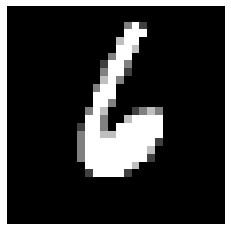

Loss: 0.0001408542463832802
Iteration: 60880, Score: 0.39800162824988367
[206, 62, 96, 18, 15, 100, 66, 70, 20, 38, 41, 141, 31, 96, 0]


Loss: 0.00018362297789549314
Iteration: 60920, Score: 0.33437945507653055
[205, 67, 64, 23, 13, 73, 62, 93, 10, 27, 52, 186, 21, 104, 0]


Loss: 0.00015563512276882936
Iteration: 60960, Score: 0.3400777606666088
[192, 47, 79, 28, 20, 83, 65, 88, 21, 29, 47, 167, 35, 99, 0]


Loss: 0.00016907251098856836
Iteration: 61000, Score: 0.42664148372411725
[198, 33, 62, 25, 36, 71, 88, 70, 35, 21, 42, 174, 36, 109, 0]


Loss: 0.00017199437557757728
Iteration: 61040, Score: 0.35765197068452836
[230, 64, 31, 51, 44, 39, 56, 80, 39, 21, 62, 163, 23, 97, 0]


Loss: 0.00015349324149093268
Iteration: 61080, Score: 0.339350624114275
[244, 62, 22, 35, 31, 36, 95, 53, 25, 39, 58, 154, 28, 118, 0]


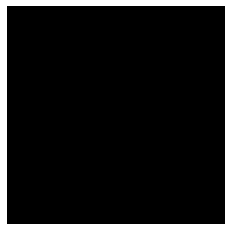

Loss: 0.00018458323974990227
Iteration: 61120, Score: 0.39750659549236295
[194, 89, 47, 38, 19, 49, 124, 90, 10, 29, 54, 108, 33, 116, 0]


Loss: 0.00015196802034037453
Iteration: 61160, Score: 0.36571532794088113
[194, 38, 77, 45, 32, 86, 52, 113, 21, 28, 46, 135, 25, 108, 0]


Loss: 0.00015644284275760328
Iteration: 61200, Score: 0.3559360828697681
[184, 69, 84, 46, 26, 79, 82, 59, 19, 18, 53, 177, 19, 85, 0]


Test score: 0.36277983401715763
Loss: 0.00015807215495232095
Iteration: 61240, Score: 0.4219466927796603
[199, 33, 37, 41, 48, 53, 65, 88, 19, 59, 58, 145, 58, 97, 0]


Loss: 0.0001628933568203245
Iteration: 61280, Score: 0.40063126640766866
[187, 57, 32, 26, 28, 53, 95, 129, 24, 20, 69, 141, 32, 107, 0]


Loss: 0.00015448926950794973
Iteration: 61320, Score: 0.3982394846081734
[156, 37, 73, 49, 39, 54, 63, 76, 13, 30, 135, 121, 34, 120, 0]


Loss: 0.00013967119378673176
Iteration: 61360, Score: 0.360619185373187
[174, 55, 35, 32, 23, 46, 62, 112, 22, 34, 111, 160, 24, 110, 0]


Loss: 0.00015181864011632368
Iteration: 61400, Score: 0.4193949790042826
[192, 72, 30, 35, 30, 50, 93, 95, 16, 24, 52, 186, 38, 87, 0]


Loss: 0.00013506049769884833
Iteration: 61440, Score: 0.4017711409330369
[163, 27, 48, 28, 35, 62, 51, 118, 39, 38, 98, 120, 75, 98, 0]


Loss: 0.0001395042808009947
Iteration: 61480, Score: 0.41381632876396174
[206, 45, 34, 43, 40, 25, 74, 95, 26, 44, 78, 147, 41, 102, 0]


Loss: 0.00017140869795940586
Iteration: 61520, Score: 0.4462083121091127
[206, 25, 29, 26, 47, 30, 59, 100, 28, 38, 88, 120, 38, 166, 0]


Loss: 0.0001432846191145942
Iteration: 61560, Score: 0.33223942075669766
[233, 23, 51, 22, 40, 44, 59, 77, 24, 38, 91, 167, 27, 104, 0]


Loss: 0.00015033546785002064
Iteration: 61600, Score: 0.3651587167233228
[201, 36, 44, 23, 32, 25, 60, 112, 27, 17, 75, 212, 28, 108, 0]


Test score: 0.40448321902751916
Loss: 0.00016254517823918548
Iteration: 61640, Score: 0.36478756047785277
[228, 38, 34, 40, 29, 41, 44, 102, 28, 28, 74, 159, 29, 126, 0]


Loss: 0.00014706038391275905
Iteration: 61680, Score: 0.4340572469830512
[173, 65, 41, 36, 28, 28, 122, 89, 20, 34, 81, 138, 38, 107, 0]


Loss: 0.00015769519318265397
Iteration: 61720, Score: 0.4041930191218852
[192, 52, 44, 18, 31, 39, 97, 60, 41, 21, 131, 153, 33, 88, 0]


Loss: 0.00014142922893977517
Iteration: 61760, Score: 0.38916281799227004
[196, 48, 33, 21, 15, 42, 85, 65, 48, 20, 103, 168, 38, 118, 0]


Loss: 0.00015350197760164661
Iteration: 61800, Score: 0.38341508247703315
[238, 49, 56, 15, 24, 69, 77, 79, 31, 15, 64, 160, 24, 99, 0]


Loss: 0.00014358205498050567
Iteration: 61840, Score: 0.3746751038581133
[215, 25, 55, 32, 14, 61, 87, 96, 23, 19, 102, 139, 23, 109, 0]


Loss: 0.00015290966229482433
Iteration: 61880, Score: 0.4148928856216371
[249, 36, 57, 38, 42, 54, 68, 74, 32, 16, 88, 123, 17, 106, 0]


Loss: 0.00016426391272890488
Iteration: 61920, Score: 0.39790037824213503
[213, 73, 66, 38, 40, 78, 81, 71, 30, 18, 63, 92, 25, 112, 0]


Loss: 0.00017064693932845691
Iteration: 61960, Score: 0.34591968325153
[210, 57, 52, 27, 53, 67, 79, 60, 30, 10, 61, 134, 42, 118, 0]


Loss: 0.00015470859603155244
Iteration: 62000, Score: 0.35611736587435006
[208, 52, 45, 37, 69, 58, 64, 48, 36, 14, 69, 131, 48, 121, 0]


Test score: 0.3773480084761977
Loss: 0.0001644623217901189
Iteration: 62040, Score: 0.37189715196192263
[248, 45, 45, 22, 40, 71, 60, 68, 30, 17, 54, 127, 34, 139, 0]


Loss: 0.00015806846073808723
Iteration: 62080, Score: 0.42639867959916594
[209, 121, 34, 21, 43, 43, 112, 72, 28, 18, 69, 104, 26, 100, 0]


Loss: 0.00016574364349815972
Iteration: 62120, Score: 0.3613182649016381
[200, 66, 93, 14, 17, 98, 107, 105, 23, 13, 40, 101, 30, 93, 0]


Loss: 0.00015794776998462133
Iteration: 62160, Score: 0.3648111598789691
[235, 44, 54, 26, 24, 61, 55, 104, 18, 16, 91, 115, 51, 106, 0]


Loss: 0.00014681955204845886
Iteration: 62200, Score: 0.43196864537894725
[236, 76, 51, 35, 24, 67, 98, 68, 13, 16, 61, 93, 31, 131, 0]


Loss: 0.00016495453383312287
Iteration: 62240, Score: 0.3462484632730484
[224, 69, 25, 26, 28, 30, 76, 85, 20, 19, 98, 130, 27, 143, 0]


Loss: 0.00015755708187612937
Iteration: 62280, Score: 0.40736330711841584
[144, 118, 42, 13, 33, 34, 121, 110, 21, 14, 69, 141, 31, 109, 0]


Loss: 0.00015444602442498157
Iteration: 62320, Score: 0.3854186863005162
[229, 54, 54, 20, 39, 66, 81, 69, 34, 17, 52, 120, 42, 123, 0]


Loss: 0.00014466604299510905
Iteration: 62360, Score: 0.44819515478610994
[181, 54, 64, 27, 20, 64, 93, 77, 25, 27, 82, 113, 16, 157, 0]


Loss: 0.0001517339694337793
Iteration: 62400, Score: 0.4060218524187803
[196, 68, 39, 15, 38, 45, 114, 72, 22, 31, 84, 98, 36, 142, 0]


Test score: 0.3971398301422596
Loss: 0.00015638058002878462
Iteration: 62440, Score: 0.41873940883576866
[198, 63, 39, 26, 29, 33, 74, 84, 25, 22, 83, 140, 42, 142, 0]


Loss: 0.0001538287908729844
Iteration: 62480, Score: 0.407607524305582
[194, 84, 54, 16, 23, 81, 107, 61, 17, 19, 91, 94, 41, 118, 0]


Loss: 0.0001565331291529225
Iteration: 62520, Score: 0.4474823542833327
[246, 36, 36, 24, 30, 62, 66, 70, 19, 34, 91, 101, 29, 156, 0]


Loss: 0.00015665433805702028
Iteration: 62560, Score: 0.35205569571256634
[225, 64, 33, 39, 34, 39, 62, 60, 16, 22, 59, 190, 30, 127, 0]


Loss: 0.00016422369251768395
Iteration: 62600, Score: 0.36289745674282303
[184, 79, 51, 30, 44, 37, 47, 81, 20, 12, 89, 135, 56, 135, 0]


Loss: 0.000144322738410525
Iteration: 62640, Score: 0.3508904512375593
[216, 49, 37, 28, 59, 39, 80, 90, 27, 13, 84, 129, 31, 118, 0]


Loss: 0.00014906240771857452
Iteration: 62680, Score: 0.44919314497709273
[234, 51, 59, 40, 37, 58, 66, 54, 26, 20, 76, 115, 25, 139, 0]


Loss: 0.00015330849643536396
Iteration: 62720, Score: 0.37597590404748926
[174, 78, 21, 34, 29, 37, 60, 80, 49, 37, 84, 172, 30, 115, 0]


Loss: 0.00015133507350581548
Iteration: 62760, Score: 0.3702449570670724
[231, 86, 28, 22, 44, 35, 62, 45, 43, 17, 55, 170, 21, 141, 0]


Loss: 0.00016607388882614315
Iteration: 62800, Score: 0.36116831613332034
[243, 65, 19, 20, 22, 56, 80, 95, 25, 16, 56, 147, 30, 126, 0]


Test score: 0.3249904193561523
Loss: 0.00016155060600650913
Iteration: 62840, Score: 0.37505843883752826
[232, 111, 35, 62, 35, 29, 65, 63, 14, 9, 77, 130, 32, 106, 0]


Loss: 0.00016497030199765135
Iteration: 62880, Score: 0.3709790835380555
[196, 59, 79, 27, 32, 53, 47, 105, 19, 26, 54, 149, 35, 119, 0]


Loss: 0.00013965311730584519
Iteration: 62920, Score: 0.3562806004583836
[173, 67, 70, 47, 55, 67, 60, 75, 41, 33, 60, 100, 37, 115, 0]


Loss: 0.00016897720873214125
Iteration: 62960, Score: 0.36755825717747204
[194, 133, 33, 28, 41, 31, 131, 47, 26, 23, 72, 107, 30, 104, 0]


Loss: 0.00013846141290847351
Iteration: 63000, Score: 0.40400558623671534
[194, 110, 35, 33, 23, 28, 102, 57, 23, 23, 113, 117, 30, 112, 0]


Loss: 0.00015829924516380336
Iteration: 63040, Score: 0.47680062440037735
[186, 59, 43, 47, 69, 81, 60, 65, 21, 21, 41, 133, 44, 130, 0]


Loss: 0.00014640003919212736
Iteration: 63080, Score: 0.37844840459525597
[189, 51, 46, 22, 23, 74, 76, 71, 74, 25, 42, 115, 55, 137, 0]


Loss: 0.00014380013686857832
Iteration: 63120, Score: 0.4182230027019978
[199, 35, 34, 24, 34, 52, 47, 86, 33, 23, 74, 203, 38, 118, 0]


Loss: 0.00013749417734679325
Iteration: 63160, Score: 0.42396614477038375
[248, 38, 45, 54, 51, 52, 51, 48, 20, 14, 54, 183, 21, 121, 0]


Loss: 0.00014789338681979545
Iteration: 63200, Score: 0.3706706986427307
[214, 79, 57, 25, 50, 46, 103, 51, 19, 45, 48, 144, 20, 99, 0]


Test score: 0.271102396549657
Loss: 0.00013659409737791321
Iteration: 63240, Score: 0.3658912716507911
[198, 51, 42, 26, 22, 48, 63, 145, 20, 17, 70, 164, 39, 95, 0]


Loss: 0.000143853791352282
Iteration: 63280, Score: 0.38780649931728833
[241, 42, 25, 19, 27, 56, 72, 80, 37, 22, 56, 143, 35, 145, 0]


Loss: 0.00015481166945303116
Iteration: 63320, Score: 0.36222041590511794
[241, 52, 38, 16, 28, 34, 70, 72, 35, 26, 62, 165, 39, 122, 0]


Loss: 0.0001601954035110084
Iteration: 63360, Score: 0.36566799304261804
[143, 57, 32, 30, 34, 48, 56, 112, 36, 23, 68, 171, 58, 132, 0]


Loss: 0.00015279896531480004
Iteration: 63400, Score: 0.34549708095192905
[181, 40, 76, 49, 20, 125, 52, 68, 21, 10, 80, 131, 46, 101, 0]


Loss: 0.0001605087136693909
Iteration: 63440, Score: 0.37103349381685263
[163, 72, 64, 69, 63, 76, 73, 74, 17, 11, 81, 115, 37, 85, 0]


Loss: 0.00014038092725330168
Iteration: 63480, Score: 0.431013697385788
[203, 34, 46, 42, 36, 52, 56, 101, 25, 28, 62, 117, 47, 151, 0]


Loss: 0.00016250109740308474
Iteration: 63520, Score: 0.3811857926017402
[228, 58, 38, 26, 19, 78, 61, 72, 25, 20, 61, 133, 51, 130, 0]


Loss: 0.00016332043116865398
Iteration: 63560, Score: 0.3766300293952227
[247, 30, 16, 29, 22, 54, 50, 108, 25, 24, 79, 154, 48, 114, 0]


Loss: 0.00013900158195495293
Iteration: 63600, Score: 0.40737632633745663
[194, 71, 31, 24, 26, 75, 41, 125, 20, 14, 103, 122, 58, 96, 0]


Test score: 0.37677003191714187
Loss: 0.00015248814061172923
Iteration: 63640, Score: 0.3816328461468219
[190, 85, 19, 26, 31, 45, 91, 119, 37, 8, 60, 154, 48, 87, 0]


Loss: 0.00016299347978075286
Iteration: 63680, Score: 0.4306643554661423
[197, 95, 9, 67, 46, 38, 118, 72, 12, 36, 60, 125, 26, 99, 0]


Loss: 0.00016196880450680887
Iteration: 63720, Score: 0.4383546242117881
[185, 55, 32, 19, 54, 39, 52, 108, 29, 45, 81, 131, 45, 125, 0]


Loss: 0.00016350083459030322
Iteration: 63760, Score: 0.41726269322633736
[216, 52, 20, 22, 54, 39, 47, 66, 33, 26, 125, 165, 52, 83, 0]


Loss: 0.00014308528049269178
Iteration: 63800, Score: 0.4103978224992752
[217, 67, 35, 19, 32, 32, 85, 89, 33, 19, 87, 149, 39, 97, 0]


Loss: 0.00016201748976358524
Iteration: 63840, Score: 0.41347131033614276
[214, 73, 39, 26, 49, 38, 89, 81, 29, 19, 78, 148, 23, 94, 0]


Loss: 0.0001536062511488122
Iteration: 63880, Score: 0.36915480151772495
[235, 27, 22, 26, 29, 53, 46, 154, 18, 25, 96, 115, 22, 132, 0]


Loss: 0.00015328039586089893
Iteration: 63920, Score: 0.40501549644768237
[213, 48, 47, 30, 34, 65, 50, 75, 37, 33, 68, 153, 28, 119, 0]


Loss: 0.00015177685919494187
Iteration: 63960, Score: 0.37112583877146244
[199, 61, 53, 18, 30, 51, 126, 69, 14, 27, 93, 111, 28, 120, 0]


Loss: 0.00014582604227066063
Iteration: 64000, Score: 0.39398716953396795
[207, 30, 37, 22, 44, 27, 82, 83, 44, 29, 65, 162, 29, 139, 0]


Test score: 0.27867840012162926
Loss: 0.0001366983994772677
Iteration: 64040, Score: 0.3275441811904312
[227, 31, 38, 40, 31, 60, 55, 96, 37, 21, 49, 175, 37, 103, 0]


Loss: 0.00016062982324910742
Iteration: 64080, Score: 0.4339520279647112
[190, 61, 43, 19, 40, 57, 76, 58, 18, 17, 79, 200, 35, 107, 0]


Loss: 0.00016678819740899856
Iteration: 64120, Score: 0.3707524066865444
[176, 65, 51, 14, 44, 50, 86, 68, 46, 28, 89, 139, 33, 111, 0]


Loss: 0.00018776636297816623
Iteration: 64160, Score: 0.3933530178070069
[153, 64, 94, 37, 40, 116, 52, 76, 37, 16, 76, 134, 19, 86, 0]


Loss: 0.00016178891164809515
Iteration: 64200, Score: 0.4058259913027286
[201, 67, 14, 30, 21, 77, 104, 74, 40, 11, 82, 140, 32, 107, 0]


Loss: 0.00016393420028879406
Iteration: 64240, Score: 0.34633484978973866
[186, 100, 39, 17, 13, 61, 134, 39, 24, 16, 72, 164, 44, 91, 0]


Loss: 0.00017743871685150766
Iteration: 64280, Score: 0.4219092346429824
[180, 57, 35, 28, 27, 49, 106, 77, 54, 31, 74, 122, 38, 122, 0]


Loss: 0.00015941057293688583
Iteration: 64320, Score: 0.40037822186946875
[197, 111, 19, 13, 16, 60, 127, 86, 30, 15, 67, 143, 26, 90, 0]


Loss: 0.00014422153445393243
Iteration: 64360, Score: 0.3630077155083417
[236, 94, 26, 15, 25, 51, 105, 82, 41, 23, 62, 103, 32, 105, 0]


Loss: 0.00016191384395801582
Iteration: 64400, Score: 0.4514226911962032
[165, 23, 28, 107, 70, 47, 84, 59, 38, 26, 75, 142, 25, 111, 0]


Test score: 0.37142613568715754
Loss: 0.00015180416138497424
Iteration: 64440, Score: 0.42476387482881545
[173, 25, 38, 49, 38, 39, 82, 80, 15, 26, 111, 172, 14, 138, 0]


Loss: 0.00013604617173021652
Iteration: 64480, Score: 0.418886022284627
[191, 96, 39, 21, 50, 39, 125, 77, 18, 33, 88, 117, 18, 88, 0]


Loss: 0.0001589355854970002
Iteration: 64520, Score: 0.42198455870151513
[243, 54, 34, 21, 25, 30, 72, 77, 34, 20, 98, 137, 33, 122, 0]


Loss: 0.00015810530550433035
Iteration: 64560, Score: 0.3797253648793558
[201, 48, 68, 39, 14, 76, 59, 63, 22, 13, 99, 170, 16, 112, 0]


Loss: 0.00016462479455565813
Iteration: 64600, Score: 0.3455463095903397
[205, 64, 28, 31, 41, 38, 75, 101, 32, 21, 88, 146, 17, 113, 0]


Loss: 0.00015578069916693643
Iteration: 64640, Score: 0.37149835570156575
[220, 41, 27, 39, 28, 41, 53, 62, 48, 21, 134, 156, 24, 106, 0]


Loss: 0.00014839547408668785
Iteration: 64680, Score: 0.42816187509894366
[195, 78, 73, 20, 27, 98, 91, 58, 20, 11, 82, 132, 25, 90, 0]


Loss: 0.0001803434094983831
Iteration: 64720, Score: 0.3720713859740645
[206, 35, 42, 25, 18, 69, 49, 81, 24, 12, 151, 151, 23, 114, 0]


Loss: 0.00016259308954445838
Iteration: 64760, Score: 0.39453725247085103
[183, 82, 63, 28, 19, 83, 83, 72, 19, 13, 110, 132, 15, 98, 0]


Loss: 0.00014642698210998897
Iteration: 64800, Score: 0.4142427158355713
[194, 21, 56, 35, 38, 97, 52, 69, 26, 20, 123, 130, 20, 119, 0]


Test score: 0.3954201108664275
Loss: 0.0001539118105131131
Iteration: 64840, Score: 0.33187084532529115
[121, 141, 51, 23, 25, 66, 152, 106, 11, 21, 67, 100, 17, 99, 0]


Loss: 0.00013949140180797534
Iteration: 64880, Score: 0.36838381825387484
[231, 36, 34, 38, 39, 65, 90, 80, 28, 20, 85, 109, 24, 121, 0]


Loss: 0.0001571738212092359
Iteration: 64920, Score: 0.39407492836564784
[251, 26, 31, 46, 26, 35, 61, 95, 26, 21, 112, 129, 26, 115, 0]


Loss: 0.00016006480798327926
Iteration: 64960, Score: 0.3955511614084243
[181, 37, 21, 116, 92, 29, 50, 58, 26, 25, 71, 180, 25, 89, 0]


Loss: 0.0001576113119320238
Iteration: 65000, Score: 0.3830059471391142
[168, 49, 78, 24, 20, 77, 77, 74, 22, 22, 75, 177, 43, 94, 0]


Loss: 0.0001450955392395997
Iteration: 65040, Score: 0.38163689436018455
[178, 53, 52, 42, 30, 79, 71, 104, 23, 34, 101, 103, 35, 95, 0]


Loss: 0.0001569826381659574
Iteration: 65080, Score: 0.3714695521146058
[279, 40, 32, 33, 22, 40, 71, 68, 37, 14, 84, 138, 27, 115, 0]


Loss: 0.00014999007654366276
Iteration: 65120, Score: 0.4000524652078748
[201, 49, 66, 37, 30, 76, 40, 66, 16, 28, 111, 148, 40, 92, 0]


Loss: 0.0001461289231297778
Iteration: 65160, Score: 0.431294191122055
[172, 116, 42, 29, 18, 50, 81, 114, 22, 18, 68, 156, 38, 76, 0]


Loss: 0.0001441717104352283
Iteration: 65200, Score: 0.37718960547447217
[243, 68, 58, 38, 15, 61, 58, 64, 23, 18, 54, 173, 53, 74, 0]


Test score: 0.3834121678471566
Loss: 0.00015845894348602782
Iteration: 65240, Score: 0.375792537738569
[180, 52, 23, 49, 17, 30, 53, 104, 27, 29, 87, 183, 71, 95, 0]


Loss: 0.00015407123789214254
Iteration: 65280, Score: 0.43123324684798714
[247, 33, 37, 23, 13, 48, 49, 85, 37, 21, 80, 161, 81, 85, 0]


Loss: 0.00013910895107278298
Iteration: 65320, Score: 0.38211932468414295
[216, 33, 25, 45, 39, 29, 58, 88, 35, 31, 92, 144, 51, 114, 0]


Loss: 0.00012728305040742154
Iteration: 65360, Score: 0.41836209899187093
[203, 37, 47, 27, 8, 51, 48, 98, 21, 22, 125, 170, 39, 104, 0]


Loss: 0.00012613007987186058
Iteration: 65400, Score: 0.4107558556348085
[200, 35, 47, 31, 15, 45, 73, 72, 16, 59, 93, 142, 78, 94, 0]


Loss: 0.00014481090676759866
Iteration: 65440, Score: 0.4014467616975308
[151, 42, 67, 21, 21, 71, 64, 61, 25, 28, 147, 124, 107, 71, 0]


Loss: 0.00014376720135696202
Iteration: 65480, Score: 0.3458036771416663
[161, 118, 29, 15, 27, 58, 111, 109, 20, 30, 93, 104, 49, 76, 0]


Loss: 0.0001434010492153643
Iteration: 65520, Score: 0.41534337045252323
[248, 58, 57, 21, 23, 37, 81, 85, 21, 22, 72, 169, 22, 84, 0]


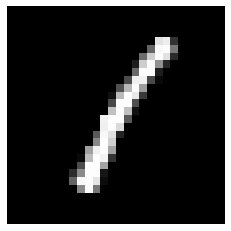

Loss: 0.00015391099447457495
Iteration: 65560, Score: 0.3577215567305683
[206, 31, 52, 33, 15, 19, 55, 78, 21, 25, 124, 186, 45, 110, 0]


Loss: 0.00014598537571995304
Iteration: 65600, Score: 0.4431307296454906
[152, 46, 90, 28, 40, 55, 52, 52, 31, 62, 87, 111, 39, 155, 0]


Test score: 0.3705419226065278
Loss: 0.000149244380246561
Iteration: 65640, Score: 0.407008998528123
[184, 70, 51, 24, 21, 49, 90, 110, 19, 20, 126, 125, 23, 88, 0]


Loss: 0.00015015666332008276
Iteration: 65680, Score: 0.3487924948111177
[224, 58, 51, 34, 41, 36, 54, 81, 27, 8, 97, 148, 27, 114, 0]


Loss: 0.00017067941267576186
Iteration: 65720, Score: 0.33983782461285594
[273, 40, 45, 21, 21, 33, 68, 87, 25, 23, 71, 128, 31, 134, 0]


Loss: 0.00015433795349145753
Iteration: 65760, Score: 0.4395145135819911
[235, 70, 29, 51, 45, 33, 72, 69, 15, 14, 117, 98, 51, 101, 0]


Loss: 0.00014632016772197766
Iteration: 65800, Score: 0.38994704450666906
[190, 29, 50, 27, 28, 67, 78, 71, 30, 47, 91, 138, 51, 103, 0]


Loss: 0.0001685570639111517
Iteration: 65840, Score: 0.4219751697629691
[161, 22, 126, 19, 20, 118, 83, 52, 17, 49, 90, 103, 43, 97, 0]


Loss: 0.00014058198694972374
Iteration: 65880, Score: 0.4060006777048111
[233, 43, 54, 20, 17, 74, 71, 60, 20, 40, 87, 133, 35, 113, 0]


Loss: 0.00015380536182721787
Iteration: 65920, Score: 0.37183768459409466
[272, 45, 32, 22, 18, 39, 58, 87, 20, 19, 107, 118, 24, 139, 0]


Loss: 0.00013611136100430854
Iteration: 65960, Score: 0.3522877942770719
[226, 95, 24, 23, 23, 39, 74, 92, 22, 41, 72, 97, 17, 155, 0]


Loss: 0.0001489327511749962
Iteration: 66000, Score: 0.4110688988268375
[194, 76, 58, 31, 21, 41, 68, 86, 26, 34, 66, 136, 23, 140, 0]


Test score: 0.36696839383244517
Loss: 0.00014439604367275379
Iteration: 66040, Score: 0.3663506971001625
[194, 98, 26, 22, 13, 31, 130, 82, 33, 25, 72, 130, 20, 124, 0]


Loss: 0.00017389193624241394
Iteration: 66080, Score: 0.37293671917915344
[206, 86, 19, 23, 14, 30, 113, 102, 18, 16, 81, 109, 55, 128, 0]


Loss: 0.00017109264864850776
Iteration: 66120, Score: 0.3592496534958482
[243, 45, 23, 38, 26, 26, 92, 99, 23, 16, 56, 118, 70, 125, 0]


Loss: 0.000164445302456948
Iteration: 66160, Score: 0.40780403161048895
[188, 60, 25, 36, 15, 31, 100, 109, 32, 12, 97, 142, 57, 96, 0]


Loss: 0.00019853411016390693
Iteration: 66200, Score: 0.3452861793935299
[197, 109, 32, 21, 26, 19, 116, 98, 25, 17, 61, 116, 48, 115, 0]


Loss: 0.00014645624402896337
Iteration: 66240, Score: 0.3759363539814949
[239, 48, 63, 35, 32, 42, 91, 80, 22, 14, 52, 114, 49, 119, 0]


Loss: 0.00014375292326066058
Iteration: 66280, Score: 0.43598407176136955
[220, 26, 84, 34, 30, 84, 53, 88, 26, 16, 72, 107, 40, 120, 0]


Loss: 0.00016524872079713338
Iteration: 66320, Score: 0.36294477830082184
[212, 48, 18, 28, 11, 33, 69, 74, 56, 26, 76, 135, 59, 155, 0]


Loss: 0.00014628788945916414
Iteration: 66360, Score: 0.43433913093805315
[211, 55, 38, 21, 17, 49, 81, 89, 29, 32, 76, 112, 44, 146, 0]


Loss: 0.00015258797797351628
Iteration: 66400, Score: 0.39581082751601937
[242, 56, 23, 26, 18, 33, 68, 98, 44, 22, 94, 122, 34, 120, 0]


Test score: 0.42421432155370703
Loss: 0.0001495152161331326
Iteration: 66440, Score: 0.3961171053349972
[220, 53, 78, 29, 25, 81, 67, 74, 22, 11, 87, 109, 48, 96, 0]


Loss: 0.0001521089455496135
Iteration: 66480, Score: 0.3967497146725655
[193, 79, 78, 16, 33, 86, 86, 82, 21, 22, 66, 95, 43, 100, 0]


Loss: 0.0001688850721818061
Iteration: 66520, Score: 0.4233801923841239
[217, 42, 66, 22, 23, 50, 53, 130, 12, 18, 92, 98, 47, 130, 0]


Loss: 0.00016835822645931028
Iteration: 66560, Score: 0.355273451462388
[205, 64, 27, 36, 43, 34, 77, 94, 44, 17, 91, 100, 22, 146, 0]


Loss: 0.00015795459300621317
Iteration: 66600, Score: 0.39536651541292667
[223, 68, 52, 17, 31, 72, 54, 87, 17, 17, 95, 133, 30, 104, 0]


Loss: 0.00017791131328861
Iteration: 66640, Score: 0.365058133661747
[221, 50, 68, 22, 23, 96, 49, 90, 12, 23, 87, 123, 25, 111, 0]


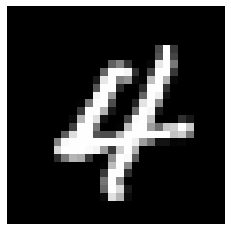

Loss: 0.0001646886940720777
Iteration: 66680, Score: 0.4724219101071358
[224, 84, 38, 24, 14, 75, 74, 77, 19, 19, 98, 107, 26, 121, 0]


Loss: 0.0001399150372159892
Iteration: 66720, Score: 0.3825707392543554
[155, 73, 57, 22, 13, 94, 60, 103, 30, 20, 105, 97, 45, 126, 0]


Loss: 0.00013772662478439134
Iteration: 66760, Score: 0.3262549130618572
[200, 88, 50, 15, 25, 55, 46, 90, 37, 25, 101, 146, 36, 86, 0]


Loss: 0.00017240078999575633
Iteration: 66800, Score: 0.3551881698006764
[199, 60, 27, 23, 23, 27, 54, 125, 26, 44, 124, 152, 22, 94, 0]


Test score: 0.42028328739106663
Loss: 0.0001637404384816934
Iteration: 66840, Score: 0.39820778220891945
[202, 68, 25, 40, 22, 33, 84, 86, 9, 25, 105, 122, 33, 146, 0]


Loss: 0.00018531887076281972
Iteration: 66880, Score: 0.4019093033075333
[175, 68, 24, 24, 19, 44, 94, 99, 18, 26, 119, 86, 43, 161, 0]


Loss: 0.00015809164460907314
Iteration: 66920, Score: 0.4359213705360888
[125, 184, 53, 18, 22, 95, 171, 56, 14, 17, 78, 57, 27, 83, 0]


Loss: 0.00014245076124701634
Iteration: 66960, Score: 0.3608176901936532
[233, 86, 24, 34, 21, 82, 87, 53, 19, 21, 101, 113, 28, 98, 0]


Loss: 0.000159276482071845
Iteration: 67000, Score: 0.4203272653371097
[225, 32, 58, 34, 18, 54, 58, 45, 30, 17, 116, 152, 46, 115, 0]


Loss: 0.00013906240611365038
Iteration: 67040, Score: 0.37406597954034815
[252, 35, 48, 28, 26, 55, 58, 60, 29, 30, 108, 99, 41, 131, 0]


Loss: 0.00014860560665864861
Iteration: 67080, Score: 0.32965593418478967
[227, 56, 33, 43, 33, 64, 61, 46, 15, 30, 102, 101, 38, 151, 0]


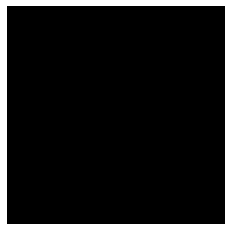

Loss: 0.00015855975082390813
Iteration: 67120, Score: 0.46345970019698146
[197, 57, 52, 15, 29, 84, 66, 80, 34, 27, 120, 99, 35, 105, 0]


Loss: 0.00016986300119317617
Iteration: 67160, Score: 0.37312928158044817
[216, 40, 33, 27, 24, 51, 92, 53, 40, 54, 79, 148, 34, 109, 0]


Loss: 0.00018260712322846302
Iteration: 67200, Score: 0.3929758635573088
[200, 47, 54, 27, 16, 56, 89, 68, 49, 37, 78, 114, 41, 124, 0]


Test score: 0.3482740850746632
Loss: 0.0001810400814700508
Iteration: 67240, Score: 0.35634619194269174
[235, 41, 47, 14, 20, 53, 67, 62, 49, 18, 111, 113, 57, 113, 0]


Loss: 0.0001543326408376219
Iteration: 67280, Score: 0.3902259394377471
[189, 39, 79, 25, 18, 100, 34, 58, 22, 58, 87, 157, 45, 89, 0]


Loss: 0.0001820702517751882
Iteration: 67320, Score: 0.389976225461811
[155, 68, 119, 24, 27, 119, 74, 71, 17, 8, 70, 141, 25, 82, 0]


Loss: 0.00016338346222725624
Iteration: 67360, Score: 0.41128788959980006
[179, 50, 94, 18, 45, 94, 61, 60, 24, 18, 94, 150, 26, 87, 0]


Loss: 0.00016407995823049877
Iteration: 67400, Score: 0.3319154252111912
[246, 61, 41, 23, 24, 30, 36, 57, 27, 18, 106, 163, 42, 126, 0]


Loss: 0.00017705172105181497
Iteration: 67440, Score: 0.3811391235440969
[199, 70, 35, 22, 23, 38, 59, 51, 33, 21, 143, 153, 26, 127, 0]


Loss: 0.00016637283416051976
Iteration: 67480, Score: 0.4305690903663635
[202, 37, 75, 13, 21, 81, 84, 48, 17, 23, 100, 169, 23, 107, 0]


Loss: 0.00018606967583457493
Iteration: 67520, Score: 0.4005239134579896
[220, 41, 84, 19, 16, 98, 94, 73, 16, 25, 59, 126, 16, 113, 0]


Loss: 0.0001578766862544747
Iteration: 67560, Score: 0.42228721565008154
[177, 116, 38, 32, 37, 43, 160, 78, 25, 9, 72, 126, 6, 81, 0]


Loss: 0.0001491940756764251
Iteration: 67600, Score: 0.38653914177417753
[245, 50, 27, 27, 20, 37, 65, 70, 40, 24, 108, 144, 16, 127, 0]


Test score: 0.35557937558740377
Loss: 0.00017810959853510467
Iteration: 67640, Score: 0.3777352527678012
[235, 56, 31, 36, 42, 55, 62, 39, 38, 18, 64, 168, 22, 134, 0]


Loss: 0.00015341085877943145
Iteration: 67680, Score: 0.38140066249668597
[219, 44, 33, 26, 26, 67, 57, 82, 35, 35, 75, 151, 19, 131, 0]


Loss: 0.00015082205859862053
Iteration: 67720, Score: 0.3954737174659967
[241, 37, 36, 15, 20, 56, 44, 98, 24, 28, 95, 168, 19, 119, 0]


Loss: 0.00015450960271392425
Iteration: 67760, Score: 0.39883175554871564
[222, 30, 51, 21, 28, 42, 49, 114, 24, 16, 75, 211, 16, 101, 0]


Loss: 0.0001575816761596342
Iteration: 67800, Score: 0.46492091628909105
[248, 33, 46, 17, 23, 63, 55, 92, 14, 21, 56, 194, 18, 120, 0]


Loss: 0.00015196356677665187
Iteration: 67840, Score: 0.3533817957937717
[201, 49, 77, 25, 13, 94, 82, 88, 21, 13, 40, 180, 16, 101, 0]


Loss: 0.0001539833282092088
Iteration: 67880, Score: 0.39468618617951867
[256, 38, 22, 26, 26, 41, 74, 94, 20, 23, 53, 203, 31, 93, 0]


Loss: 0.00013928792244911217
Iteration: 67920, Score: 0.3929345101565122
[271, 42, 30, 38, 19, 23, 68, 75, 23, 30, 53, 210, 16, 102, 0]


Loss: 0.0001473750505723317
Iteration: 67960, Score: 0.40291121742129327
[235, 54, 80, 27, 22, 53, 66, 59, 25, 22, 55, 175, 21, 106, 0]


Loss: 0.00014048830605521215
Iteration: 68000, Score: 0.3625888592600822
[219, 37, 27, 26, 20, 30, 78, 88, 34, 22, 62, 202, 25, 130, 0]


Test score: 0.34849213883280755
Loss: 0.0001457045929929756
Iteration: 68040, Score: 0.35332837313413623
[217, 62, 53, 27, 15, 53, 77, 47, 16, 32, 64, 219, 26, 92, 0]


Loss: 0.00015445669570268475
Iteration: 68080, Score: 0.35570050463080405
[238, 49, 31, 24, 26, 34, 73, 73, 20, 28, 68, 208, 12, 116, 0]


Loss: 0.0001484236879022115
Iteration: 68120, Score: 0.4274431341886521
[202, 58, 75, 33, 20, 127, 72, 61, 23, 11, 53, 146, 21, 98, 0]


Loss: 0.0001268217765913794
Iteration: 68160, Score: 0.45144478808343413
[204, 31, 56, 43, 15, 81, 58, 73, 22, 34, 82, 145, 36, 120, 0]


Loss: 0.0001584091773502199
Iteration: 68200, Score: 0.42351560527831317
[183, 24, 32, 54, 53, 49, 60, 81, 20, 35, 61, 200, 54, 94, 0]


Loss: 0.00016190244301193284
Iteration: 68240, Score: 0.4377377546429634
[213, 53, 26, 19, 31, 55, 55, 89, 31, 20, 58, 236, 26, 88, 0]


Loss: 0.00016734786192716458
Iteration: 68280, Score: 0.4589575385451317
[245, 46, 21, 21, 48, 38, 74, 65, 25, 27, 83, 162, 28, 117, 0]


Loss: 0.00014847972346152303
Iteration: 68320, Score: 0.3827263124436141
[210, 41, 101, 17, 24, 92, 103, 59, 33, 16, 42, 141, 22, 99, 0]


Loss: 0.00015042952327895672
Iteration: 68360, Score: 0.4036379904858768
[233, 56, 45, 37, 29, 44, 95, 69, 17, 17, 39, 162, 22, 135, 0]


Loss: 0.00012889497950222456
Iteration: 68400, Score: 0.429724519610405
[228, 60, 35, 16, 24, 58, 72, 84, 38, 22, 78, 141, 39, 105, 0]


Test score: 0.35329728110879655
Loss: 0.000135314013961774
Iteration: 68440, Score: 0.3861029896140099
[227, 37, 66, 28, 13, 69, 56, 79, 20, 18, 72, 152, 29, 134, 0]


Loss: 0.00014258459578215342
Iteration: 68480, Score: 0.42211467221379273
[242, 33, 64, 43, 23, 60, 73, 70, 31, 27, 61, 147, 12, 114, 0]


Loss: 0.00014820468871918846
Iteration: 68520, Score: 0.46807206553220765
[198, 80, 17, 42, 23, 43, 89, 59, 26, 38, 93, 140, 18, 134, 0]


Loss: 0.00015787136386839174
Iteration: 68560, Score: 0.437897375151515
[190, 73, 11, 58, 21, 50, 78, 67, 46, 11, 79, 164, 21, 131, 0]


Loss: 0.00017536659203141916
Iteration: 68600, Score: 0.37249609021842484
[236, 70, 26, 13, 15, 43, 69, 86, 41, 36, 74, 108, 19, 164, 0]


Loss: 0.00016500422143495496
Iteration: 68640, Score: 0.40709240134060387
[237, 34, 53, 17, 17, 42, 67, 53, 52, 35, 69, 126, 33, 165, 0]


Loss: 0.00017392254619258478
Iteration: 68680, Score: 0.3661472519040107
[248, 91, 36, 12, 16, 55, 112, 37, 30, 22, 68, 127, 24, 122, 0]


Loss: 0.0001480544109080097
Iteration: 68720, Score: 0.405403751026839
[190, 63, 29, 17, 40, 54, 93, 53, 27, 14, 99, 187, 48, 86, 0]


Loss: 0.00014386248953969583
Iteration: 68760, Score: 0.39279621720314034
[237, 39, 34, 28, 49, 41, 52, 71, 32, 13, 124, 118, 38, 124, 0]


Loss: 0.00016217832132866172
Iteration: 68800, Score: 0.4207432341277599
[214, 79, 54, 23, 32, 81, 91, 55, 44, 30, 48, 116, 19, 114, 0]


Test score: 0.3747398088276387
Loss: 0.0001490573032986966
Iteration: 68840, Score: 0.424223467051983
[211, 63, 32, 49, 14, 42, 69, 49, 25, 35, 89, 184, 21, 117, 0]


Loss: 0.00016970358739412393
Iteration: 68880, Score: 0.3627359574437142
[214, 54, 60, 29, 25, 53, 75, 54, 31, 17, 92, 167, 22, 107, 0]


Loss: 0.00016298584215687406
Iteration: 68920, Score: 0.365988597586751
[190, 40, 75, 18, 41, 88, 56, 58, 33, 21, 116, 137, 26, 101, 0]


Loss: 0.0001401817992997579
Iteration: 68960, Score: 0.36979538335651163
[201, 41, 65, 20, 40, 82, 57, 81, 38, 21, 87, 129, 36, 102, 0]


Loss: 0.0001413170985427216
Iteration: 69000, Score: 0.41271364855766307
[184, 31, 23, 40, 30, 37, 84, 78, 22, 20, 104, 137, 79, 131, 0]


Loss: 0.0001488575175411005
Iteration: 69040, Score: 0.394880321457982
[219, 21, 44, 53, 43, 41, 59, 64, 17, 19, 82, 134, 48, 156, 0]


Loss: 0.00013593411274308864
Iteration: 69080, Score: 0.4121323823854327
[232, 39, 41, 56, 31, 67, 76, 48, 18, 12, 67, 103, 65, 145, 0]


Loss: 0.00014766466675670672
Iteration: 69120, Score: 0.37623845580965287
[175, 117, 47, 18, 18, 32, 117, 72, 13, 9, 69, 160, 56, 97, 0]


Loss: 0.00014143090197382482
Iteration: 69160, Score: 0.41784104282699985
[273, 48, 30, 30, 14, 56, 95, 62, 22, 21, 65, 142, 42, 100, 0]


Loss: 0.0001702824913609258
Iteration: 69200, Score: 0.3842530258893967
[202, 64, 41, 53, 18, 36, 104, 84, 28, 11, 60, 115, 72, 112, 0]


Test score: 0.34235432190448056
Loss: 0.00014997177513619087
Iteration: 69240, Score: 0.4561671173870562
[193, 45, 43, 39, 20, 59, 115, 72, 44, 24, 50, 106, 70, 120, 0]


Loss: 0.00013667762573100649
Iteration: 69280, Score: 0.4445834560394287
[176, 68, 30, 14, 39, 38, 125, 111, 32, 35, 56, 103, 44, 129, 0]


Loss: 0.00015854102222532013
Iteration: 69320, Score: 0.36563095679879176
[200, 38, 22, 20, 36, 47, 69, 107, 17, 33, 79, 138, 71, 123, 0]


Loss: 0.00015175590513998702
Iteration: 69360, Score: 0.44031404061615476
[210, 49, 28, 40, 27, 43, 61, 117, 14, 20, 35, 217, 54, 85, 0]


Loss: 0.00014361981687198184
Iteration: 69400, Score: 0.4009718417227268
[236, 37, 32, 34, 33, 83, 87, 65, 21, 26, 54, 112, 32, 148, 0]


Loss: 0.00015001792650746863
Iteration: 69440, Score: 0.3817975651770829
[140, 74, 70, 49, 37, 104, 76, 65, 20, 25, 54, 151, 23, 112, 0]


Loss: 0.00014968221884209104
Iteration: 69480, Score: 0.38463573426008224
[202, 73, 27, 43, 22, 36, 88, 90, 21, 17, 67, 170, 12, 132, 0]


Loss: 0.00015333921275684
Iteration: 69520, Score: 0.41452888268232346
[232, 38, 22, 50, 33, 53, 71, 69, 27, 25, 80, 147, 20, 133, 0]


Loss: 0.00015125046498911898
Iteration: 69560, Score: 0.4259650685191153
[199, 40, 51, 50, 45, 101, 42, 51, 22, 31, 79, 148, 30, 111, 0]


Loss: 0.00017639098204018158
Iteration: 69600, Score: 0.3049158723521978
[211, 51, 40, 25, 52, 69, 49, 89, 19, 22, 42, 172, 55, 104, 0]


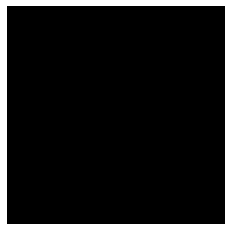

Test score: 0.37831077761080806
Loss: 0.00017120231430792023
Iteration: 69640, Score: 0.4005571439117193
[187, 28, 80, 23, 24, 137, 60, 100, 29, 19, 24, 170, 18, 101, 0]


Loss: 0.00016451973695491508
Iteration: 69680, Score: 0.427696992725134
[245, 38, 18, 21, 42, 60, 53, 96, 17, 18, 71, 191, 21, 109, 0]


Loss: 0.00014395572256447004
Iteration: 69720, Score: 0.3449565456863492
[163, 125, 72, 13, 21, 85, 142, 41, 12, 31, 90, 108, 23, 74, 0]


Loss: 0.0001526090820929271
Iteration: 69760, Score: 0.3796380047798157
[201, 54, 41, 23, 28, 50, 87, 79, 24, 14, 119, 157, 12, 111, 0]


Loss: 0.00016751968811843615
Iteration: 69800, Score: 0.35866586972773074
[201, 62, 31, 50, 30, 66, 101, 64, 14, 18, 70, 160, 15, 118, 0]


Loss: 0.0001490921411390859
Iteration: 69840, Score: 0.4258102856129408
[236, 43, 48, 33, 27, 70, 56, 73, 21, 34, 109, 149, 12, 89, 0]


Loss: 0.00013888921783665334
Iteration: 69880, Score: 0.37401396443694834
[170, 88, 99, 24, 42, 133, 92, 45, 17, 12, 80, 85, 23, 90, 0]


Loss: 0.00016039792003596
Iteration: 69920, Score: 0.4016222465634346
[198, 60, 98, 50, 46, 56, 82, 72, 29, 26, 73, 92, 16, 102, 0]


Loss: 0.0001625927615943242
Iteration: 69960, Score: 0.41573137858510023
[204, 47, 64, 19, 21, 77, 105, 57, 34, 22, 90, 132, 18, 110, 0]


Loss: 0.00016365611687777353
Iteration: 70000, Score: 0.4013568930327893
[148, 109, 77, 26, 24, 100, 138, 51, 21, 56, 39, 123, 12, 76, 0]


Test score: 0.39579656462743884
Loss: 0.00016203808620708488
Iteration: 70040, Score: 0.40183975326269883
[196, 47, 51, 40, 38, 85, 81, 49, 25, 21, 93, 134, 19, 121, 0]


Loss: 0.00015590144607280942
Iteration: 70080, Score: 0.4605771973058581
[191, 57, 61, 39, 22, 46, 83, 46, 31, 40, 110, 135, 20, 119, 0]


Loss: 0.0001472542021466775
Iteration: 70120, Score: 0.35822381219267835
[195, 38, 48, 35, 21, 36, 50, 77, 67, 29, 85, 131, 33, 155, 0]


Loss: 0.0001423503859918955
Iteration: 70160, Score: 0.3706823087036609
[250, 50, 40, 20, 25, 54, 46, 89, 21, 38, 95, 113, 57, 102, 0]


Loss: 0.00013975652565091813
Iteration: 70200, Score: 0.4081038458645344
[240, 32, 42, 50, 46, 39, 70, 69, 24, 14, 68, 161, 36, 109, 0]


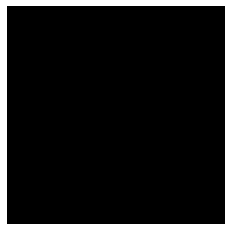

Loss: 0.00013781715502943827
Iteration: 70240, Score: 0.42586628313362596
[201, 66, 67, 27, 22, 59, 76, 85, 34, 13, 72, 130, 56, 92, 0]


Loss: 0.00018646799721621575
Iteration: 70280, Score: 0.4078475035429001
[150, 40, 67, 71, 46, 55, 83, 69, 26, 26, 102, 153, 18, 94, 0]


Loss: 0.00016917162369867758
Iteration: 70320, Score: 0.4078282802700997
[281, 37, 18, 20, 38, 39, 68, 75, 22, 30, 93, 109, 33, 137, 0]


Loss: 0.00019534611615326796
Iteration: 70360, Score: 0.43299071231484404
[203, 23, 126, 44, 44, 128, 75, 43, 13, 9, 96, 67, 33, 96, 0]


Loss: 0.00015291908062729022
Iteration: 70400, Score: 0.39369301399588574
[214, 28, 92, 33, 28, 107, 54, 76, 25, 23, 51, 98, 91, 80, 0]


Test score: 0.39095115955173976
Loss: 0.00015147747377419583
Iteration: 70440, Score: 0.41571087180078026
[206, 81, 30, 33, 41, 59, 111, 51, 49, 31, 36, 124, 60, 88, 0]


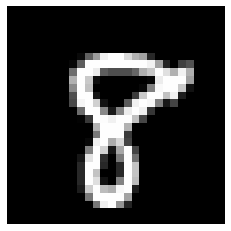

Loss: 0.00015852434240124405
Iteration: 70480, Score: 0.4054591554403305
[240, 22, 56, 26, 26, 78, 54, 82, 24, 29, 74, 97, 94, 98, 0]


Loss: 0.0001472688580400452
Iteration: 70520, Score: 0.4066317544579506
[226, 50, 60, 18, 15, 84, 71, 62, 23, 20, 53, 160, 84, 74, 0]


Loss: 0.00014952160378452824
Iteration: 70560, Score: 0.4274862295091152
[229, 55, 49, 17, 14, 61, 80, 89, 30, 21, 42, 141, 69, 103, 0]


Loss: 0.00015939042250297998
Iteration: 70600, Score: 0.34391375569999216
[226, 40, 45, 12, 33, 54, 105, 55, 25, 29, 42, 121, 54, 159, 0]


Loss: 0.0001585536124332335
Iteration: 70640, Score: 0.376488464564085
[179, 58, 43, 30, 29, 50, 95, 116, 22, 24, 86, 125, 35, 108, 0]


Loss: 0.0001378897052548857
Iteration: 70680, Score: 0.3830542409420013
[216, 39, 33, 57, 60, 40, 57, 74, 24, 21, 76, 134, 52, 117, 0]


Loss: 0.00015934499288091232
Iteration: 70720, Score: 0.4068521080911158
[136, 38, 139, 40, 11, 146, 61, 97, 12, 13, 86, 108, 42, 71, 0]


Loss: 0.00014072079774693177
Iteration: 70760, Score: 0.4112479255497455
[170, 41, 21, 108, 58, 32, 52, 94, 40, 26, 52, 131, 53, 122, 0]


Loss: 0.00012943978510524884
Iteration: 70800, Score: 0.381086063683033
[128, 28, 93, 54, 50, 97, 80, 75, 29, 22, 42, 179, 43, 80, 0]


Test score: 0.3659743966460228
Loss: 0.00014969830358164908
Iteration: 70840, Score: 0.38944894418120385
[170, 38, 73, 28, 37, 71, 86, 90, 21, 17, 34, 193, 32, 110, 0]


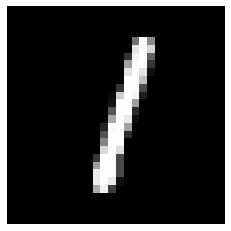

Loss: 0.00014384537116433644
Iteration: 70880, Score: 0.3540413901810534
[252, 41, 61, 26, 35, 67, 76, 76, 14, 13, 46, 163, 25, 105, 0]


Loss: 0.0001449695206581935
Iteration: 70920, Score: 0.4484253283366562
[218, 48, 39, 54, 47, 37, 70, 93, 12, 19, 37, 168, 54, 104, 0]


Loss: 0.0001513289791184914
Iteration: 70960, Score: 0.4161838375627995
[201, 83, 31, 26, 51, 38, 75, 109, 14, 23, 75, 142, 21, 111, 0]


Loss: 0.00014587574225591337
Iteration: 71000, Score: 0.43415820266678934
[188, 39, 69, 17, 39, 84, 81, 80, 21, 38, 66, 138, 32, 108, 0]


Loss: 0.00015464575891282881
Iteration: 71040, Score: 0.38440490035712715
[200, 58, 53, 32, 19, 46, 70, 76, 20, 23, 93, 178, 28, 104, 0]


Loss: 0.00014824480119842164
Iteration: 71080, Score: 0.3943168089985847
[217, 48, 47, 37, 22, 49, 78, 72, 23, 17, 111, 132, 24, 123, 0]


Loss: 0.0001499539661408701
Iteration: 71120, Score: 0.3982492858767509
[167, 73, 74, 18, 23, 111, 62, 81, 30, 32, 76, 113, 23, 117, 0]


Loss: 0.00012729178822717998
Iteration: 71160, Score: 0.41708761787414544
[183, 51, 27, 21, 19, 45, 43, 110, 52, 33, 103, 141, 26, 146, 0]


Loss: 0.0001511645738063243
Iteration: 71200, Score: 0.3865879392400385
[202, 46, 21, 37, 31, 28, 59, 91, 31, 12, 157, 133, 48, 104, 0]


Test score: 0.34440125618129963
Loss: 0.0001612149634029181
Iteration: 71240, Score: 0.44867817359464246
[220, 39, 78, 39, 19, 81, 42, 61, 32, 11, 100, 157, 18, 103, 0]


Loss: 0.00014339571843348167
Iteration: 71280, Score: 0.4281524250805379
[189, 45, 61, 16, 20, 74, 70, 82, 17, 23, 111, 129, 32, 131, 0]


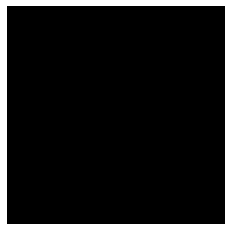

Loss: 0.000156106113025101
Iteration: 71320, Score: 0.43821341028809535
[164, 85, 43, 23, 21, 37, 122, 58, 37, 31, 128, 102, 11, 138, 0]


Loss: 0.0001628452185083508
Iteration: 71360, Score: 0.3957220944091677
[171, 62, 56, 29, 26, 45, 125, 89, 14, 31, 89, 113, 35, 115, 0]


Loss: 0.00015968653152581487
Iteration: 71400, Score: 0.38152958611701615
[227, 59, 26, 24, 13, 43, 100, 78, 20, 20, 94, 146, 27, 123, 0]


Loss: 0.00014607960650618192
Iteration: 71440, Score: 0.36875869295001046
[153, 96, 43, 22, 17, 47, 114, 94, 28, 20, 96, 114, 45, 111, 0]


Loss: 0.0001519958463808545
Iteration: 71480, Score: 0.3913901523053646
[165, 102, 56, 16, 18, 62, 109, 85, 20, 23, 105, 131, 19, 89, 0]


Loss: 0.00015809791310958268
Iteration: 71520, Score: 0.4310288367569447
[149, 72, 103, 22, 18, 112, 118, 57, 21, 19, 97, 115, 29, 68, 0]


Loss: 0.0001383619314975489
Iteration: 71560, Score: 0.38197059760242696
[182, 21, 102, 29, 23, 124, 61, 69, 22, 28, 69, 142, 33, 95, 0]


Loss: 0.00015134584937221015
Iteration: 71600, Score: 0.43330605995655064
[196, 40, 52, 30, 30, 91, 48, 60, 33, 20, 85, 152, 39, 124, 0]


Test score: 0.36326892254501575
Loss: 0.00014513245952981607
Iteration: 71640, Score: 0.4491838859915733
[187, 50, 67, 16, 20, 61, 96, 61, 20, 18, 113, 142, 45, 104, 0]


Loss: 0.00014241964677862184
Iteration: 71680, Score: 0.4523059955388306
[227, 46, 32, 24, 20, 40, 57, 74, 38, 30, 141, 111, 46, 114, 0]


Loss: 0.00013680391400227812
Iteration: 71720, Score: 0.43151797878742215
[239, 72, 48, 17, 21, 65, 77, 75, 34, 19, 88, 100, 48, 97, 0]


Loss: 0.00013566465022644706
Iteration: 71760, Score: 0.3871429232805968
[262, 64, 36, 22, 21, 54, 62, 53, 42, 15, 105, 99, 70, 95, 0]


Loss: 0.00014750634307866072
Iteration: 71800, Score: 0.45197546698153024
[226, 40, 59, 40, 24, 55, 52, 62, 29, 16, 119, 104, 53, 121, 0]


Loss: 0.00014473406173244412
Iteration: 71840, Score: 0.450276077926159
[265, 56, 36, 24, 19, 54, 54, 75, 16, 19, 97, 106, 42, 137, 0]


Loss: 0.00014596917686892432
Iteration: 71880, Score: 0.39202969047427183
[219, 44, 100, 25, 18, 101, 59, 73, 12, 18, 88, 98, 30, 115, 0]


Loss: 0.00014179739074205854
Iteration: 71920, Score: 0.476570254355669
[237, 50, 54, 52, 43, 53, 47, 58, 15, 26, 114, 97, 29, 125, 0]


Loss: 0.00014107032692359912
Iteration: 71960, Score: 0.4344785902649163
[203, 64, 43, 29, 21, 48, 69, 59, 27, 27, 103, 140, 41, 126, 0]


Loss: 0.00014676077461609141
Iteration: 72000, Score: 0.44249964910745615
[242, 60, 33, 19, 18, 41, 66, 72, 26, 20, 76, 173, 35, 119, 0]


Test score: 0.36661531493812805
Loss: 0.00014626942128565486
Iteration: 72040, Score: 0.420559486299753
[241, 64, 35, 31, 34, 43, 53, 85, 17, 29, 54, 166, 42, 106, 0]


Loss: 0.00014685225727715707
Iteration: 72080, Score: 0.3879753317683936
[241, 49, 33, 27, 23, 24, 68, 67, 23, 44, 94, 131, 35, 141, 0]


Loss: 0.00014427084976965197
Iteration: 72120, Score: 0.3755756487585604
[222, 24, 32, 31, 31, 43, 61, 78, 21, 20, 128, 174, 19, 116, 0]


Loss: 0.0001447876366871179
Iteration: 72160, Score: 0.3964318730384111
[238, 37, 22, 28, 39, 44, 51, 92, 29, 14, 85, 181, 30, 110, 0]


Loss: 0.00015860384139508522
Iteration: 72200, Score: 0.44774504414200766
[210, 37, 15, 32, 33, 45, 58, 71, 27, 19, 100, 166, 30, 157, 0]


Loss: 0.00016222204206458286
Iteration: 72240, Score: 0.35336935018002985
[198, 43, 30, 32, 27, 45, 105, 59, 41, 22, 77, 148, 33, 140, 0]


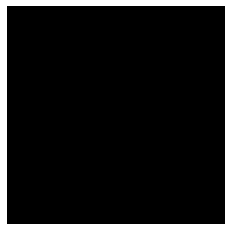

Loss: 0.00015600256024816888
Iteration: 72280, Score: 0.3683614629656076
[196, 101, 24, 22, 32, 34, 102, 57, 17, 14, 103, 152, 15, 131, 0]


Loss: 0.00016750463689873526
Iteration: 72320, Score: 0.34946406550705433
[220, 34, 24, 42, 34, 45, 44, 76, 27, 22, 90, 190, 21, 131, 0]


Loss: 0.00015436124887465794
Iteration: 72360, Score: 0.4033682491481304
[252, 65, 33, 22, 34, 33, 71, 76, 17, 25, 76, 134, 32, 130, 0]


Loss: 0.00015010590689102827
Iteration: 72400, Score: 0.41990010124444954
[225, 33, 74, 45, 59, 73, 59, 60, 26, 21, 58, 109, 40, 118, 0]


Test score: 0.4492659808499737
Loss: 0.0001407783844785061
Iteration: 72440, Score: 0.48431362562626595
[164, 113, 82, 23, 45, 83, 146, 41, 21, 14, 40, 74, 31, 123, 0]


Loss: 0.00016035146538468008
Iteration: 72480, Score: 0.43943868294358257
[149, 69, 106, 17, 54, 79, 85, 58, 35, 20, 67, 126, 28, 107, 0]


Loss: 0.00017720831736714972
Iteration: 72520, Score: 0.41963046658039105
[195, 73, 79, 28, 55, 58, 104, 54, 30, 18, 52, 107, 24, 123, 0]


Loss: 0.00017005130373947582
Iteration: 72560, Score: 0.4201014403998852
[238, 74, 32, 44, 56, 24, 101, 51, 19, 15, 50, 152, 26, 118, 0]


Loss: 0.0001597437555031644
Iteration: 72600, Score: 0.41530390834808345
[232, 73, 38, 10, 28, 26, 106, 44, 70, 20, 67, 111, 36, 139, 0]


Loss: 0.0001596500045897889
Iteration: 72640, Score: 0.3860198505073785
[222, 84, 37, 20, 24, 36, 98, 63, 64, 22, 37, 145, 29, 119, 0]


Loss: 0.00016524482966694535
Iteration: 72680, Score: 0.3903441937565803
[228, 61, 39, 19, 33, 27, 84, 101, 29, 19, 38, 178, 23, 121, 0]


Loss: 0.00014671115601477708
Iteration: 72720, Score: 0.43037875764071937
[224, 44, 31, 17, 20, 73, 54, 94, 22, 21, 105, 140, 22, 133, 0]


Loss: 0.00018376658256612504
Iteration: 72760, Score: 0.3916128724813461
[204, 51, 48, 17, 21, 87, 66, 84, 26, 7, 102, 109, 37, 141, 0]


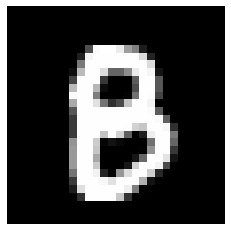

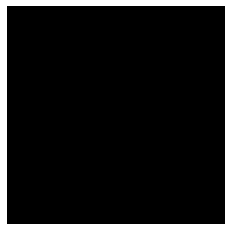

Loss: 0.00017063463556455643
Iteration: 72800, Score: 0.396459203183651
[185, 44, 76, 21, 19, 101, 60, 92, 29, 21, 59, 104, 42, 147, 0]


Test score: 0.39827670493721967
Loss: 0.00016685718682375836
Iteration: 72840, Score: 0.3570338635444642
[236, 50, 43, 25, 22, 59, 78, 52, 23, 18, 51, 161, 20, 162, 0]


Loss: 0.00017685623655125675
Iteration: 72880, Score: 0.42119709150493134
[247, 43, 45, 24, 16, 57, 68, 66, 19, 24, 69, 133, 39, 150, 0]


Loss: 0.00017200586407353354
Iteration: 72920, Score: 0.399137944817543
[206, 86, 48, 13, 21, 66, 110, 55, 14, 18, 69, 134, 33, 127, 0]


Loss: 0.00015958753740794862
Iteration: 72960, Score: 0.4220981217399239
[186, 50, 42, 26, 23, 60, 110, 79, 25, 14, 83, 128, 58, 116, 0]


Loss: 0.00014300381503213808
Iteration: 73000, Score: 0.42630255108326665
[255, 37, 35, 10, 18, 68, 68, 79, 14, 11, 83, 127, 66, 129, 0]


Loss: 0.0001466007464681365
Iteration: 73040, Score: 0.3785132174938917
[237, 48, 27, 32, 33, 53, 66, 67, 20, 15, 95, 126, 42, 139, 0]


Loss: 0.0001322278392807669
Iteration: 73080, Score: 0.4124248666465283
[179, 67, 30, 19, 31, 78, 100, 91, 17, 22, 58, 147, 60, 101, 0]


Loss: 0.00014876842853920737
Iteration: 73120, Score: 0.3750727634578944
[227, 41, 29, 17, 50, 60, 67, 63, 26, 28, 100, 129, 46, 117, 0]


Loss: 0.0001346428484652192
Iteration: 73160, Score: 0.3811731803715229
[213, 96, 40, 12, 16, 38, 110, 71, 23, 14, 84, 98, 84, 101, 0]


Loss: 0.00018712387872749393
Iteration: 73200, Score: 0.3456974865645171
[195, 55, 38, 39, 36, 59, 67, 89, 24, 19, 108, 131, 47, 93, 0]


Test score: 0.34113694697245955
Loss: 0.00019275880867463798
Iteration: 73240, Score: 0.37698304831981666
[164, 61, 99, 21, 22, 111, 71, 79, 31, 17, 58, 152, 37, 77, 0]


Loss: 0.00017017913180090744
Iteration: 73280, Score: 0.4413379575461149
[211, 60, 41, 46, 35, 76, 80, 80, 33, 14, 52, 120, 33, 119, 0]


Loss: 0.00016243940272921113
Iteration: 73320, Score: 0.39312871894240375
[165, 152, 54, 22, 8, 65, 147, 59, 20, 12, 75, 117, 31, 73, 0]


Loss: 0.00014246890741194282
Iteration: 73360, Score: 0.3698230581730604
[192, 77, 19, 30, 17, 57, 94, 60, 27, 27, 100, 176, 29, 95, 0]


Loss: 0.00015319881792218458
Iteration: 73400, Score: 0.4117690313309431
[235, 55, 22, 41, 20, 50, 85, 93, 25, 16, 73, 147, 24, 114, 0]


Loss: 0.00012972307357135175
Iteration: 73440, Score: 0.446196992188692
[230, 63, 52, 42, 31, 72, 57, 75, 17, 23, 87, 111, 28, 112, 0]


Loss: 0.0001354315922060539
Iteration: 73480, Score: 0.4474312345981598
[217, 52, 54, 27, 16, 82, 88, 90, 21, 13, 92, 113, 22, 113, 0]


Loss: 0.00013544699622939052
Iteration: 73520, Score: 0.3765395451188087
[198, 63, 20, 15, 34, 41, 94, 75, 22, 38, 38, 218, 21, 123, 0]


Loss: 0.0001458195900085113
Iteration: 73560, Score: 0.4198076498657466
[182, 67, 36, 16, 22, 54, 87, 71, 44, 18, 80, 194, 26, 103, 0]


Loss: 0.00014036656887051897
Iteration: 73600, Score: 0.4349590791761876
[196, 67, 37, 20, 21, 93, 83, 86, 31, 21, 67, 167, 26, 85, 0]


Test score: 0.41575723493099215
Loss: 0.00015938750496874275
Iteration: 73640, Score: 0.3673225774765014
[219, 67, 85, 13, 9, 104, 67, 90, 24, 17, 53, 120, 50, 82, 0]


Loss: 0.0001579747691843542
Iteration: 73680, Score: 0.4196342649459838
[211, 90, 70, 13, 6, 85, 94, 80, 18, 24, 36, 151, 32, 90, 0]


Loss: 0.0001463698977875935
Iteration: 73720, Score: 0.4440922799408435
[230, 66, 44, 18, 21, 47, 79, 87, 24, 18, 49, 159, 42, 116, 0]


Loss: 0.00012520461146068305
Iteration: 73760, Score: 0.41046917860209947
[202, 79, 20, 43, 41, 72, 94, 76, 15, 27, 63, 158, 28, 82, 0]


Loss: 0.0001336008067781198
Iteration: 73800, Score: 0.36350048257410517
[211, 57, 17, 50, 36, 57, 61, 88, 39, 13, 72, 158, 30, 111, 0]


Loss: 0.00014396886591375917
Iteration: 73840, Score: 0.4347942994832993
[246, 49, 25, 45, 18, 27, 65, 64, 27, 13, 83, 171, 34, 133, 0]


Loss: 0.0001464194483301237
Iteration: 73880, Score: 0.43680592873692514
[196, 79, 52, 39, 11, 59, 95, 46, 44, 30, 54, 167, 19, 109, 0]


Loss: 0.000155952048540684
Iteration: 73920, Score: 0.39640436596423384
[149, 100, 35, 33, 36, 39, 114, 95, 51, 17, 71, 149, 12, 99, 0]


Loss: 0.00014829764505552587
Iteration: 73960, Score: 0.42611103919893506
[198, 66, 55, 31, 52, 94, 72, 68, 16, 18, 50, 143, 23, 114, 0]


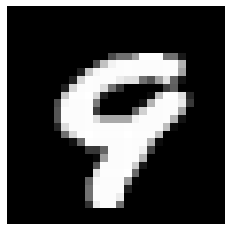

Loss: 0.00014830006829374897
Iteration: 74000, Score: 0.4384886557757854
[238, 27, 29, 31, 29, 39, 94, 81, 12, 11, 60, 172, 13, 164, 0]


Test score: 0.3670578906193841
Loss: 0.00014630907964765925
Iteration: 74040, Score: 0.3503426626473666
[190, 37, 106, 43, 28, 80, 58, 75, 27, 48, 47, 111, 14, 136, 0]


Loss: 0.00014721749283060515
Iteration: 74080, Score: 0.41115921002626415
[208, 91, 33, 24, 39, 59, 110, 84, 37, 26, 68, 80, 16, 125, 0]


Loss: 0.00013295561101441404
Iteration: 74120, Score: 0.41175670866668224
[179, 63, 36, 30, 29, 48, 110, 69, 17, 36, 122, 116, 28, 117, 0]


Loss: 0.0001506554068008397
Iteration: 74160, Score: 0.40560051736235614
[202, 39, 27, 20, 34, 28, 61, 83, 11, 20, 147, 138, 47, 143, 0]


Loss: 0.00014634860480103578
Iteration: 74200, Score: 0.42508759671449675
[185, 37, 121, 21, 15, 123, 63, 58, 15, 27, 85, 105, 6, 139, 0]


Loss: 0.00013086663771831898
Iteration: 74240, Score: 0.4006523915082216
[247, 72, 25, 20, 19, 38, 77, 81, 26, 26, 90, 89, 32, 158, 0]


Loss: 0.00014017183794281287
Iteration: 74280, Score: 0.3956412732303144
[218, 64, 22, 21, 16, 60, 81, 94, 12, 14, 105, 123, 43, 127, 0]


Loss: 0.00014923138796634294
Iteration: 74320, Score: 0.4066349593549967
[211, 72, 21, 17, 15, 33, 114, 80, 15, 25, 108, 124, 33, 132, 0]


Loss: 0.00015714310942615878
Iteration: 74360, Score: 0.3776225498020649
[187, 46, 33, 43, 35, 39, 77, 109, 15, 38, 70, 129, 39, 140, 0]


Loss: 0.00016560541485795445
Iteration: 74400, Score: 0.458115830719471
[250, 24, 19, 25, 26, 61, 62, 81, 21, 25, 117, 102, 47, 140, 0]


Test score: 0.38283580042235554
Loss: 0.00014860537588078912
Iteration: 74440, Score: 0.39168982568383204
[203, 85, 12, 14, 14, 41, 141, 102, 31, 45, 68, 97, 27, 120, 0]


Loss: 0.00016982854116277758
Iteration: 74480, Score: 0.39191814836859706
[193, 50, 25, 18, 14, 76, 95, 95, 14, 19, 97, 133, 37, 134, 0]


Loss: 0.00018583647146138896
Iteration: 74520, Score: 0.37212588871829216
[213, 38, 58, 23, 13, 83, 51, 114, 19, 11, 95, 128, 57, 97, 0]


Loss: 0.00013436961327024105
Iteration: 74560, Score: 0.42796942591667175
[199, 59, 71, 22, 12, 85, 91, 87, 35, 24, 58, 94, 26, 137, 0]


Loss: 0.00017978262033971042
Iteration: 74600, Score: 0.36975043082609776
[173, 70, 41, 15, 15, 63, 106, 126, 18, 17, 59, 167, 30, 100, 0]


Loss: 0.00013279797033202635
Iteration: 74640, Score: 0.4248325119614601
[218, 129, 62, 17, 20, 69, 103, 80, 22, 24, 23, 98, 18, 117, 0]


Loss: 0.00014404882036899303
Iteration: 74680, Score: 0.4124111371934413
[239, 56, 44, 18, 40, 65, 43, 84, 24, 23, 95, 132, 19, 118, 0]


Loss: 0.0001550830949583413
Iteration: 74720, Score: 0.41942404469847683
[161, 80, 78, 14, 53, 97, 74, 72, 21, 47, 67, 108, 27, 101, 0]


Loss: 0.00014202209706290608
Iteration: 74760, Score: 0.41725423683226126
[214, 40, 68, 20, 31, 96, 41, 126, 29, 14, 70, 131, 20, 100, 0]


Loss: 0.00014088440296958142
Iteration: 74800, Score: 0.42220506229996674
[233, 88, 54, 19, 19, 98, 55, 76, 18, 15, 83, 108, 28, 106, 0]


Test score: 0.34291999560594555
Loss: 0.00017213135427915295
Iteration: 74840, Score: 0.4253909679278731
[181, 112, 56, 40, 22, 32, 110, 78, 29, 10, 77, 104, 20, 129, 0]


Loss: 0.00014646541714553486
Iteration: 74880, Score: 0.42623460638523103
[234, 40, 46, 17, 23, 37, 48, 72, 10, 23, 113, 185, 20, 132, 0]


Loss: 0.0001305617850001866
Iteration: 74920, Score: 0.42313813200593
[225, 84, 20, 23, 50, 29, 86, 92, 9, 26, 49, 193, 23, 91, 0]


Loss: 0.00015383206489547592
Iteration: 74960, Score: 0.41971934187412263
[237, 64, 29, 24, 30, 63, 64, 48, 32, 20, 138, 129, 30, 92, 0]


Loss: 0.0001466323431800672
Iteration: 75000, Score: 0.3645697021856903
[252, 50, 55, 19, 38, 52, 54, 69, 22, 15, 128, 108, 14, 124, 0]


Loss: 0.00013806708638481195
Iteration: 75040, Score: 0.40488644409853436
[201, 61, 40, 30, 53, 56, 69, 61, 33, 10, 112, 144, 19, 111, 0]


Loss: 0.00017354805714395118
Iteration: 75080, Score: 0.3629840530902146
[223, 59, 88, 11, 33, 93, 52, 86, 20, 16, 88, 108, 23, 100, 0]


Loss: 0.00019332762720817952
Iteration: 75120, Score: 0.370073087155819
[150, 107, 102, 28, 52, 119, 105, 58, 9, 15, 55, 95, 16, 89, 0]


Loss: 0.00014737717692462853
Iteration: 75160, Score: 0.4377056438922883
[210, 47, 42, 22, 32, 67, 60, 46, 17, 15, 105, 140, 35, 162, 0]


Loss: 0.0001752823626714708
Iteration: 75200, Score: 0.4287699669450521
[155, 92, 33, 27, 25, 44, 109, 69, 21, 19, 61, 229, 22, 94, 0]


Test score: 0.3650936074480414
Loss: 0.00014666659596321698
Iteration: 75240, Score: 0.38067786842584617
[211, 39, 68, 43, 46, 90, 43, 83, 29, 17, 72, 125, 25, 109, 0]


Loss: 0.00016052871796049081
Iteration: 75280, Score: 0.40989572337269775
[223, 64, 46, 12, 25, 70, 77, 85, 36, 17, 56, 158, 24, 107, 0]


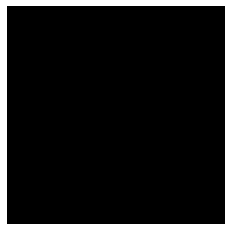

Loss: 0.00016463803624069937
Iteration: 75320, Score: 0.41187838552892203
[214, 44, 27, 50, 40, 48, 51, 92, 27, 28, 33, 205, 16, 125, 0]


Loss: 0.0001747441807114581
Iteration: 75360, Score: 0.38167075618356466
[187, 38, 60, 27, 21, 68, 57, 155, 18, 16, 84, 155, 19, 95, 0]


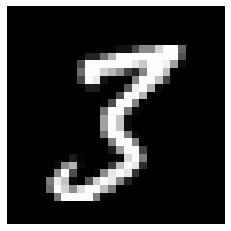

Loss: 0.0001481608016308158
Iteration: 75400, Score: 0.4414835050702094
[224, 48, 50, 36, 28, 50, 57, 80, 15, 35, 92, 161, 18, 106, 0]


Loss: 0.0001998683468172957
Iteration: 75440, Score: 0.38937215022742744
[140, 87, 67, 22, 24, 71, 113, 67, 19, 16, 108, 124, 29, 113, 0]


Loss: 0.00016372711531465028
Iteration: 75480, Score: 0.414257056966424
[222, 74, 21, 35, 28, 35, 95, 75, 23, 21, 60, 117, 16, 178, 0]


Loss: 0.00015838276916441447
Iteration: 75520, Score: 0.4558112752139567
[202, 84, 53, 12, 24, 48, 97, 103, 30, 19, 56, 132, 23, 117, 0]


Loss: 0.0001742036620366381
Iteration: 75560, Score: 0.41324290859326707
[204, 80, 22, 18, 21, 35, 101, 101, 36, 20, 56, 141, 18, 147, 0]


Loss: 0.00016351603203936516
Iteration: 75600, Score: 0.36036881794780484
[212, 108, 24, 18, 14, 44, 96, 100, 24, 15, 59, 136, 13, 137, 0]


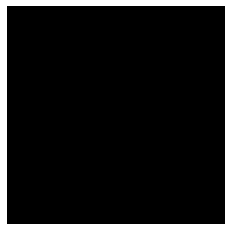

Test score: 0.3570409790500998
Loss: 0.00016626682362893934
Iteration: 75640, Score: 0.44605866524577137
[234, 37, 32, 28, 33, 39, 48, 104, 20, 11, 72, 213, 11, 118, 0]


Loss: 0.00013801129914287858
Iteration: 75680, Score: 0.417866263076663
[231, 63, 46, 20, 21, 75, 97, 76, 21, 15, 69, 117, 19, 130, 0]


Loss: 0.0001545577033478591
Iteration: 75720, Score: 0.40334978070855143
[220, 84, 35, 10, 19, 29, 96, 116, 27, 18, 104, 87, 18, 137, 0]


Loss: 0.00016750533206816884
Iteration: 75760, Score: 0.4892279153764247
[196, 42, 61, 29, 21, 69, 83, 73, 36, 21, 86, 158, 11, 114, 0]


Loss: 0.00015019137161516498
Iteration: 75800, Score: 0.3938434800058603
[214, 42, 53, 63, 20, 69, 63, 75, 27, 18, 66, 159, 20, 111, 0]


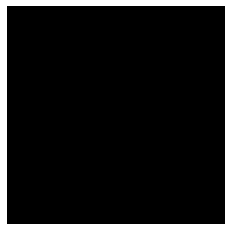

Loss: 0.00015976604422736178
Iteration: 75840, Score: 0.4081032783091068
[246, 43, 24, 42, 24, 47, 65, 74, 36, 12, 95, 139, 27, 126, 0]


Loss: 0.00016175503747019207
Iteration: 75880, Score: 0.4225447319298983
[243, 71, 47, 29, 14, 57, 112, 63, 25, 15, 87, 91, 21, 125, 0]


Loss: 0.0001533087254744111
Iteration: 75920, Score: 0.4320538482666015
[188, 77, 84, 33, 18, 83, 74, 63, 25, 11, 92, 122, 17, 113, 0]


Loss: 0.00015046827360915246
Iteration: 75960, Score: 0.3643145993649959
[173, 92, 80, 19, 31, 59, 94, 72, 23, 28, 85, 123, 20, 101, 0]


Loss: 0.00013438143305202803
Iteration: 76000, Score: 0.4887539441883564
[239, 58, 33, 32, 40, 34, 49, 82, 19, 12, 105, 127, 31, 139, 0]


Test score: 0.40436083402484646
Loss: 0.00013414944194029165
Iteration: 76040, Score: 0.3938872277140617
[211, 79, 14, 15, 43, 36, 82, 53, 25, 33, 112, 145, 31, 121, 0]


Loss: 0.00014839319305311326
Iteration: 76080, Score: 0.45998532849550255
[180, 101, 34, 23, 29, 35, 68, 55, 21, 17, 127, 155, 27, 128, 0]


Loss: 0.00014517888745194034
Iteration: 76120, Score: 0.4087321480214595
[184, 99, 36, 32, 20, 50, 97, 60, 20, 12, 96, 141, 38, 115, 0]


Loss: 0.0001399351496113165
Iteration: 76160, Score: 0.4015637020170689
[220, 47, 41, 19, 25, 43, 80, 94, 9, 18, 114, 128, 40, 122, 0]


Loss: 0.00014787729818122226
Iteration: 76200, Score: 0.45708482161536806
[216, 87, 30, 25, 10, 46, 91, 58, 17, 16, 113, 141, 32, 118, 0]


Loss: 0.0001521743062163879
Iteration: 76240, Score: 0.4169424368292093
[230, 90, 21, 23, 20, 40, 78, 60, 19, 13, 69, 172, 16, 149, 0]


Loss: 0.0001554594041291532
Iteration: 76280, Score: 0.39375167998671534
[219, 102, 26, 21, 11, 35, 107, 52, 27, 10, 98, 162, 26, 104, 0]


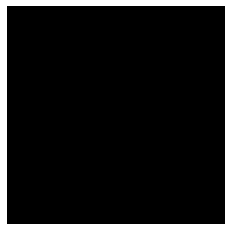

Loss: 0.00013967734124127056
Iteration: 76320, Score: 0.4296724097281694
[244, 44, 28, 23, 6, 42, 56, 88, 25, 13, 129, 161, 26, 115, 0]


Loss: 0.00014397858710284893
Iteration: 76360, Score: 0.4437557483054698
[266, 50, 35, 20, 14, 48, 41, 52, 32, 11, 96, 179, 30, 126, 0]


Loss: 0.0001643679802257916
Iteration: 76400, Score: 0.40742488276958466
[249, 55, 33, 11, 13, 72, 69, 57, 14, 15, 104, 159, 26, 123, 0]


Test score: 0.41651780992746346
Loss: 0.0001717017130814657
Iteration: 76440, Score: 0.42779002764821045
[197, 51, 61, 15, 14, 67, 85, 80, 18, 11, 89, 180, 26, 106, 0]


Loss: 0.0001611040331434439
Iteration: 76480, Score: 0.4576723224818706
[269, 63, 36, 15, 25, 49, 88, 54, 21, 9, 55, 135, 26, 155, 0]


Loss: 0.00014101314437021993
Iteration: 76520, Score: 0.44242751416563986
[242, 61, 71, 11, 26, 96, 74, 44, 17, 10, 94, 110, 20, 124, 0]


Loss: 0.00015247164400255134
Iteration: 76560, Score: 0.3977503396272659
[248, 53, 60, 23, 51, 49, 72, 34, 17, 24, 78, 144, 22, 125, 0]


Loss: 0.00016065066666443161
Iteration: 76600, Score: 0.4048665944039822
[208, 76, 30, 20, 43, 61, 83, 51, 29, 9, 103, 152, 18, 117, 0]


Loss: 0.00014002979522610432
Iteration: 76640, Score: 0.3895293994098902
[217, 62, 43, 32, 26, 71, 68, 45, 28, 12, 78, 179, 23, 116, 0]


Loss: 0.0001351413567910614
Iteration: 76680, Score: 0.4479967243224382
[230, 66, 20, 20, 26, 45, 88, 53, 27, 12, 103, 177, 27, 106, 0]


Loss: 0.000158748373948225
Iteration: 76720, Score: 0.3685048312097788
[209, 60, 51, 43, 51, 63, 70, 42, 20, 23, 87, 163, 17, 101, 0]


Loss: 0.00013644594047698233
Iteration: 76760, Score: 0.4855721200406551
[202, 74, 39, 25, 37, 81, 84, 59, 23, 18, 66, 172, 16, 104, 0]


Loss: 0.00013969360715919313
Iteration: 76800, Score: 0.46052073585987097
[204, 50, 88, 18, 24, 92, 68, 49, 39, 22, 70, 159, 13, 104, 0]


Test score: 0.39863944243639715
Loss: 0.00013640533228170604
Iteration: 76840, Score: 0.4021121765673161
[173, 66, 82, 21, 22, 80, 85, 52, 53, 18, 85, 127, 17, 119, 0]


Loss: 0.00013521290398275132
Iteration: 76880, Score: 0.43518316577374944
[174, 41, 67, 40, 47, 70, 84, 73, 40, 20, 85, 128, 15, 116, 0]


Loss: 0.00012858811933164996
Iteration: 76920, Score: 0.44046625295281394
[185, 35, 19, 44, 41, 36, 85, 121, 41, 30, 61, 160, 22, 120, 0]


Loss: 0.0001359209055051101
Iteration: 76960, Score: 0.41598624436557297
[200, 51, 21, 17, 14, 39, 96, 111, 27, 30, 58, 195, 23, 118, 0]


Loss: 0.0001410828873812813
Iteration: 77000, Score: 0.4453405958116055
[205, 37, 26, 38, 26, 49, 66, 90, 25, 16, 77, 203, 24, 118, 0]


Loss: 0.00013203121987769207
Iteration: 77040, Score: 0.4697812435626984
[220, 51, 29, 43, 44, 76, 57, 72, 27, 13, 64, 146, 32, 126, 0]


Loss: 0.0001305452569676063
Iteration: 77080, Score: 0.4144223880916834
[241, 57, 20, 45, 18, 58, 87, 75, 21, 16, 54, 134, 22, 152, 0]


Loss: 0.0001328497331866742
Iteration: 77120, Score: 0.4555631215423347
[239, 57, 26, 49, 17, 43, 83, 86, 13, 22, 74, 140, 23, 128, 0]


Loss: 0.00013381031287269668
Iteration: 77160, Score: 0.4733637462258338
[222, 79, 28, 33, 23, 39, 86, 76, 22, 14, 97, 137, 30, 114, 0]


Loss: 0.00013817040149760034
Iteration: 77200, Score: 0.3736835748851299
[232, 36, 24, 45, 27, 35, 69, 77, 28, 34, 89, 115, 39, 150, 0]


Test score: 0.38563347449898727
Loss: 0.00013388872847376604
Iteration: 77240, Score: 0.4069002951681614
[205, 49, 27, 48, 22, 62, 82, 50, 25, 38, 106, 124, 24, 138, 0]


Loss: 0.00015126568272661882
Iteration: 77280, Score: 0.44565357500314706
[219, 58, 57, 29, 26, 93, 84, 42, 21, 18, 109, 101, 28, 115, 0]


Loss: 0.00014224440252228815
Iteration: 77320, Score: 0.41164091533422464
[236, 74, 16, 17, 30, 48, 72, 58, 23, 13, 99, 138, 29, 147, 0]


Loss: 0.00013963299990708714
Iteration: 77360, Score: 0.4354214992038906
[227, 80, 33, 30, 33, 24, 83, 64, 20, 19, 109, 122, 28, 128, 0]


Loss: 0.00015893975563057567
Iteration: 77400, Score: 0.3607899996638298
[226, 46, 25, 21, 29, 43, 71, 74, 31, 11, 72, 180, 43, 128, 0]


Loss: 0.00013638388140284422
Iteration: 77440, Score: 0.36556600788980714
[213, 36, 53, 18, 21, 63, 82, 91, 29, 15, 52, 165, 26, 136, 0]


Loss: 0.00014657150410173135
Iteration: 77480, Score: 0.4354357496500015
[229, 80, 33, 17, 28, 35, 124, 64, 27, 11, 45, 156, 27, 124, 0]


Loss: 0.000153143083512537
Iteration: 77520, Score: 0.39088532386720176
[183, 111, 37, 18, 40, 44, 110, 71, 13, 16, 80, 130, 29, 118, 0]


Loss: 0.00012674768229968469
Iteration: 77560, Score: 0.43544050824642194
[225, 63, 23, 16, 17, 38, 61, 97, 17, 18, 63, 207, 54, 101, 0]


Loss: 0.00015010420869856095
Iteration: 77600, Score: 0.47421655902639015
[240, 50, 24, 21, 29, 38, 102, 63, 20, 17, 61, 160, 48, 127, 0]


Test score: 0.3815036705434322
Loss: 0.00015263974853931147
Iteration: 77640, Score: 0.42575498053431515
[173, 51, 59, 25, 29, 71, 50, 48, 34, 22, 74, 188, 26, 150, 0]


Loss: 0.0001356098598470991
Iteration: 77680, Score: 0.3695179112479091
[204, 80, 40, 24, 39, 64, 57, 59, 23, 22, 83, 167, 25, 113, 0]


Loss: 0.00015626336715636512
Iteration: 77720, Score: 0.43598441863060006
[216, 80, 30, 39, 55, 35, 82, 54, 20, 18, 81, 142, 28, 120, 0]


Loss: 0.0001433120467198276
Iteration: 77760, Score: 0.3905551710650325
[233, 48, 30, 30, 32, 46, 80, 65, 14, 21, 91, 159, 28, 123, 0]


Loss: 0.00012969891248005777
Iteration: 77800, Score: 0.43929204726219184
[197, 90, 38, 14, 30, 72, 98, 45, 15, 16, 61, 160, 35, 129, 0]


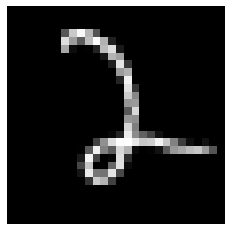

Loss: 0.00016101032398928712
Iteration: 77840, Score: 0.3370914832130074
[186, 105, 45, 18, 19, 44, 103, 63, 16, 13, 146, 114, 20, 108, 0]


Loss: 0.00015056929011700459
Iteration: 77880, Score: 0.46706663841009144
[196, 72, 62, 33, 20, 52, 71, 56, 25, 9, 121, 154, 18, 111, 0]


Loss: 0.00013984435283389553
Iteration: 77920, Score: 0.4210801859498023
[202, 55, 52, 26, 19, 85, 65, 67, 23, 12, 90, 187, 23, 94, 0]


Loss: 0.0001558478197818925
Iteration: 77960, Score: 0.38441554668545724
[148, 89, 22, 24, 16, 60, 129, 74, 22, 22, 94, 191, 21, 88, 0]


Loss: 0.0001450644702155766
Iteration: 78000, Score: 0.39701221594214425
[212, 38, 42, 32, 34, 51, 83, 84, 44, 24, 89, 144, 9, 114, 0]


Test score: 0.41640684860944743
Loss: 0.00012885812734963312
Iteration: 78040, Score: 0.41058814001083377
[178, 57, 32, 15, 20, 28, 99, 144, 21, 15, 98, 160, 11, 122, 0]


Loss: 0.0001501278968796012
Iteration: 78080, Score: 0.4444747856855392
[157, 68, 43, 39, 51, 27, 89, 76, 23, 22, 108, 144, 19, 134, 0]


Loss: 0.0001413611276640817
Iteration: 78120, Score: 0.39726669533550735
[209, 31, 32, 20, 50, 46, 54, 111, 17, 25, 128, 146, 11, 120, 0]


Loss: 0.00015920388333764995
Iteration: 78160, Score: 0.38646561326086526
[196, 36, 21, 37, 69, 31, 67, 106, 25, 17, 102, 151, 21, 121, 0]


Loss: 0.0001316279897211742
Iteration: 78200, Score: 0.3936522530466318
[214, 41, 50, 37, 27, 61, 65, 117, 23, 13, 122, 117, 11, 102, 0]


Loss: 0.00015556223424086226
Iteration: 78240, Score: 0.42000939667224885
[186, 49, 62, 21, 36, 79, 84, 88, 20, 12, 112, 142, 15, 94, 0]


Loss: 0.00016222058798964013
Iteration: 78280, Score: 0.42567925006151197
[164, 26, 56, 27, 31, 73, 81, 108, 29, 18, 74, 158, 17, 138, 0]


Loss: 0.00013903697720726098
Iteration: 78320, Score: 0.48117674237489705
[172, 76, 63, 30, 32, 68, 139, 68, 21, 17, 73, 107, 11, 123, 0]


Loss: 0.00014696645471434997
Iteration: 78360, Score: 0.4054930020496249
[223, 63, 41, 29, 32, 55, 89, 60, 20, 27, 90, 121, 15, 135, 0]


Loss: 0.0001504103440634665
Iteration: 78400, Score: 0.4436946701779963
[221, 55, 85, 16, 23, 93, 98, 41, 19, 15, 80, 111, 19, 124, 0]


Test score: 0.3923122144415974
Loss: 0.0001531919459124786
Iteration: 78440, Score: 0.37464338347315784
[227, 36, 49, 40, 36, 68, 63, 82, 26, 25, 99, 123, 18, 108, 0]


Loss: 0.0001415534409160106
Iteration: 78480, Score: 0.42334901727922264
[178, 51, 101, 49, 50, 57, 60, 76, 39, 17, 82, 109, 39, 92, 0]


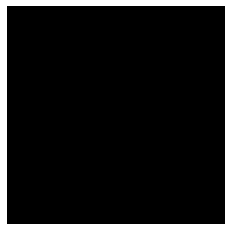

Loss: 0.0001665891707910496
Iteration: 78520, Score: 0.3854555860459804
[218, 62, 41, 26, 32, 26, 67, 68, 63, 20, 126, 102, 20, 129, 0]


Loss: 0.0001373368567560275
Iteration: 78560, Score: 0.4070674167349936
[184, 79, 55, 38, 39, 33, 114, 69, 30, 12, 104, 115, 25, 103, 0]


Loss: 0.0001509512197780513
Iteration: 78600, Score: 0.4138393089175224
[188, 56, 50, 40, 27, 78, 63, 93, 27, 21, 111, 126, 23, 97, 0]


Loss: 0.00014650417264750092
Iteration: 78640, Score: 0.4439639449864624
[164, 65, 92, 21, 20, 77, 84, 69, 55, 29, 102, 93, 12, 117, 0]


Loss: 0.00013365556794008243
Iteration: 78680, Score: 0.42564393234252923
[175, 61, 53, 21, 18, 60, 112, 55, 33, 55, 98, 112, 17, 130, 0]


Loss: 0.00015258504496649695
Iteration: 78720, Score: 0.4173637360334396
[212, 29, 50, 35, 20, 29, 97, 82, 26, 40, 101, 137, 57, 85, 0]


Loss: 0.0001516108100266341
Iteration: 78760, Score: 0.4264995229095219
[215, 52, 21, 53, 39, 42, 94, 55, 30, 44, 92, 131, 33, 99, 0]


Loss: 0.00017432840467628254
Iteration: 78800, Score: 0.4188855673968792
[219, 69, 48, 27, 27, 33, 98, 56, 29, 13, 92, 149, 24, 116, 0]


Test score: 0.39984314393997183
Loss: 0.0001777727739325411
Iteration: 78840, Score: 0.4471140609681606
[159, 92, 79, 24, 9, 103, 119, 78, 17, 15, 60, 104, 19, 122, 0]


Loss: 0.00016349608036972613
Iteration: 78880, Score: 0.4483083192259073
[215, 41, 46, 12, 23, 103, 69, 70, 16, 31, 105, 116, 32, 121, 0]


Loss: 0.00015569259380219353
Iteration: 78920, Score: 0.4231063993722201
[174, 58, 24, 40, 60, 64, 88, 84, 17, 34, 98, 124, 18, 117, 0]


Loss: 0.00015403575619983152
Iteration: 78960, Score: 0.45836287075281146
[240, 59, 23, 30, 37, 57, 103, 60, 21, 22, 83, 132, 20, 113, 0]


Loss: 0.00012375538906681446
Iteration: 79000, Score: 0.45542871503531923
[223, 57, 30, 13, 46, 39, 106, 51, 30, 23, 104, 115, 26, 137, 0]


Loss: 0.00012967536783696826
Iteration: 79040, Score: 0.44347064923495055
[234, 43, 17, 28, 38, 63, 47, 90, 27, 26, 132, 99, 21, 135, 0]


Loss: 0.00014549022753473762
Iteration: 79080, Score: 0.4411021806001664
[253, 52, 23, 25, 29, 54, 61, 49, 36, 24, 87, 182, 19, 106, 0]


Loss: 0.00013868598870347325
Iteration: 79120, Score: 0.41167380091547956
[170, 83, 30, 41, 38, 52, 93, 67, 38, 30, 101, 134, 14, 109, 0]


Loss: 0.0001434149894122422
Iteration: 79160, Score: 0.4344588074088097
[170, 77, 50, 33, 22, 69, 99, 47, 66, 21, 98, 130, 18, 100, 0]


Loss: 0.00014982723445718072
Iteration: 79200, Score: 0.45883866748213775
[210, 84, 16, 11, 32, 40, 98, 84, 20, 21, 129, 134, 25, 96, 0]


Test score: 0.4171638488173485
Loss: 0.00014526973403884827
Iteration: 79240, Score: 0.45548337268829336
[242, 53, 37, 20, 18, 27, 80, 69, 27, 16, 128, 152, 33, 98, 0]


Loss: 0.00013673202893087918
Iteration: 79280, Score: 0.44440155005455023
[249, 43, 27, 11, 24, 55, 76, 61, 17, 18, 113, 164, 27, 115, 0]


Loss: 0.0001309213750873007
Iteration: 79320, Score: 0.42056869626045235
[201, 71, 77, 15, 15, 57, 97, 72, 16, 22, 107, 152, 25, 73, 0]


Loss: 0.00013283380823876677
Iteration: 79360, Score: 0.45490882924199105
[192, 69, 38, 21, 15, 31, 83, 105, 22, 12, 192, 114, 15, 91, 0]


Loss: 0.00013731595313851649
Iteration: 79400, Score: 0.39507579225301737
[213, 60, 40, 22, 24, 26, 33, 84, 15, 27, 138, 182, 35, 101, 0]


Loss: 0.00014537111682985963
Iteration: 79440, Score: 0.41445690157637005
[211, 106, 40, 13, 27, 29, 87, 61, 21, 35, 124, 132, 20, 94, 0]


Loss: 0.000140642728595544
Iteration: 79480, Score: 0.44514539599418645
[207, 56, 40, 21, 22, 35, 74, 96, 21, 12, 113, 144, 28, 131, 0]


Loss: 0.0001392058835350442
Iteration: 79520, Score: 0.39540796357393265
[257, 40, 46, 17, 30, 52, 53, 58, 25, 20, 113, 125, 57, 107, 0]


Loss: 0.00017556589273079993
Iteration: 79560, Score: 0.41662554588913914
[163, 56, 60, 15, 63, 73, 57, 76, 23, 39, 85, 106, 47, 137, 0]


Loss: 0.0001342487758357123
Iteration: 79600, Score: 0.43488326066732397
[236, 71, 22, 16, 25, 39, 73, 74, 22, 33, 92, 140, 30, 127, 0]


Test score: 0.3839167920355395
Loss: 0.00017680620354860354
Iteration: 79640, Score: 0.43571715793199833
[225, 40, 44, 16, 37, 63, 63, 63, 14, 13, 96, 169, 23, 134, 0]


Loss: 0.00015679480104989867
Iteration: 79680, Score: 0.4282956329621375
[164, 68, 63, 27, 41, 69, 59, 91, 11, 21, 85, 133, 26, 142, 0]


Loss: 0.0001334008921330821
Iteration: 79720, Score: 0.421929059624672
[205, 62, 51, 22, 19, 80, 83, 103, 22, 17, 66, 143, 12, 115, 0]


Loss: 0.00014222892619229782
Iteration: 79760, Score: 0.39715987500548366
[197, 45, 82, 12, 19, 98, 71, 54, 46, 9, 77, 120, 19, 151, 0]


Loss: 0.00015449322531149566
Iteration: 79800, Score: 0.3855339660644532
[221, 34, 57, 20, 27, 63, 46, 88, 18, 24, 117, 111, 59, 115, 0]


Loss: 0.0001620431177511785
Iteration: 79840, Score: 0.3509998584836721
[199, 48, 96, 27, 32, 93, 42, 65, 14, 16, 71, 106, 36, 155, 0]


Loss: 0.0001604548285482108
Iteration: 79880, Score: 0.3146826732940972
[193, 89, 38, 27, 25, 47, 85, 100, 27, 23, 99, 132, 18, 97, 0]


Loss: 0.0001607315108794005
Iteration: 79920, Score: 0.4293935948461295
[249, 58, 42, 24, 28, 26, 57, 61, 12, 13, 92, 186, 41, 111, 0]


Loss: 0.0001748955696843426
Iteration: 79960, Score: 0.4012093013077974
[202, 75, 52, 31, 29, 55, 77, 67, 29, 14, 75, 166, 27, 101, 0]


Loss: 0.00015947251243144119
Iteration: 80000, Score: 0.44327980355918406
[169, 45, 170, 9, 16, 164, 97, 77, 19, 8, 65, 73, 15, 73, 0]


Test score: 0.3720776014253497
Loss: 0.00014174273411550614
Iteration: 80040, Score: 0.445122591033578
[236, 43, 51, 14, 30, 54, 70, 94, 28, 17, 81, 144, 32, 106, 0]


Loss: 0.00014975017424765069
Iteration: 80080, Score: 0.3750892075821758
[201, 52, 51, 11, 12, 65, 81, 77, 50, 20, 88, 115, 70, 107, 0]


Loss: 0.000160106870526072
Iteration: 80120, Score: 0.3789686474204064
[197, 18, 67, 16, 29, 43, 70, 112, 25, 19, 70, 162, 46, 126, 0]


Loss: 0.00015026758467882582
Iteration: 80160, Score: 0.3913075577020646
[211, 40, 50, 14, 18, 40, 77, 80, 33, 22, 126, 156, 31, 102, 0]


Loss: 0.00014418427662042478
Iteration: 80200, Score: 0.4068996366709472
[168, 124, 74, 13, 20, 77, 151, 47, 21, 13, 66, 74, 60, 92, 0]


Loss: 0.00015085928089096764
Iteration: 80240, Score: 0.3830326198339462
[189, 44, 94, 50, 28, 54, 84, 58, 24, 18, 84, 108, 40, 125, 0]


Loss: 0.00016619798415946771
Iteration: 80280, Score: 0.3707877061218023
[177, 85, 32, 35, 18, 30, 122, 69, 34, 28, 86, 146, 46, 92, 0]


Loss: 0.0001743350710801859
Iteration: 80320, Score: 0.36226041306555273
[186, 110, 35, 45, 15, 50, 106, 73, 18, 17, 71, 162, 26, 86, 0]


Loss: 0.0001695142760102692
Iteration: 80360, Score: 0.4334160268083215
[199, 65, 45, 23, 17, 54, 115, 59, 30, 48, 92, 98, 46, 109, 0]


Loss: 0.00015656256599073438
Iteration: 80400, Score: 0.4084179790988564
[177, 72, 53, 28, 21, 91, 92, 41, 74, 43, 82, 98, 49, 79, 0]


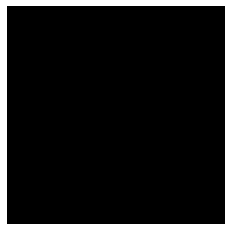

Test score: 0.39530043913423996
Loss: 0.00015743386580649796
Iteration: 80440, Score: 0.4129666874930263
[114, 63, 114, 26, 26, 89, 118, 41, 38, 80, 44, 130, 34, 83, 0]


Loss: 0.00013806208447375605
Iteration: 80480, Score: 0.4231616353951395
[198, 92, 44, 34, 13, 34, 122, 48, 23, 25, 77, 146, 52, 92, 0]


Loss: 0.00013673797659498256
Iteration: 80520, Score: 0.4357059019505978
[182, 105, 48, 23, 21, 69, 144, 40, 18, 31, 70, 137, 21, 91, 0]


Loss: 0.00016152747289337608
Iteration: 80560, Score: 0.4505381575524806
[241, 101, 31, 14, 30, 28, 101, 36, 19, 42, 95, 123, 26, 113, 0]


Loss: 0.0001386529653925121
Iteration: 80600, Score: 0.44423152837157254
[172, 33, 69, 35, 38, 90, 85, 75, 12, 74, 77, 103, 14, 123, 0]


Loss: 0.0001394221803735469
Iteration: 80640, Score: 0.4335540904402733
[254, 30, 31, 25, 24, 65, 67, 75, 21, 38, 87, 155, 15, 113, 0]


Loss: 0.00014205332902923206
Iteration: 80680, Score: 0.4263118298053742
[213, 57, 43, 40, 38, 45, 111, 46, 27, 48, 58, 136, 36, 102, 0]


Loss: 0.00015582707791251597
Iteration: 80720, Score: 0.4468855283409357
[240, 51, 34, 44, 17, 38, 58, 48, 47, 40, 110, 123, 18, 132, 0]


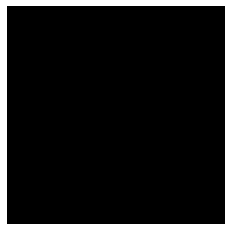

Loss: 0.00013834290370268556
Iteration: 80760, Score: 0.3869291508197783
[188, 70, 57, 26, 81, 50, 138, 47, 28, 11, 58, 100, 20, 126, 0]


Loss: 0.00015180157219402097
Iteration: 80800, Score: 0.46109603184461595
[253, 46, 57, 24, 44, 64, 61, 44, 22, 40, 59, 178, 16, 92, 0]


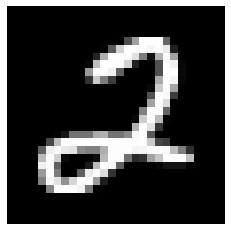

Test score: 0.4977981072366237
Loss: 0.0001711479987793945
Iteration: 80840, Score: 0.38161013589799403
[229, 42, 66, 30, 49, 72, 66, 45, 19, 22, 87, 136, 18, 119, 0]


Loss: 0.00014118836292341196
Iteration: 80880, Score: 0.43777615420520305
[228, 32, 89, 19, 17, 140, 46, 38, 12, 23, 80, 136, 26, 114, 0]


Loss: 0.0001606378825631524
Iteration: 80920, Score: 0.41674827730655667
[168, 42, 53, 34, 32, 117, 60, 88, 24, 14, 65, 157, 25, 121, 0]


Loss: 0.00015976886968420927
Iteration: 80960, Score: 0.4140784948468208
[224, 43, 48, 47, 32, 73, 71, 81, 27, 21, 69, 148, 17, 99, 0]


Loss: 0.00015352618041937296
Iteration: 81000, Score: 0.40119523240625865
[236, 39, 49, 25, 38, 104, 49, 51, 30, 17, 104, 124, 26, 108, 0]


Loss: 0.00014682631498109692
Iteration: 81040, Score: 0.4384468736946583
[203, 65, 28, 17, 43, 60, 80, 78, 52, 16, 97, 130, 23, 108, 0]


Loss: 0.0001622307813881929
Iteration: 81080, Score: 0.3998252320587636
[167, 111, 29, 37, 46, 44, 96, 80, 36, 26, 70, 110, 26, 122, 0]


Loss: 0.00019628822049171148
Iteration: 81120, Score: 0.3456957372874021
[198, 84, 30, 25, 18, 41, 88, 79, 18, 21, 87, 148, 26, 137, 0]


Loss: 0.00016299790057830216
Iteration: 81160, Score: 0.45087739399075505
[224, 108, 42, 15, 16, 61, 100, 59, 22, 12, 105, 112, 22, 102, 0]


Loss: 0.00015434678999217517
Iteration: 81200, Score: 0.44966383817791933
[277, 65, 26, 11, 26, 51, 54, 74, 24, 19, 82, 125, 34, 132, 0]


Test score: 0.4391716236472131
Loss: 0.00014074556277214416
Iteration: 81240, Score: 0.4191300076544285
[201, 63, 56, 41, 57, 75, 60, 47, 34, 17, 95, 109, 30, 115, 0]


Loss: 0.000161753216489599
Iteration: 81280, Score: 0.37009197108447556
[173, 49, 81, 43, 45, 90, 66, 52, 29, 37, 109, 96, 38, 92, 0]


Loss: 0.00014917327172916814
Iteration: 81320, Score: 0.39596235305070876
[221, 39, 38, 34, 29, 25, 64, 60, 24, 39, 115, 150, 23, 139, 0]


Loss: 0.0001449266304794401
Iteration: 81360, Score: 0.46762225756049147
[227, 60, 56, 20, 29, 33, 75, 63, 28, 30, 74, 157, 30, 118, 0]


Loss: 0.00018190944058354657
Iteration: 81400, Score: 0.42235945492982874
[192, 68, 82, 36, 34, 79, 89, 61, 16, 12, 66, 125, 16, 124, 0]


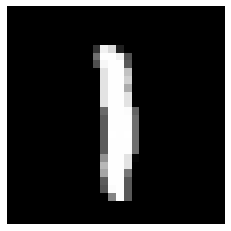

Loss: 0.00015878558322153454
Iteration: 81440, Score: 0.4314641745835542
[140, 93, 80, 45, 34, 105, 101, 75, 13, 15, 58, 117, 16, 108, 0]


Loss: 0.0001684365392945807
Iteration: 81480, Score: 0.44337582565844047
[186, 105, 29, 61, 54, 33, 122, 72, 16, 14, 88, 106, 13, 101, 0]


Loss: 0.00014480912410468213
Iteration: 81520, Score: 0.4422054445445537
[223, 58, 38, 55, 34, 55, 70, 68, 21, 15, 54, 162, 19, 128, 0]


Loss: 0.0001494222893899923
Iteration: 81560, Score: 0.42838053695857514
[191, 103, 27, 30, 23, 43, 120, 61, 44, 15, 68, 141, 17, 117, 0]


Loss: 0.0001320719476771724
Iteration: 81600, Score: 0.4030396976172924
[214, 65, 33, 45, 22, 47, 95, 48, 23, 22, 70, 147, 45, 124, 0]


Test score: 0.3392246138751508
Loss: 0.0001304003711609669
Iteration: 81640, Score: 0.4118014428019524
[239, 76, 33, 29, 15, 35, 86, 48, 32, 21, 112, 131, 34, 109, 0]


Loss: 0.00013386237200180298
Iteration: 81680, Score: 0.43897548379004
[196, 71, 30, 17, 11, 20, 78, 90, 31, 22, 139, 125, 35, 135, 0]


Loss: 0.0001343554135346108
Iteration: 81720, Score: 0.41383294723927977
[238, 80, 35, 16, 22, 28, 93, 85, 46, 18, 99, 112, 23, 105, 0]


Loss: 0.0001278504267700205
Iteration: 81760, Score: 0.45589181354641906
[199, 65, 59, 30, 15, 60, 77, 68, 25, 26, 104, 118, 40, 114, 0]


Loss: 0.00014082690091306294
Iteration: 81800, Score: 0.31872135686129327
[181, 51, 42, 42, 51, 51, 71, 60, 35, 10, 101, 140, 41, 124, 0]


Loss: 0.000152430271973335
Iteration: 81840, Score: 0.43186469510197645
[209, 81, 59, 30, 30, 56, 65, 55, 31, 14, 61, 159, 39, 111, 0]


Loss: 0.00015533526116228618
Iteration: 81880, Score: 0.41973226919770246
[235, 66, 25, 29, 12, 30, 78, 62, 59, 21, 92, 135, 40, 116, 0]


Loss: 0.00016845125796672238
Iteration: 81920, Score: 0.4326465188339353
[174, 79, 73, 17, 21, 50, 111, 56, 72, 14, 112, 74, 40, 107, 0]


Loss: 0.00013365267143087328
Iteration: 81960, Score: 0.4600201381146909
[198, 57, 86, 19, 18, 86, 63, 76, 23, 16, 100, 105, 29, 124, 0]


Loss: 0.00012945397379384013
Iteration: 82000, Score: 0.4204300898201764
[261, 45, 33, 24, 20, 36, 57, 85, 51, 23, 87, 142, 16, 120, 0]


Test score: 0.296384180881083
Loss: 0.00014496783798884644
Iteration: 82040, Score: 0.3682302797846496
[178, 79, 54, 30, 35, 47, 115, 63, 46, 29, 59, 136, 10, 119, 0]


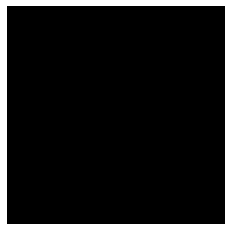

Loss: 0.00014411964670353936
Iteration: 82080, Score: 0.4189774710834028
[197, 73, 72, 16, 28, 64, 65, 70, 43, 25, 68, 149, 13, 117, 0]


Loss: 0.00017361683711276544
Iteration: 82120, Score: 0.40158276548981675
[184, 57, 138, 17, 20, 110, 75, 56, 30, 40, 54, 105, 13, 101, 0]


Loss: 0.00015452098635884018
Iteration: 82160, Score: 0.4355713502392174
[142, 60, 103, 13, 62, 82, 82, 84, 51, 28, 75, 96, 12, 110, 0]


Loss: 0.00015124869892713062
Iteration: 82200, Score: 0.4292299017161132
[182, 85, 41, 19, 68, 35, 80, 67, 55, 18, 73, 118, 21, 138, 0]


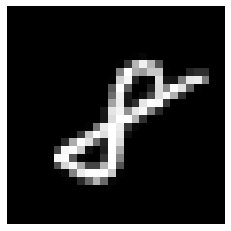

Loss: 0.00017111790869298965
Iteration: 82240, Score: 0.4246645157337189
[206, 61, 90, 22, 43, 93, 61, 51, 35, 15, 77, 128, 12, 106, 0]


Loss: 0.00014116802959508127
Iteration: 82280, Score: 0.4158586246967314
[179, 70, 78, 20, 49, 86, 52, 84, 26, 17, 97, 101, 10, 131, 0]


Loss: 0.00014524648566366054
Iteration: 82320, Score: 0.39951424926519385
[196, 56, 28, 52, 60, 30, 51, 91, 34, 30, 113, 116, 14, 129, 0]


Loss: 0.00012456797212016414
Iteration: 82360, Score: 0.3714081883877516
[228, 38, 22, 60, 30, 39, 83, 51, 22, 26, 91, 149, 24, 137, 0]


Loss: 0.000141534215576313
Iteration: 82400, Score: 0.4103293145447971
[238, 53, 15, 41, 22, 44, 102, 54, 19, 20, 65, 157, 28, 142, 0]


Test score: 0.3545300256460905
Loss: 0.00013509446137495047
Iteration: 82440, Score: 0.39031179463863375
[188, 63, 50, 60, 32, 57, 74, 89, 21, 35, 64, 119, 32, 116, 0]


Loss: 0.00011966044199112347
Iteration: 82480, Score: 0.4180232328474521
[155, 49, 42, 27, 28, 76, 63, 94, 50, 39, 85, 125, 26, 141, 0]


Loss: 0.00013769668862212973
Iteration: 82520, Score: 0.4221138448119162
[168, 64, 59, 16, 26, 73, 93, 57, 29, 19, 75, 200, 17, 104, 0]


Loss: 0.0001495978091469773
Iteration: 82560, Score: 0.42892485588788987
[182, 53, 51, 25, 25, 62, 75, 64, 42, 15, 86, 188, 19, 113, 0]


Loss: 0.00013430898458208646
Iteration: 82600, Score: 0.42700107596814635
[188, 109, 27, 39, 27, 43, 77, 61, 56, 27, 44, 161, 10, 131, 0]


Loss: 0.00013814440120129686
Iteration: 82640, Score: 0.3903261606097221
[240, 45, 39, 23, 28, 32, 48, 55, 30, 20, 129, 147, 25, 139, 0]


Loss: 0.0001432666339973833
Iteration: 82680, Score: 0.36464291134476656
[245, 54, 20, 31, 26, 63, 53, 73, 46, 22, 71, 137, 27, 132, 0]


Loss: 0.00017077352178353935
Iteration: 82720, Score: 0.44984090675413624
[235, 51, 50, 23, 25, 67, 56, 65, 37, 16, 86, 117, 24, 148, 0]


Loss: 0.0001752049633001435
Iteration: 82760, Score: 0.44255609616637226
[155, 87, 132, 11, 23, 151, 91, 42, 19, 16, 47, 110, 31, 85, 0]


Loss: 0.00014784991793960277
Iteration: 82800, Score: 0.3972553952112794
[180, 69, 74, 13, 32, 92, 112, 50, 18, 23, 49, 158, 26, 104, 0]


Test score: 0.3838542913794517
Loss: 0.0001244230368785147
Iteration: 82840, Score: 0.3865627433657647
[226, 66, 68, 16, 26, 86, 70, 38, 28, 20, 73, 120, 25, 138, 0]


Loss: 0.00014171367426662443
Iteration: 82880, Score: 0.45173723259568216
[279, 53, 52, 27, 22, 67, 41, 57, 34, 14, 67, 138, 30, 119, 0]


Loss: 0.0001309814015403225
Iteration: 82920, Score: 0.44719611691683525
[230, 82, 41, 21, 33, 29, 55, 65, 46, 41, 74, 111, 62, 110, 0]


Loss: 0.00013745725273632022
Iteration: 82960, Score: 0.40139902288466695
[205, 83, 23, 22, 41, 27, 71, 83, 19, 37, 60, 143, 44, 142, 0]


Loss: 0.00014769639034932614
Iteration: 83000, Score: 0.49233519500493994
[212, 75, 44, 51, 52, 65, 51, 61, 24, 25, 60, 135, 43, 102, 0]


Loss: 0.00017642898964972514
Iteration: 83040, Score: 0.4429177596904337
[216, 101, 32, 30, 28, 47, 47, 90, 28, 21, 66, 139, 24, 131, 0]


Loss: 0.00014763308882271995
Iteration: 83080, Score: 0.4643624666929246
[210, 76, 62, 18, 18, 72, 90, 83, 29, 43, 66, 86, 16, 131, 0]


Loss: 0.00012735327553204225
Iteration: 83120, Score: 0.4725639888942241
[254, 37, 28, 25, 18, 46, 92, 77, 19, 23, 72, 123, 42, 144, 0]


Loss: 0.0001506054866087181
Iteration: 83160, Score: 0.4448922534584999
[213, 59, 54, 19, 18, 88, 112, 67, 20, 19, 42, 137, 30, 122, 0]


Loss: 0.00015631489412819372
Iteration: 83200, Score: 0.4025140821188689
[227, 42, 64, 17, 30, 89, 90, 80, 27, 15, 38, 116, 25, 140, 0]


Test score: 0.3676273082196713
Loss: 0.00013942934020766073
Iteration: 83240, Score: 0.4705140896439553
[241, 42, 53, 23, 25, 86, 66, 86, 19, 20, 53, 81, 37, 168, 0]


Loss: 0.00013296099059437996
Iteration: 83280, Score: 0.41449494561553013
[163, 57, 50, 7, 31, 71, 88, 86, 32, 29, 102, 96, 41, 147, 0]


Loss: 0.00015173995391033938
Iteration: 83320, Score: 0.47313469892740256
[139, 55, 95, 18, 20, 151, 102, 60, 19, 29, 64, 126, 39, 83, 0]


Loss: 0.00015355131090528124
Iteration: 83360, Score: 0.3867481966614723
[207, 27, 78, 33, 27, 120, 47, 58, 29, 20, 49, 141, 45, 119, 0]


Loss: 0.0001541229613487848
Iteration: 83400, Score: 0.41058932873955917
[189, 48, 71, 27, 21, 84, 79, 102, 41, 35, 75, 81, 34, 113, 0]


Loss: 0.00012989306745789402
Iteration: 83440, Score: 0.4507528652548789
[216, 49, 21, 23, 41, 50, 73, 92, 51, 22, 61, 134, 24, 143, 0]


Loss: 0.00015968749193744173
Iteration: 83480, Score: 0.44908945557475094
[213, 33, 42, 17, 24, 64, 45, 81, 42, 20, 77, 173, 35, 134, 0]


Loss: 0.00013459076948781808
Iteration: 83520, Score: 0.40761578434705725
[204, 64, 62, 28, 32, 38, 85, 96, 37, 19, 60, 122, 42, 111, 0]


Loss: 0.00016591838292185265
Iteration: 83560, Score: 0.40843734151870026
[193, 35, 98, 25, 30, 75, 114, 67, 23, 17, 96, 58, 37, 132, 0]


Loss: 0.0001807917101724088
Iteration: 83600, Score: 0.4110156793594359
[210, 78, 32, 18, 27, 21, 146, 60, 25, 31, 64, 126, 45, 117, 0]


Test score: 0.403320330902934
Loss: 0.00015028693033449837
Iteration: 83640, Score: 0.4088313498795032
[197, 33, 117, 38, 48, 82, 60, 74, 28, 18, 60, 111, 22, 112, 0]


Loss: 0.00015360309694992144
Iteration: 83680, Score: 0.35010285201668734
[197, 64, 112, 13, 25, 94, 89, 59, 15, 18, 78, 101, 31, 104, 0]


Loss: 0.0001486921469298222
Iteration: 83720, Score: 0.3982262593954802
[198, 44, 93, 31, 23, 61, 83, 60, 18, 17, 84, 118, 51, 119, 0]


Loss: 0.00014000892715825502
Iteration: 83760, Score: 0.43856546732783314
[149, 28, 99, 60, 61, 95, 106, 38, 25, 29, 68, 100, 29, 113, 0]


Loss: 0.00014685702858983075
Iteration: 83800, Score: 0.43444233372807506
[204, 66, 70, 23, 40, 57, 65, 57, 41, 31, 73, 94, 69, 110, 0]


Loss: 0.00013179407866315332
Iteration: 83840, Score: 0.4568947252929211
[213, 40, 86, 35, 41, 35, 78, 74, 35, 22, 91, 75, 52, 123, 0]


Loss: 0.00015736917022898068
Iteration: 83880, Score: 0.43748752781748773
[182, 86, 87, 22, 19, 84, 118, 58, 21, 15, 45, 109, 25, 129, 0]


Loss: 0.00015177165302903054
Iteration: 83920, Score: 0.41685617166012523
[188, 65, 112, 36, 21, 50, 82, 46, 22, 19, 83, 97, 34, 145, 0]


Loss: 0.00014573527472212783
Iteration: 83960, Score: 0.3862978033721447
[206, 86, 84, 18, 23, 44, 83, 74, 20, 9, 77, 94, 45, 137, 0]


Loss: 0.00012699817865230654
Iteration: 84000, Score: 0.41884307943284504
[194, 98, 57, 13, 20, 64, 120, 86, 30, 10, 96, 92, 26, 94, 0]


Test score: 0.3349409600794314
Loss: 0.00014293851158359242
Iteration: 84040, Score: 0.44094144484028214
[194, 64, 72, 18, 26, 55, 66, 87, 25, 23, 80, 147, 25, 118, 0]


Loss: 0.00015294293588523258
Iteration: 84080, Score: 0.4527227950096129
[175, 50, 43, 18, 56, 88, 85, 73, 29, 25, 48, 120, 24, 166, 0]


Loss: 0.0001631290151698381
Iteration: 84120, Score: 0.4236062375605106
[184, 70, 42, 20, 45, 52, 86, 99, 20, 16, 44, 139, 46, 137, 0]


Loss: 0.00015905269344244381
Iteration: 84160, Score: 0.3976705558001995
[213, 87, 33, 14, 24, 50, 117, 122, 23, 21, 40, 111, 48, 97, 0]


Loss: 0.00015668688636119658
Iteration: 84200, Score: 0.3852172563672065
[214, 62, 26, 35, 28, 66, 110, 80, 27, 18, 51, 135, 48, 100, 0]


Loss: 0.00015422569389747127
Iteration: 84240, Score: 0.39149325209856023
[149, 98, 90, 13, 22, 88, 160, 59, 26, 14, 46, 118, 29, 88, 0]


Loss: 0.00013914558491924983
Iteration: 84280, Score: 0.34747272814810276
[174, 78, 82, 14, 14, 66, 107, 66, 34, 29, 46, 154, 38, 98, 0]


Loss: 0.00015167452145457963
Iteration: 84320, Score: 0.46429953910410393
[183, 50, 45, 15, 14, 47, 78, 101, 24, 43, 104, 162, 29, 105, 0]


Loss: 0.00013633930663868888
Iteration: 84360, Score: 0.3546937217414379
[192, 52, 27, 13, 22, 56, 92, 63, 47, 38, 102, 138, 49, 109, 0]


Loss: 0.0001432030219501947
Iteration: 84400, Score: 0.4156105499565602
[179, 102, 44, 53, 23, 52, 97, 65, 22, 23, 64, 174, 36, 66, 0]


Test score: 0.39872104523703455
Loss: 0.0001424377295002953
Iteration: 84440, Score: 0.40372509294748316
[247, 89, 80, 17, 35, 70, 61, 64, 21, 18, 53, 122, 22, 101, 0]


Loss: 0.00014847550251223865
Iteration: 84480, Score: 0.46696120274066927
[236, 116, 34, 18, 34, 27, 87, 94, 33, 19, 81, 79, 29, 113, 0]


Loss: 0.0001406797710118552
Iteration: 84520, Score: 0.3564209180399775
[177, 93, 98, 33, 45, 40, 83, 61, 45, 27, 53, 105, 21, 119, 0]


Loss: 0.000145399501171601
Iteration: 84560, Score: 0.3656963731124997
[184, 75, 47, 27, 77, 32, 86, 88, 34, 26, 58, 106, 64, 96, 0]


Loss: 0.0001292301189336306
Iteration: 84600, Score: 0.4106829604059457
[239, 85, 59, 50, 48, 49, 37, 80, 35, 21, 61, 88, 27, 121, 0]


Loss: 0.00017577410787194831
Iteration: 84640, Score: 0.3963470714092255
[152, 156, 75, 27, 22, 75, 127, 53, 24, 26, 59, 64, 30, 110, 0]


Loss: 0.00015535544260304683
Iteration: 84680, Score: 0.42745320774614803
[175, 101, 106, 20, 15, 78, 78, 67, 43, 21, 54, 103, 34, 105, 0]


Loss: 0.00016671204380592654
Iteration: 84720, Score: 0.35458195027709005
[165, 113, 87, 31, 57, 74, 87, 63, 17, 14, 83, 69, 43, 97, 0]


Loss: 0.00015490930149897604
Iteration: 84760, Score: 0.4888676493763925
[153, 141, 62, 40, 18, 54, 146, 63, 30, 14, 45, 74, 54, 106, 0]


Loss: 0.00017533511414127227
Iteration: 84800, Score: 0.44482171706855295
[215, 124, 37, 20, 12, 26, 133, 56, 24, 13, 112, 78, 28, 122, 0]


Test score: 0.33062016950175166
Loss: 0.00016929671471491677
Iteration: 84840, Score: 0.4444940664023161
[198, 82, 65, 16, 14, 89, 78, 88, 17, 15, 56, 119, 30, 133, 0]


Loss: 0.00015668671034696613
Iteration: 84880, Score: 0.3845091614178382
[245, 49, 26, 28, 21, 48, 59, 85, 23, 22, 75, 170, 37, 112, 0]


Loss: 0.0001346159886674292
Iteration: 84920, Score: 0.37791017058491705
[211, 51, 70, 15, 15, 41, 62, 101, 26, 20, 88, 130, 36, 134, 0]


Loss: 0.0001545234547323759
Iteration: 84960, Score: 0.4412040847837925
[205, 124, 44, 13, 20, 59, 105, 86, 25, 19, 96, 55, 23, 126, 0]


Loss: 0.0001413348560303995
Iteration: 85000, Score: 0.40234188236948104
[180, 99, 69, 38, 32, 79, 85, 66, 27, 18, 86, 72, 25, 124, 0]


Loss: 0.00015527214606409016
Iteration: 85040, Score: 0.3396604047901928
[233, 57, 38, 33, 15, 63, 55, 75, 30, 12, 97, 129, 34, 129, 0]


Loss: 0.00015557569208145494
Iteration: 85080, Score: 0.3914267073087394
[209, 39, 63, 19, 24, 128, 48, 52, 30, 15, 133, 86, 26, 128, 0]


Loss: 0.00016219210531093924
Iteration: 85120, Score: 0.40534117376804346
[242, 63, 29, 36, 20, 43, 73, 52, 48, 25, 132, 66, 25, 146, 0]


Loss: 0.00016674145067652237
Iteration: 85160, Score: 0.49035928022861486
[136, 147, 50, 13, 39, 54, 163, 50, 26, 30, 98, 68, 16, 110, 0]


Loss: 0.000138353852765428
Iteration: 85200, Score: 0.4095983101278543
[187, 99, 63, 25, 34, 92, 102, 65, 26, 16, 123, 40, 13, 115, 0]


Test score: 0.34346353074908265
Loss: 0.00011889760587340915
Iteration: 85240, Score: 0.44369308633916094
[243, 40, 43, 25, 22, 70, 67, 94, 44, 13, 111, 43, 21, 164, 0]


Loss: 0.00013289878622150291
Iteration: 85280, Score: 0.4300292218327522
[184, 31, 40, 19, 47, 65, 60, 116, 18, 16, 149, 103, 27, 125, 0]


Loss: 0.0001265761783280143
Iteration: 85320, Score: 0.407483736872673
[179, 90, 28, 9, 25, 53, 98, 88, 20, 20, 128, 109, 22, 131, 0]


Loss: 0.00011866547848584647
Iteration: 85360, Score: 0.4213562202751636
[191, 85, 43, 28, 47, 51, 120, 59, 48, 14, 97, 77, 27, 113, 0]


Loss: 0.0001283186025850989
Iteration: 85400, Score: 0.3799769597649575
[195, 63, 77, 12, 45, 93, 92, 50, 27, 41, 88, 75, 32, 110, 0]


Loss: 0.0001466075887633265
Iteration: 85440, Score: 0.44746418369561436
[190, 36, 23, 29, 36, 64, 62, 128, 25, 35, 71, 64, 91, 146, 0]


Loss: 0.00013904691036015364
Iteration: 85480, Score: 0.39167924404144283
[210, 52, 17, 54, 49, 70, 82, 77, 21, 15, 107, 60, 28, 158, 0]


Loss: 0.00011902294874010343
Iteration: 85520, Score: 0.42383923175930976
[185, 41, 60, 44, 34, 110, 82, 69, 39, 24, 89, 87, 24, 112, 0]


Loss: 0.0001504145578386306
Iteration: 85560, Score: 0.4467125787138939
[135, 71, 55, 27, 34, 97, 121, 83, 24, 31, 78, 92, 16, 136, 0]


Loss: 0.000138435005812301
Iteration: 85600, Score: 0.4322378452122212
[124, 27, 120, 17, 32, 110, 81, 96, 34, 16, 94, 89, 21, 139, 0]


Test score: 0.27289953744411466
Loss: 0.0001444169220589315
Iteration: 85640, Score: 0.38056587865948677
[147, 40, 77, 28, 39, 85, 123, 74, 42, 49, 93, 71, 21, 111, 0]


Loss: 0.00014069027480292728
Iteration: 85680, Score: 0.4142130734622477
[217, 83, 34, 26, 13, 50, 97, 94, 12, 12, 104, 95, 21, 142, 0]


Loss: 0.00014606957541268508
Iteration: 85720, Score: 0.4762105814814569
[158, 46, 45, 38, 31, 53, 77, 77, 25, 19, 91, 124, 14, 202, 0]


Loss: 0.00013002234678929602
Iteration: 85760, Score: 0.38732193101942547
[187, 72, 54, 46, 73, 42, 100, 63, 25, 28, 62, 98, 26, 124, 0]


Loss: 0.00013255877877101137
Iteration: 85800, Score: 0.416555923357606
[201, 96, 24, 21, 12, 23, 136, 102, 26, 22, 63, 88, 36, 150, 0]


Loss: 0.00012146380392682749
Iteration: 85840, Score: 0.413666730463505
[239, 37, 27, 21, 28, 32, 61, 115, 18, 27, 108, 128, 30, 129, 0]


Loss: 0.00013377541082801843
Iteration: 85880, Score: 0.37726850873231876
[153, 67, 32, 14, 28, 50, 133, 130, 16, 30, 89, 97, 27, 134, 0]


Loss: 0.00012779328141304167
Iteration: 85920, Score: 0.43199373701214794
[148, 98, 41, 9, 35, 65, 206, 66, 25, 28, 49, 89, 33, 108, 0]


Loss: 0.000140022930476842
Iteration: 85960, Score: 0.4077845771312714
[188, 124, 19, 21, 31, 42, 156, 101, 23, 34, 53, 75, 34, 99, 0]


Loss: 0.00011502069661727089
Iteration: 86000, Score: 0.43762481485307214
[206, 85, 55, 23, 18, 74, 113, 88, 34, 17, 47, 102, 30, 108, 0]


Test score: 0.39218561976822097
Loss: 0.00014817095464374466
Iteration: 86040, Score: 0.39945822900533673
[214, 77, 38, 28, 19, 57, 118, 70, 23, 26, 56, 117, 23, 134, 0]


Loss: 0.00014175905740803564
Iteration: 86080, Score: 0.4311942011713982
[182, 93, 28, 19, 27, 50, 109, 82, 14, 21, 100, 128, 9, 138, 0]


Loss: 0.00014336397510197234
Iteration: 86120, Score: 0.3834656257480382
[178, 72, 38, 28, 37, 50, 94, 76, 34, 13, 89, 142, 26, 123, 0]


Loss: 0.00013964089673123572
Iteration: 86160, Score: 0.4094695248305798
[174, 64, 68, 17, 25, 69, 86, 94, 30, 25, 53, 121, 46, 128, 0]


Loss: 0.00013262759115507283
Iteration: 86200, Score: 0.4470650484785438
[234, 46, 37, 33, 23, 55, 45, 69, 31, 29, 89, 139, 40, 130, 0]


Loss: 0.00012245202637651295
Iteration: 86240, Score: 0.4072234082370996
[174, 114, 34, 21, 18, 65, 138, 32, 26, 21, 86, 106, 59, 106, 0]


Loss: 0.00015765815721889754
Iteration: 86280, Score: 0.4507546735405922
[199, 82, 36, 22, 22, 42, 100, 53, 32, 38, 65, 148, 32, 129, 0]


Loss: 0.00014474980465481368
Iteration: 86320, Score: 0.43559789103269575
[228, 46, 62, 43, 20, 88, 63, 41, 12, 23, 67, 135, 47, 125, 0]


Loss: 0.00013401656397161004
Iteration: 86360, Score: 0.4220680836439132
[187, 52, 47, 42, 11, 71, 71, 45, 39, 18, 94, 172, 40, 111, 0]


Loss: 0.00017999520361429663
Iteration: 86400, Score: 0.46094316503405564
[184, 57, 51, 20, 31, 88, 66, 45, 28, 23, 100, 149, 36, 122, 0]


Test score: 0.4122557037142105
Loss: 0.0001483818184248406
Iteration: 86440, Score: 0.41341285441815856
[209, 99, 27, 18, 13, 49, 111, 39, 25, 24, 60, 176, 26, 124, 0]


Loss: 0.00013835086130032577
Iteration: 86480, Score: 0.45120121823251236
[206, 94, 56, 28, 38, 52, 101, 43, 18, 19, 30, 151, 35, 129, 0]


Loss: 0.00015216266632525643
Iteration: 86520, Score: 0.4079514813541899
[204, 78, 24, 12, 25, 66, 111, 57, 11, 17, 96, 167, 23, 109, 0]


Loss: 0.00015101671772067423
Iteration: 86560, Score: 0.420931002303958
[201, 34, 57, 28, 44, 86, 62, 53, 18, 30, 104, 103, 22, 158, 0]


Loss: 0.00014229106161709948
Iteration: 86600, Score: 0.3412221264988184
[225, 41, 42, 32, 25, 46, 79, 49, 24, 19, 72, 162, 15, 169, 0]


Loss: 0.00014794053283690263
Iteration: 86640, Score: 0.35992710546404133
[173, 54, 65, 20, 19, 73, 118, 53, 35, 18, 54, 164, 19, 135, 0]


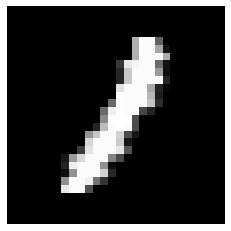

Loss: 0.0001419834189518336
Iteration: 86680, Score: 0.432903942734003
[163, 117, 40, 23, 32, 48, 158, 43, 25, 23, 46, 171, 16, 95, 0]


Loss: 0.0001429215126441619
Iteration: 86720, Score: 0.38858579112589364
[199, 77, 58, 16, 15, 83, 120, 45, 36, 19, 52, 137, 25, 118, 0]


Loss: 0.0001457049902762956
Iteration: 86760, Score: 0.39220596080273384
[128, 139, 70, 35, 34, 77, 165, 39, 17, 18, 42, 102, 26, 108, 0]


Loss: 0.00014321312965989382
Iteration: 86800, Score: 0.39486808604188267
[159, 124, 82, 26, 8, 95, 102, 61, 16, 24, 53, 97, 36, 117, 0]


Test score: 0.313912022896111
Loss: 0.0001382867994726623
Iteration: 86840, Score: 0.40624455522745845
[222, 68, 19, 20, 11, 73, 98, 61, 23, 27, 76, 142, 41, 119, 0]


Loss: 0.0001411956243803656
Iteration: 86880, Score: 0.41511981669813397
[196, 61, 13, 69, 17, 26, 111, 48, 23, 30, 79, 131, 32, 164, 0]


Loss: 0.00013237240913947305
Iteration: 86920, Score: 0.38770017675752755
[179, 46, 43, 48, 27, 71, 93, 63, 15, 40, 70, 94, 67, 144, 0]


Loss: 0.00013465106008227835
Iteration: 86960, Score: 0.4344274327754974
[182, 82, 62, 41, 36, 97, 110, 71, 20, 38, 60, 69, 35, 97, 0]


Loss: 0.00017036166831131767
Iteration: 87000, Score: 0.446079954892397
[198, 59, 51, 41, 42, 71, 96, 68, 27, 42, 54, 114, 38, 99, 0]


Loss: 0.0001534808173026628
Iteration: 87040, Score: 0.44179254896938797
[204, 89, 24, 24, 21, 43, 118, 72, 25, 15, 74, 125, 50, 116, 0]


Loss: 0.00013167575052629223
Iteration: 87080, Score: 0.49526151511073113
[253, 27, 52, 15, 27, 59, 74, 92, 23, 15, 80, 108, 34, 141, 0]


Loss: 0.00014871909822687594
Iteration: 87120, Score: 0.42034640210121876
[201, 40, 86, 26, 34, 81, 80, 70, 24, 28, 68, 120, 30, 112, 0]


Loss: 0.00013741042299084466
Iteration: 87160, Score: 0.42061958467960353
[227, 26, 36, 30, 34, 35, 80, 71, 20, 39, 66, 151, 45, 140, 0]


Loss: 0.00012794488905038906
Iteration: 87200, Score: 0.4234318817704916
[253, 40, 23, 19, 39, 46, 67, 70, 25, 20, 96, 139, 32, 131, 0]


Test score: 0.4434452569428832
Loss: 0.00013000047762277704
Iteration: 87240, Score: 0.45638308668136596
[173, 62, 26, 27, 26, 48, 110, 68, 21, 19, 144, 130, 11, 135, 0]


Loss: 0.00015445538362068541
Iteration: 87280, Score: 0.43735288448631754
[220, 47, 30, 32, 39, 35, 63, 90, 32, 22, 112, 139, 21, 118, 0]


Loss: 0.00012596696532875853
Iteration: 87320, Score: 0.4716383738517761
[243, 46, 30, 47, 52, 33, 56, 70, 22, 16, 76, 152, 13, 144, 0]


Loss: 0.00013611770258760257
Iteration: 87360, Score: 0.40068434968590727
[206, 39, 37, 41, 44, 40, 78, 65, 32, 27, 105, 157, 18, 111, 0]


Loss: 0.0001289046135259455
Iteration: 87400, Score: 0.41494982755184173
[189, 35, 32, 23, 39, 38, 82, 83, 41, 30, 126, 121, 19, 142, 0]


Loss: 0.0001472017885090953
Iteration: 87440, Score: 0.4197283395975827
[210, 43, 27, 31, 26, 69, 86, 78, 31, 25, 93, 118, 25, 138, 0]


Loss: 0.0001354402765841045
Iteration: 87480, Score: 0.4843162514269352
[223, 26, 24, 21, 22, 34, 77, 86, 26, 29, 125, 147, 28, 132, 0]


Loss: 0.00014663114284177233
Iteration: 87520, Score: 0.4451288521438837
[151, 137, 32, 22, 9, 58, 135, 43, 17, 30, 84, 131, 23, 128, 0]


Loss: 0.0001462090391131062
Iteration: 87560, Score: 0.42224004325270653
[178, 92, 28, 21, 17, 81, 106, 61, 17, 23, 87, 129, 22, 138, 0]


Loss: 0.0001423126255981142
Iteration: 87600, Score: 0.4540062149167062
[175, 57, 55, 30, 19, 76, 74, 81, 11, 16, 57, 142, 68, 139, 0]


Test score: 0.45711358365416527
Loss: 0.00014290838568086078
Iteration: 87640, Score: 0.44420786082744607
[203, 38, 87, 31, 10, 73, 75, 65, 35, 12, 74, 136, 58, 103, 0]


Loss: 0.00014679158738964467
Iteration: 87680, Score: 0.42684113243222227
[155, 83, 53, 31, 19, 55, 108, 85, 13, 16, 84, 134, 31, 133, 0]


Loss: 0.0001312661064205338
Iteration: 87720, Score: 0.44222851026058196
[181, 48, 23, 28, 29, 33, 111, 81, 23, 26, 65, 188, 27, 137, 0]


Loss: 0.00015281715809989762
Iteration: 87760, Score: 0.47976905629830435
[203, 67, 34, 15, 21, 42, 129, 76, 24, 24, 37, 142, 28, 158, 0]


Loss: 0.00016857363827448777
Iteration: 87800, Score: 0.4042957276701927
[219, 60, 27, 20, 20, 53, 98, 93, 23, 44, 43, 115, 52, 133, 0]


Loss: 0.00014644158029938553
Iteration: 87840, Score: 0.4327888888567687
[246, 40, 37, 23, 20, 60, 72, 74, 24, 22, 59, 144, 33, 146, 0]


Loss: 0.00015108478784720168
Iteration: 87880, Score: 0.42576219087466594
[205, 71, 39, 24, 14, 55, 77, 91, 39, 14, 49, 182, 26, 114, 0]


Loss: 0.0001411545348781784
Iteration: 87920, Score: 0.41962765413522723
[175, 82, 24, 19, 15, 52, 117, 69, 21, 21, 78, 124, 72, 131, 0]


Loss: 0.00014065460803818576
Iteration: 87960, Score: 0.4291073488891125
[225, 64, 57, 9, 25, 82, 76, 82, 30, 13, 49, 107, 53, 128, 0]


Loss: 0.00015286353754942537
Iteration: 88000, Score: 0.45798380024731183
[208, 32, 69, 19, 50, 80, 59, 118, 23, 17, 56, 97, 54, 118, 0]


Test score: 0.3379476446658372
Loss: 0.0001528954605802085
Iteration: 88040, Score: 0.44151420219242576
[194, 35, 79, 20, 28, 71, 96, 106, 33, 11, 58, 117, 20, 132, 0]


Loss: 0.0001623125380057618
Iteration: 88080, Score: 0.453959490403533
[239, 61, 29, 18, 32, 37, 85, 69, 32, 19, 88, 137, 32, 122, 0]


Loss: 0.00017004385103141844
Iteration: 88120, Score: 0.38431247340142727
[189, 59, 84, 13, 20, 81, 92, 86, 20, 13, 77, 110, 41, 115, 0]


Loss: 0.00013944621963717994
Iteration: 88160, Score: 0.4484161254614592
[193, 39, 73, 10, 27, 26, 53, 111, 18, 22, 94, 115, 52, 167, 0]


Loss: 0.0001546653251797132
Iteration: 88200, Score: 0.39301200179755696
[205, 45, 73, 17, 25, 57, 77, 87, 14, 20, 86, 117, 51, 126, 0]


Loss: 0.00014834744297707032
Iteration: 88240, Score: 0.42199760335683817
[195, 55, 99, 20, 12, 99, 57, 94, 34, 26, 73, 82, 52, 102, 0]


Loss: 0.00013888819994564401
Iteration: 88280, Score: 0.40663691155612475
[191, 78, 56, 21, 15, 78, 106, 69, 30, 23, 76, 76, 66, 115, 0]


Loss: 0.00014191463438756866
Iteration: 88320, Score: 0.4137793627008796
[204, 65, 57, 21, 9, 36, 98, 75, 20, 26, 78, 82, 79, 150, 0]


Loss: 0.00011430625141021638
Iteration: 88360, Score: 0.44097263455390945
[184, 58, 86, 23, 9, 95, 85, 75, 16, 23, 88, 82, 54, 122, 0]


Loss: 0.0001393997209527052
Iteration: 88400, Score: 0.43698383139073843
[193, 82, 19, 21, 15, 34, 112, 87, 34, 10, 85, 68, 95, 145, 0]


Test score: 0.3653203513622284
Loss: 0.00013760116311968546
Iteration: 88440, Score: 0.4095416630413384
[173, 55, 43, 64, 18, 26, 79, 96, 25, 35, 71, 60, 109, 146, 0]


Loss: 0.00016444345460071543
Iteration: 88480, Score: 0.41218508513271807
[201, 61, 45, 47, 15, 29, 72, 81, 27, 27, 106, 109, 70, 110, 0]


Loss: 0.00016559548252858349
Iteration: 88520, Score: 0.4378727346509696
[198, 45, 62, 32, 29, 88, 95, 61, 18, 24, 66, 105, 74, 103, 0]


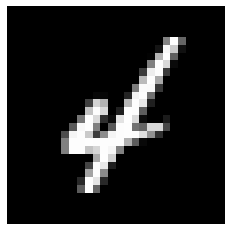

Loss: 0.00015150365178182994
Iteration: 88560, Score: 0.4244757636934519
[177, 87, 101, 18, 13, 122, 101, 69, 15, 31, 46, 39, 88, 93, 0]


Loss: 0.00014799922852906438
Iteration: 88600, Score: 0.4163679711967706
[183, 94, 38, 35, 18, 59, 114, 107, 14, 42, 63, 66, 75, 92, 0]


Loss: 0.00016000556031807702
Iteration: 88640, Score: 0.40752774299681177
[148, 90, 66, 48, 37, 73, 153, 64, 23, 16, 61, 76, 50, 95, 0]


Loss: 0.00015504029400043867
Iteration: 88680, Score: 0.38127650434523813
[190, 75, 60, 21, 27, 63, 128, 83, 29, 21, 69, 86, 50, 98, 0]


Loss: 0.00013695418450914058
Iteration: 88720, Score: 0.49413086333870887
[208, 36, 36, 17, 25, 59, 66, 69, 27, 25, 67, 65, 90, 210, 0]


Loss: 0.0001454083798869593
Iteration: 88760, Score: 0.45972035528719435
[247, 35, 83, 27, 27, 68, 52, 80, 20, 25, 53, 68, 61, 154, 0]


Loss: 0.00013626809632389468
Iteration: 88800, Score: 0.43708738283813
[183, 33, 132, 13, 14, 129, 39, 88, 13, 14, 68, 86, 72, 116, 0]


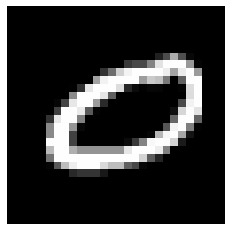

Test score: 0.3636471666805446
Loss: 0.0001497240387049444
Iteration: 88840, Score: 0.3946863708232995
[230, 34, 74, 19, 41, 103, 50, 72, 19, 22, 50, 151, 31, 104, 0]


Loss: 0.00014803268169583312
Iteration: 88880, Score: 0.4403572716414928
[231, 48, 49, 18, 38, 36, 97, 65, 20, 31, 78, 101, 28, 160, 0]


Loss: 0.00012678287043025368
Iteration: 88920, Score: 0.4615354478806258
[242, 38, 71, 12, 20, 54, 68, 66, 32, 23, 76, 99, 62, 137, 0]


Loss: 0.00014237634440343846
Iteration: 88960, Score: 0.4380684486031533
[152, 101, 43, 10, 37, 40, 147, 67, 23, 18, 60, 90, 70, 142, 0]


Loss: 0.00014924302481406223
Iteration: 89000, Score: 0.3580437614321709
[190, 44, 45, 49, 85, 71, 45, 57, 25, 39, 61, 135, 57, 97, 0]


Loss: 0.00016617357464279546
Iteration: 89040, Score: 0.4262902282923461
[237, 62, 41, 42, 26, 56, 73, 48, 23, 34, 63, 104, 38, 153, 0]


Loss: 0.00017818625731430587
Iteration: 89080, Score: 0.3731663753986359
[282, 87, 32, 11, 19, 53, 110, 53, 24, 15, 60, 68, 35, 151, 0]


Loss: 0.0001953606934757343
Iteration: 89120, Score: 0.3467886177301408
[175, 98, 33, 15, 25, 33, 207, 72, 18, 15, 32, 114, 34, 129, 0]


Loss: 0.0001917367977630252
Iteration: 89160, Score: 0.4454015078768133
[160, 86, 46, 15, 78, 58, 165, 60, 26, 19, 49, 93, 19, 126, 0]


Loss: 0.0001443059678000241
Iteration: 89200, Score: 0.3994096290022135
[180, 82, 84, 14, 42, 81, 138, 49, 27, 26, 42, 97, 25, 113, 0]


Test score: 0.40496028414368623
Loss: 0.0001531278927777933
Iteration: 89240, Score: 0.44033567935228346
[195, 104, 73, 19, 29, 66, 123, 49, 27, 19, 38, 123, 30, 105, 0]


Loss: 0.0001583806941253141
Iteration: 89280, Score: 0.4016694271415472
[187, 97, 46, 21, 51, 26, 147, 61, 14, 20, 58, 115, 42, 115, 0]


Loss: 0.00013315525395033484
Iteration: 89320, Score: 0.4547550727128982
[192, 69, 36, 49, 35, 38, 143, 75, 36, 24, 60, 94, 34, 115, 0]


Loss: 0.0001295955739572671
Iteration: 89360, Score: 0.3847712272703647
[235, 46, 62, 13, 35, 42, 92, 69, 17, 19, 108, 108, 52, 102, 0]


Loss: 0.00013891030861381632
Iteration: 89400, Score: 0.41301580619812023
[127, 147, 67, 16, 22, 63, 186, 50, 46, 23, 47, 82, 16, 108, 0]


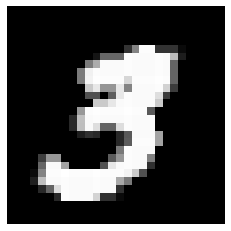

Loss: 0.0001276616731476059
Iteration: 89440, Score: 0.3952074273228645
[193, 50, 46, 19, 33, 68, 83, 59, 39, 34, 86, 140, 26, 124, 0]


Loss: 0.00013409455483172022
Iteration: 89480, Score: 0.43744763779640206
[155, 93, 74, 16, 46, 40, 138, 68, 34, 34, 60, 98, 34, 110, 0]


Loss: 0.00013239170767468498
Iteration: 89520, Score: 0.43368271344900133
[191, 69, 113, 26, 32, 111, 111, 66, 21, 25, 51, 64, 21, 99, 0]


Loss: 0.0001236453888068494
Iteration: 89560, Score: 0.42977853855490694
[179, 28, 51, 55, 69, 58, 96, 89, 14, 39, 72, 119, 16, 115, 0]


Loss: 0.00013235444613678957
Iteration: 89600, Score: 0.34304763379693026
[165, 66, 43, 63, 33, 90, 113, 83, 19, 26, 49, 101, 22, 127, 0]


Test score: 0.370498774588108
Loss: 0.00014309656303057328
Iteration: 89640, Score: 0.4568274471387267
[158, 73, 46, 59, 51, 35, 109, 97, 13, 28, 87, 112, 22, 110, 0]


Loss: 0.00013922268696350552
Iteration: 89680, Score: 0.416417415127158
[153, 79, 57, 24, 75, 67, 107, 81, 18, 27, 70, 94, 26, 122, 0]


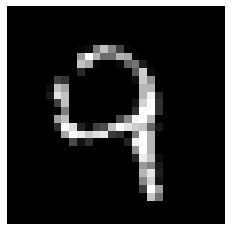

Loss: 0.0001545490260473222
Iteration: 89720, Score: 0.44289838609099386
[154, 130, 47, 27, 36, 21, 208, 51, 15, 12, 104, 74, 46, 75, 0]


Loss: 0.00012853670008196037
Iteration: 89760, Score: 0.38431809525191785
[137, 91, 43, 41, 110, 39, 125, 78, 18, 43, 66, 90, 23, 96, 0]


Loss: 0.00015419022438433488
Iteration: 89800, Score: 0.38672947434335947
[171, 31, 63, 59, 50, 69, 98, 79, 41, 35, 87, 69, 27, 121, 0]


Loss: 0.00014032269882224192
Iteration: 89840, Score: 0.40186264009773726
[198, 120, 30, 22, 34, 16, 103, 92, 26, 29, 79, 96, 21, 134, 0]


Loss: 0.00015537822347904824
Iteration: 89880, Score: 0.3738246417045593
[162, 135, 72, 15, 16, 57, 155, 57, 19, 34, 55, 91, 49, 83, 0]


Loss: 0.00016709152331667847
Iteration: 89920, Score: 0.40185630565881725
[201, 67, 74, 18, 22, 61, 112, 65, 39, 61, 37, 92, 27, 124, 0]


Loss: 0.0001276001157087899
Iteration: 89960, Score: 0.4190828696489334
[157, 87, 44, 55, 19, 70, 83, 97, 20, 39, 70, 100, 16, 143, 0]


Loss: 0.00016199091614569168
Iteration: 90000, Score: 0.4383052925486117
[176, 95, 78, 30, 27, 99, 118, 31, 30, 51, 55, 86, 21, 103, 0]


Test score: 0.40704886043071753
Loss: 0.00014025039870690077
Iteration: 90040, Score: 0.4167166304066777
[203, 76, 53, 21, 13, 63, 99, 73, 53, 33, 56, 91, 23, 143, 0]


Loss: 0.0001703431448421581
Iteration: 90080, Score: 0.4211915743239225
[176, 98, 88, 45, 41, 90, 87, 52, 19, 38, 40, 95, 16, 115, 0]


Loss: 0.00015214994504769092
Iteration: 90120, Score: 0.4291494047939777
[150, 49, 116, 23, 20, 130, 88, 60, 59, 24, 37, 66, 13, 165, 0]


Loss: 0.00015234278182012844
Iteration: 90160, Score: 0.46216226351261147
[222, 32, 47, 22, 24, 136, 75, 58, 48, 19, 53, 87, 13, 164, 0]


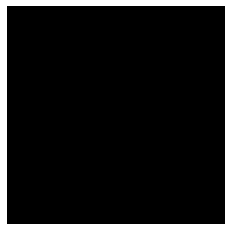

Loss: 0.00014720019549274368
Iteration: 90200, Score: 0.4242683427035808
[259, 79, 72, 29, 18, 105, 63, 66, 37, 19, 39, 63, 23, 128, 0]


Loss: 0.00017157294532508721
Iteration: 90240, Score: 0.39472951066493994
[194, 123, 31, 37, 21, 60, 137, 27, 28, 39, 40, 105, 17, 141, 0]


Loss: 0.00015313478799695984
Iteration: 90280, Score: 0.4046917828619481
[209, 46, 42, 38, 14, 59, 80, 69, 62, 39, 72, 96, 21, 153, 0]


Loss: 0.00017541839760950564
Iteration: 90320, Score: 0.42144891059398654
[209, 103, 64, 31, 24, 54, 120, 53, 30, 31, 47, 82, 13, 139, 0]


Loss: 0.0001590995826721841
Iteration: 90360, Score: 0.45611641544103626
[262, 47, 48, 27, 26, 78, 63, 78, 21, 33, 51, 81, 23, 162, 0]


Loss: 0.00014532166529713164
Iteration: 90400, Score: 0.4536901437342166
[168, 110, 72, 51, 27, 63, 147, 45, 27, 18, 52, 70, 20, 130, 0]


Test score: 0.38422293232381344
Loss: 0.00016535629698473988
Iteration: 90440, Score: 0.40230324745178214
[180, 76, 55, 59, 23, 64, 101, 75, 28, 24, 37, 61, 43, 174, 0]


Loss: 0.00015559333212477846
Iteration: 90480, Score: 0.42799888193607316
[157, 90, 82, 22, 13, 47, 128, 66, 24, 23, 52, 91, 20, 185, 0]


Loss: 0.00015044654910599127
Iteration: 90520, Score: 0.4310940206646919
[213, 45, 50, 24, 22, 34, 95, 97, 27, 17, 56, 136, 22, 162, 0]


Loss: 0.00016842227820843548
Iteration: 90560, Score: 0.44431970649957647
[183, 89, 60, 37, 41, 46, 148, 63, 28, 12, 36, 71, 36, 150, 0]


Loss: 0.00014658554249592505
Iteration: 90600, Score: 0.4314192532449961
[190, 71, 76, 23, 25, 69, 76, 87, 27, 12, 78, 107, 22, 137, 0]


Loss: 0.00013852297427157932
Iteration: 90640, Score: 0.4155873632505537
[235, 86, 25, 23, 16, 34, 106, 75, 44, 20, 49, 115, 20, 152, 0]


Loss: 0.00014662119035463832
Iteration: 90680, Score: 0.4324957612752914
[215, 70, 25, 30, 17, 68, 115, 56, 31, 19, 51, 157, 20, 126, 0]


Loss: 0.00014845489232804746
Iteration: 90720, Score: 0.4299908265471458
[259, 38, 39, 24, 17, 36, 90, 63, 30, 22, 67, 127, 22, 166, 0]


Loss: 0.00014101367057476363
Iteration: 90760, Score: 0.4223827853351831
[159, 56, 97, 18, 18, 94, 111, 73, 27, 22, 100, 109, 11, 105, 0]


Loss: 0.00014352717767958384
Iteration: 90800, Score: 0.3910109060630202
[167, 77, 68, 19, 23, 80, 101, 107, 24, 18, 98, 71, 20, 127, 0]


Test score: 0.4322785428017378
Loss: 0.00015206182161936054
Iteration: 90840, Score: 0.4240330366492272
[211, 76, 61, 39, 20, 49, 115, 46, 22, 21, 73, 129, 18, 120, 0]


Loss: 0.00015607657549885007
Iteration: 90880, Score: 0.3962180899083614
[218, 57, 31, 33, 22, 28, 90, 66, 25, 10, 97, 133, 60, 130, 0]


Loss: 0.00015183653028079074
Iteration: 90920, Score: 0.45343622368574144
[195, 50, 47, 24, 29, 51, 92, 98, 18, 17, 97, 86, 60, 136, 0]


Loss: 0.00013023544398778285
Iteration: 90960, Score: 0.42577072510123254
[189, 48, 72, 29, 14, 54, 64, 114, 20, 15, 87, 119, 48, 127, 0]


Loss: 0.00014083029246910795
Iteration: 91000, Score: 0.40377013492584235
[172, 45, 97, 25, 26, 51, 59, 94, 14, 38, 63, 142, 51, 123, 0]


Loss: 0.0001409060013471488
Iteration: 91040, Score: 0.43345232286676766
[176, 81, 72, 30, 33, 62, 97, 74, 19, 26, 57, 129, 41, 103, 0]


In [ ]:
epsilon = initial_epsilon
state_memory = torch.from_numpy(np.zeros((1,3,28,28))).to(device).float()
target_memory = torch.tensor([0]).to(device)
action_memory = torch.tensor([0]).to(device)
final_scores_real = []
final_scores_fake = []
penalty_multiplier = 0
#movement_time = 0
model_time = 0
train_time = 0
test_time = 0
save_time = 0
draw_time = 0
start_time = time()
prev_action = 0

for iter in range(number_of_iterations):

    source = np.asarray(load_source(0))
    source_masked, source_length = source_mask(source)
    cursor = random_cursor(source_masked, source_length)
    drawing = reset()
    cursor_img = cursor_image(cursor)
    cumulative_reward = 0
    state_array = np.zeros((3, side, side))
    penalty_multiplier = min(iter/(2*number_of_iterations), 0.2)

    if iter%epsilon_timestep == 0:
      epsilon = max(epsilon*epsilon_decay, final_epsilon)
    
    step = 0

    state_array[0] = source
    state_array[1] = to_array(drawing)
    state_array[2] = cursor_img

    while step < number_of_steps:
      step += 1

      state = torch.from_numpy(state_array)
      state = state.to(device)
      state = state.unsqueeze(0).float()

      time2 = time()

      with torch.no_grad():
        action_vec = model(state)

      model_time += (time() - time2)

      if random() < epsilon:
        action = randint(0,number_of_actions - 1)
      
      else:
        action = torch.argmax(action_vec).item()

      if action == prev_action:
        action = randint(0,number_of_actions - 1) 
        #Set it so that the agent cannot make two of the same moves in a row. 
        #It very often gets stuck on repeating a single action.

      prev_action = action

      time6 = time()
      drawing, cursor = next_state(drawing, action, cursor, source_masked, source_length)
      draw_time += (time() - time6)

      state_array[1] = to_array(drawing)
      state_array[2] = cursor_image(cursor)

      if step%reward_timestep == 0:
        score = calc_score(source, to_array(drawing), penalty_multiplier)
        reward = score - cumulative_reward
        cumulative_reward = score
      else: 
        reward = 0


      #update replay memory
      state_memory = torch.cat((state, state_memory), 0)
      w = torch.from_numpy(np.array([action])).to(device)
      action_memory = torch.cat((w, action_memory), 0)
      update = np.asarray(action_vec.to('cpu'))
      target = update[0, action]
      q_factor = alpha*(reward - target)
      x = torch.from_numpy(np.array([target + q_factor])).to(device)
      target_memory = torch.cat((x, target_memory), 0)


      if step > 1: 
        target_memory[1] += alpha*gamma*np.max(update[0])

      #mem_length = bound(iter*number_of_steps*replay_memory_multiplier, min_replay_memory_size, max_replay_memory_size)

      if list(action_memory.size())[0] > max_replay_memory_size + 500:
        state_memory = state_memory[0: max_replay_memory_size]
        action_memory = action_memory[0: max_replay_memory_size]
        target_memory = target_memory[0: max_replay_memory_size]
      
      if step == number_of_steps:

        score_real = calc_score(source, to_array(drawing), 0.2)
        score_fake = calc_score(source, to_array(drawing), penalty_multiplier)
        final_scores_real.append(score_real)
        final_scores_fake.append(score_fake)
        if len(final_scores_real) > 40:
          final_scores_real.pop(0)
          final_scores_fake.pop(0)
        
        writer.add_scalar("1. Score (real)", sum(final_scores_real)/len(final_scores_real) , iter)
        writer.add_scalar("1. Score (fake)", sum(final_scores_fake)/len(final_scores_fake) , iter)
        

      #update Q-model

    if iter%steps_per_update == 0:
      time3 = time()
      train_network(model, (state_memory, target_memory, action_memory), l_rate = learning_rate)
      train_time += (time() - time3)

      print(f"Iteration: {iter}, Score: {sum(final_scores_real)/len(final_scores_real)}")
      action_count = [list(np.asarray(action_memory.cpu())[-1000:]).count(x) for x in range(15)]
      print(action_count)
      display_array(source)
      #display_array(cursor_img)
      display(drawing)
      writer.add_scalar("4. Drawing actions", (action_count[10] + action_count[11] + action_count[12] + action_count[13])/sum(action_count), iter)

    if iter%(steps_per_update*10) == 0:
      time4 = time()
      test_score = 0
      for i in range(40):
        test_score += test_model(model)
      print(f"Test score: {test_score/40}")
      writer.add_scalar("2. Test score", test_score/40, iter)
      test_time += (time() - time4)
    
    if iter%(steps_per_update*100) == 0:
      time5 = time()
      torch.save(model.state_dict(), "/content/drive/MyDrive/Aleph/model3")   
      save_time += (time() - time4)


      
      #display(drawing)
      #print("Update step complete!")
        

print(f"Total time: {time() - start_time}")
print(f"Model time: {model_time}")
print(f"Train time: {train_time}")
print(f"Test time: {test_time}")
print(f"Save time: {save_time}")
print(f"Draw time: {draw_time}")


writer.flush()
writer.close()
      


Witness your trained (or more likely untrained) model step-by-step in action!

In [ ]:
def test_model_verbose(model, steps = 1, image = 0, epsilon = 0):

  source = np.asarray(load_source(0))
  source_masked, source_length = source_mask(source)
  cursor = random_cursor(source_masked, source_length)
  drawing = reset()
  cursor_img = cursor_image(cursor)
  cumulative_reward = 0
  state_array = np.zeros((3, side, side))

  step = 0
  print("Source:")
  display_array(source)

  state_array[0] = source
  state_array[1] = to_array(drawing)
  state_array[2] = cursor_img

  while step < number_of_steps:
    step += 1

    state = torch.from_numpy(state_array)
    state = state.to(device)
    state = state.unsqueeze(0).float()
    with torch.no_grad():
      action_vec = model(state)

    if random() < epsilon:
      action = randint(0,number_of_actions - 1)
    else: 
      action = torch.argmax(action_vec).item()

    drawing, cursor = next_state(drawing, action, cursor, source_masked, source_length)

    state_array[1] = to_array(drawing)
    state_array[2] = cursor_image(cursor)

    print(action)

    if step%steps == 0:
      print(f"Step :{step}")
      display(drawing)
      #print(cursor)
      display_array(state_array[2])
      #print(f"Action: {action}")
      score = calc_score(source, to_array(drawing))
      print(f"Score: {score}")
  
  score = calc_score(source, to_array(drawing))
  return score


        

test_model_verbose(model)